# View Fors2 , View spectra one by one

- author : Sylvie Dagoret-Campagne
- affiliation : IJCLab/IN2P3/CNRS
- creation date : 2022/12/23
- last update : 2023/01/04
- FORS2 : https://github.com/ericnuss/fors2
- Result of StarLight : /sps/lsst/groups/photoz/fors2/FORS2/ResStarlight



          /Users/dagoret/MacOSX/GitHub/LSST/FORS2>ls -l
              total 0
              drwxrwsr-x  3 dagoret  staff   96 Aug 21  2018 ResStarlight
              drwxr-xr-x  9 dagoret  staff  288 Dec 19 18:01 fors2

## Import

In [1]:
import os,sys,re
from astropy.io import fits
from astropy.table import Table

In [2]:
# Import some generally useful packages

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cm as cmx

from matplotlib.backends.backend_pdf import PdfPages

%matplotlib inline
import pandas as pd
from itertools import cycle, islice


In [3]:
from scipy import ndimage

#from scipy import interp as scinterp
from scipy.interpolate import interp1d

import glob
import collections
#from def_raw_seds import *

In [4]:
# to enlarge the sizes
params = {'legend.fontsize': 'large',
          'figure.figsize': (8, 4),
         'axes.labelsize': 'xx-large',
         'axes.titlesize':'xx-large',
         'xtick.labelsize':'xx-large',
         'ytick.labelsize':'xx-large'}
plt.rcParams.update(params)

In [5]:
import matplotlib.offsetbox
props = dict(boxstyle='round',edgecolor="w",facecolor="w", alpha=0.5)

In [6]:
from def_raw_seds import *

In [7]:
from raw_data_analysis import *

In [8]:
# Import the primary photometry classes from rubin_sim.photUtils

import rubin_sim.photUtils.Bandpass as Bandpass
import rubin_sim.photUtils.Sed as Sed
from rubin_sim.data import get_data_dir

In [9]:
pysynphot_root_path=os.environ['PYSYN_CDBS']
path_sed_calspec=os.path.join(pysynphot_root_path,'calspec')
# pysynphot
import pysynphot as S
S.refs.setref(area=1)
S.refs.getref()

{'graphtable': '/Users/sylvie/MacOSX/External/PySynPhotData/grp/redcat/trds/mtab/57g1733im_tmg.fits',
 'comptable': '/Users/sylvie/MacOSX/External/PySynPhotData/grp/redcat/trds/mtab/5as18041m_tmc.fits',
 'thermtable': '/Users/sylvie/MacOSX/External/PySynPhotData/grp/redcat/trds/mtab/3241637sm_tmt.fits',
 'area': 1,
 'waveset': 'Min: 500, Max: 26000, Num: 10000, Delta: None, Log: True'}

In [10]:
from GalaxyLineDict import build_emissionlinesdict

# Start

In [11]:
cwd=os.path.abspath("")
main_dir = cwd
print(f"notebook current executing path : {cwd}")

notebook current executing path : /Users/sylvie/MacOSX/GitHub/LSST/PhotoZ_PhD/StudyFors2SED


## Configuration

### Emission lines

In [12]:
#df_lines=pd.read_excel("datatools/GalEmissionLines.xlsx")

In [13]:
#df_lines

In [14]:
#df_sdss_lines = pd.read_excel("datatools/sdss_galaxylines.xlsx")

In [15]:
#df_sdss_lines

# Lines

In [16]:
lines_to_plot=build_emissionlinesdict()

In [17]:
lines_to_plot

{'K': {'wls': array([3934.777]), 'name': 'K', 'type': 'absorption'},
 'H': {'wls': array([4341.68 , 4862.68 , 6564.61 , 3969.588]),
  'name': 'H',
  'type': 'absorption'},
 'G': {'wls': array([4305.61]), 'name': 'G', 'type': 'absorption'},
 'Mg': {'wls': array([5176.7]), 'name': 'Mg', 'type': 'absorption'},
 'Na': {'wls': array([5895.6]), 'name': 'Na', 'type': 'absorption'},
 'H8': {'wls': array([3889.064]), 'name': '$H8$', 'type': 'emission'},
 'H9': {'wls': array([3835.391]), 'name': '$H9$', 'type': 'emission'},
 'H10': {'wls': array([3797.904]), 'name': '$H10$', 'type': 'emission'},
 'H11': {'wls': array([3770.637]), 'name': '$H11$', 'type': 'emission'},
 'H{alpha}': {'wls': array([6562.819]),
  'name': '$H_\\alpha$',
  'type': 'emission'},
 'H{beta}': {'wls': array([4861.333]),
  'name': '$H_\\beta$',
  'type': 'emission'},
 'H{gamma}': {'wls': array([4340.471]),
  'name': '$H_\\gamma$',
  'type': 'emission'},
 'H{delta}': {'wls': array([4101.742]),
  'name': '$H_\\delta$',
  'type

In [18]:
def plot_line(ax,line_name):
    
    #keys = lines_to_plot.keys()
    #for the_key in keys:
    #    if the_key in line_name:
    #        print("the_key=",the_key," line_name=",line_name)
    #        line_name=the_key
    #        break
            
    posx0=0.0
    posy0=0.05
    fontsize=12
    the_color = {"emission":'r',"absorption":"g","break":"purple"}
    the_line_to_plot = lines_to_plot[line_name]
    wls = the_line_to_plot["wls"]
    tag = the_line_to_plot["name"]
    typ = the_line_to_plot["type"]
    
    xlim = ax.get_xlim()
    for wl in wls:
        ax.axvline(wl, lw=2, color=the_color[typ])
        xpos = (wl - xlim[0]) / (xlim[1] - xlim[0])+posx0 
        if 0 < xpos < 1:
            ax.annotate(tag, xy=(xpos, posy0), rotation=0, ha='left', va='bottom',
                            xycoords='axes fraction', color=the_color[typ], fontsize=fontsize)
    return ax

### Fors2

## Start

### Catalog

In [19]:
t = Table.read(filename_fits_catalog)

/Users/sylvie/anaconda3/lib/python3.9/site-packages/astropy/io/fits/connect.py:276: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  mask = data[col.name] == col.null


In [20]:
t

ID,m_ID,RAJ2000,DEJ2000,z,u_z,Rmag,RV,e_RV,RT,Nsp,Lines
,,deg,deg,,,mag,km / s,km / s,,,
int16,bytes1,float64,float64,float64,bytes1,float64,int32,int16,float64,int16,bytes77
1,,13.52815,-28.40486,0.55409,,20.79,166227,55,10.0,1,"[OII],H8,K,H"
2,,13.52997,-28.44776,0.34555,,21.18,103665,40,12.3,1,"K,H,G,H{beta}"
3,,13.52552,-28.4208,0.6866,,21.45,210642,48,11.6,4,"[OII],H9,K,H,H{beta},[OIII],H8"
4,,13.52216,-28.40914,0.68653,,21.62,205959,123,10.6,1,"[OII],H9,K,H,G,H{beta}"
7,,13.50974,-28.42972,0.32371,,22.34,97111,11,16.7,6,"[OII],H{beta},[OIII],H{alpha}"
9,,13.50219,-28.40641,0.29266,,21.6,87798,58,13.1,1,"H9,H8,K,H"
11,,13.49724,-28.39487,0.62688,,22.09,188063,17,24.3,3,"[OII],H10,H8,K,H,H{delta}"
12,,13.49584,-28.39125,0.2973,,21.97,89189,30,14.8,2,"[OII],H10,H9,H8,K,H"


### List

In [21]:
lst=fors2_jct_SL() #remet les spectres dans le rest frame (ie a z=0)

In [22]:
lst = sorted(lst)
print(lst)

['SPEC102', 'SPEC106', 'SPEC107', 'SPEC109', 'SPEC110', 'SPEC111', 'SPEC112', 'SPEC113', 'SPEC114', 'SPEC115', 'SPEC117', 'SPEC118', 'SPEC120', 'SPEC121', 'SPEC123', 'SPEC127', 'SPEC128', 'SPEC13', 'SPEC132', 'SPEC134', 'SPEC135', 'SPEC137', 'SPEC138', 'SPEC141', 'SPEC149', 'SPEC151', 'SPEC152', 'SPEC156', 'SPEC160', 'SPEC161', 'SPEC164', 'SPEC171', 'SPEC178', 'SPEC179', 'SPEC181', 'SPEC182', 'SPEC183', 'SPEC184', 'SPEC185', 'SPEC186', 'SPEC187', 'SPEC188', 'SPEC189', 'SPEC19', 'SPEC191', 'SPEC192', 'SPEC193', 'SPEC194', 'SPEC196', 'SPEC197', 'SPEC198', 'SPEC2', 'SPEC204', 'SPEC205', 'SPEC210', 'SPEC214', 'SPEC218', 'SPEC221', 'SPEC222', 'SPEC223', 'SPEC226', 'SPEC227', 'SPEC231', 'SPEC233', 'SPEC234', 'SPEC235', 'SPEC236', 'SPEC237', 'SPEC238', 'SPEC24', 'SPEC240', 'SPEC242', 'SPEC243', 'SPEC244', 'SPEC245', 'SPEC246', 'SPEC248', 'SPEC249', 'SPEC25', 'SPEC250', 'SPEC252', 'SPEC253', 'SPEC258', 'SPEC259', 'SPEC260', 'SPEC261', 'SPEC262', 'SPEC264', 'SPEC265', 'SPEC266', 'SPEC267', 'SPE

In [23]:
all_specfilenames = os.listdir(path_out_jct)

In [24]:
all_specfilenames = sorted(all_specfilenames)

In [25]:
all_numbers = [ int(re.findall('^SPEC(.*)[.]txt$',fn)[0]) for fn in all_specfilenames ]

In [26]:
all_numbers = sorted(all_numbers)

In [27]:
print(all_numbers)

[2, 3, 9, 13, 19, 24, 25, 30, 31, 32, 33, 34, 35, 36, 37, 45, 47, 49, 51, 55, 57, 58, 59, 61, 62, 66, 67, 68, 69, 70, 71, 72, 73, 77, 79, 80, 83, 84, 85, 86, 87, 89, 91, 93, 96, 97, 102, 106, 107, 109, 110, 111, 112, 113, 114, 115, 117, 118, 120, 121, 123, 127, 128, 132, 134, 135, 137, 138, 141, 149, 151, 152, 156, 160, 161, 164, 171, 178, 179, 181, 182, 183, 184, 185, 186, 187, 188, 189, 191, 192, 193, 194, 196, 197, 198, 204, 205, 210, 214, 218, 221, 222, 223, 226, 227, 231, 233, 234, 235, 236, 237, 238, 240, 242, 243, 244, 245, 246, 248, 249, 250, 252, 253, 258, 259, 260, 261, 262, 264, 265, 266, 267, 268, 271, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 287, 288, 291, 292, 294, 295, 296, 297, 298, 301, 302, 303, 304, 305, 306, 307, 308, 309, 313, 315, 317, 318, 319, 321, 322, 323, 324, 325, 326, 327, 328, 329, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 343, 344, 345, 346, 348, 349, 350, 351, 352, 353, 354, 355, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367

In [28]:
NSED = len(all_numbers)

# wavelength bin colors
jet = plt.get_cmap('jet')
cNorm = colors.Normalize(vmin=0, vmax=NSED)
scalarMap = cmx.ScalarMappable(norm=cNorm, cmap=jet)
all_colors = scalarMap.to_rgba(np.arange(NSED), alpha=1)

In [29]:
cut = t["ID"] == 3
t[cut]

ID,m_ID,RAJ2000,DEJ2000,z,u_z,Rmag,RV,e_RV,RT,Nsp,Lines
,,deg,deg,,,mag,km / s,km / s,,,
int16,bytes1,float64,float64,float64,bytes1,float64,int32,int16,float64,int16,bytes77
3,,13.52552,-28.4208,0.6866,,21.45,210642,48,11.6,4,"[OII],H9,K,H,H{beta},[OIII],H8"


In [30]:
all_spectra = []
all_wl = []
all_tag = []
all_lines = []
#all_sed = []

for the_num in all_numbers:
    tcut = t["ID"] == the_num
    redshift = t[tcut]["z"].value[0]
    lines = t[tcut]["Lines"].value[0]
    filename = f"SPEC{the_num}.txt"
    tag = f"SPEC{the_num} , z={redshift:.2f}, lines={lines}"
    fullfilename = os.path.join(path_out_jct,filename)
#    the_sed=SED_jct(the_num)
#    all_sed.append(the_sed)
    arr = np.loadtxt(fullfilename)
    all_wl.append(arr[:,0])
    all_spectra.append(arr[:,1])
    all_tag.append(tag)
    all_lines.append(lines)
 

In [31]:
if 0:
    for idx in range(NSED):
        plt.figure(figsize=(16,2))
        plt.plot(all_wl[idx],all_spectra[idx], color=all_colors[idx],label=all_tag[idx])
        plt.legend(loc="upper right")
        plt.grid()
        plt.axvline(4150,color="k")
        plt.axvline(4250,color="k")
#    plt.ylim(-0.02,0.4)
        plt.xlim(2000.,8000.)
        plt.show()


the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


/var/folders/m7/6pm3rhtj0c71ls7jj9mn1g740000gp/T/ipykernel_83632/239818293.py:9: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b-" (-> color='b'). The keyword argument will take precedence.
  ax.plot(all_wl[idx],all_spectra[idx],'b-' ,color=all_colors[idx],label=all_tag[idx],lw=3)


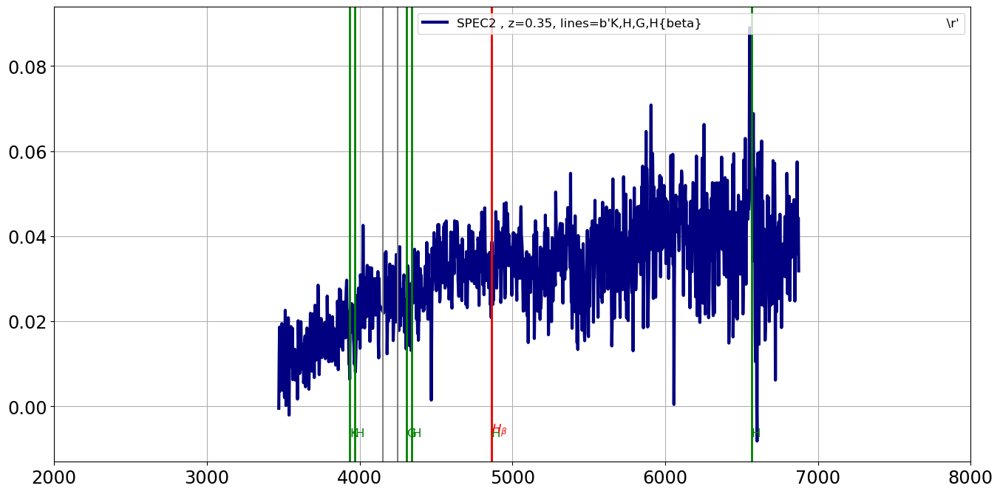

In [32]:
idx=0
the_lines = all_lines[idx]
print("the_lines = ",the_lines)
all_elements  = the_lines.decode().split(",")
#fig, ax = plt.subplot(1,1,1,figsize=(16,8))
#fig, axs = plt.subplots(1, 1, figsize=(16, 8),dpi=50)
fig, axs = plt.subplots(1, 1, figsize=(16, 8))
ax=axs
ax.plot(all_wl[idx],all_spectra[idx],'b-' ,color=all_colors[idx],label=all_tag[idx],lw=3)
ax.legend(loc="upper right")
ax.grid()
ax.axvline(4150,color="grey")
ax.axvline(4250,color="grey")
#    plt.ylim(-0.02,0.4)
ax.set_xlim(2000.,8000.)
for el in all_elements:
    el=el.split(" ")[0]  
    print(el)
    if len(el)>0:
        plot_line(ax,el)


===================== SED 0 : SPEC2 , z=0.35, lines=b'K,H,G,H{beta}                                                               \r'=======================
the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


/var/folders/m7/6pm3rhtj0c71ls7jj9mn1g740000gp/T/ipykernel_83632/3909698412.py:12: UserWarning: color is redundantly defined by the 'color' keyword argument and the fmt string "b-" (-> color='b'). The keyword argument will take precedence.
  ax.plot(all_wl[idx],all_spectra[idx],'b-' ,color=all_colors[idx],label=all_tag[idx],lw=3)


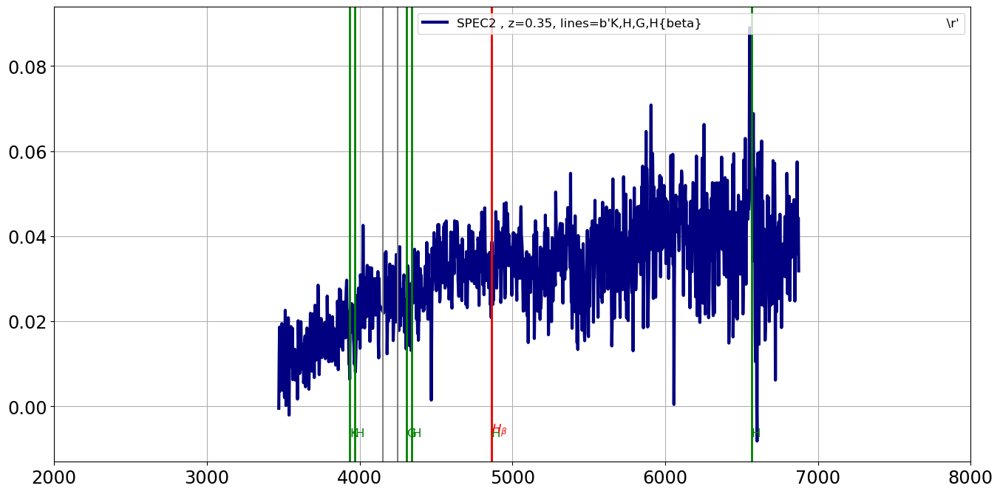

===================== SED 1 : SPEC3 , z=0.69, lines=b'[OII],H9,K,H,H{beta},[OIII],H8                                              \r'=======================
the_lines =  b'[OII],H9,K,H,H{beta},[OIII],H8                                              \r'
[OII]
H9
K
H
H{beta}
[OIII]
H8


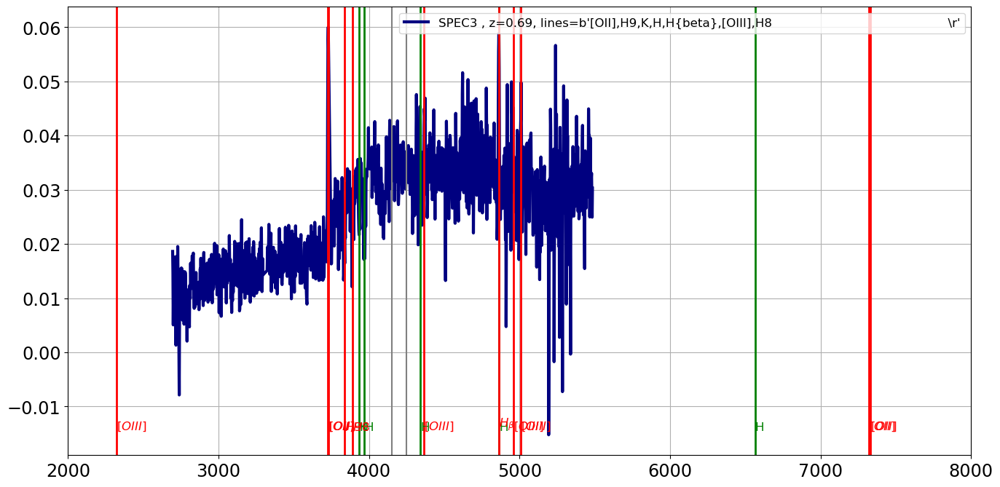

===================== SED 2 : SPEC9 , z=0.29, lines=b'H9,H8,K,H                                                                   \r'=======================
the_lines =  b'H9,H8,K,H                                                                   \r'
H9
H8
K
H


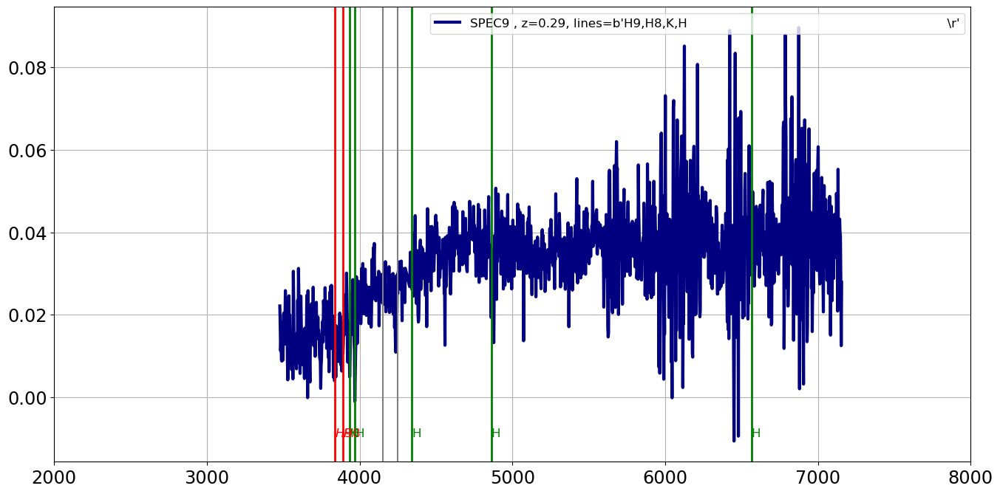

===================== SED 3 : SPEC13 , z=0.69, lines=b'[OII],H{epsilon},H{delta},H{beta}                                           \r'=======================
the_lines =  b'[OII],H{epsilon},H{delta},H{beta}                                           \r'
[OII]
H{epsilon}
H{delta}
H{beta}


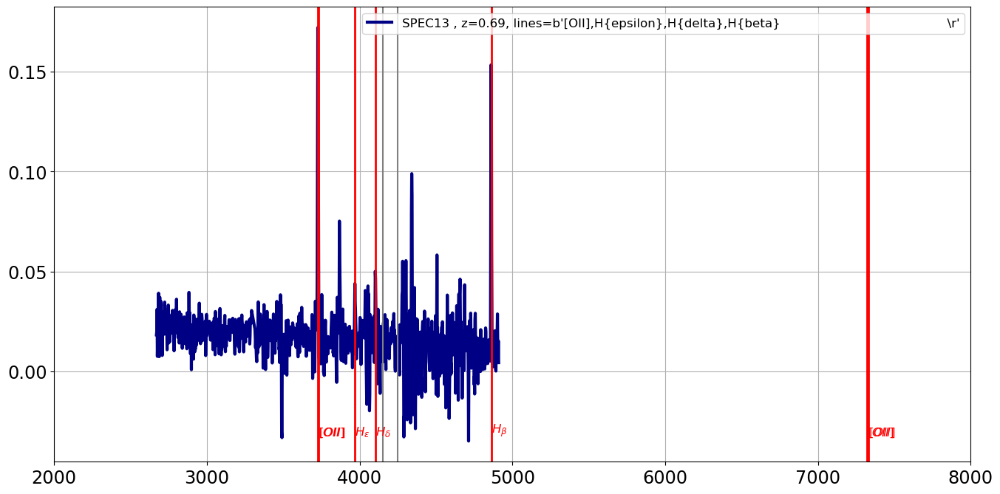

===================== SED 4 : SPEC19 , z=0.48, lines=b'H10,H9,H8,K,H,H{delta}                                                      \r'=======================
the_lines =  b'H10,H9,H8,K,H,H{delta}                                                      \r'
H10
H9
H8
K
H
H{delta}


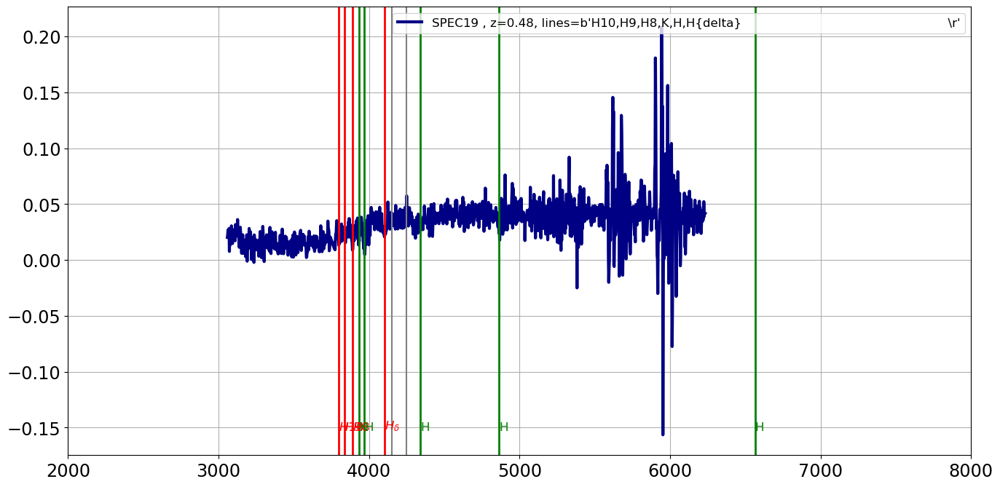

===================== SED 5 : SPEC24 , z=0.47, lines=b'[OII],H,K,[OIII]                                                            \r'=======================
the_lines =  b'[OII],H,K,[OIII]                                                            \r'
[OII]
H
K
[OIII]


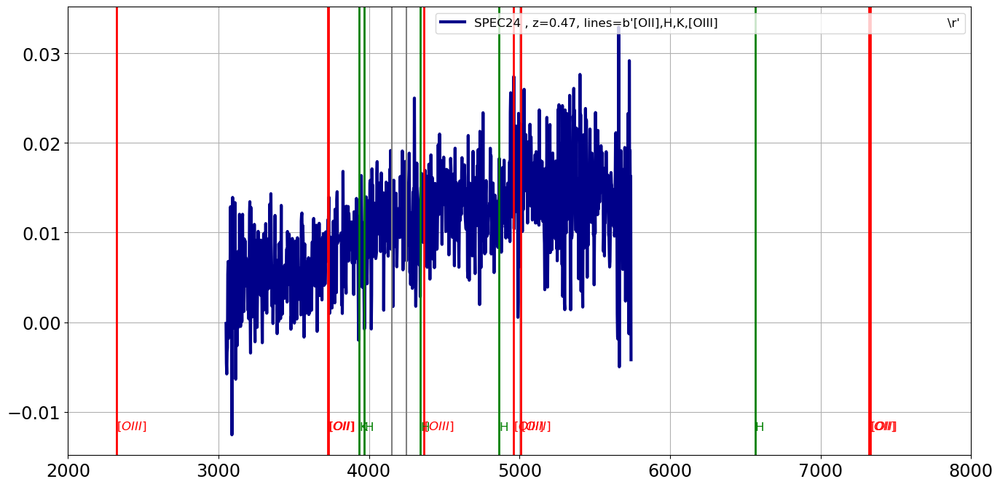

===================== SED 6 : SPEC25 , z=0.45, lines=b'[OII],H,G,H{beta},[OIII]                                                    \r'=======================
the_lines =  b'[OII],H,G,H{beta},[OIII]                                                    \r'
[OII]
H
G
H{beta}
[OIII]


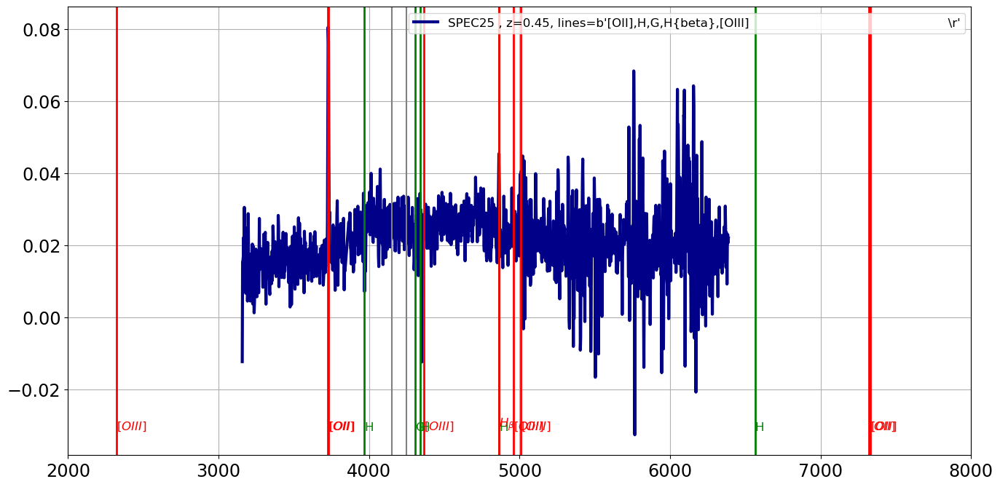

===================== SED 7 : SPEC30 , z=0.29, lines=b'H9,K,H,H{delta},H{alpha}                                                    \r'=======================
the_lines =  b'H9,K,H,H{delta},H{alpha}                                                    \r'
H9
K
H
H{delta}
H{alpha}


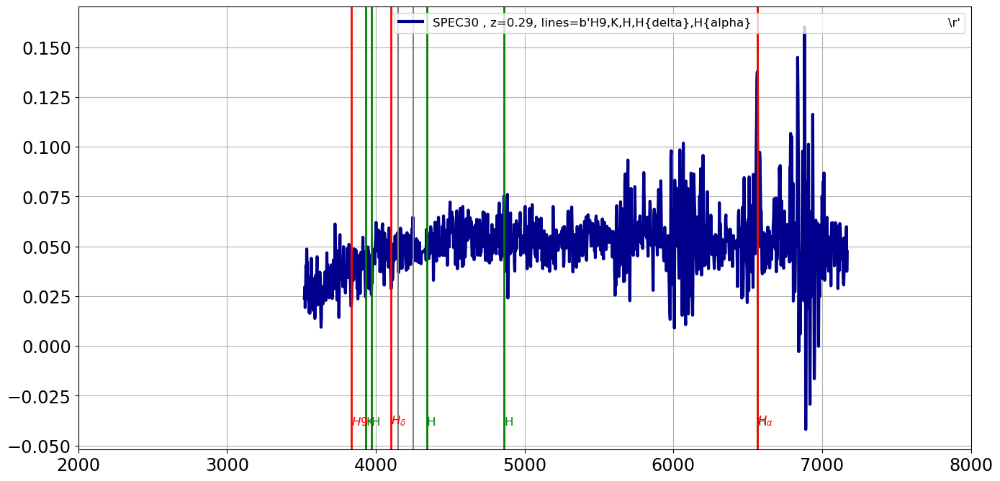

===================== SED 8 : SPEC31 , z=0.63, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


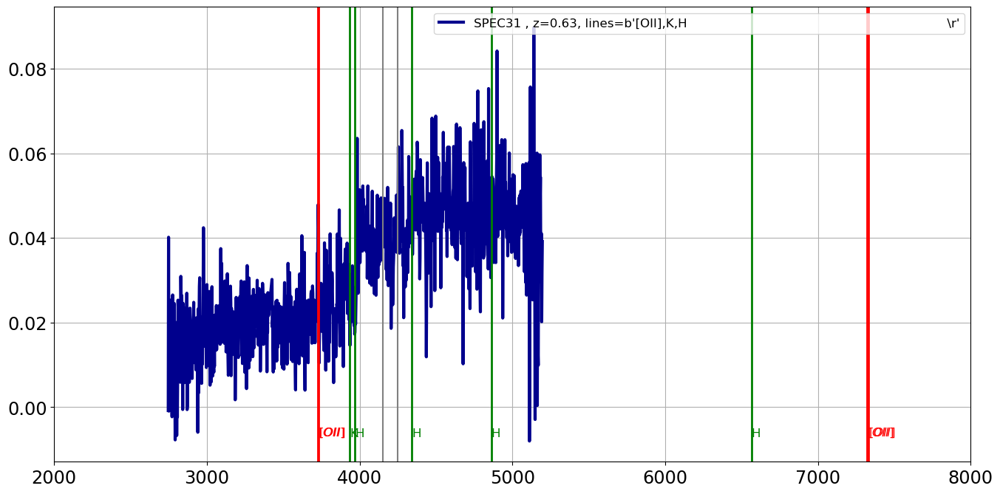

===================== SED 9 : SPEC32 , z=0.45, lines=b'[OII],H{gamma},H{beta},[OIII]                                               \r'=======================
the_lines =  b'[OII],H{gamma},H{beta},[OIII]                                               \r'
[OII]
H{gamma}
H{beta}
[OIII]


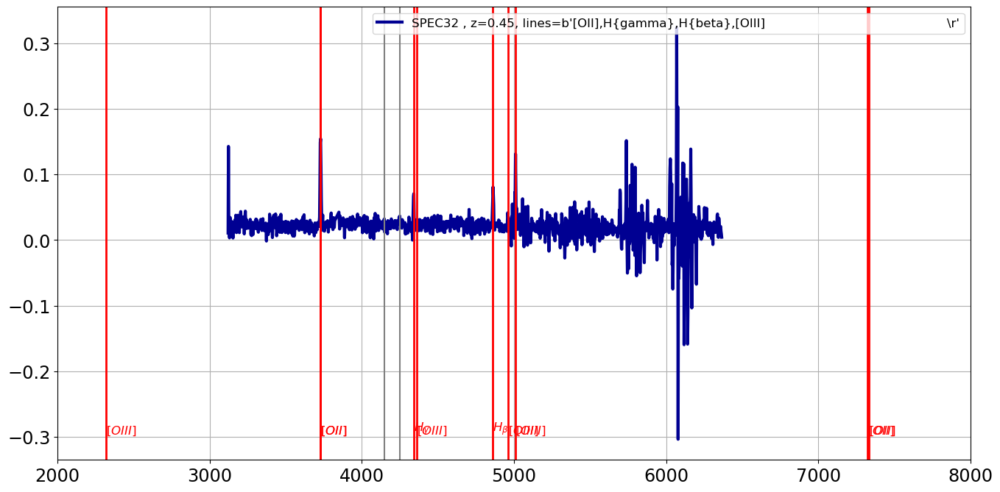

===================== SED 10 : SPEC33 , z=0.45, lines=b'K,H,G,H{beta}                                                               \r'=======================
the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


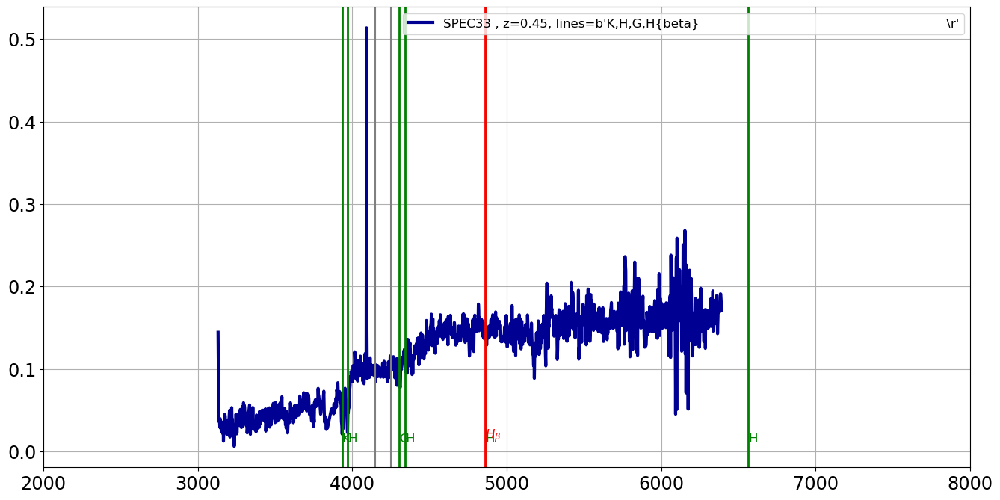

===================== SED 11 : SPEC34 , z=0.63, lines=b'K,H,H{delta},G                                                              \r'=======================
the_lines =  b'K,H,H{delta},G                                                              \r'
K
H
H{delta}
G


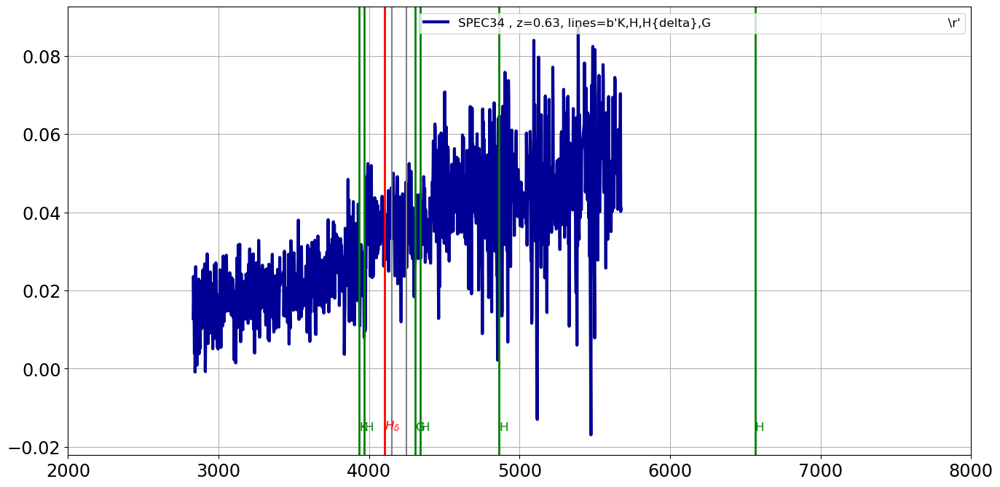

===================== SED 12 : SPEC35 , z=0.45, lines=b'H9,K,H,G,H{beta}                                                            \r'=======================
the_lines =  b'H9,K,H,G,H{beta}                                                            \r'
H9
K
H
G
H{beta}


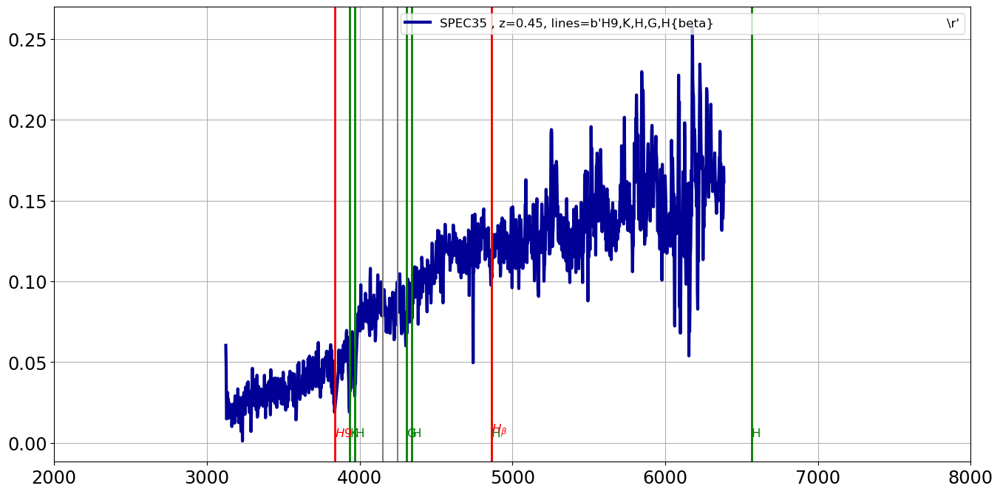

===================== SED 13 : SPEC36 , z=0.82, lines=b'[OII],H9,H8,K,H{beta},[OIII]                                                \r'=======================
the_lines =  b'[OII],H9,H8,K,H{beta},[OIII]                                                \r'
[OII]
H9
H8
K
H{beta}
[OIII]


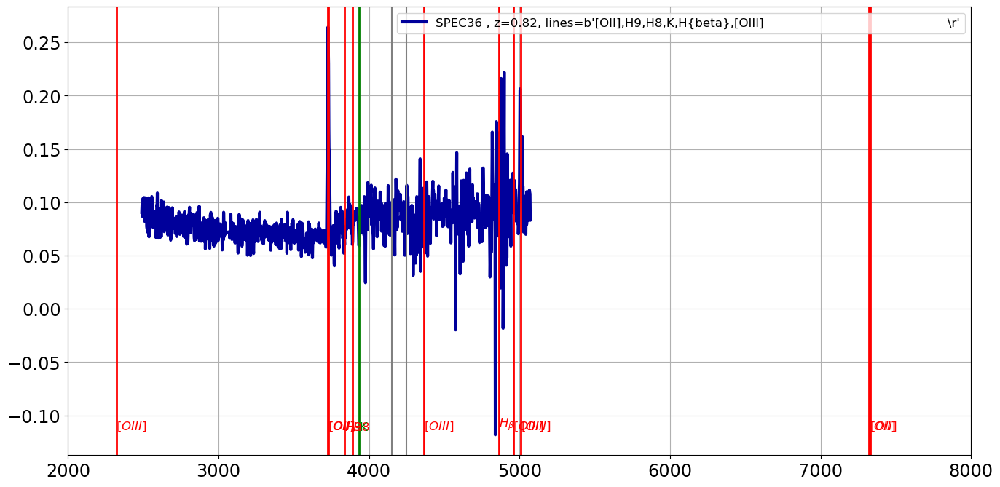

===================== SED 14 : SPEC37 , z=0.69, lines=b'[OII],H10,H9,K,H                                                            \r'=======================
the_lines =  b'[OII],H10,H9,K,H                                                            \r'
[OII]
H10
H9
K
H


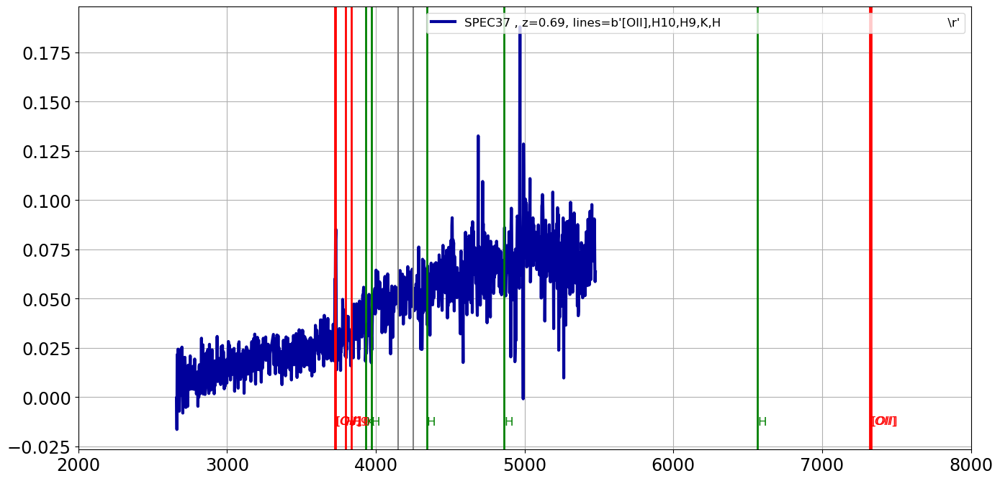

===================== SED 15 : SPEC45 , z=1.10, lines=b'[OII],H9,K,H,H{delta}                                                       \r'=======================
the_lines =  b'[OII],H9,K,H,H{delta}                                                       \r'
[OII]
H9
K
H
H{delta}


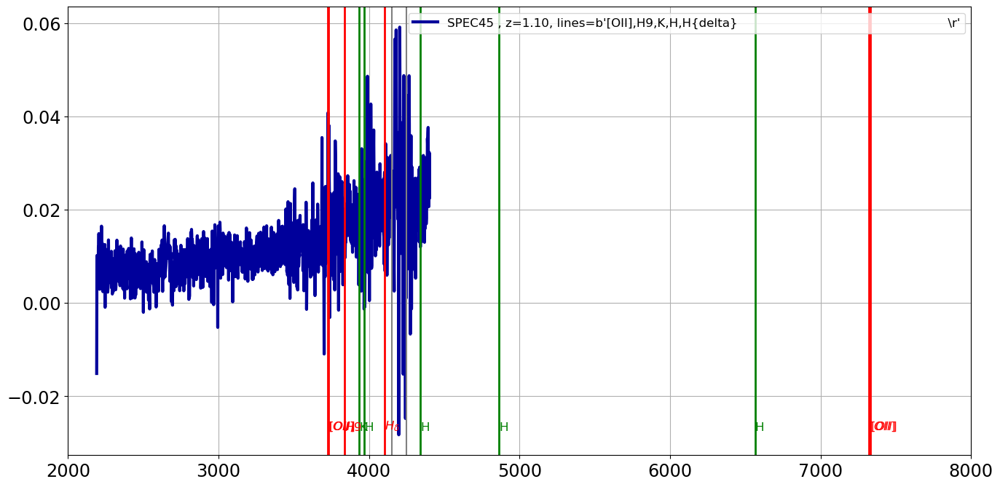

===================== SED 16 : SPEC47 , z=0.29, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


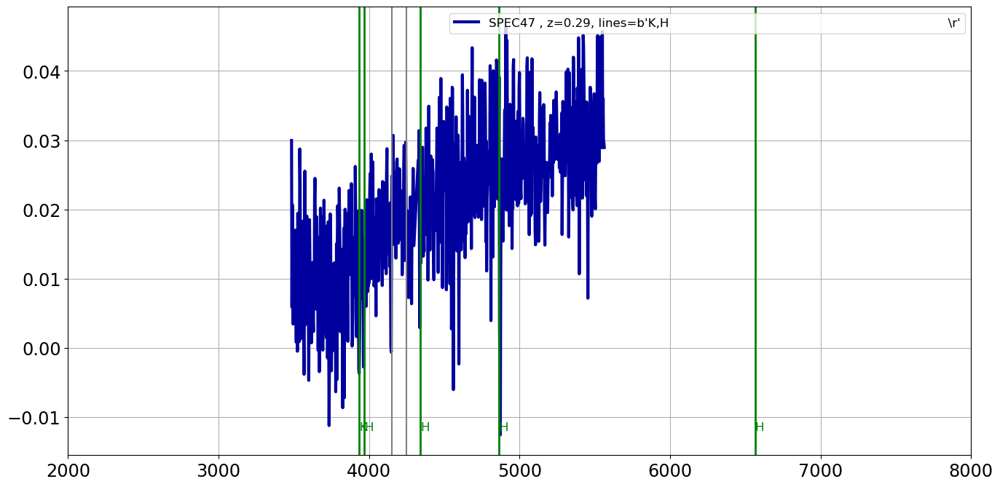

===================== SED 17 : SPEC49 , z=0.69, lines=b'[OII],H                                                                     \r'=======================
the_lines =  b'[OII],H                                                                     \r'
[OII]
H


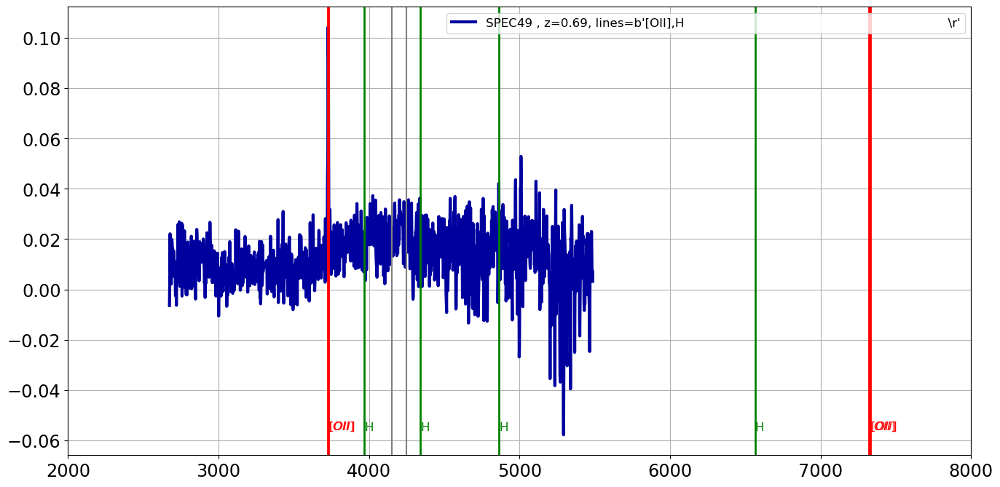

===================== SED 18 : SPEC51 , z=0.63, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


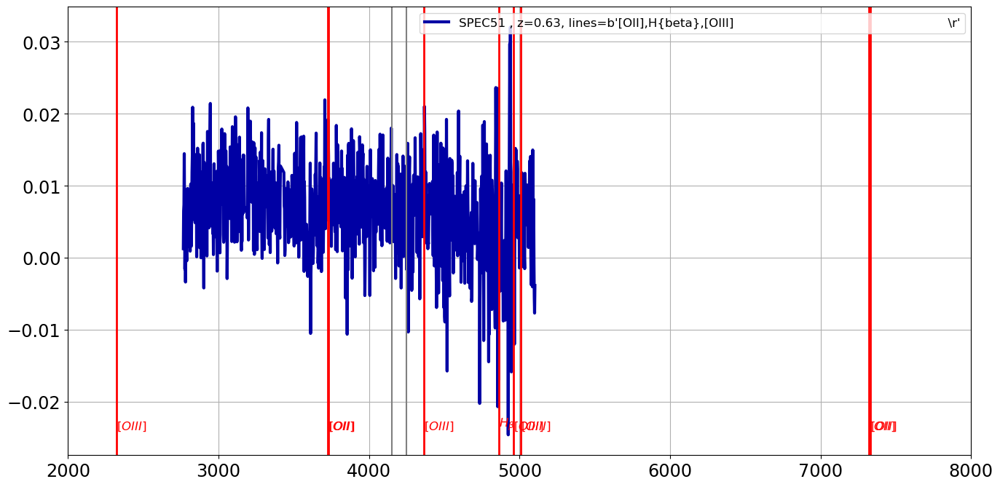

===================== SED 19 : SPEC55 , z=0.45, lines=b'K,H,H{delta},G                                                              \r'=======================
the_lines =  b'K,H,H{delta},G                                                              \r'
K
H
H{delta}
G


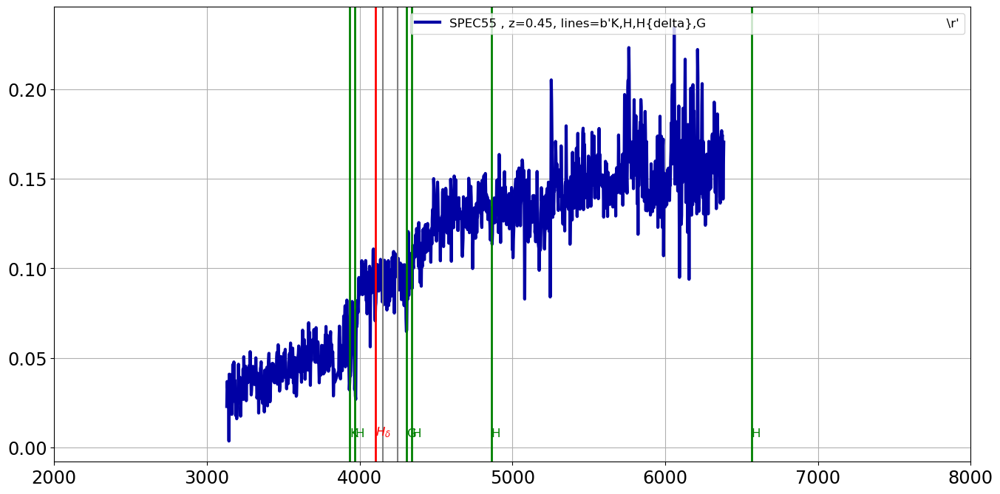

===================== SED 20 : SPEC57 , z=0.22, lines=b'K,H,G,Mgb                                                                   \r'=======================
the_lines =  b'K,H,G,Mgb                                                                   \r'
K
H
G
Mgb


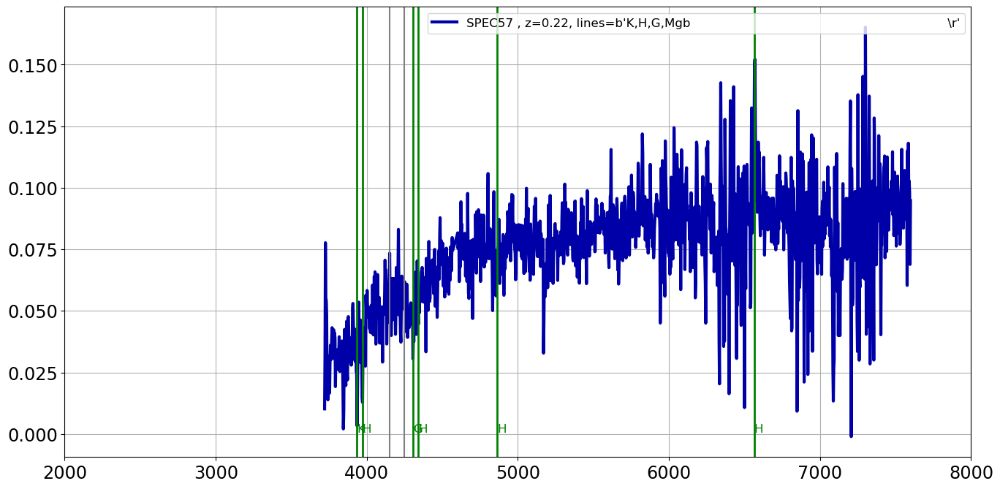

===================== SED 21 : SPEC58 , z=0.63, lines=b'K,H,H{beta}                                                                 \r'=======================
the_lines =  b'K,H,H{beta}                                                                 \r'
K
H
H{beta}


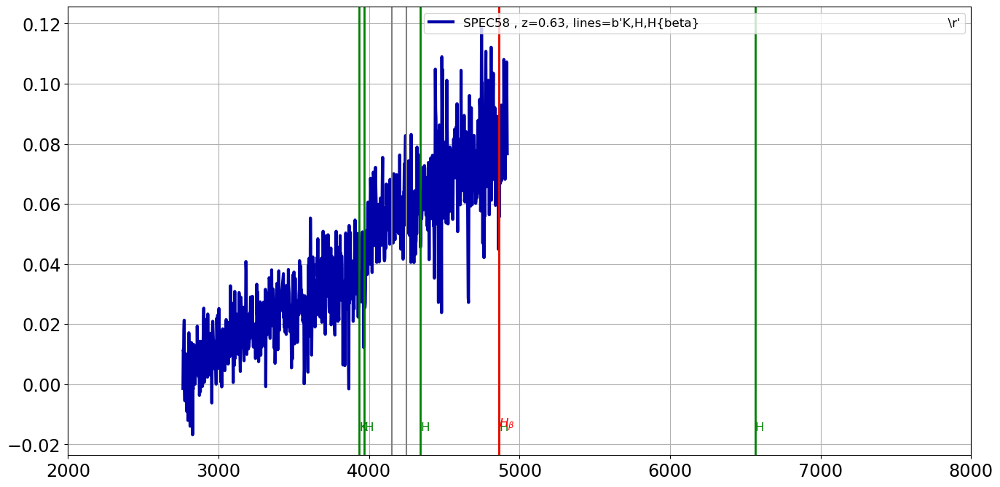

===================== SED 22 : SPEC59 , z=0.89, lines=b'[OII],H{delta}                                                              \r'=======================
the_lines =  b'[OII],H{delta}                                                              \r'
[OII]
H{delta}


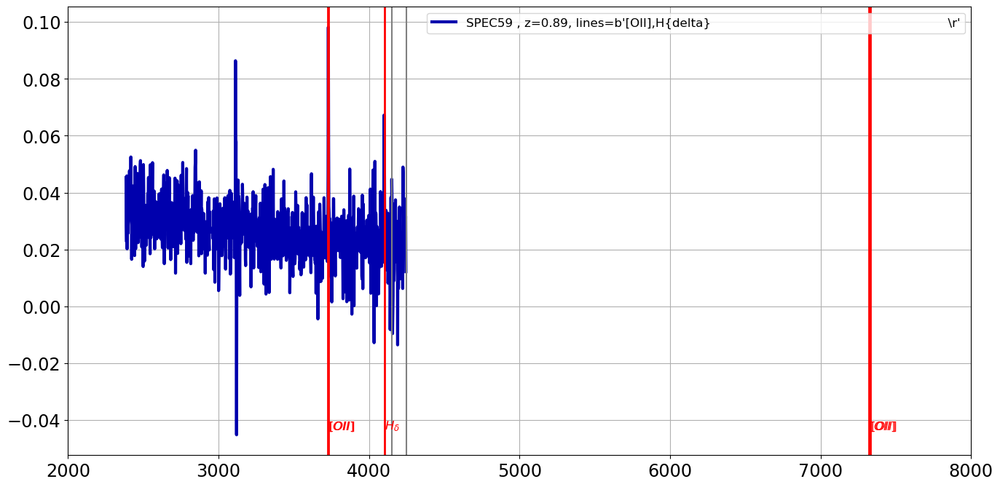

===================== SED 23 : SPEC61 , z=0.49, lines=b'[OII],H10,H9,H8,K,H,H{beta}                                                 \r'=======================
the_lines =  b'[OII],H10,H9,H8,K,H,H{beta}                                                 \r'
[OII]
H10
H9
H8
K
H
H{beta}


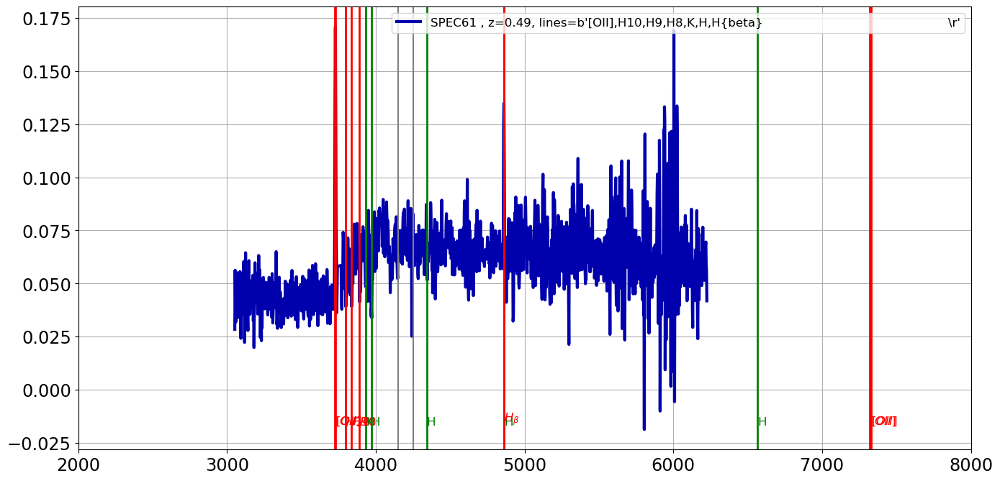

===================== SED 24 : SPEC62 , z=0.32, lines=b'H8,K,H,H{delta},G,H{beta}                                                   \r'=======================
the_lines =  b'H8,K,H,H{delta},G,H{beta}                                                   \r'
H8
K
H
H{delta}
G
H{beta}


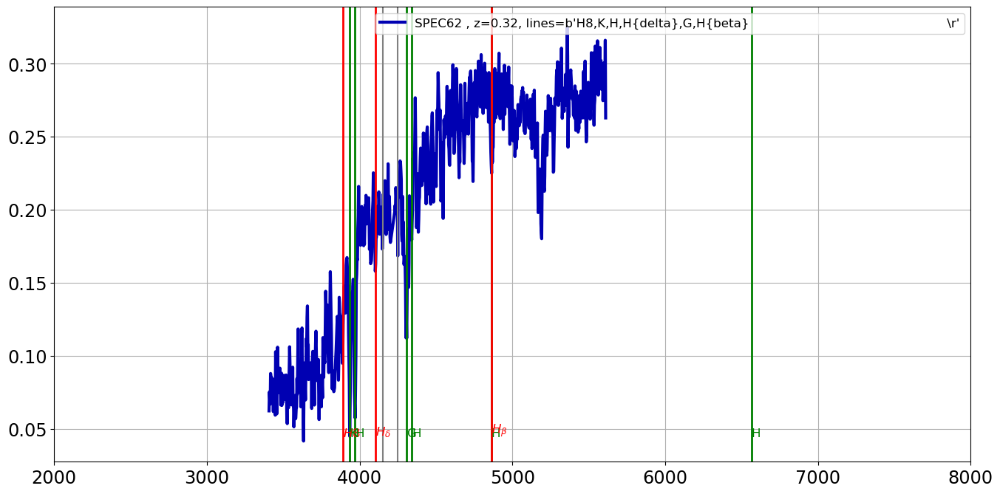

===================== SED 25 : SPEC66 , z=0.45, lines=b'[OII],K,H,[OIII]                                                            \r'=======================
the_lines =  b'[OII],K,H,[OIII]                                                            \r'
[OII]
K
H
[OIII]


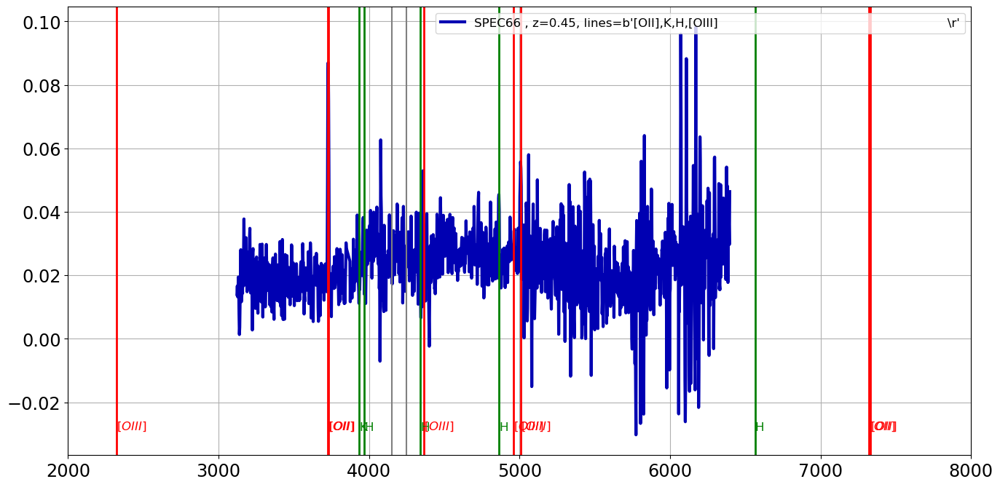

===================== SED 26 : SPEC67 , z=0.53, lines=b'[OII],H10,H9,H8,K,H,H{delta}                                                \r'=======================
the_lines =  b'[OII],H10,H9,H8,K,H,H{delta}                                                \r'
[OII]
H10
H9
H8
K
H
H{delta}


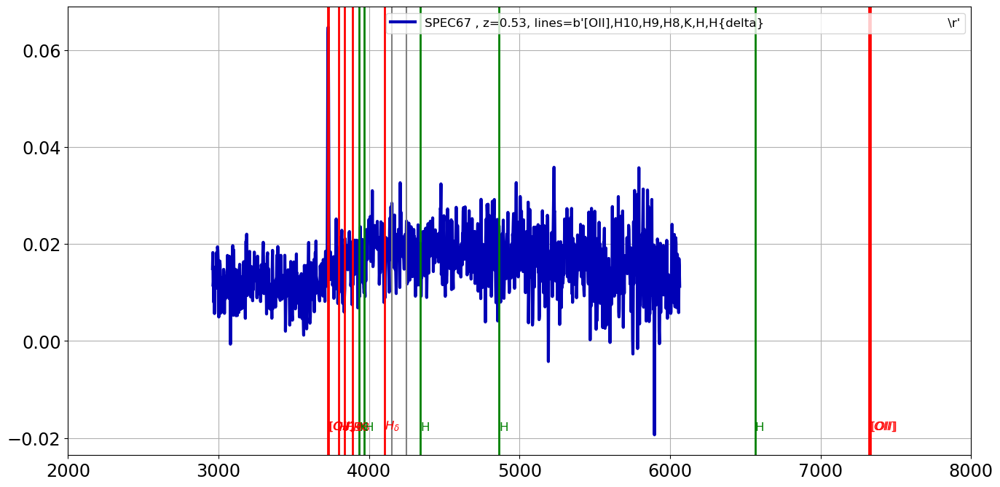

===================== SED 27 : SPEC68 , z=0.12, lines=b'[OIII],H{beta},H{alpha}                                                     \r'=======================
the_lines =  b'[OIII],H{beta},H{alpha}                                                     \r'
[OIII]
H{beta}
H{alpha}


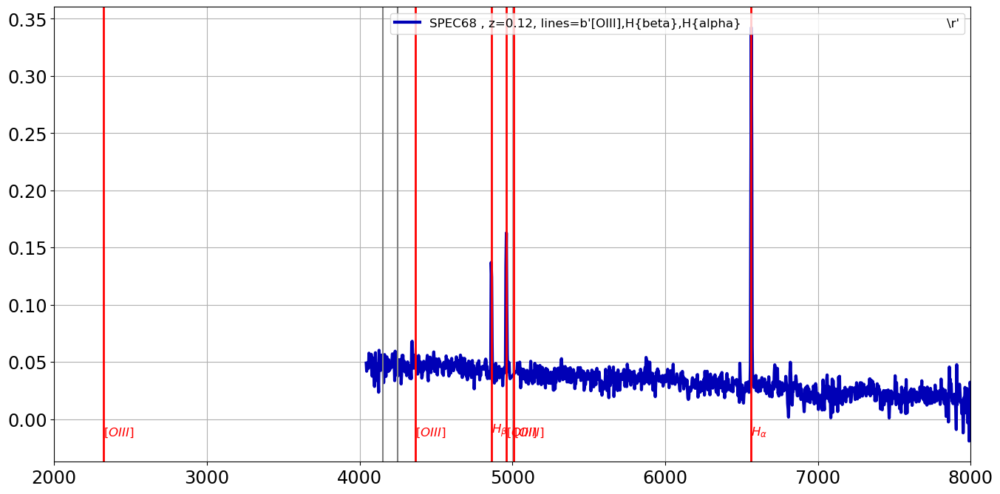

===================== SED 28 : SPEC69 , z=0.83, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


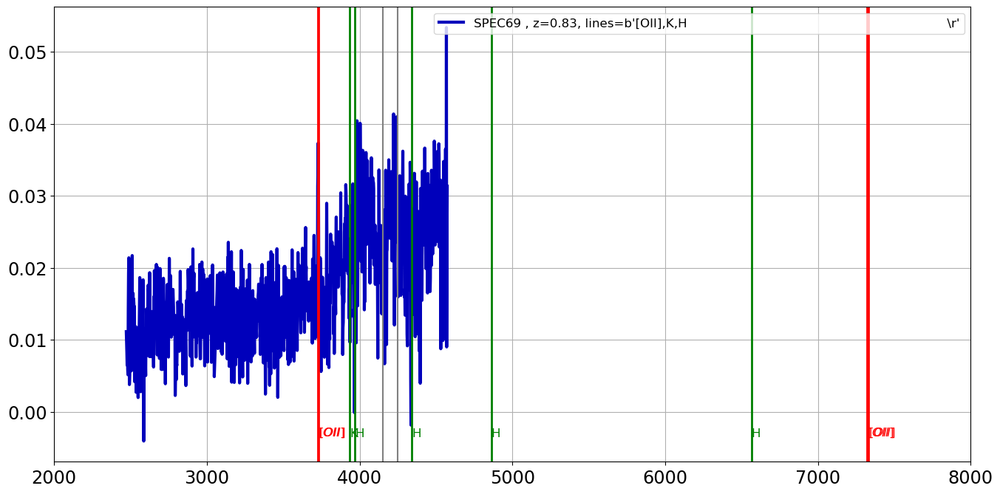

===================== SED 29 : SPEC70 , z=0.98, lines=b'[OII],H10,K,H                                                               \r'=======================
the_lines =  b'[OII],H10,K,H                                                               \r'
[OII]
H10
K
H


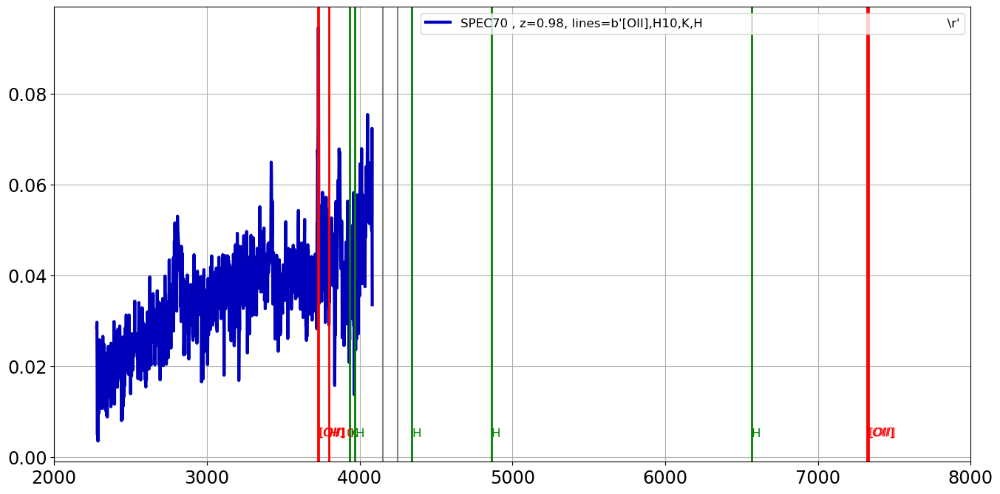

===================== SED 30 : SPEC71 , z=0.29, lines=b'K,H,H{beta}                                                                 \r'=======================
the_lines =  b'K,H,H{beta}                                                                 \r'
K
H
H{beta}


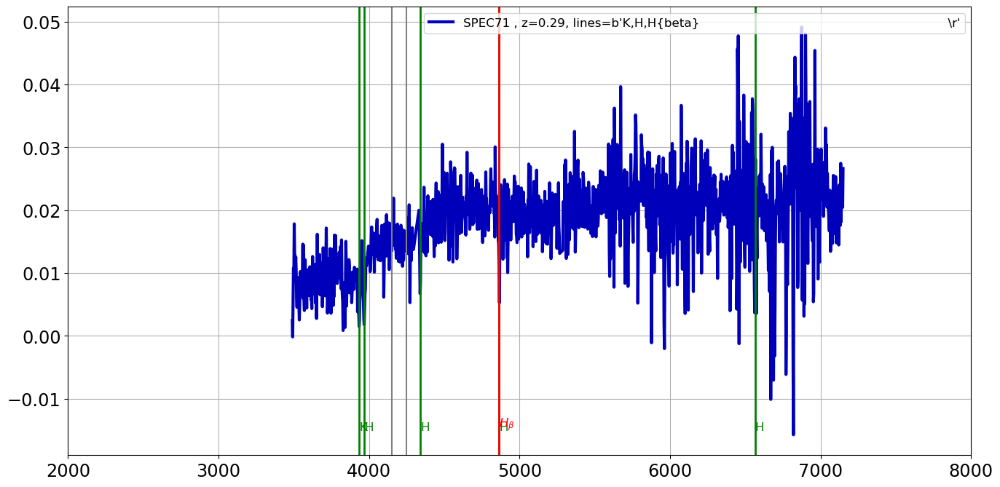

===================== SED 31 : SPEC72 , z=1.00, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


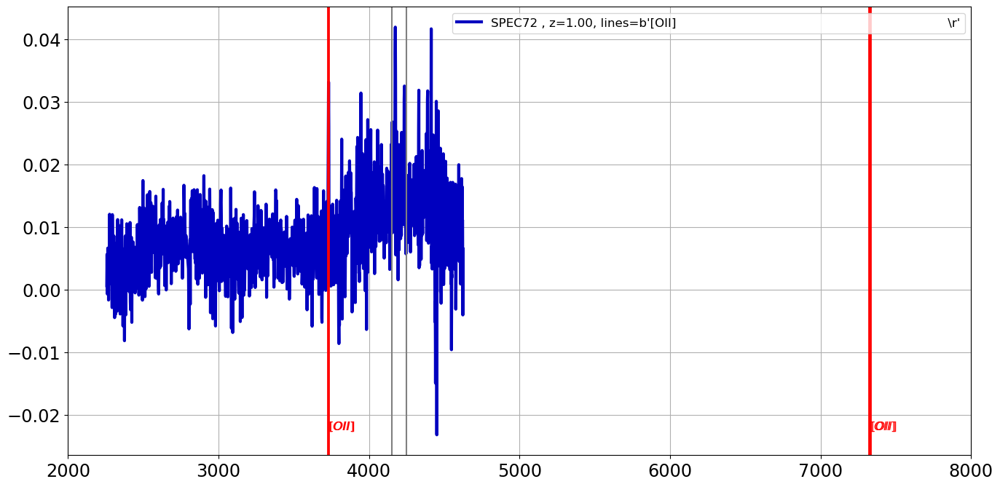

===================== SED 32 : SPEC73 , z=0.63, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


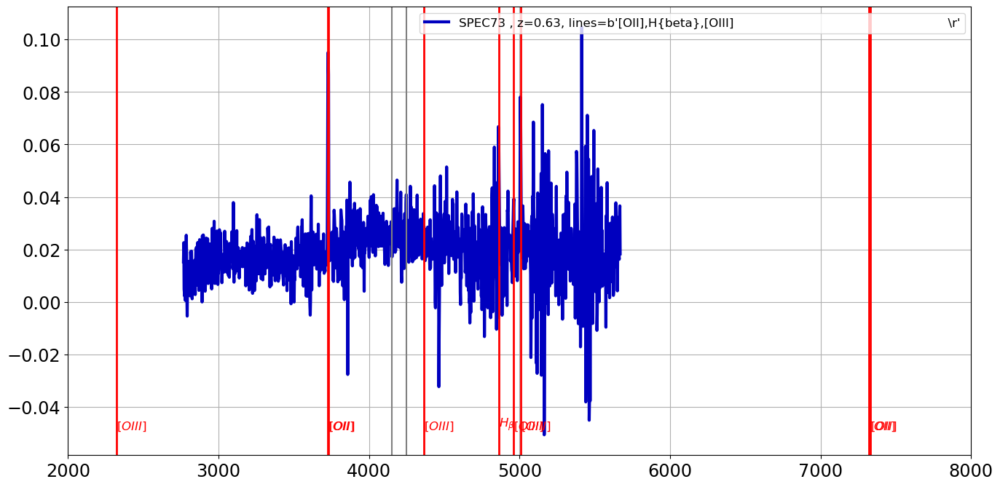

===================== SED 33 : SPEC77 , z=0.96, lines=b'[OII],H9,K,H,H{gamma}                                                       \r'=======================
the_lines =  b'[OII],H9,K,H,H{gamma}                                                       \r'
[OII]
H9
K
H
H{gamma}


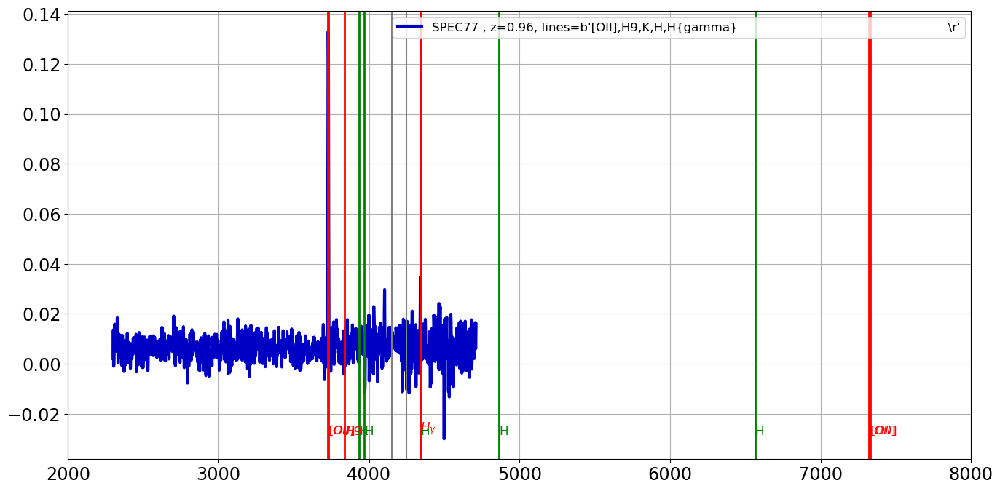

===================== SED 34 : SPEC79 , z=0.29, lines=b'[OII],H10,H9,H8,H,H{delta}                                                  \r'=======================
the_lines =  b'[OII],H10,H9,H8,H,H{delta}                                                  \r'
[OII]
H10
H9
H8
H
H{delta}


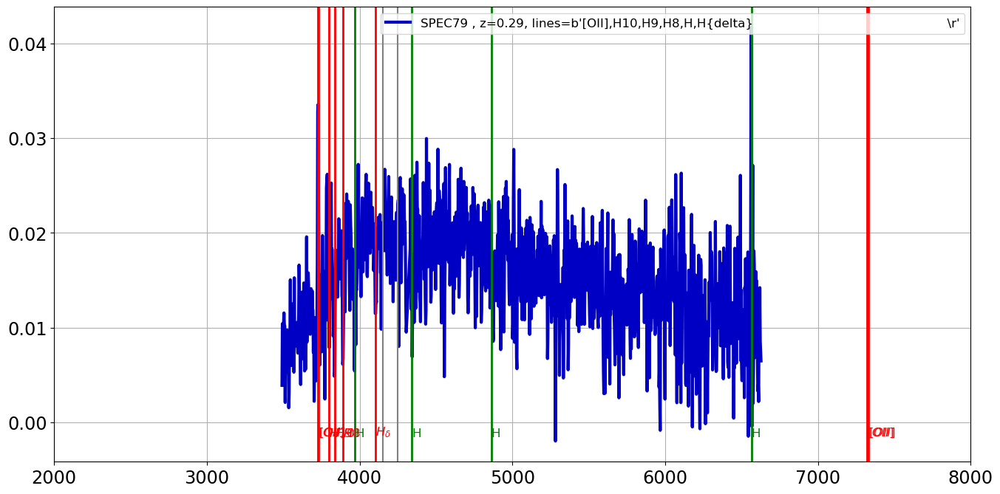

===================== SED 35 : SPEC80 , z=0.63, lines=b'[OII],H,H{gamma},H{beta},[OIII]                                             \r'=======================
the_lines =  b'[OII],H,H{gamma},H{beta},[OIII]                                             \r'
[OII]
H
H{gamma}
H{beta}
[OIII]


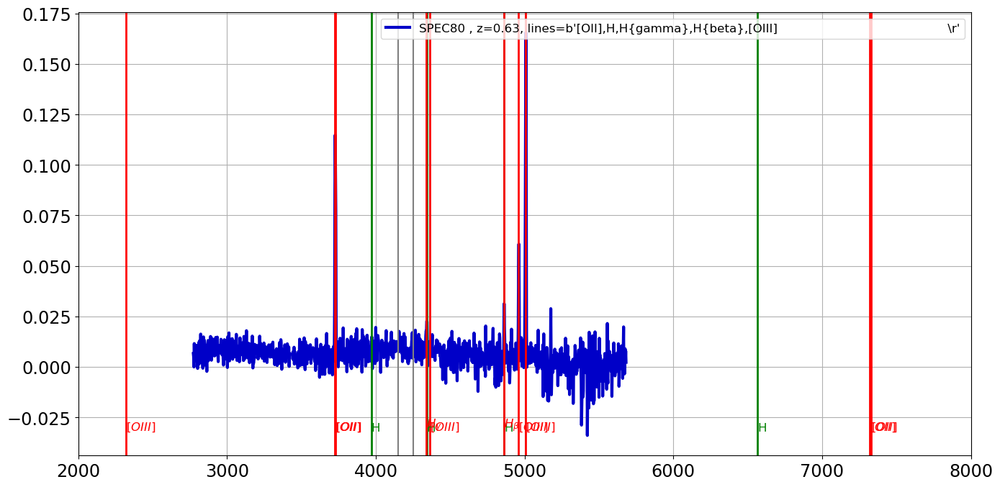

===================== SED 36 : SPEC83 , z=0.63, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


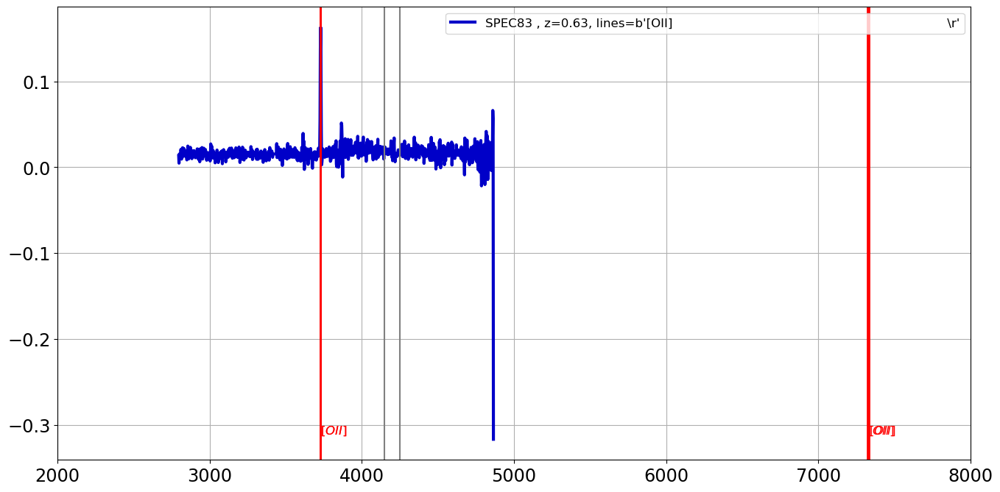

===================== SED 37 : SPEC84 , z=1.05, lines=b'MgII,[OII],K                                                                \r'=======================
the_lines =  b'MgII,[OII],K                                                                \r'
MgII
[OII]
K


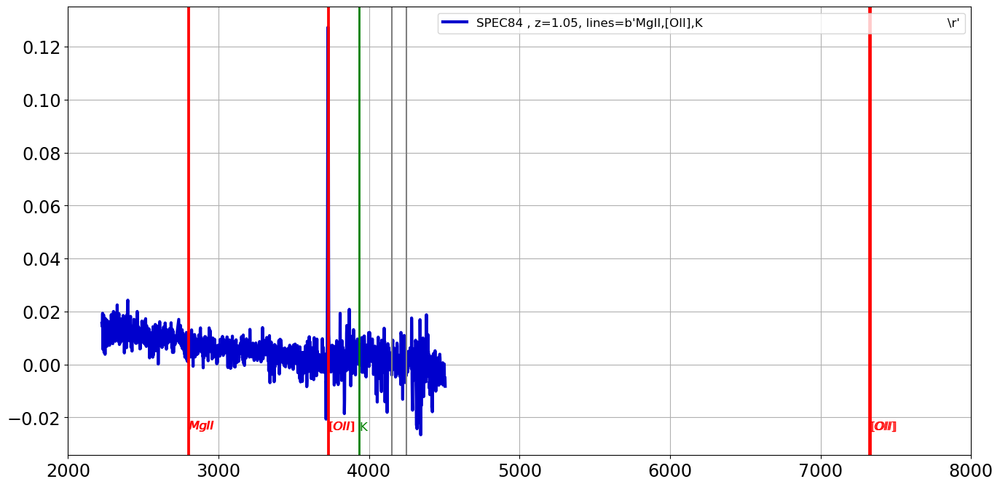

===================== SED 38 : SPEC85 , z=0.98, lines=b'MgII,[OII],H                                                                \r'=======================
the_lines =  b'MgII,[OII],H                                                                \r'
MgII
[OII]
H


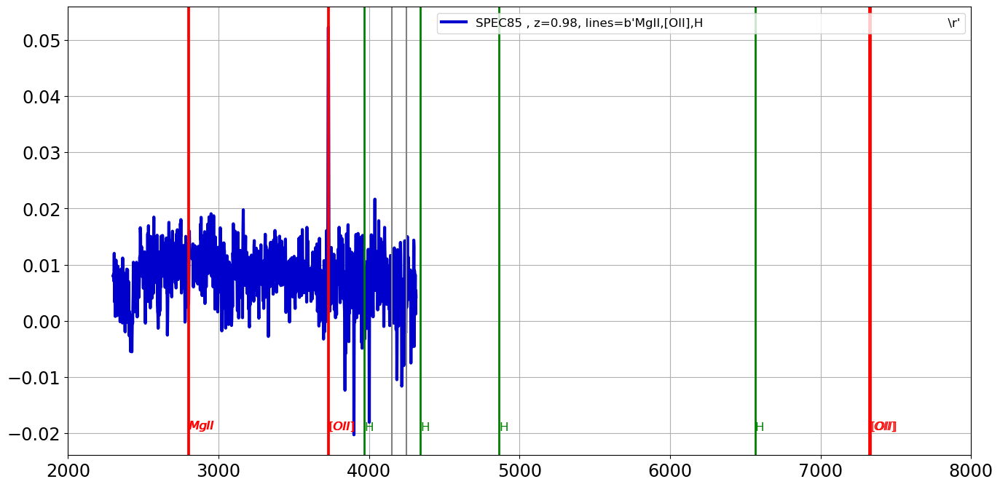

===================== SED 39 : SPEC86 , z=0.13, lines=b'[OIII],H{beta},H{alpha}                                                     \r'=======================
the_lines =  b'[OIII],H{beta},H{alpha}                                                     \r'
[OIII]
H{beta}
H{alpha}


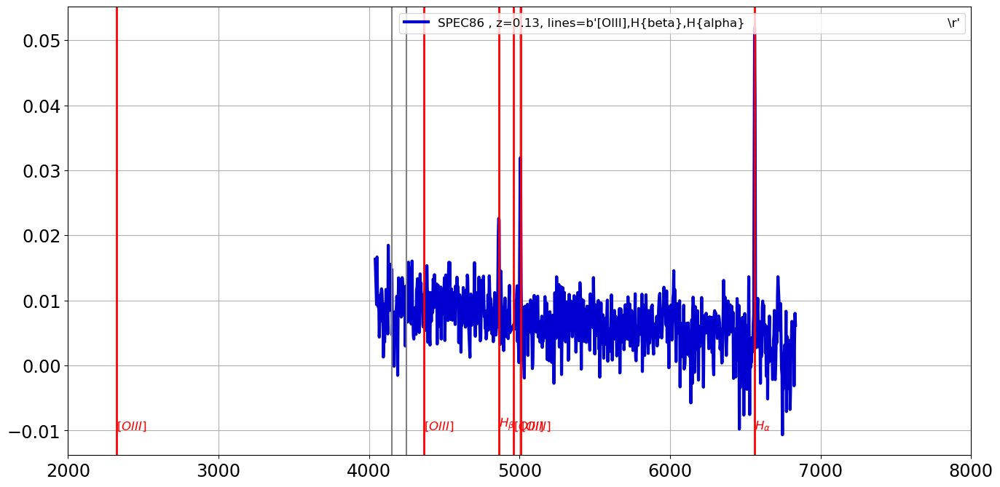

===================== SED 40 : SPEC87 , z=1.10, lines=b'MgII,[OII],H10                                                              \r'=======================
the_lines =  b'MgII,[OII],H10                                                              \r'
MgII
[OII]
H10


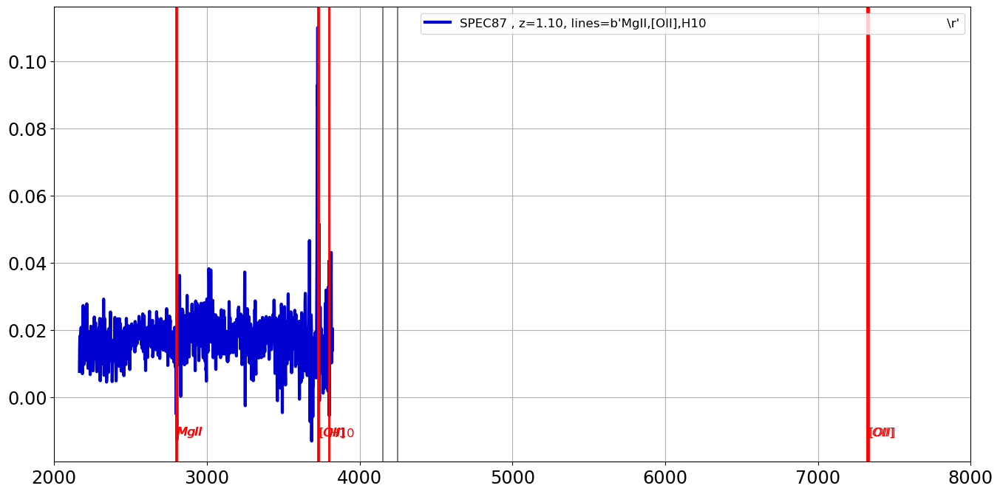

===================== SED 41 : SPEC89 , z=0.69, lines=b'[OII],H8,K,H,H{beta},[OIII]                                                 \r'=======================
the_lines =  b'[OII],H8,K,H,H{beta},[OIII]                                                 \r'
[OII]
H8
K
H
H{beta}
[OIII]


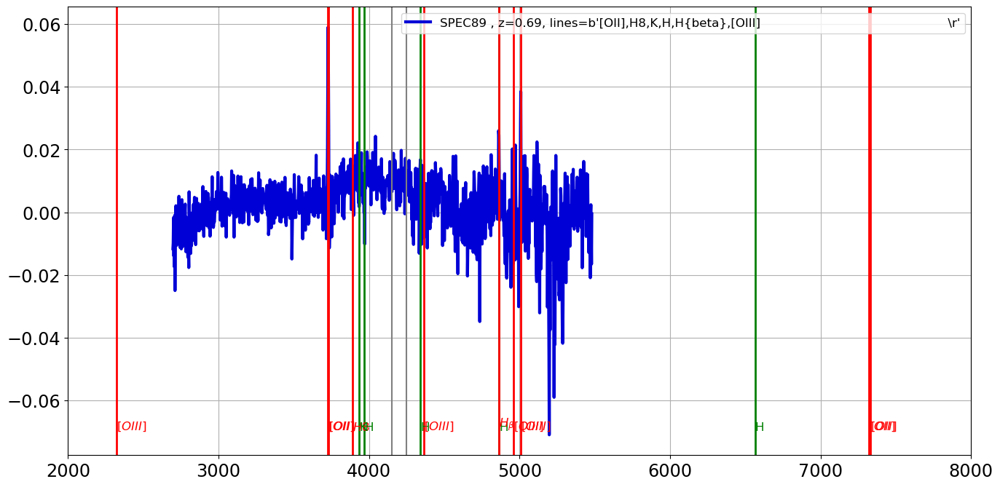

===================== SED 42 : SPEC91 , z=0.69, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


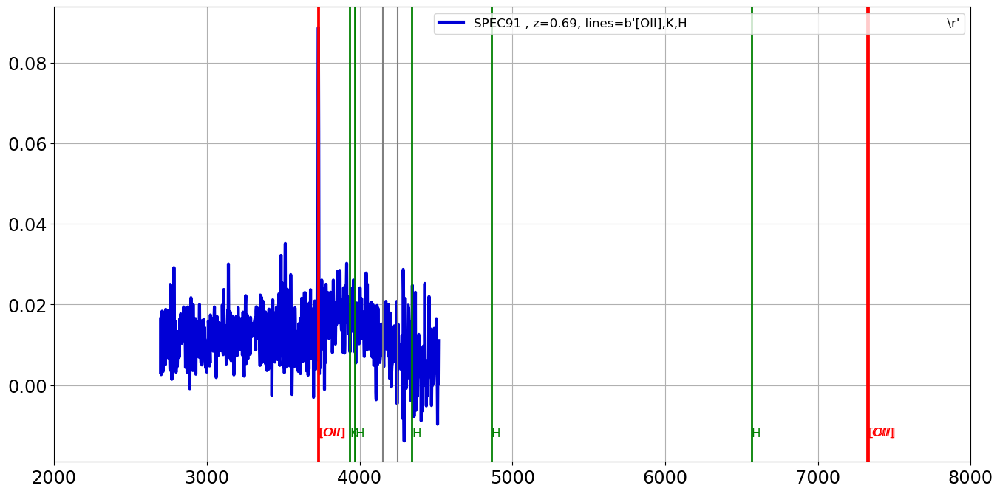

===================== SED 43 : SPEC93 , z=0.29, lines=b'[OII],H{beta},[OIII],H{alpha}                                               \r'=======================
the_lines =  b'[OII],H{beta},[OIII],H{alpha}                                               \r'
[OII]
H{beta}
[OIII]
H{alpha}


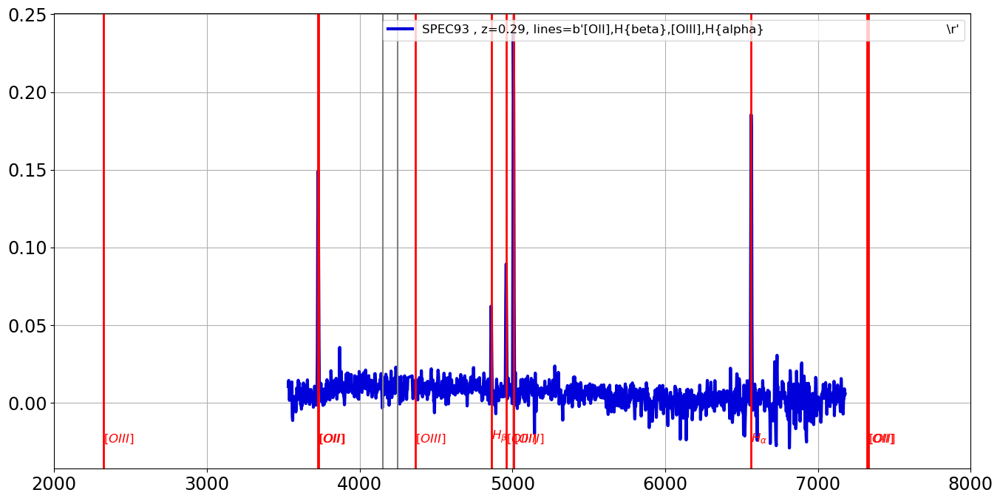

===================== SED 44 : SPEC96 , z=0.77, lines=b'[OII],H8,K,H,[OIII]                                                         \r'=======================
the_lines =  b'[OII],H8,K,H,[OIII]                                                         \r'
[OII]
H8
K
H
[OIII]


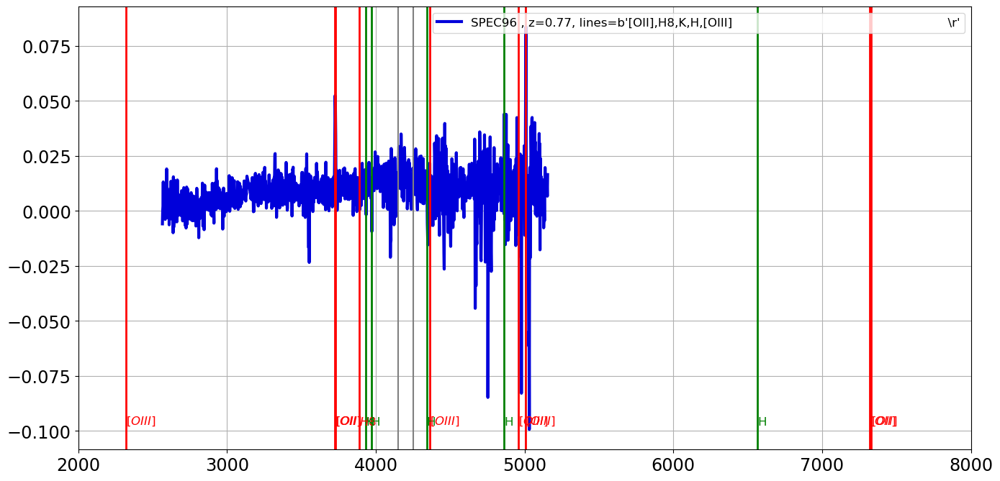

===================== SED 45 : SPEC97 , z=0.44, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


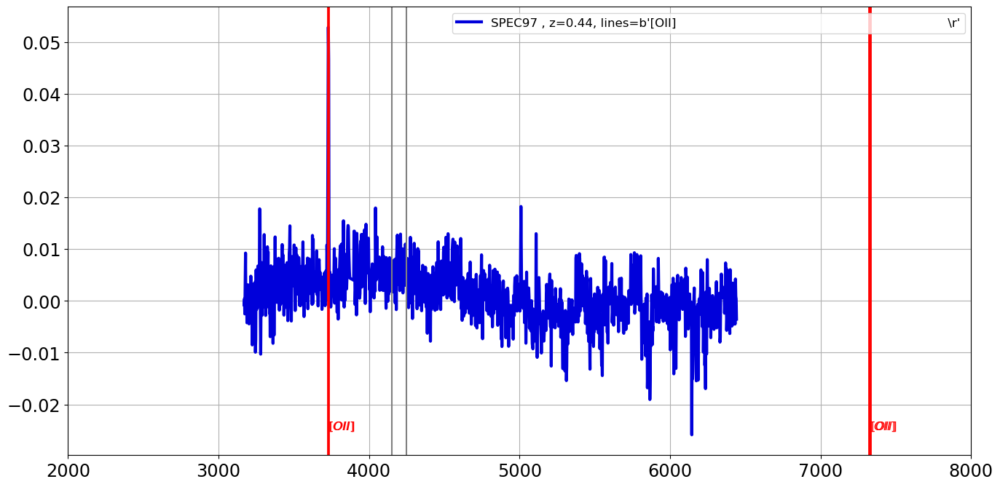

===================== SED 46 : SPEC102 , z=0.51, lines=b'[OII],H{epsilon},H{delta},H{gamma},H{beta},[OIII]                           \r'=======================
the_lines =  b'[OII],H{epsilon},H{delta},H{gamma},H{beta},[OIII]                           \r'
[OII]
H{epsilon}
H{delta}
H{gamma}
H{beta}
[OIII]


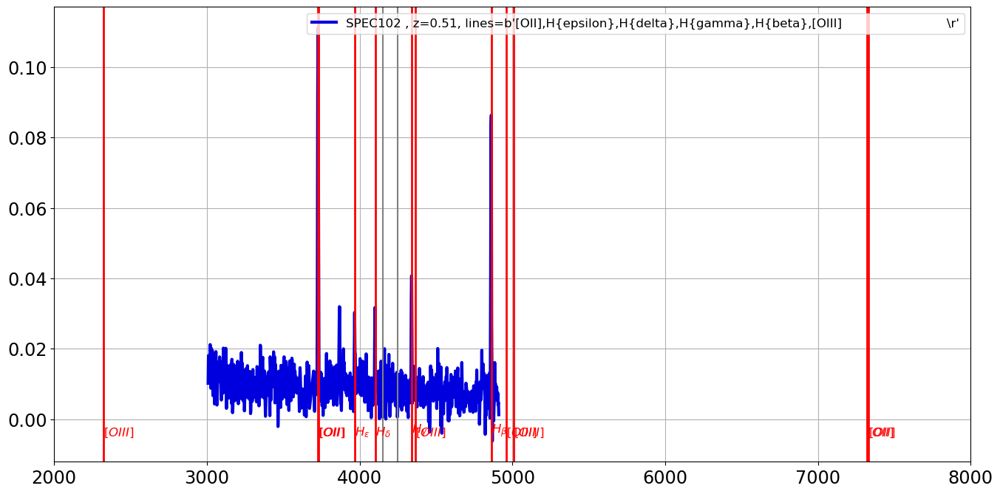

===================== SED 47 : SPEC106 , z=0.64, lines=b'[OII],H9,H{beta}                                                            \r'=======================
the_lines =  b'[OII],H9,H{beta}                                                            \r'
[OII]
H9
H{beta}


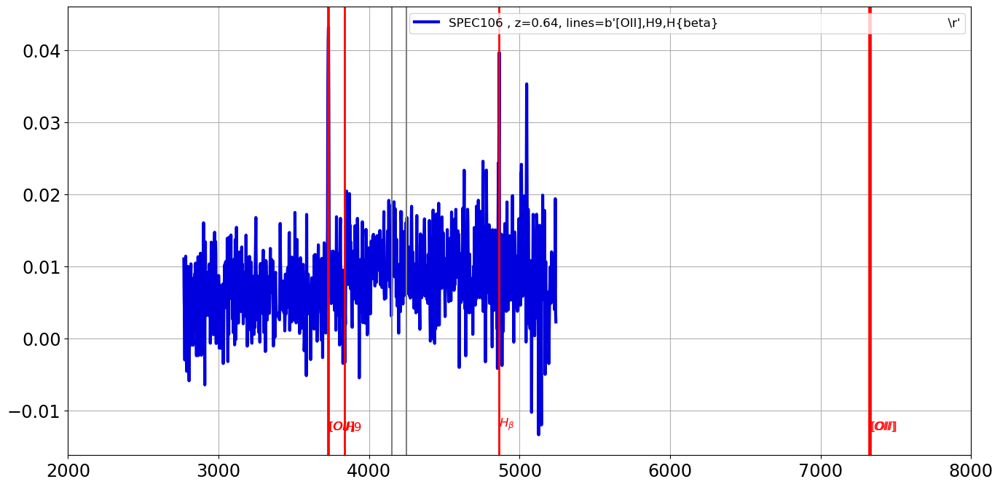

===================== SED 48 : SPEC107 , z=1.02, lines=b'[OII],H9                                                                    \r'=======================
the_lines =  b'[OII],H9                                                                    \r'
[OII]
H9


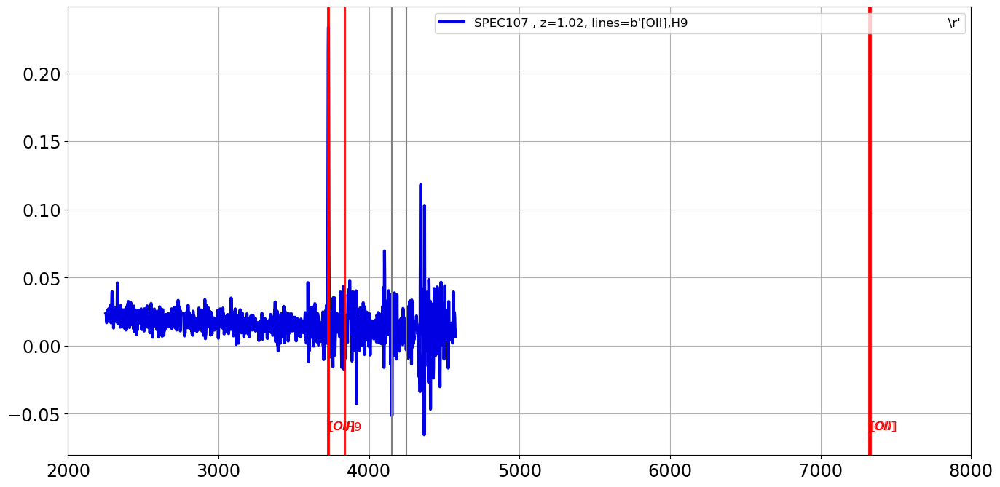

===================== SED 49 : SPEC109 , z=0.83, lines=b'[OII],H9,K,H{beta},[OIII]                                                   \r'=======================
the_lines =  b'[OII],H9,K,H{beta},[OIII]                                                   \r'
[OII]
H9
K
H{beta}
[OIII]


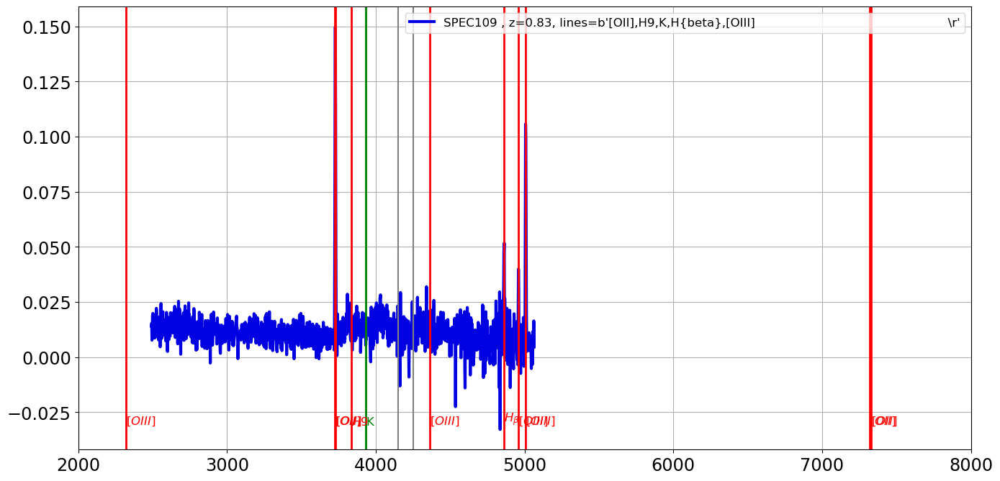

===================== SED 50 : SPEC110 , z=0.80, lines=b'[OII],H10,K                                                                 \r'=======================
the_lines =  b'[OII],H10,K                                                                 \r'
[OII]
H10
K


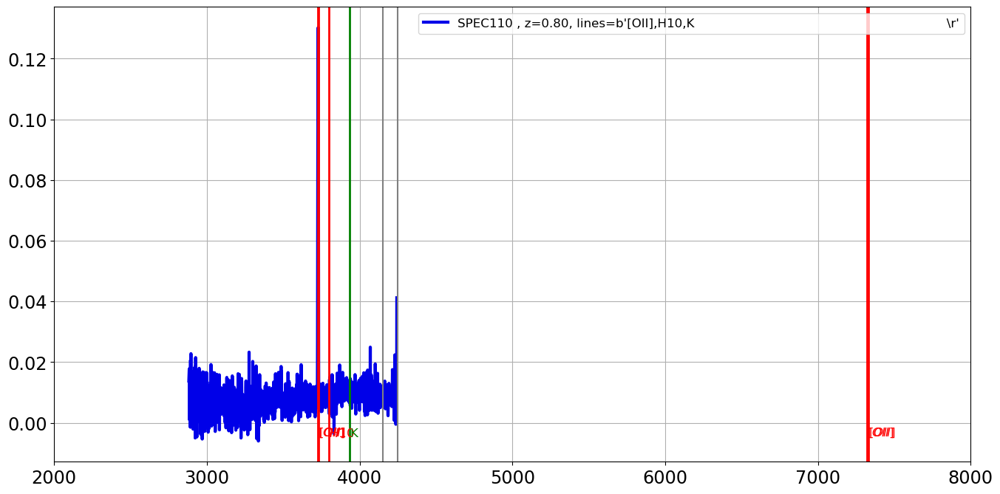

===================== SED 51 : SPEC111 , z=0.61, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


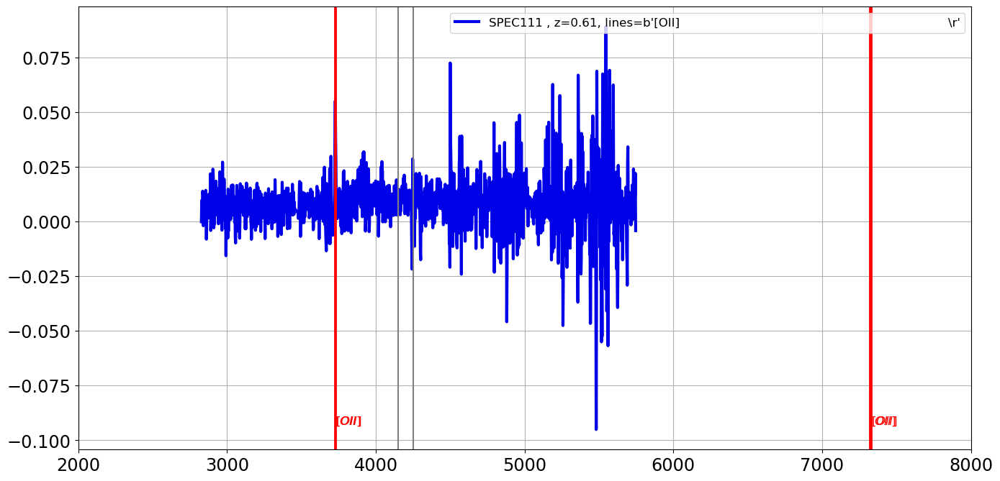

===================== SED 52 : SPEC112 , z=0.84, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


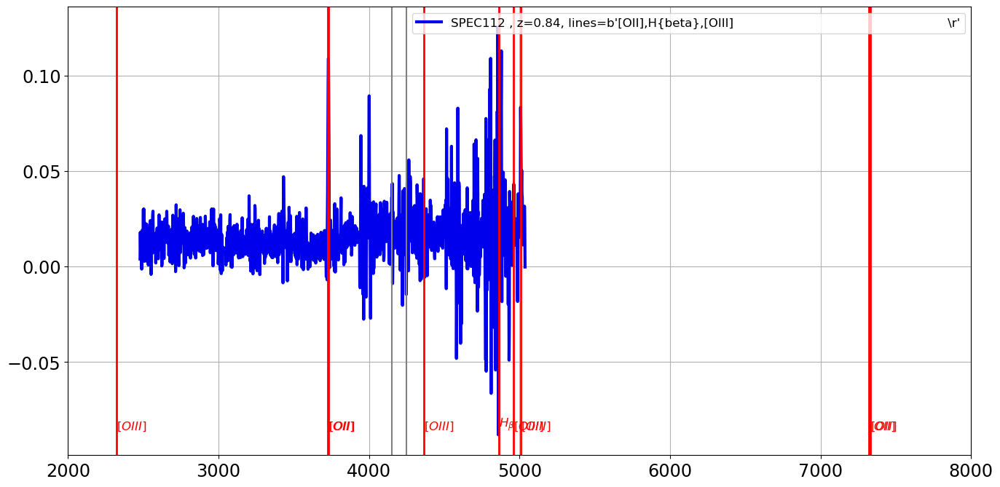

===================== SED 53 : SPEC113 , z=1.30, lines=b'MgII,[OII]                                                                  \r'=======================
the_lines =  b'MgII,[OII]                                                                  \r'
MgII
[OII]


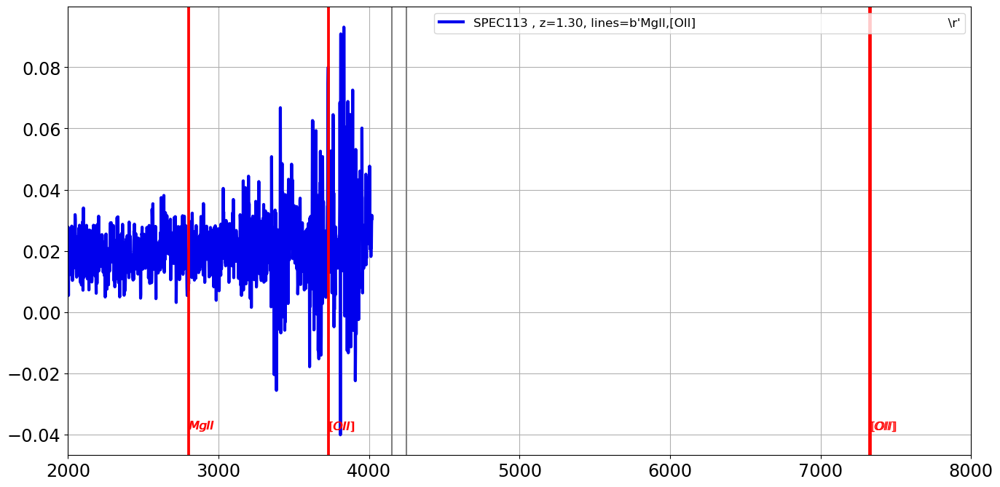

===================== SED 54 : SPEC114 , z=1.21, lines=b'MgII,[OII]                                                                  \r'=======================
the_lines =  b'MgII,[OII]                                                                  \r'
MgII
[OII]


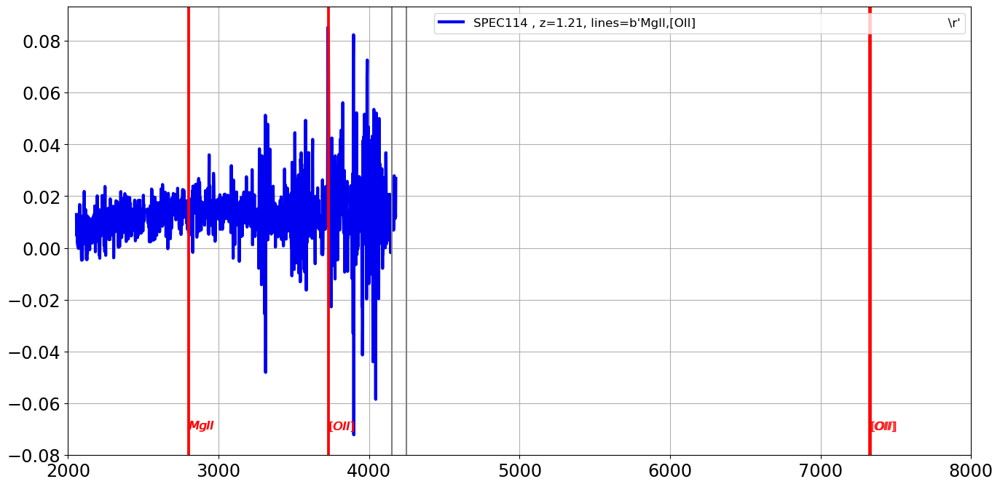

===================== SED 55 : SPEC115 , z=0.69, lines=b'MgII,H10,H9,H8,K,H,H{delta}                                                 \r'=======================
the_lines =  b'MgII,H10,H9,H8,K,H,H{delta}                                                 \r'
MgII
H10
H9
H8
K
H
H{delta}


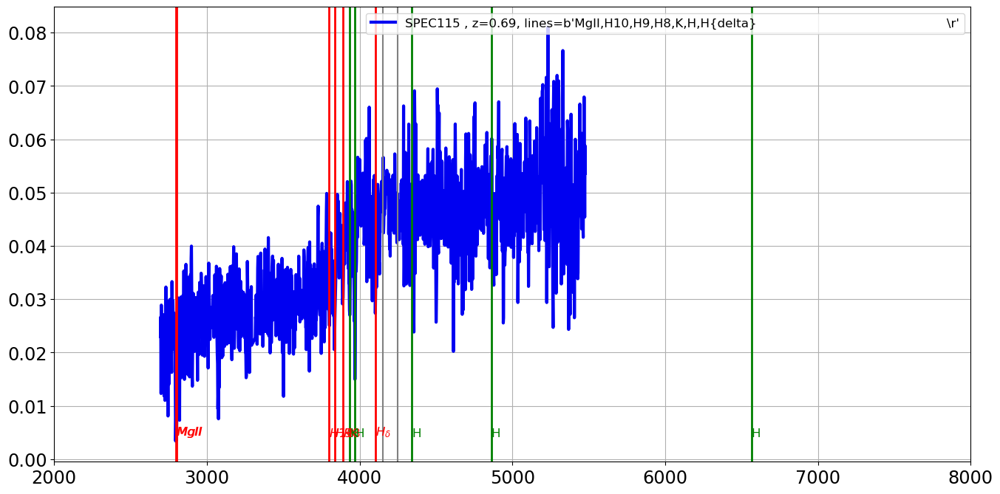

===================== SED 56 : SPEC117 , z=0.45, lines=b'[OII],H9,H8,K,H                                                             \r'=======================
the_lines =  b'[OII],H9,H8,K,H                                                             \r'
[OII]
H9
H8
K
H


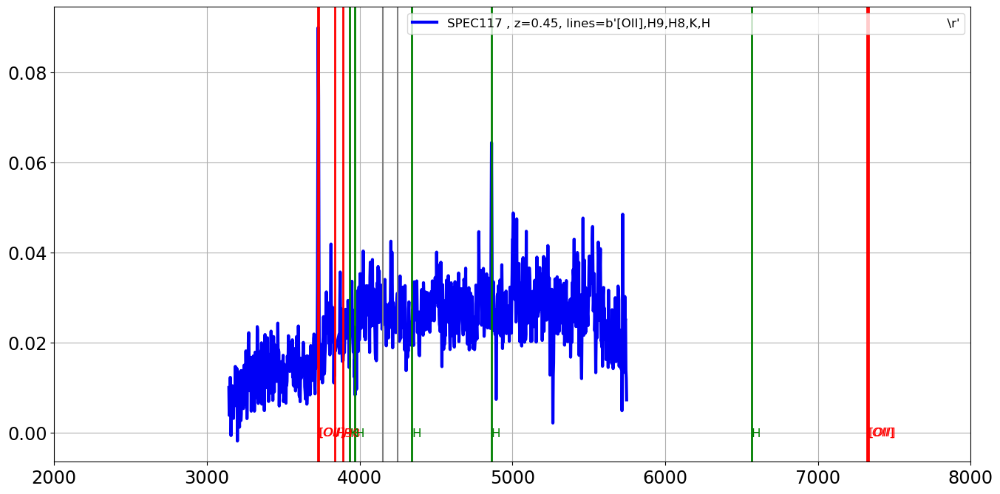

===================== SED 57 : SPEC118 , z=0.69, lines=b'H9,K,H,G                                                                    \r'=======================
the_lines =  b'H9,K,H,G                                                                    \r'
H9
K
H
G


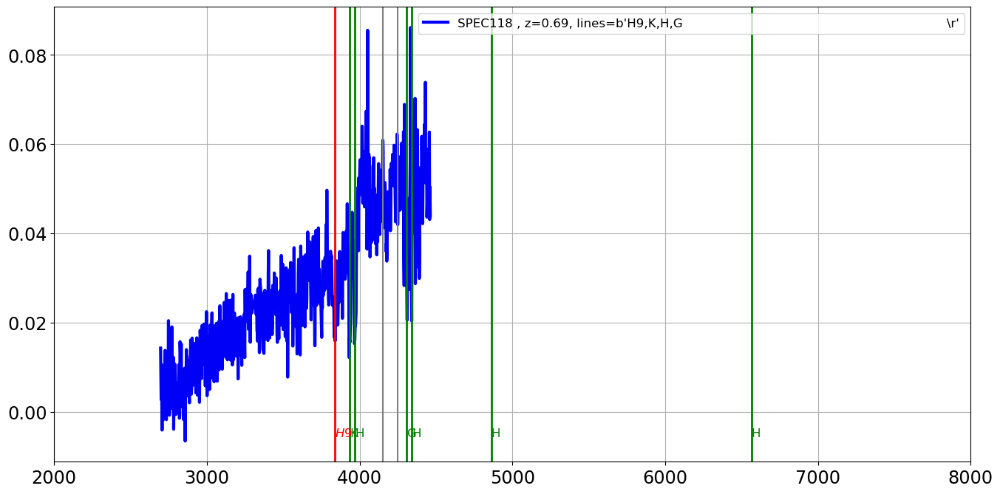

===================== SED 58 : SPEC120 , z=0.56, lines=b'[OII],H9,H{beta},[OIII]                                                     \r'=======================
the_lines =  b'[OII],H9,H{beta},[OIII]                                                     \r'
[OII]
H9
H{beta}
[OIII]


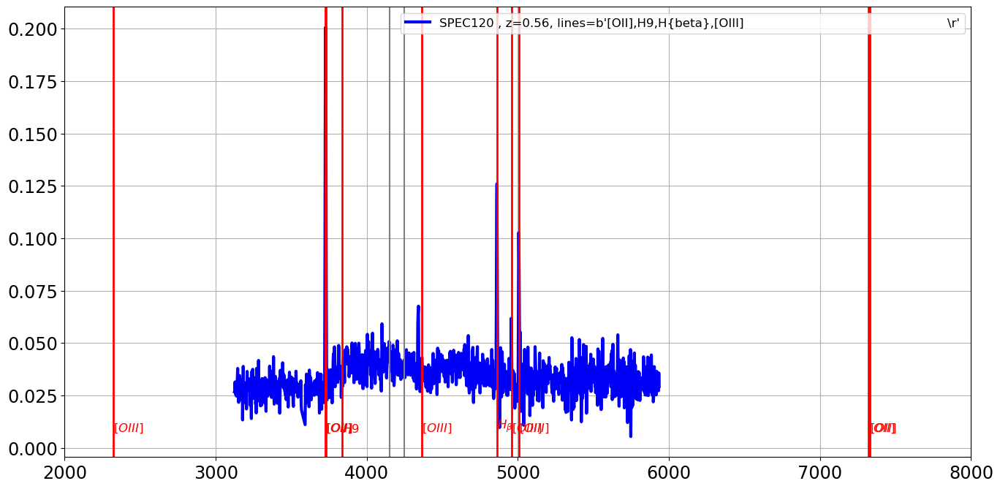

===================== SED 59 : SPEC121 , z=0.88, lines=b'MgII,[OII],H9,H                                                             \r'=======================
the_lines =  b'MgII,[OII],H9,H                                                             \r'
MgII
[OII]
H9
H


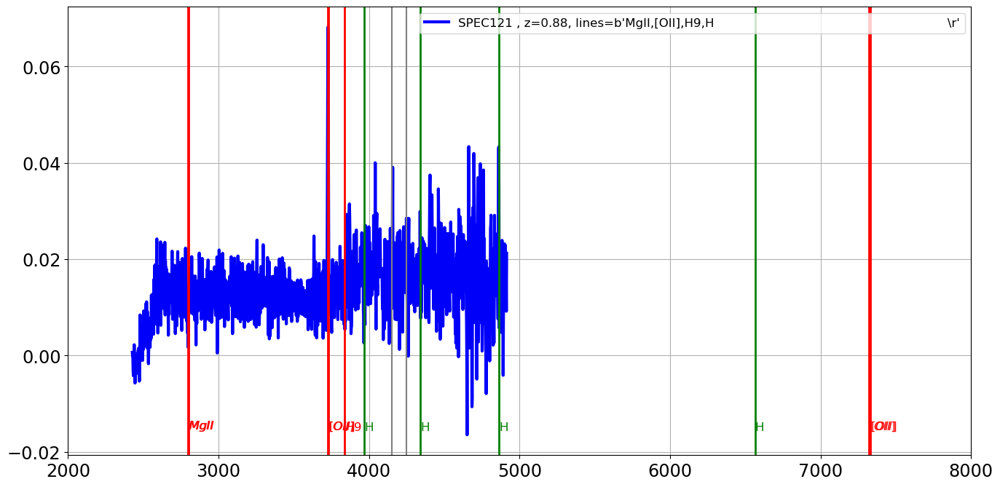

===================== SED 60 : SPEC123 , z=0.64, lines=b'[OII],H10,H9,H8,H,H{delta},H{beta},[OIII]                                   \r'=======================
the_lines =  b'[OII],H10,H9,H8,H,H{delta},H{beta},[OIII]                                   \r'
[OII]
H10
H9
H8
H
H{delta}
H{beta}
[OIII]


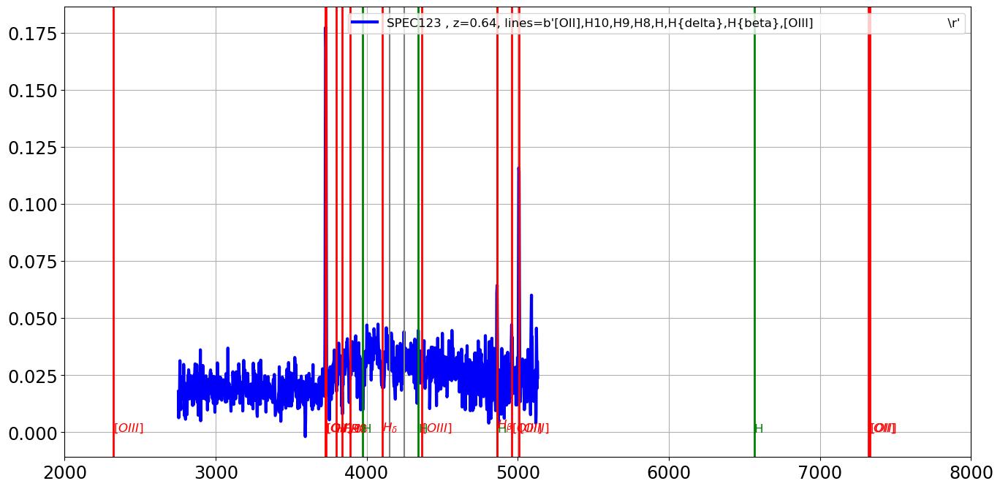

===================== SED 61 : SPEC127 , z=0.56, lines=b'[OII],H,H{delta},H{beta},[OIII]                                             \r'=======================
the_lines =  b'[OII],H,H{delta},H{beta},[OIII]                                             \r'
[OII]
H
H{delta}
H{beta}
[OIII]


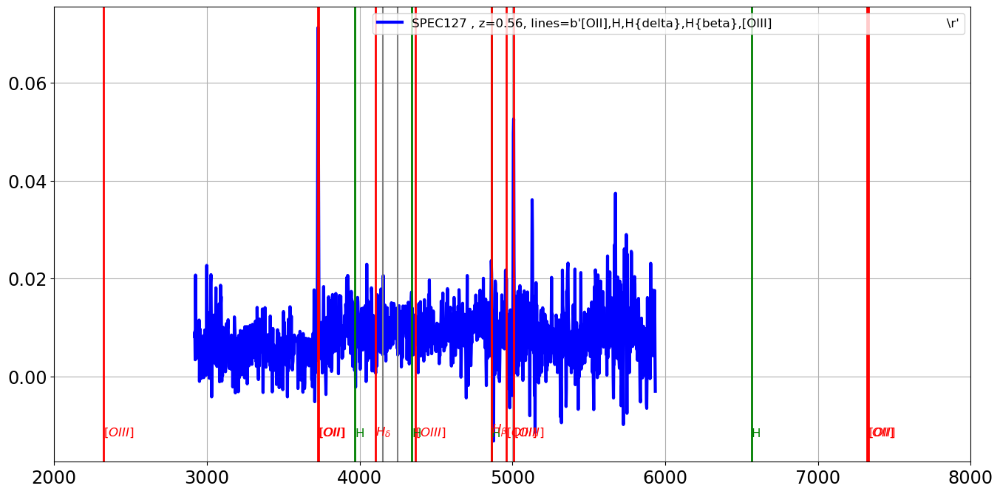

===================== SED 62 : SPEC128 , z=0.19, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


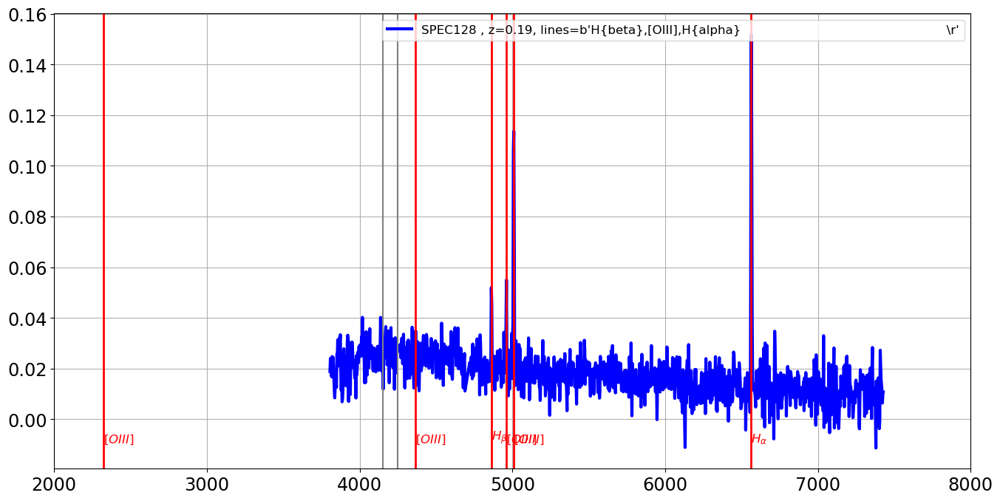

===================== SED 63 : SPEC132 , z=0.29, lines=b'K,H,H{delta},Fe43,H{beta}                                                   \r'=======================
the_lines =  b'K,H,H{delta},Fe43,H{beta}                                                   \r'
K
H
H{delta}
Fe43
H{beta}


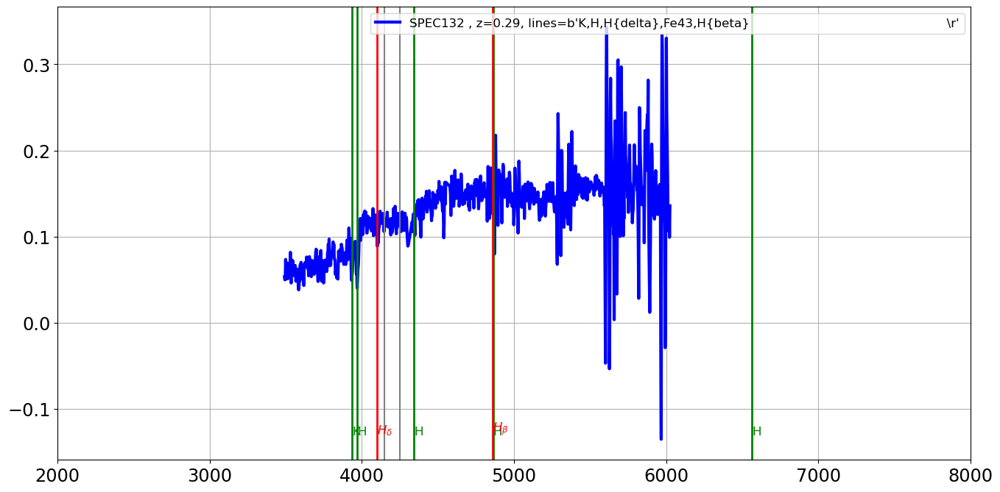

===================== SED 64 : SPEC134 , z=0.42, lines=b'[OII],H,[OIII]                                                              \r'=======================
the_lines =  b'[OII],H,[OIII]                                                              \r'
[OII]
H
[OIII]


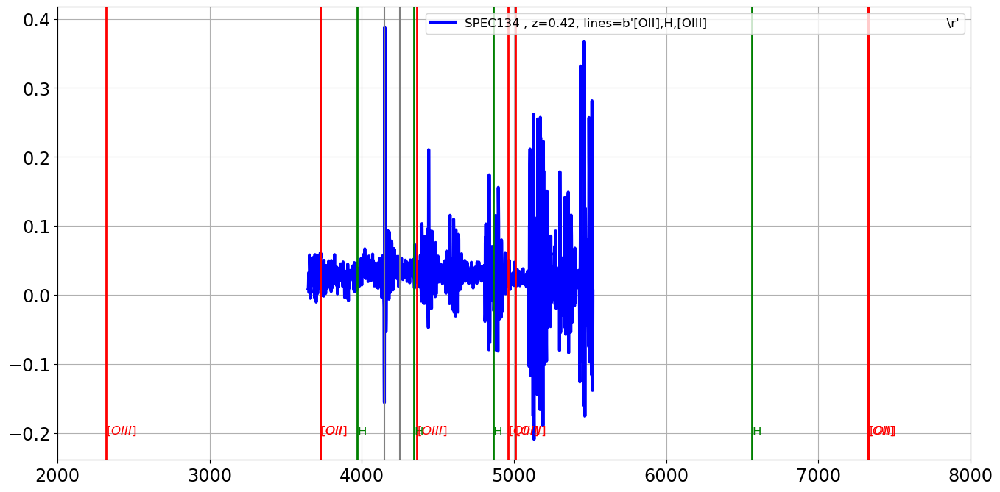

===================== SED 65 : SPEC135 , z=0.69, lines=b'[OII],H10,H9,H8,K,H                                                         \r'=======================
the_lines =  b'[OII],H10,H9,H8,K,H                                                         \r'
[OII]
H10
H9
H8
K
H


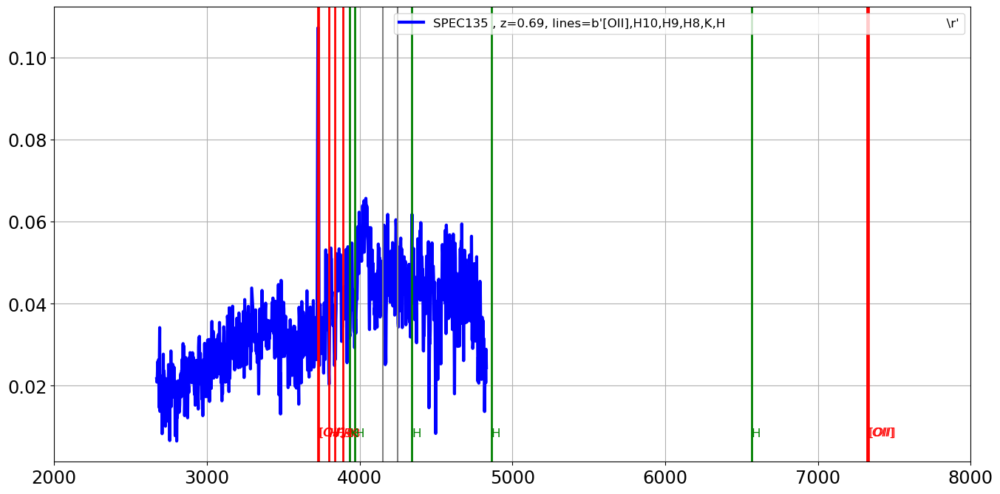

===================== SED 66 : SPEC137 , z=0.30, lines=b'K,H,Mgb                                                                     \r'=======================
the_lines =  b'K,H,Mgb                                                                     \r'
K
H
Mgb


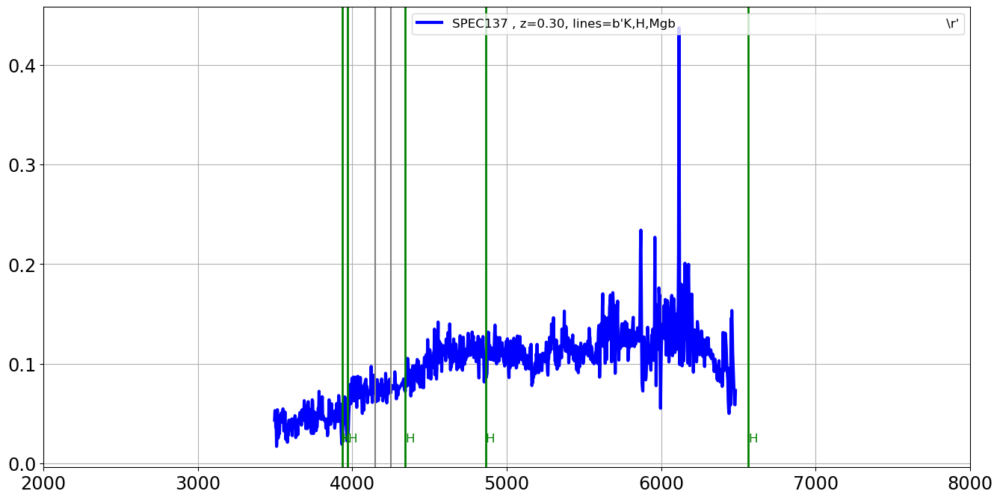

===================== SED 67 : SPEC138 , z=0.56, lines=b'[OII],H9,H8,K,H,H{delta},H{beta}                                            \r'=======================
the_lines =  b'[OII],H9,H8,K,H,H{delta},H{beta}                                            \r'
[OII]
H9
H8
K
H
H{delta}
H{beta}


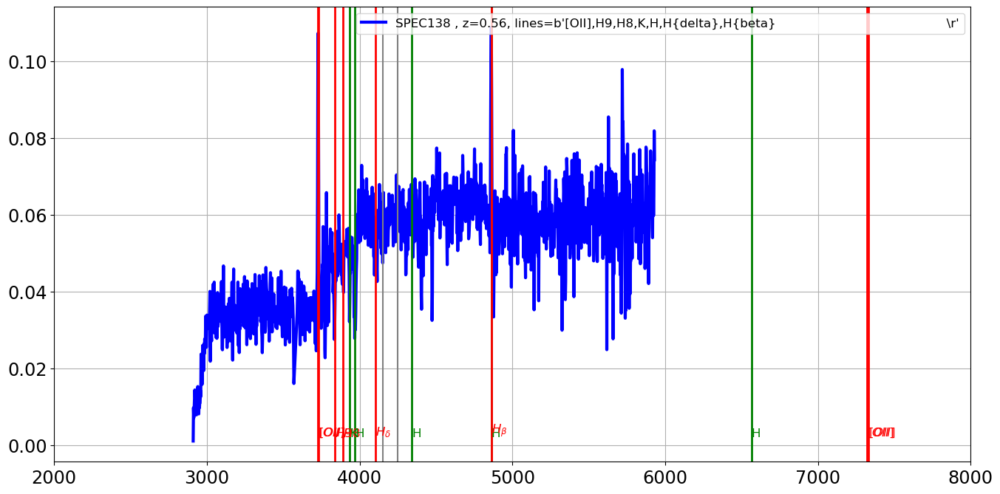

===================== SED 68 : SPEC141 , z=0.29, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


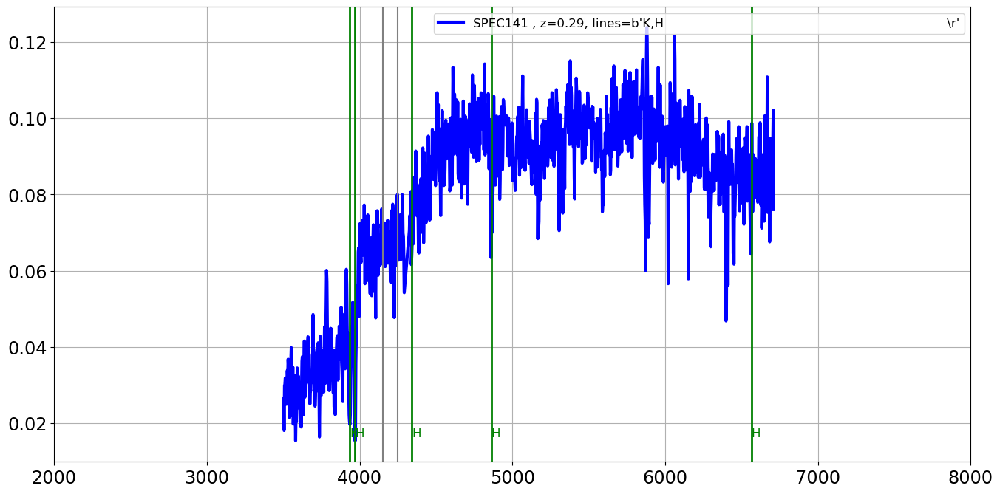

===================== SED 69 : SPEC149 , z=0.44, lines=b'K,H,G,H{delta},H{beta}                                                      \r'=======================
the_lines =  b'K,H,G,H{delta},H{beta}                                                      \r'
K
H
G
H{delta}
H{beta}


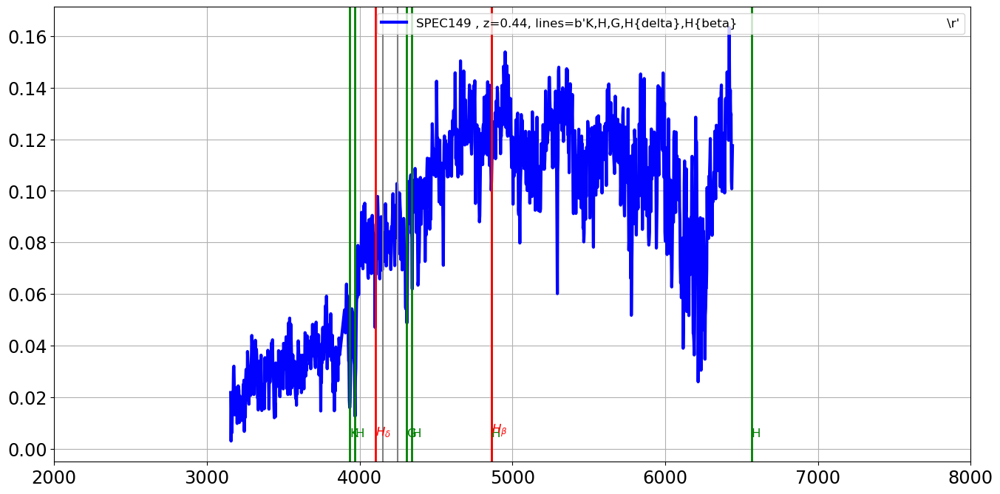

===================== SED 70 : SPEC151 , z=0.50, lines=b'[OII],K,H,H{beta}                                                           \r'=======================
the_lines =  b'[OII],K,H,H{beta}                                                           \r'
[OII]
K
H
H{beta}


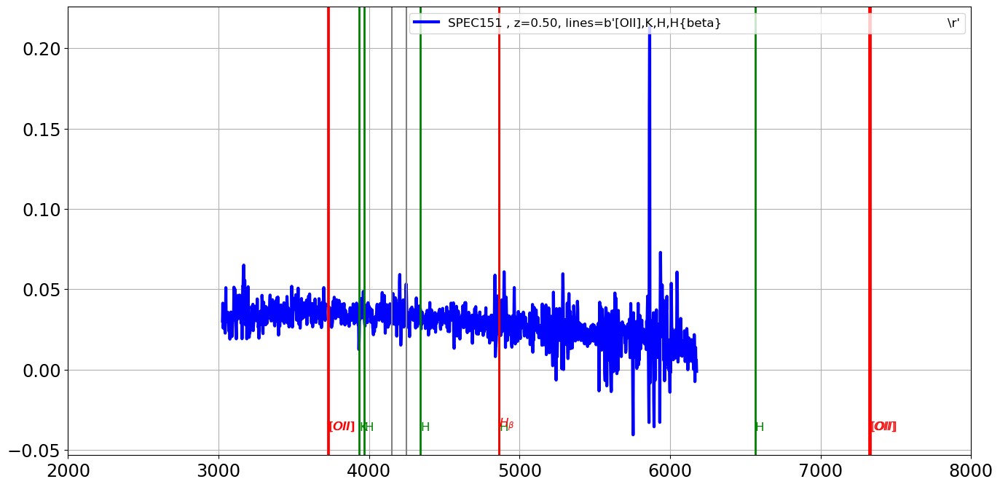

===================== SED 71 : SPEC152 , z=0.13, lines=b'[OIII],H{alpha}                                                             \r'=======================
the_lines =  b'[OIII],H{alpha}                                                             \r'
[OIII]
H{alpha}


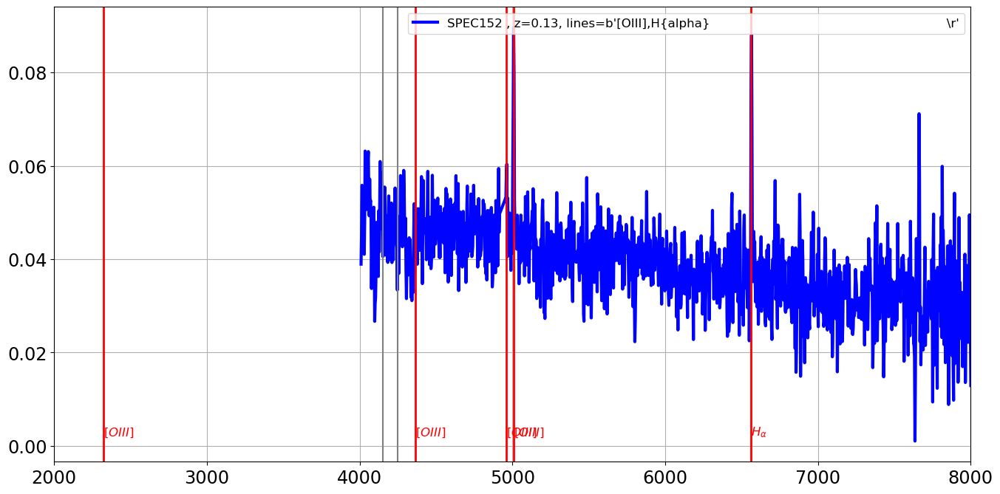

===================== SED 72 : SPEC156 , z=0.18, lines=b'H{beta},[OIII]                                                              \r'=======================
the_lines =  b'H{beta},[OIII]                                                              \r'
H{beta}
[OIII]


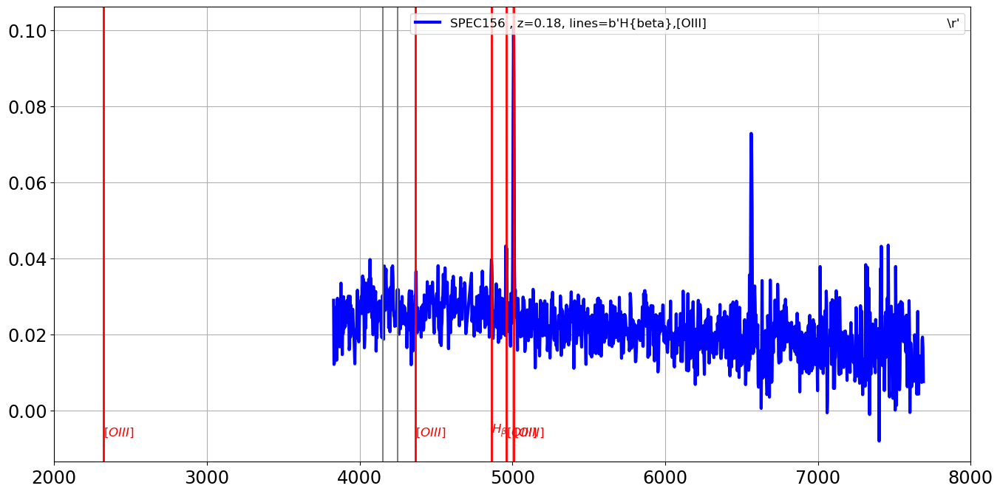

===================== SED 73 : SPEC160 , z=0.20, lines=b'H9,K,H,H{delta},[OIII],H{alpha}                                             \r'=======================
the_lines =  b'H9,K,H,H{delta},[OIII],H{alpha}                                             \r'
H9
K
H
H{delta}
[OIII]
H{alpha}


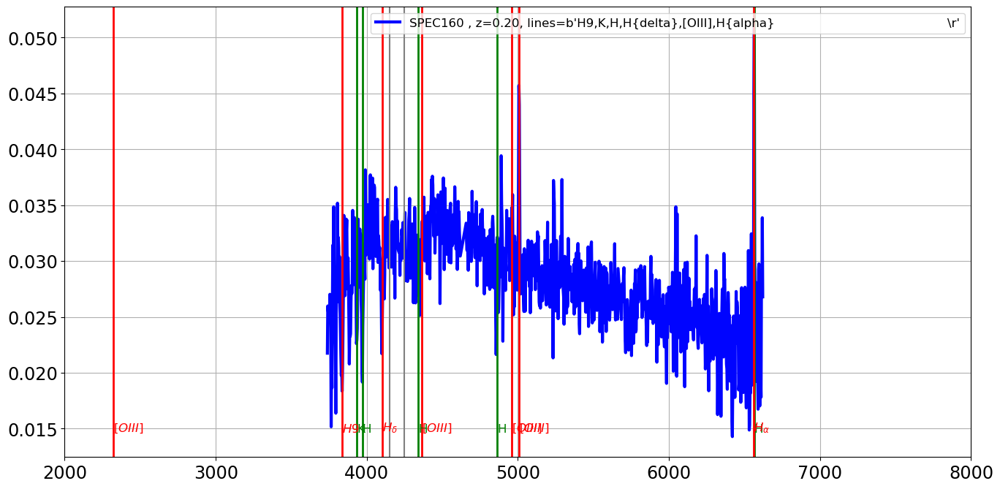

===================== SED 74 : SPEC161 , z=0.45, lines=b'[OII],H9,H8,K,H,H{beta},[OIII]                                              \r'=======================
the_lines =  b'[OII],H9,H8,K,H,H{beta},[OIII]                                              \r'
[OII]
H9
H8
K
H
H{beta}
[OIII]


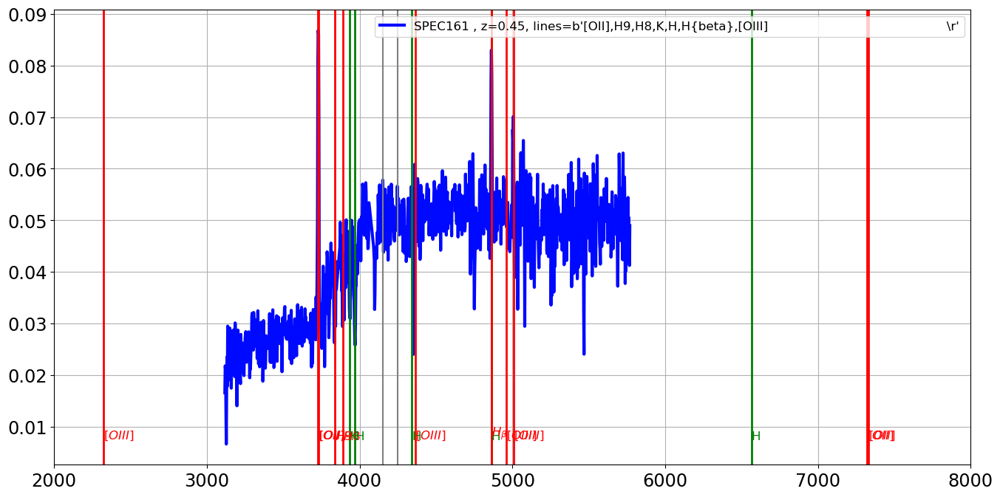

===================== SED 75 : SPEC164 , z=0.44, lines=b'[OII],H{gamma},H{beta},[OIII]                                               \r'=======================
the_lines =  b'[OII],H{gamma},H{beta},[OIII]                                               \r'
[OII]
H{gamma}
H{beta}
[OIII]


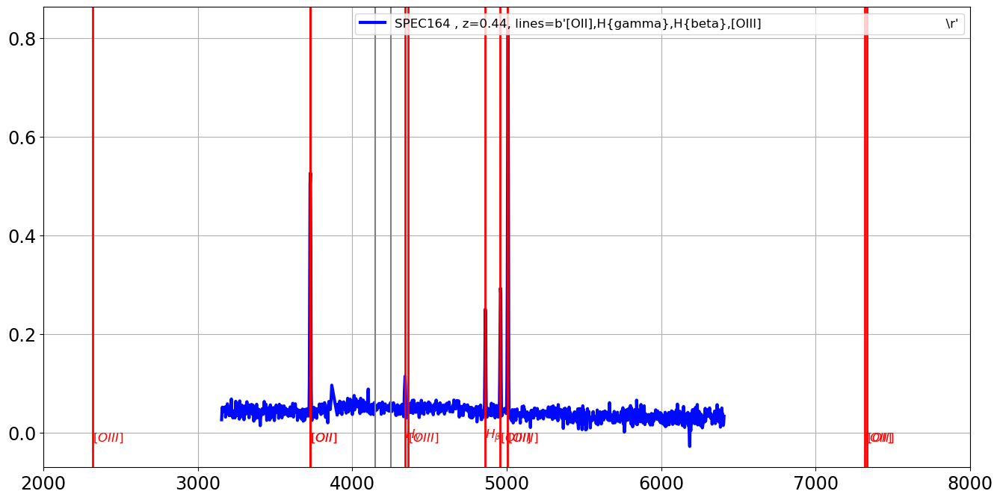

===================== SED 76 : SPEC171 , z=0.53, lines=b'K,H,H{delta},G                                                              \r'=======================
the_lines =  b'K,H,H{delta},G                                                              \r'
K
H
H{delta}
G


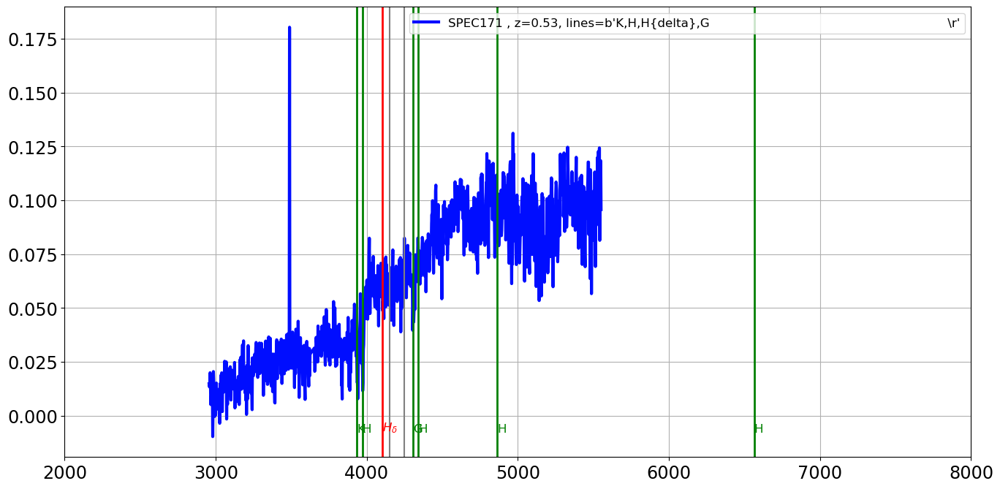

===================== SED 77 : SPEC178 , z=0.45, lines=b'[OII],K,H,H{beta}                                                           \r'=======================
the_lines =  b'[OII],K,H,H{beta}                                                           \r'
[OII]
K
H
H{beta}


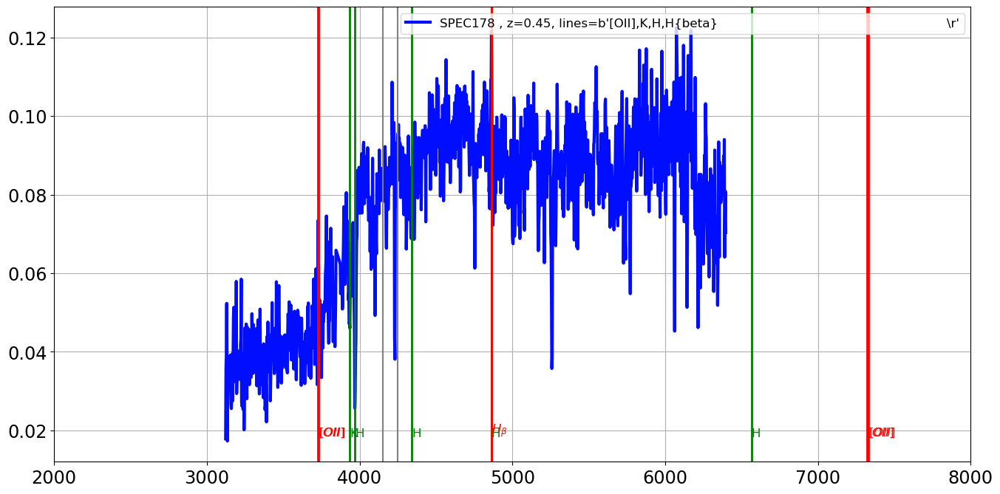

===================== SED 78 : SPEC179 , z=0.47, lines=b'K,H,G,H{beta}                                                               \r'=======================
the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


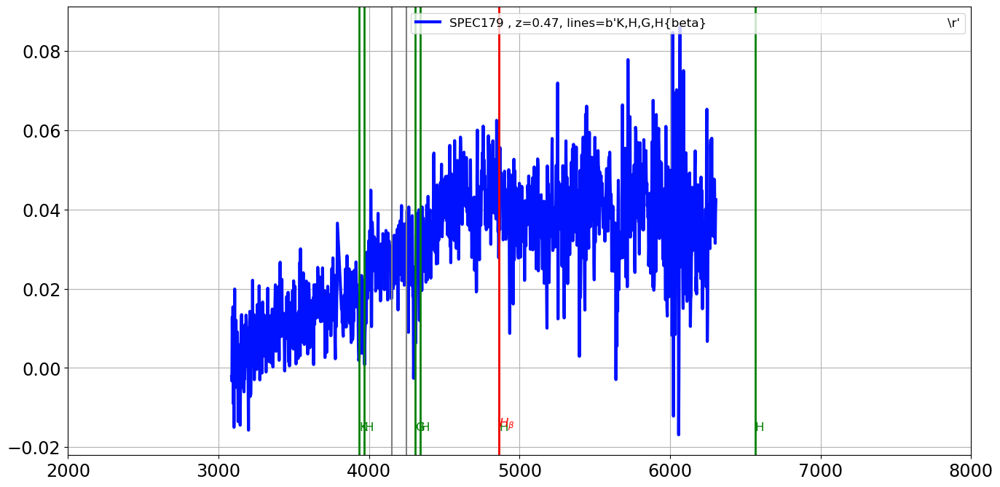

===================== SED 79 : SPEC181 , z=0.29, lines=b'[OII],K,H,H{delta},Mgb                                                      \r'=======================
the_lines =  b'[OII],K,H,H{delta},Mgb                                                      \r'
[OII]
K
H
H{delta}
Mgb


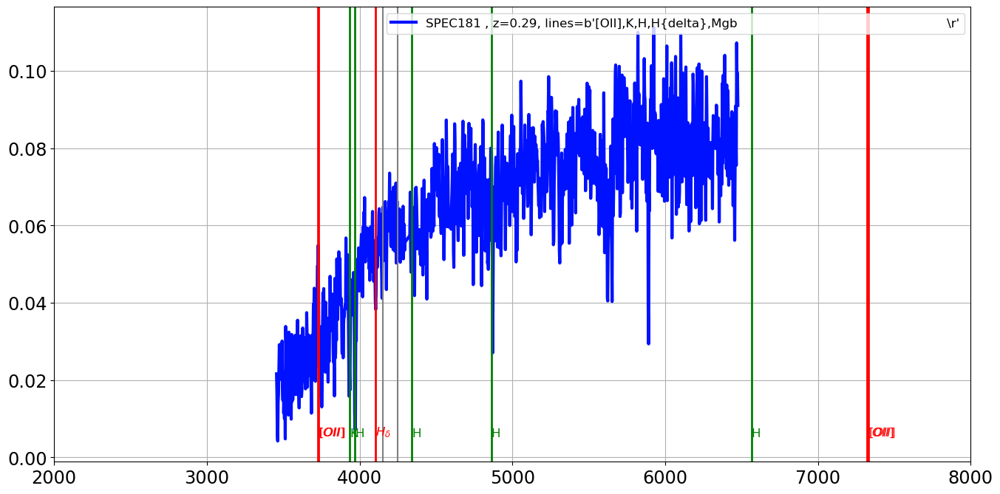

===================== SED 80 : SPEC182 , z=0.45, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


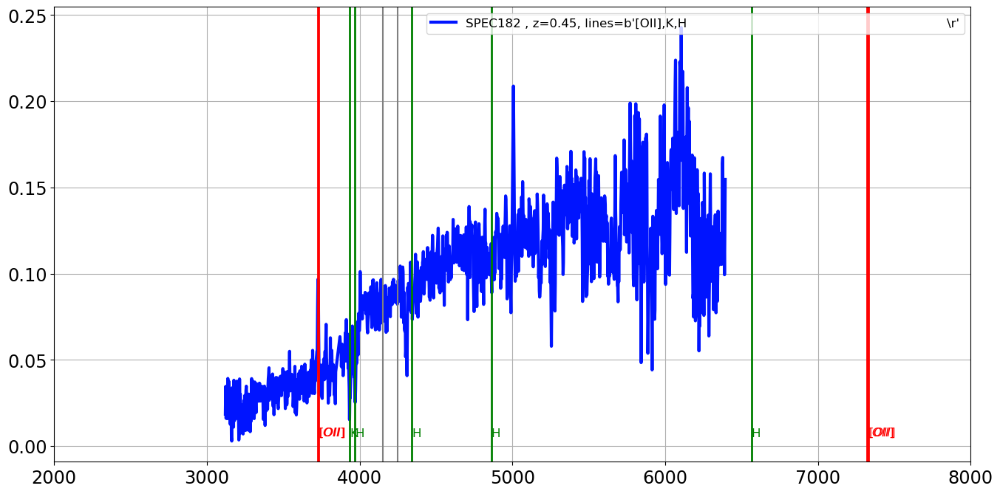

===================== SED 81 : SPEC183 , z=0.44, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


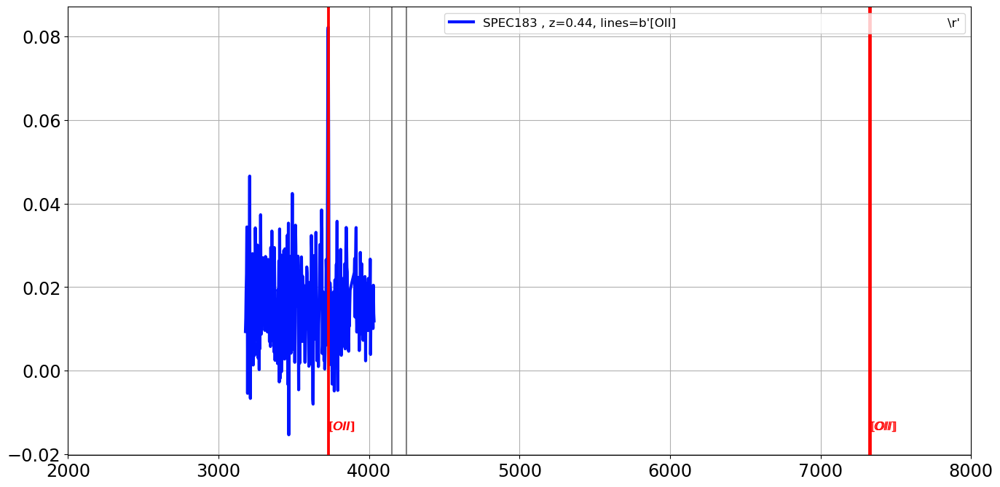

===================== SED 82 : SPEC184 , z=0.07, lines=b'                                                                            \r'=======================
the_lines =  b'                                                                            \r'



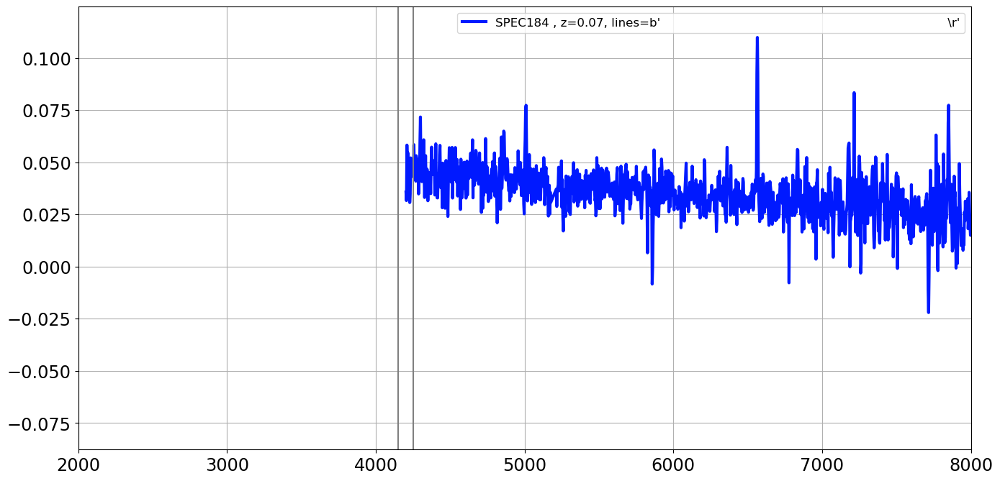

===================== SED 83 : SPEC185 , z=0.20, lines=b'K,H,H{delta},H{beta},[OIII]                                                 \r'=======================
the_lines =  b'K,H,H{delta},H{beta},[OIII]                                                 \r'
K
H
H{delta}
H{beta}
[OIII]


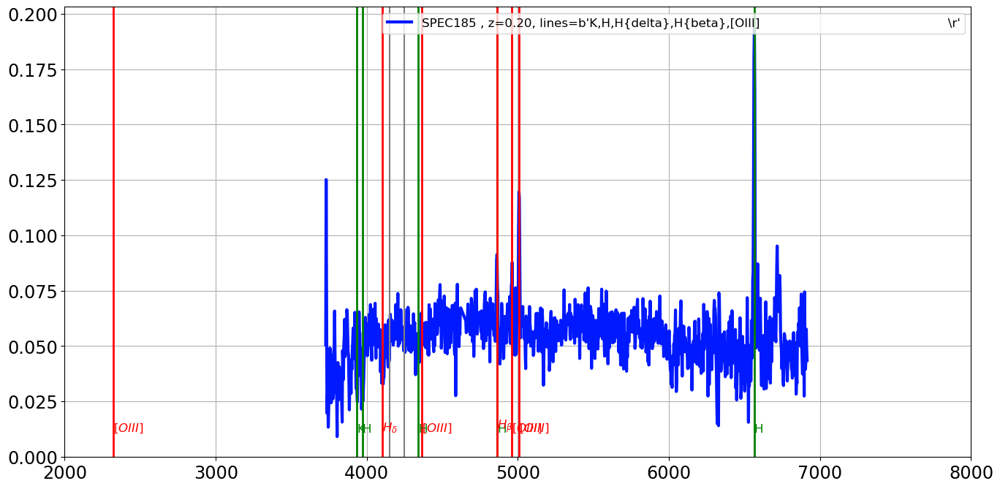

===================== SED 84 : SPEC186 , z=0.60, lines=b'H9,K,H,G,H{beta},Mgb                                                        \r'=======================
the_lines =  b'H9,K,H,G,H{beta},Mgb                                                        \r'
H9
K
H
G
H{beta}
Mgb


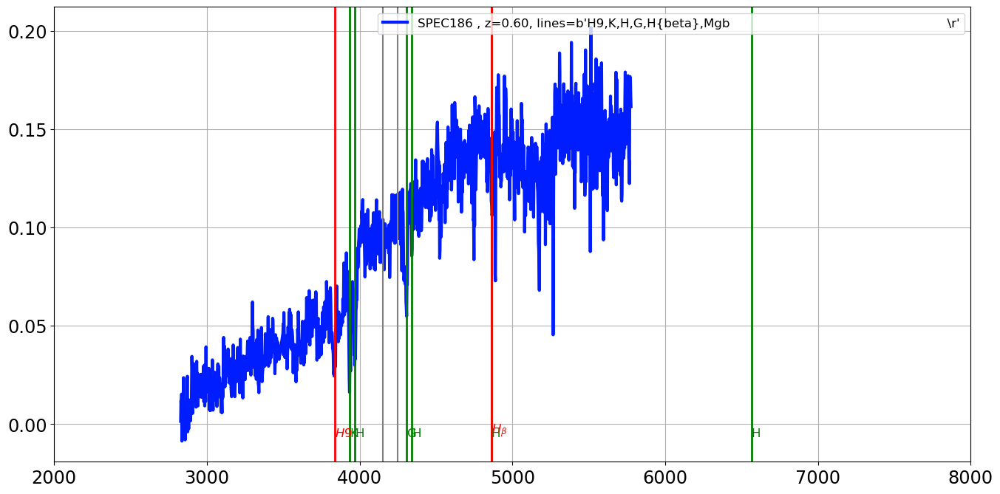

===================== SED 85 : SPEC187 , z=0.51, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


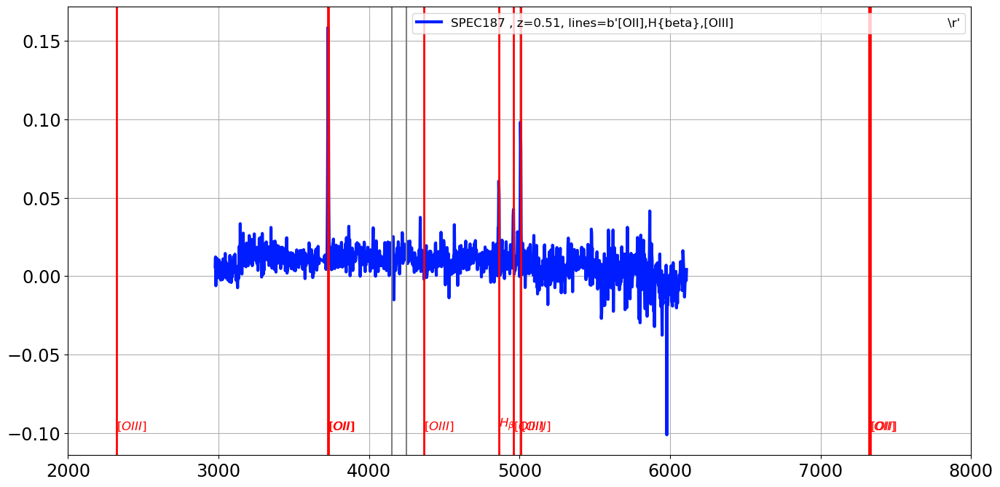

===================== SED 86 : SPEC188 , z=0.36, lines=b'H9,K,H,G                                                                    \r'=======================
the_lines =  b'H9,K,H,G                                                                    \r'
H9
K
H
G


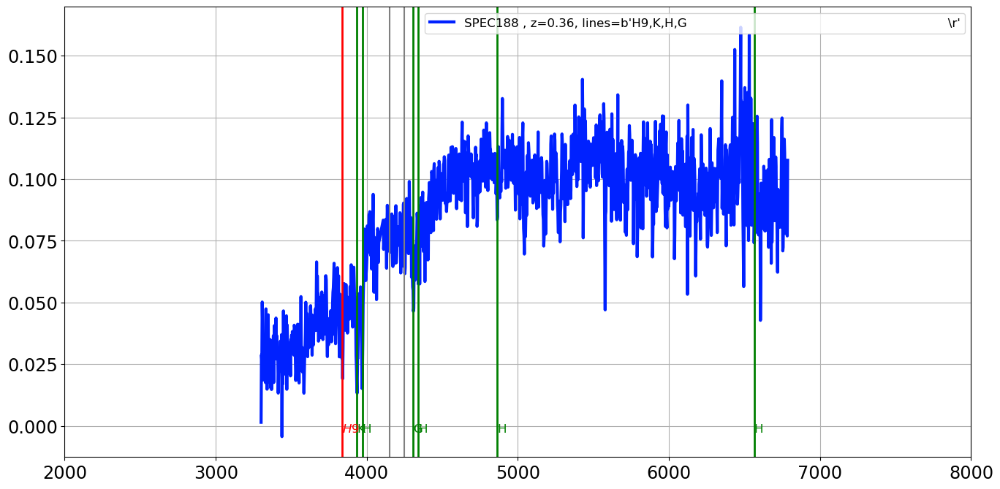

===================== SED 87 : SPEC189 , z=0.30, lines=b'K,H,G,H{beta},Mgb                                                           \r'=======================
the_lines =  b'K,H,G,H{beta},Mgb                                                           \r'
K
H
G
H{beta}
Mgb


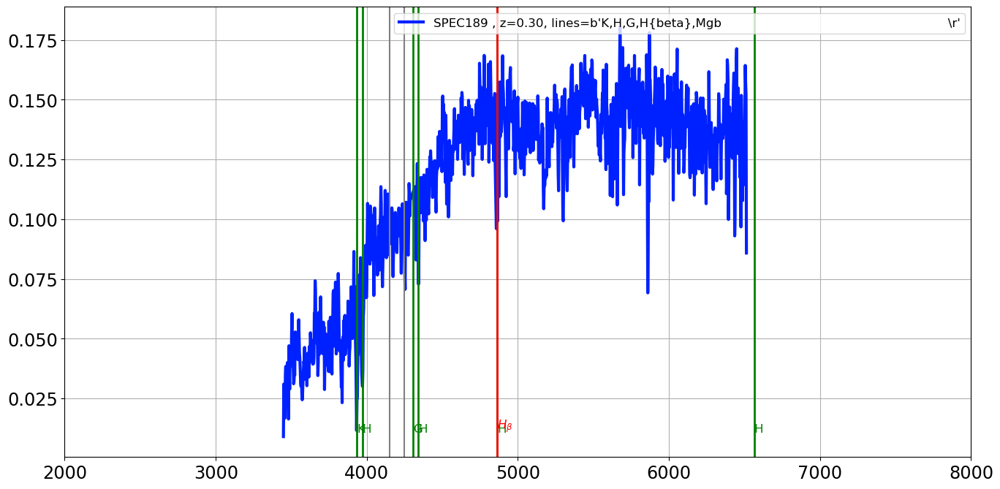

===================== SED 88 : SPEC191 , z=0.64, lines=b'[OII],H9,H8,H,H{delta},H{beta},[OIII]                                       \r'=======================
the_lines =  b'[OII],H9,H8,H,H{delta},H{beta},[OIII]                                       \r'
[OII]
H9
H8
H
H{delta}
H{beta}
[OIII]


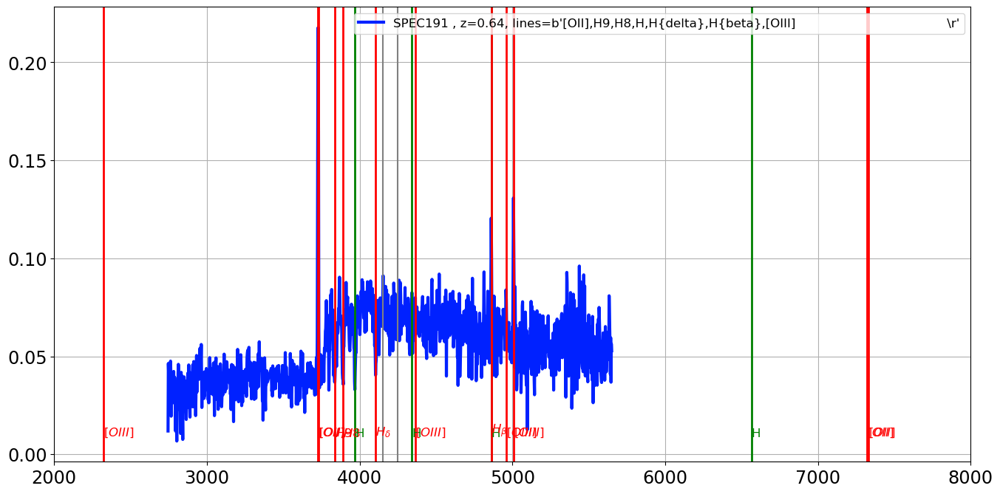

===================== SED 89 : SPEC192 , z=0.41, lines=b'[OII],H9,K,H,H{delta}                                                       \r'=======================
the_lines =  b'[OII],H9,K,H,H{delta}                                                       \r'
[OII]
H9
K
H
H{delta}


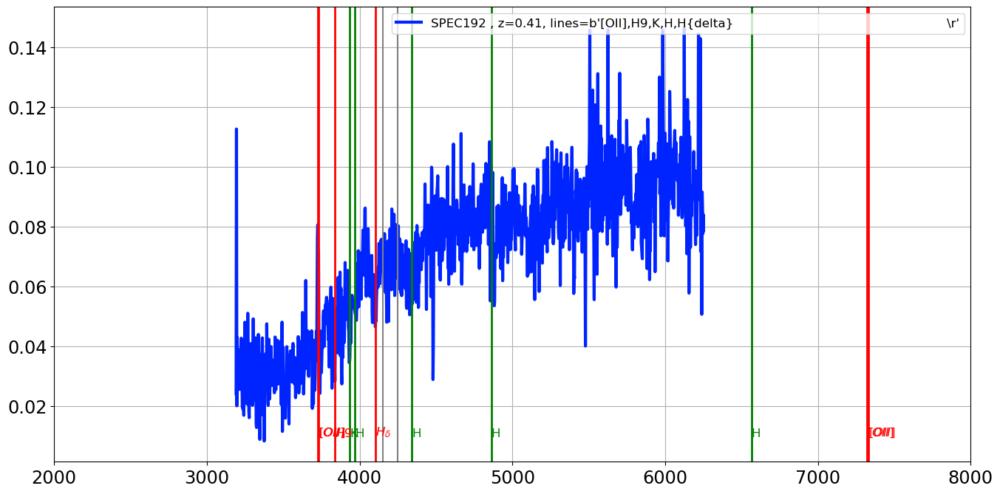

===================== SED 90 : SPEC193 , z=0.29, lines=b'K,H,H{delta},G,H{beta}                                                      \r'=======================
the_lines =  b'K,H,H{delta},G,H{beta}                                                      \r'
K
H
H{delta}
G
H{beta}


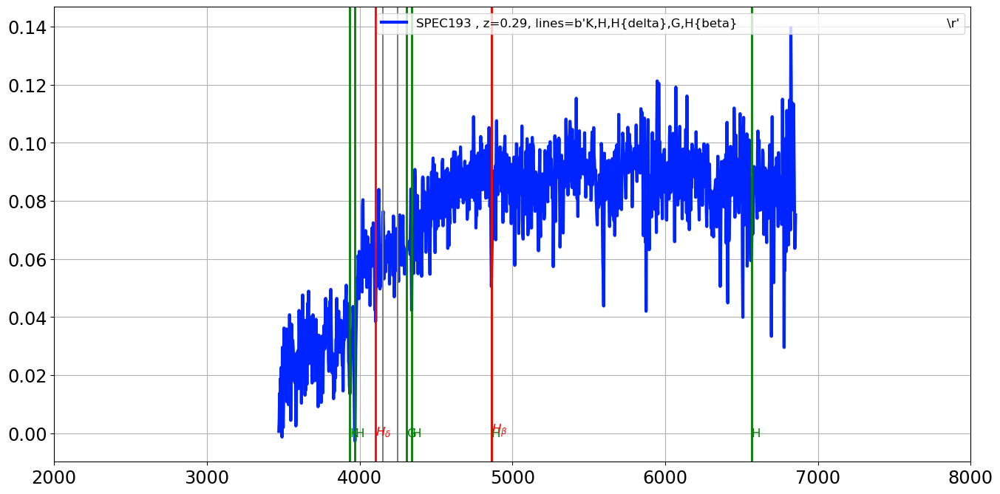

===================== SED 91 : SPEC194 , z=0.53, lines=b'[OIII]                                                                      \r'=======================
the_lines =  b'[OIII]                                                                      \r'
[OIII]


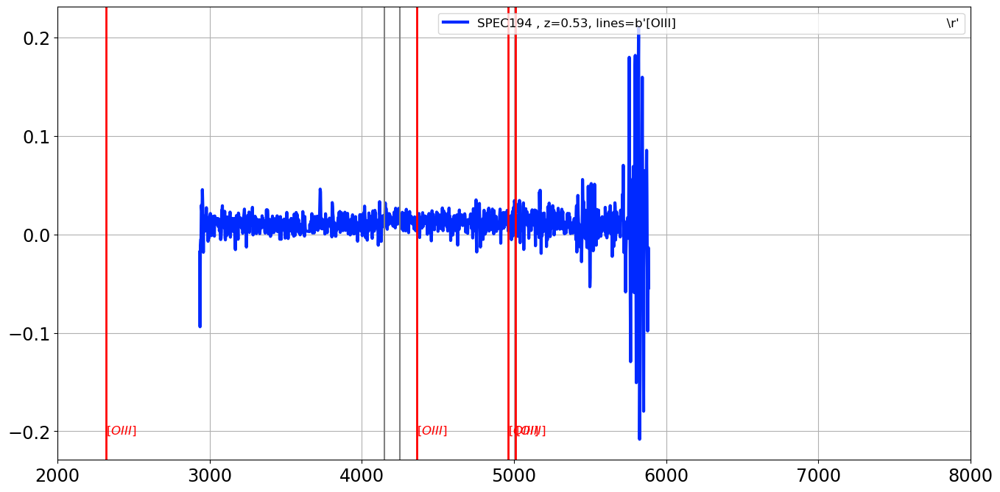

===================== SED 92 : SPEC196 , z=0.65, lines=b'[OII],H8,H,H{delta},H{beta},[OIII]                                          \r'=======================
the_lines =  b'[OII],H8,H,H{delta},H{beta},[OIII]                                          \r'
[OII]
H8
H
H{delta}
H{beta}
[OIII]


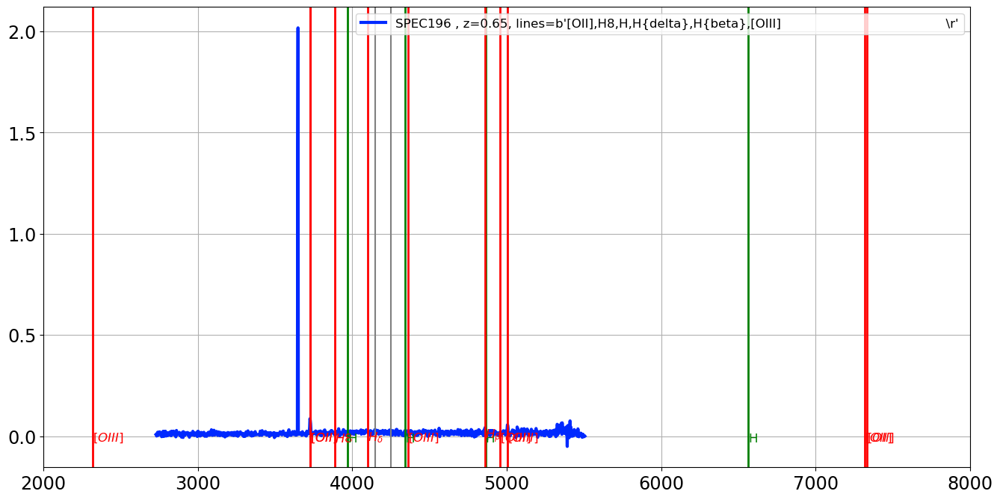

===================== SED 93 : SPEC197 , z=0.47, lines=b'[OII],H9,K,H,H{beta},[OIII]                                                 \r'=======================
the_lines =  b'[OII],H9,K,H,H{beta},[OIII]                                                 \r'
[OII]
H9
K
H
H{beta}
[OIII]


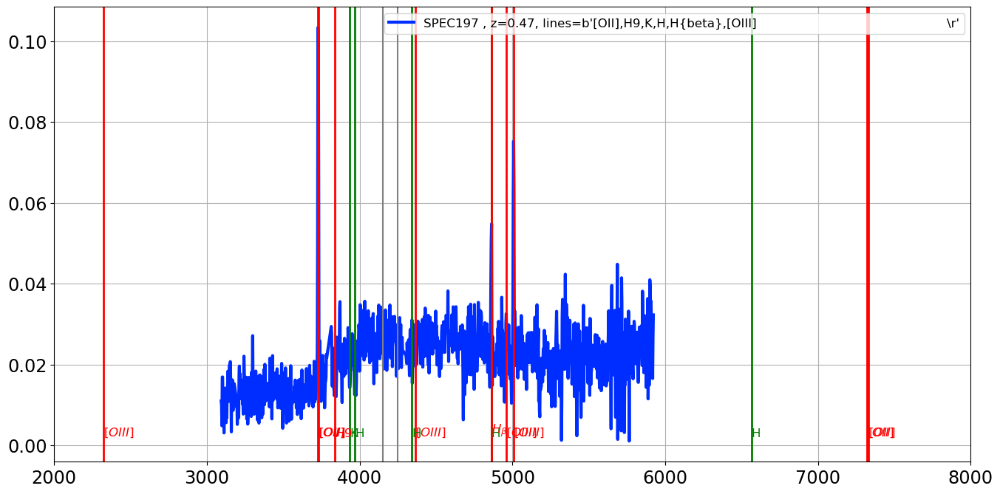

===================== SED 94 : SPEC198 , z=0.45, lines=b'K,H,H{delta},H{beta}                                                        \r'=======================
the_lines =  b'K,H,H{delta},H{beta}                                                        \r'
K
H
H{delta}
H{beta}


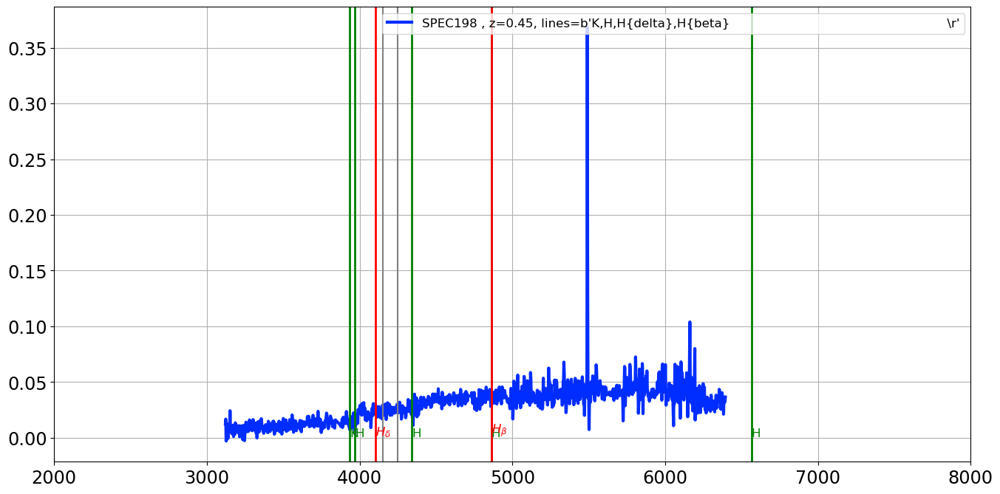

===================== SED 95 : SPEC204 , z=0.45, lines=b'[OII],H8,H,H{delta}                                                         \r'=======================
the_lines =  b'[OII],H8,H,H{delta}                                                         \r'
[OII]
H8
H
H{delta}


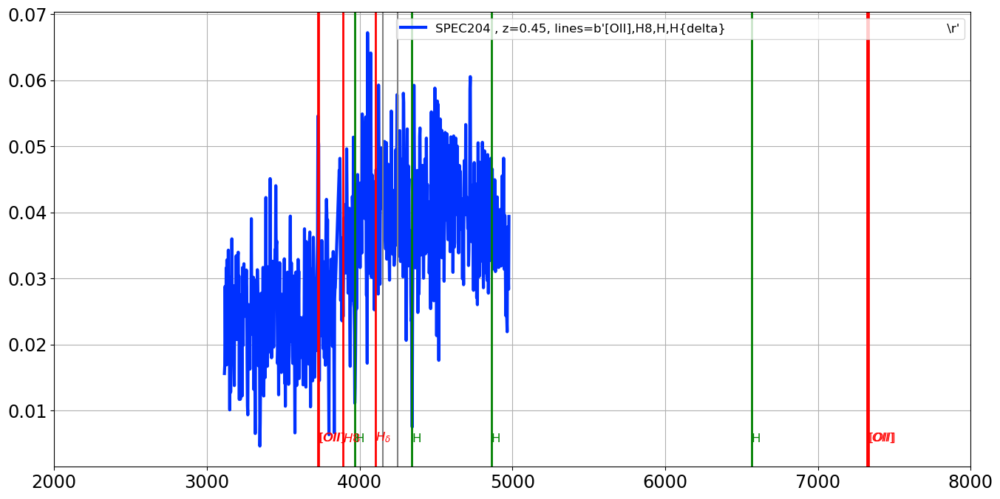

===================== SED 96 : SPEC205 , z=0.69, lines=b'[OII],H9,H                                                                  \r'=======================
the_lines =  b'[OII],H9,H                                                                  \r'
[OII]
H9
H


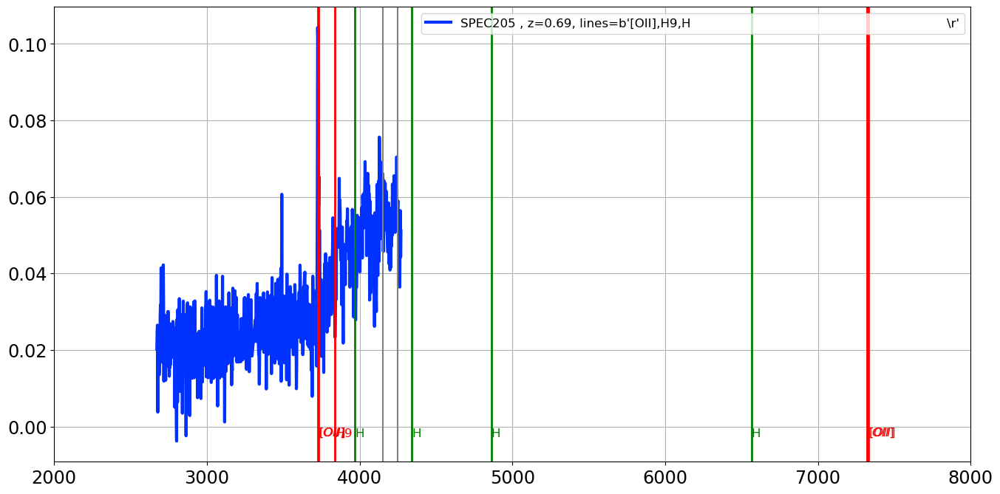

===================== SED 97 : SPEC210 , z=0.29, lines=b'K,H,G,Fe43,Ca44,Fe45,H{beta},Mgb                                            \r'=======================
the_lines =  b'K,H,G,Fe43,Ca44,Fe45,H{beta},Mgb                                            \r'
K
H
G
Fe43
Ca44
Fe45
H{beta}
Mgb


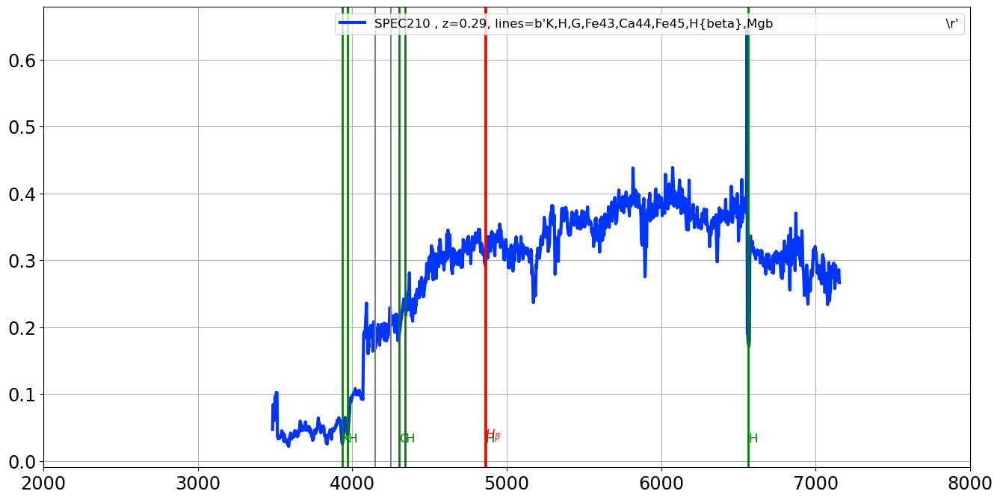

===================== SED 98 : SPEC214 , z=0.29, lines=b'[OII],H10,H9,H8,K,H,H{beta},[OIII]                                          \r'=======================
the_lines =  b'[OII],H10,H9,H8,K,H,H{beta},[OIII]                                          \r'
[OII]
H10
H9
H8
K
H
H{beta}
[OIII]


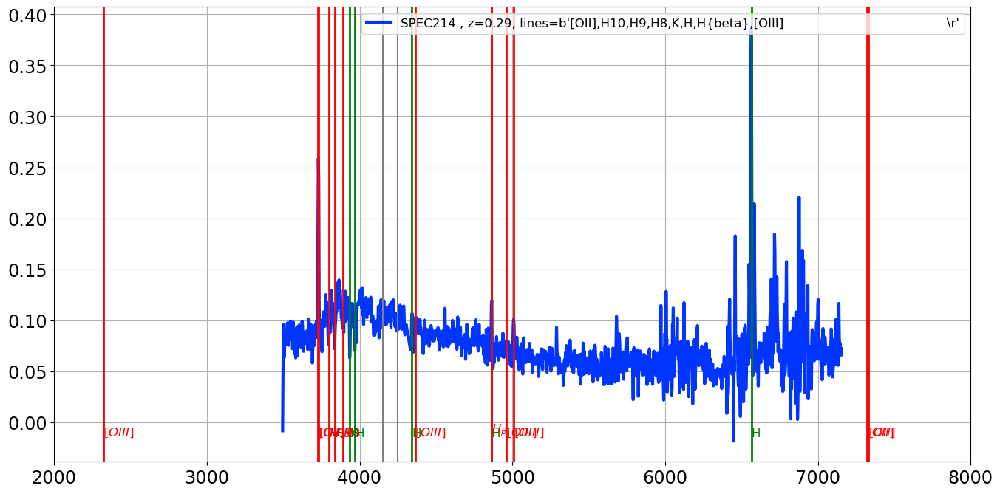

===================== SED 99 : SPEC218 , z=0.44, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


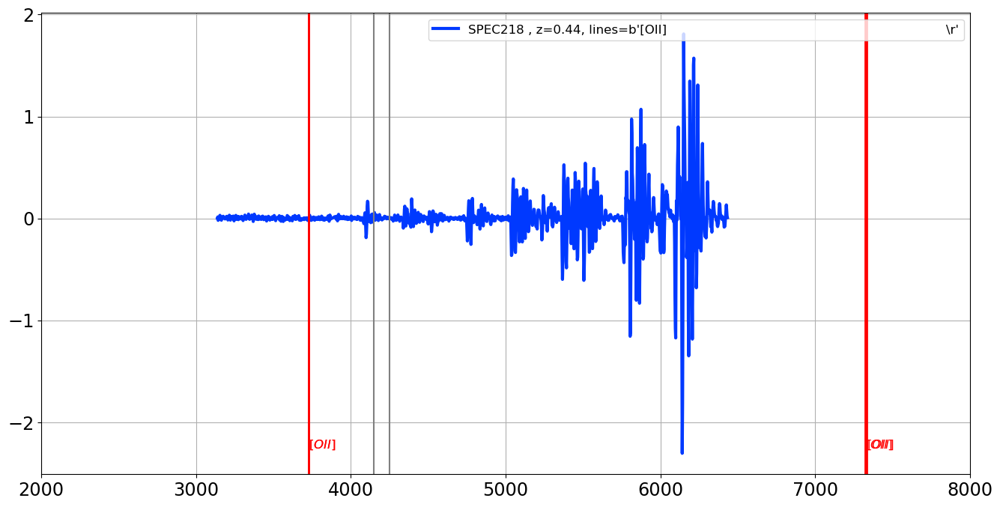

===================== SED 100 : SPEC221 , z=0.50, lines=b'[OII],H9,H8,K,H                                                             \r'=======================
the_lines =  b'[OII],H9,H8,K,H                                                             \r'
[OII]
H9
H8
K
H


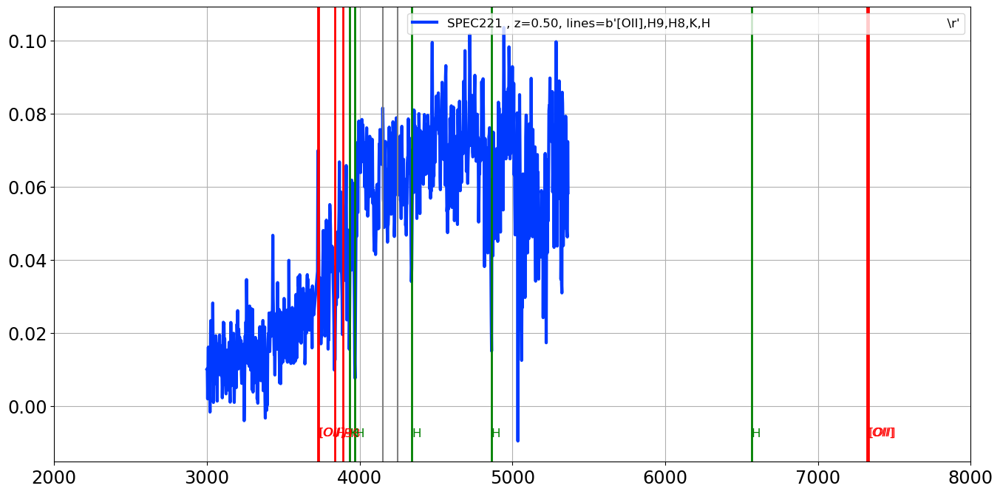

===================== SED 101 : SPEC222 , z=0.29, lines=b'K,H,H{beta}                                                                 \r'=======================
the_lines =  b'K,H,H{beta}                                                                 \r'
K
H
H{beta}


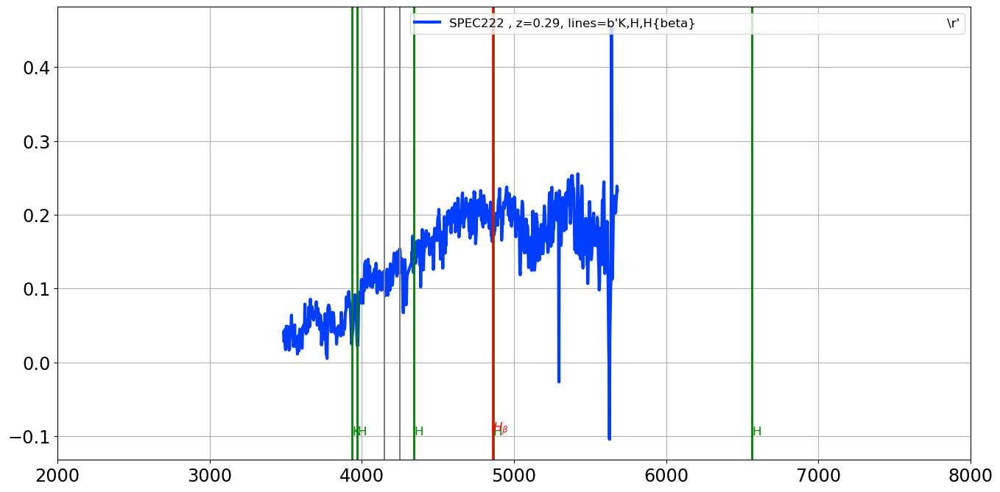

===================== SED 102 : SPEC223 , z=0.56, lines=b'[OII],H9,H,H{delta}                                                         \r'=======================
the_lines =  b'[OII],H9,H,H{delta}                                                         \r'
[OII]
H9
H
H{delta}


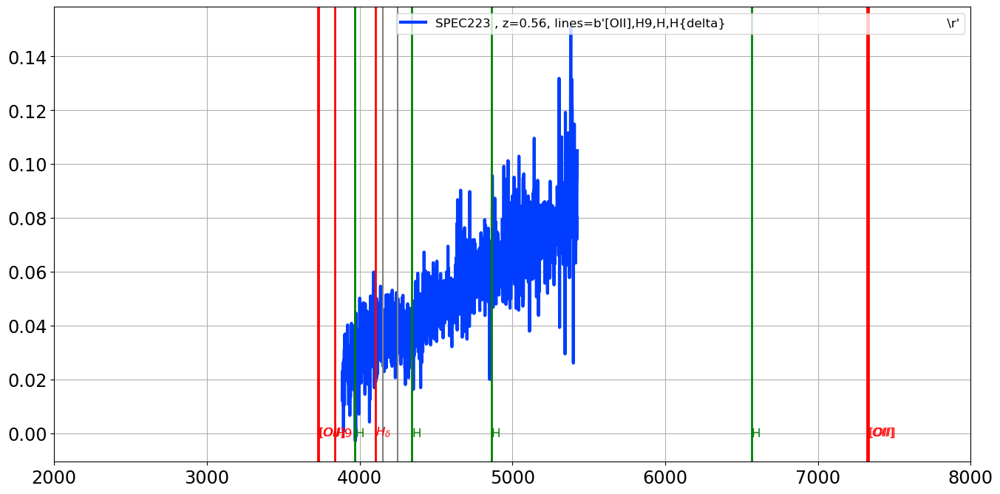

===================== SED 103 : SPEC226 , z=1.00, lines=b'MgII,[OII],H                                                                \r'=======================
the_lines =  b'MgII,[OII],H                                                                \r'
MgII
[OII]
H


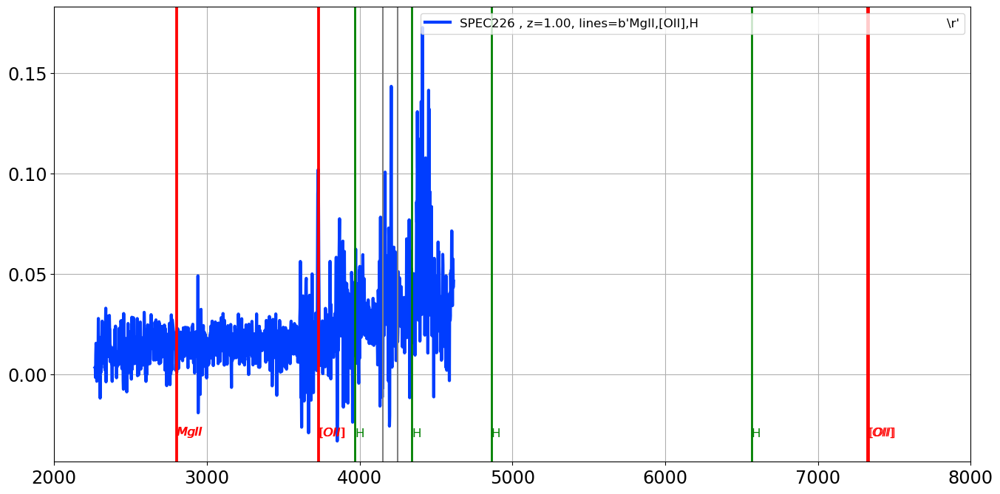

===================== SED 104 : SPEC227 , z=1.00, lines=b'[OII],H                                                                     \r'=======================
the_lines =  b'[OII],H                                                                     \r'
[OII]
H


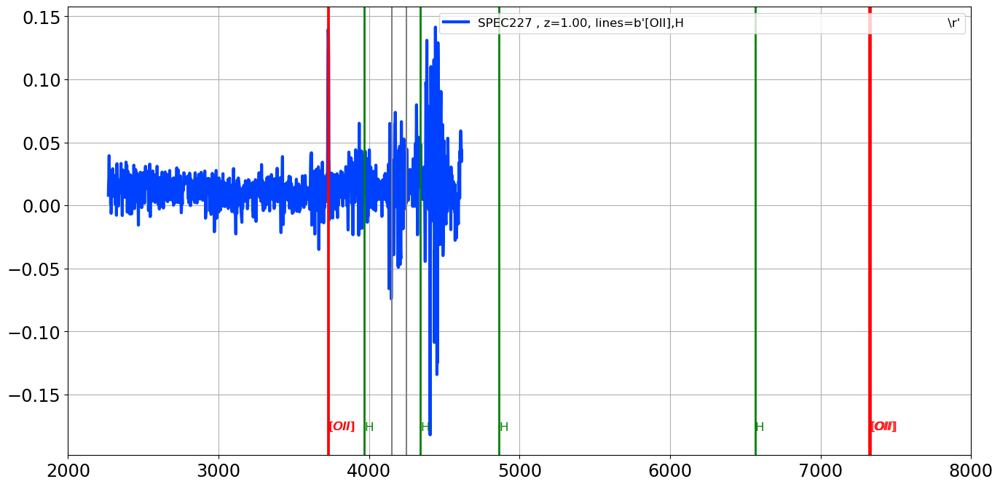

===================== SED 105 : SPEC231 , z=0.29, lines=b'K,H,H{delta},G,H{gamma},Fe43,H{beta},Mgb                                    \r'=======================
the_lines =  b'K,H,H{delta},G,H{gamma},Fe43,H{beta},Mgb                                    \r'
K
H
H{delta}
G
H{gamma}
Fe43
H{beta}
Mgb


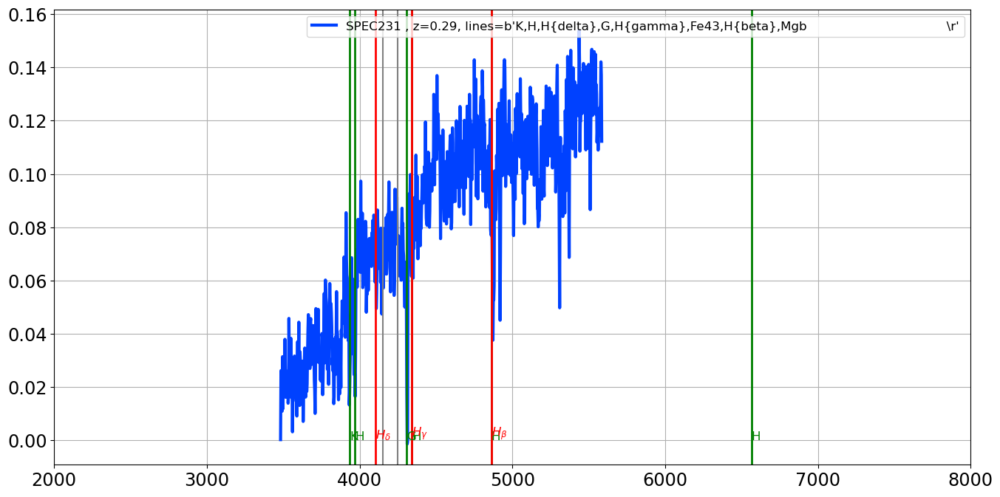

===================== SED 106 : SPEC233 , z=0.64, lines=b'[OII],H9,K,H                                                                \r'=======================
the_lines =  b'[OII],H9,K,H                                                                \r'
[OII]
H9
K
H


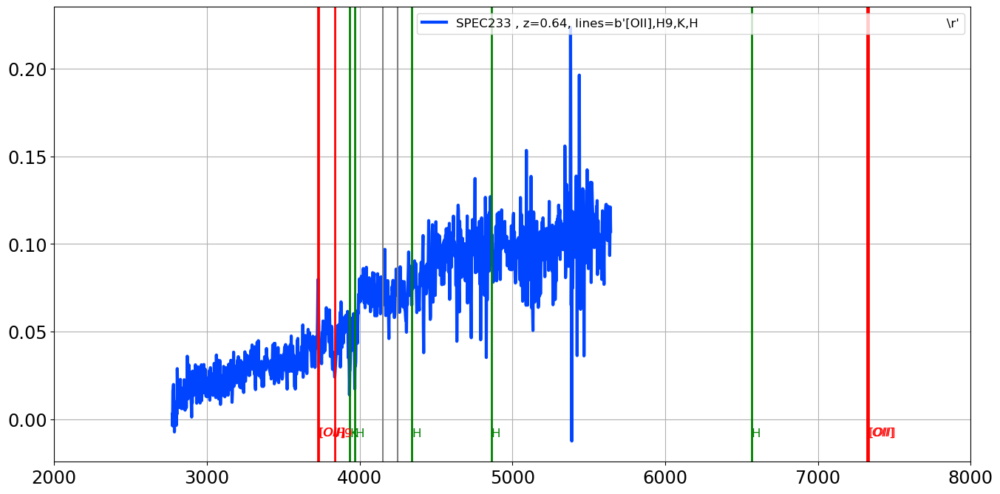

===================== SED 107 : SPEC234 , z=0.47, lines=b'[OII],K,H,G                                                                 \r'=======================
the_lines =  b'[OII],K,H,G                                                                 \r'
[OII]
K
H
G


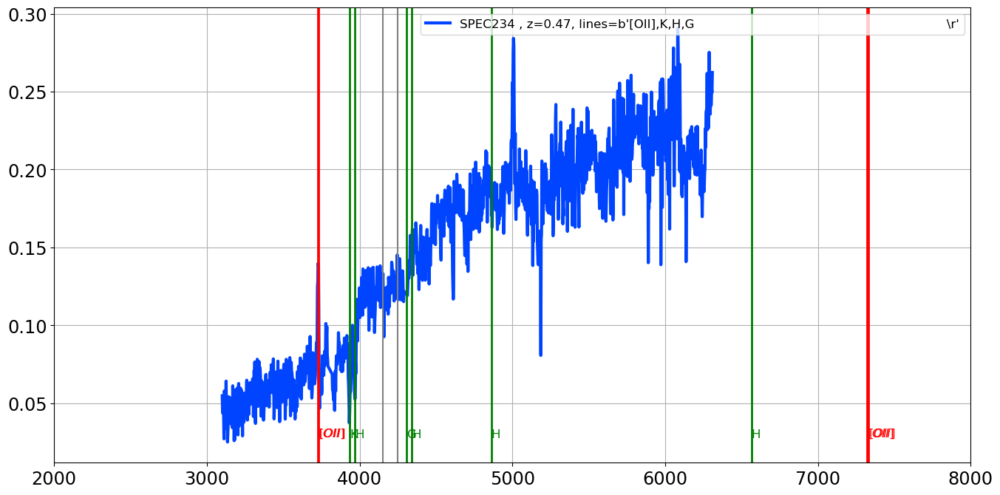

===================== SED 108 : SPEC235 , z=0.29, lines=b'K,H,G,Fe43,H{beta},Mgb,E                                                    \r'=======================
the_lines =  b'K,H,G,Fe43,H{beta},Mgb,E                                                    \r'
K
H
G
Fe43
H{beta}
Mgb
E


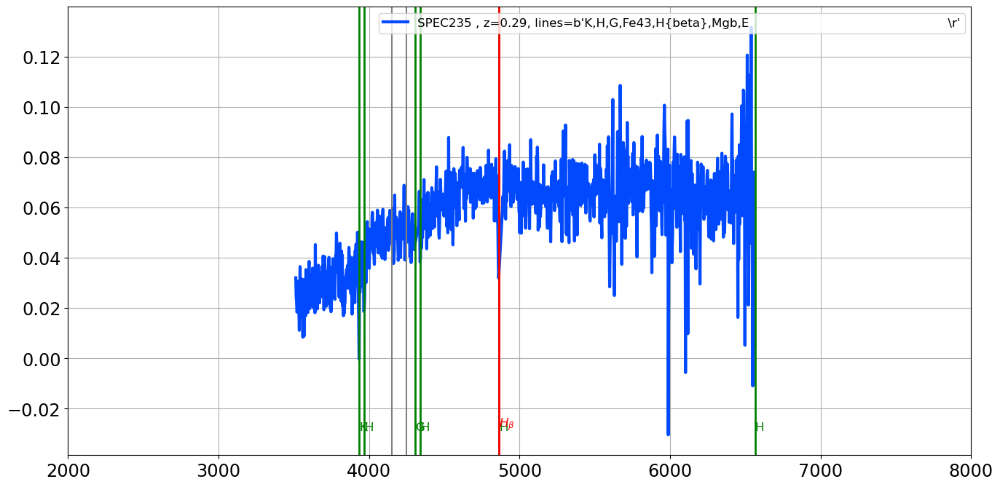

===================== SED 109 : SPEC236 , z=0.32, lines=b'[OII],H,H{beta},H{alpha}                                                    \r'=======================
the_lines =  b'[OII],H,H{beta},H{alpha}                                                    \r'
[OII]
H
H{beta}
H{alpha}


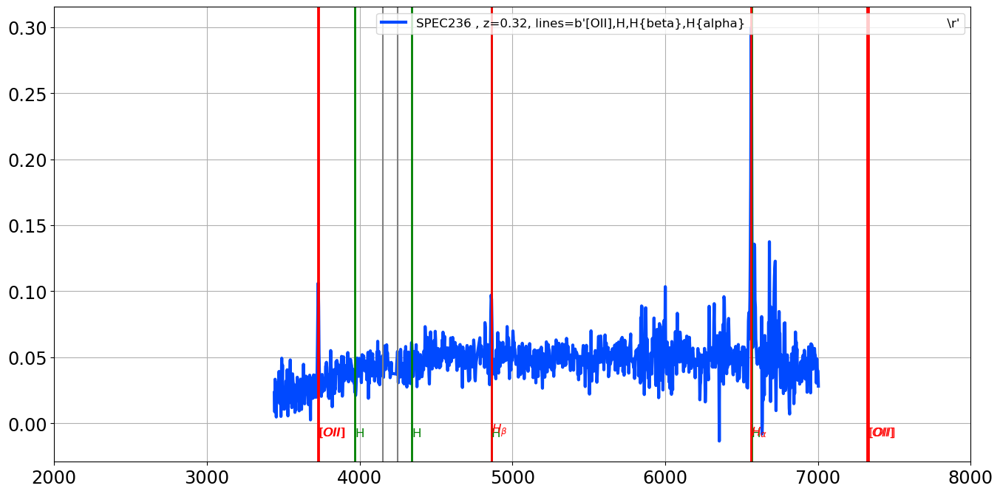

===================== SED 110 : SPEC237 , z=0.44, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


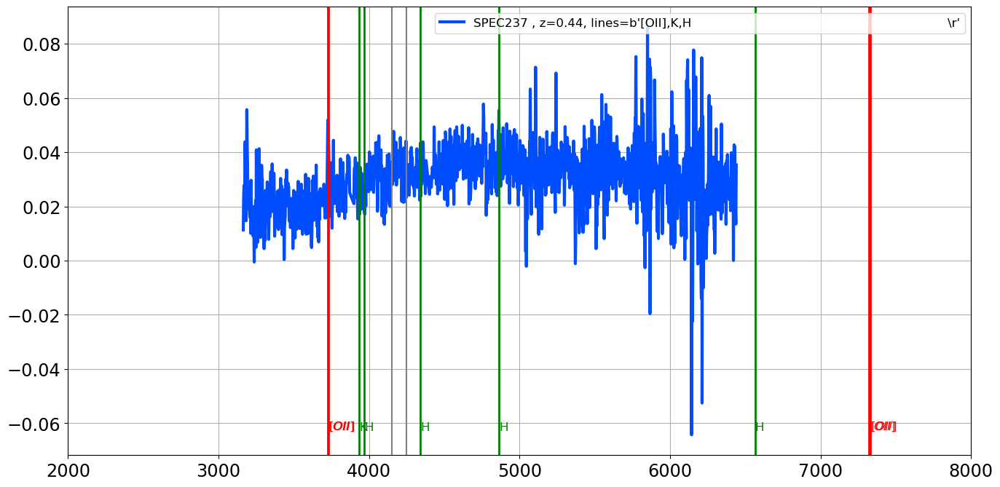

===================== SED 111 : SPEC238 , z=0.29, lines=b'K,H,H{delta},H{beta}                                                        \r'=======================
the_lines =  b'K,H,H{delta},H{beta}                                                        \r'
K
H
H{delta}
H{beta}


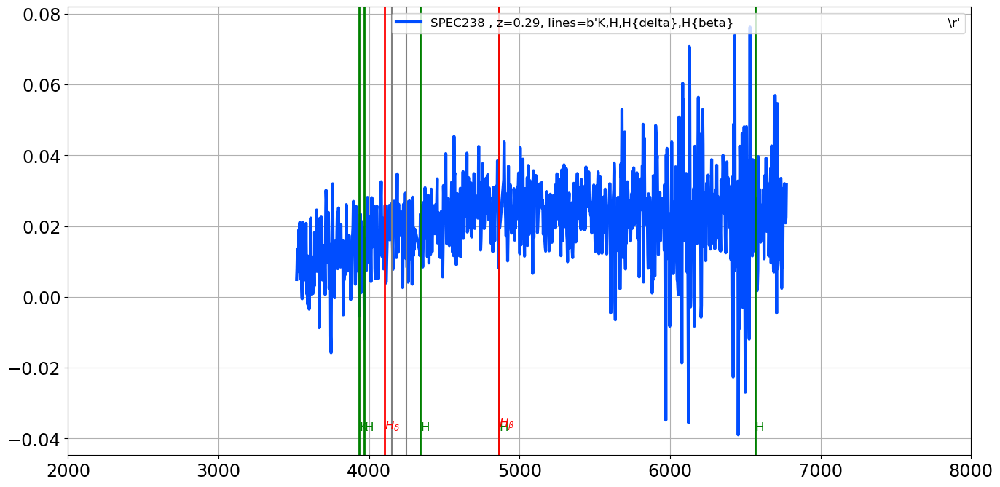

===================== SED 112 : SPEC240 , z=0.40, lines=b'[OII],H{beta},[OIII],H{alpha}                                               \r'=======================
the_lines =  b'[OII],H{beta},[OIII],H{alpha}                                               \r'
[OII]
H{beta}
[OIII]
H{alpha}


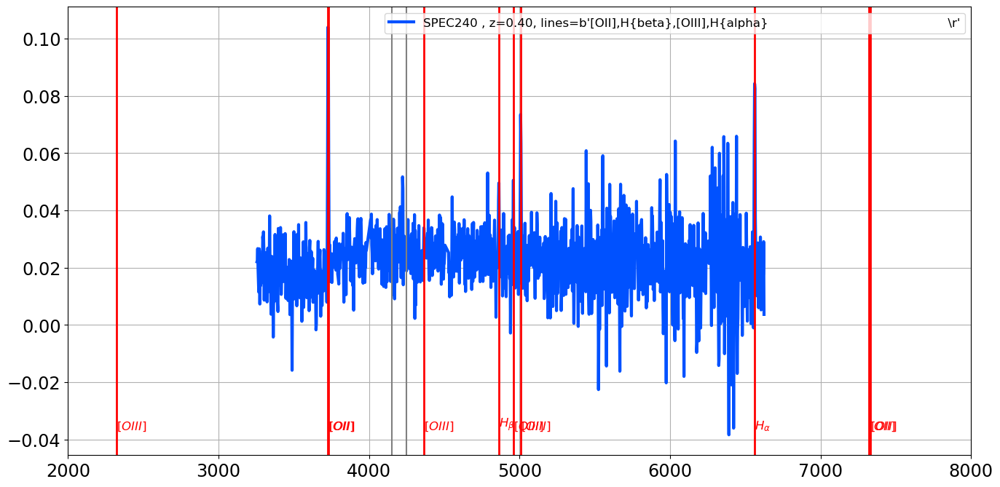

===================== SED 113 : SPEC242 , z=0.07, lines=b'[OIII],H{alpha}                                                             \r'=======================
the_lines =  b'[OIII],H{alpha}                                                             \r'
[OIII]
H{alpha}


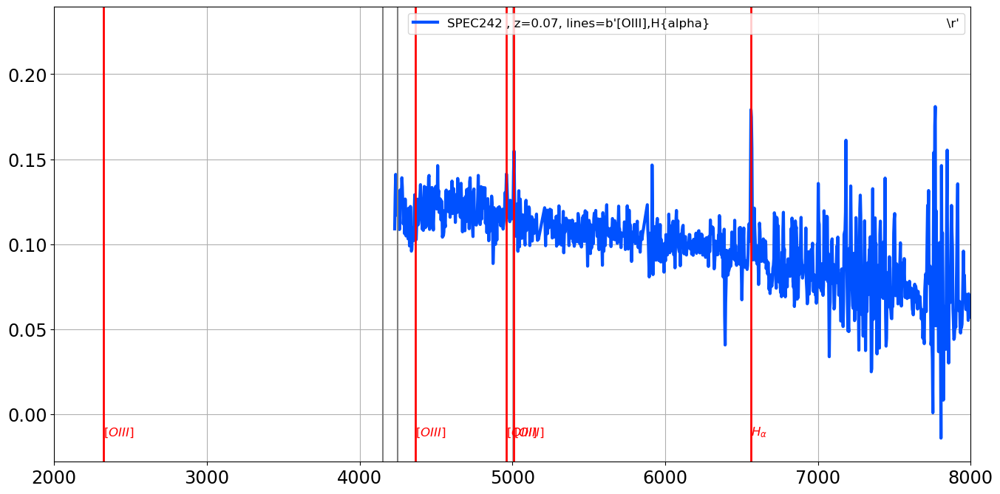

===================== SED 114 : SPEC243 , z=0.60, lines=b'[OII],H9,H8,H,H{beta}                                                       \r'=======================
the_lines =  b'[OII],H9,H8,H,H{beta}                                                       \r'
[OII]
H9
H8
H
H{beta}


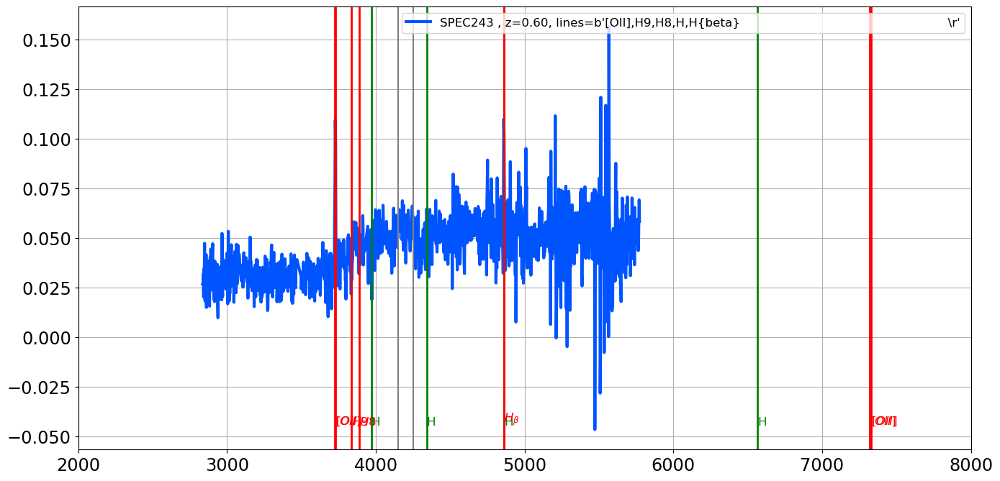

===================== SED 115 : SPEC244 , z=0.45, lines=b'4000{AA}-break,G,H{beta}                                                    \r'=======================
the_lines =  b'4000{AA}-break,G,H{beta}                                                    \r'
4000{AA}-break
G
H{beta}


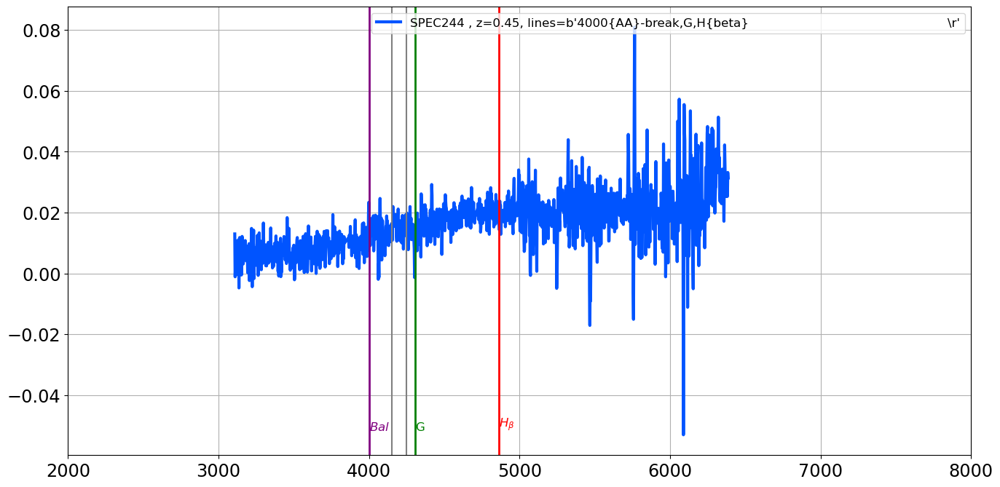

===================== SED 116 : SPEC245 , z=0.59, lines=b'[OII],H8,H                                                                  \r'=======================
the_lines =  b'[OII],H8,H                                                                  \r'
[OII]
H8
H


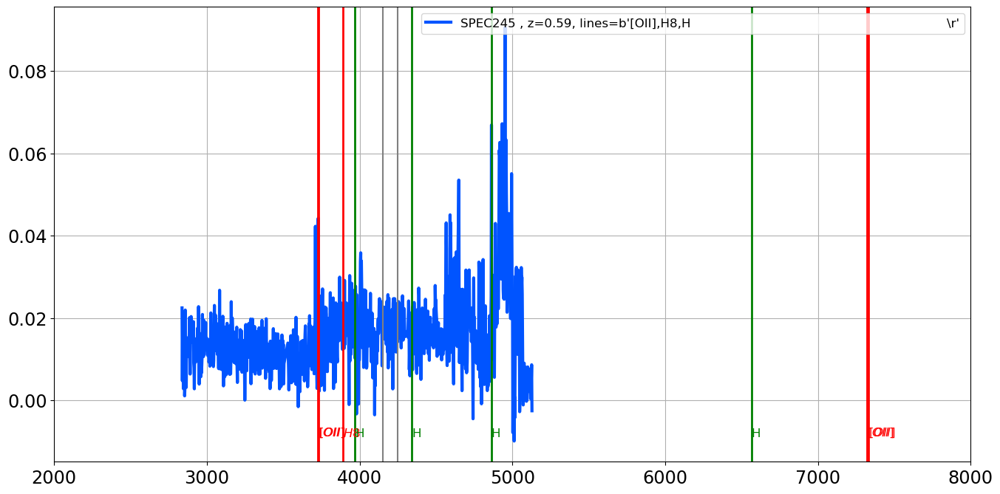

===================== SED 117 : SPEC246 , z=0.69, lines=b'[OII],H10,H9,H                                                              \r'=======================
the_lines =  b'[OII],H10,H9,H                                                              \r'
[OII]
H10
H9
H


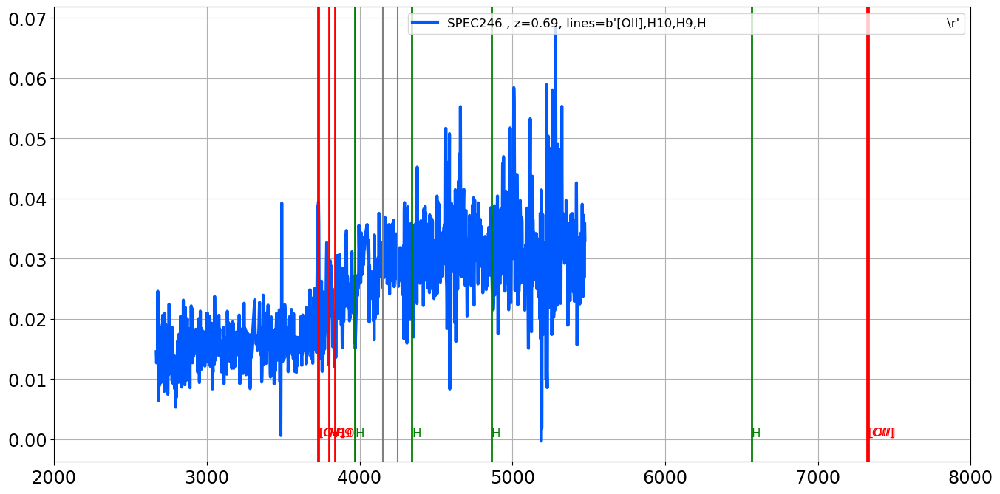

===================== SED 118 : SPEC248 , z=0.96, lines=b'MgII,[OII],H9,H                                                             \r'=======================
the_lines =  b'MgII,[OII],H9,H                                                             \r'
MgII
[OII]
H9
H


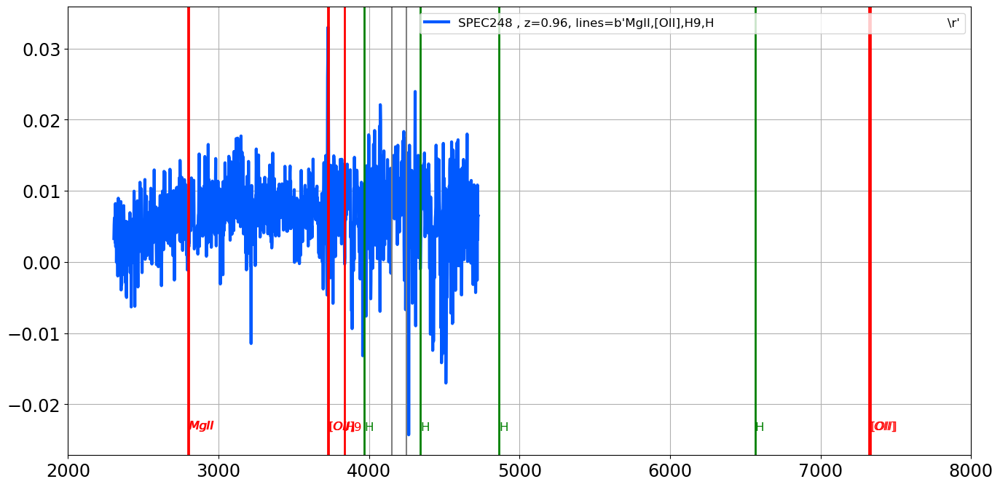

===================== SED 119 : SPEC249 , z=0.08, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


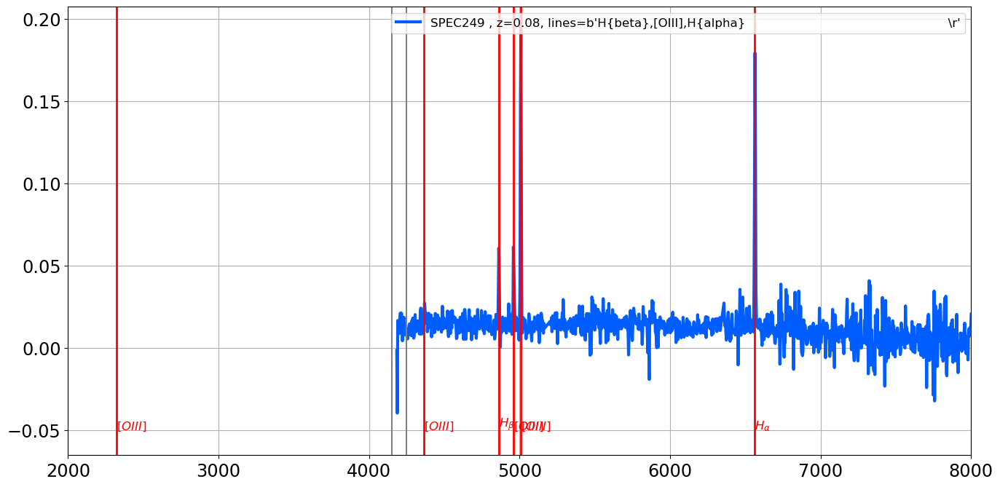

===================== SED 120 : SPEC250 , z=0.63, lines=b'[OII],H10,H9,K,H,[OIII]                                                     \r'=======================
the_lines =  b'[OII],H10,H9,K,H,[OIII]                                                     \r'
[OII]
H10
H9
K
H
[OIII]


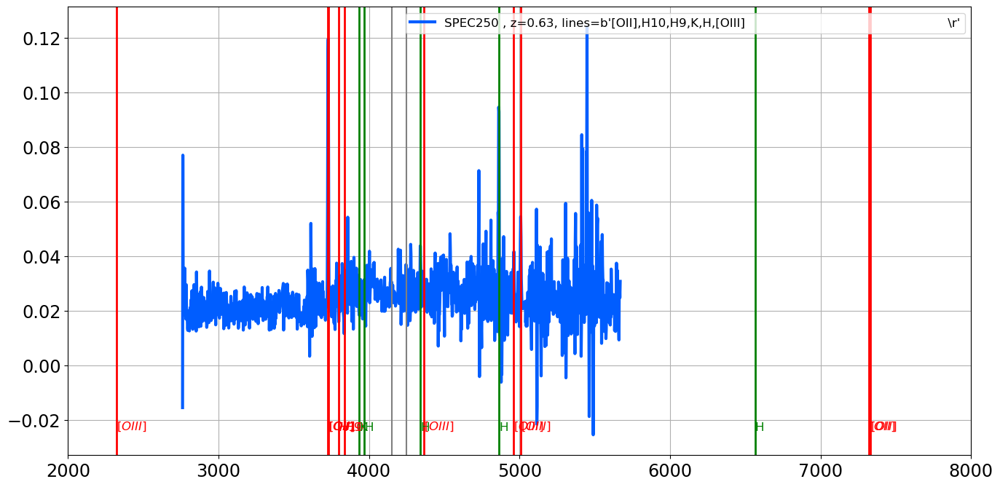

===================== SED 121 : SPEC252 , z=0.30, lines=b'K,H,4000{AA}-break,H{delta}                                                 \r'=======================
the_lines =  b'K,H,4000{AA}-break,H{delta}                                                 \r'
K
H
4000{AA}-break
H{delta}


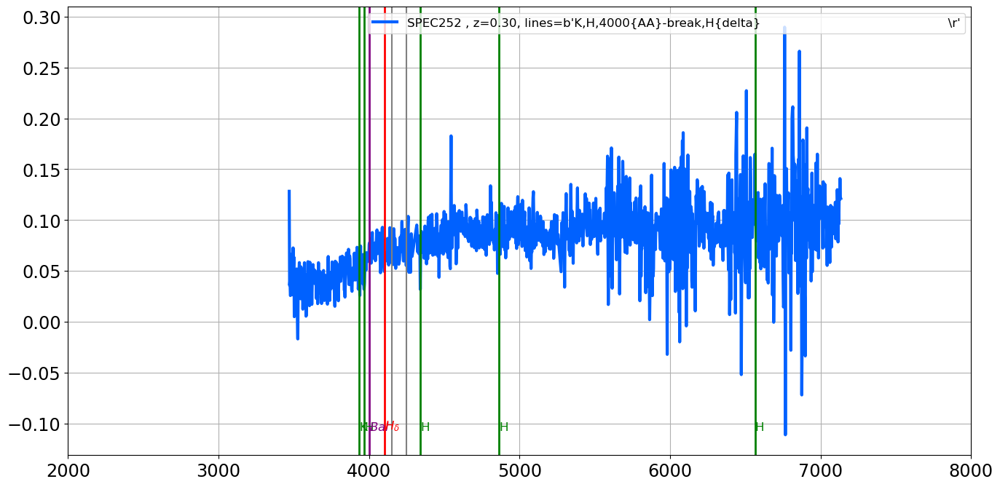

===================== SED 122 : SPEC253 , z=0.72, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


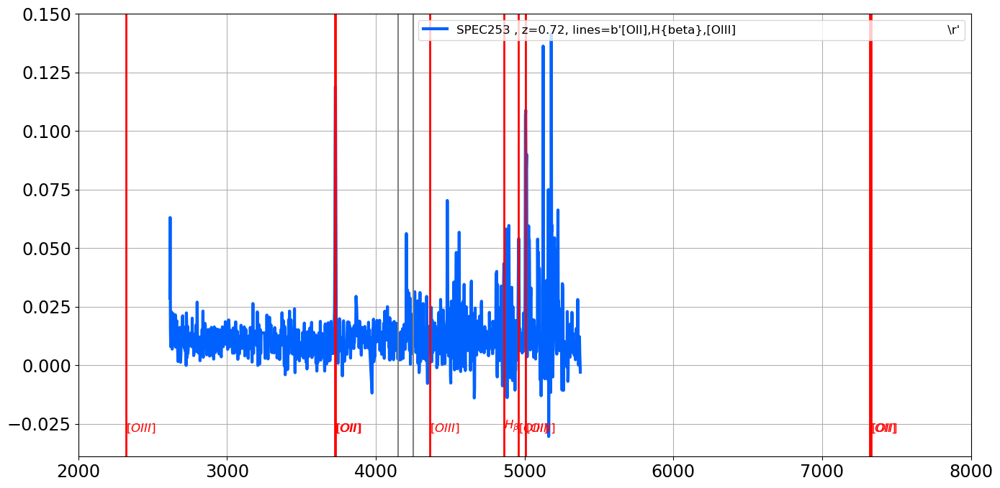

===================== SED 123 : SPEC258 , z=0.63, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


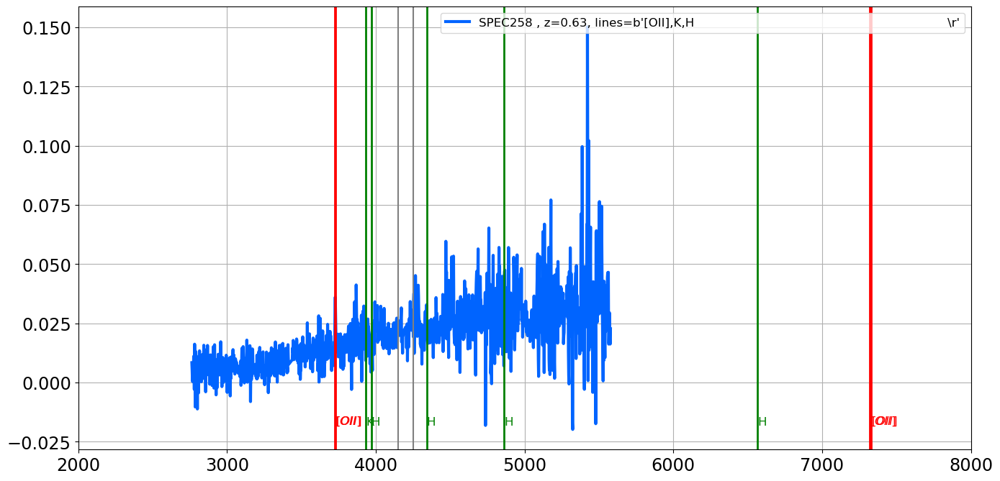

===================== SED 124 : SPEC259 , z=0.47, lines=b'[OII],H9,H,[OIII]                                                           \r'=======================
the_lines =  b'[OII],H9,H,[OIII]                                                           \r'
[OII]
H9
H
[OIII]


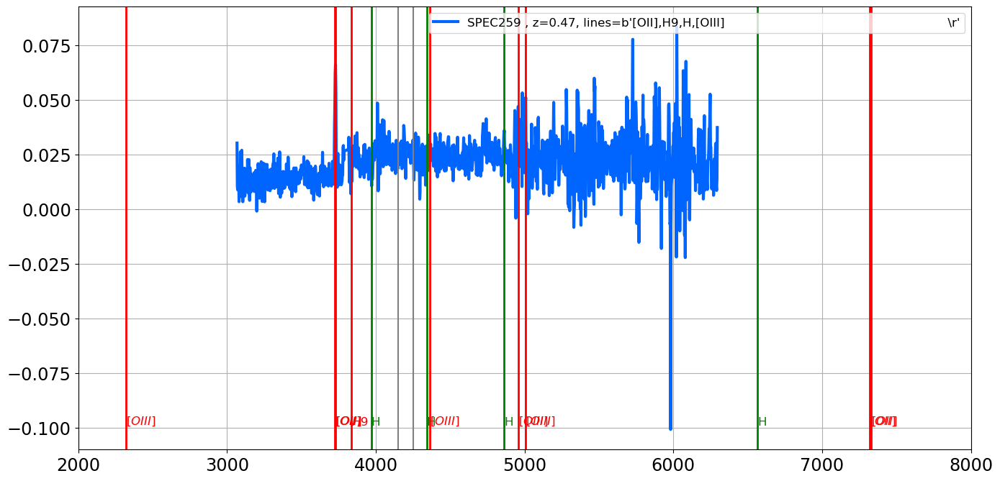

===================== SED 125 : SPEC260 , z=0.84, lines=b'[OII],H9,H8,H                                                               \r'=======================
the_lines =  b'[OII],H9,H8,H                                                               \r'
[OII]
H9
H8
H


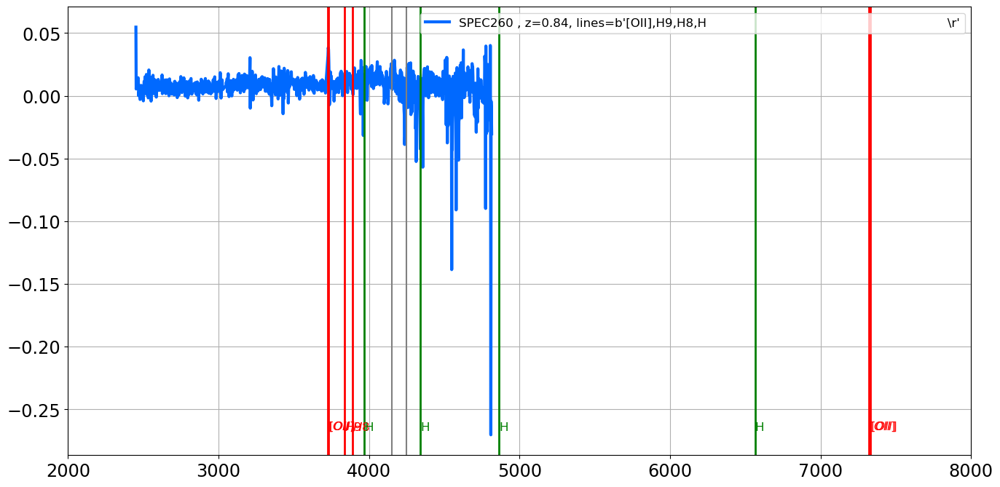

===================== SED 126 : SPEC261 , z=0.63, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


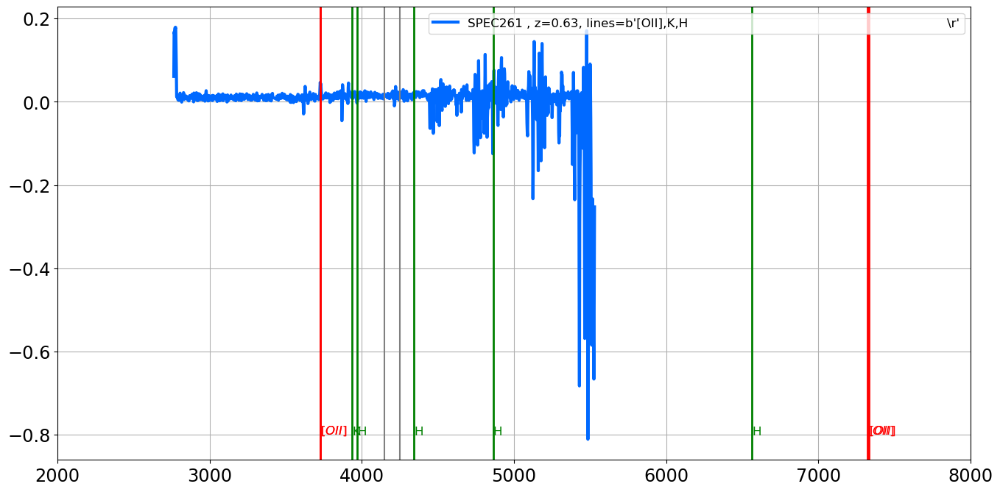

===================== SED 127 : SPEC262 , z=0.50, lines=b'[OII],H10,K,H                                                               \r'=======================
the_lines =  b'[OII],H10,K,H                                                               \r'
[OII]
H10
K
H


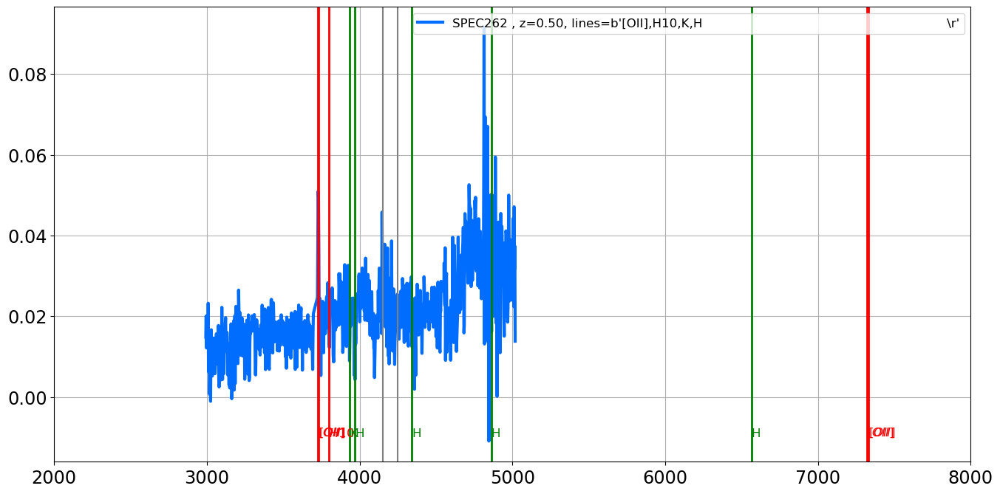

===================== SED 128 : SPEC264 , z=0.44, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


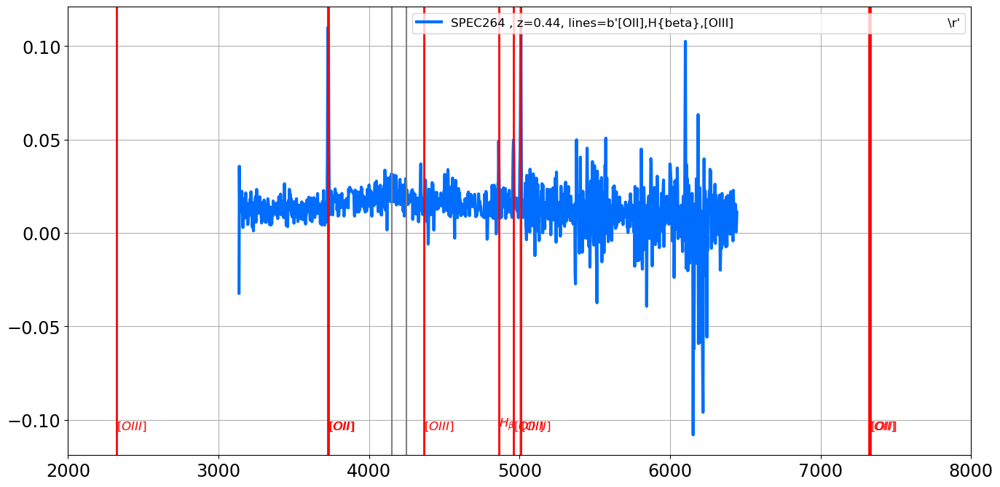

===================== SED 129 : SPEC265 , z=1.30, lines=b'FeII24,FeII26,MgII                                                          \r'=======================
the_lines =  b'FeII24,FeII26,MgII                                                          \r'
FeII24
FeII26
MgII


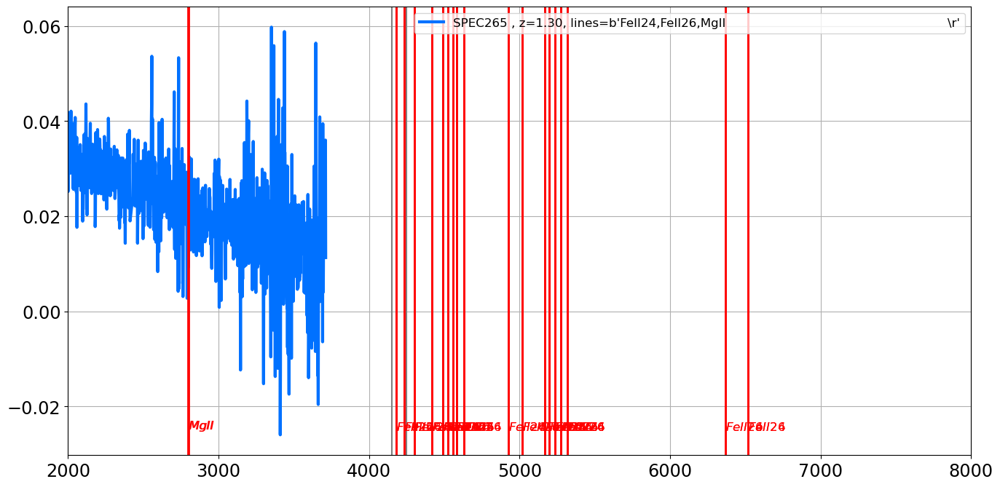

===================== SED 130 : SPEC266 , z=0.68, lines=b'[OII],H9,H8,H,[OIII]                                                        \r'=======================
the_lines =  b'[OII],H9,H8,H,[OIII]                                                        \r'
[OII]
H9
H8
H
[OIII]


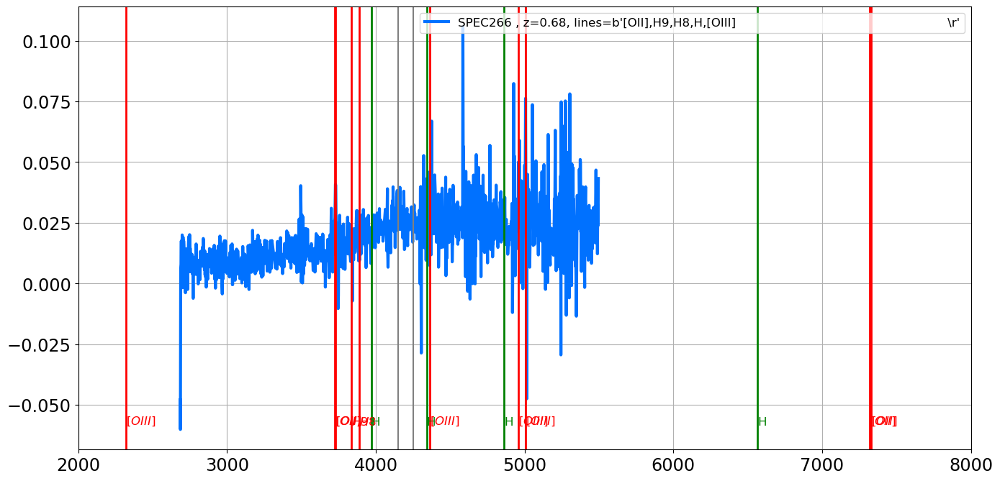

===================== SED 131 : SPEC267 , z=0.96, lines=b'FeII26,MgII,[OII]                                                           \r'=======================
the_lines =  b'FeII26,MgII,[OII]                                                           \r'
FeII26
MgII
[OII]


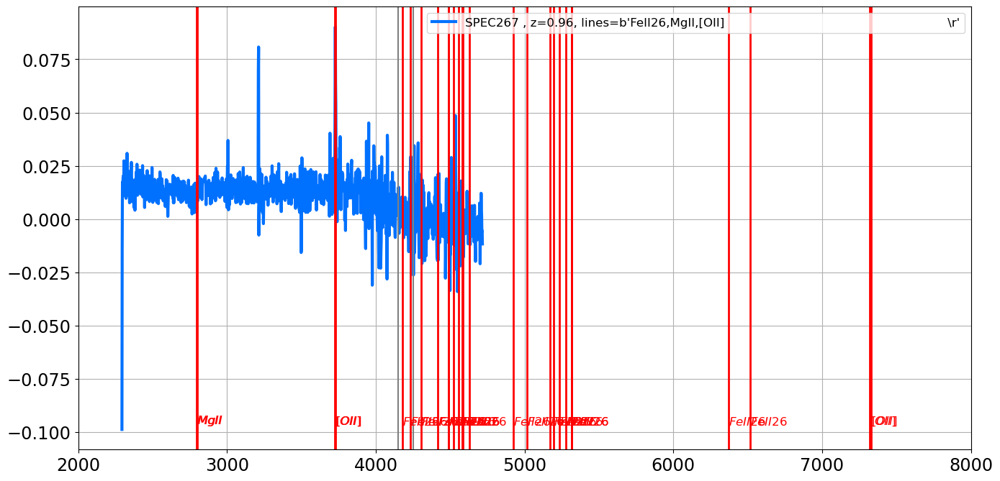

===================== SED 132 : SPEC268 , z=1.02, lines=b'MgII,[OII]                                                                  \r'=======================
the_lines =  b'MgII,[OII]                                                                  \r'
MgII
[OII]


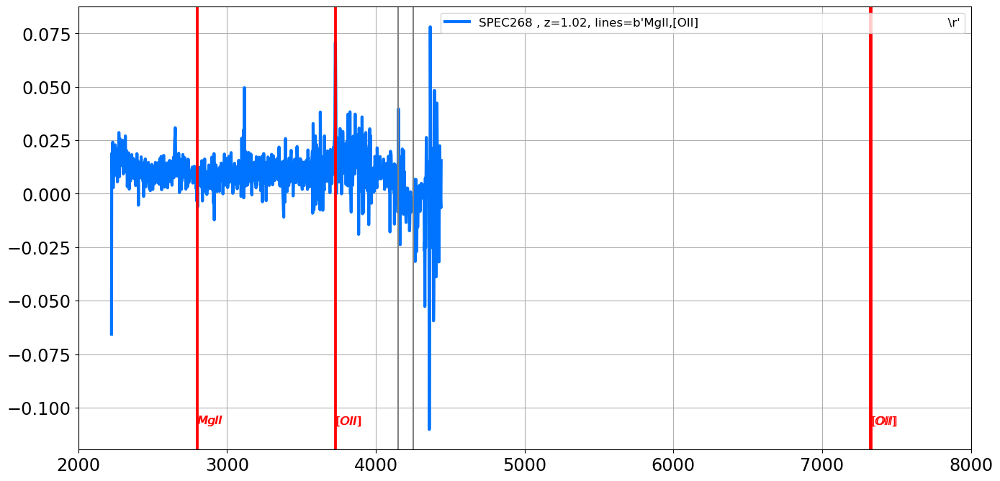

===================== SED 133 : SPEC271 , z=0.82, lines=b'K,H,4000{AA}-break                                                          \r'=======================
the_lines =  b'K,H,4000{AA}-break                                                          \r'
K
H
4000{AA}-break


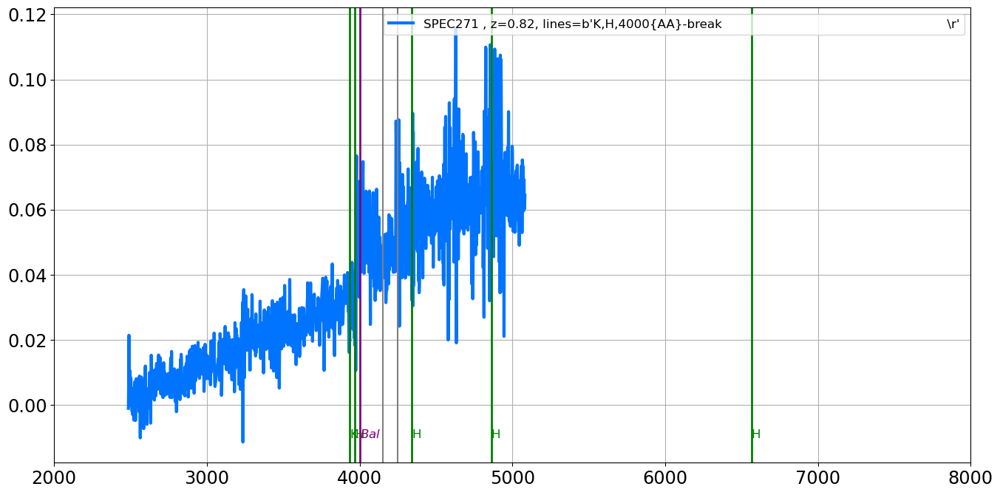

===================== SED 134 : SPEC274 , z=0.18, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


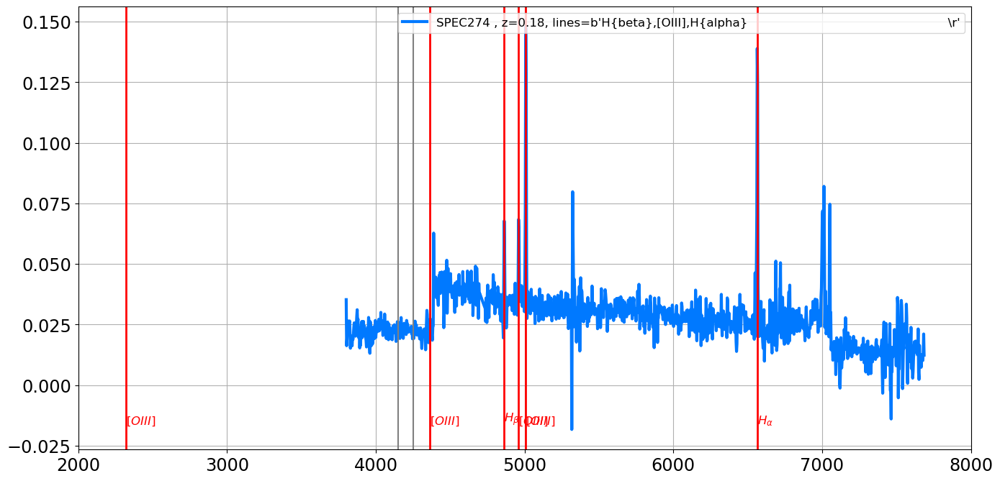

===================== SED 135 : SPEC275 , z=0.99, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


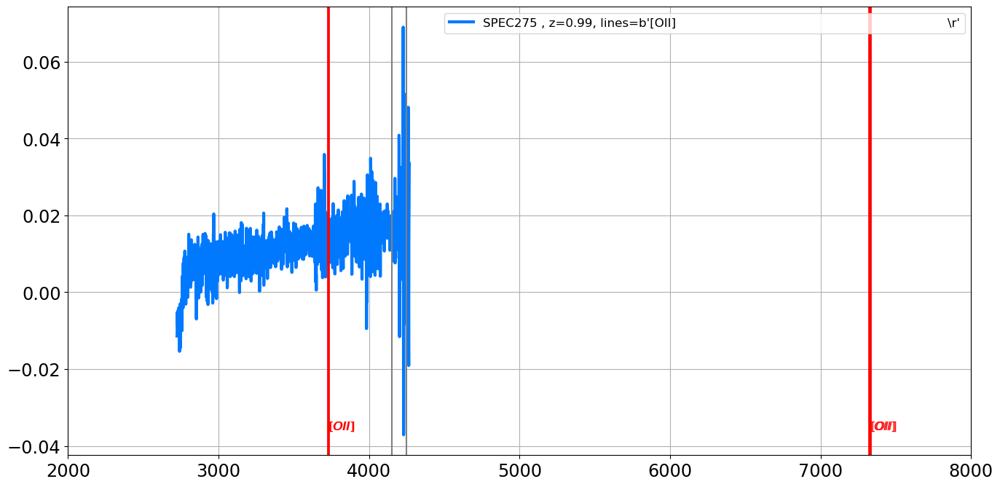

===================== SED 136 : SPEC276 , z=0.83, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


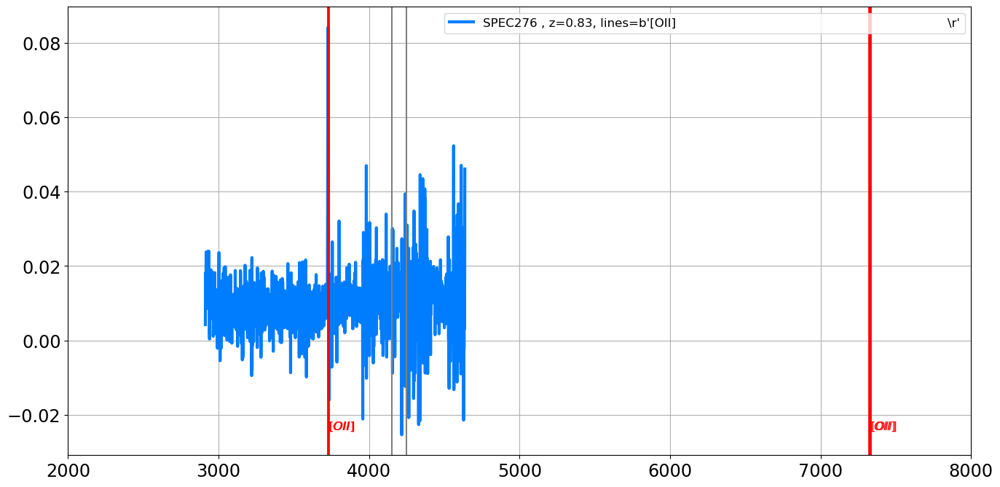

===================== SED 137 : SPEC277 , z=0.83, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


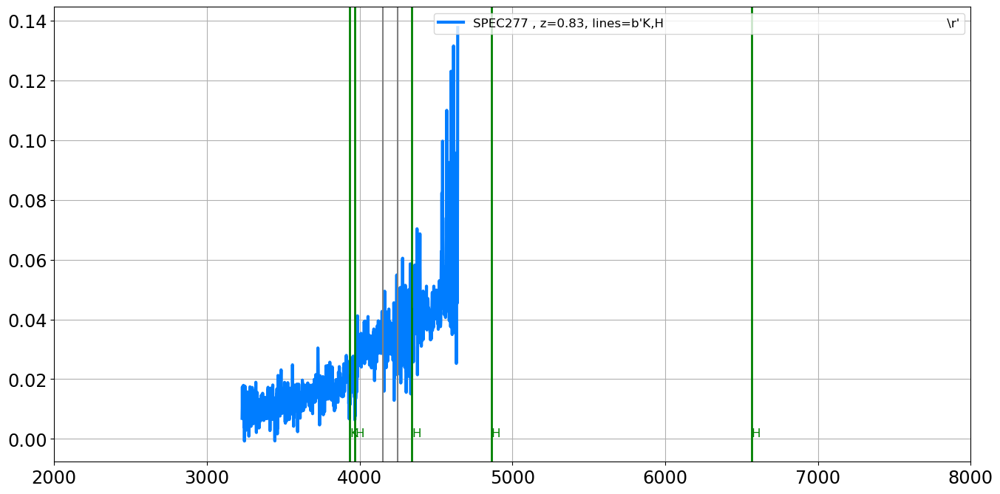

===================== SED 138 : SPEC278 , z=0.82, lines=b'[OII],H                                                                     \r'=======================
the_lines =  b'[OII],H                                                                     \r'
[OII]
H


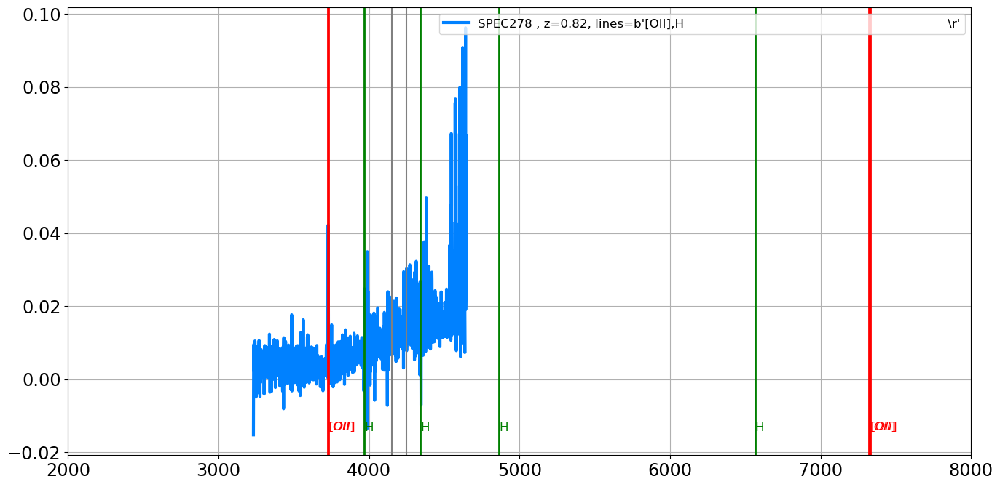

===================== SED 139 : SPEC279 , z=0.72, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


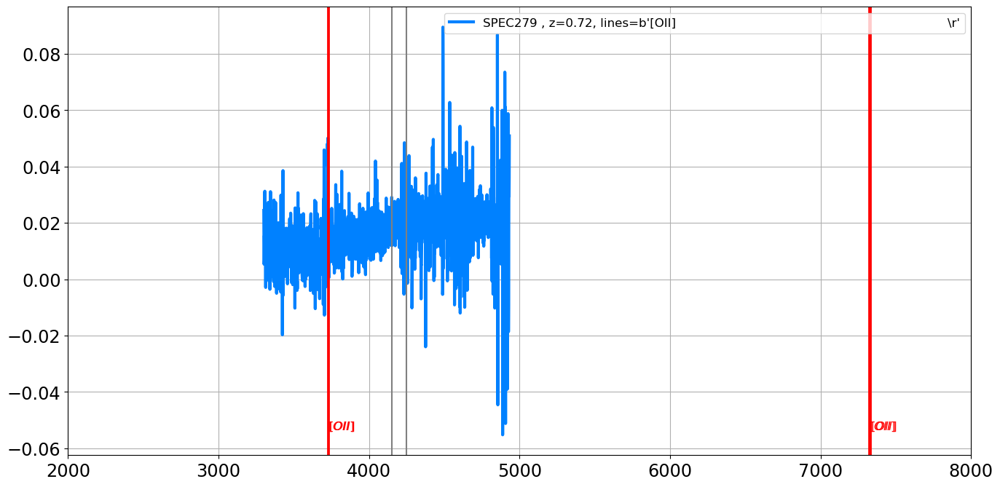

===================== SED 140 : SPEC280 , z=0.49, lines=b'[OIII]                                                                      \r'=======================
the_lines =  b'[OIII]                                                                      \r'
[OIII]


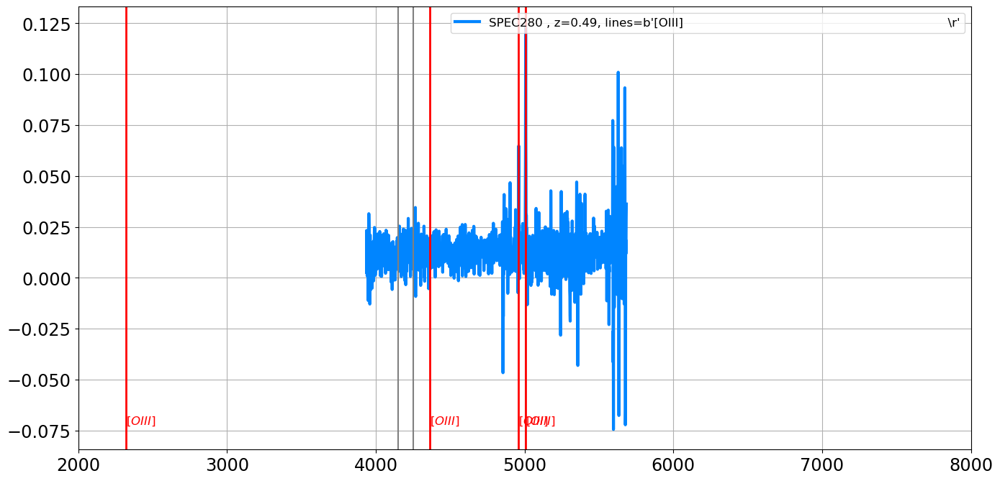

===================== SED 141 : SPEC281 , z=0.29, lines=b'H{beta},[OIII]                                                              \r'=======================
the_lines =  b'H{beta},[OIII]                                                              \r'
H{beta}
[OIII]


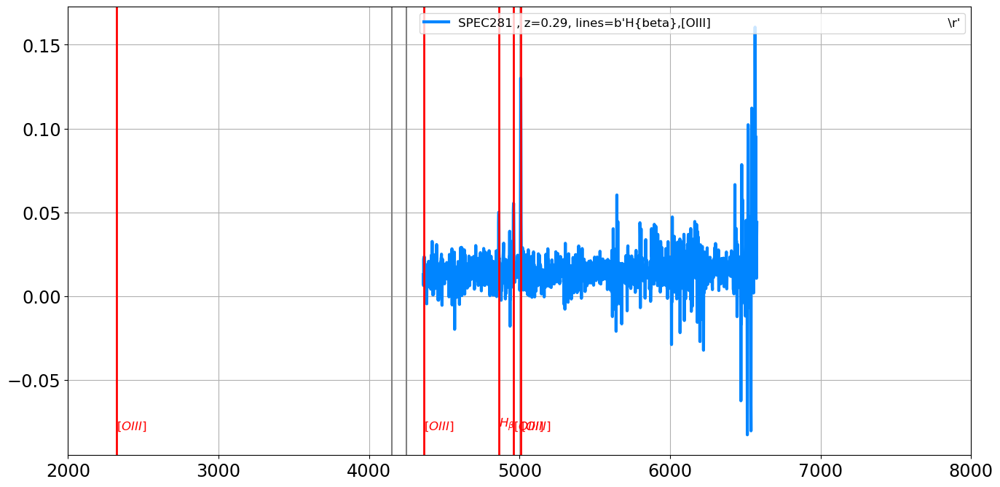

===================== SED 142 : SPEC282 , z=1.10, lines=b'weak,[OII],H8,K,H,4000{AA}-break                                            \r'=======================
the_lines =  b'weak,[OII],H8,K,H,4000{AA}-break                                            \r'
weak
[OII]
H8
K
H
4000{AA}-break


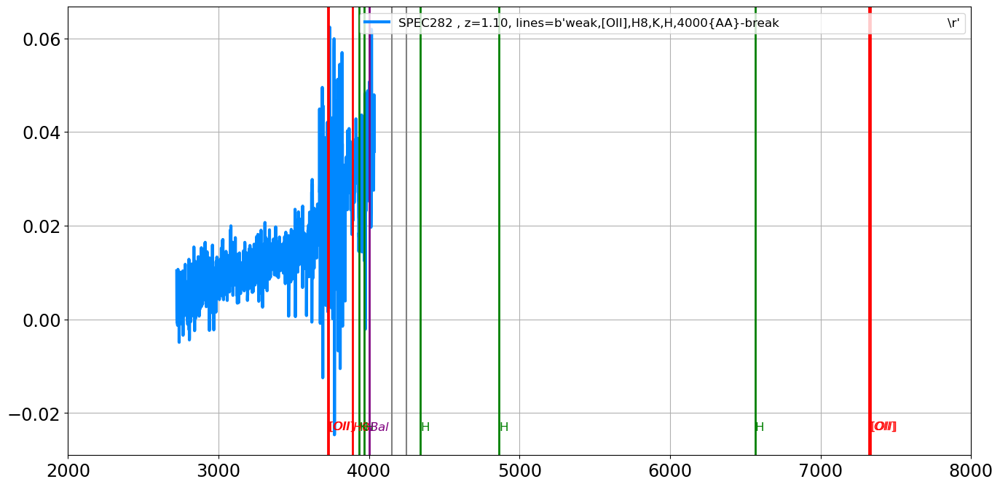

===================== SED 143 : SPEC283 , z=0.63, lines=b'[OII],[OIII]                                                                \r'=======================
the_lines =  b'[OII],[OIII]                                                                \r'
[OII]
[OIII]


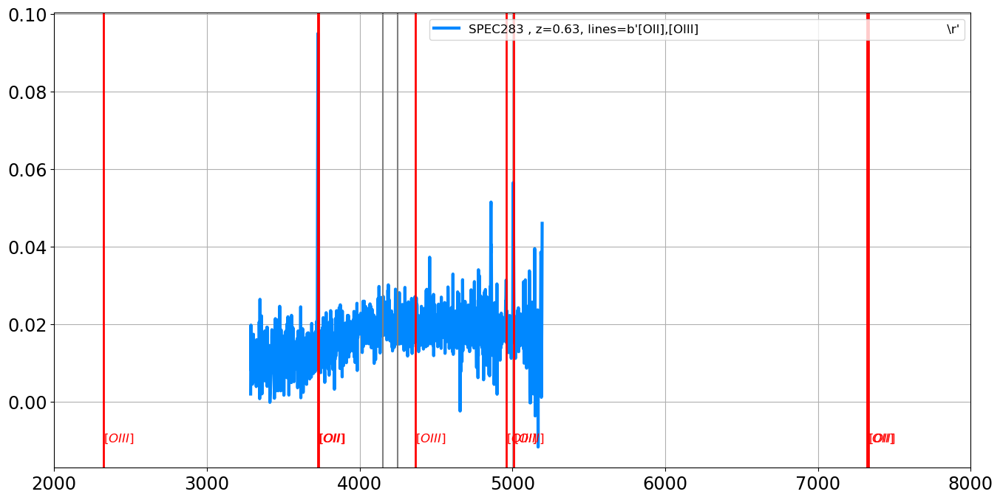

===================== SED 144 : SPEC287 , z=0.98, lines=b'[OII],K,H,4000{AA}-break                                                    \r'=======================
the_lines =  b'[OII],K,H,4000{AA}-break                                                    \r'
[OII]
K
H
4000{AA}-break


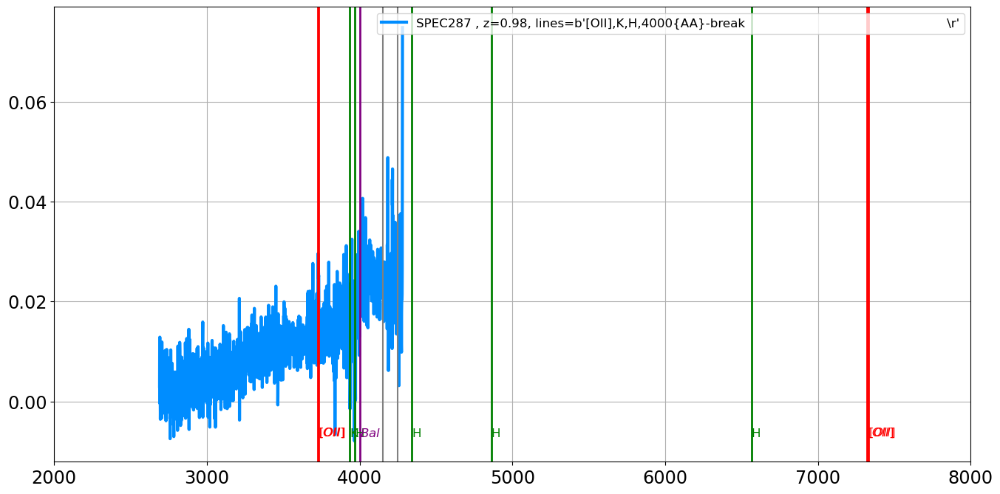

===================== SED 145 : SPEC288 , z=0.69, lines=b'K,H,4000{AA}-break                                                          \r'=======================
the_lines =  b'K,H,4000{AA}-break                                                          \r'
K
H
4000{AA}-break


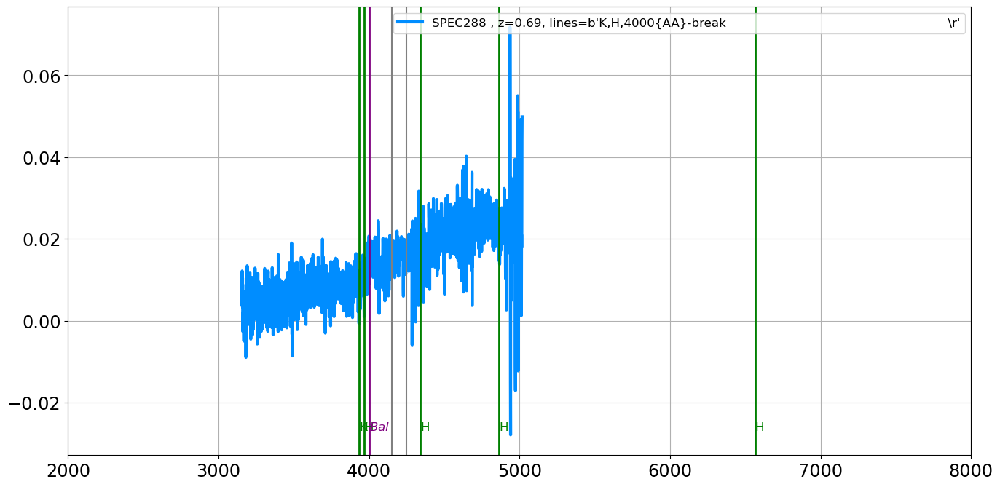

===================== SED 146 : SPEC291 , z=1.00, lines=b'[OII],H9,H8,K,H,4000{AA}-break,H{delta}                                     \r'=======================
the_lines =  b'[OII],H9,H8,K,H,4000{AA}-break,H{delta}                                     \r'
[OII]
H9
H8
K
H
4000{AA}-break
H{delta}


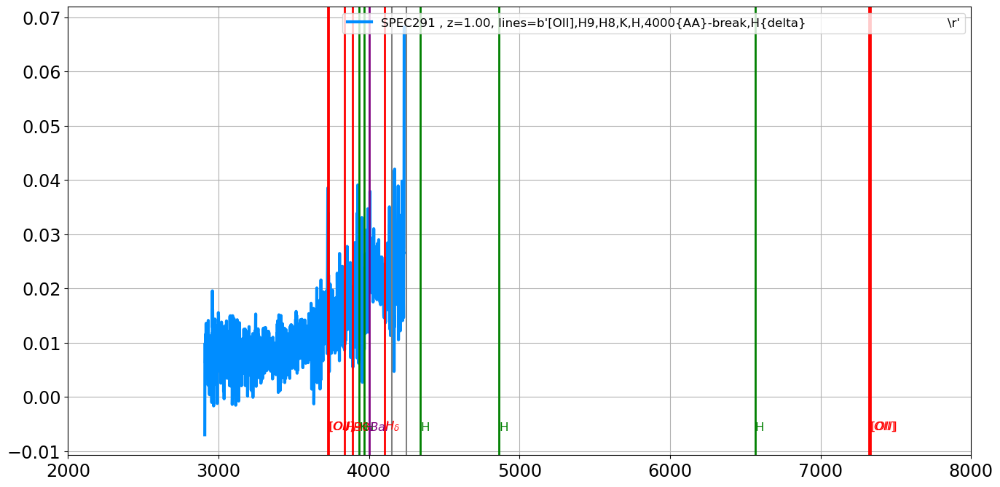

===================== SED 147 : SPEC292 , z=1.00, lines=b'[OII],H10,H9,K,H,4000{AA}-break,H{delta}                                    \r'=======================
the_lines =  b'[OII],H10,H9,K,H,4000{AA}-break,H{delta}                                    \r'
[OII]
H10
H9
K
H
4000{AA}-break
H{delta}


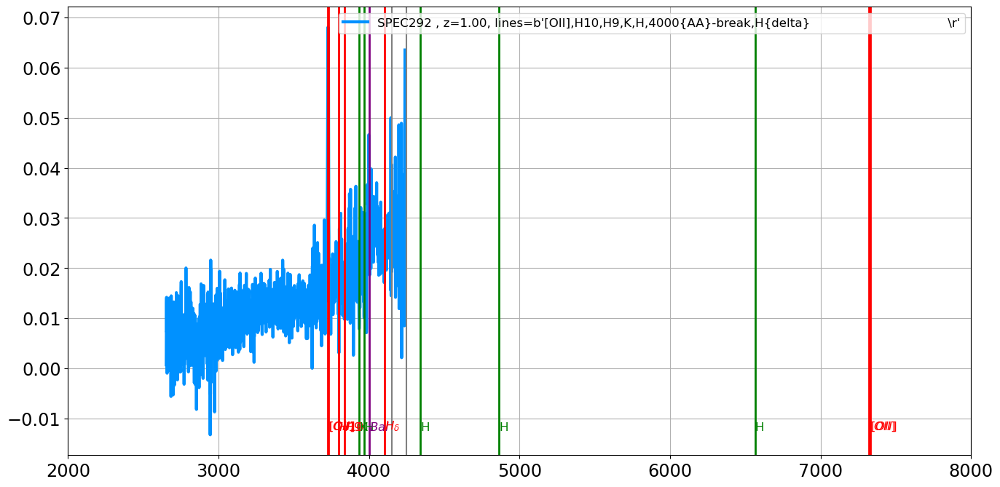

===================== SED 148 : SPEC294 , z=0.44, lines=b'H{beta},[OIII]                                                              \r'=======================
the_lines =  b'H{beta},[OIII]                                                              \r'
H{beta}
[OIII]


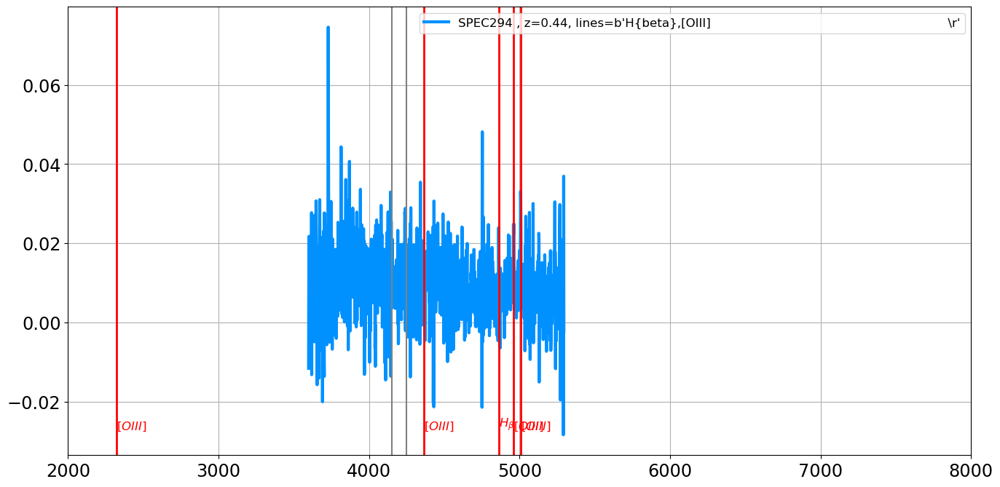

===================== SED 149 : SPEC295 , z=0.76, lines=b'H9,H8,K,H,4000{AA}-break,H{delta}                                           \r'=======================
the_lines =  b'H9,H8,K,H,4000{AA}-break,H{delta}                                           \r'
H9
H8
K
H
4000{AA}-break
H{delta}


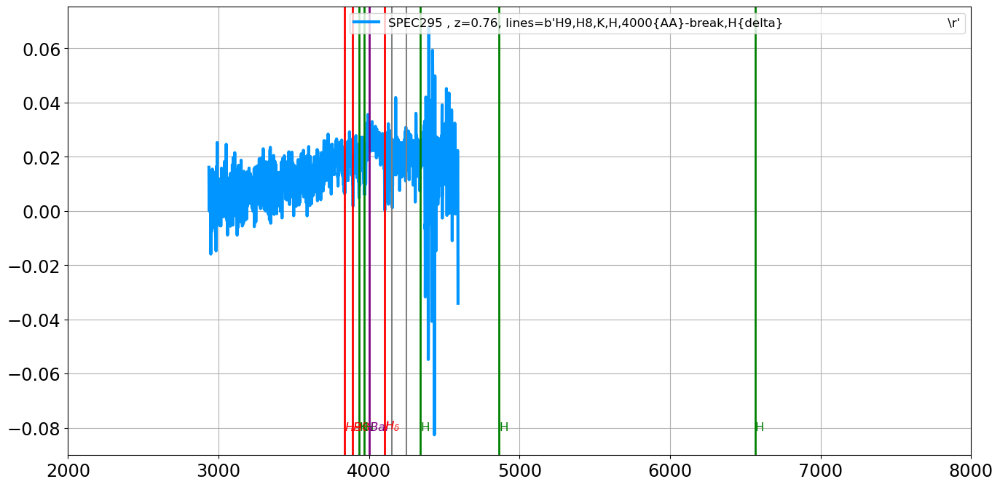

===================== SED 150 : SPEC296 , z=0.82, lines=b'K,H,4000{AA}-break,H{delta},G,H9,H8                                         \r'=======================
the_lines =  b'K,H,4000{AA}-break,H{delta},G,H9,H8                                         \r'
K
H
4000{AA}-break
H{delta}
G
H9
H8


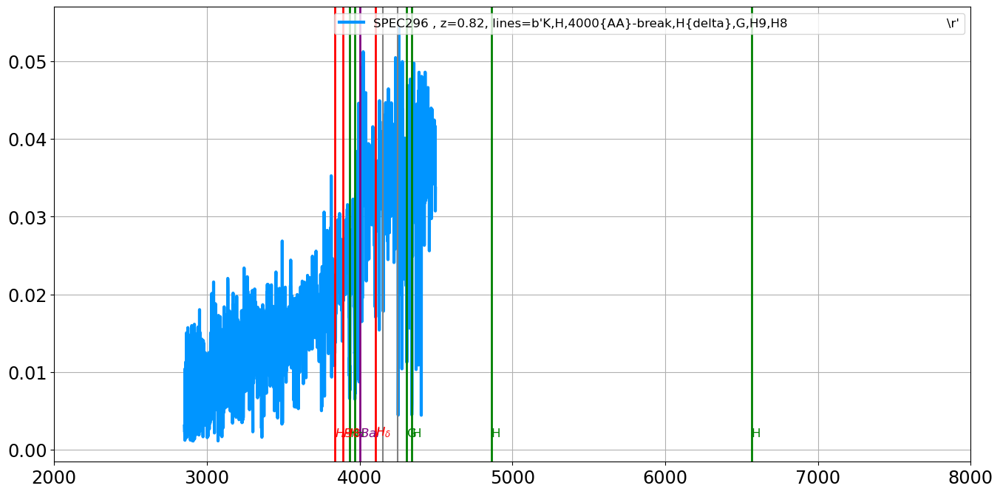

===================== SED 151 : SPEC297 , z=0.82, lines=b'[OII],H9,K,H                                                                \r'=======================
the_lines =  b'[OII],H9,K,H                                                                \r'
[OII]
H9
K
H


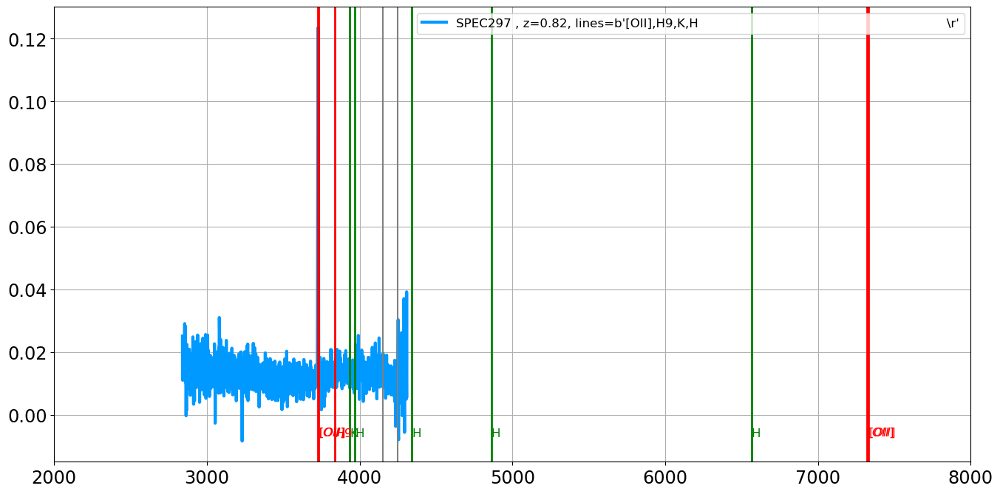

===================== SED 152 : SPEC298 , z=0.65, lines=b'[OII],H9,H8,H,H{delta}                                                      \r'=======================
the_lines =  b'[OII],H9,H8,H,H{delta}                                                      \r'
[OII]
H9
H8
H
H{delta}


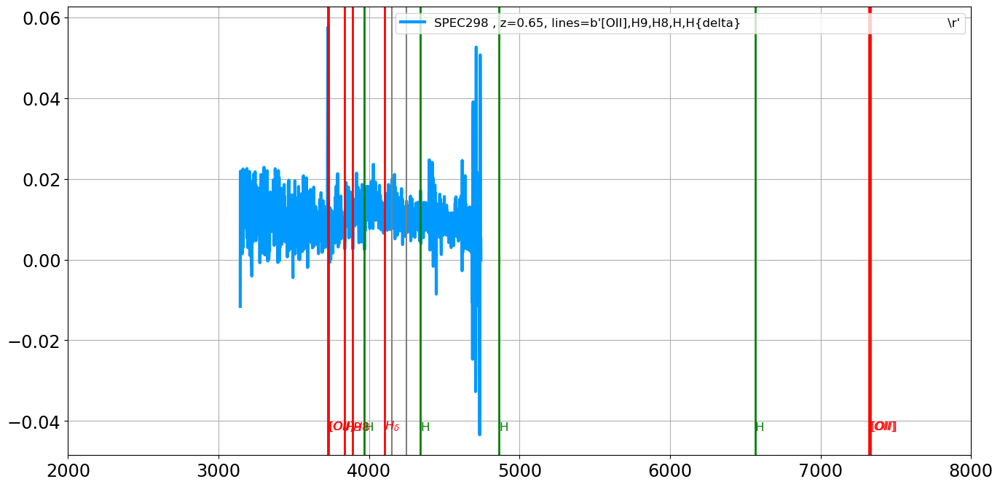

===================== SED 153 : SPEC301 , z=0.82, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


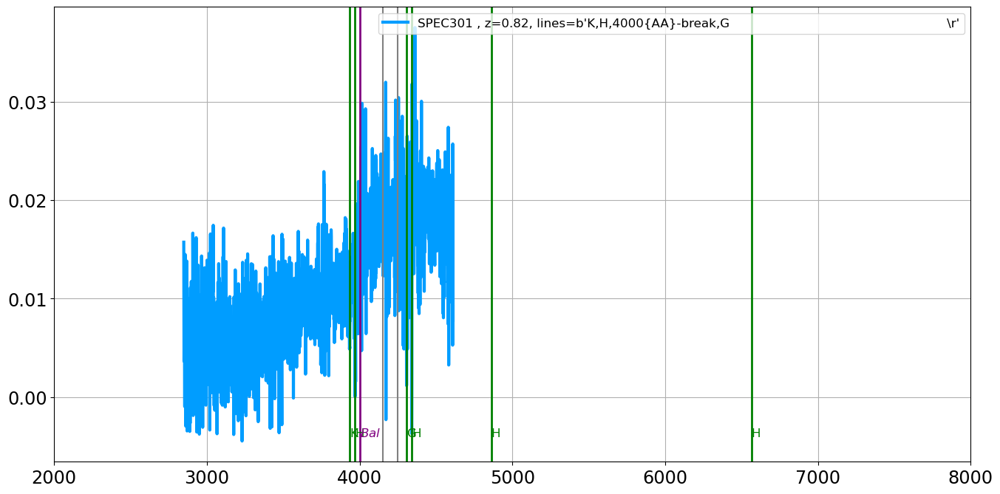

===================== SED 154 : SPEC302 , z=0.97, lines=b'MgII,[OII],H9,K,H                                                           \r'=======================
the_lines =  b'MgII,[OII],H9,K,H                                                           \r'
MgII
[OII]
H9
K
H


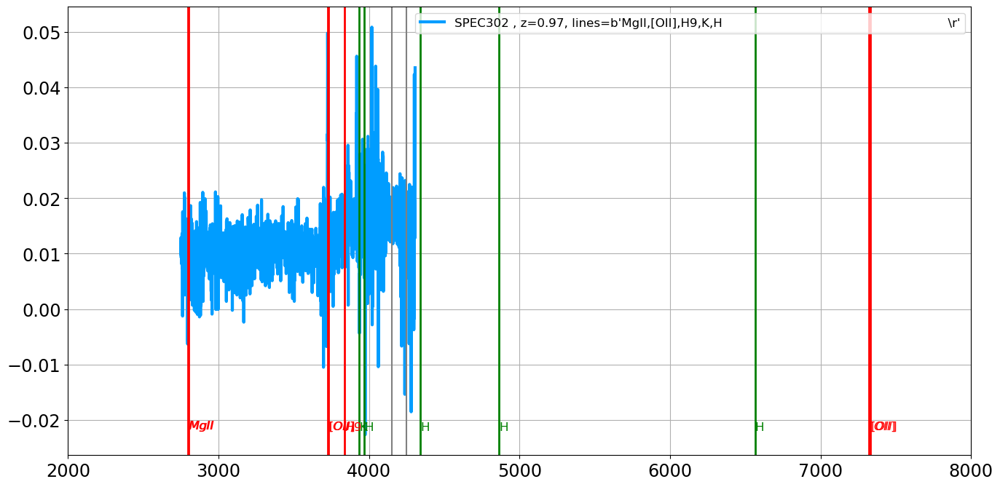

===================== SED 155 : SPEC303 , z=0.69, lines=b'H8,K,H,G,[OII]                                                              \r'=======================
the_lines =  b'H8,K,H,G,[OII]                                                              \r'
H8
K
H
G
[OII]


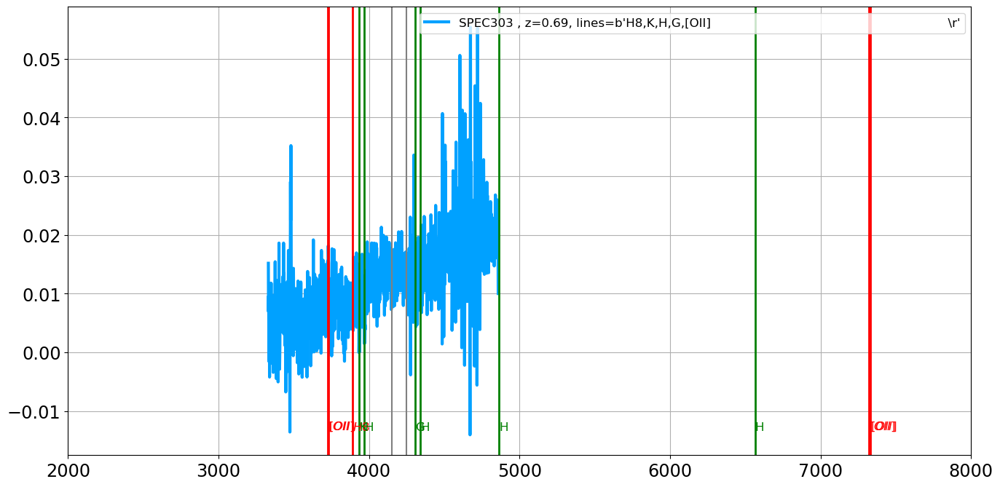

===================== SED 156 : SPEC304 , z=-0.00, lines=b'                                                                            \r'=======================
the_lines =  b'                                                                            \r'



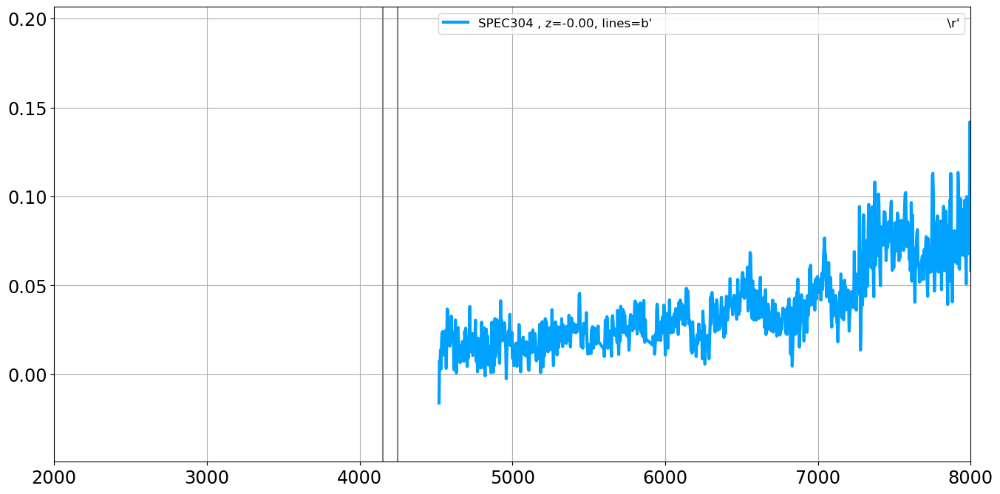

===================== SED 157 : SPEC305 , z=0.43, lines=b'[OII],[OIII]                                                                \r'=======================
the_lines =  b'[OII],[OIII]                                                                \r'
[OII]
[OIII]


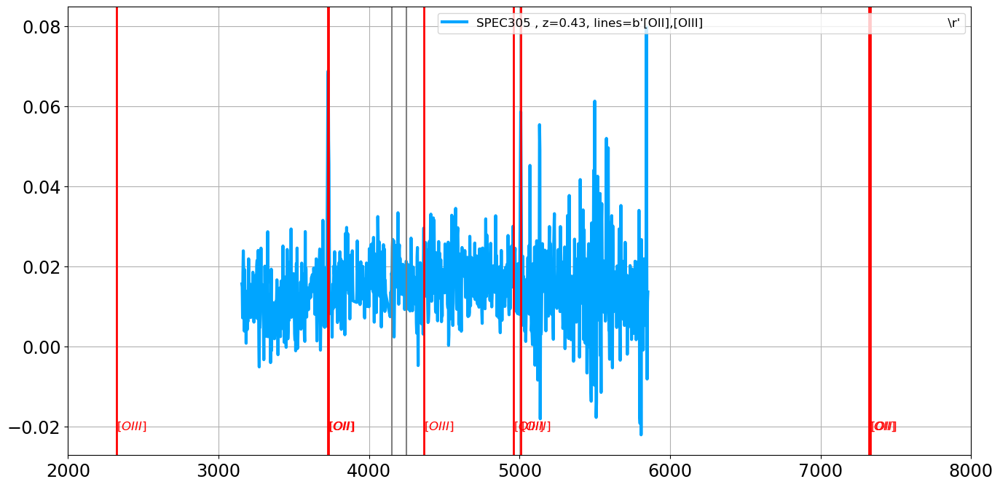

===================== SED 158 : SPEC306 , z=0.84, lines=b'MgII,[OII],H10,H9,K                                                         \r'=======================
the_lines =  b'MgII,[OII],H10,H9,K                                                         \r'
MgII
[OII]
H10
H9
K


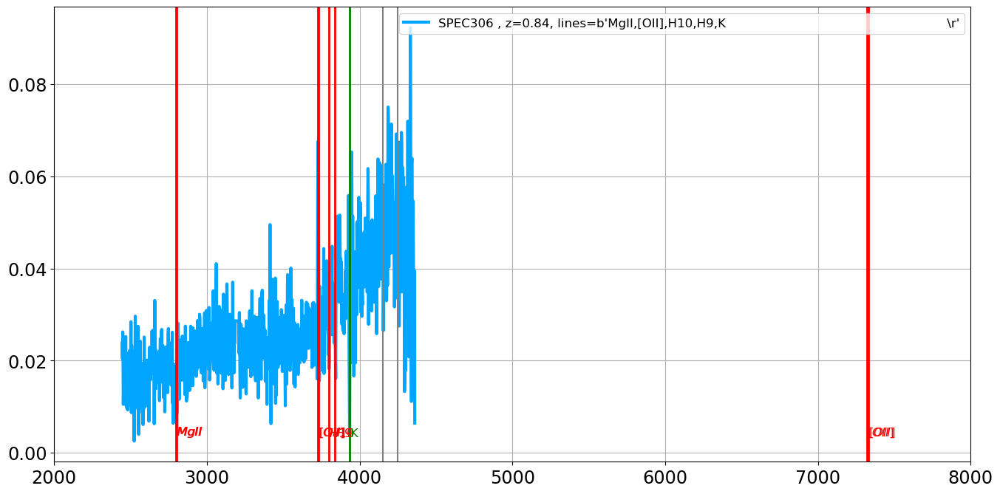

===================== SED 159 : SPEC307 , z=0.29, lines=b'[OII],H{alpha}                                                              \r'=======================
the_lines =  b'[OII],H{alpha}                                                              \r'
[OII]
H{alpha}


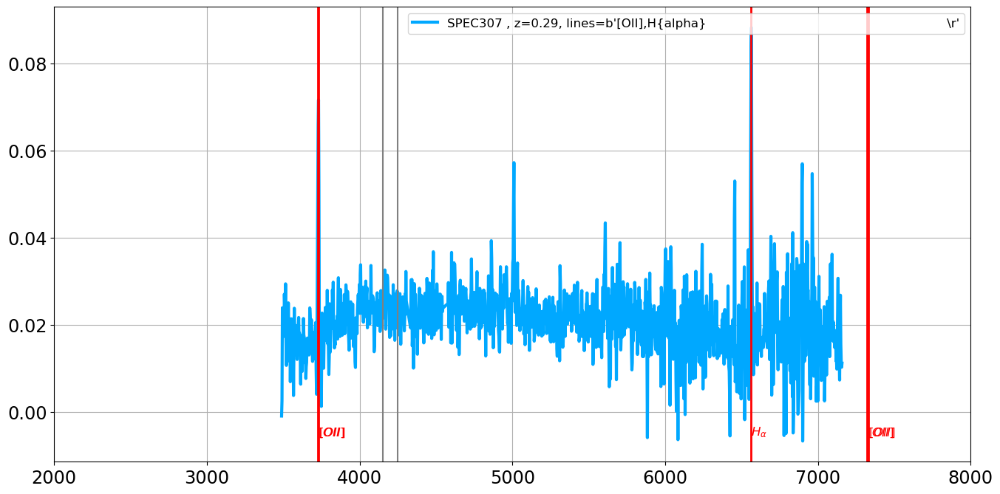

===================== SED 160 : SPEC308 , z=0.77, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


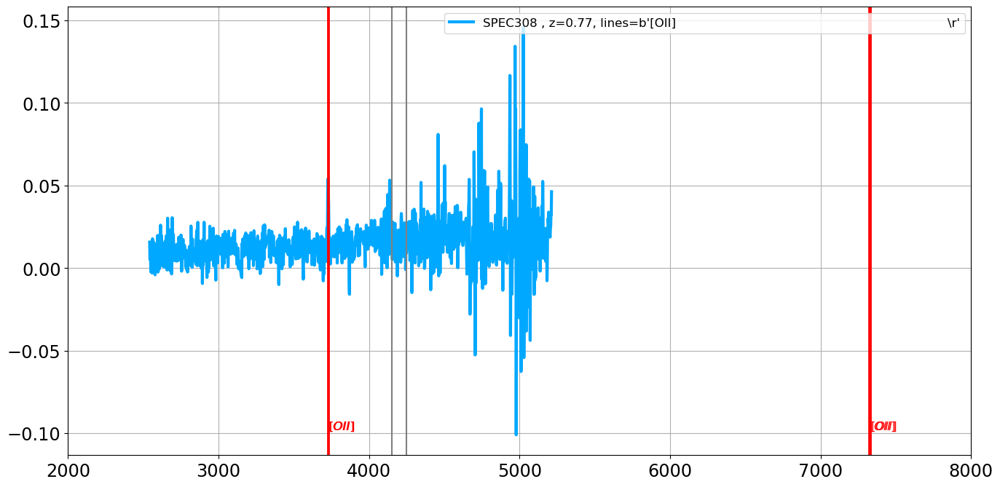

===================== SED 161 : SPEC309 , z=0.64, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


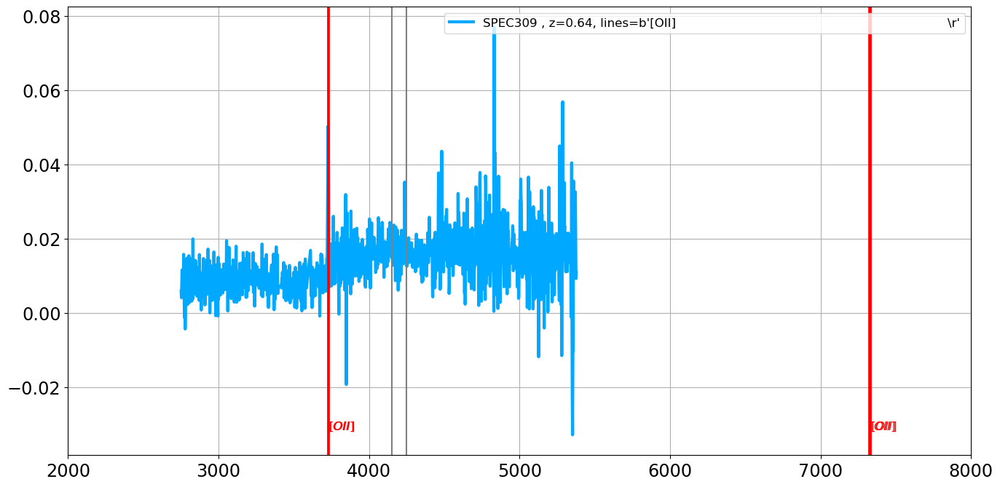

===================== SED 162 : SPEC313 , z=0.56, lines=b'[OII],[OIII]                                                                \r'=======================
the_lines =  b'[OII],[OIII]                                                                \r'
[OII]
[OIII]


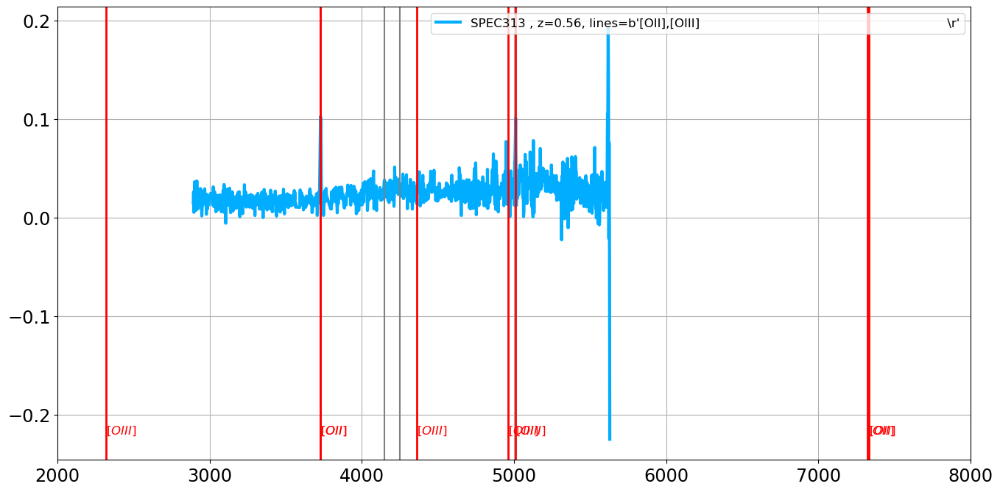

===================== SED 163 : SPEC315 , z=0.44, lines=b'[OII],H{beta}                                                               \r'=======================
the_lines =  b'[OII],H{beta}                                                               \r'
[OII]
H{beta}


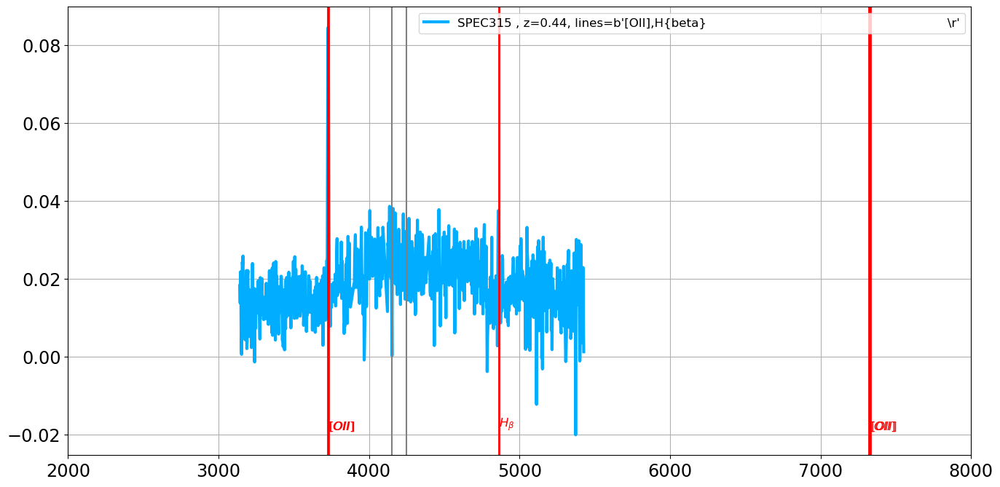

===================== SED 164 : SPEC317 , z=0.82, lines=b'[OII],H9,K                                                                  \r'=======================
the_lines =  b'[OII],H9,K                                                                  \r'
[OII]
H9
K


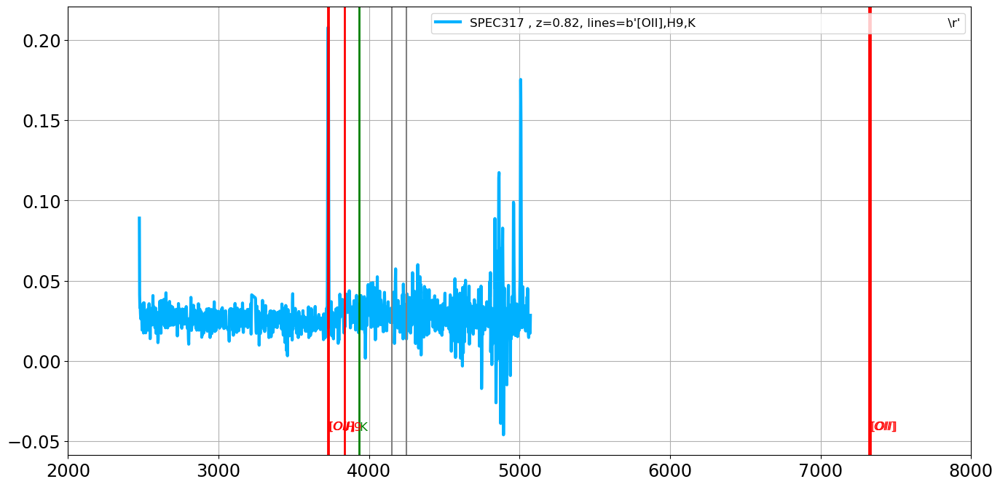

===================== SED 165 : SPEC318 , z=0.68, lines=b'H9,K,H,4000{AA}-break                                                       \r'=======================
the_lines =  b'H9,K,H,4000{AA}-break                                                       \r'
H9
K
H
4000{AA}-break


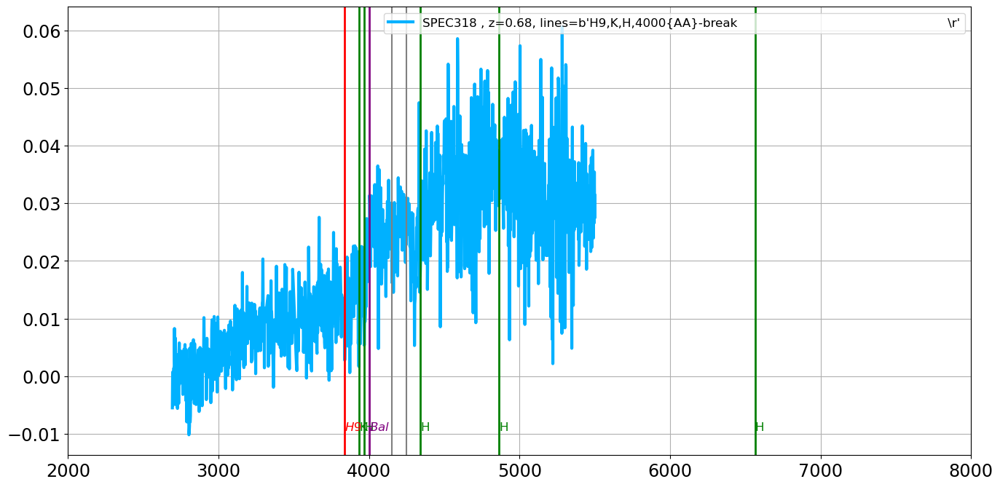

===================== SED 166 : SPEC319 , z=0.43, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


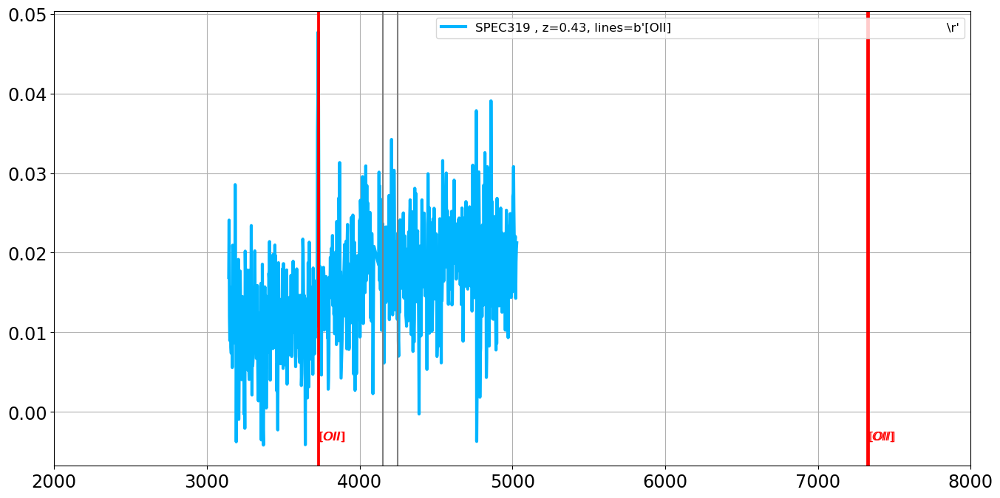

===================== SED 167 : SPEC321 , z=0.29, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


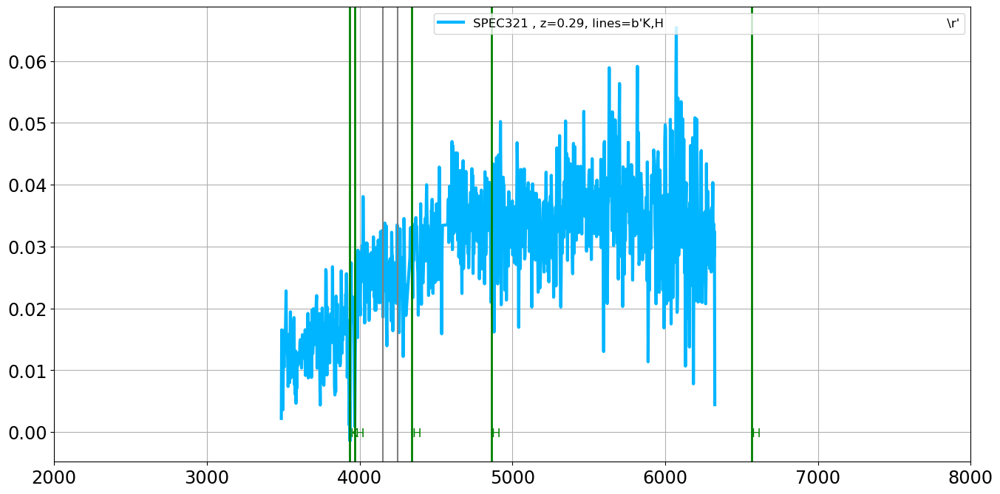

===================== SED 168 : SPEC322 , z=0.29, lines=b'[OII],K,H,H{delta}                                                          \r'=======================
the_lines =  b'[OII],K,H,H{delta}                                                          \r'
[OII]
K
H
H{delta}


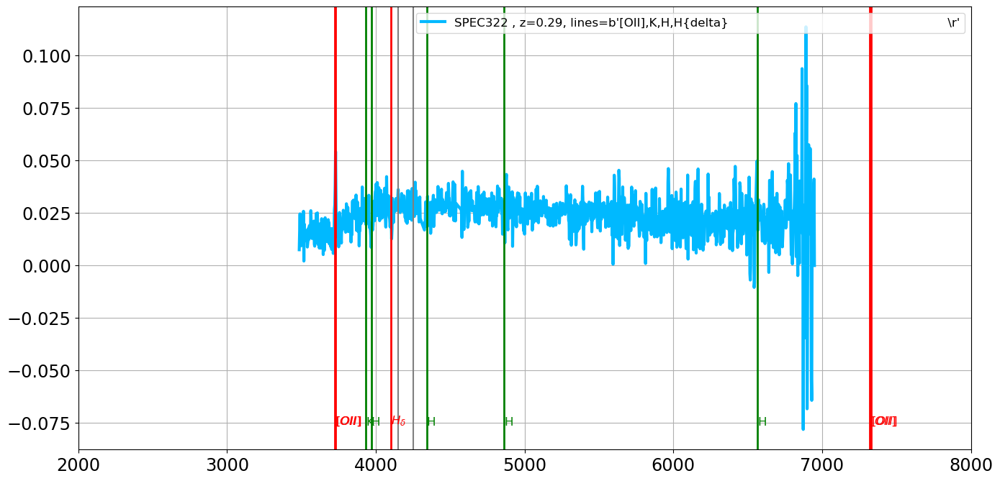

===================== SED 169 : SPEC323 , z=0.48, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


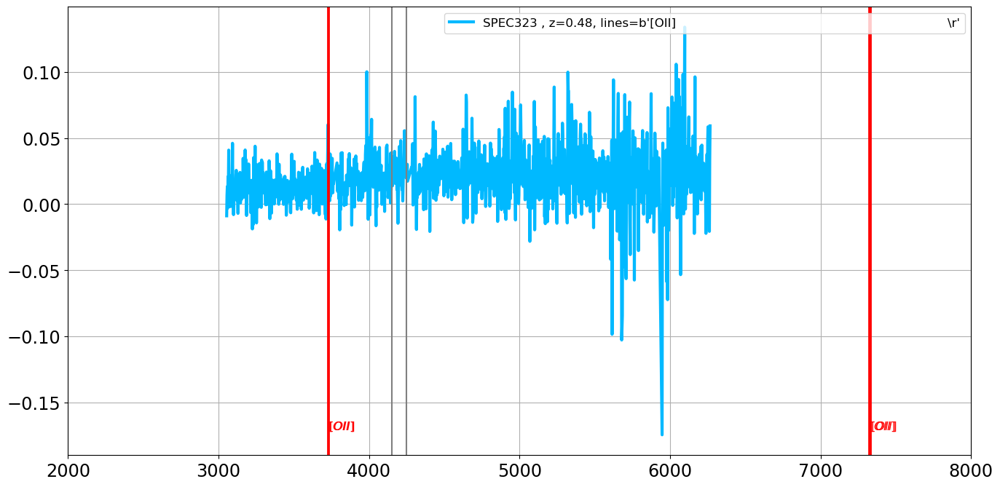

===================== SED 170 : SPEC324 , z=0.67, lines=b'K,H,H{delta}                                                                \r'=======================
the_lines =  b'K,H,H{delta}                                                                \r'
K
H
H{delta}


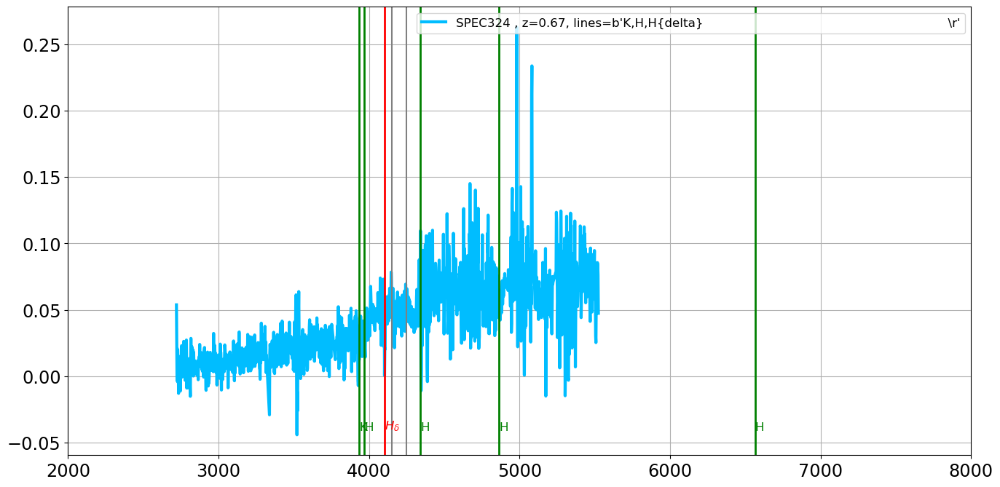

===================== SED 171 : SPEC325 , z=0.27, lines=b'[OII],H10,H9,H8,H,H{delta},H{beta},[OIII],H{alpha}                          \r'=======================
the_lines =  b'[OII],H10,H9,H8,H,H{delta},H{beta},[OIII],H{alpha}                          \r'
[OII]
H10
H9
H8
H
H{delta}
H{beta}
[OIII]
H{alpha}


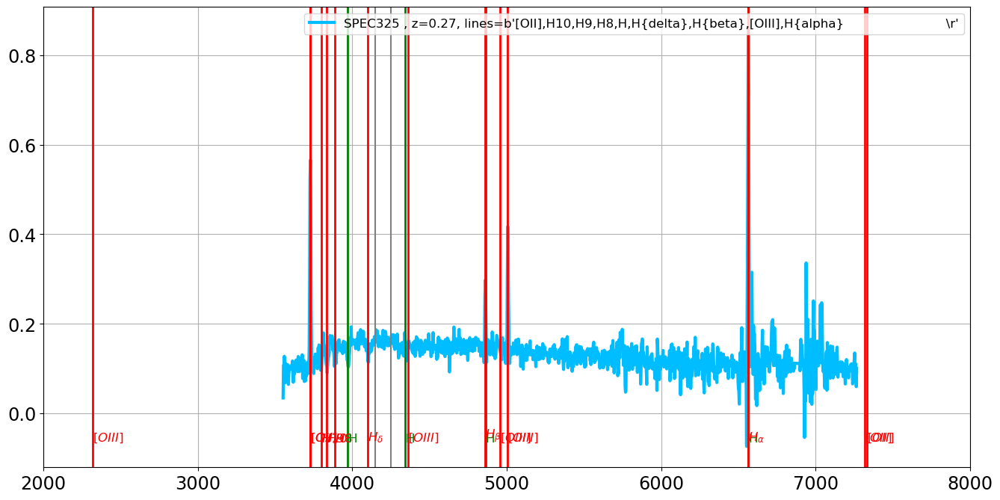

===================== SED 172 : SPEC326 , z=0.24, lines=b'[OII],H9,K,H,[OIII],H{alpha}                                                \r'=======================
the_lines =  b'[OII],H9,K,H,[OIII],H{alpha}                                                \r'
[OII]
H9
K
H
[OIII]
H{alpha}


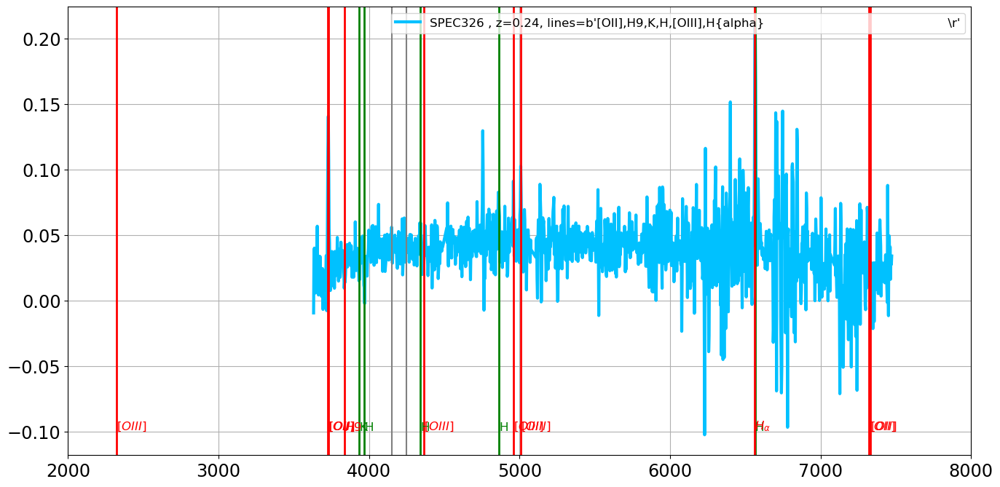

===================== SED 173 : SPEC327 , z=0.72, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


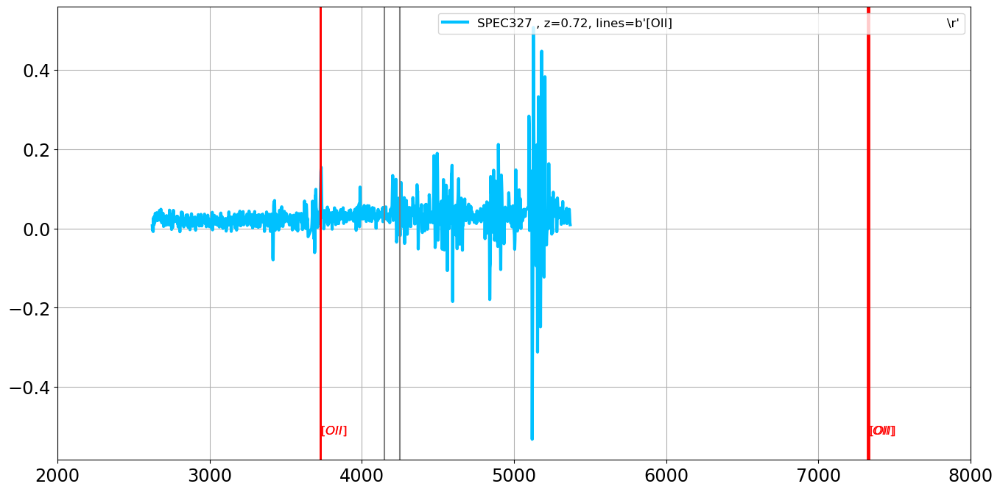

===================== SED 174 : SPEC328 , z=0.29, lines=b'[OII],[OIII]                                                                \r'=======================
the_lines =  b'[OII],[OIII]                                                                \r'
[OII]
[OIII]


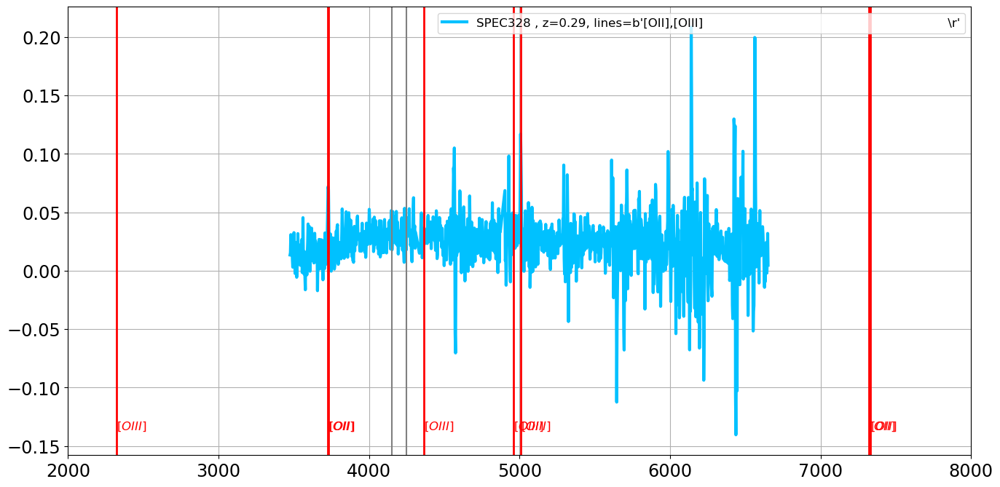

===================== SED 175 : SPEC329 , z=0.43, lines=b'[OII],?                                                                     \r'=======================
the_lines =  b'[OII],?                                                                     \r'
[OII]
?


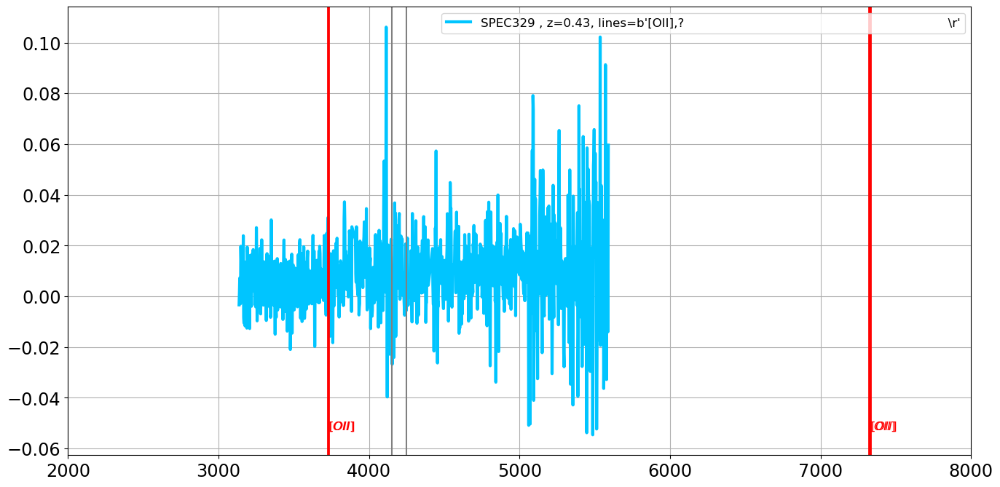

===================== SED 176 : SPEC331 , z=0.41, lines=b'[OII],H{beta},[OIII],H{alpha}                                               \r'=======================
the_lines =  b'[OII],H{beta},[OIII],H{alpha}                                               \r'
[OII]
H{beta}
[OIII]
H{alpha}


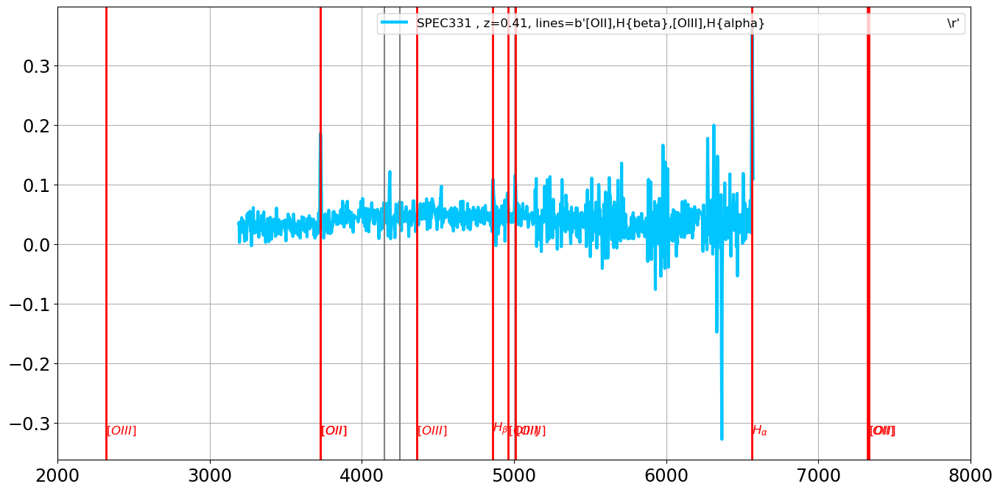

===================== SED 177 : SPEC332 , z=0.56, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


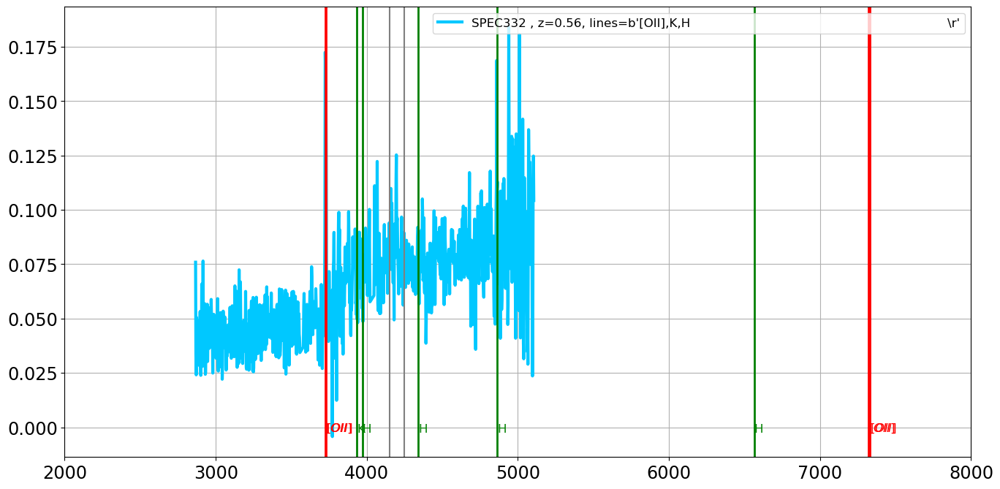

===================== SED 178 : SPEC333 , z=0.27, lines=b'[OII],[OIII]                                                                \r'=======================
the_lines =  b'[OII],[OIII]                                                                \r'
[OII]
[OIII]


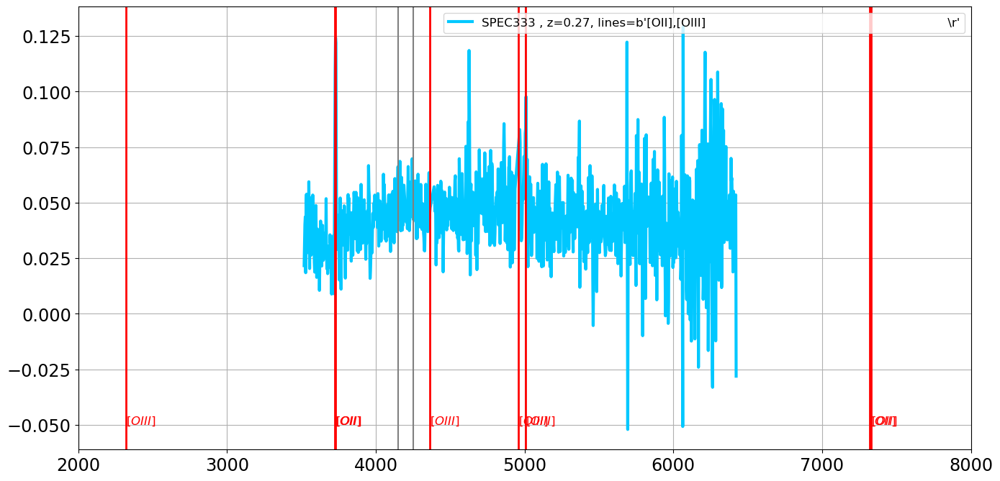

===================== SED 179 : SPEC334 , z=0.52, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


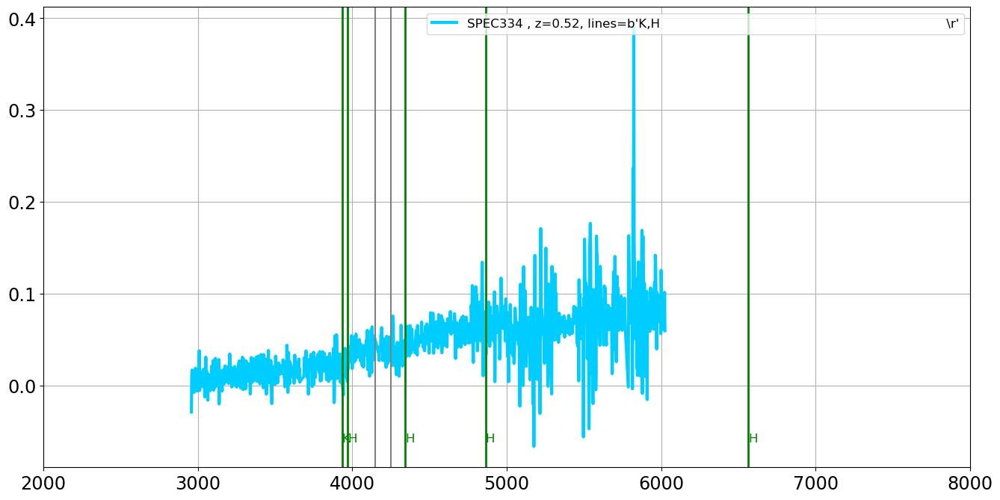

===================== SED 180 : SPEC335 , z=0.58, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


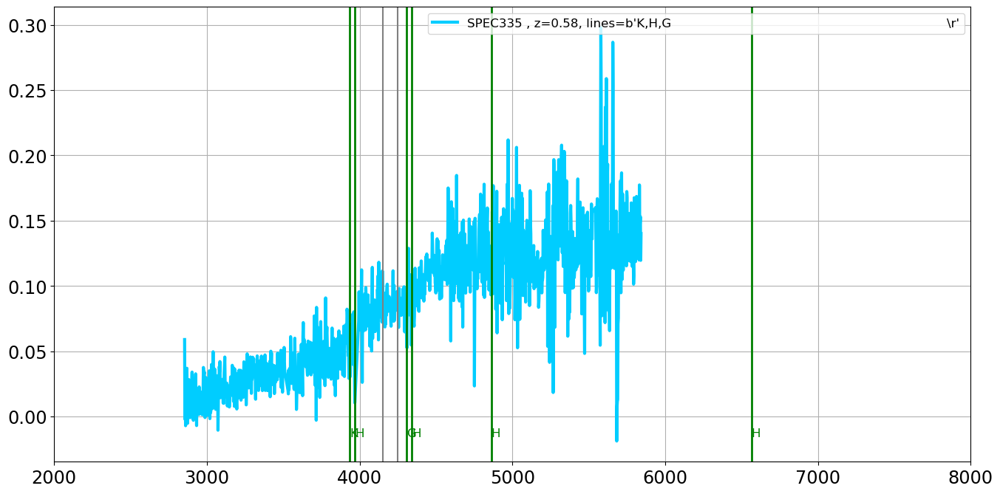

===================== SED 181 : SPEC336 , z=0.54, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


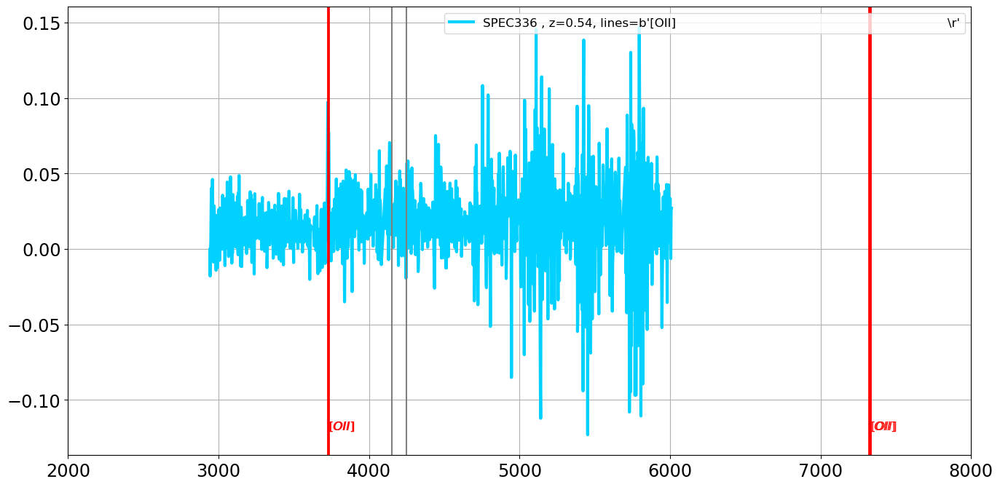

===================== SED 182 : SPEC337 , z=0.58, lines=b'[OII],H                                                                     \r'=======================
the_lines =  b'[OII],H                                                                     \r'
[OII]
H


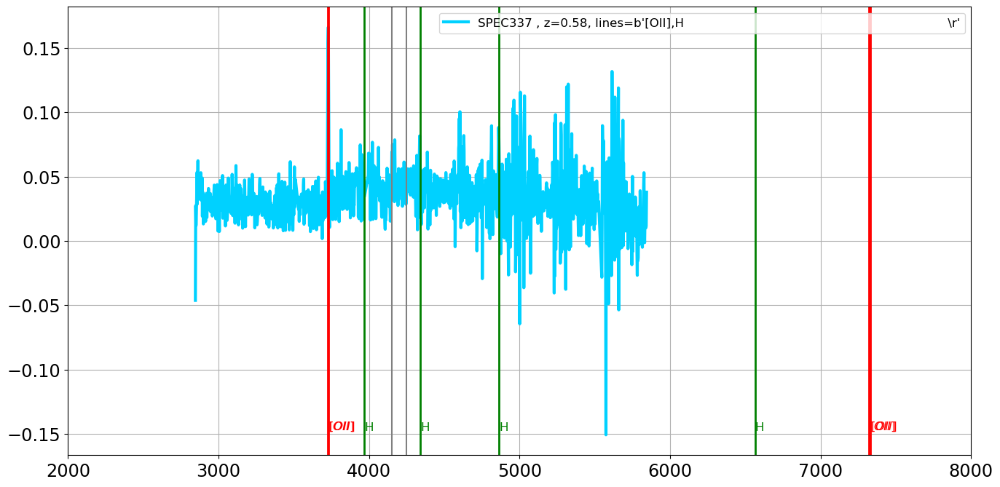

===================== SED 183 : SPEC338 , z=0.58, lines=b'K,H,4000{AA}-break                                                          \r'=======================
the_lines =  b'K,H,4000{AA}-break                                                          \r'
K
H
4000{AA}-break


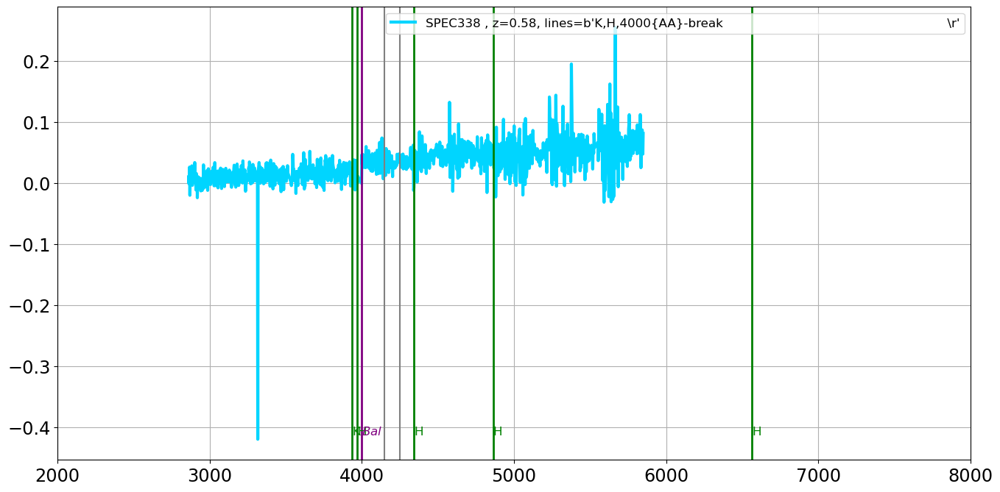

===================== SED 184 : SPEC339 , z=0.58, lines=b'[OII],H{beta}                                                               \r'=======================
the_lines =  b'[OII],H{beta}                                                               \r'
[OII]
H{beta}


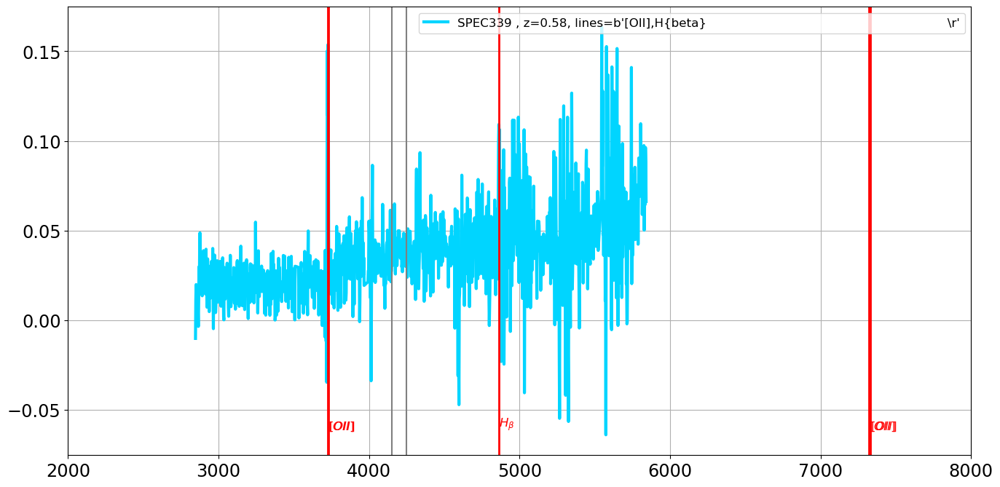

===================== SED 185 : SPEC340 , z=0.36, lines=b'[OII],H                                                                     \r'=======================
the_lines =  b'[OII],H                                                                     \r'
[OII]
H


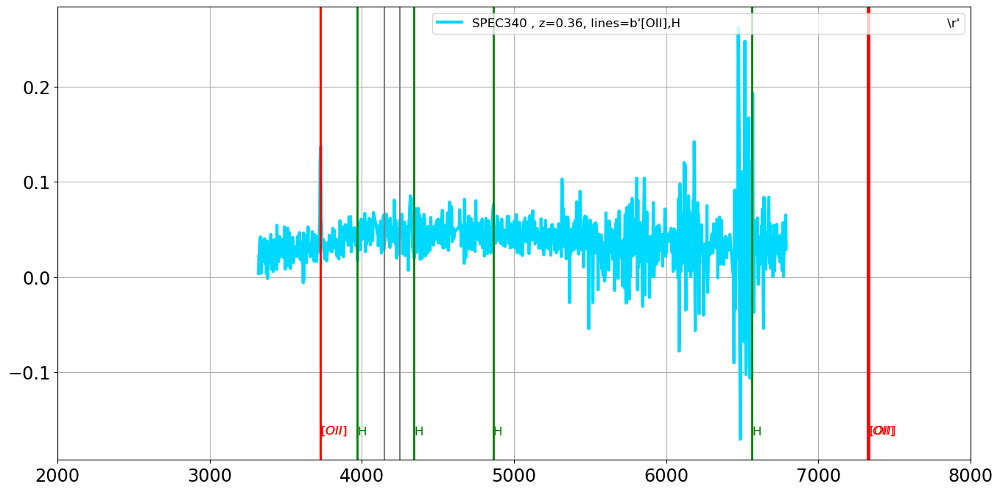

===================== SED 186 : SPEC341 , z=0.59, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


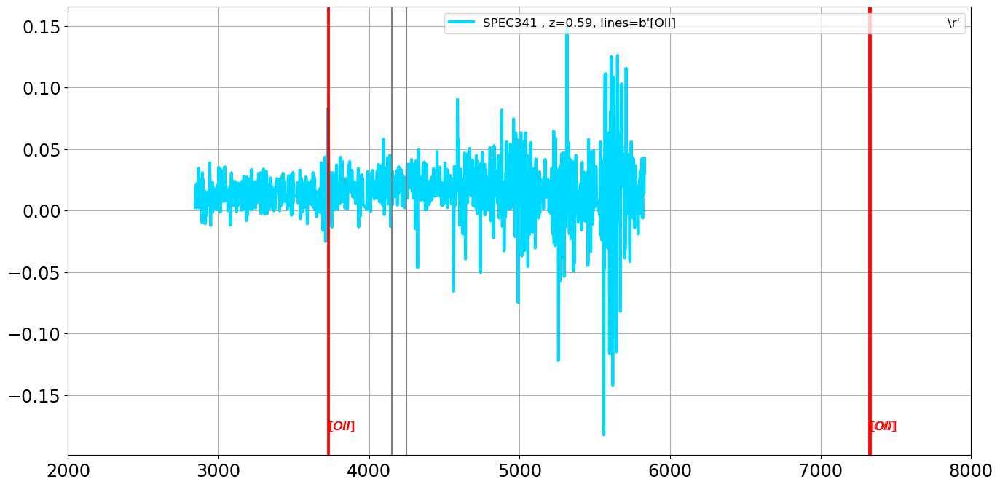

===================== SED 187 : SPEC343 , z=0.59, lines=b'H,4000{AA}-break                                                            \r'=======================
the_lines =  b'H,4000{AA}-break                                                            \r'
H
4000{AA}-break


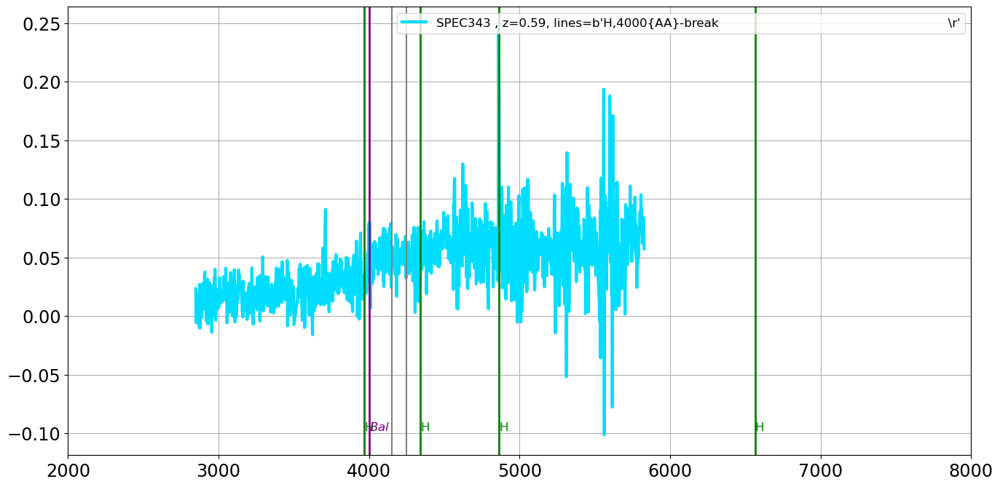

===================== SED 188 : SPEC344 , z=0.52, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


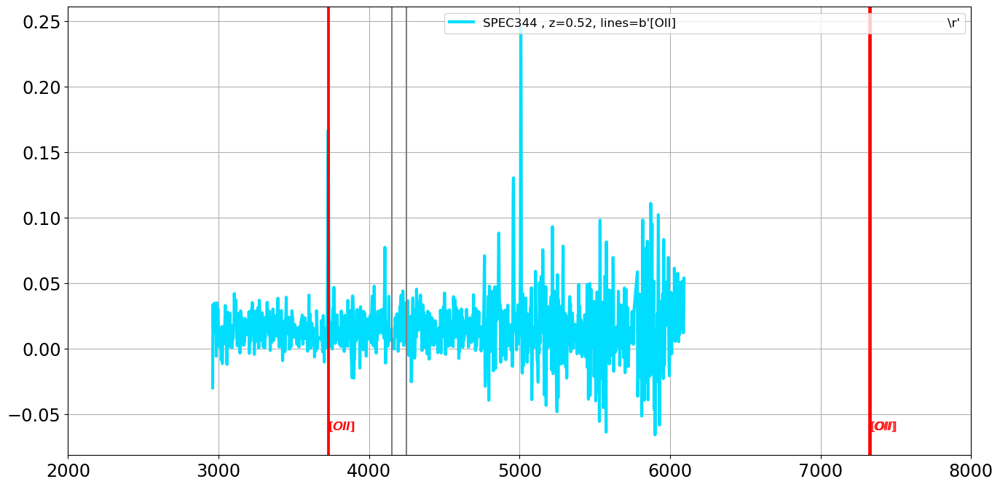

===================== SED 189 : SPEC345 , z=0.56, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


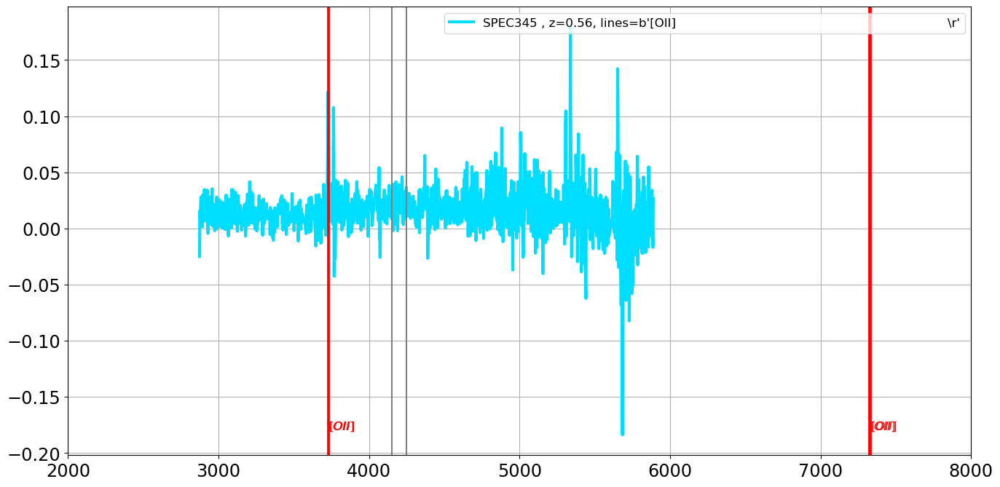

===================== SED 190 : SPEC346 , z=3.87, lines=b'Ly{beta},Ly{alpha},CIV,(QSO)                                                \r'=======================
the_lines =  b'Ly{beta},Ly{alpha},CIV,(QSO)                                                \r'
Ly{beta}
Ly{alpha}
CIV
(QSO)


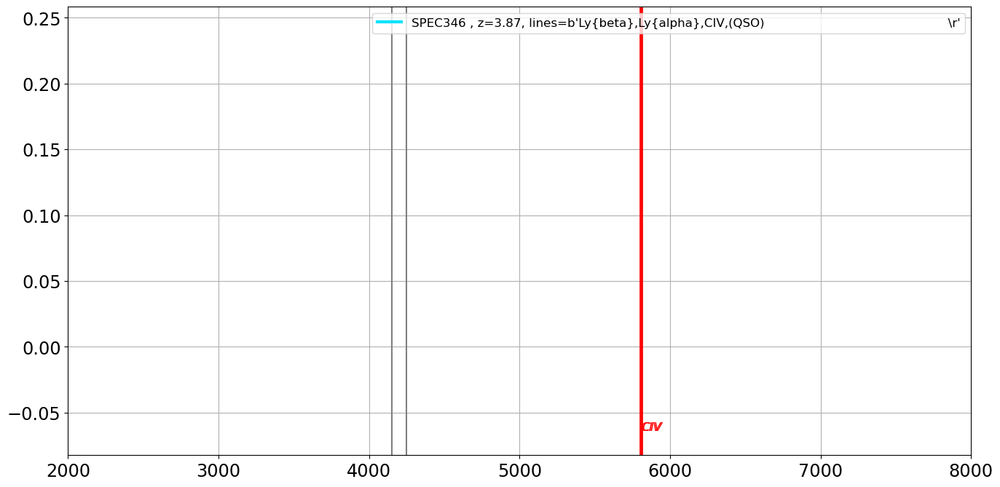

===================== SED 191 : SPEC348 , z=0.79, lines=b'[OII],?                                                                     \r'=======================
the_lines =  b'[OII],?                                                                     \r'
[OII]
?


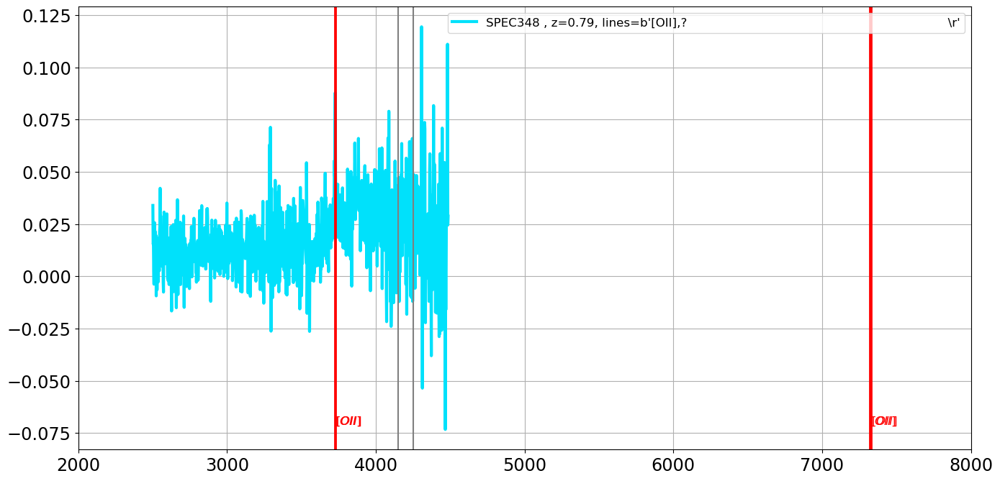

===================== SED 192 : SPEC349 , z=0.48, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


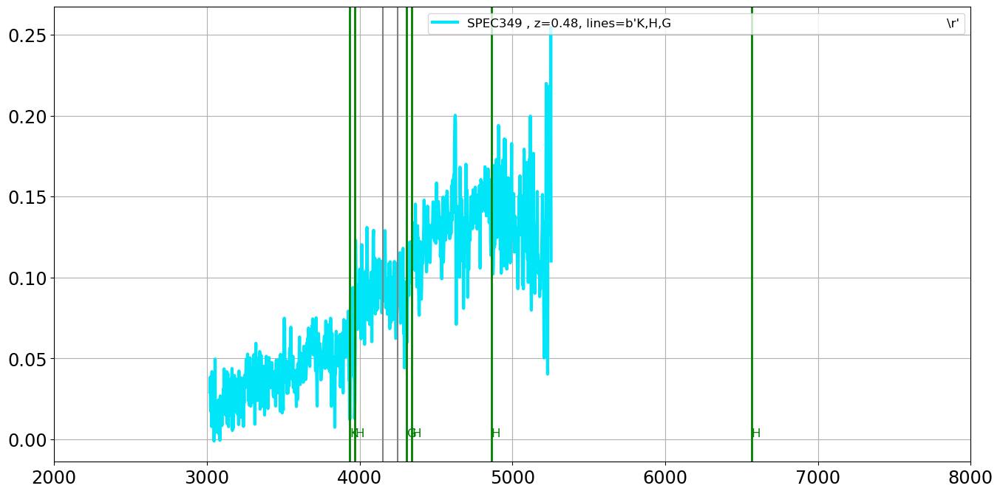

===================== SED 193 : SPEC350 , z=0.42, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


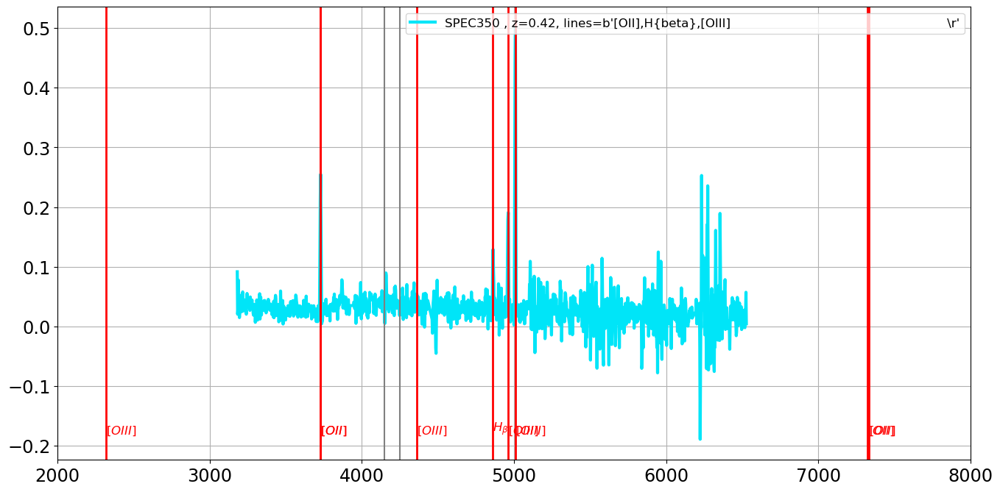

===================== SED 194 : SPEC351 , z=0.58, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


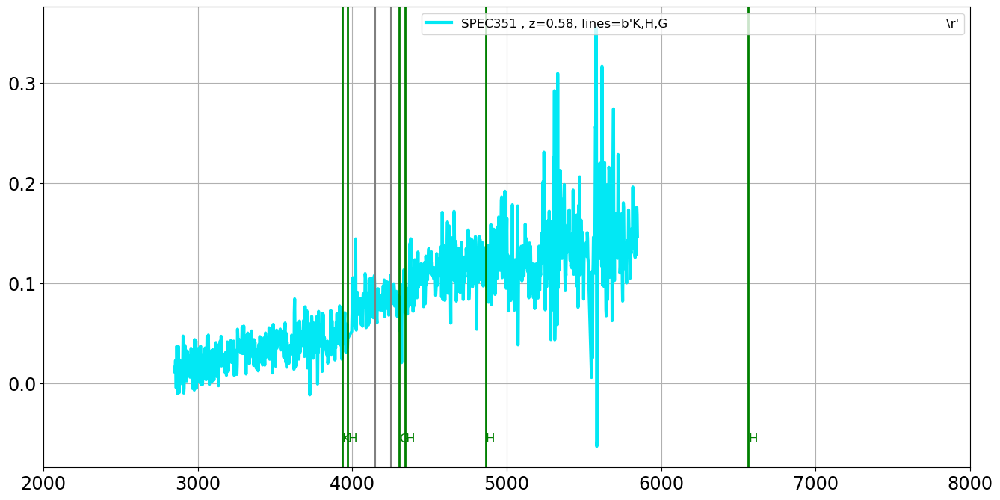

===================== SED 195 : SPEC352 , z=0.81, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


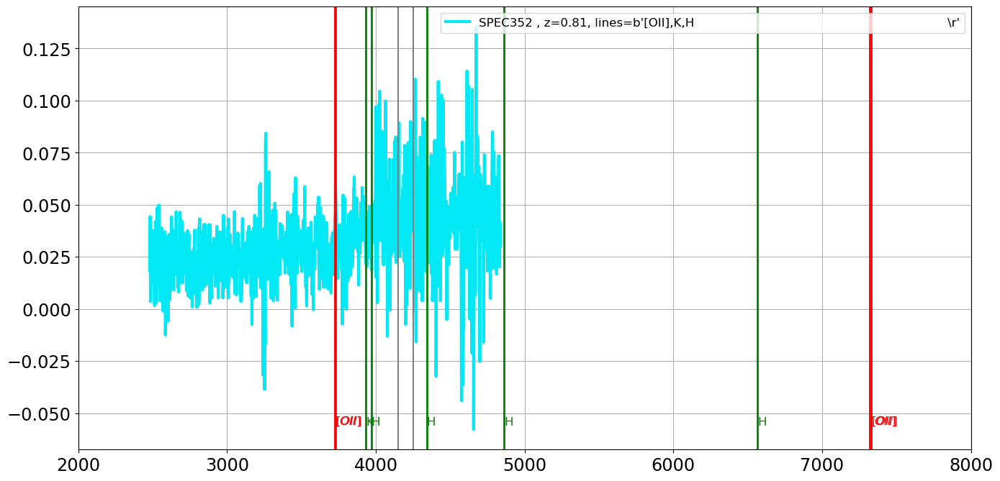

===================== SED 196 : SPEC353 , z=0.79, lines=b'[OII],?                                                                     \r'=======================
the_lines =  b'[OII],?                                                                     \r'
[OII]
?


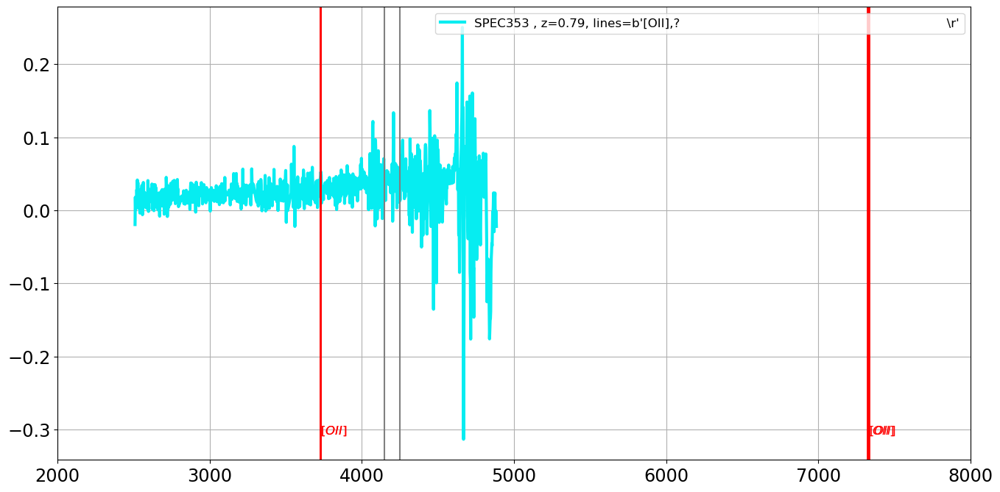

===================== SED 197 : SPEC354 , z=1.10, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


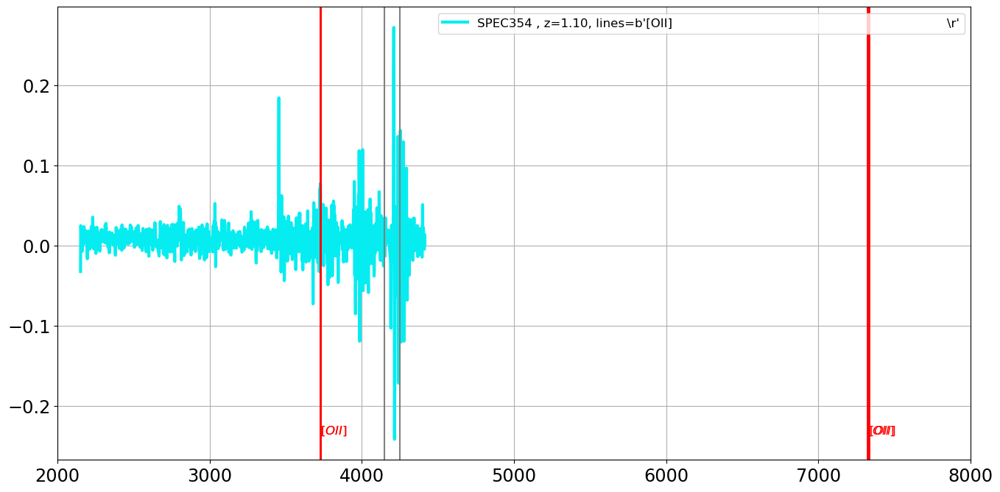

===================== SED 198 : SPEC355 , z=0.69, lines=b'K,H,4000{AA}-break                                                          \r'=======================
the_lines =  b'K,H,4000{AA}-break                                                          \r'
K
H
4000{AA}-break


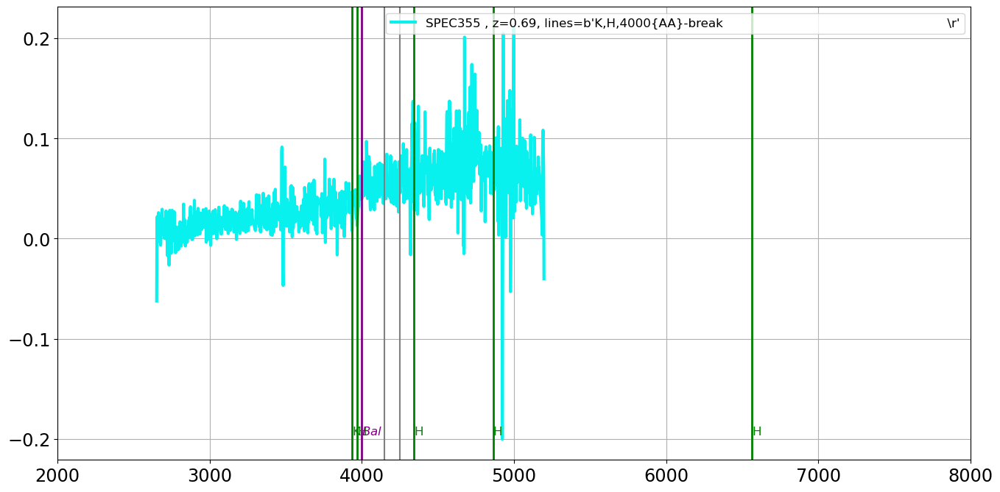

===================== SED 199 : SPEC357 , z=0.74, lines=b'[OII],H9,H8,K,H                                                             \r'=======================
the_lines =  b'[OII],H9,H8,K,H                                                             \r'
[OII]
H9
H8
K
H


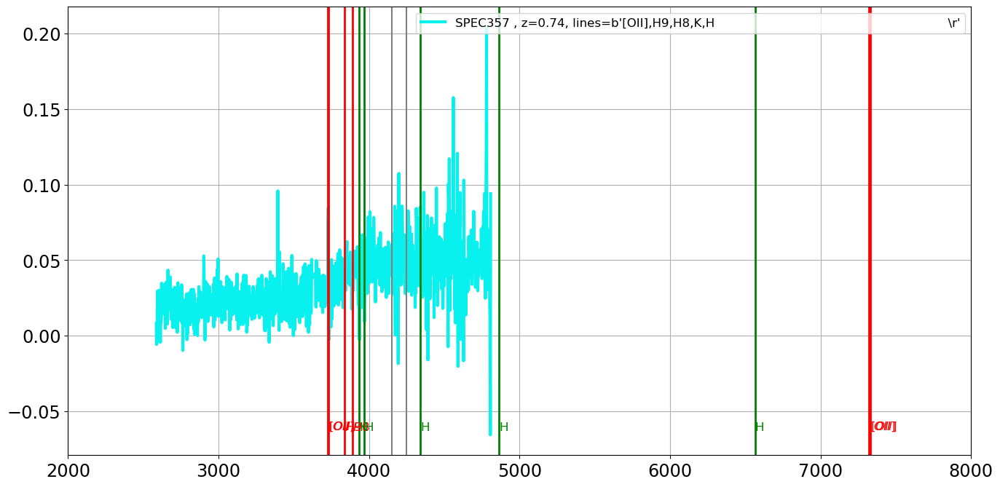

===================== SED 200 : SPEC358 , z=0.58, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


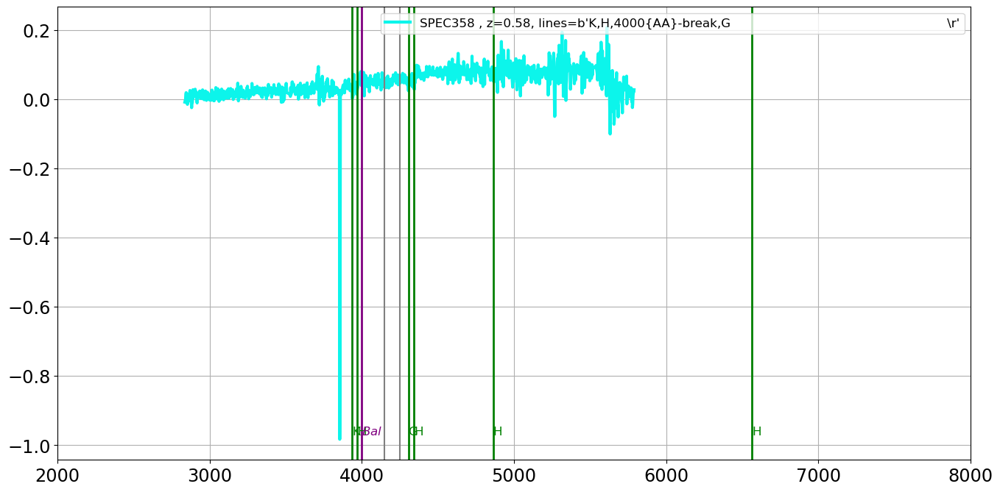

===================== SED 201 : SPEC359 , z=0.44, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


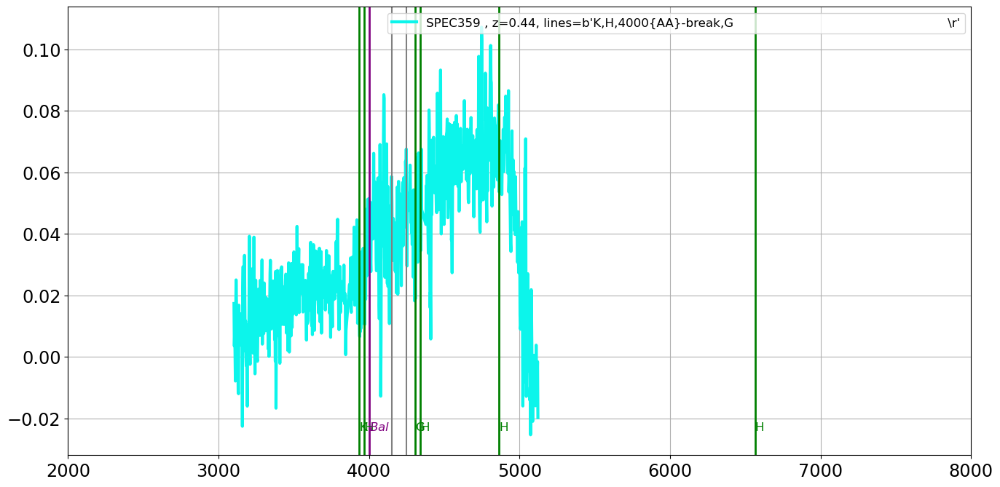

===================== SED 202 : SPEC360 , z=0.48, lines=b'[OII],H9,H{delta}                                                           \r'=======================
the_lines =  b'[OII],H9,H{delta}                                                           \r'
[OII]
H9
H{delta}


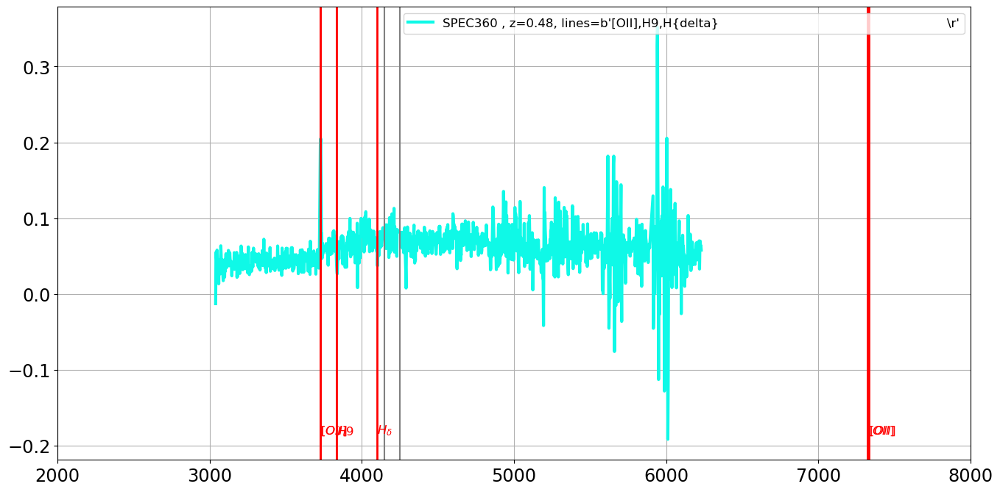

===================== SED 203 : SPEC361 , z=0.63, lines=b'K,H,H{delta}                                                                \r'=======================
the_lines =  b'K,H,H{delta}                                                                \r'
K
H
H{delta}


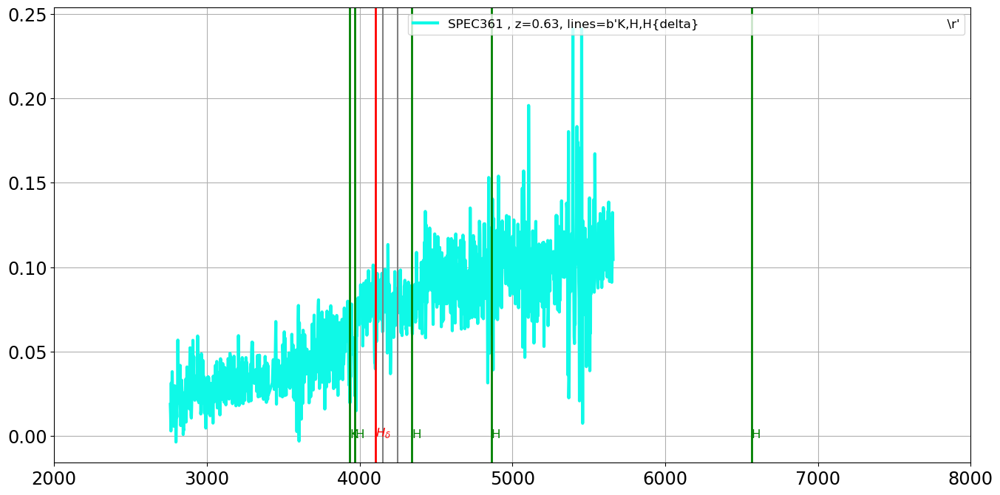

===================== SED 204 : SPEC362 , z=0.63, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


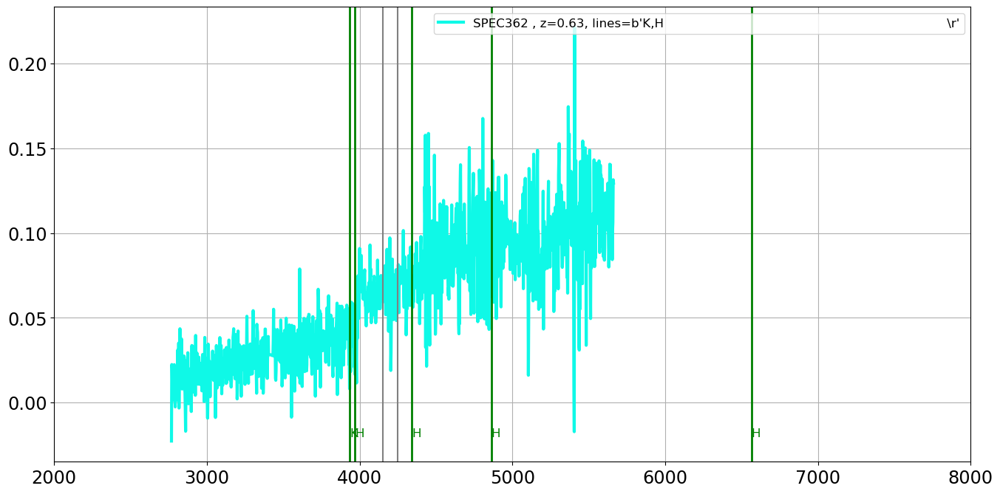

===================== SED 205 : SPEC363 , z=0.20, lines=b'H9,H8,H,H{delta},[OIII],H{alpha}                                            \r'=======================
the_lines =  b'H9,H8,H,H{delta},[OIII],H{alpha}                                            \r'
H9
H8
H
H{delta}
[OIII]
H{alpha}


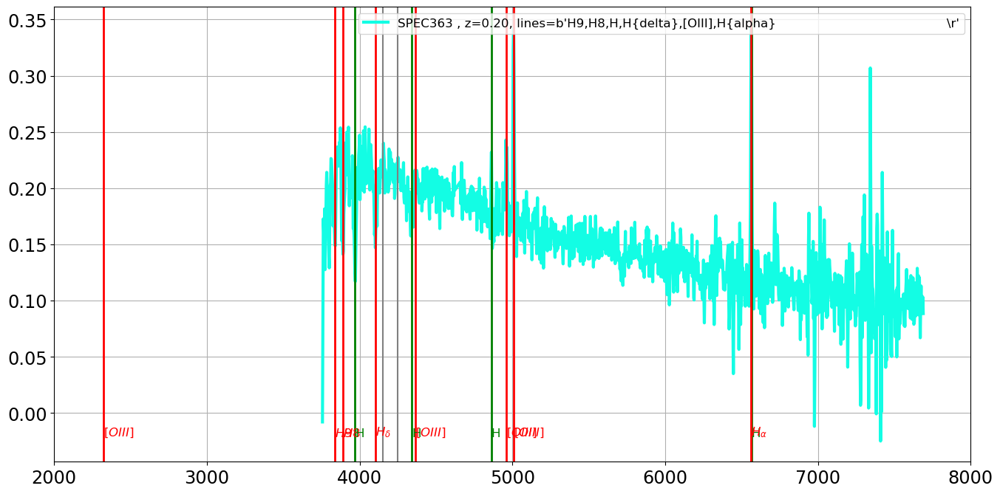

===================== SED 206 : SPEC364 , z=0.64, lines=b'[OII],H8,K,H,H{delta},H{beta}                                               \r'=======================
the_lines =  b'[OII],H8,K,H,H{delta},H{beta}                                               \r'
[OII]
H8
K
H
H{delta}
H{beta}


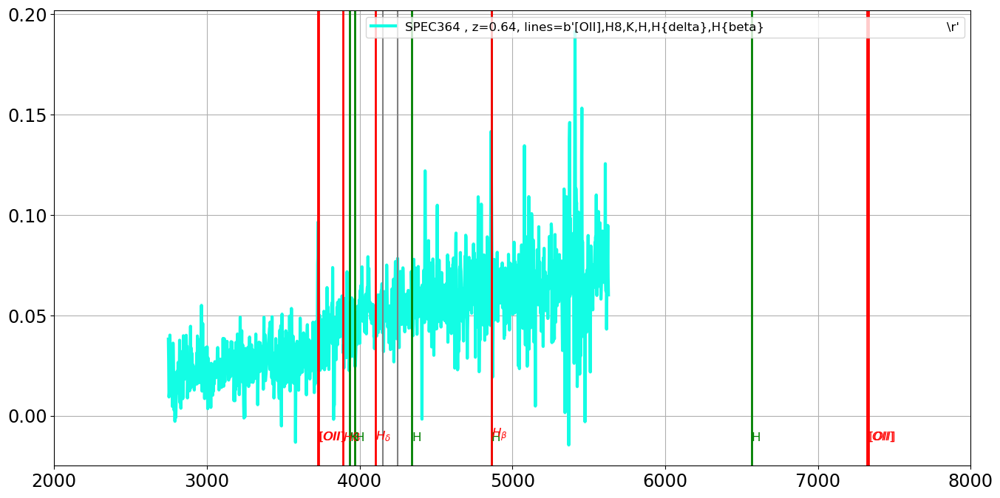

===================== SED 207 : SPEC365 , z=0.29, lines=b'[OII],[OIII],H{alpha}                                                       \r'=======================
the_lines =  b'[OII],[OIII],H{alpha}                                                       \r'
[OII]
[OIII]
H{alpha}


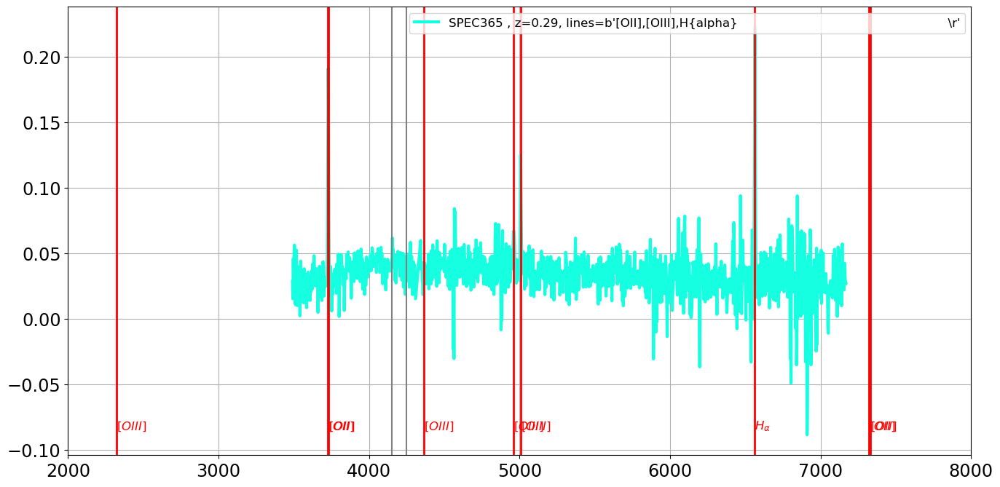

===================== SED 208 : SPEC366 , z=0.27, lines=b'[OII],H,H{delta},[OIII],H{alpha}                                            \r'=======================
the_lines =  b'[OII],H,H{delta},[OIII],H{alpha}                                            \r'
[OII]
H
H{delta}
[OIII]
H{alpha}


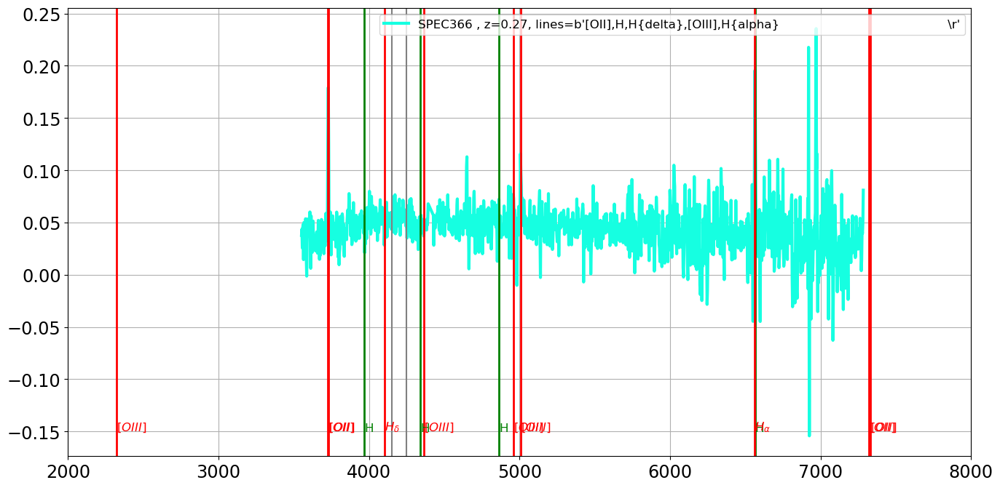

===================== SED 209 : SPEC367 , z=0.47, lines=b'[OII],4000{AA}-break                                                        \r'=======================
the_lines =  b'[OII],4000{AA}-break                                                        \r'
[OII]
4000{AA}-break


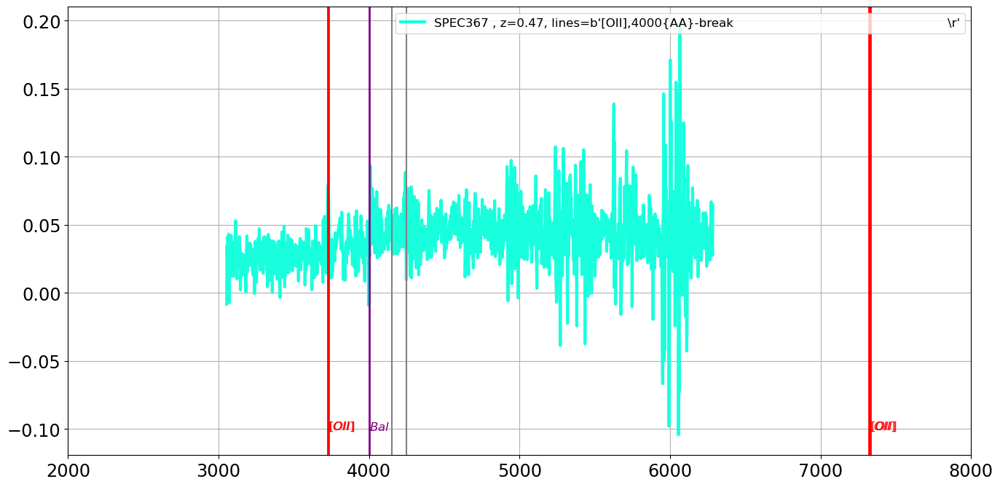

===================== SED 210 : SPEC368 , z=0.42, lines=b'[OII],H{delta},H{beta},[OIII]                                               \r'=======================
the_lines =  b'[OII],H{delta},H{beta},[OIII]                                               \r'
[OII]
H{delta}
H{beta}
[OIII]


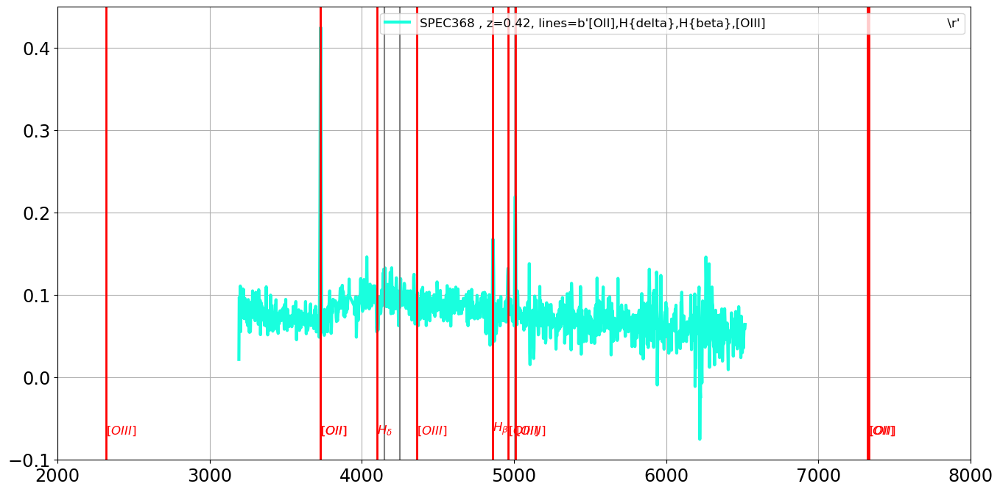

===================== SED 211 : SPEC369 , z=0.66, lines=b'[OII],H9,H8,K,H                                                             \r'=======================
the_lines =  b'[OII],H9,H8,K,H                                                             \r'
[OII]
H9
H8
K
H


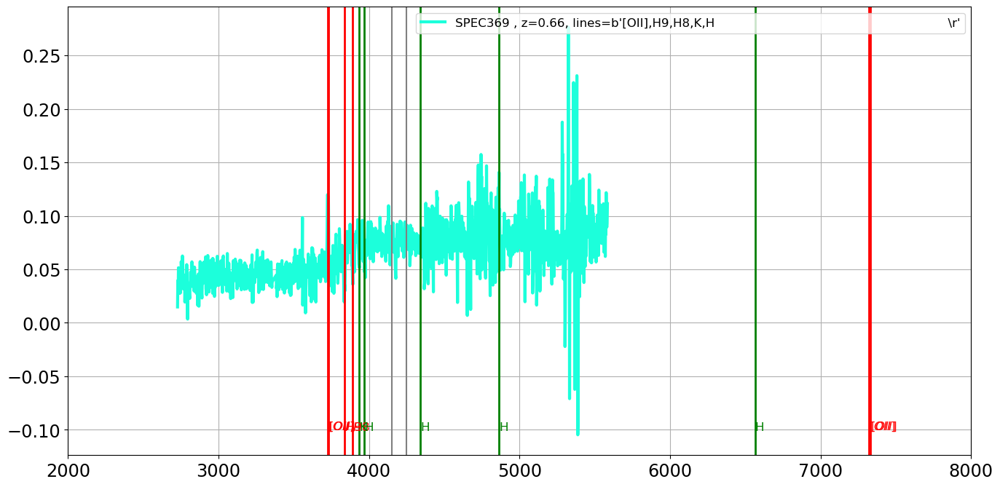

===================== SED 212 : SPEC370 , z=0.23, lines=b'[OII],H,[OIII]                                                              \r'=======================
the_lines =  b'[OII],H,[OIII]                                                              \r'
[OII]
H
[OIII]


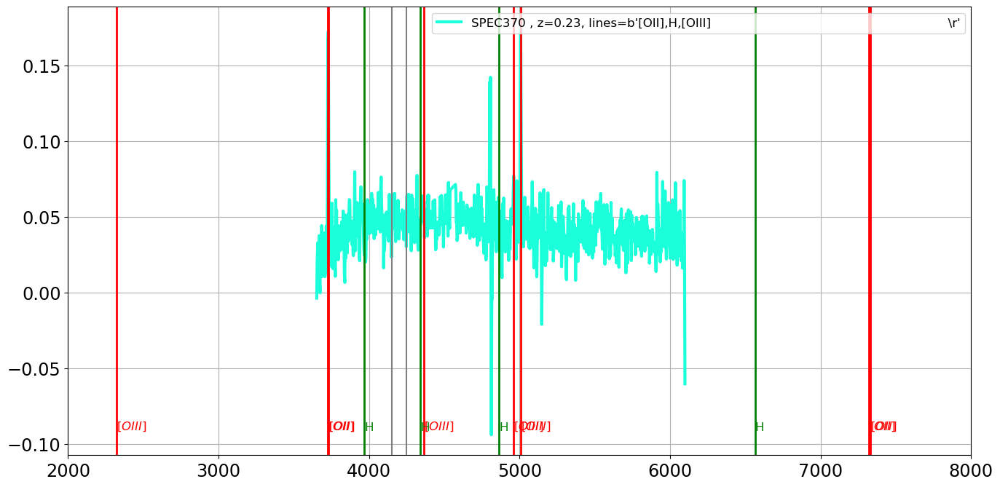

===================== SED 213 : SPEC371 , z=0.76, lines=b'[OII],H9,H8,K,H                                                             \r'=======================
the_lines =  b'[OII],H9,H8,K,H                                                             \r'
[OII]
H9
H8
K
H


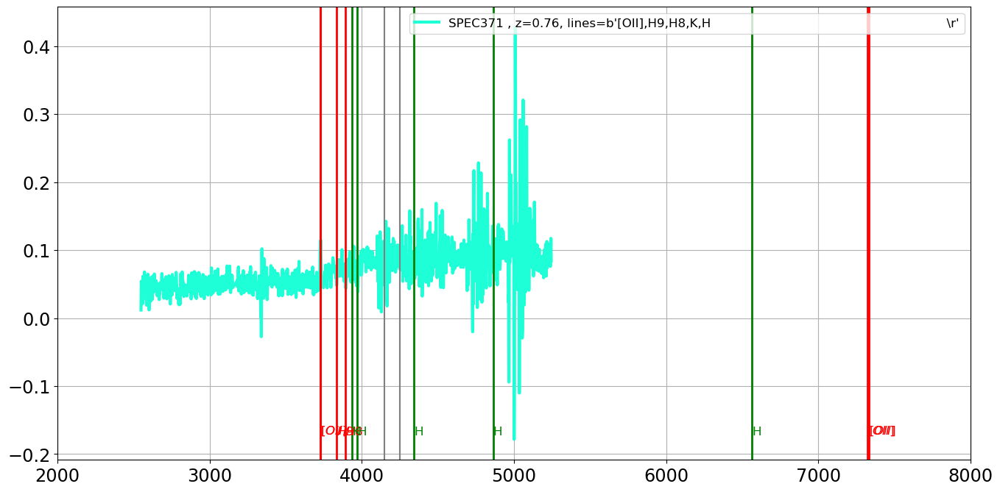

===================== SED 214 : SPEC372 , z=0.52, lines=b'[OII],H8,K,H                                                                \r'=======================
the_lines =  b'[OII],H8,K,H                                                                \r'
[OII]
H8
K
H


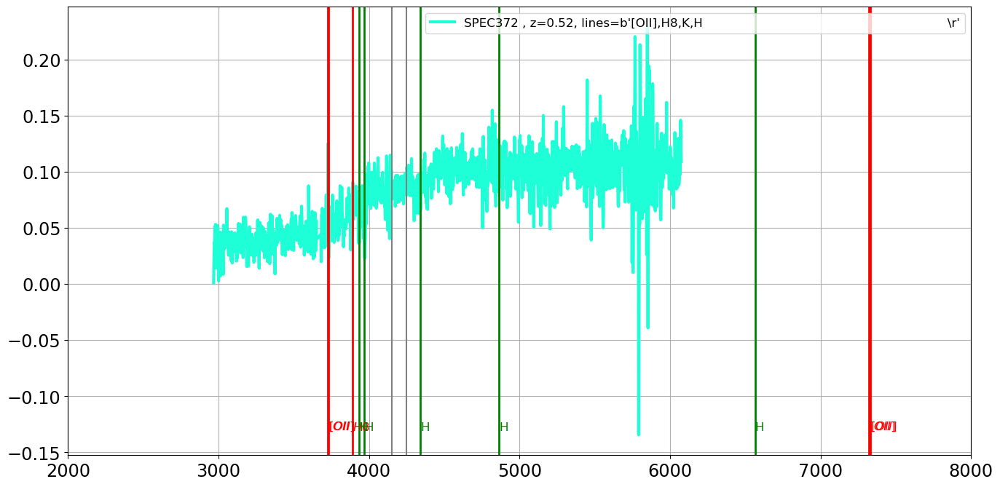

===================== SED 215 : SPEC373 , z=0.29, lines=b'[OII],H9,K,H,H{beta},[OIII],H{alpha}                                        \r'=======================
the_lines =  b'[OII],H9,K,H,H{beta},[OIII],H{alpha}                                        \r'
[OII]
H9
K
H
H{beta}
[OIII]
H{alpha}


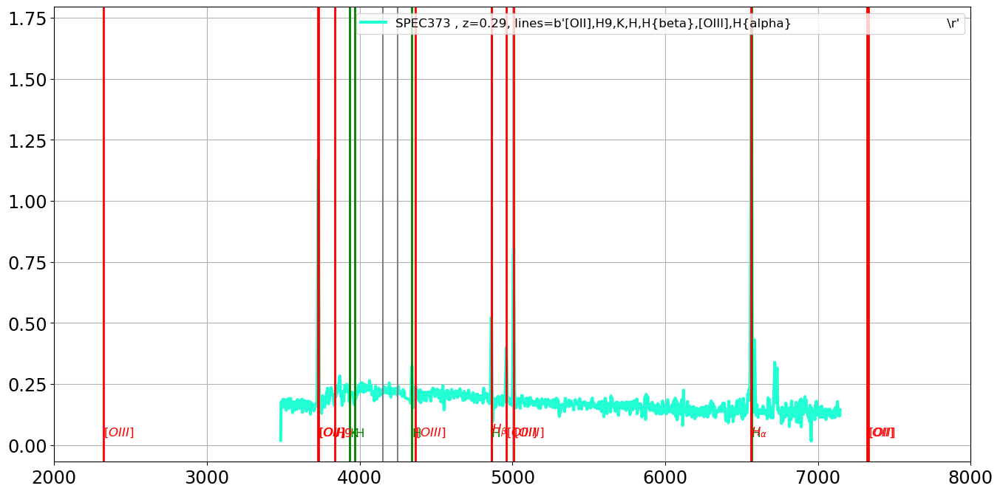

===================== SED 216 : SPEC374 , z=0.36, lines=b'[OII],K,H,H{beta},[OIII],H{alpha}                                           \r'=======================
the_lines =  b'[OII],K,H,H{beta},[OIII],H{alpha}                                           \r'
[OII]
K
H
H{beta}
[OIII]
H{alpha}


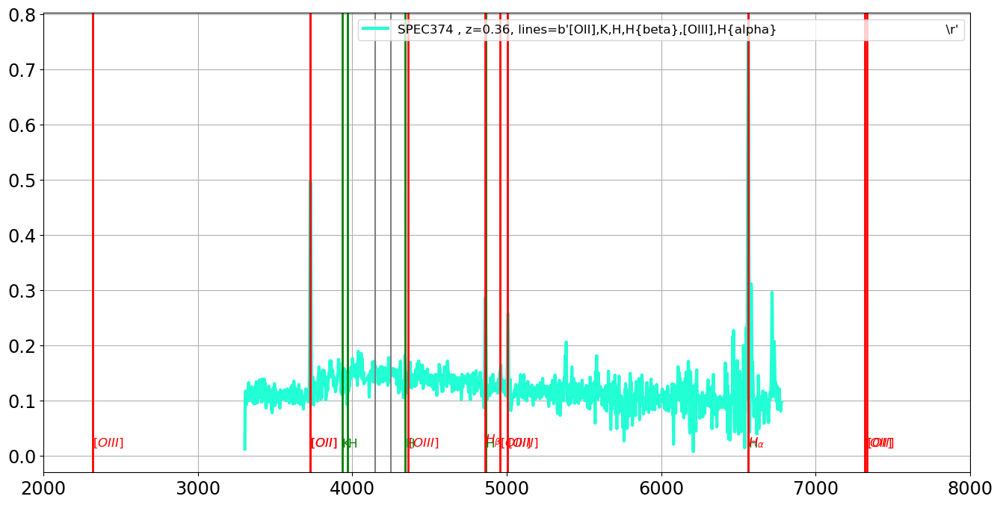

===================== SED 217 : SPEC375 , z=0.32, lines=b'[OII],H9,H8,K,H,H{alpha}                                                    \r'=======================
the_lines =  b'[OII],H9,H8,K,H,H{alpha}                                                    \r'
[OII]
H9
H8
K
H
H{alpha}


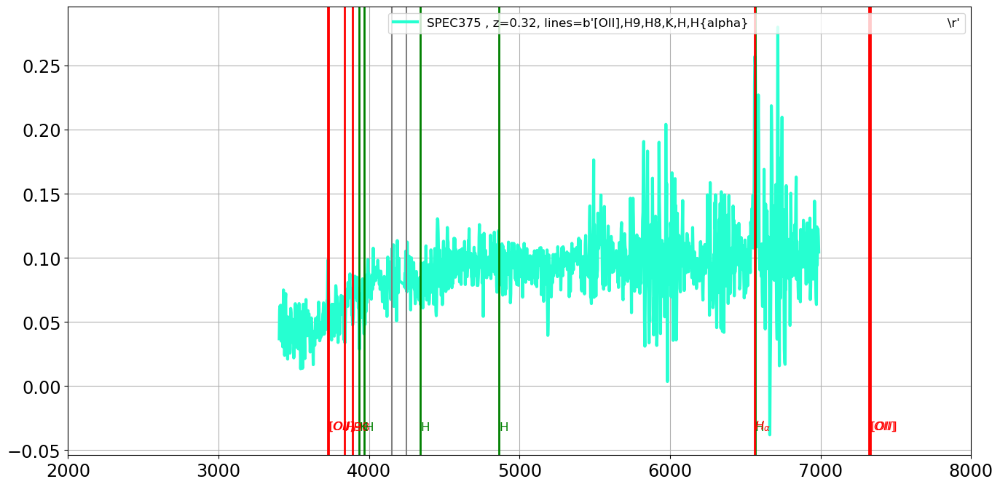

===================== SED 218 : SPEC376 , z=0.32, lines=b'H10,K,H,G                                                                   \r'=======================
the_lines =  b'H10,K,H,G                                                                   \r'
H10
K
H
G


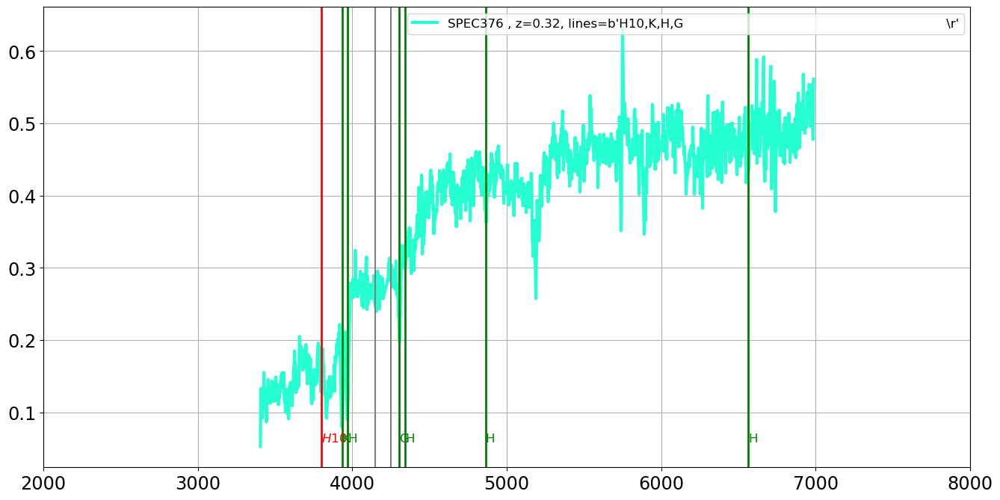

===================== SED 219 : SPEC377 , z=0.25, lines=b'[OII],[OIII],H{alpha}                                                       \r'=======================
the_lines =  b'[OII],[OIII],H{alpha}                                                       \r'
[OII]
[OIII]
H{alpha}


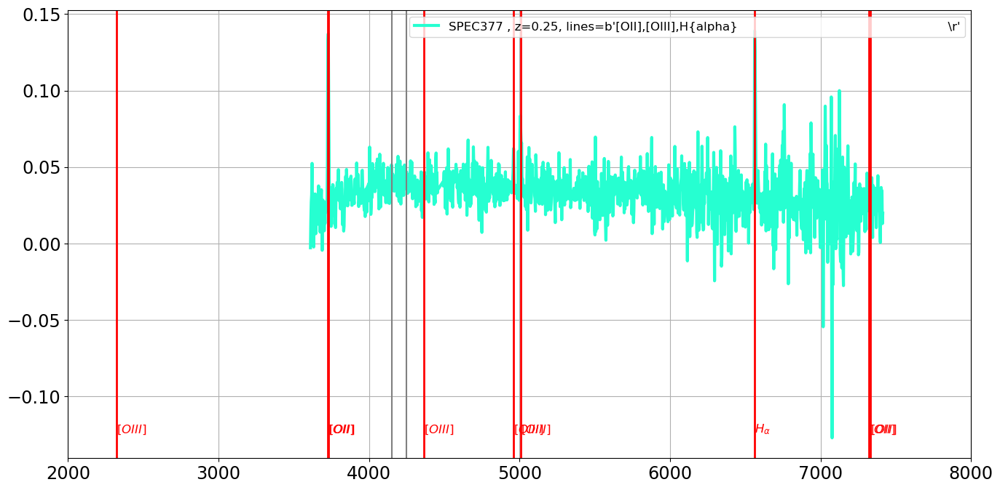

===================== SED 220 : SPEC378 , z=0.32, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


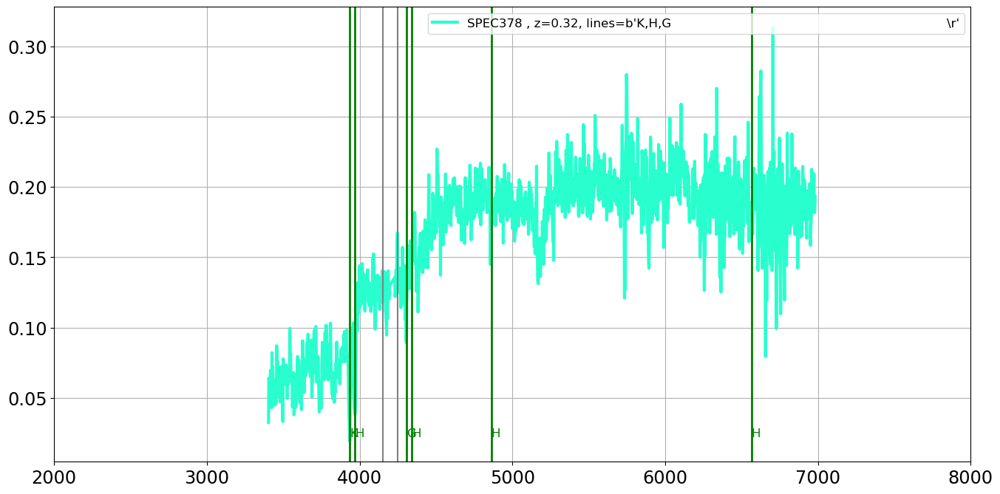

===================== SED 221 : SPEC379 , z=0.32, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


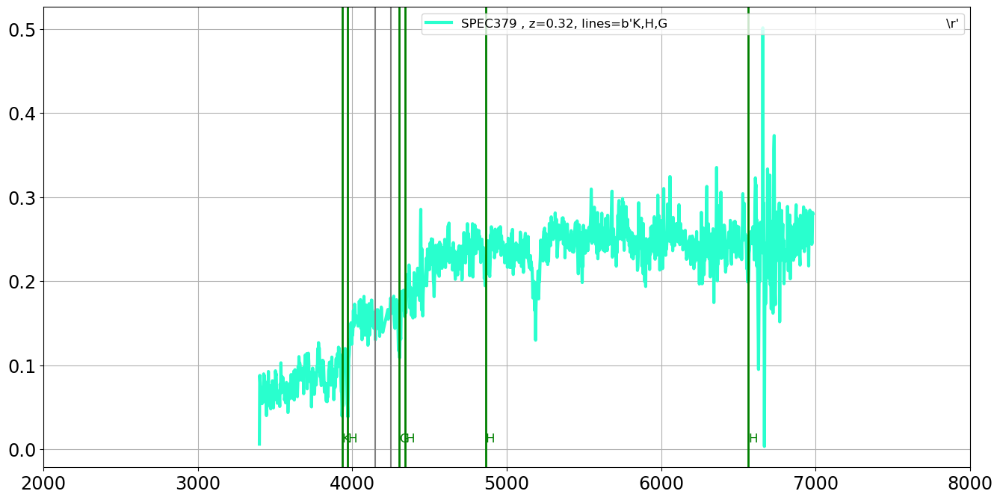

===================== SED 222 : SPEC380 , z=0.32, lines=b'H9,H8,H                                                                     \r'=======================
the_lines =  b'H9,H8,H                                                                     \r'
H9
H8
H


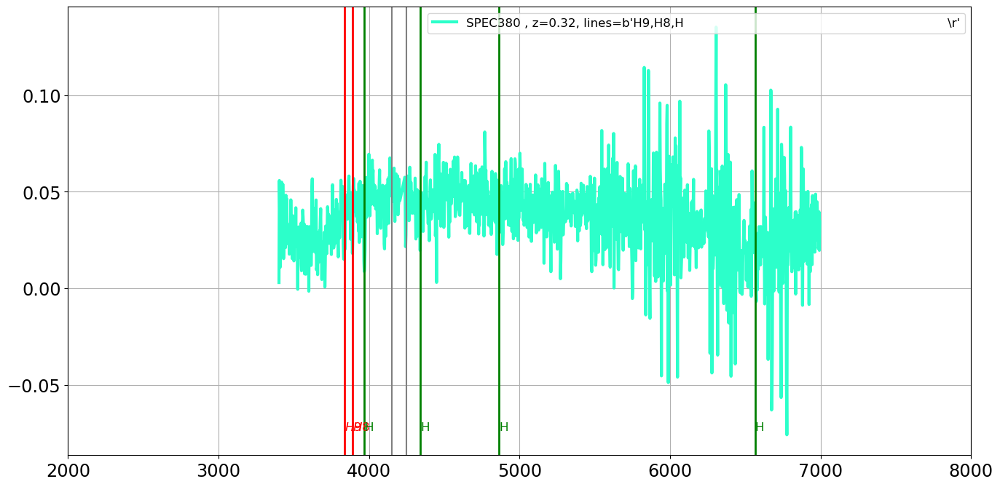

===================== SED 223 : SPEC381 , z=0.29, lines=b'K,H,H{beta},Mgb                                                             \r'=======================
the_lines =  b'K,H,H{beta},Mgb                                                             \r'
K
H
H{beta}
Mgb


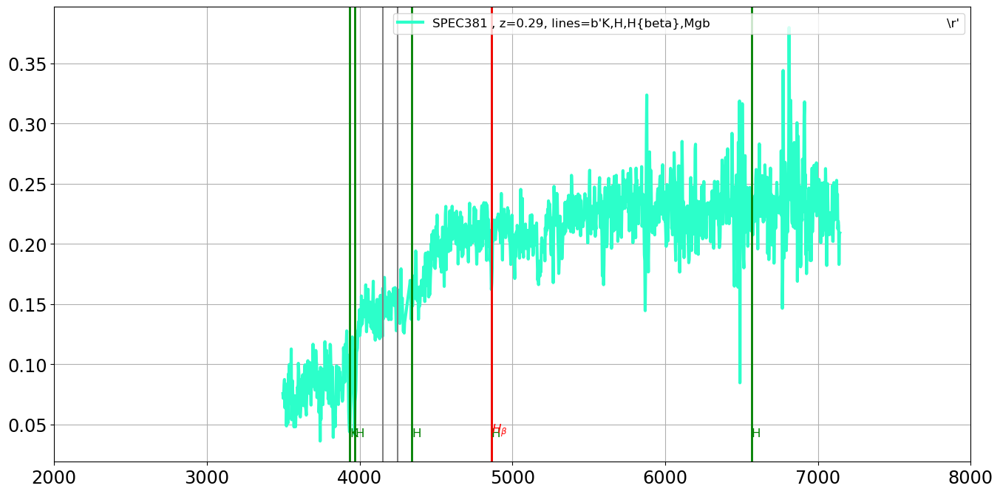

===================== SED 224 : SPEC382 , z=0.35, lines=b'K,H,G,H{beta}                                                               \r'=======================
the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


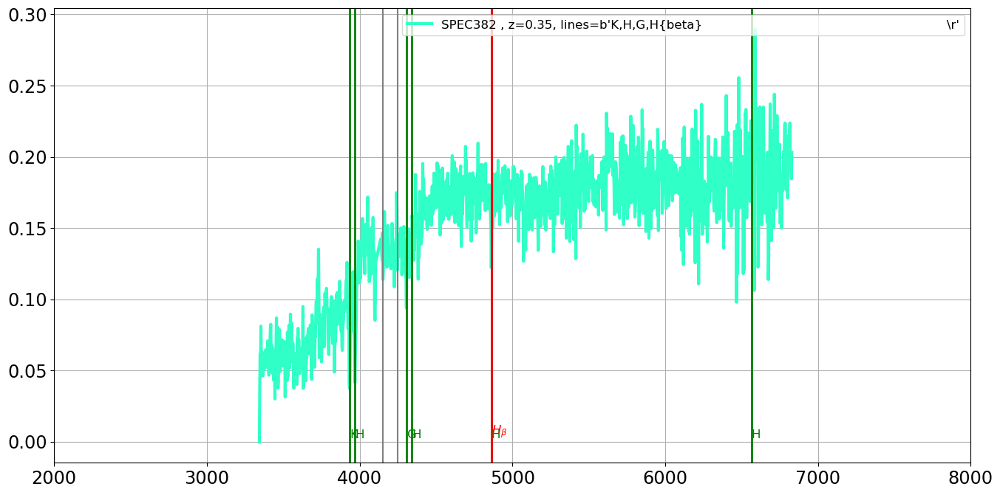

===================== SED 225 : SPEC383 , z=0.48, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


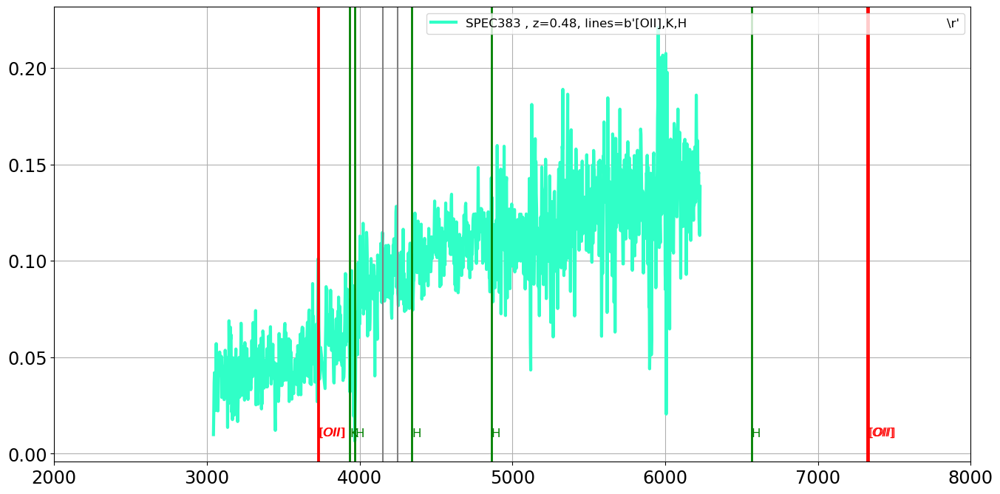

===================== SED 226 : SPEC384 , z=0.16, lines=b'H,H{beta},[OIII],H{alpha}                                                   \r'=======================
the_lines =  b'H,H{beta},[OIII],H{alpha}                                                   \r'
H
H{beta}
[OIII]
H{alpha}


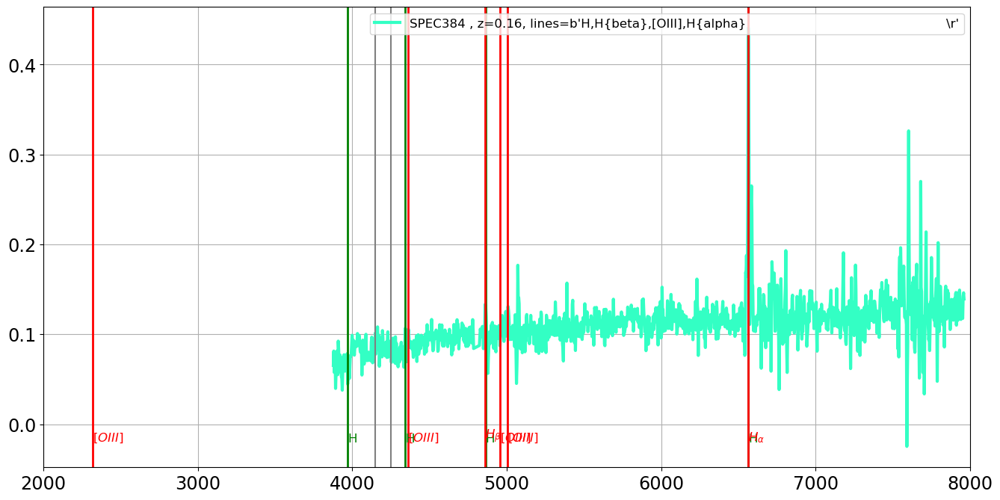

===================== SED 227 : SPEC385 , z=0.22, lines=b'[OII],[OIII]                                                                \r'=======================
the_lines =  b'[OII],[OIII]                                                                \r'
[OII]
[OIII]


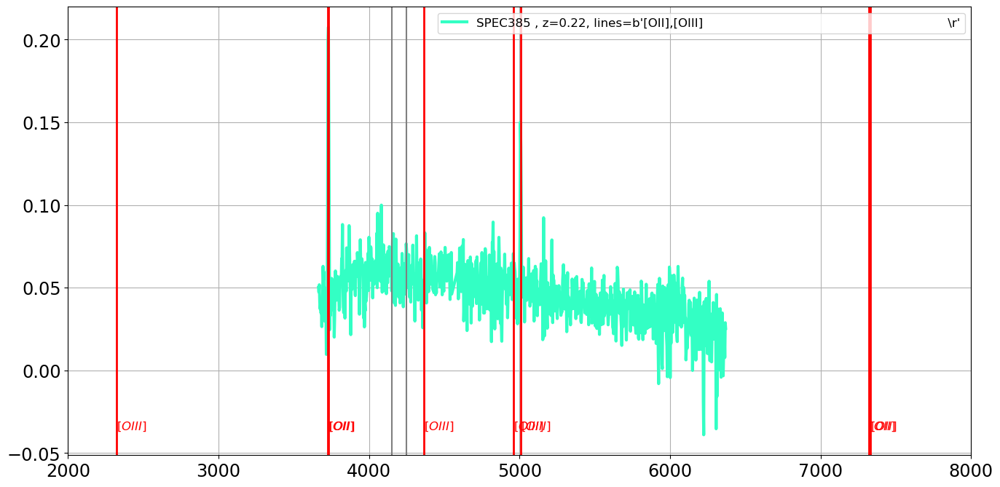

===================== SED 228 : SPEC386 , z=0.63, lines=b'[OII],H,H{delta}                                                            \r'=======================
the_lines =  b'[OII],H,H{delta}                                                            \r'
[OII]
H
H{delta}


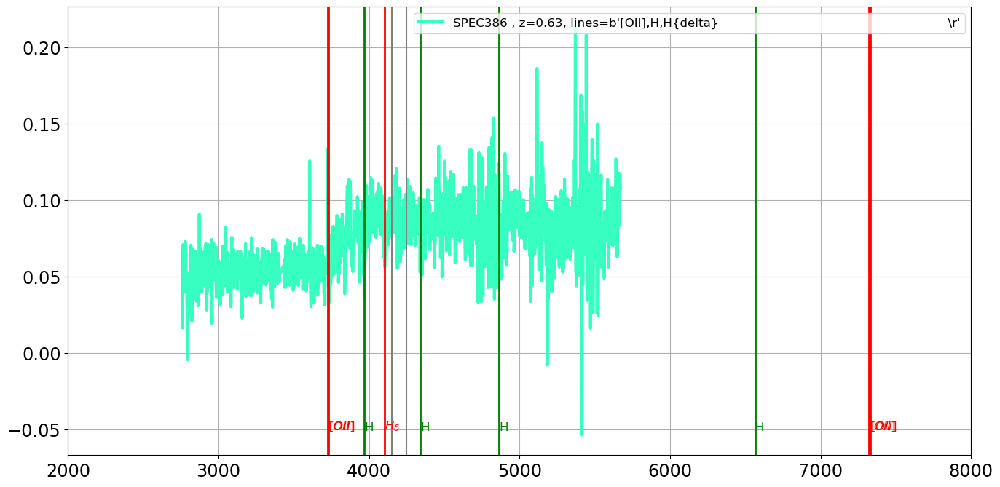

===================== SED 229 : SPEC387 , z=0.58, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


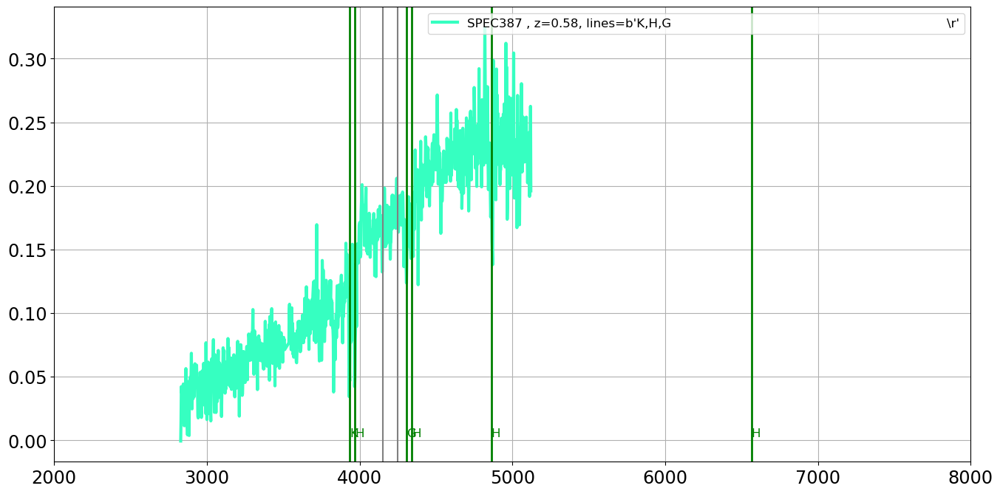

===================== SED 230 : SPEC388 , z=0.41, lines=b'[OII],H9,K,H                                                                \r'=======================
the_lines =  b'[OII],H9,K,H                                                                \r'
[OII]
H9
K
H


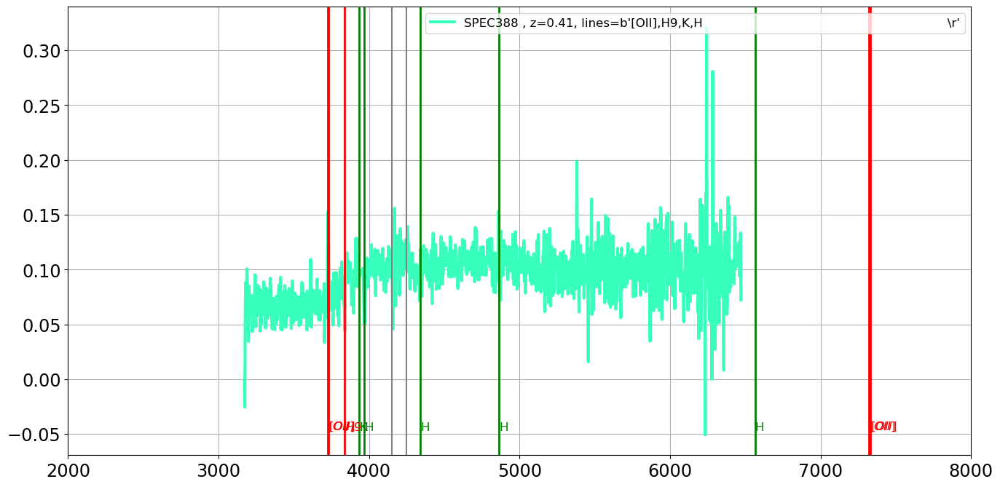

===================== SED 231 : SPEC389 , z=0.49, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


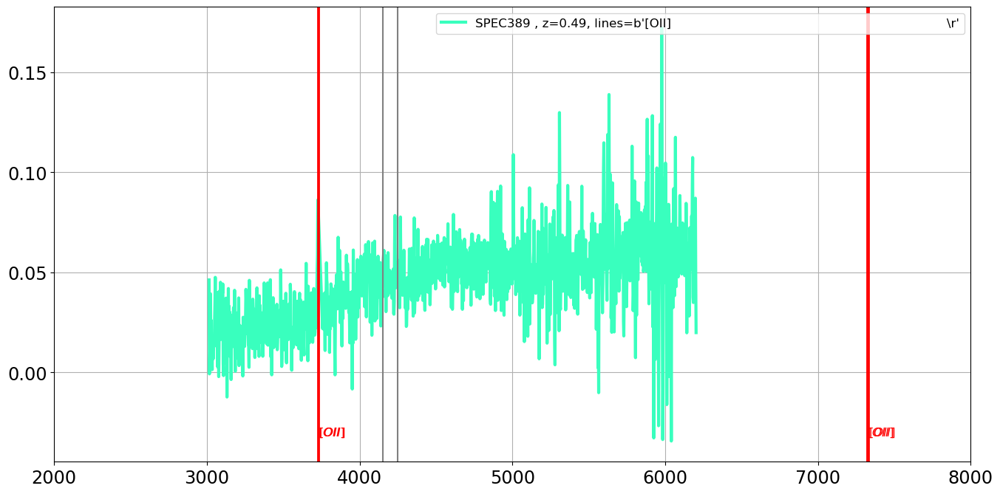

===================== SED 232 : SPEC390 , z=0.58, lines=b'[OII],H,H{beta},[OIII]                                                      \r'=======================
the_lines =  b'[OII],H,H{beta},[OIII]                                                      \r'
[OII]
H
H{beta}
[OIII]


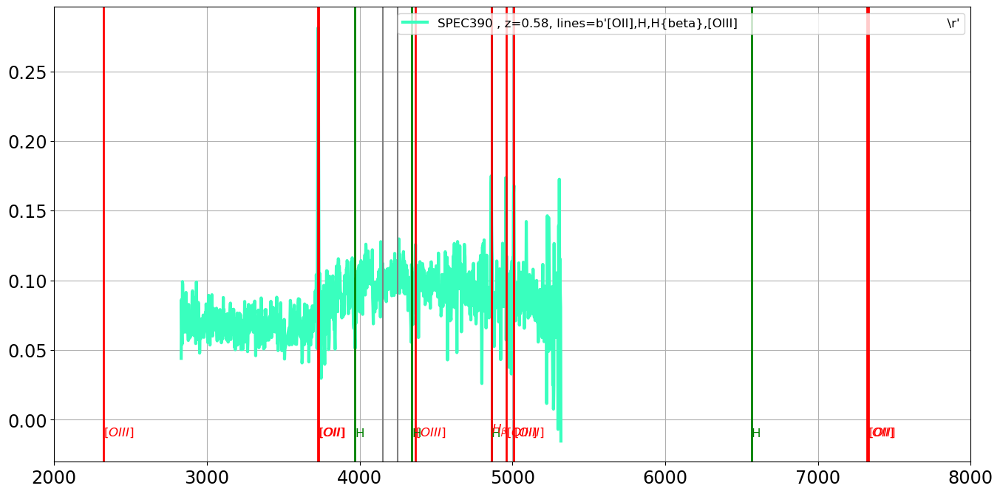

===================== SED 233 : SPEC391 , z=0.45, lines=b'K,H,G,H{beta}                                                               \r'=======================
the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


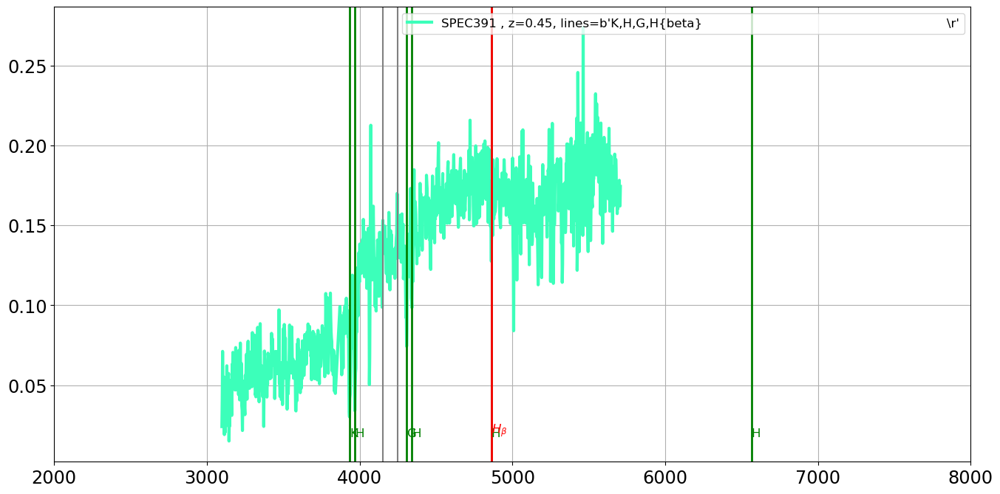

===================== SED 234 : SPEC392 , z=0.29, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


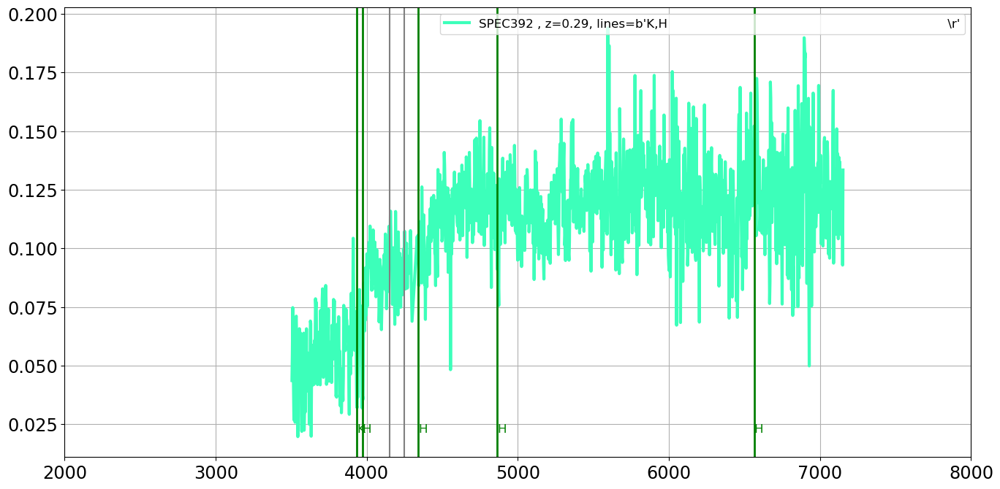

===================== SED 235 : SPEC393 , z=0.74, lines=b'[OII],H9,H8,K,H                                                             \r'=======================
the_lines =  b'[OII],H9,H8,K,H                                                             \r'
[OII]
H9
H8
K
H


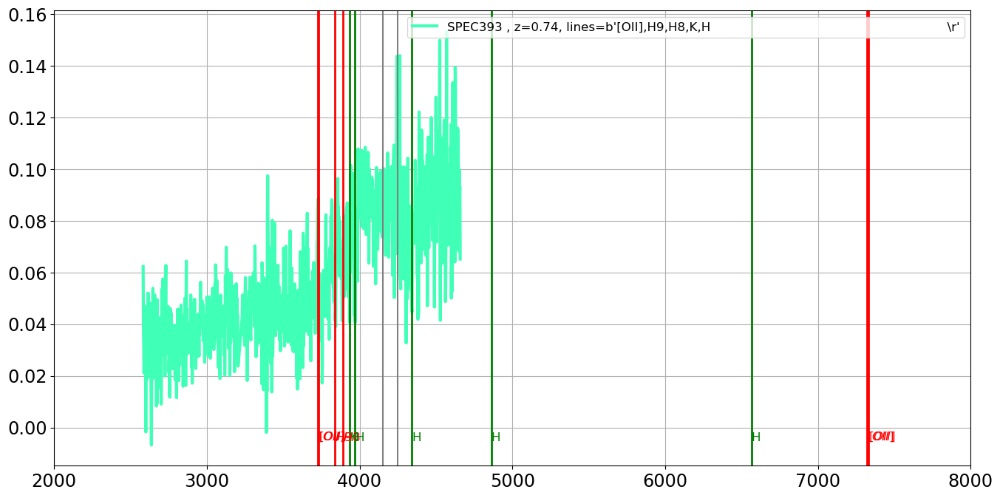

===================== SED 236 : SPEC394 , z=0.81, lines=b'MgII,[OII],H8,K,H                                                           \r'=======================
the_lines =  b'MgII,[OII],H8,K,H                                                           \r'
MgII
[OII]
H8
K
H


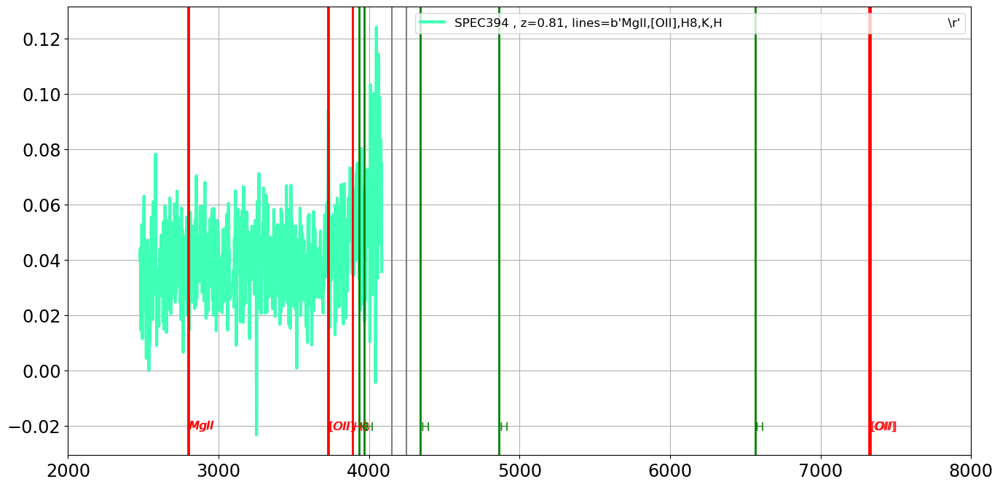

===================== SED 237 : SPEC395 , z=0.80, lines=b'MgII,[OII],H{beta},[OIII]                                                   \r'=======================
the_lines =  b'MgII,[OII],H{beta},[OIII]                                                   \r'
MgII
[OII]
H{beta}
[OIII]


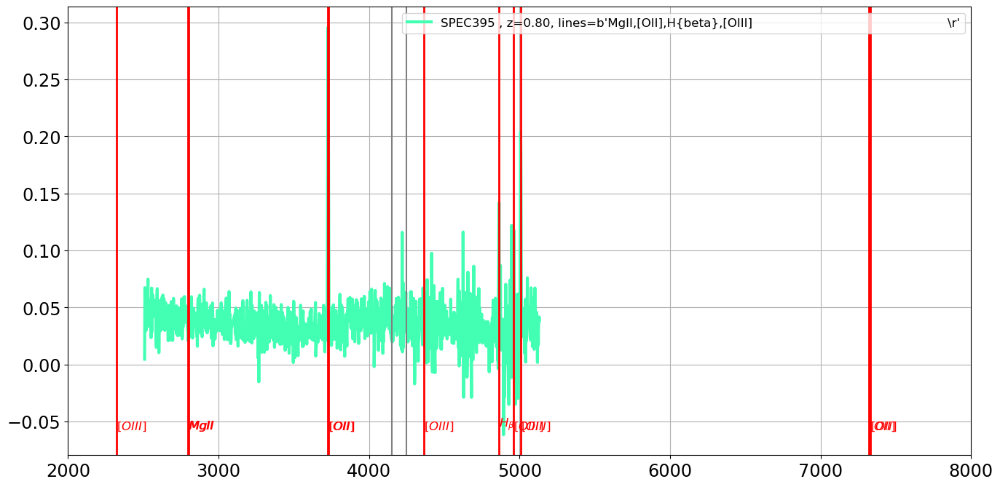

===================== SED 238 : SPEC396 , z=0.80, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


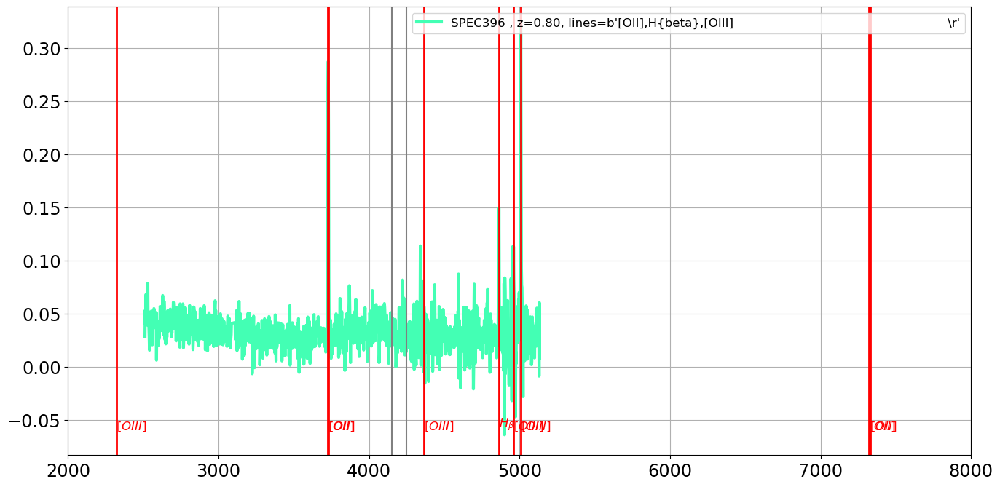

===================== SED 239 : SPEC397 , z=0.48, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


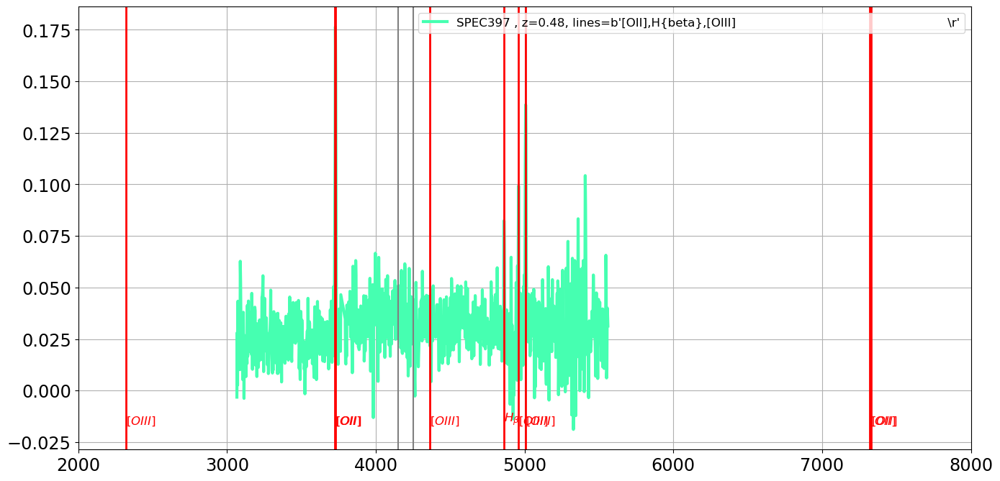

===================== SED 240 : SPEC398 , z=0.29, lines=b'K,H,H{beta}                                                                 \r'=======================
the_lines =  b'K,H,H{beta}                                                                 \r'
K
H
H{beta}


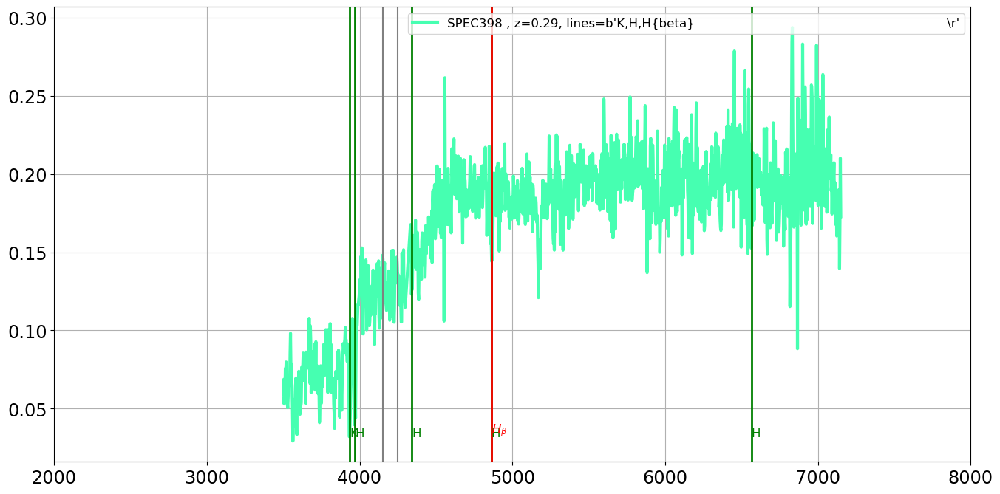

===================== SED 241 : SPEC399 , z=0.34, lines=b'[OII],H{gamma},H{beta},[OIII],H{alpha}                                      \r'=======================
the_lines =  b'[OII],H{gamma},H{beta},[OIII],H{alpha}                                      \r'
[OII]
H{gamma}
H{beta}
[OIII]
H{alpha}


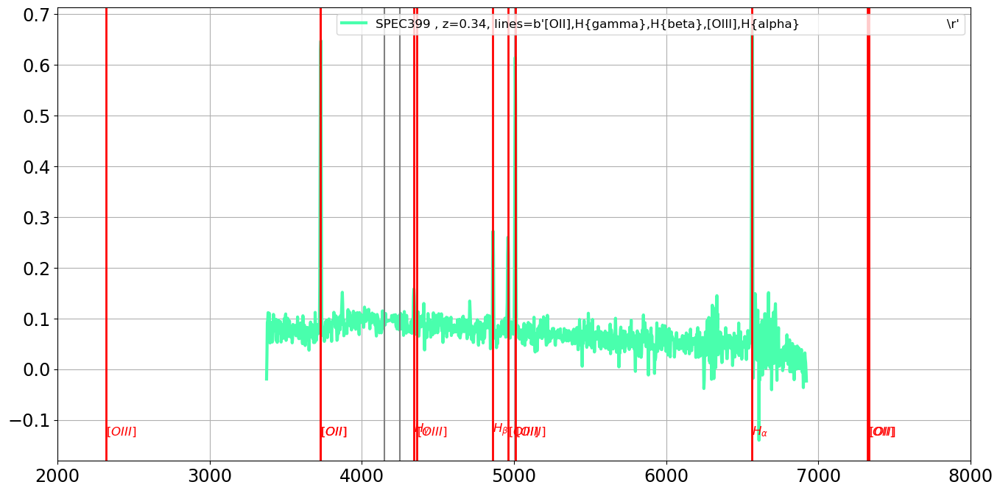

===================== SED 242 : SPEC400 , z=0.34, lines=b'[OII],H8,H,[OIII]                                                           \r'=======================
the_lines =  b'[OII],H8,H,[OIII]                                                           \r'
[OII]
H8
H
[OIII]


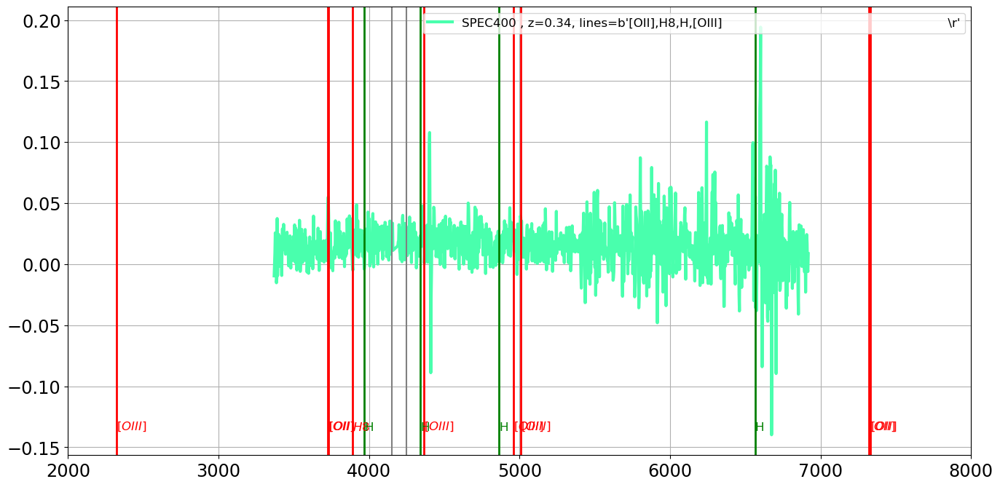

===================== SED 243 : SPEC401 , z=0.43, lines=b'[OII],H,H{beta}                                                             \r'=======================
the_lines =  b'[OII],H,H{beta}                                                             \r'
[OII]
H
H{beta}


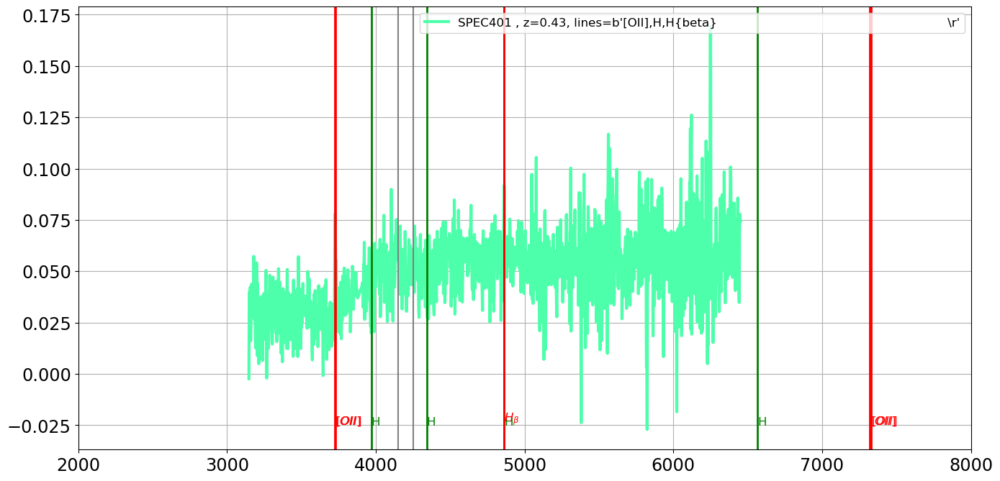

===================== SED 244 : SPEC402 , z=0.48, lines=b'[OII],H9,K,H,H{delta}                                                       \r'=======================
the_lines =  b'[OII],H9,K,H,H{delta}                                                       \r'
[OII]
H9
K
H
H{delta}


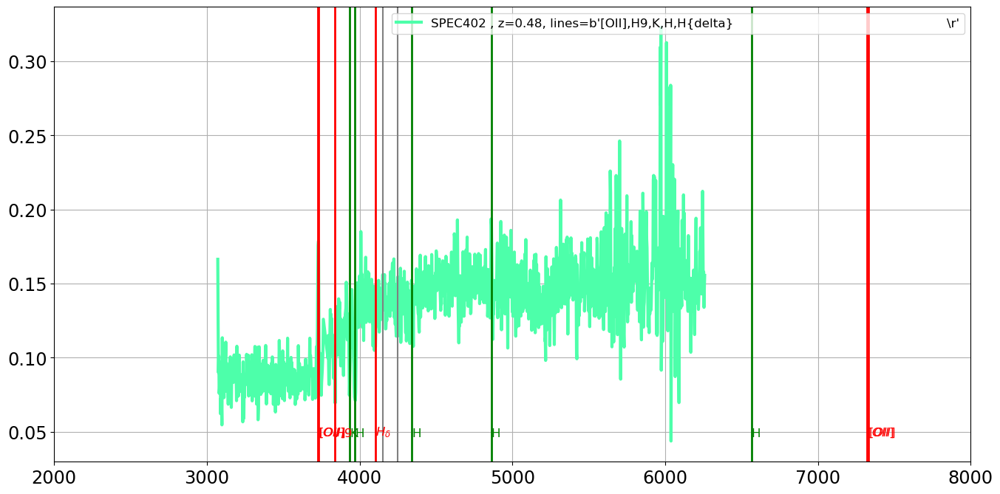

===================== SED 245 : SPEC403 , z=0.30, lines=b'[OII],H,H{alpha}                                                            \r'=======================
the_lines =  b'[OII],H,H{alpha}                                                            \r'
[OII]
H
H{alpha}


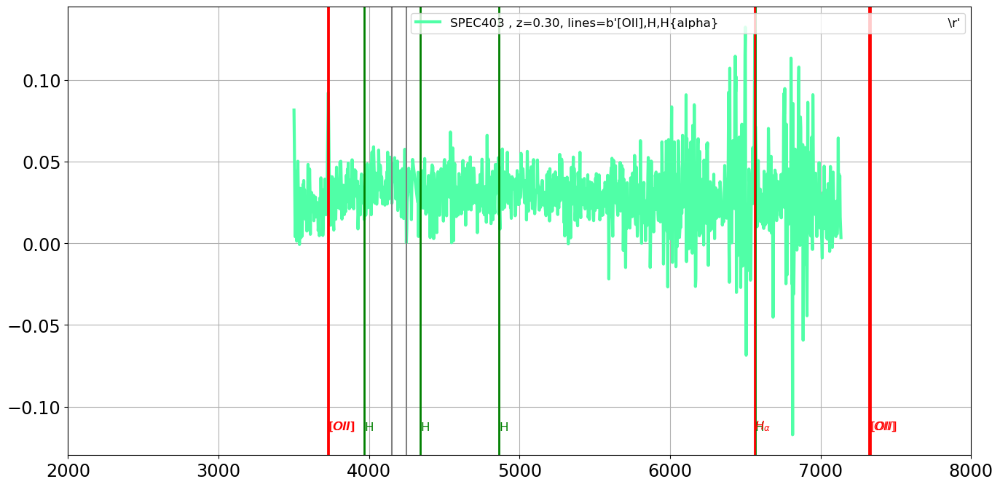

===================== SED 246 : SPEC404 , z=0.29, lines=b'K,H,G,H{beta}                                                               \r'=======================
the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


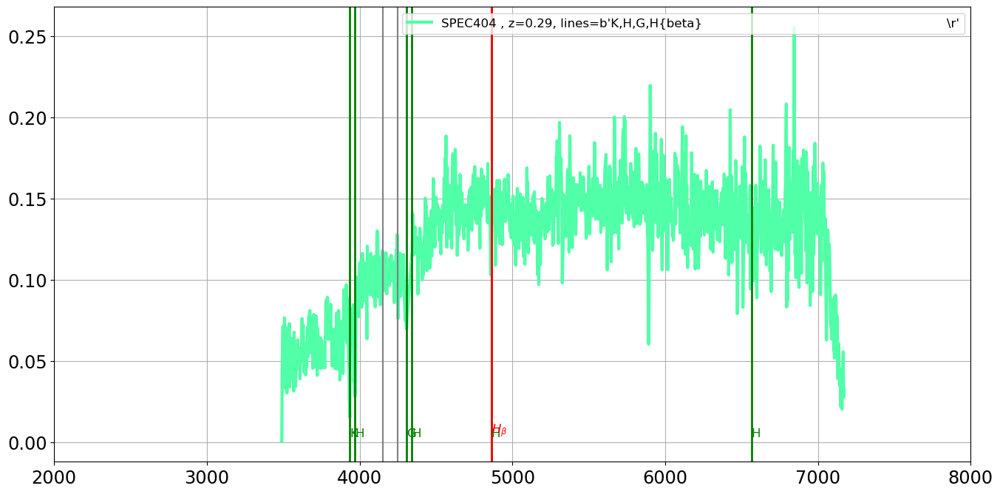

===================== SED 247 : SPEC405 , z=0.60, lines=b'[OII],H10,K,H                                                               \r'=======================
the_lines =  b'[OII],H10,K,H                                                               \r'
[OII]
H10
K
H


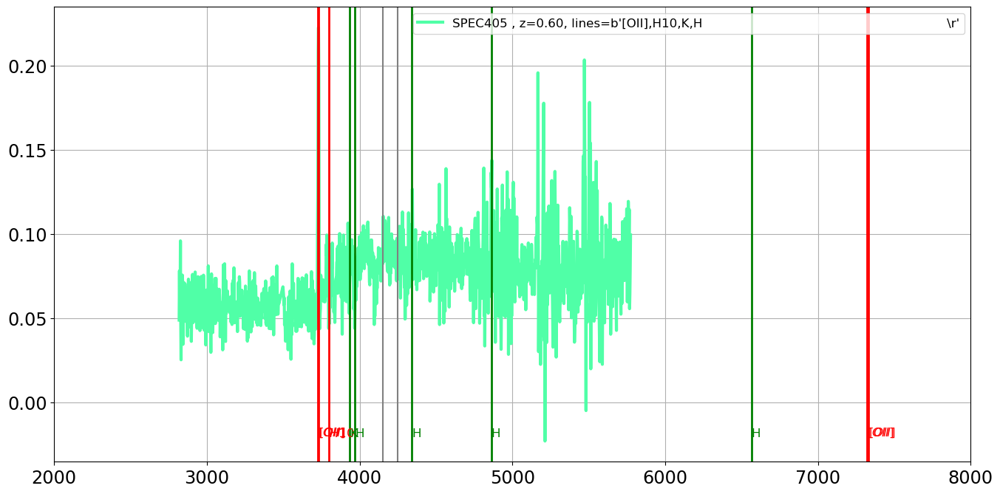

===================== SED 248 : SPEC406 , z=0.25, lines=b'[OII],K,H,H{alpha}                                                          \r'=======================
the_lines =  b'[OII],K,H,H{alpha}                                                          \r'
[OII]
K
H
H{alpha}


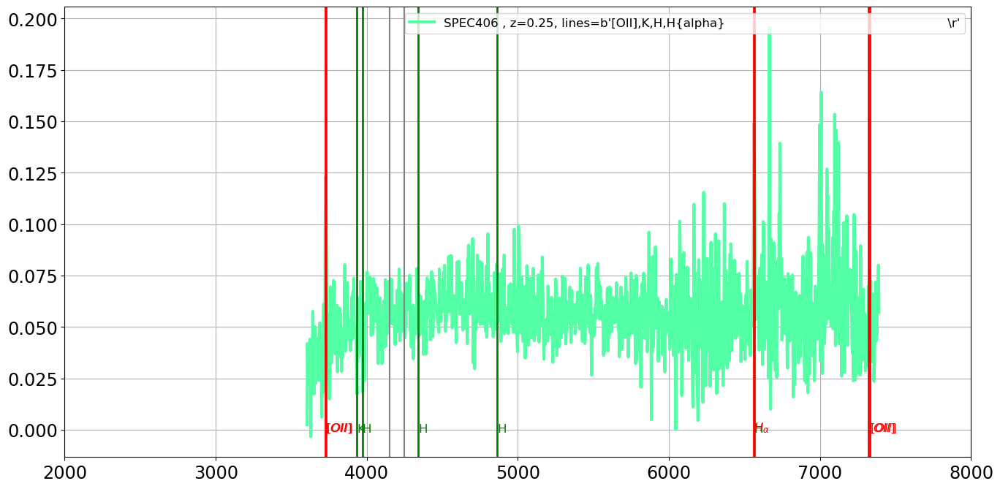

===================== SED 249 : SPEC407 , z=0.64, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


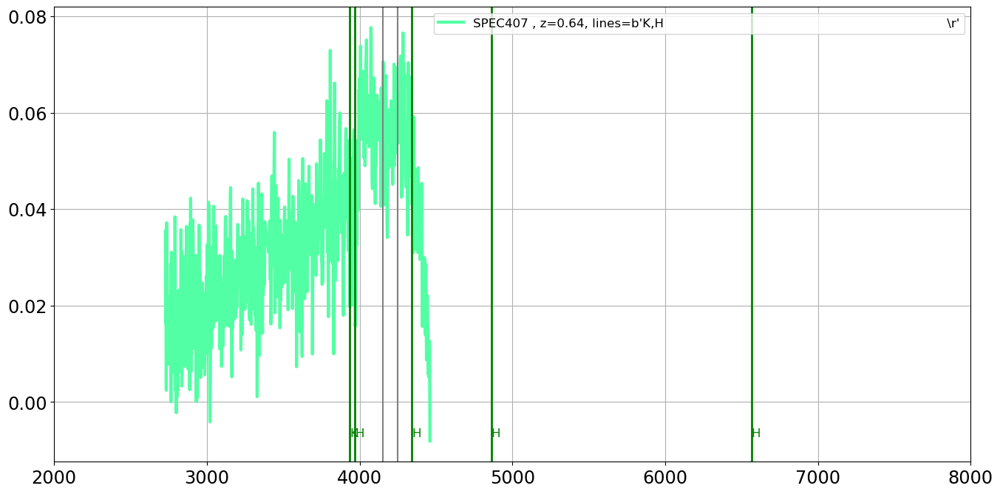

===================== SED 250 : SPEC408 , z=0.56, lines=b'[OII],H8,H,H{delta}                                                         \r'=======================
the_lines =  b'[OII],H8,H,H{delta}                                                         \r'
[OII]
H8
H
H{delta}


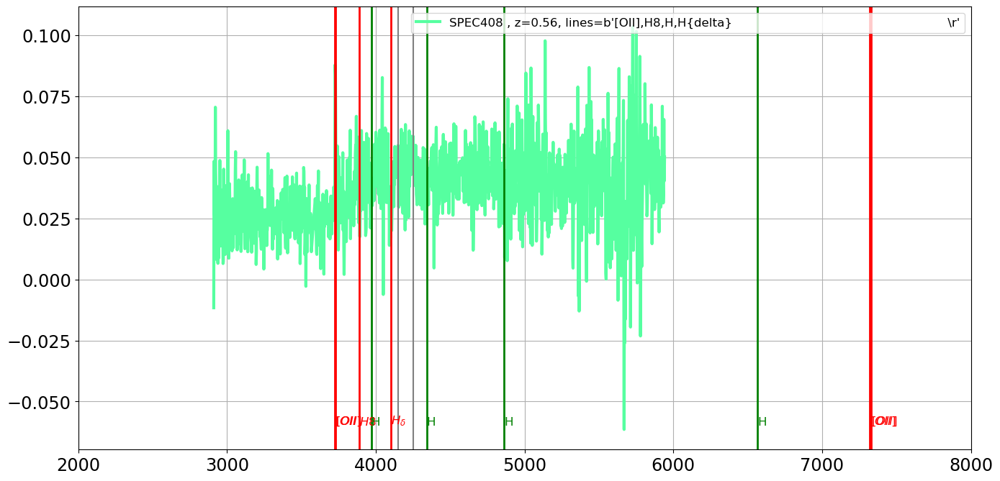

===================== SED 251 : SPEC409 , z=0.18, lines=b'H{beta},[OIII]                                                              \r'=======================
the_lines =  b'H{beta},[OIII]                                                              \r'
H{beta}
[OIII]


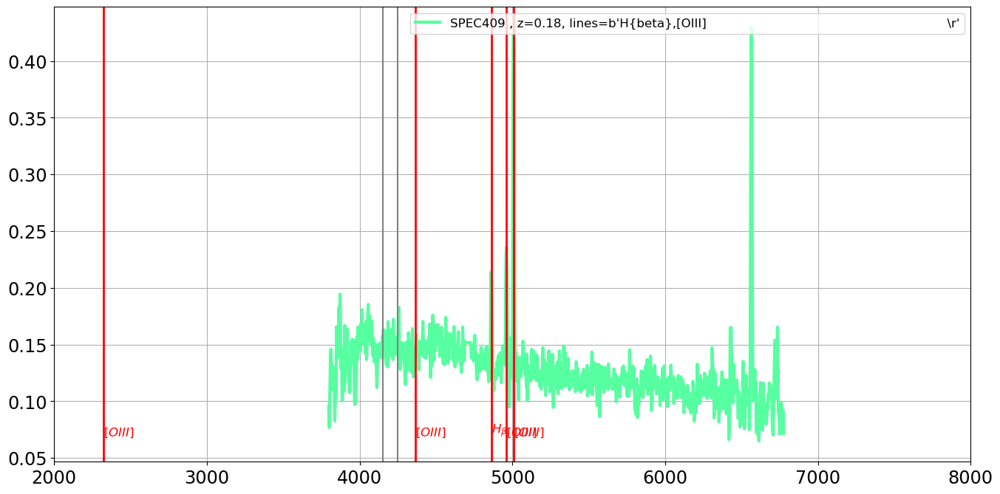

===================== SED 252 : SPEC410 , z=0.64, lines=b'K,H,4000{AA}-break                                                          \r'=======================
the_lines =  b'K,H,4000{AA}-break                                                          \r'
K
H
4000{AA}-break


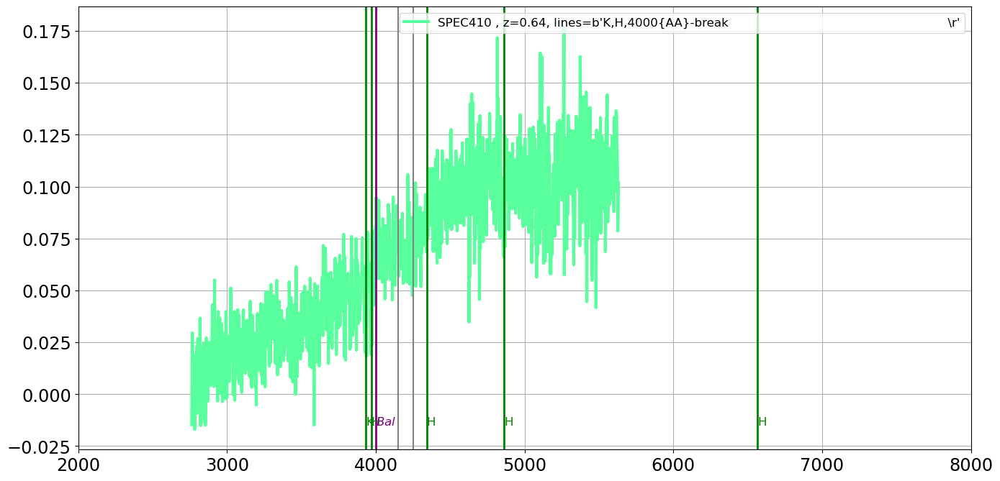

===================== SED 253 : SPEC411 , z=0.51, lines=b'[OII],H8,K,H,H{delta}                                                       \r'=======================
the_lines =  b'[OII],H8,K,H,H{delta}                                                       \r'
[OII]
H8
K
H
H{delta}


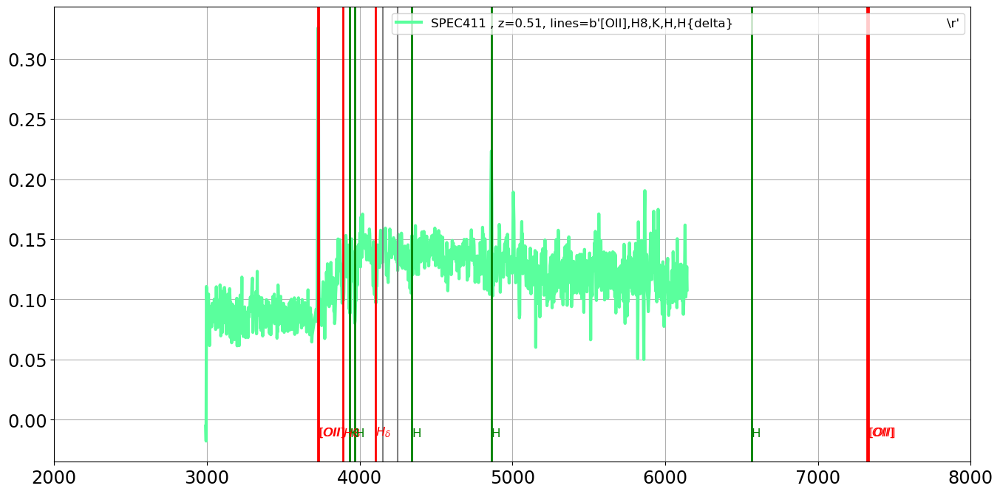

===================== SED 254 : SPEC412 , z=0.42, lines=b'H,4000{AA}-break,G                                                          \r'=======================
the_lines =  b'H,4000{AA}-break,G                                                          \r'
H
4000{AA}-break
G


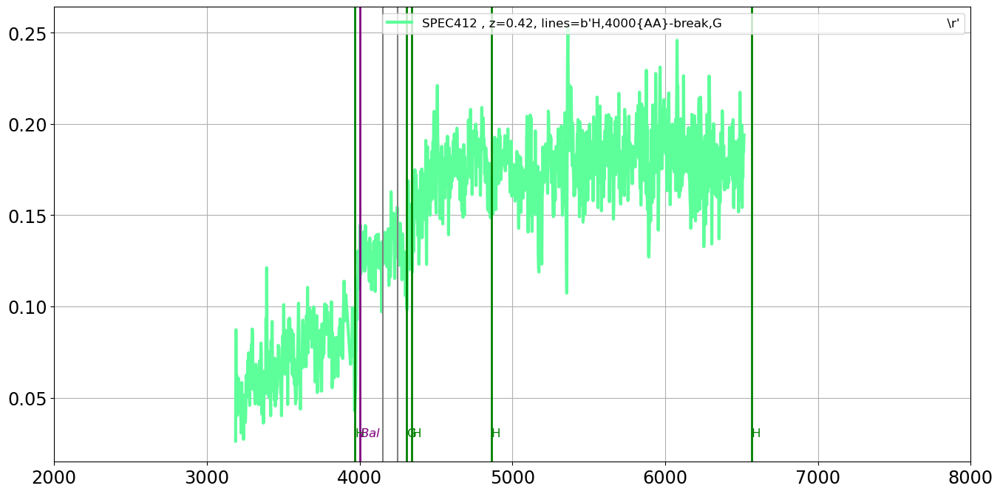

===================== SED 255 : SPEC413 , z=0.42, lines=b'[OII],H10,H9,H                                                              \r'=======================
the_lines =  b'[OII],H10,H9,H                                                              \r'
[OII]
H10
H9
H


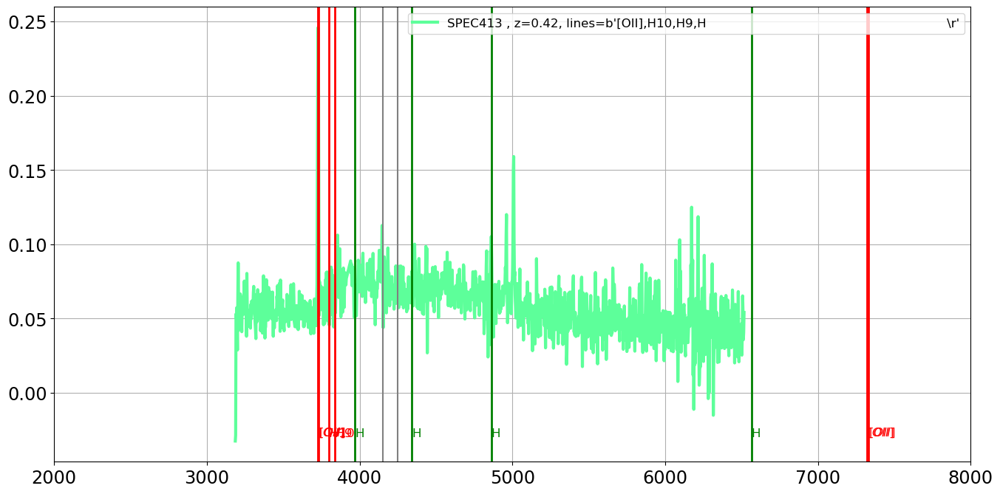

===================== SED 256 : SPEC414 , z=0.91, lines=b'MgII,[OII],H10,H9,H8,H,H{delta}                                             \r'=======================
the_lines =  b'MgII,[OII],H10,H9,H8,H,H{delta}                                             \r'
MgII
[OII]
H10
H9
H8
H
H{delta}


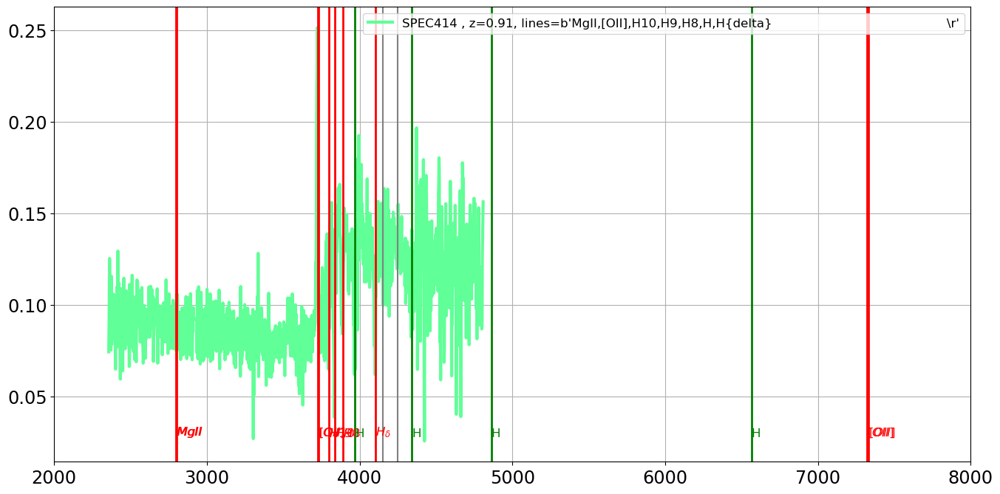

===================== SED 257 : SPEC415 , z=0.08, lines=b'[OIII],H{alpha}                                                             \r'=======================
the_lines =  b'[OIII],H{alpha}                                                             \r'
[OIII]
H{alpha}


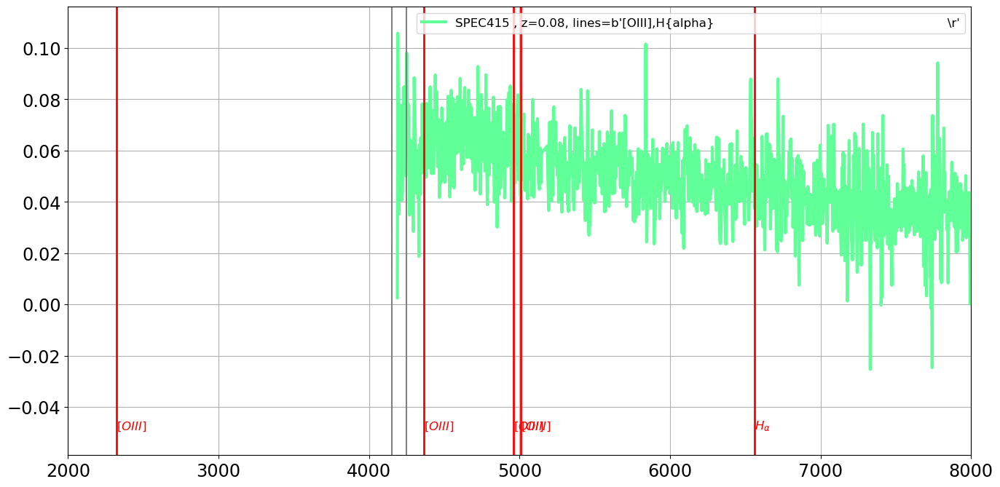

===================== SED 258 : SPEC416 , z=0.73, lines=b'MgII,[OII],H{beta},[OIII]                                                   \r'=======================
the_lines =  b'MgII,[OII],H{beta},[OIII]                                                   \r'
MgII
[OII]
H{beta}
[OIII]


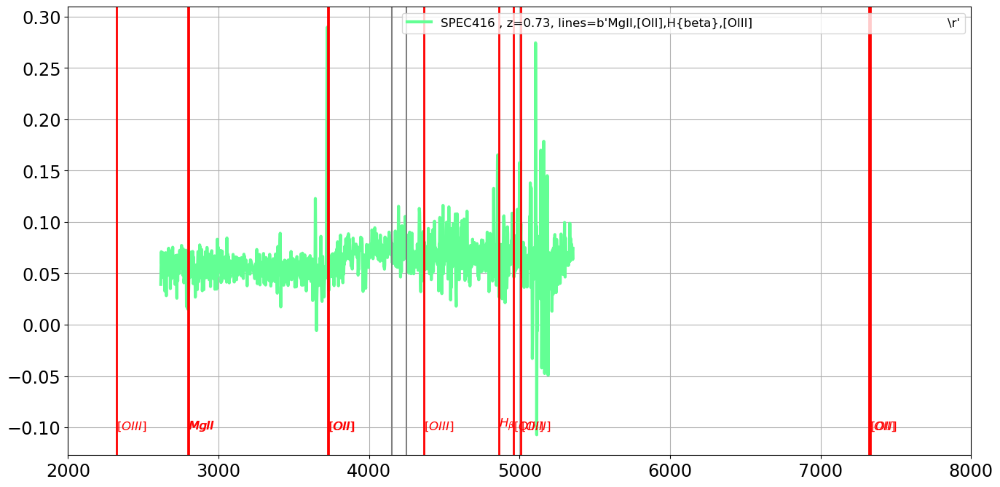

===================== SED 259 : SPEC417 , z=0.36, lines=b'K,H,G,H{beta}                                                               \r'=======================
the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


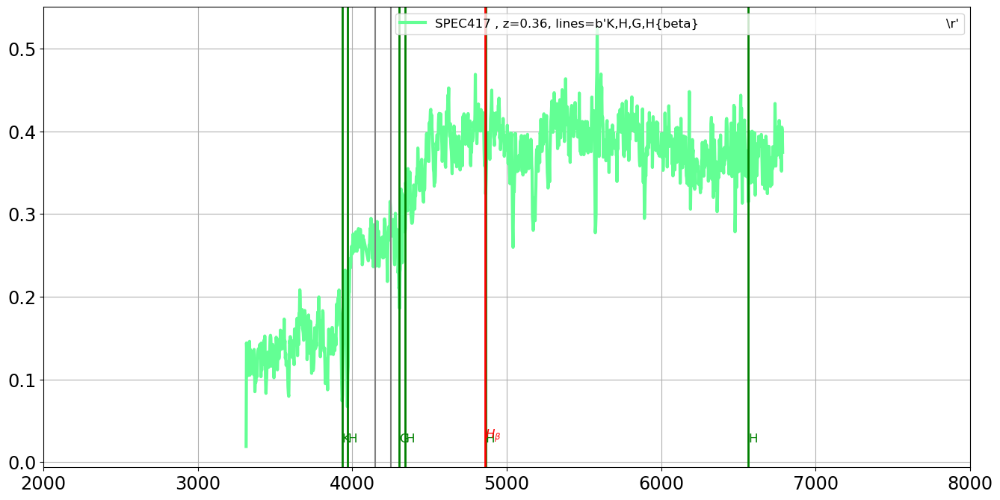

===================== SED 260 : SPEC418 , z=0.29, lines=b'[OII],H9,K,H,H{delta},H{alpha}                                              \r'=======================
the_lines =  b'[OII],H9,K,H,H{delta},H{alpha}                                              \r'
[OII]
H9
K
H
H{delta}
H{alpha}


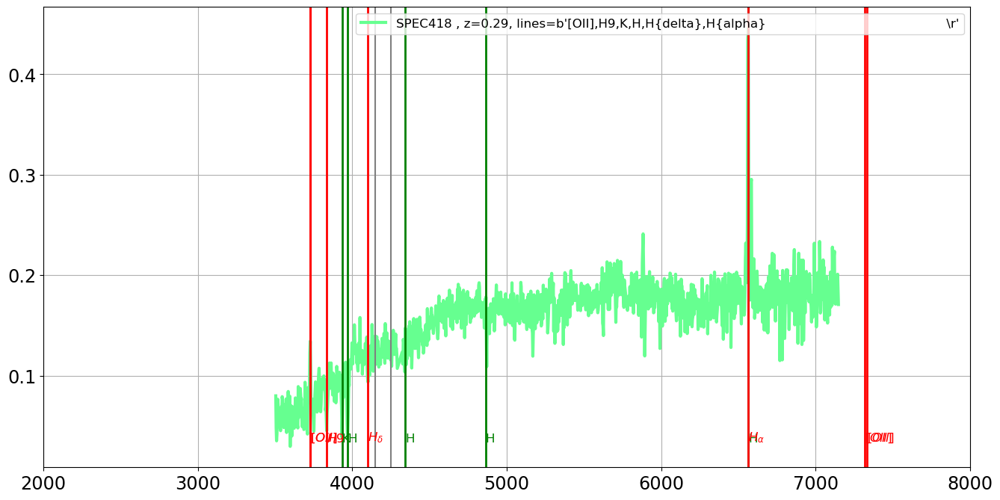

===================== SED 261 : SPEC419 , z=0.42, lines=b'[OII],H10,H9,K,H,H{delta}                                                   \r'=======================
the_lines =  b'[OII],H10,H9,K,H,H{delta}                                                   \r'
[OII]
H10
H9
K
H
H{delta}


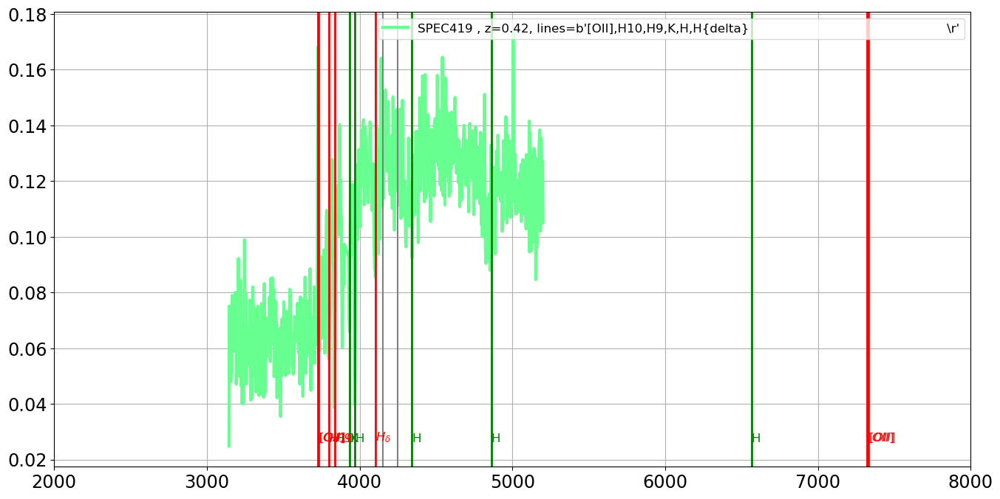

===================== SED 262 : SPEC420 , z=0.64, lines=b'[OII],H10,H9,K,H                                                            \r'=======================
the_lines =  b'[OII],H10,H9,K,H                                                            \r'
[OII]
H10
H9
K
H


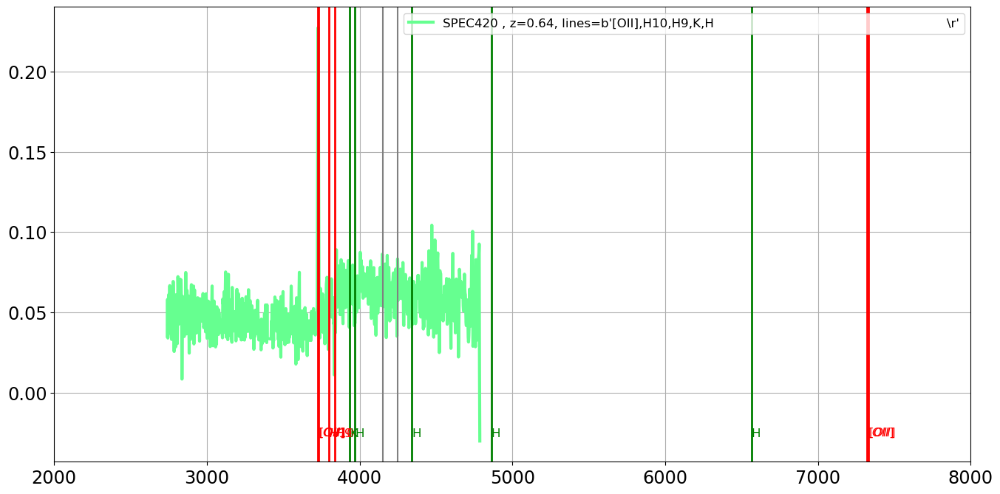

===================== SED 263 : SPEC421 , z=0.04, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


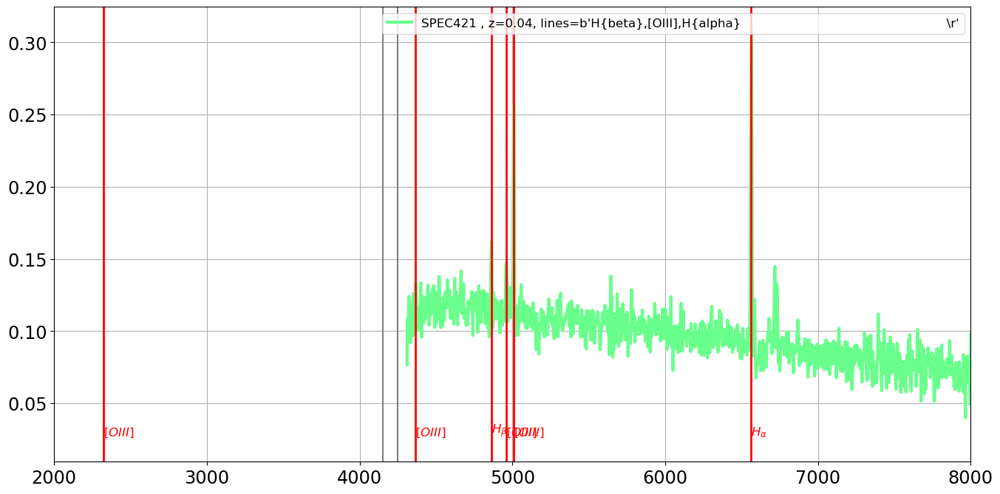

===================== SED 264 : SPEC422 , z=0.48, lines=b'[OII],H8,K,H                                                                \r'=======================
the_lines =  b'[OII],H8,K,H                                                                \r'
[OII]
H8
K
H


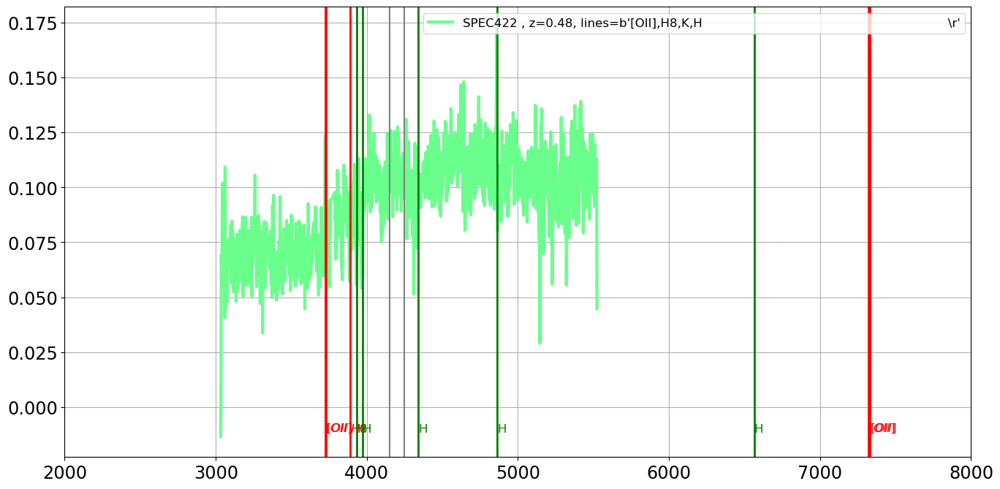

===================== SED 265 : SPEC423 , z=0.69, lines=b'[OII],H8,K,H,[OIII]                                                         \r'=======================
the_lines =  b'[OII],H8,K,H,[OIII]                                                         \r'
[OII]
H8
K
H
[OIII]


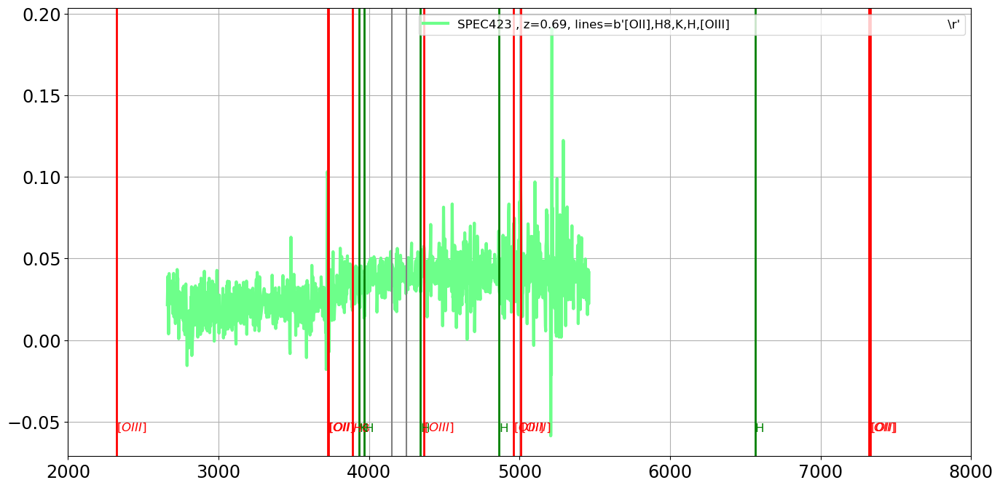

===================== SED 266 : SPEC424 , z=0.84, lines=b'[OII],H{gamma},H{beta},[OIII]                                               \r'=======================
the_lines =  b'[OII],H{gamma},H{beta},[OIII]                                               \r'
[OII]
H{gamma}
H{beta}
[OIII]


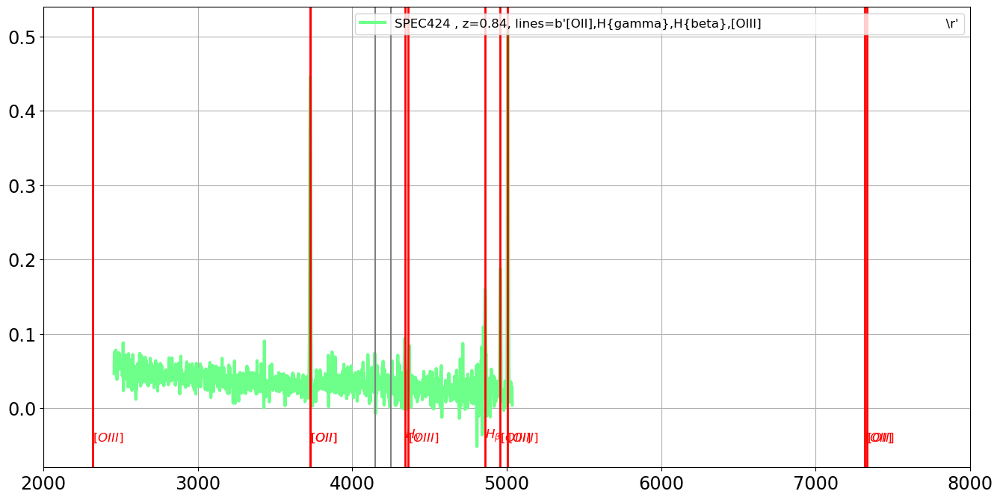

===================== SED 267 : SPEC425 , z=0.25, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


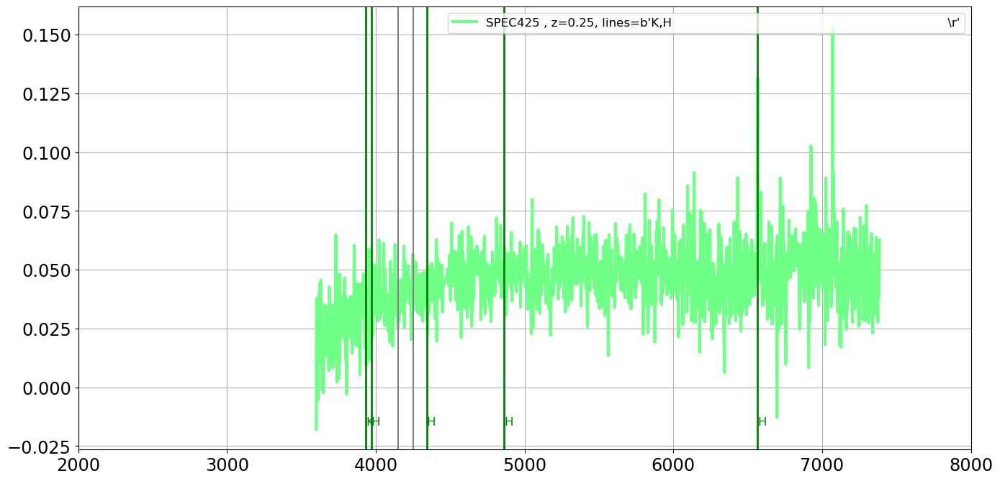

===================== SED 268 : SPEC426 , z=0.32, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


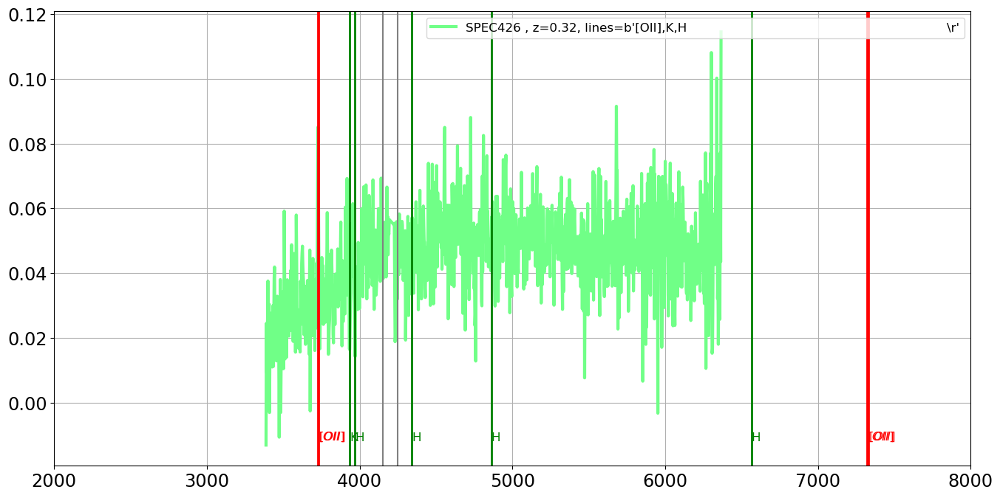

===================== SED 269 : SPEC427 , z=0.58, lines=b'[OII],K,H,H{delta}                                                          \r'=======================
the_lines =  b'[OII],K,H,H{delta}                                                          \r'
[OII]
K
H
H{delta}


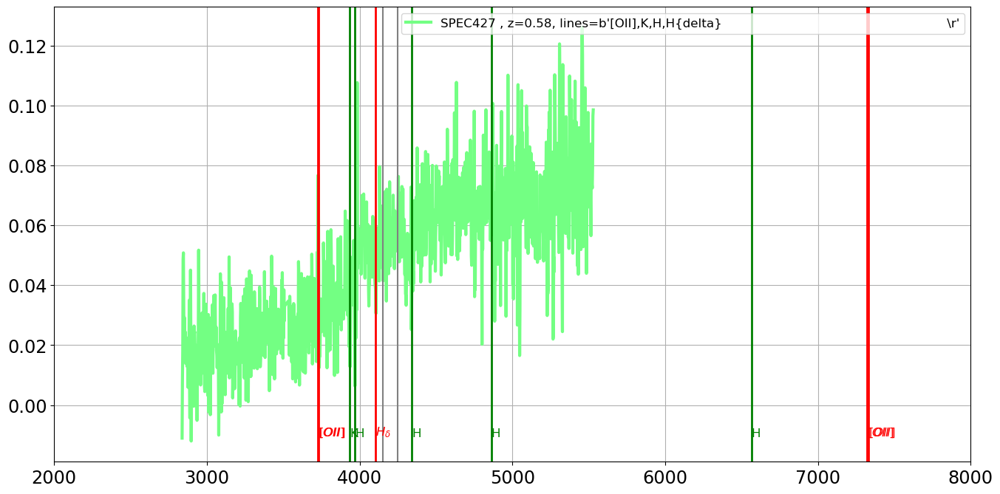

===================== SED 270 : SPEC428 , z=0.83, lines=b'MgII,[OII],H9,K                                                             \r'=======================
the_lines =  b'MgII,[OII],H9,K                                                             \r'
MgII
[OII]
H9
K


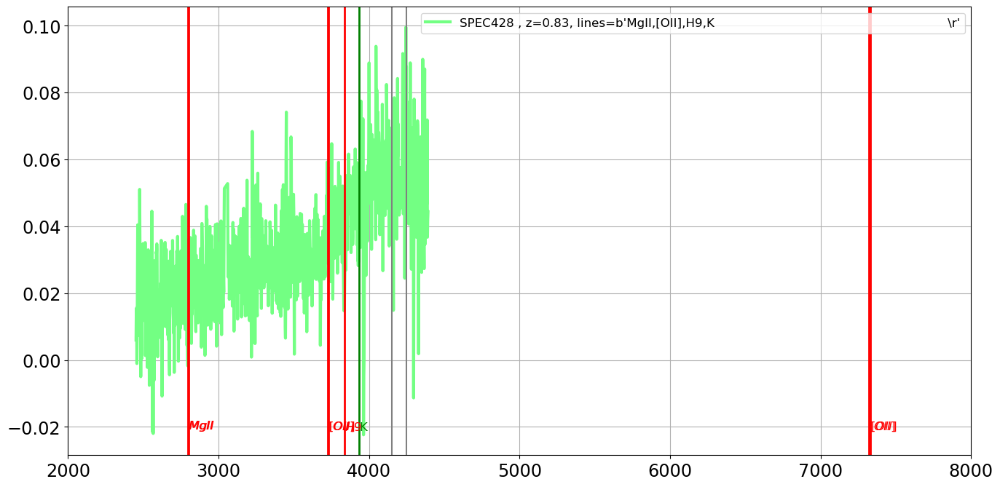

===================== SED 271 : SPEC429 , z=0.95, lines=b'K,H,4000{AA}-break                                                          \r'=======================
the_lines =  b'K,H,4000{AA}-break                                                          \r'
K
H
4000{AA}-break


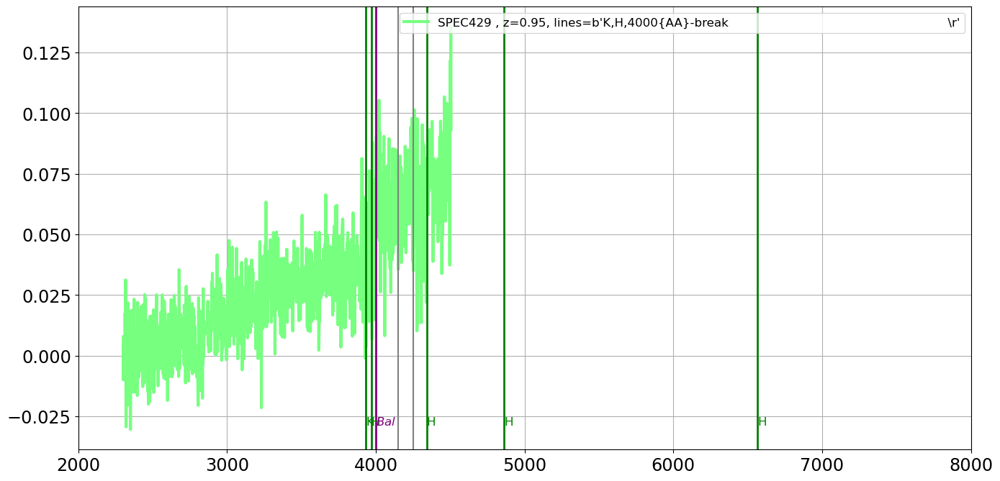

===================== SED 272 : SPEC430 , z=0.95, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


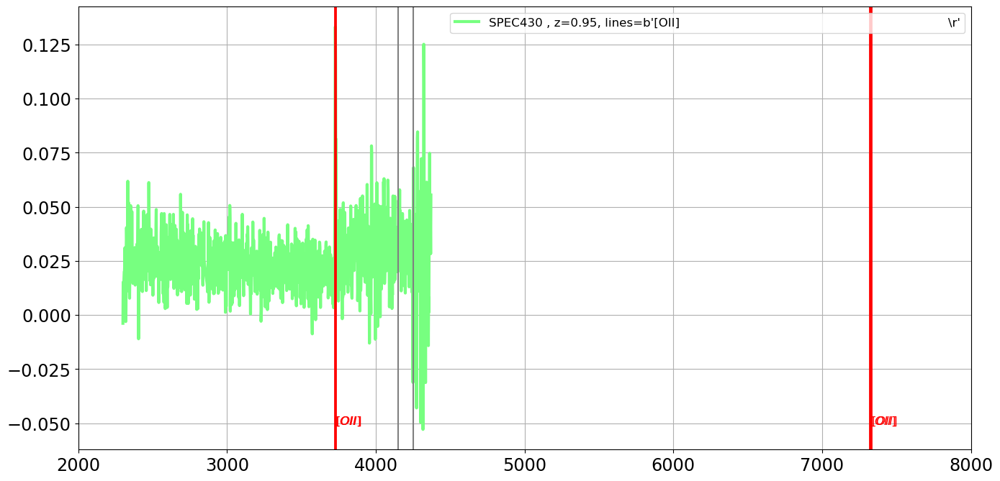

===================== SED 273 : SPEC431 , z=0.91, lines=b'MgII,[OII],H                                                                \r'=======================
the_lines =  b'MgII,[OII],H                                                                \r'
MgII
[OII]
H


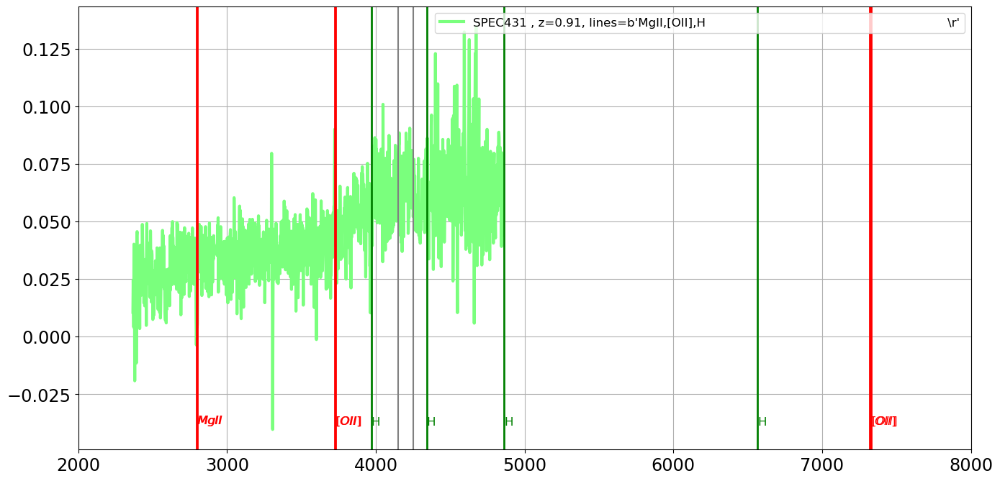

===================== SED 274 : SPEC432 , z=0.45, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


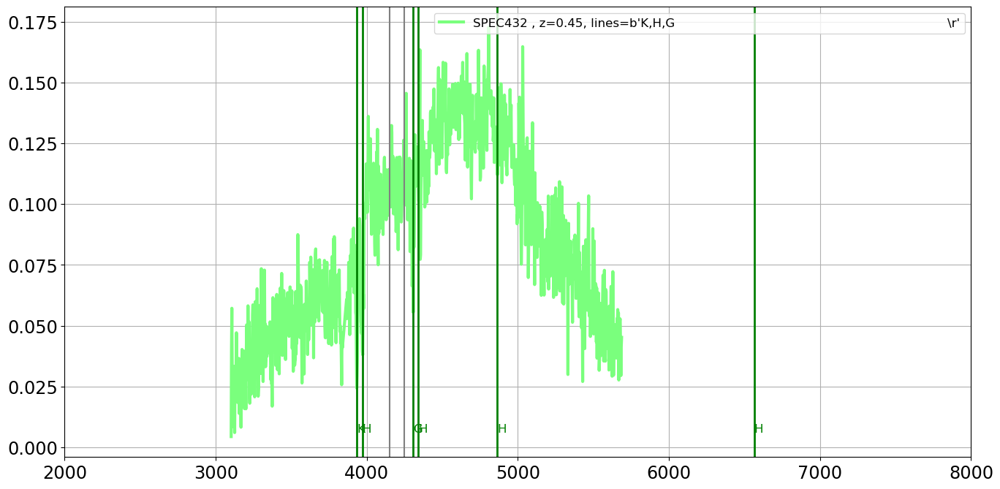

===================== SED 275 : SPEC434 , z=0.34, lines=b'[OII],H{beta},[OIII],H{alpha}                                               \r'=======================
the_lines =  b'[OII],H{beta},[OIII],H{alpha}                                               \r'
[OII]
H{beta}
[OIII]
H{alpha}


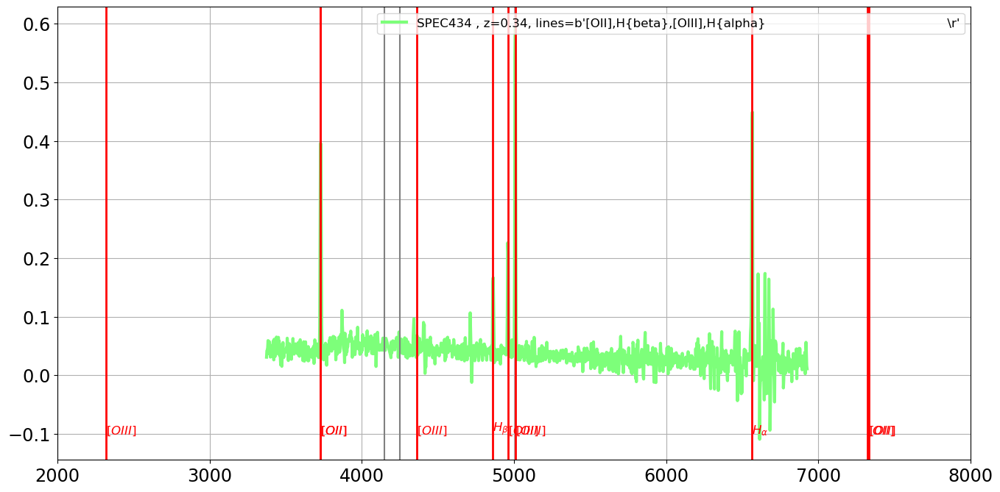

===================== SED 276 : SPEC435 , z=0.34, lines=b'[OII],K,H,H{beta},[OIII],H{alpha}                                           \r'=======================
the_lines =  b'[OII],K,H,H{beta},[OIII],H{alpha}                                           \r'
[OII]
K
H
H{beta}
[OIII]
H{alpha}


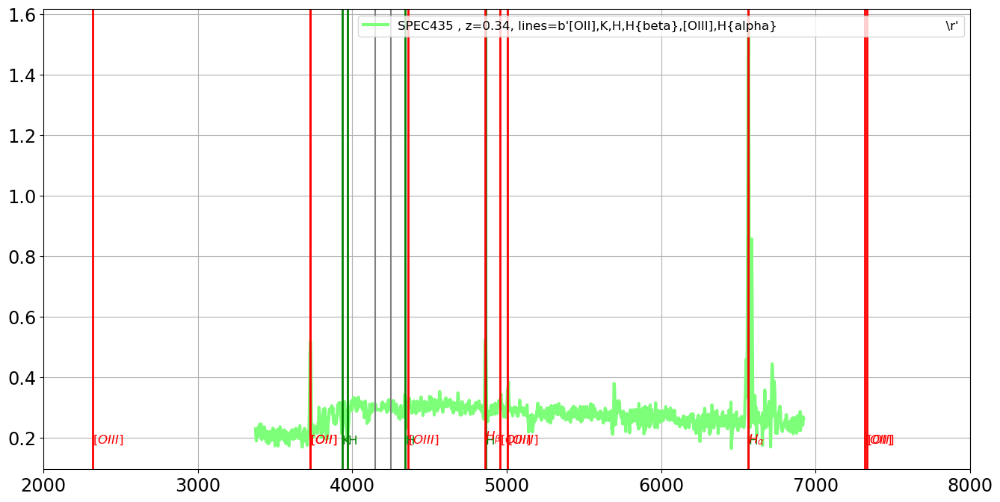

===================== SED 277 : SPEC436 , z=0.45, lines=b'H9,H8,K,H                                                                   \r'=======================
the_lines =  b'H9,H8,K,H                                                                   \r'
H9
H8
K
H


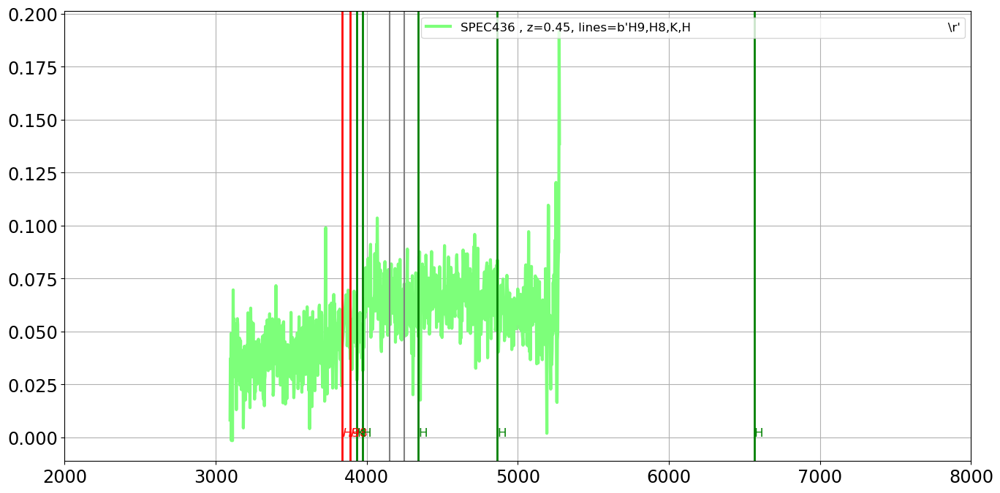

===================== SED 278 : SPEC437 , z=0.27, lines=b'[OII],H{beta},[OIII],H{alpha}                                               \r'=======================
the_lines =  b'[OII],H{beta},[OIII],H{alpha}                                               \r'
[OII]
H{beta}
[OIII]
H{alpha}


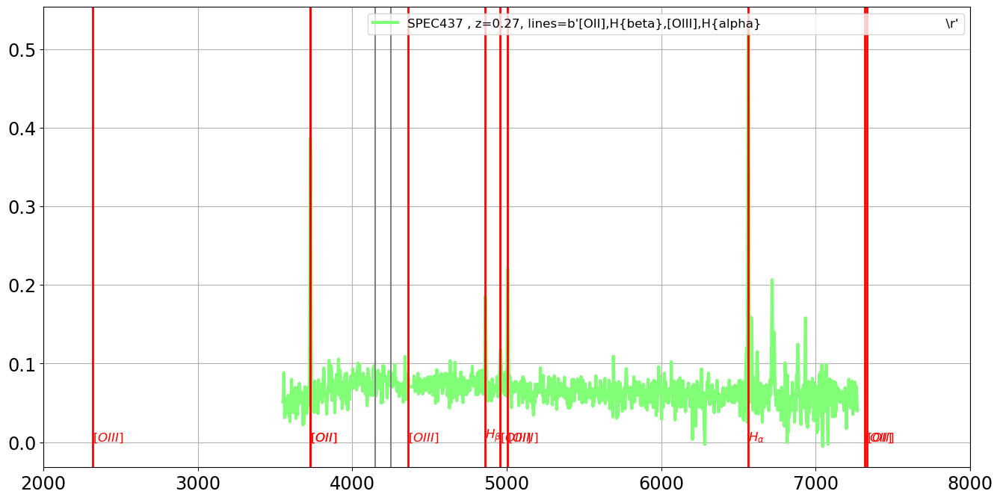

===================== SED 279 : SPEC438 , z=0.49, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


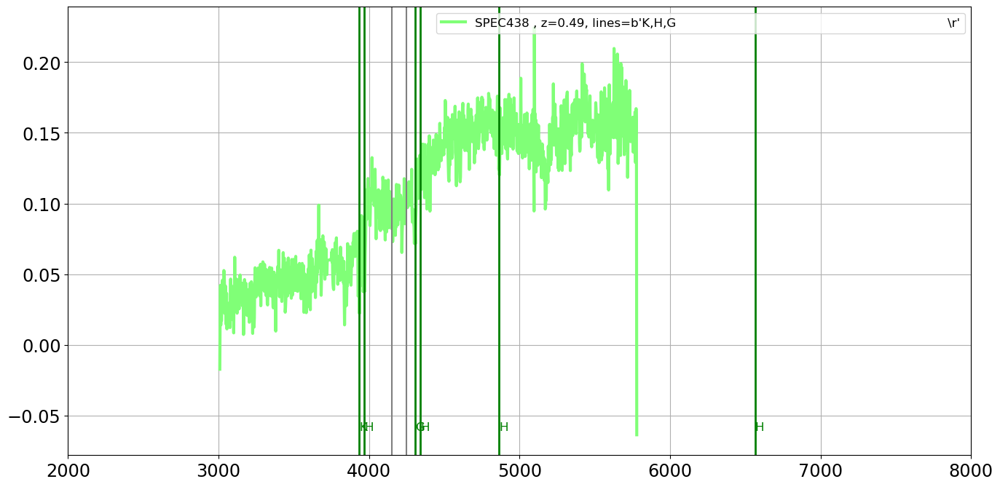

===================== SED 280 : SPEC439 , z=0.30, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


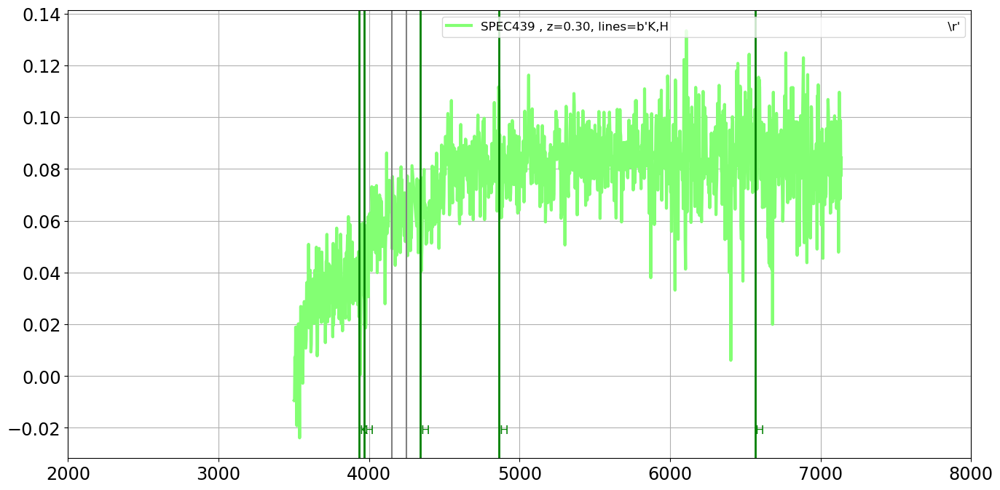

===================== SED 281 : SPEC440 , z=0.69, lines=b'MgII,[OII],H                                                                \r'=======================
the_lines =  b'MgII,[OII],H                                                                \r'
MgII
[OII]
H


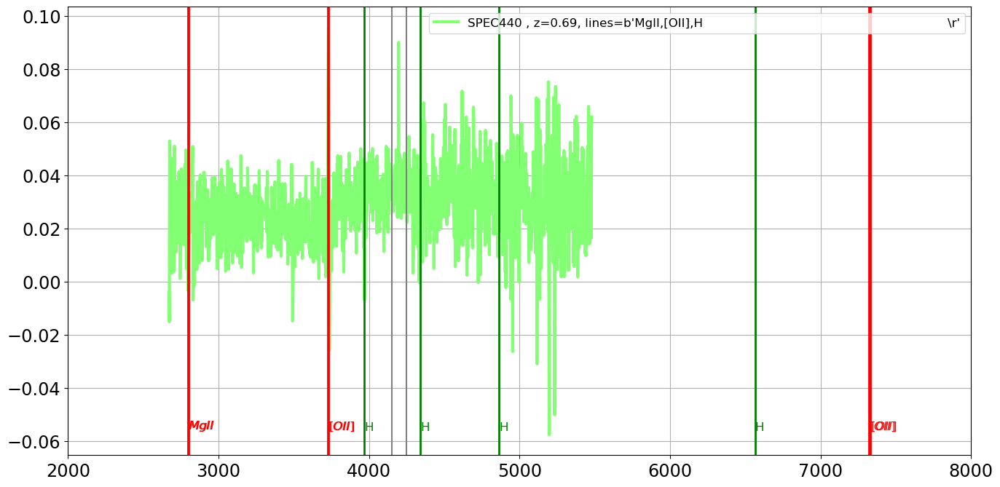

===================== SED 282 : SPEC441 , z=0.29, lines=b'H9,K,H                                                                      \r'=======================
the_lines =  b'H9,K,H                                                                      \r'
H9
K
H


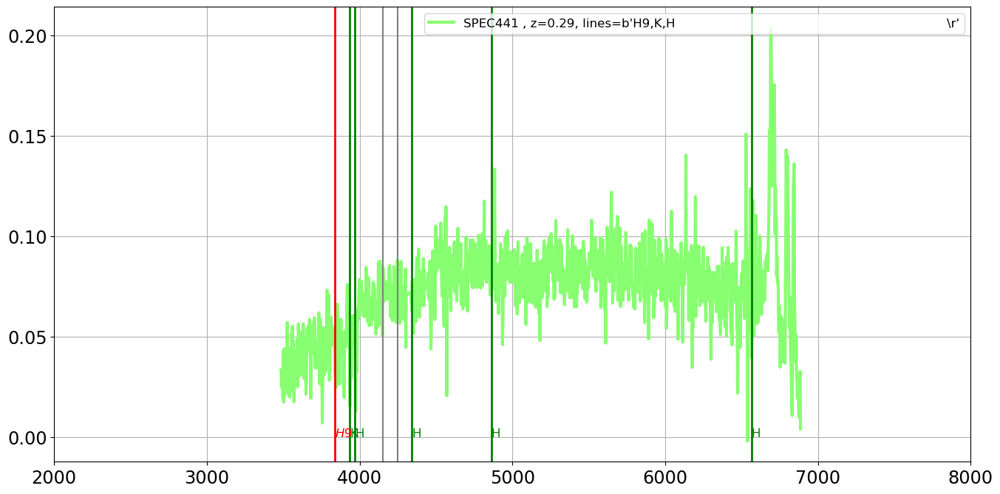

===================== SED 283 : SPEC442 , z=0.81, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


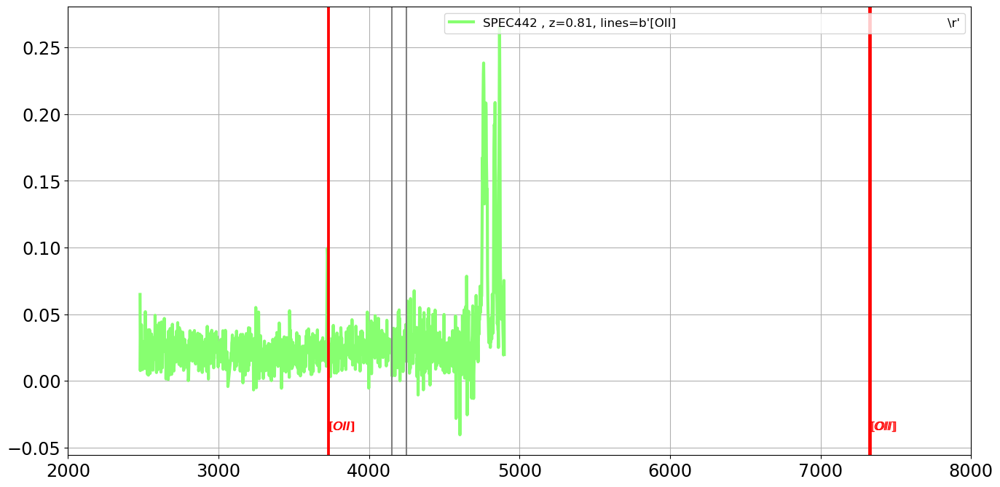

===================== SED 284 : SPEC443 , z=0.45, lines=b'K,H,G,H{beta}                                                               \r'=======================
the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


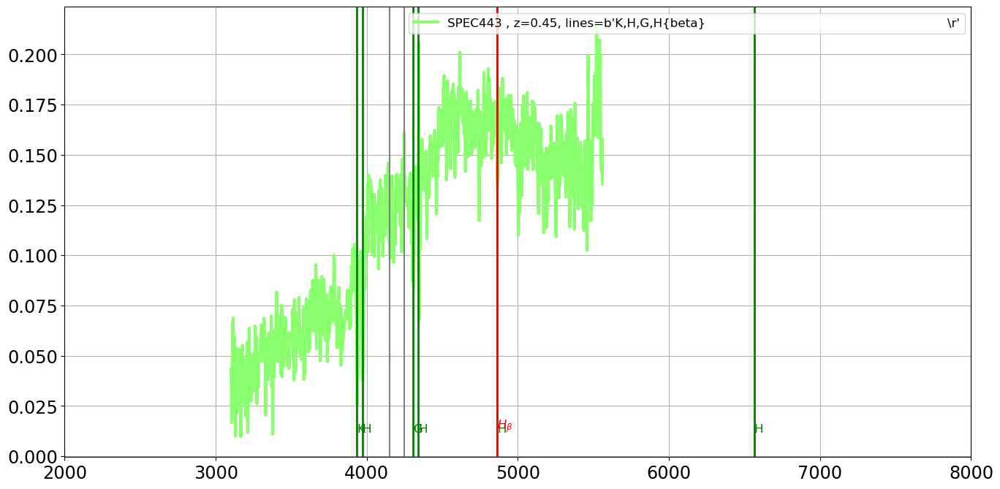

===================== SED 285 : SPEC444 , z=0.47, lines=b'[OII],K,H,H{beta}                                                           \r'=======================
the_lines =  b'[OII],K,H,H{beta}                                                           \r'
[OII]
K
H
H{beta}


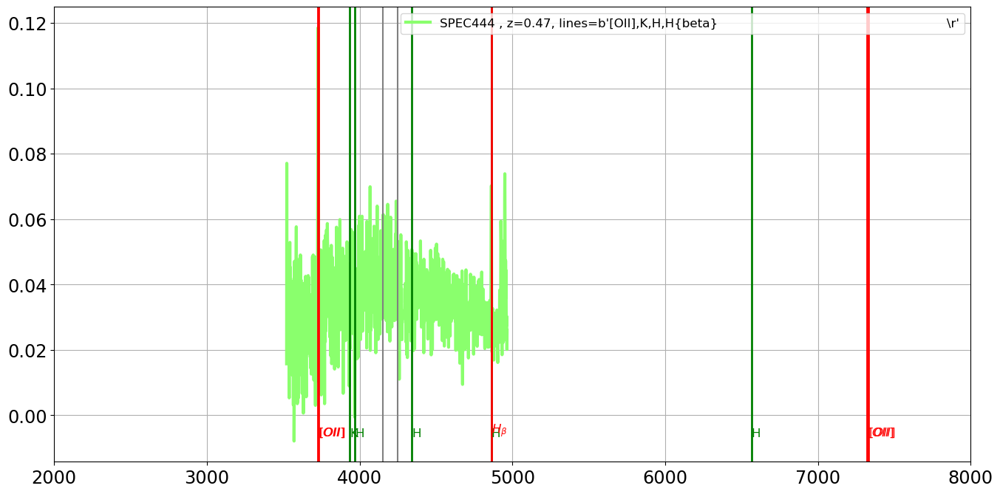

===================== SED 286 : SPEC445 , z=0.69, lines=b'[OII],H9,H8,K,H                                                             \r'=======================
the_lines =  b'[OII],H9,H8,K,H                                                             \r'
[OII]
H9
H8
K
H


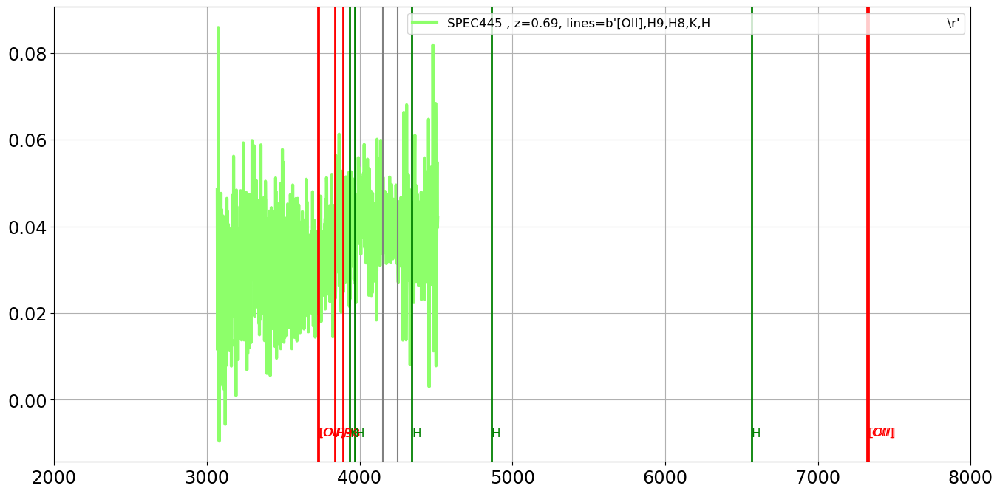

===================== SED 287 : SPEC446 , z=0.29, lines=b'G,H{beta},Mgb                                                               \r'=======================
the_lines =  b'G,H{beta},Mgb                                                               \r'
G
H{beta}
Mgb


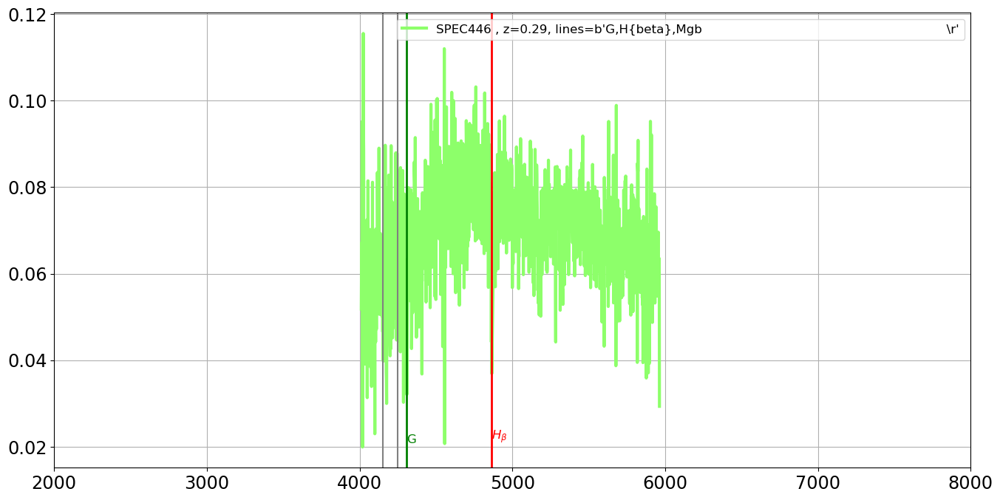

===================== SED 288 : SPEC447 , z=0.29, lines=b'                                                                            \r'=======================
the_lines =  b'                                                                            \r'



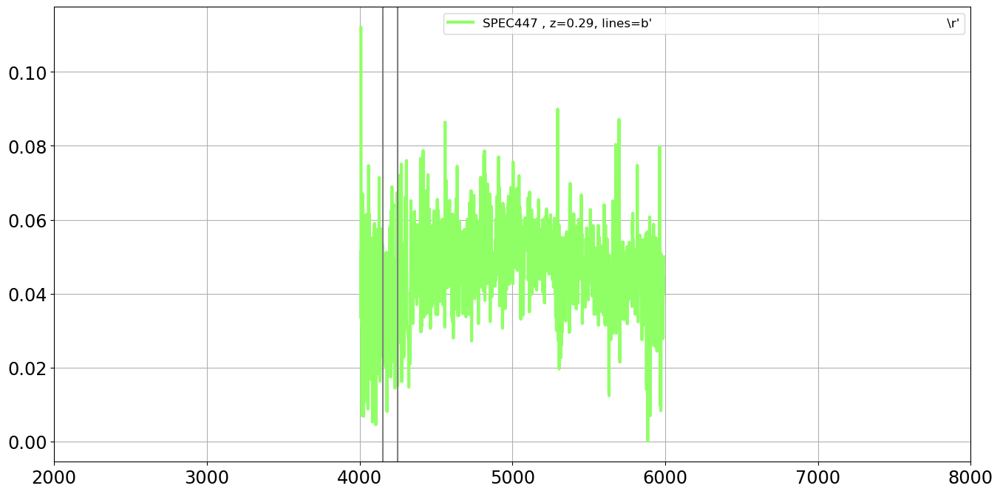

===================== SED 289 : SPEC448 , z=0.44, lines=b'K,H,H{beta},[OIII]                                                          \r'=======================
the_lines =  b'K,H,H{beta},[OIII]                                                          \r'
K
H
H{beta}
[OIII]


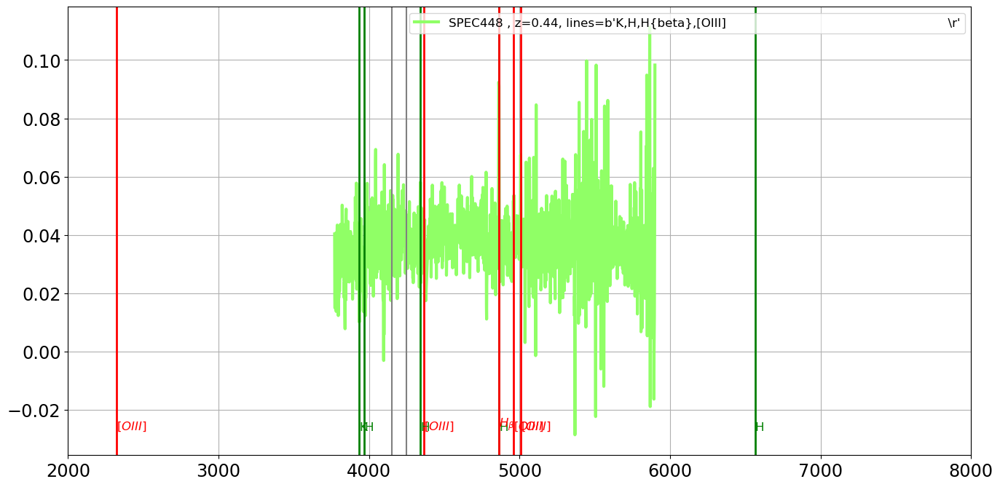

===================== SED 290 : SPEC449 , z=0.67, lines=b'[OII],H,H{delta}                                                            \r'=======================
the_lines =  b'[OII],H,H{delta}                                                            \r'
[OII]
H
H{delta}


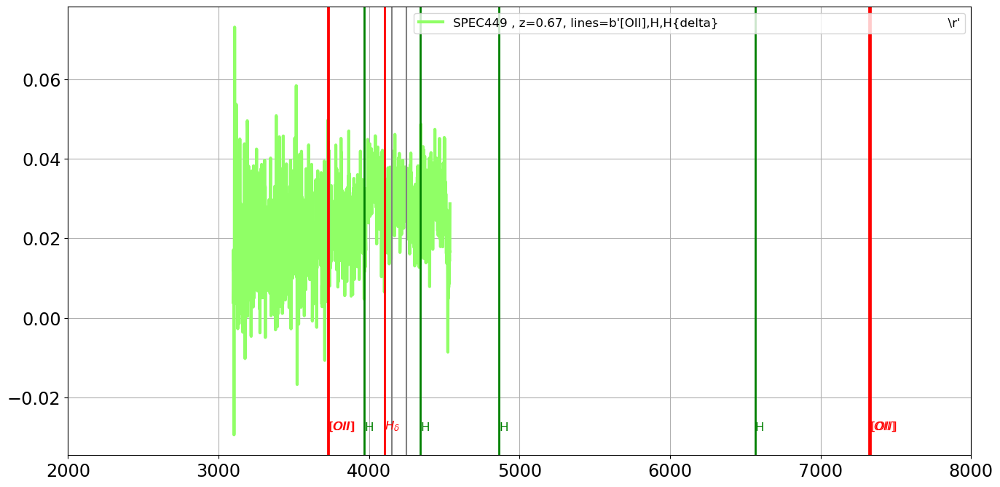

===================== SED 291 : SPEC450 , z=0.67, lines=b'[OII],H,H{delta}                                                            \r'=======================
the_lines =  b'[OII],H,H{delta}                                                            \r'
[OII]
H
H{delta}


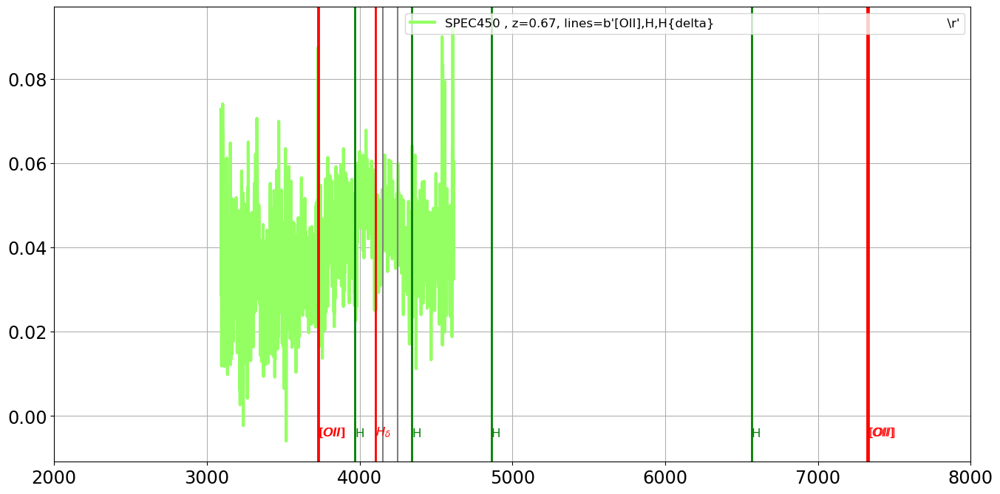

===================== SED 292 : SPEC451 , z=1.00, lines=b'K,H,4000{AA}-break,H{delta}                                                 \r'=======================
the_lines =  b'K,H,4000{AA}-break,H{delta}                                                 \r'
K
H
4000{AA}-break
H{delta}


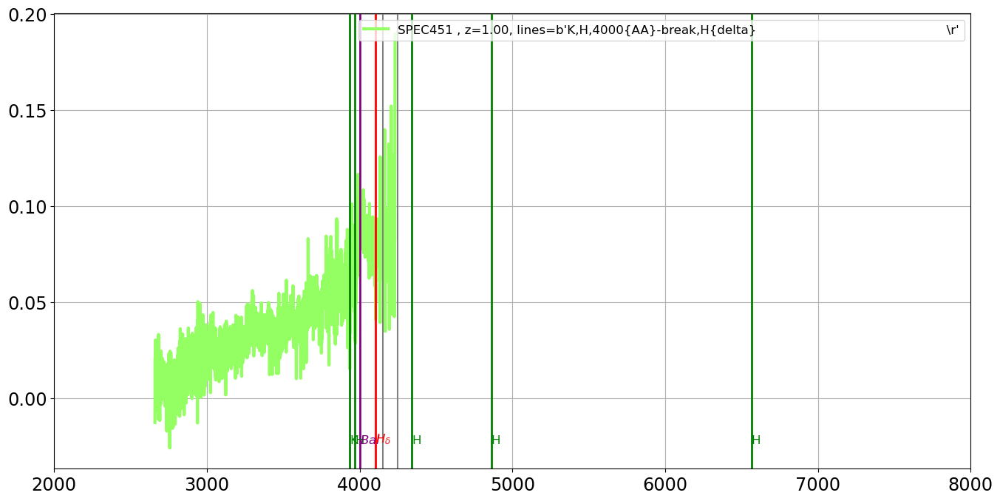

===================== SED 293 : SPEC452 , z=0.45, lines=b'[OII],K,H,H{beta}                                                           \r'=======================
the_lines =  b'[OII],K,H,H{beta}                                                           \r'
[OII]
K
H
H{beta}


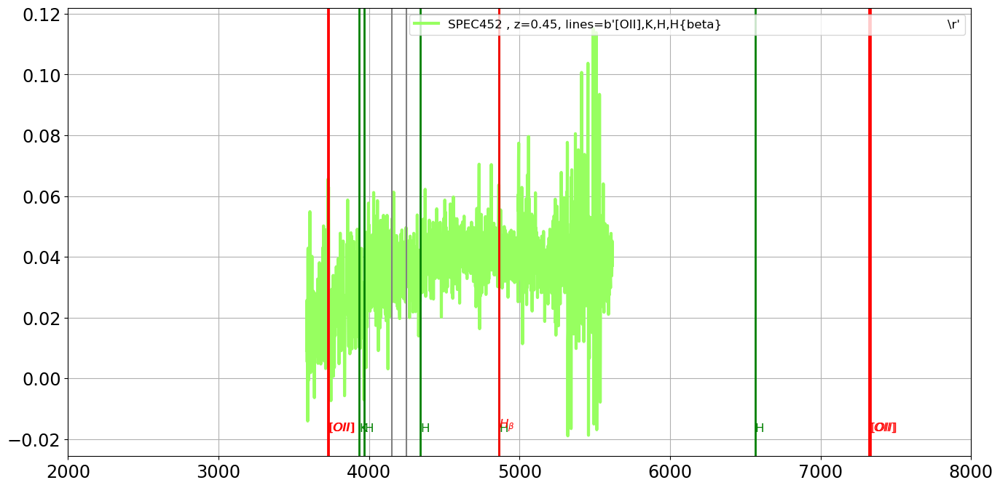

===================== SED 294 : SPEC453 , z=0.20, lines=b'H{beta},Mgb,E,NaD                                                           \r'=======================
the_lines =  b'H{beta},Mgb,E,NaD                                                           \r'
H{beta}
Mgb
E
NaD


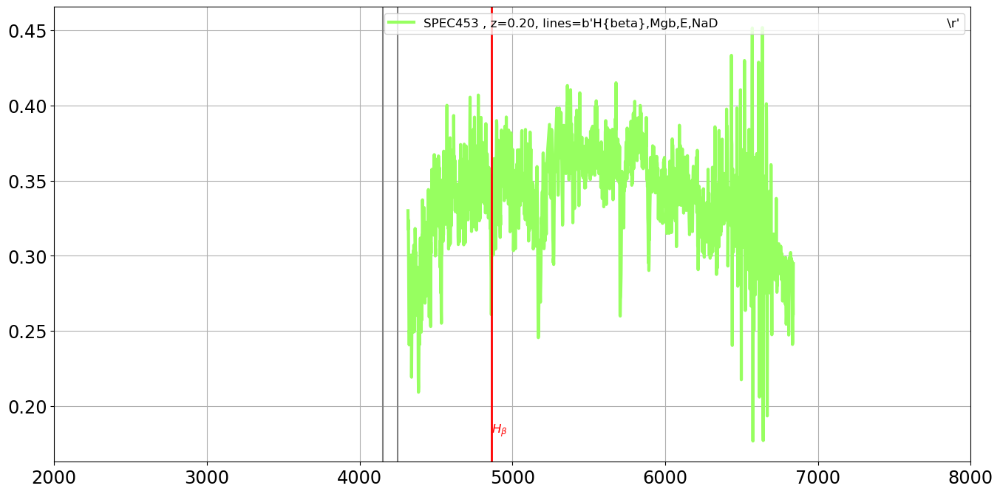

===================== SED 295 : SPEC454 , z=0.44, lines=b'[OII],H,H{gamma},H{beta},[OIII]                                             \r'=======================
the_lines =  b'[OII],H,H{gamma},H{beta},[OIII]                                             \r'
[OII]
H
H{gamma}
H{beta}
[OIII]


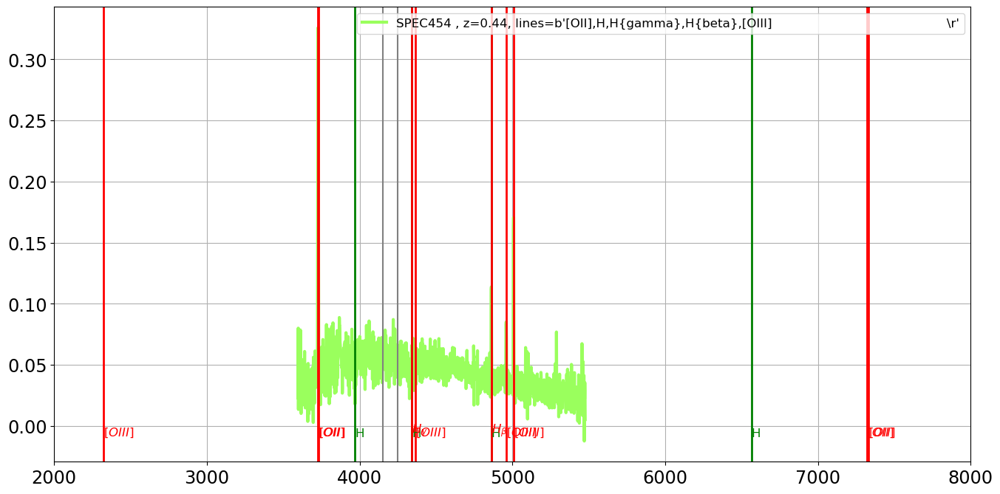

===================== SED 296 : SPEC455 , z=0.12, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


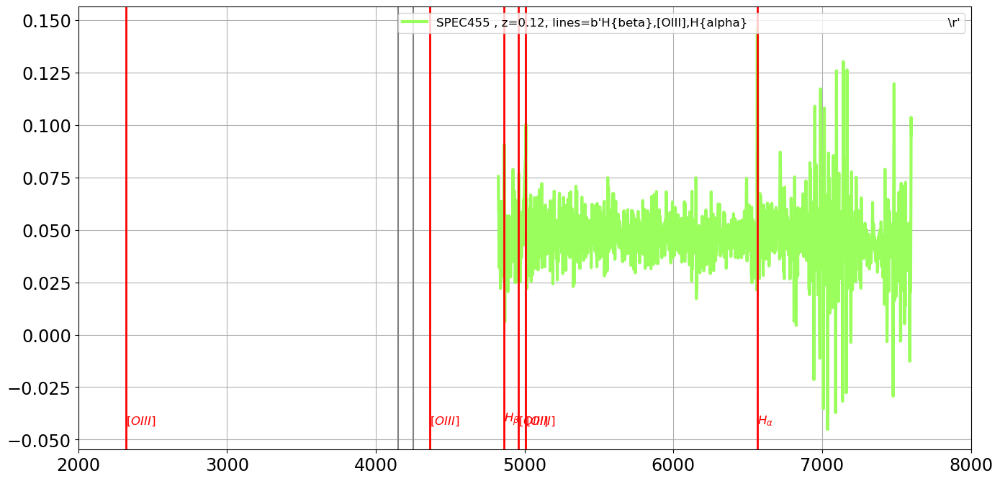

===================== SED 297 : SPEC456 , z=0.44, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


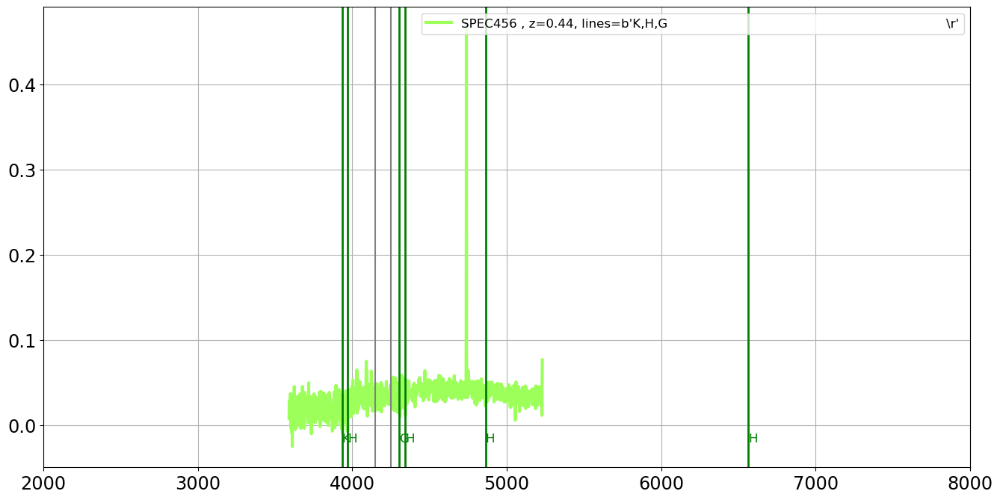

===================== SED 298 : SPEC457 , z=0.45, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


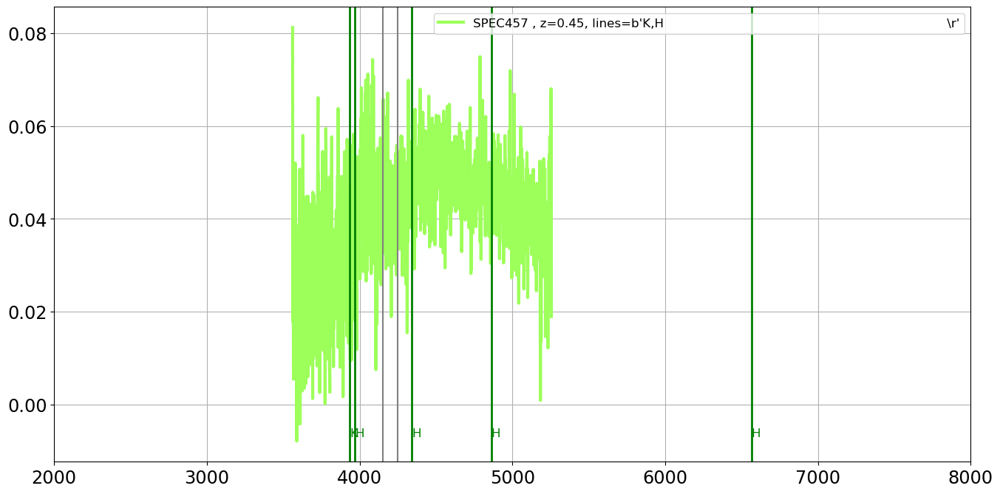

===================== SED 299 : SPEC458 , z=0.53, lines=b'[OII],H,H{beta},[OIII]                                                      \r'=======================
the_lines =  b'[OII],H,H{beta},[OIII]                                                      \r'
[OII]
H
H{beta}
[OIII]


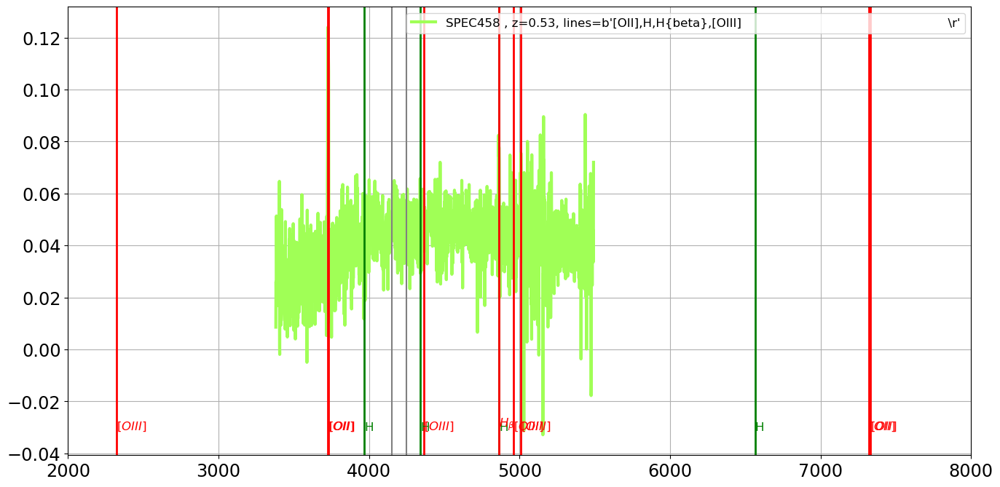

===================== SED 300 : SPEC459 , z=0.45, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


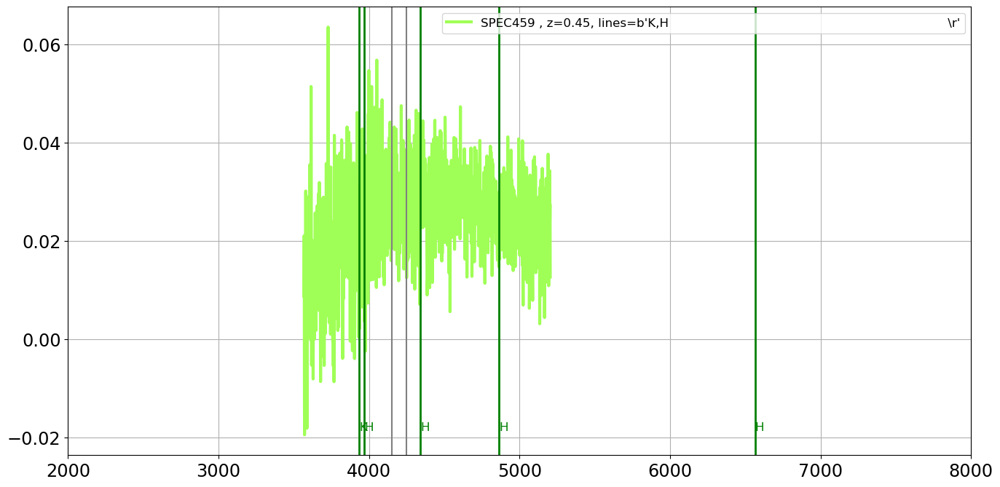

===================== SED 301 : SPEC460 , z=0.69, lines=b'[OII],H10,H9,H8,K,H,H{delta}                                                \r'=======================
the_lines =  b'[OII],H10,H9,H8,K,H,H{delta}                                                \r'
[OII]
H10
H9
H8
K
H
H{delta}


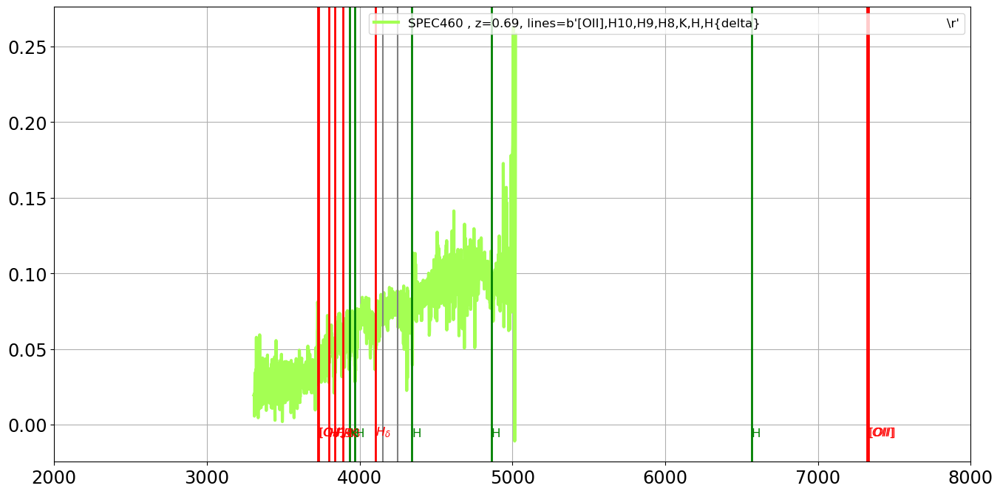

===================== SED 302 : SPEC461 , z=0.14, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


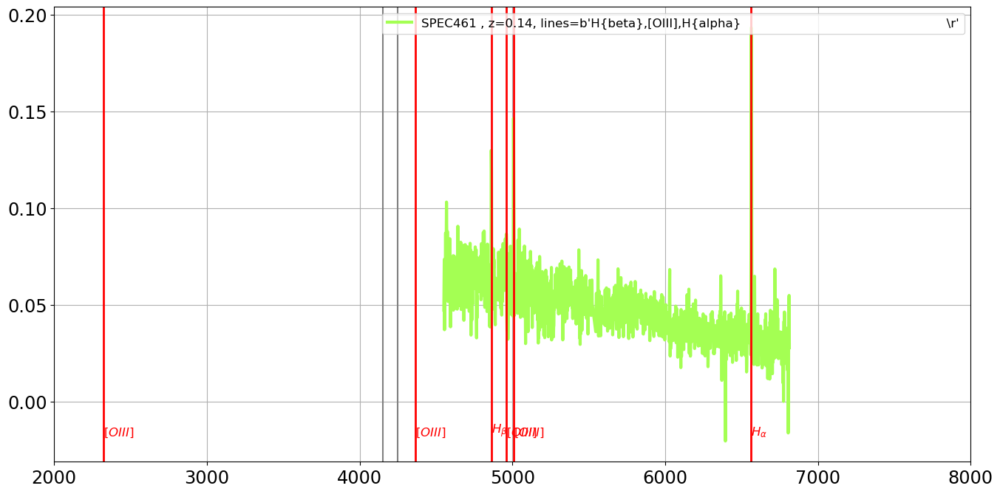

===================== SED 303 : SPEC462 , z=0.92, lines=b'H9,H8,K,H{delta}                                                            \r'=======================
the_lines =  b'H9,H8,K,H{delta}                                                            \r'
H9
H8
K
H{delta}


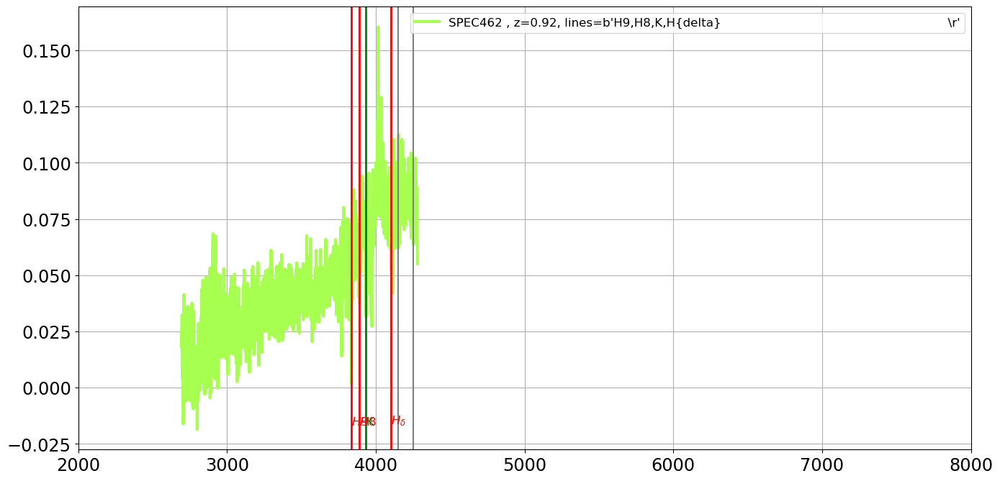

===================== SED 304 : SPEC463 , z=0.48, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


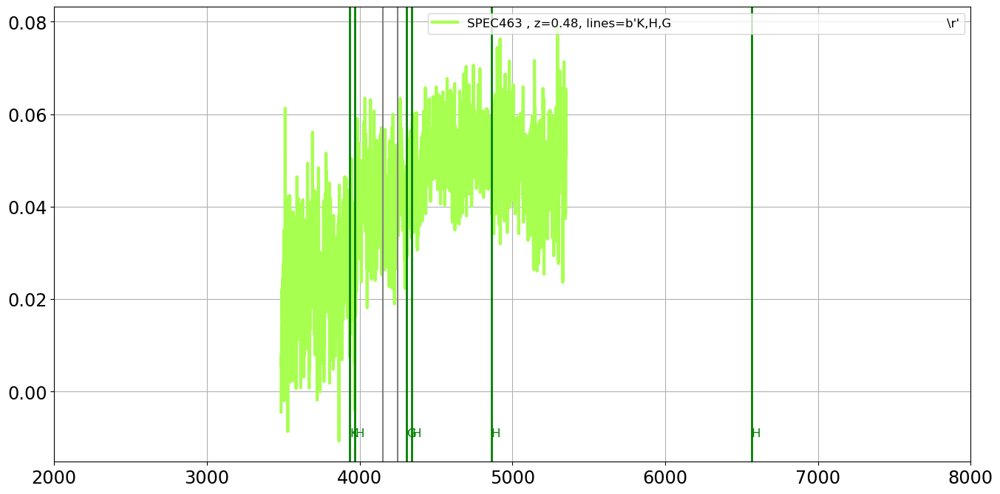

===================== SED 305 : SPEC464 , z=0.54, lines=b'[OII],K,H,H{beta}                                                           \r'=======================
the_lines =  b'[OII],K,H,H{beta}                                                           \r'
[OII]
K
H
H{beta}


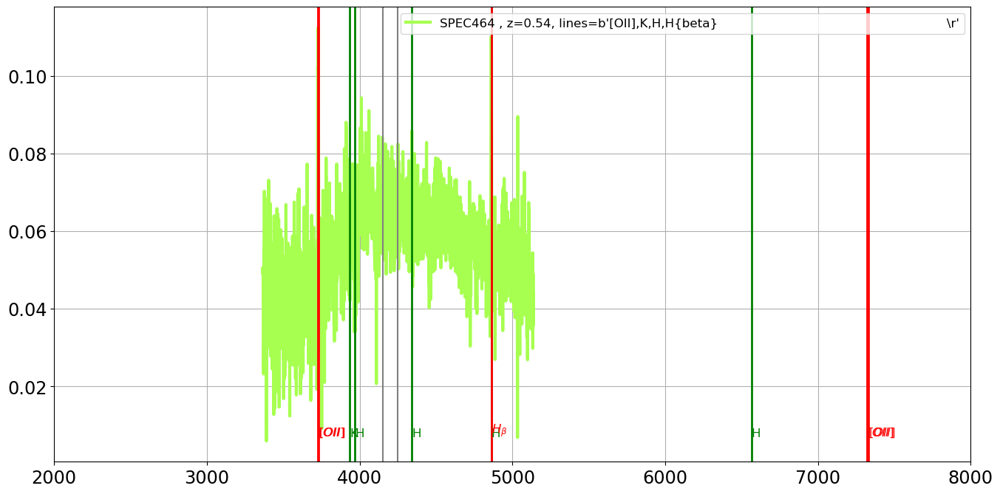

===================== SED 306 : SPEC465 , z=0.12, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


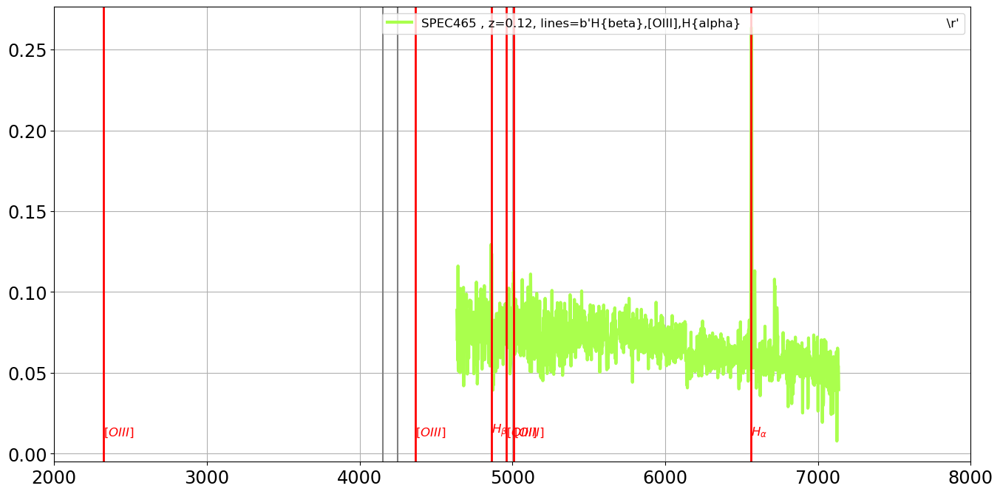

===================== SED 307 : SPEC466 , z=0.45, lines=b'[OII],K,H,H{beta},[OIII]                                                    \r'=======================
the_lines =  b'[OII],K,H,H{beta},[OIII]                                                    \r'
[OII]
K
H
H{beta}
[OIII]


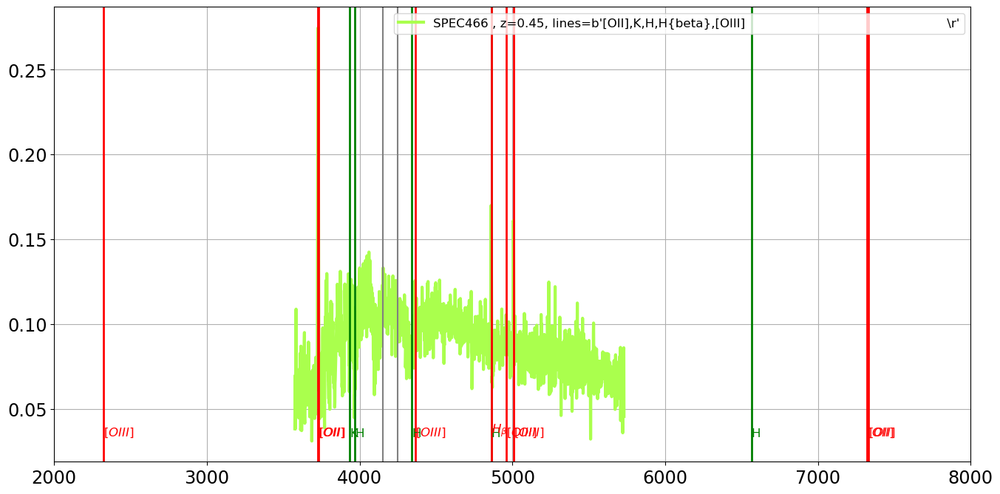

===================== SED 308 : SPEC467 , z=0.35, lines=b'H{beta},[OIII]                                                              \r'=======================
the_lines =  b'H{beta},[OIII]                                                              \r'
H{beta}
[OIII]


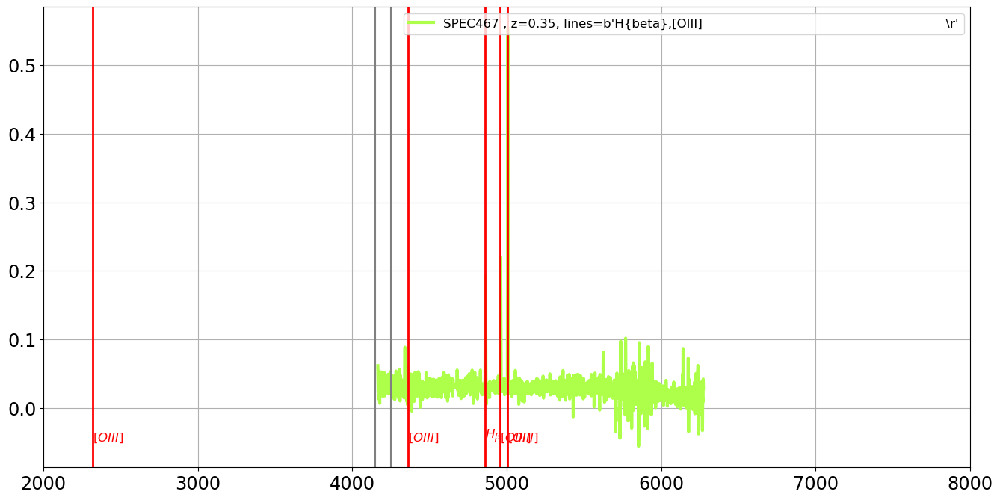

===================== SED 309 : SPEC468 , z=0.45, lines=b'H{beta},[OIII]                                                              \r'=======================
the_lines =  b'H{beta},[OIII]                                                              \r'
H{beta}
[OIII]


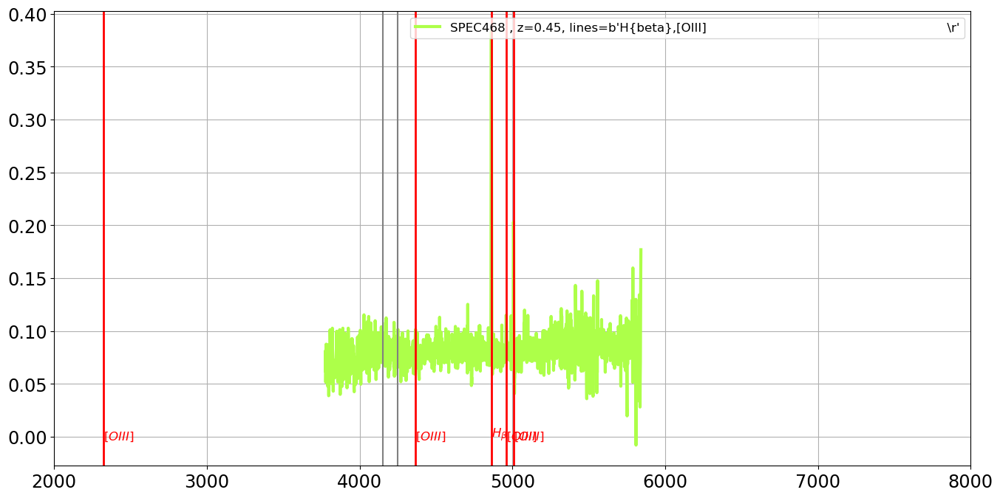

===================== SED 310 : SPEC469 , z=0.45, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


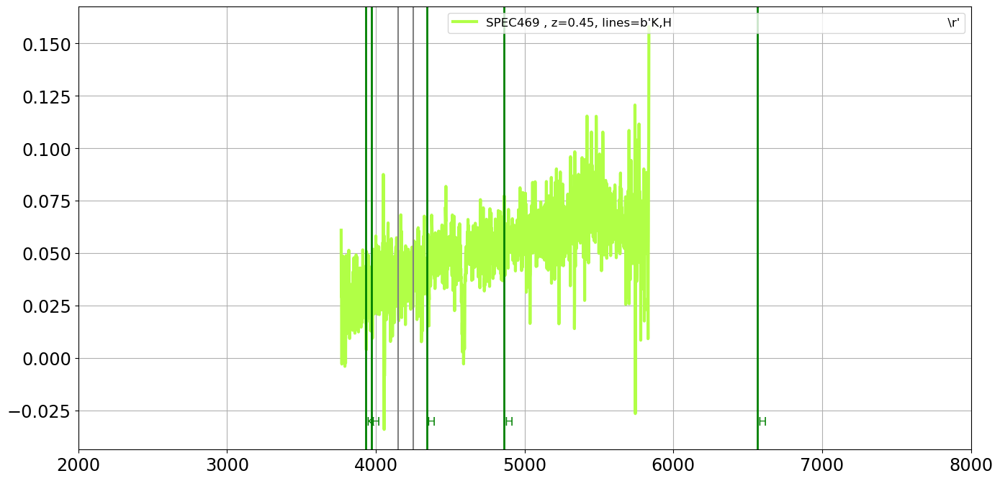

===================== SED 311 : SPEC470 , z=0.43, lines=b'H{gamma},H{beta},[OIII]                                                     \r'=======================
the_lines =  b'H{gamma},H{beta},[OIII]                                                     \r'
H{gamma}
H{beta}
[OIII]


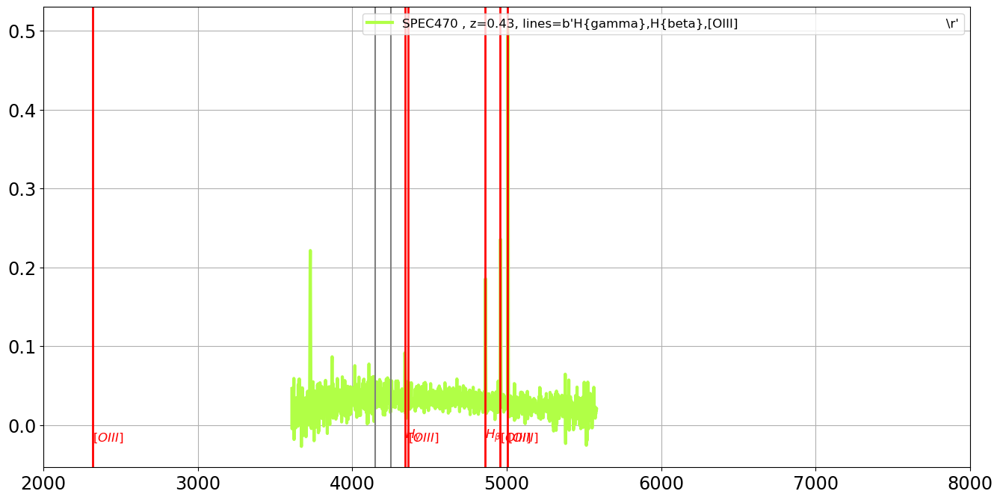

===================== SED 312 : SPEC471 , z=0.50, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


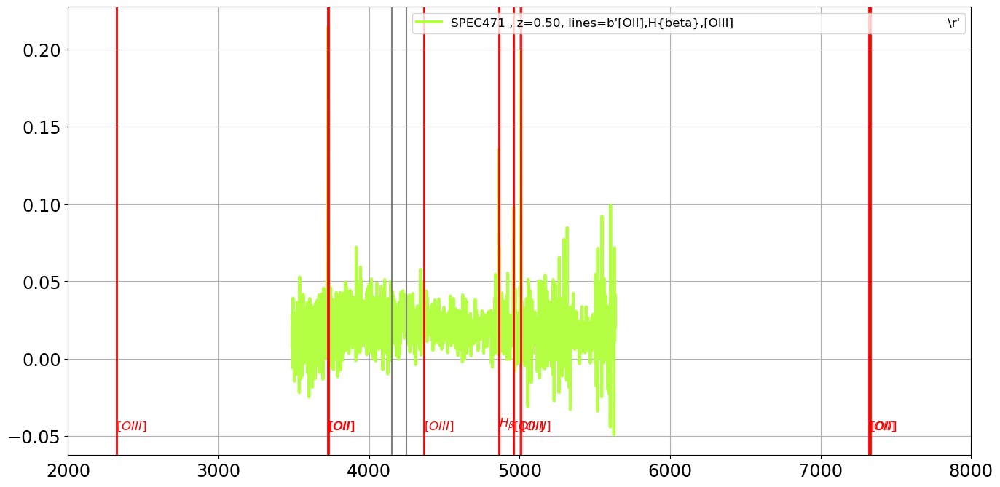

===================== SED 313 : SPEC472 , z=0.50, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


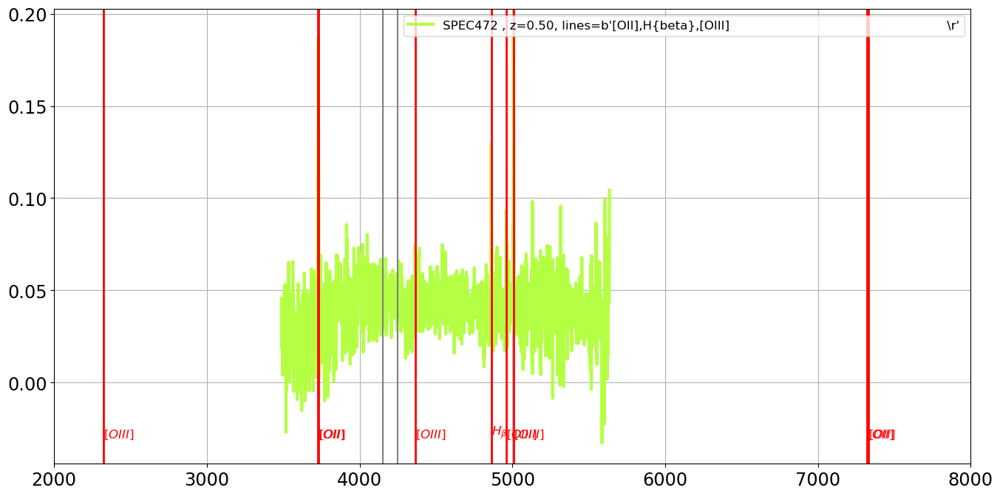

===================== SED 314 : SPEC474 , z=0.29, lines=b'H{beta},[OIII]                                                              \r'=======================
the_lines =  b'H{beta},[OIII]                                                              \r'
H{beta}
[OIII]


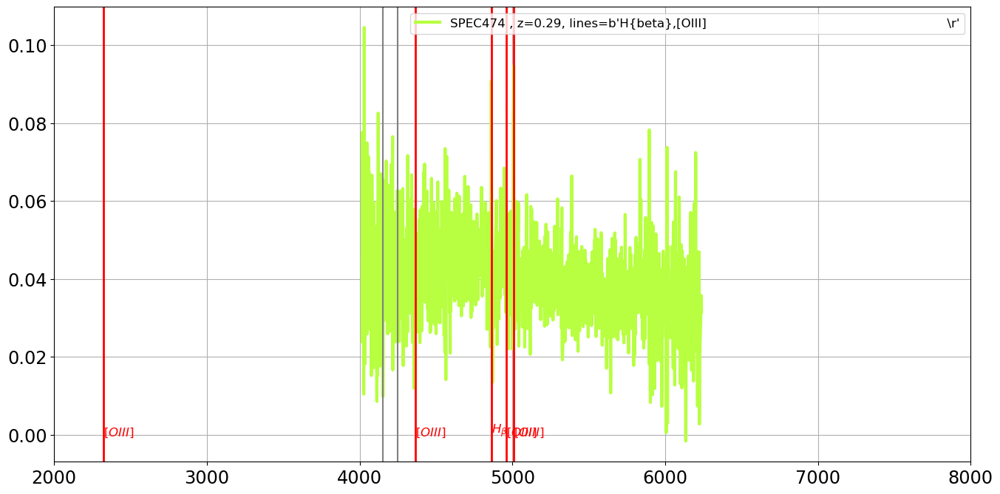

===================== SED 315 : SPEC475 , z=0.50, lines=b'H{gamma},H{beta},[OIII]                                                     \r'=======================
the_lines =  b'H{gamma},H{beta},[OIII]                                                     \r'
H{gamma}
H{beta}
[OIII]


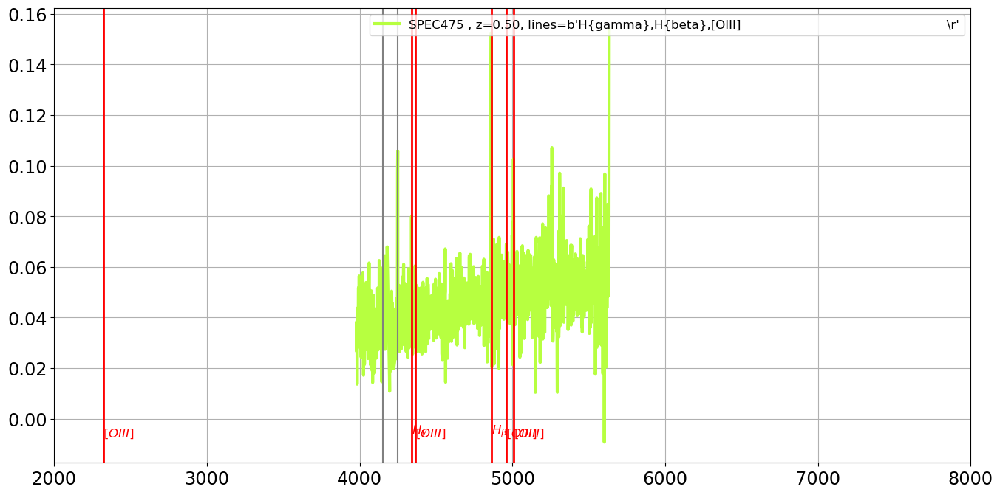

===================== SED 316 : SPEC476 , z=0.22, lines=b'[OIII],H{alpha}                                                             \r'=======================
the_lines =  b'[OIII],H{alpha}                                                             \r'
[OIII]
H{alpha}


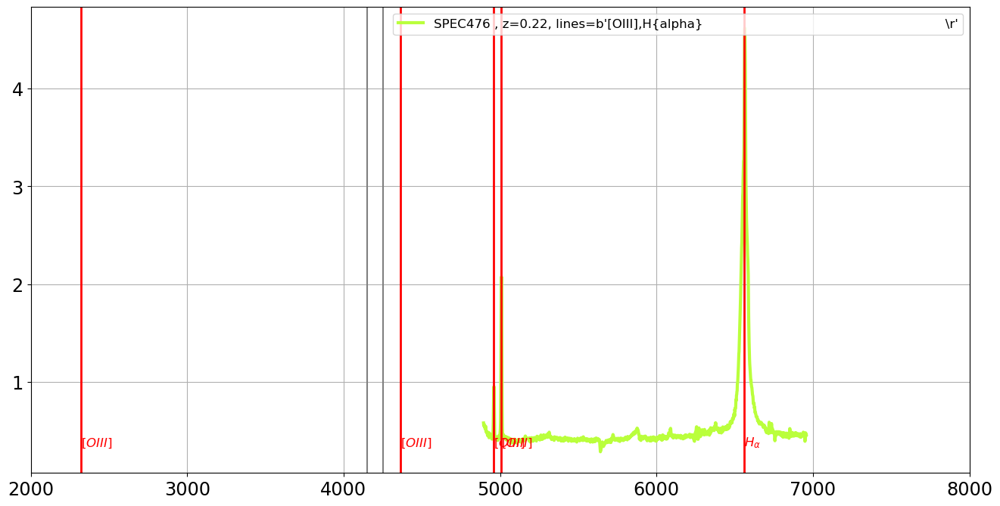

===================== SED 317 : SPEC477 , z=0.12, lines=b'H{beta},H{alpha}                                                            \r'=======================
the_lines =  b'H{beta},H{alpha}                                                            \r'
H{beta}
H{alpha}


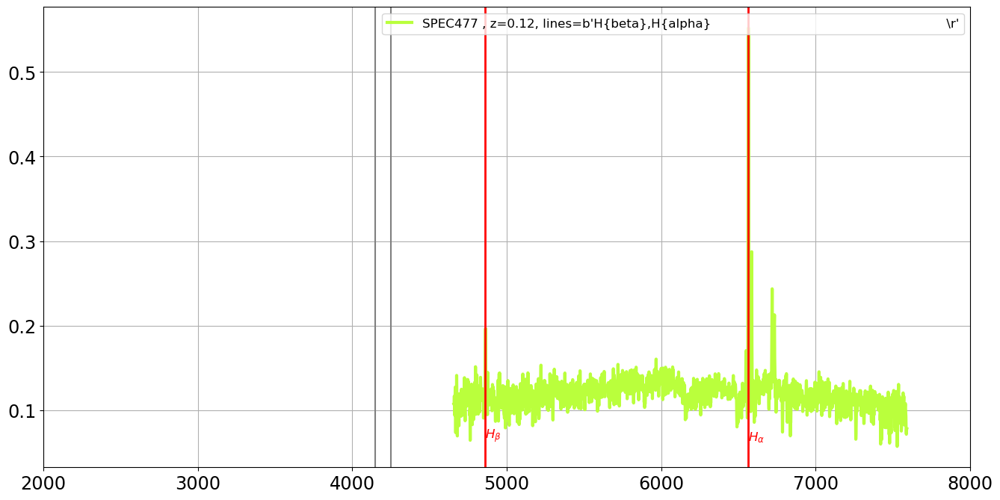

===================== SED 318 : SPEC478 , z=0.35, lines=b'H{beta},[OIII]                                                              \r'=======================
the_lines =  b'H{beta},[OIII]                                                              \r'
H{beta}
[OIII]


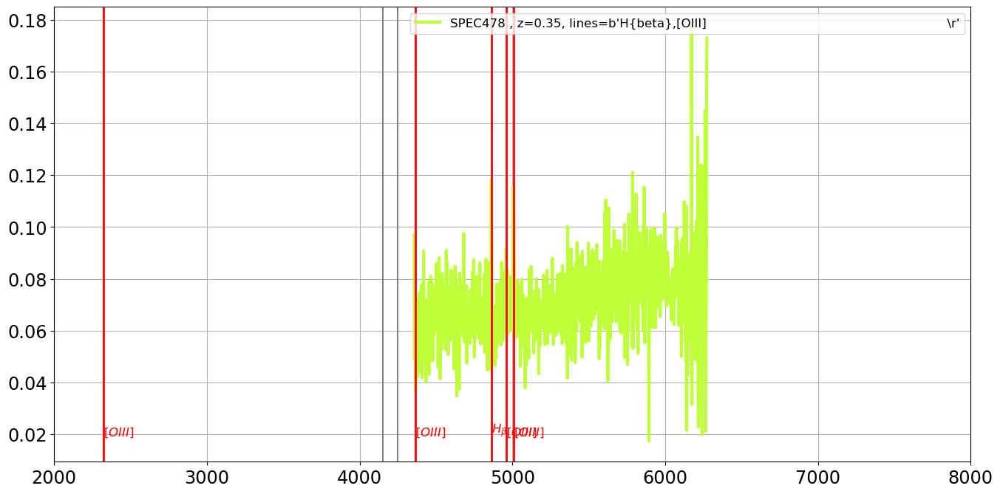

===================== SED 319 : SPEC479 , z=0.60, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


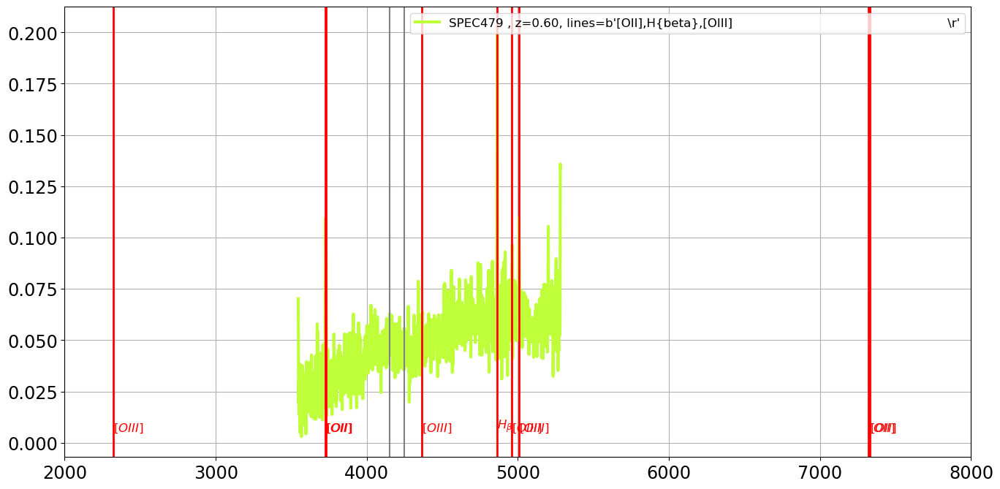

===================== SED 320 : SPEC480 , z=0.45, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


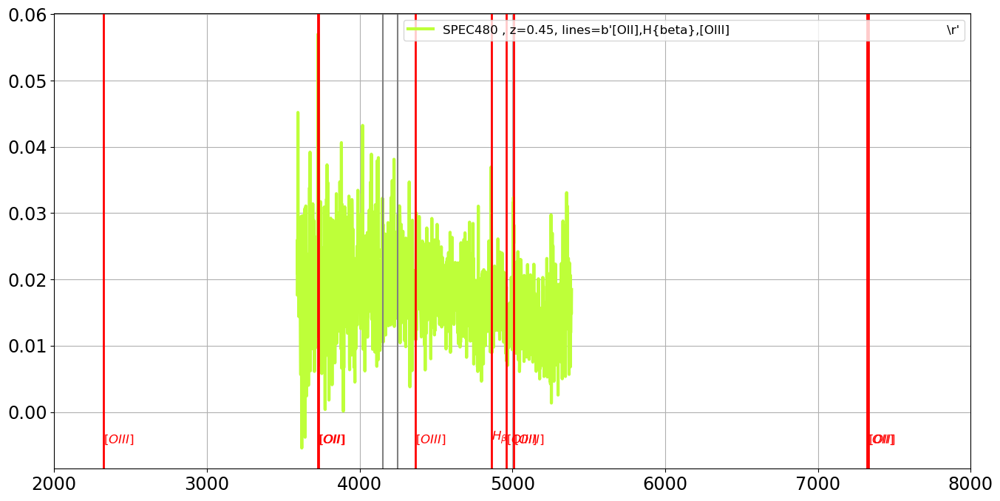

===================== SED 321 : SPEC481 , z=0.77, lines=b'[OII],H9,H8,K,H,H{delta}                                                    \r'=======================
the_lines =  b'[OII],H9,H8,K,H,H{delta}                                                    \r'
[OII]
H9
H8
K
H
H{delta}


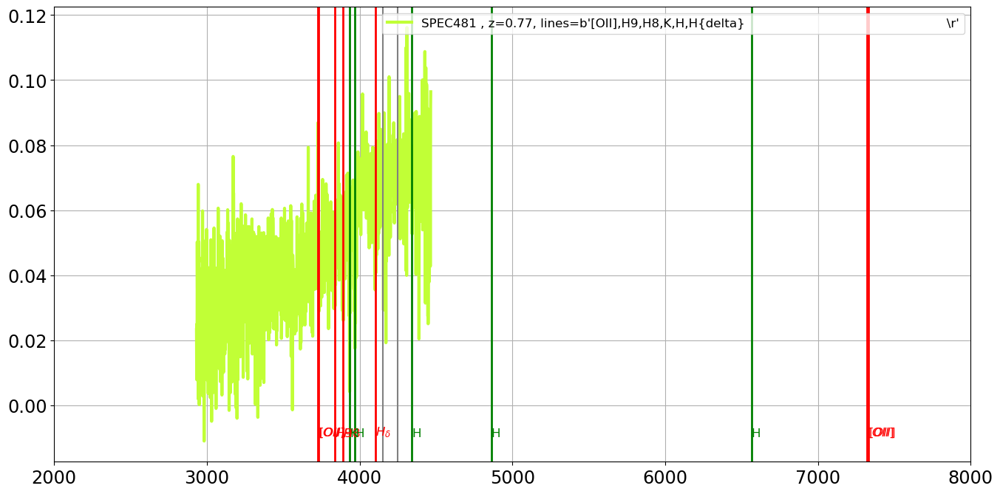

===================== SED 322 : SPEC482 , z=0.45, lines=b'[OII],K,H,H{beta}                                                           \r'=======================
the_lines =  b'[OII],K,H,H{beta}                                                           \r'
[OII]
K
H
H{beta}


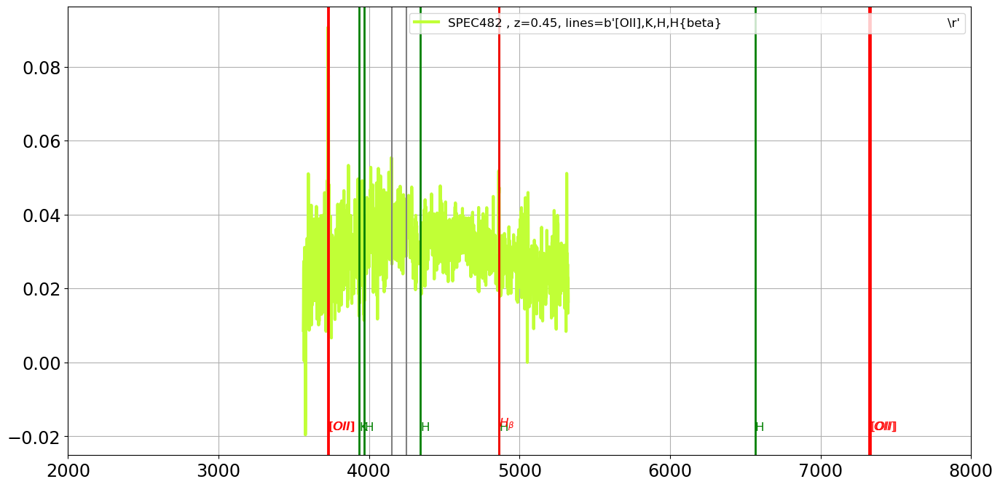

===================== SED 323 : SPEC483 , z=0.33, lines=b'H{beta},[OIII]                                                              \r'=======================
the_lines =  b'H{beta},[OIII]                                                              \r'
H{beta}
[OIII]


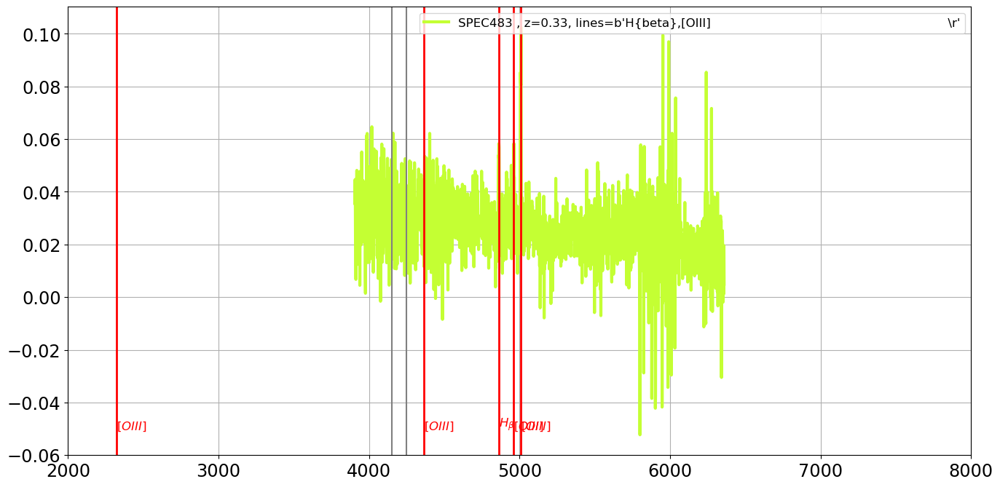

===================== SED 324 : SPEC488 , z=0.12, lines=b'H{beta},Mgb,NaD                                                             \r'=======================
the_lines =  b'H{beta},Mgb,NaD                                                             \r'
H{beta}
Mgb
NaD


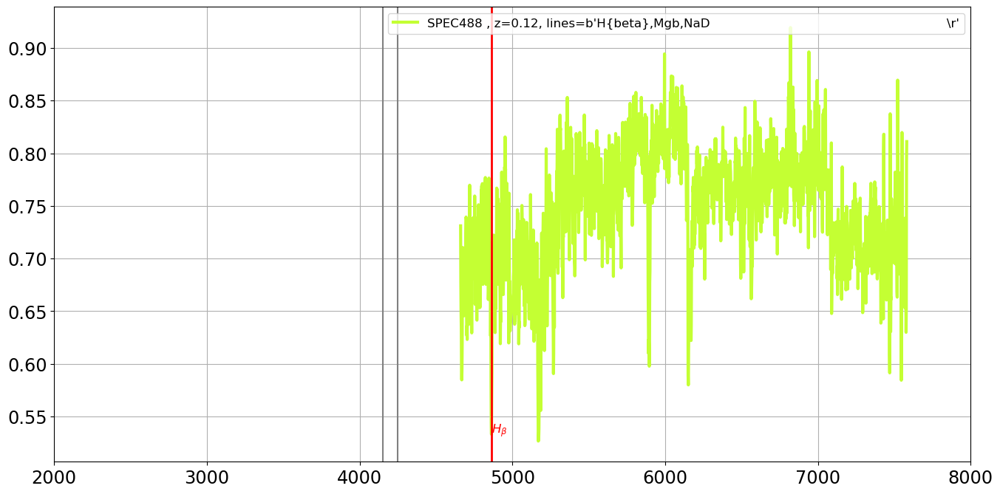

===================== SED 325 : SPEC490 , z=0.29, lines=b'G,Fe43,Fe45,H{beta},Mgb,E                                                   \r'=======================
the_lines =  b'G,Fe43,Fe45,H{beta},Mgb,E                                                   \r'
G
Fe43
Fe45
H{beta}
Mgb
E


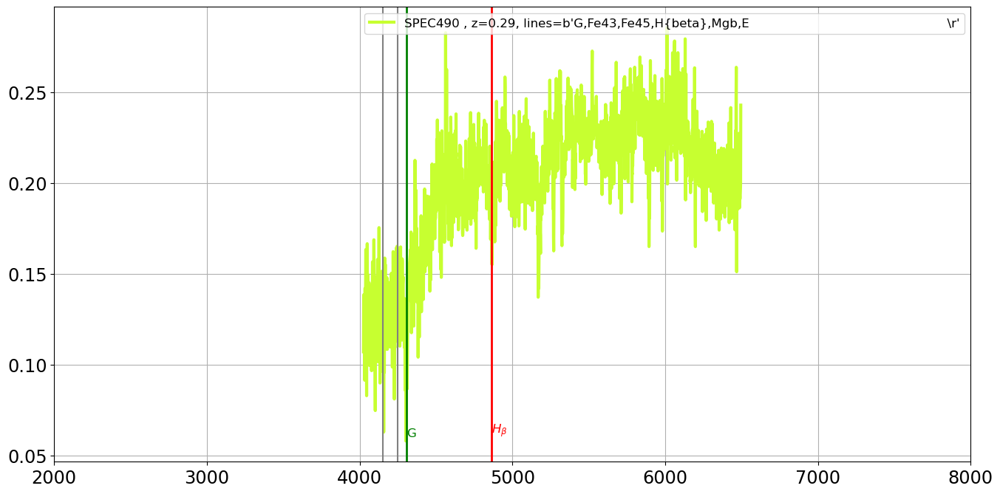

===================== SED 326 : SPEC492 , z=0.29, lines=b'G,Fe43,Fe45,H{beta},Mgb,E                                                   \r'=======================
the_lines =  b'G,Fe43,Fe45,H{beta},Mgb,E                                                   \r'
G
Fe43
Fe45
H{beta}
Mgb
E


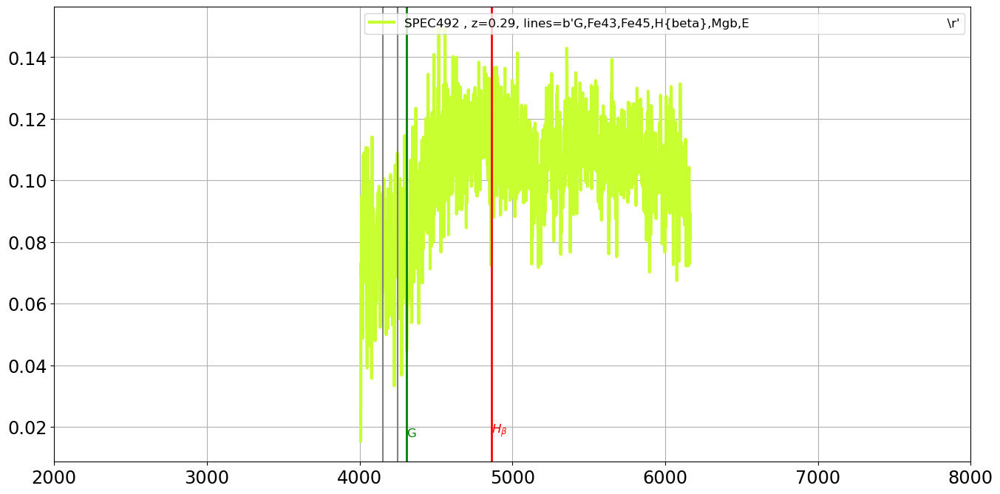

===================== SED 327 : SPEC493 , z=0.29, lines=b'G,Fe43,Ca44,Fe45,H{beta},Mgb,E                                              \r'=======================
the_lines =  b'G,Fe43,Ca44,Fe45,H{beta},Mgb,E                                              \r'
G
Fe43
Ca44
Fe45
H{beta}
Mgb
E


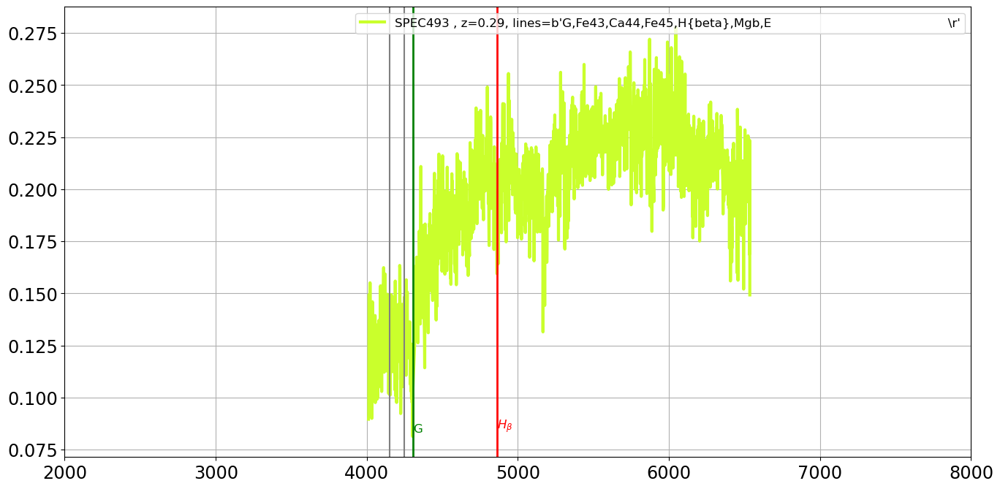

===================== SED 328 : SPEC494 , z=0.29, lines=b'G,Fe43,Fe45,H{beta},Mgb,E                                                   \r'=======================
the_lines =  b'G,Fe43,Fe45,H{beta},Mgb,E                                                   \r'
G
Fe43
Fe45
H{beta}
Mgb
E


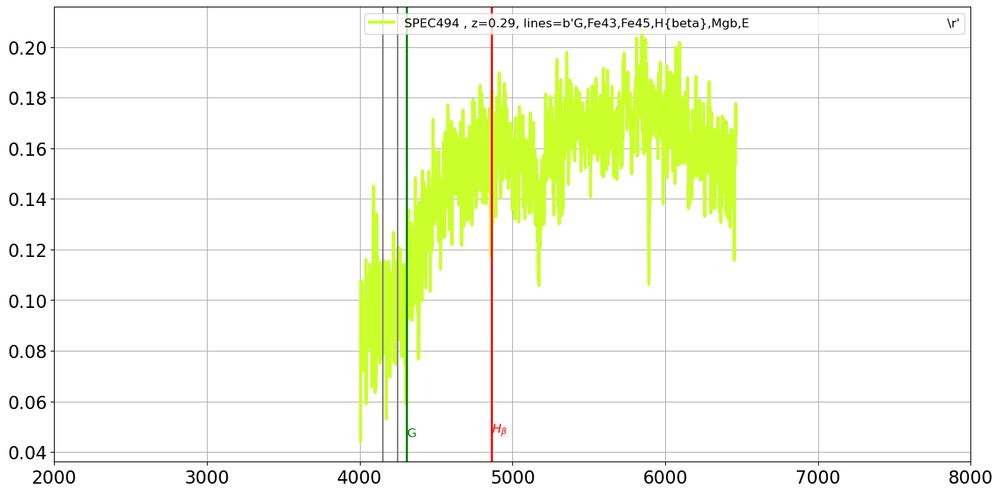

===================== SED 329 : SPEC496 , z=0.29, lines=b'G,Fe45,H{beta},Mgb,E                                                        \r'=======================
the_lines =  b'G,Fe45,H{beta},Mgb,E                                                        \r'
G
Fe45
H{beta}
Mgb
E


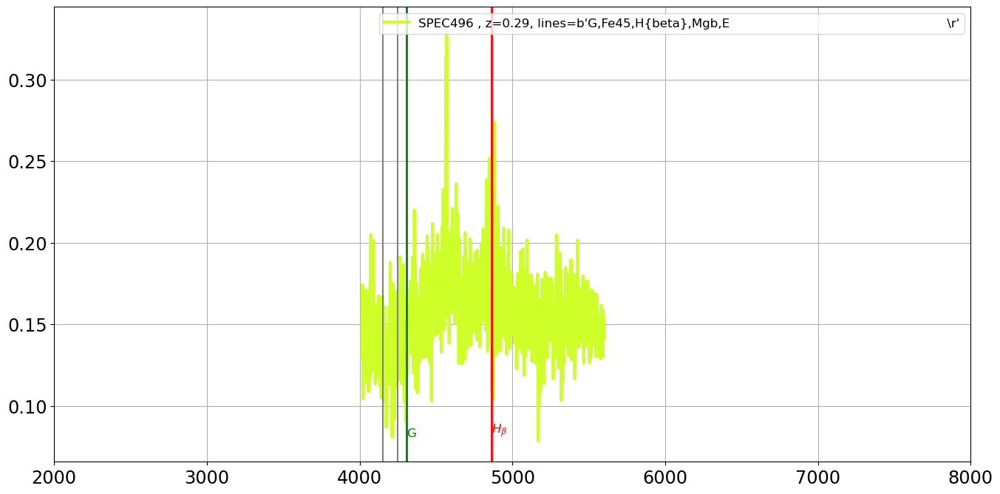

===================== SED 330 : SPEC497 , z=0.29, lines=b'G,Fe43,Ca44,Fe45,H{beta},Mgb,E                                              \r'=======================
the_lines =  b'G,Fe43,Ca44,Fe45,H{beta},Mgb,E                                              \r'
G
Fe43
Ca44
Fe45
H{beta}
Mgb
E


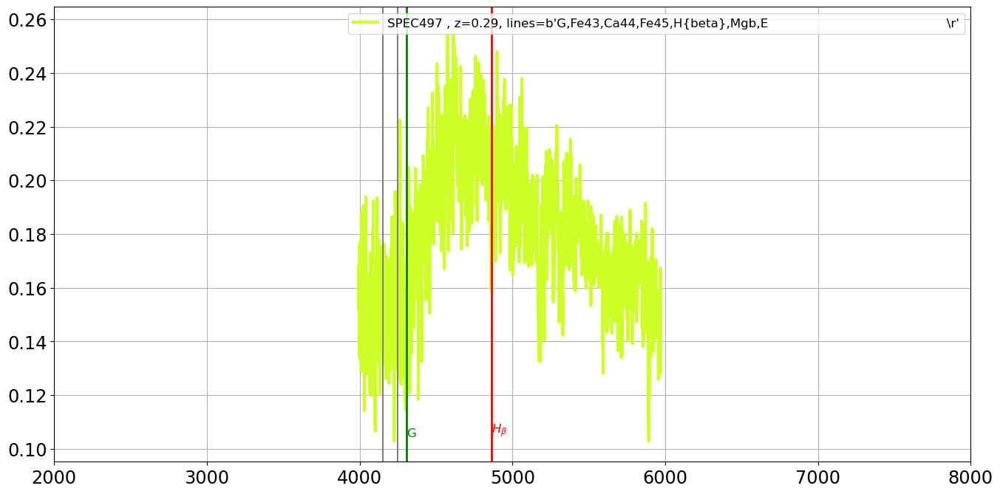

===================== SED 331 : SPEC499 , z=0.42, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


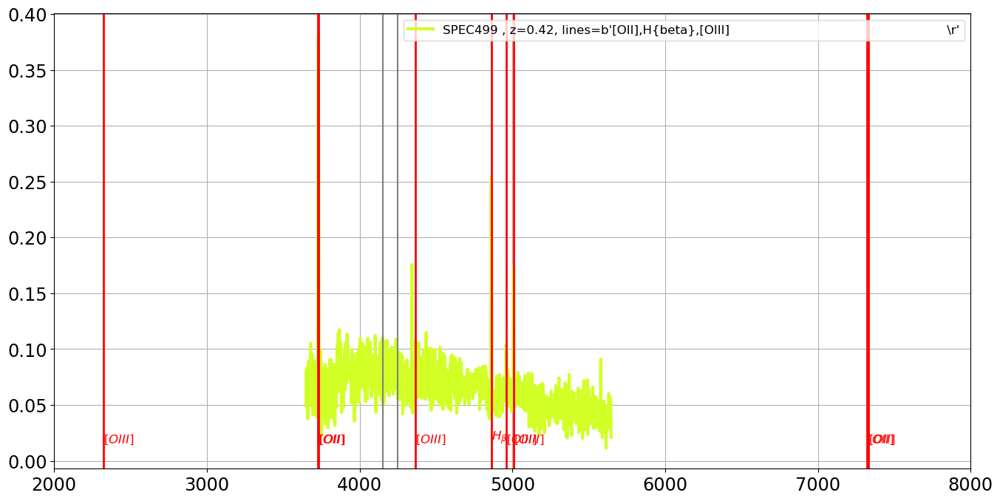

===================== SED 332 : SPEC500 , z=0.29, lines=b'H{delta},Fe45,H{beta},Mgb,E                                                 \r'=======================
the_lines =  b'H{delta},Fe45,H{beta},Mgb,E                                                 \r'
H{delta}
Fe45
H{beta}
Mgb
E


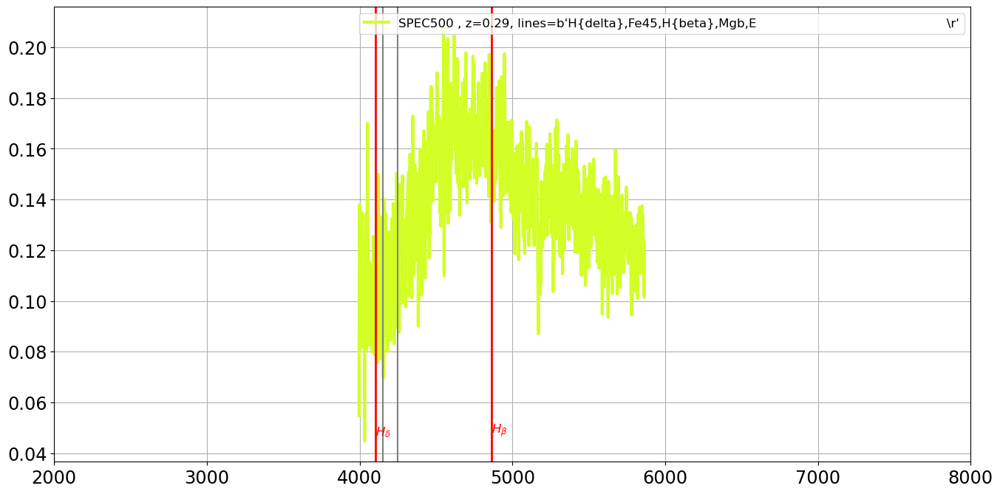

===================== SED 333 : SPEC501 , z=0.29, lines=b'H{beta},Mgb,E                                                               \r'=======================
the_lines =  b'H{beta},Mgb,E                                                               \r'
H{beta}
Mgb
E


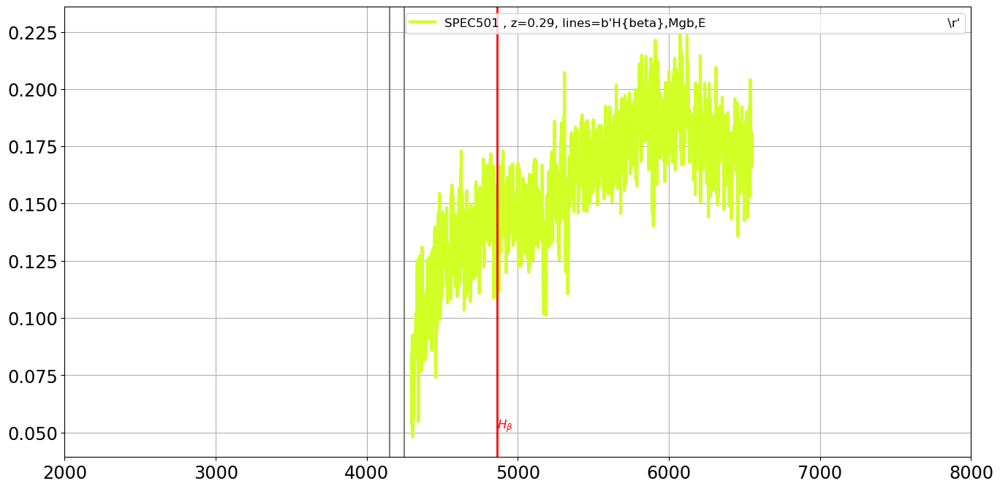

===================== SED 334 : SPEC503 , z=0.29, lines=b'Mgb,E                                                                       \r'=======================
the_lines =  b'Mgb,E                                                                       \r'
Mgb
E


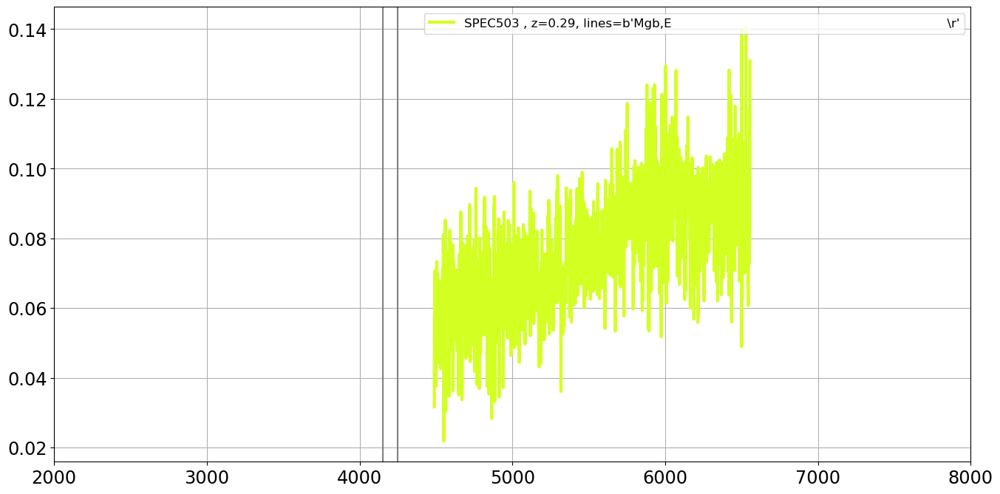

===================== SED 335 : SPEC504 , z=0.29, lines=b'H{beta},Mgb,E                                                               \r'=======================
the_lines =  b'H{beta},Mgb,E                                                               \r'
H{beta}
Mgb
E


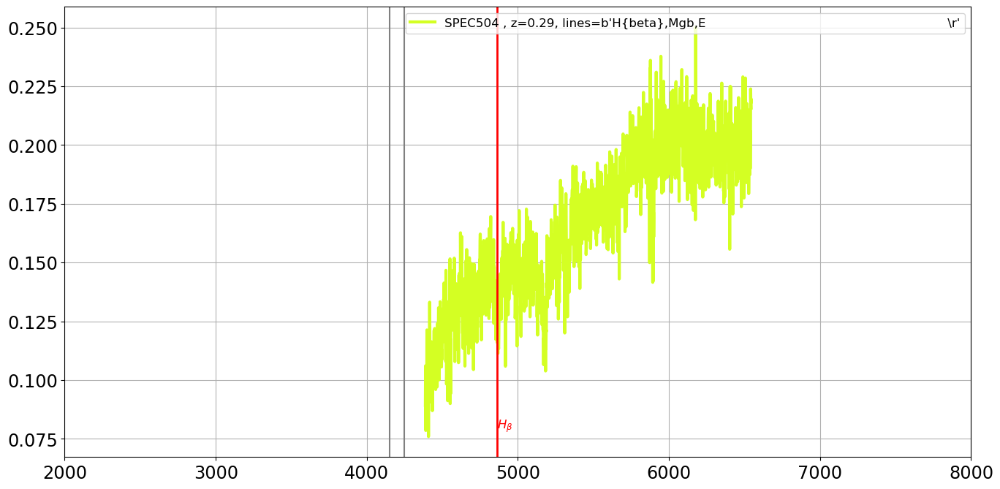

===================== SED 336 : SPEC505 , z=0.69, lines=b'[OII],K,H,H{beta}                                                           \r'=======================
the_lines =  b'[OII],K,H,H{beta}                                                           \r'
[OII]
K
H
H{beta}


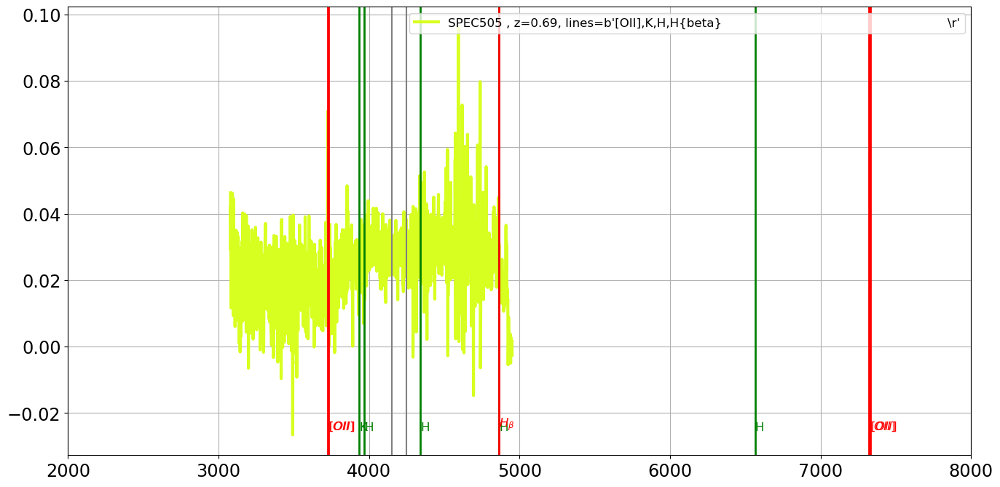

===================== SED 337 : SPEC506 , z=0.29, lines=b'H{delta},H,K,G,Mgb                                                          \r'=======================
the_lines =  b'H{delta},H,K,G,Mgb                                                          \r'
H{delta}
H
K
G
Mgb


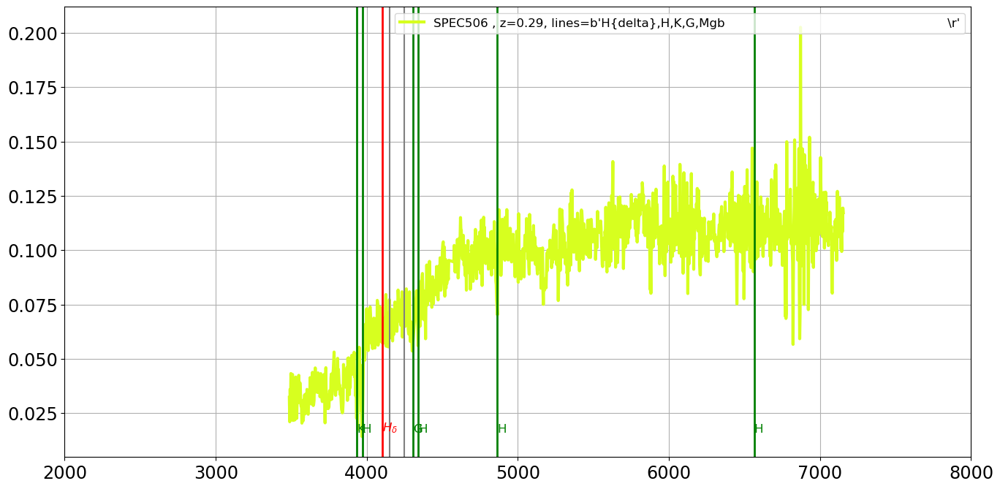

===================== SED 338 : SPEC507 , z=0.45, lines=b'[OII],H                                                                     \r'=======================
the_lines =  b'[OII],H                                                                     \r'
[OII]
H


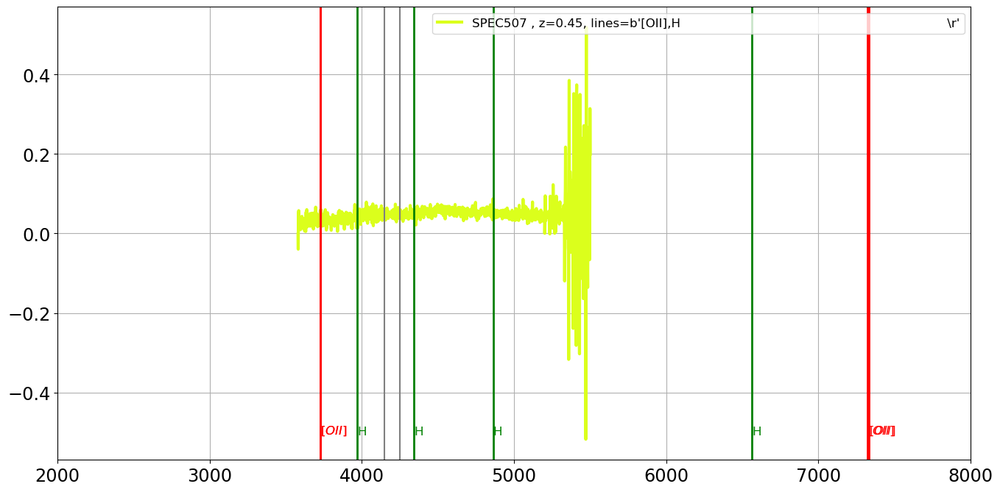

===================== SED 339 : SPEC508 , z=0.45, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


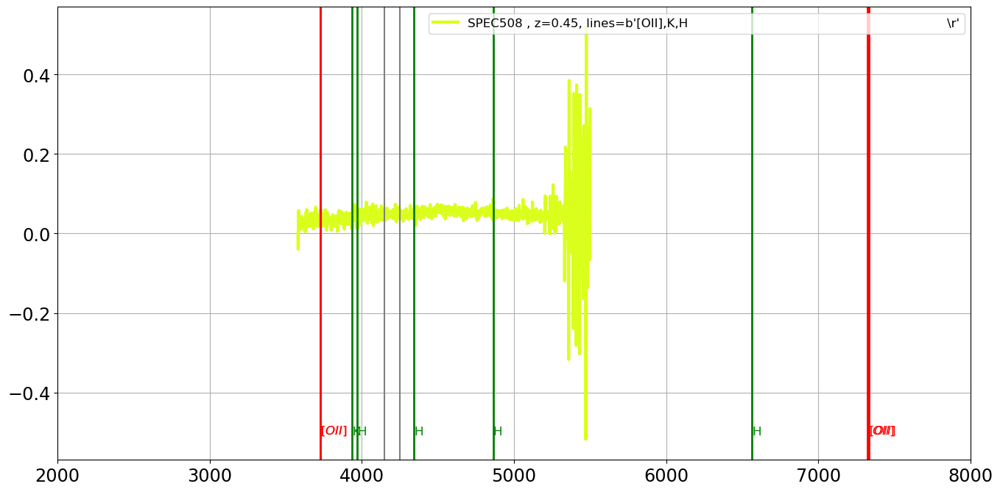

===================== SED 340 : SPEC509 , z=0.29, lines=b'G,Fe43,Fe45,H{beta},Mgb                                                     \r'=======================
the_lines =  b'G,Fe43,Fe45,H{beta},Mgb                                                     \r'
G
Fe43
Fe45
H{beta}
Mgb


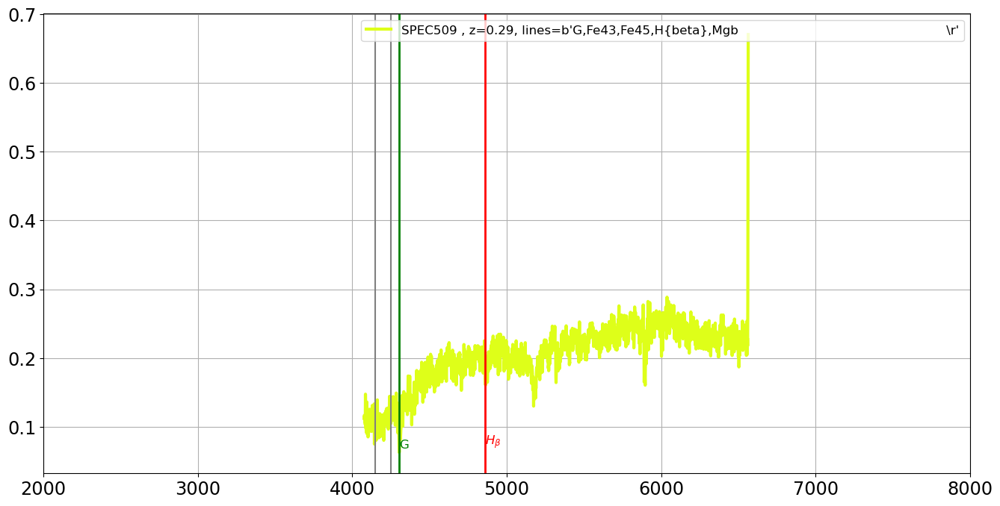

===================== SED 341 : SPEC510 , z=0.29, lines=b'Fe43,Fe45,H{beta},Mgb                                                       \r'=======================
the_lines =  b'Fe43,Fe45,H{beta},Mgb                                                       \r'
Fe43
Fe45
H{beta}
Mgb


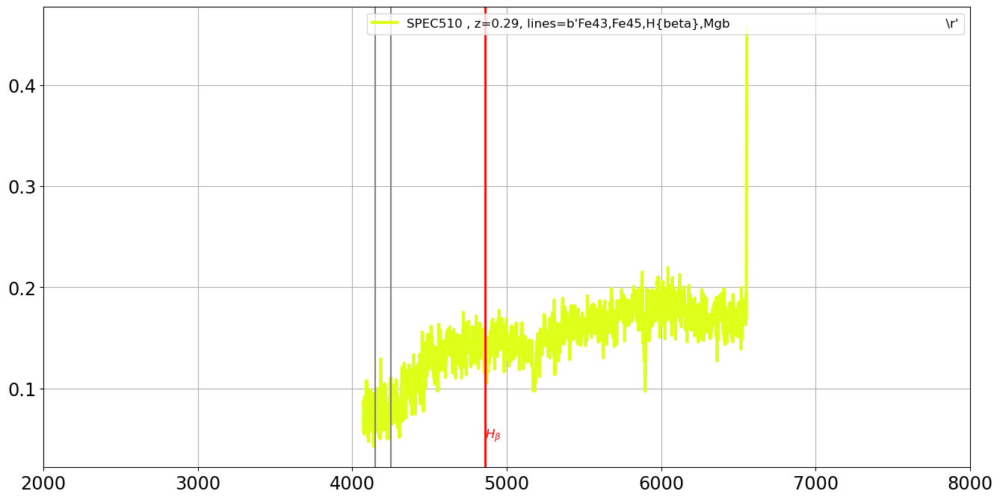

===================== SED 342 : SPEC511 , z=0.29, lines=b'H{beta},Mgb                                                                 \r'=======================
the_lines =  b'H{beta},Mgb                                                                 \r'
H{beta}
Mgb


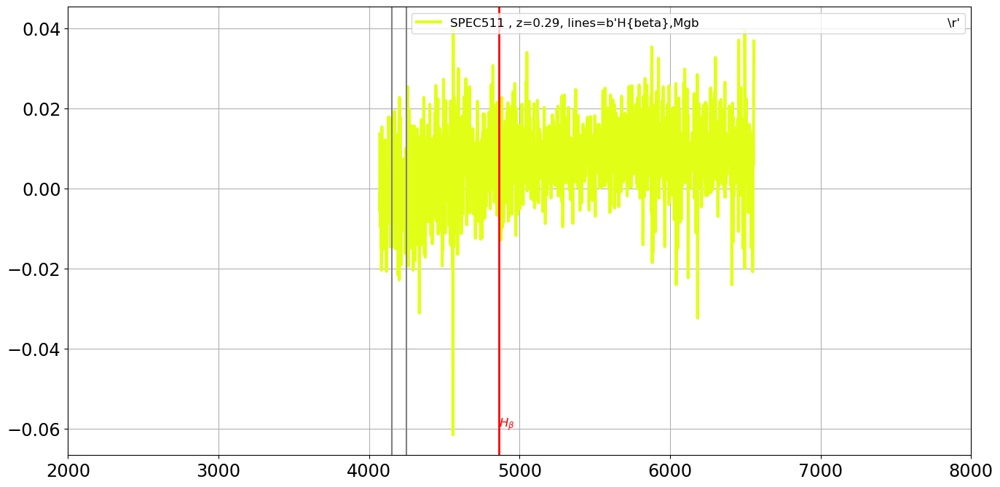

===================== SED 343 : SPEC512 , z=0.29, lines=b'G,Fe43,Fe45,H{beta},Mgb,E                                                   \r'=======================
the_lines =  b'G,Fe43,Fe45,H{beta},Mgb,E                                                   \r'
G
Fe43
Fe45
H{beta}
Mgb
E


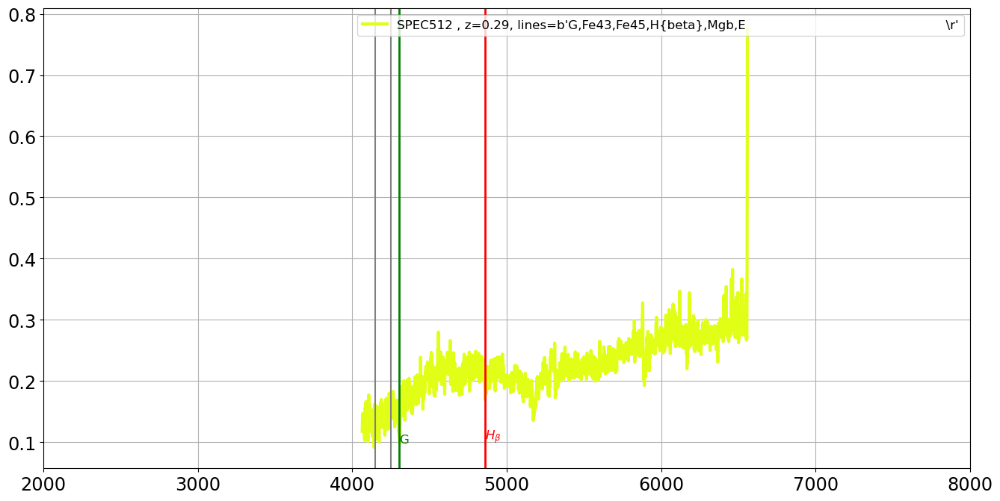

===================== SED 344 : SPEC513 , z=0.29, lines=b'G,H{beta},Mgb,E                                                             \r'=======================
the_lines =  b'G,H{beta},Mgb,E                                                             \r'
G
H{beta}
Mgb
E


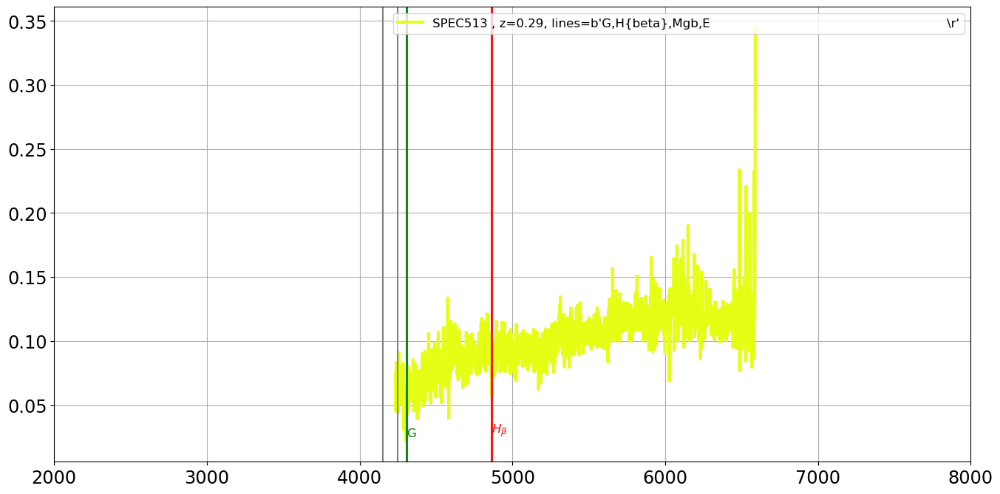

===================== SED 345 : SPEC516 , z=0.07, lines=b'                                                                            \r'=======================
the_lines =  b'                                                                            \r'



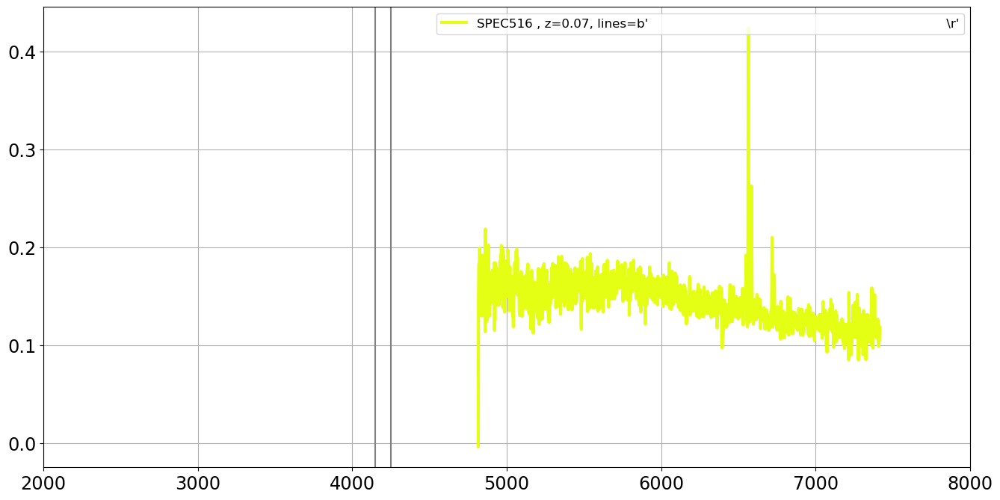

===================== SED 346 : SPEC517 , z=0.18, lines=b'H{beta},Mgb,NaD                                                             \r'=======================
the_lines =  b'H{beta},Mgb,NaD                                                             \r'
H{beta}
Mgb
NaD


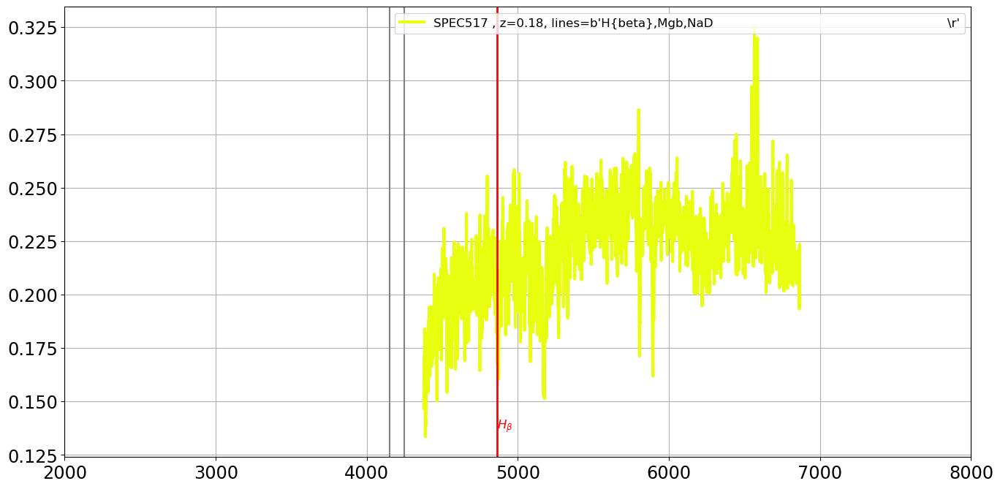

===================== SED 347 : SPEC518 , z=0.29, lines=b'G,Fe43,Fe45,H{beta},Mgb                                                     \r'=======================
the_lines =  b'G,Fe43,Fe45,H{beta},Mgb                                                     \r'
G
Fe43
Fe45
H{beta}
Mgb


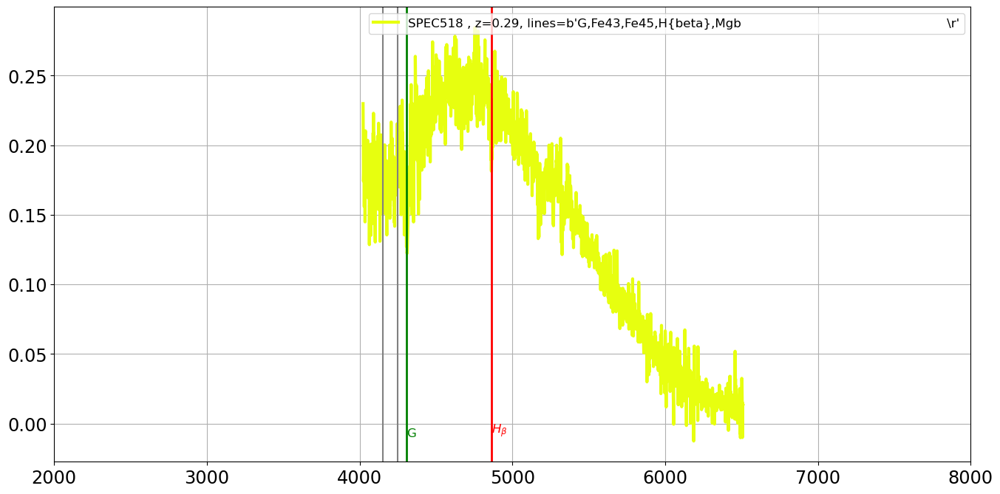

===================== SED 348 : SPEC519 , z=0.45, lines=b'K,H,G,Fe43,Fe45,H{beta},Mgb                                                 \r'=======================
the_lines =  b'K,H,G,Fe43,Fe45,H{beta},Mgb                                                 \r'
K
H
G
Fe43
Fe45
H{beta}
Mgb


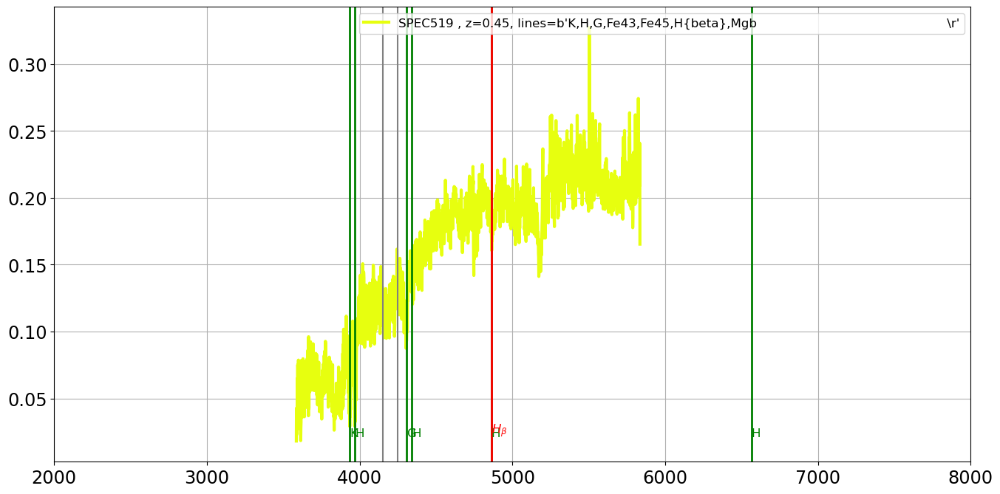

===================== SED 349 : SPEC520 , z=0.45, lines=b'G,Fe43,Fe45,H{beta},Mgb                                                     \r'=======================
the_lines =  b'G,Fe43,Fe45,H{beta},Mgb                                                     \r'
G
Fe43
Fe45
H{beta}
Mgb


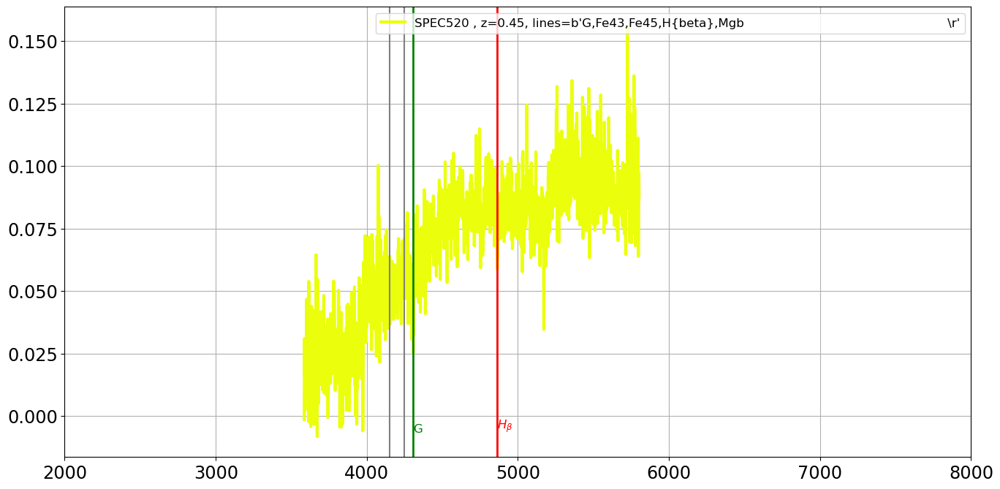

===================== SED 350 : SPEC523 , z=0.45, lines=b'H,G,Fe43,H{beta},Mgb                                                        \r'=======================
the_lines =  b'H,G,Fe43,H{beta},Mgb                                                        \r'
H
G
Fe43
H{beta}
Mgb


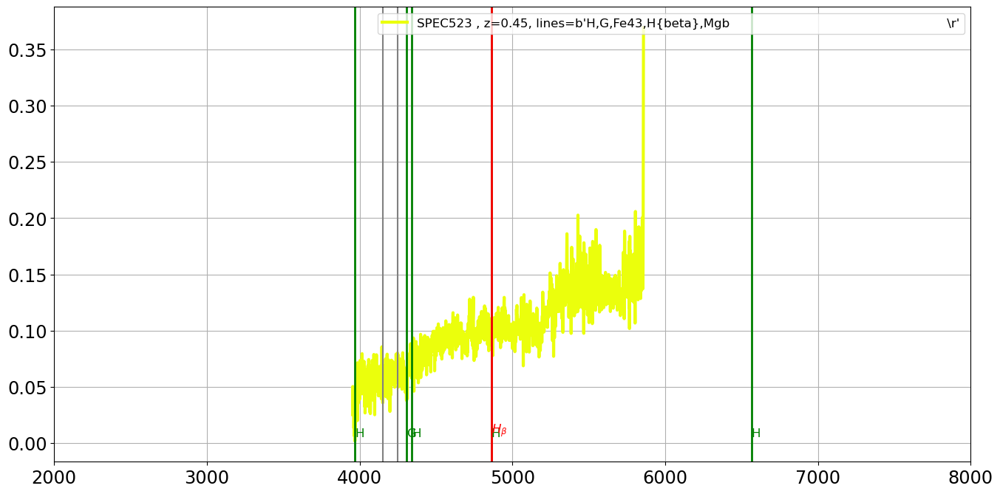

===================== SED 351 : SPEC524 , z=0.69, lines=b'K,H,4000{AA}-break                                                          \r'=======================
the_lines =  b'K,H,4000{AA}-break                                                          \r'
K
H
4000{AA}-break


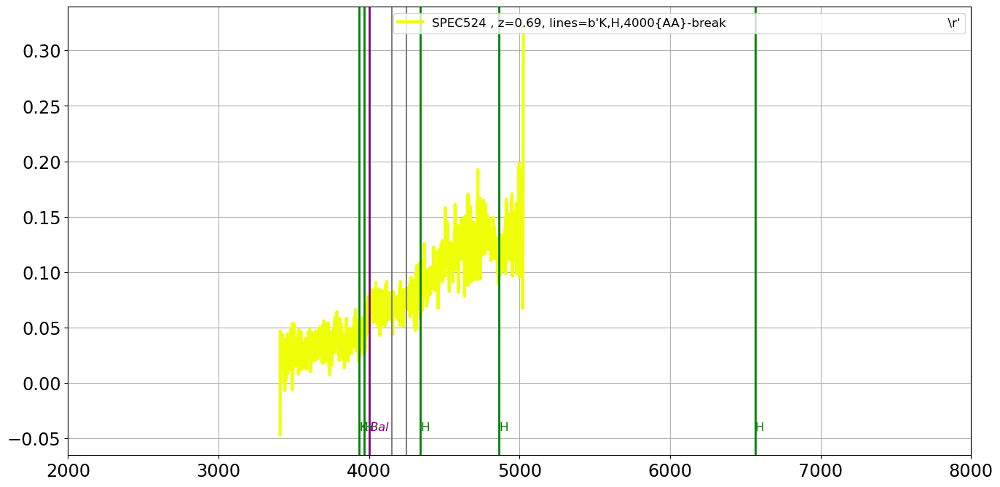

===================== SED 352 : SPEC525 , z=0.39, lines=b'[OII],K,H,G,H{beta}                                                         \r'=======================
the_lines =  b'[OII],K,H,G,H{beta}                                                         \r'
[OII]
K
H
G
H{beta}


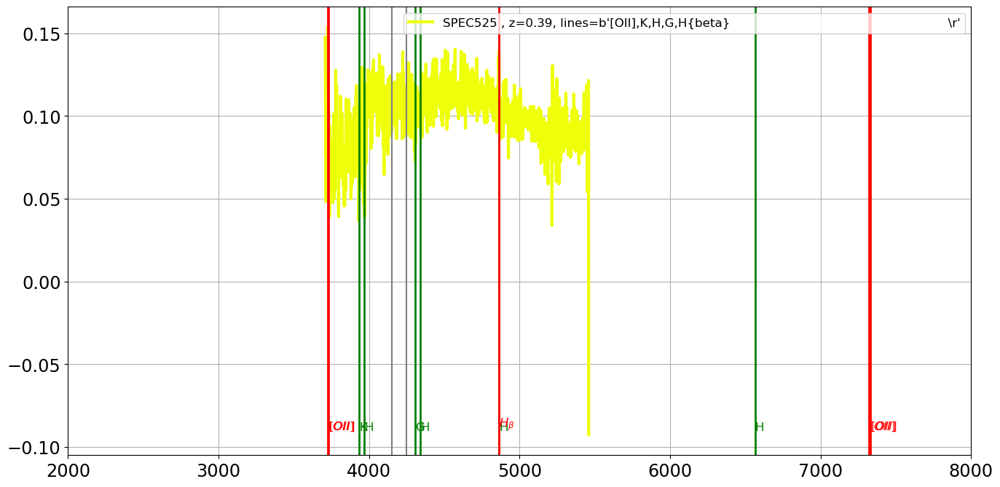

===================== SED 353 : SPEC526 , z=0.45, lines=b'G,Fe43,H{beta},Mgb                                                          \r'=======================
the_lines =  b'G,Fe43,H{beta},Mgb                                                          \r'
G
Fe43
H{beta}
Mgb


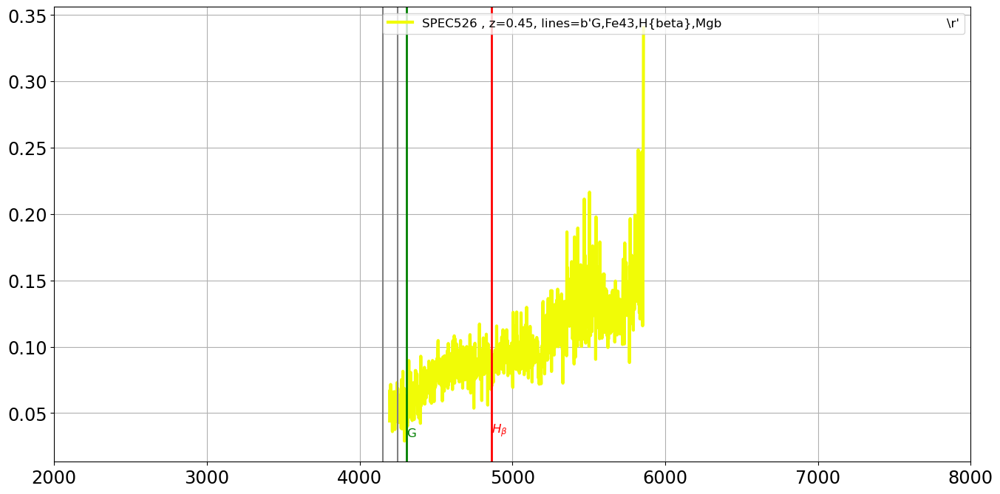

===================== SED 354 : SPEC527 , z=0.45, lines=b'K,H,H{beta},[OIII]                                                          \r'=======================
the_lines =  b'K,H,H{beta},[OIII]                                                          \r'
K
H
H{beta}
[OIII]


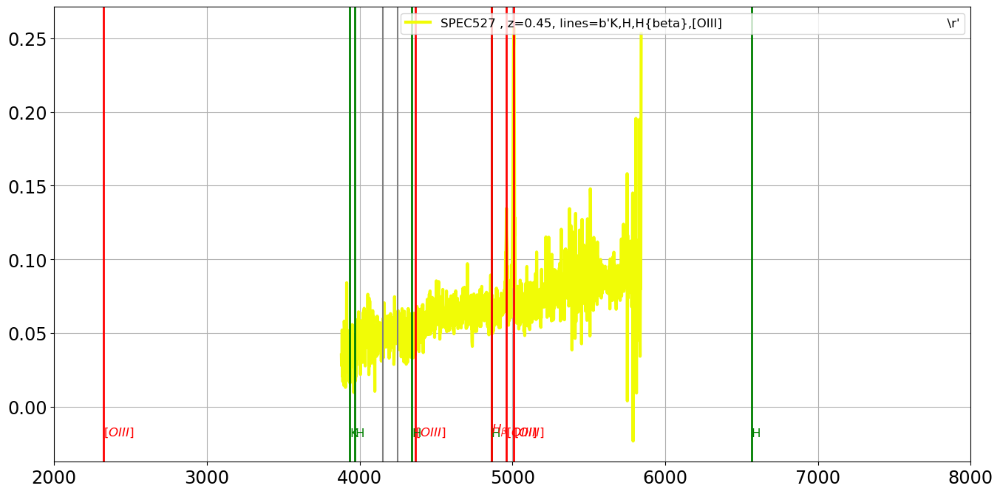

===================== SED 355 : SPEC528 , z=0.63, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


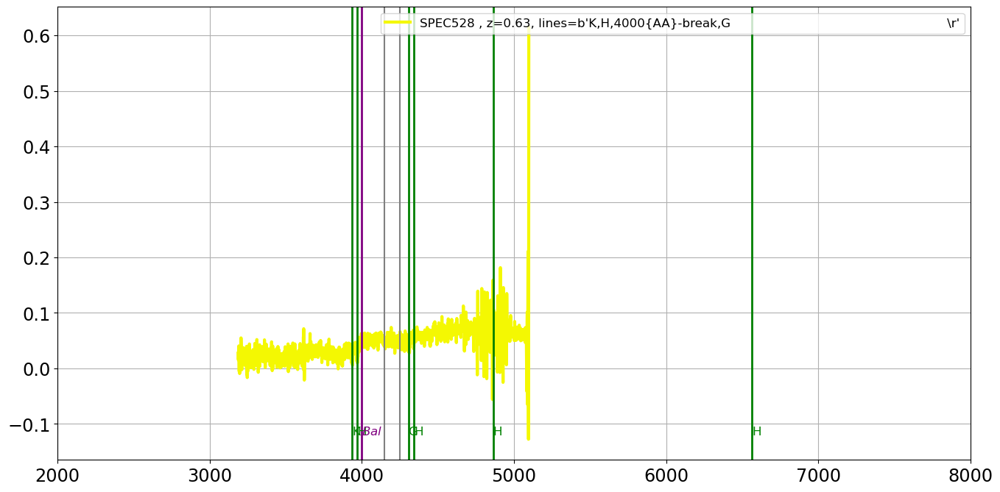

===================== SED 356 : SPEC529 , z=0.44, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


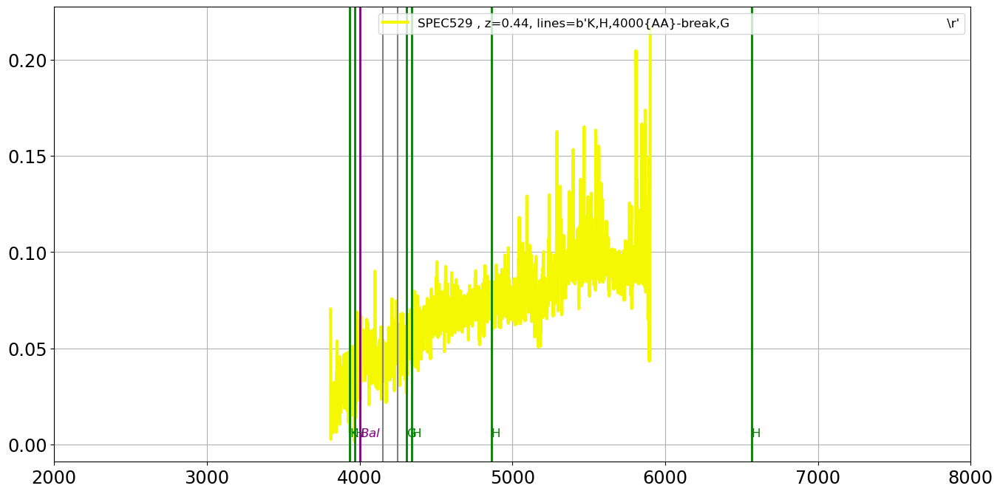

===================== SED 357 : SPEC530 , z=0.45, lines=b'K,H,G,Mgb                                                                   \r'=======================
the_lines =  b'K,H,G,Mgb                                                                   \r'
K
H
G
Mgb


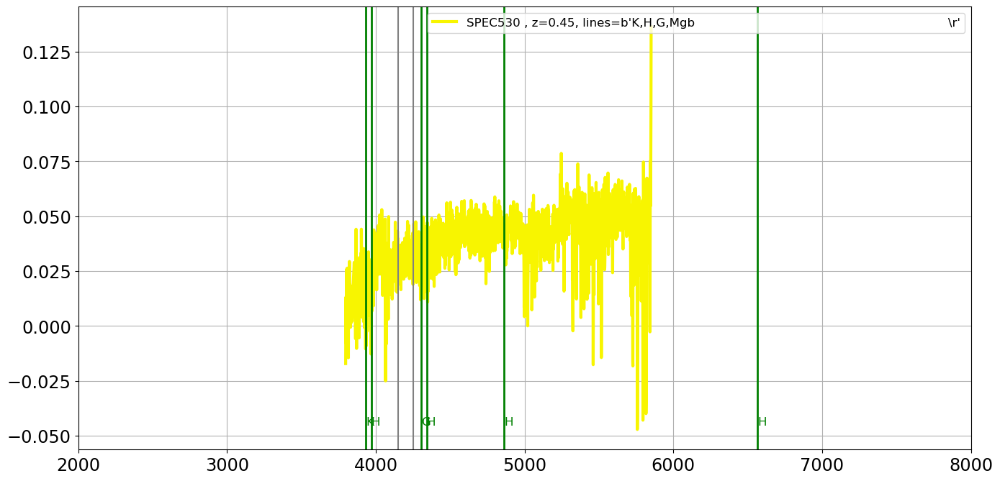

===================== SED 358 : SPEC531 , z=0.82, lines=b'MgII,[OII],H9,H8                                                            \r'=======================
the_lines =  b'MgII,[OII],H9,H8                                                            \r'
MgII
[OII]
H9
H8


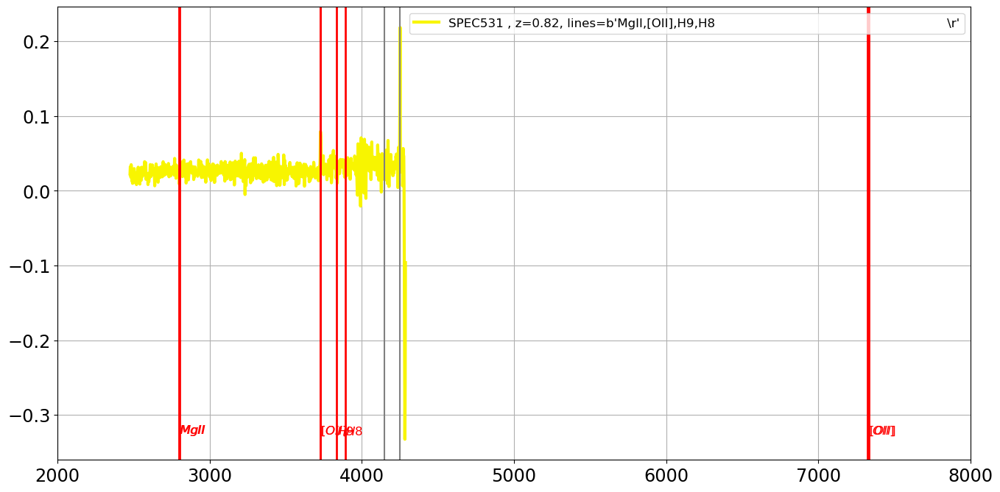

===================== SED 359 : SPEC532 , z=0.67, lines=b'[OII],H9,H                                                                  \r'=======================
the_lines =  b'[OII],H9,H                                                                  \r'
[OII]
H9
H


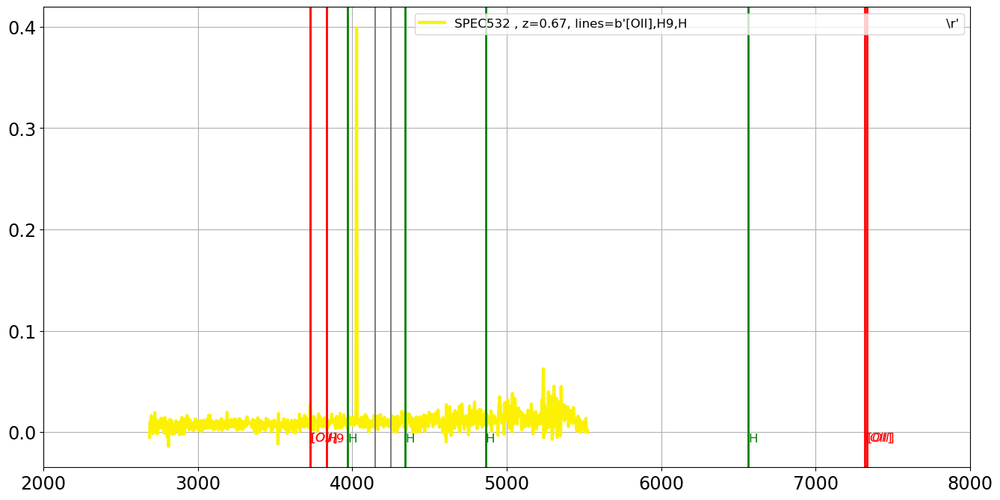

===================== SED 360 : SPEC533 , z=-0.00, lines=b'                                                                            \r'=======================
the_lines =  b'                                                                            \r'



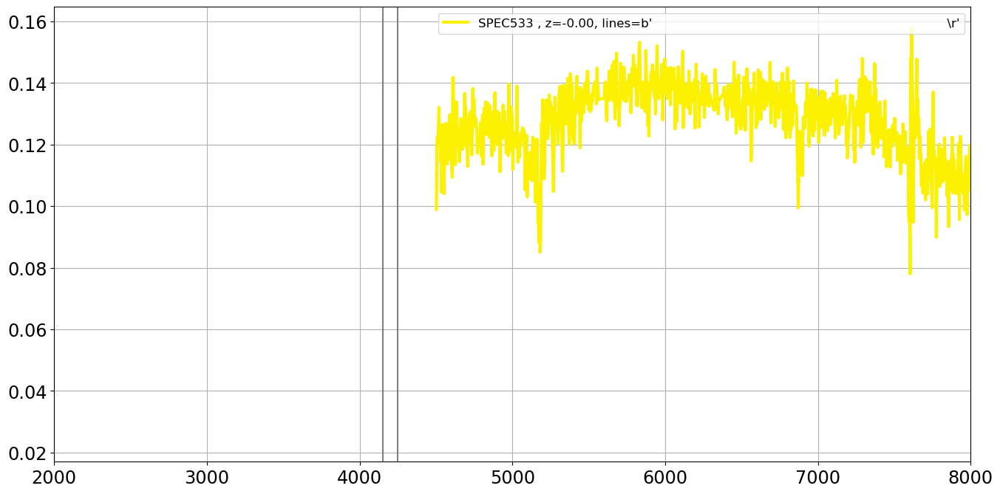

===================== SED 361 : SPEC535 , z=0.38, lines=b'[OII],K,H,H{beta},[OIII]                                                    \r'=======================
the_lines =  b'[OII],K,H,H{beta},[OIII]                                                    \r'
[OII]
K
H
H{beta}
[OIII]


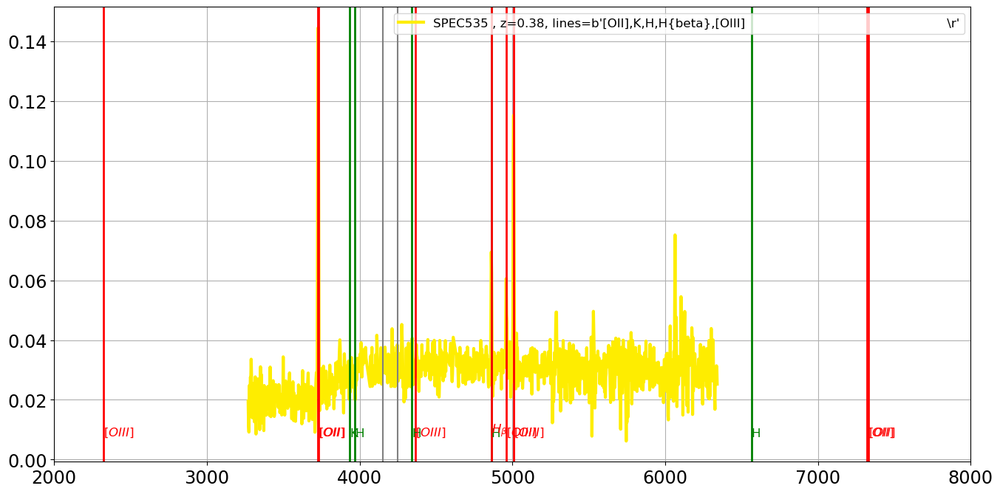

===================== SED 362 : SPEC536 , z=0.20, lines=b'H{beta},[OIII],H{alpha},H,K                                                 \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha},H,K                                                 \r'
H{beta}
[OIII]
H{alpha}
H
K


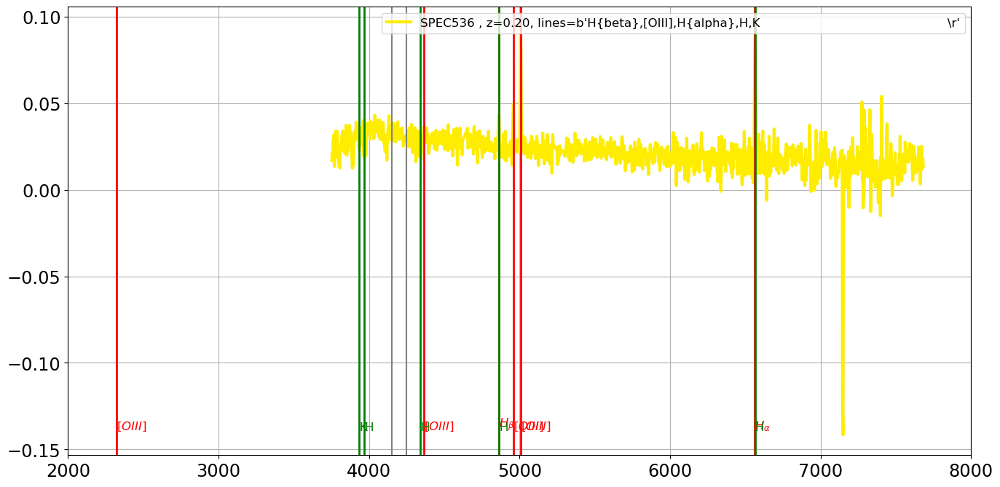

===================== SED 363 : SPEC537 , z=1.60, lines=b'AlIII,FeII24,FeII26,MgII                                                    \r'=======================
the_lines =  b'AlIII,FeII24,FeII26,MgII                                                    \r'
AlIII
FeII24
FeII26
MgII


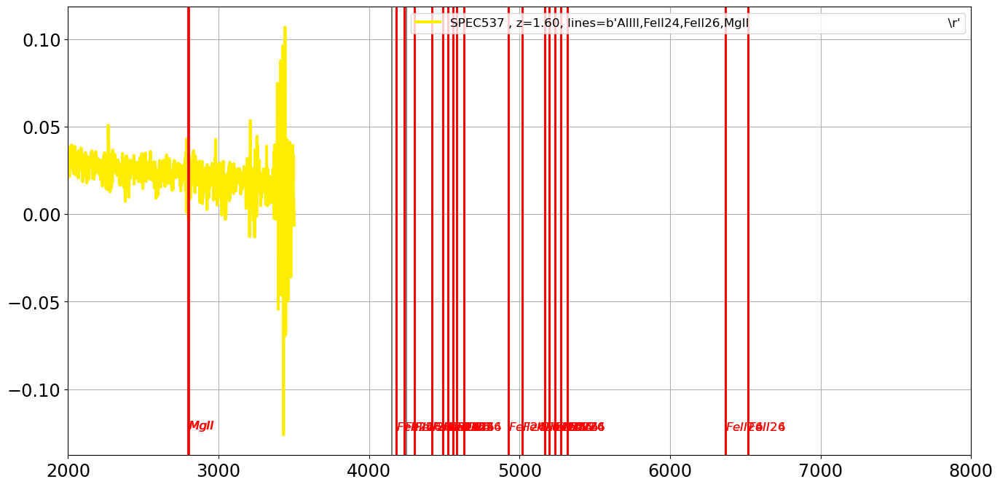

===================== SED 364 : SPEC539 , z=0.00, lines=b'                                                                            \r'=======================
the_lines =  b'                                                                            \r'



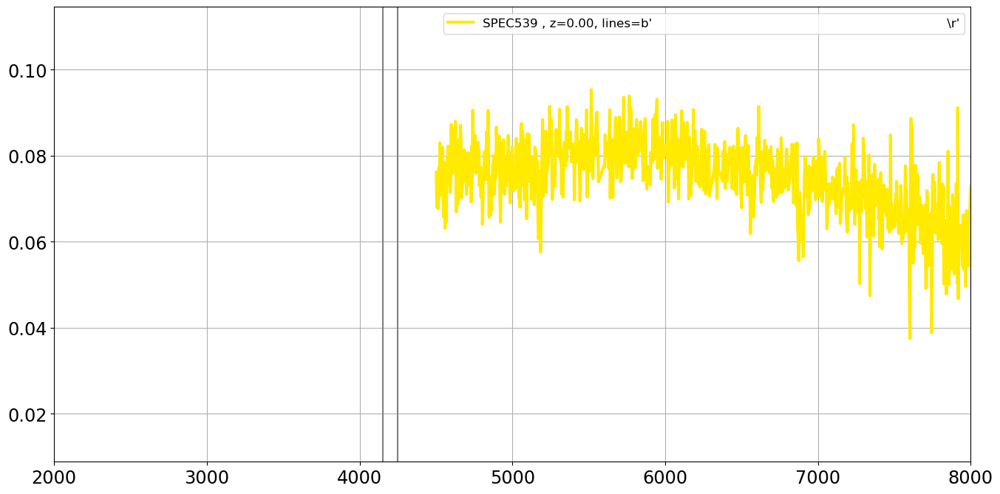

===================== SED 365 : SPEC540 , z=0.31, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


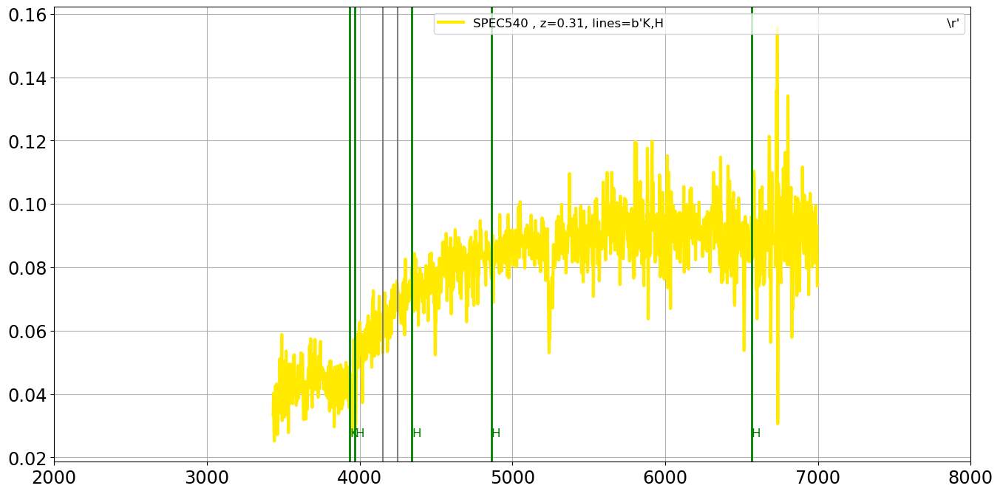

===================== SED 366 : SPEC541 , z=0.11, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


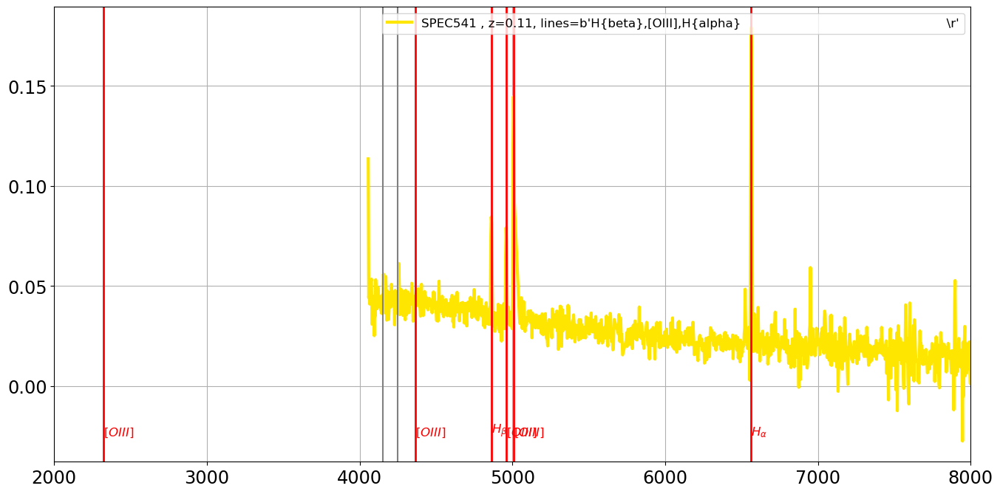

===================== SED 367 : SPEC542 , z=0.49, lines=b'K,H,H{delta}                                                                \r'=======================
the_lines =  b'K,H,H{delta}                                                                \r'
K
H
H{delta}


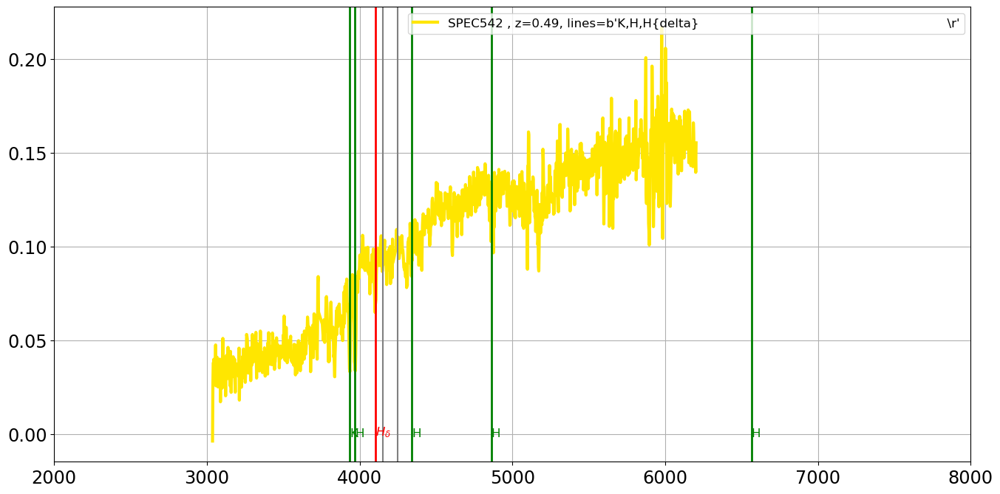

===================== SED 368 : SPEC543 , z=0.23, lines=b'[OII],H{beta},[OIII],H{alpha}                                               \r'=======================
the_lines =  b'[OII],H{beta},[OIII],H{alpha}                                               \r'
[OII]
H{beta}
[OIII]
H{alpha}


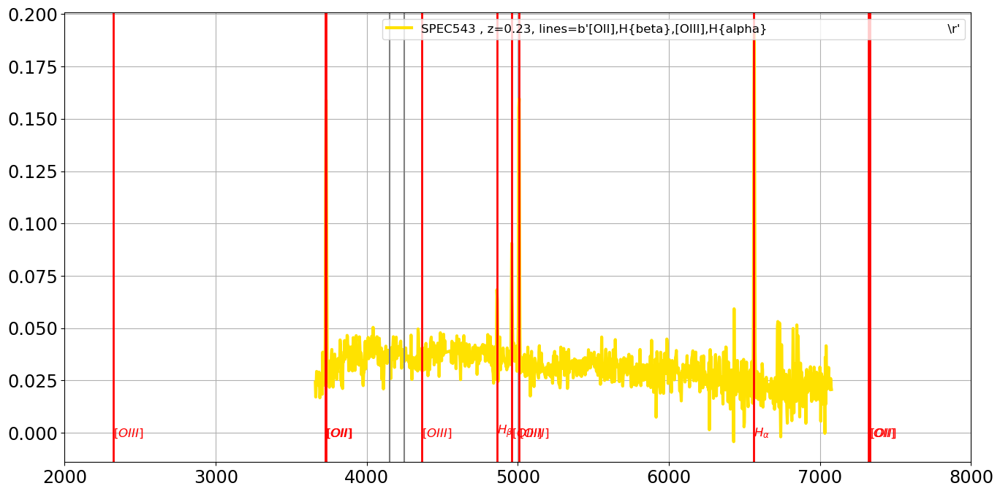

===================== SED 369 : SPEC544 , z=0.78, lines=b'MgII,[OII]                                                                  \r'=======================
the_lines =  b'MgII,[OII]                                                                  \r'
MgII
[OII]


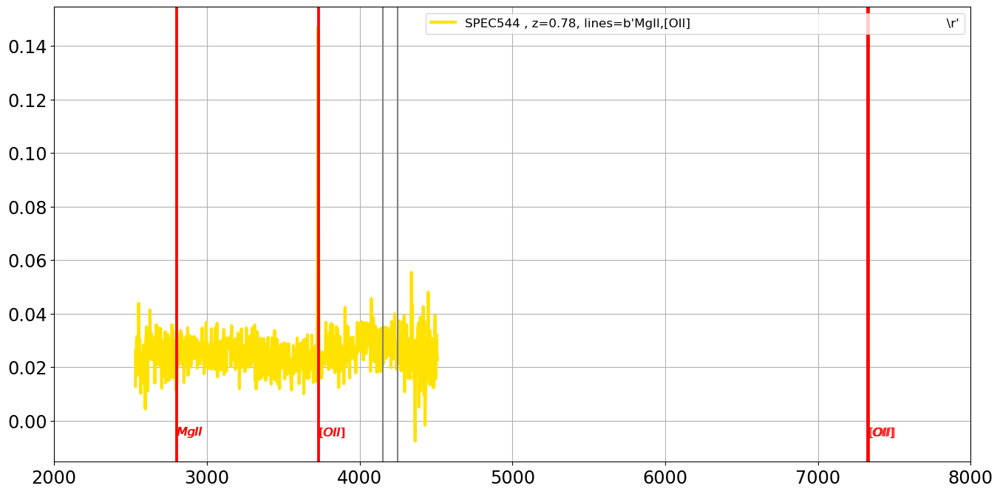

===================== SED 370 : SPEC545 , z=0.78, lines=b'MgII,[OII],K,H                                                              \r'=======================
the_lines =  b'MgII,[OII],K,H                                                              \r'
MgII
[OII]
K
H


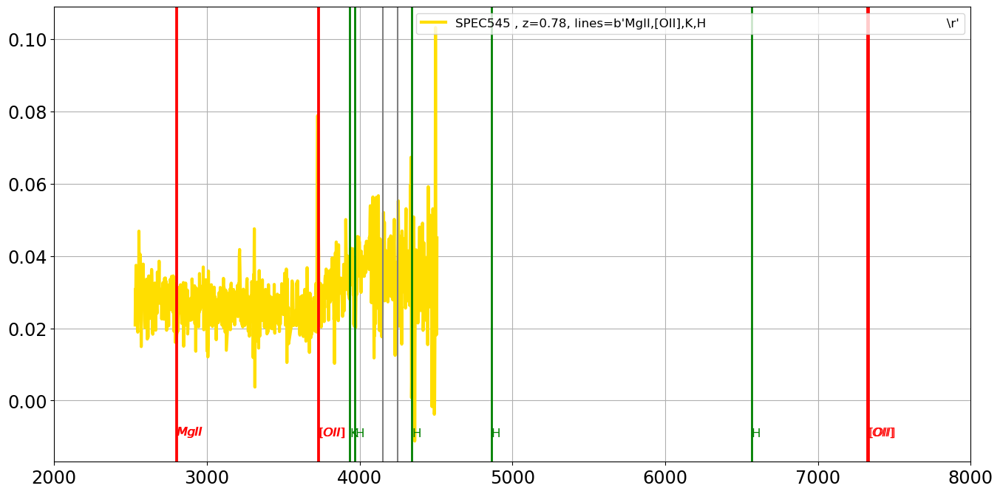

===================== SED 371 : SPEC546 , z=1.46, lines=b'MgII,?                                                                      \r'=======================
the_lines =  b'MgII,?                                                                      \r'
MgII
?


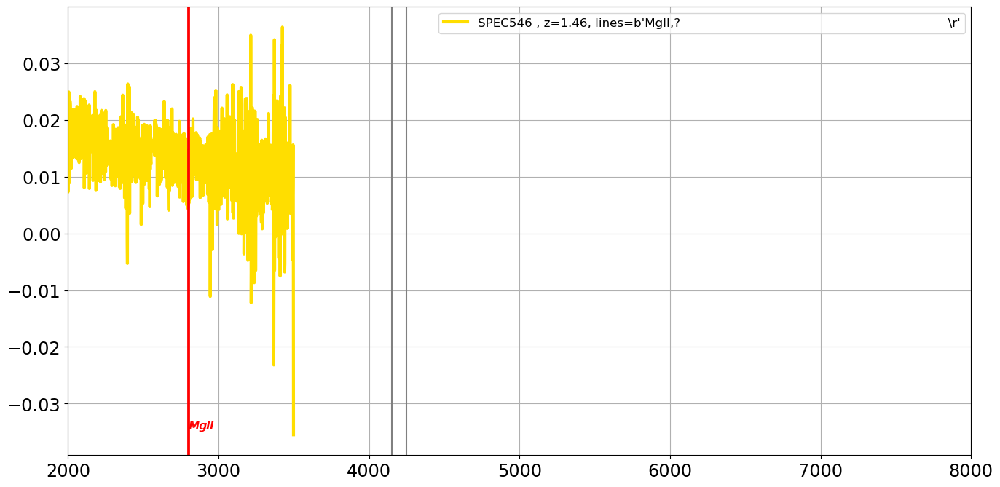

===================== SED 372 : SPEC547 , z=0.53, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


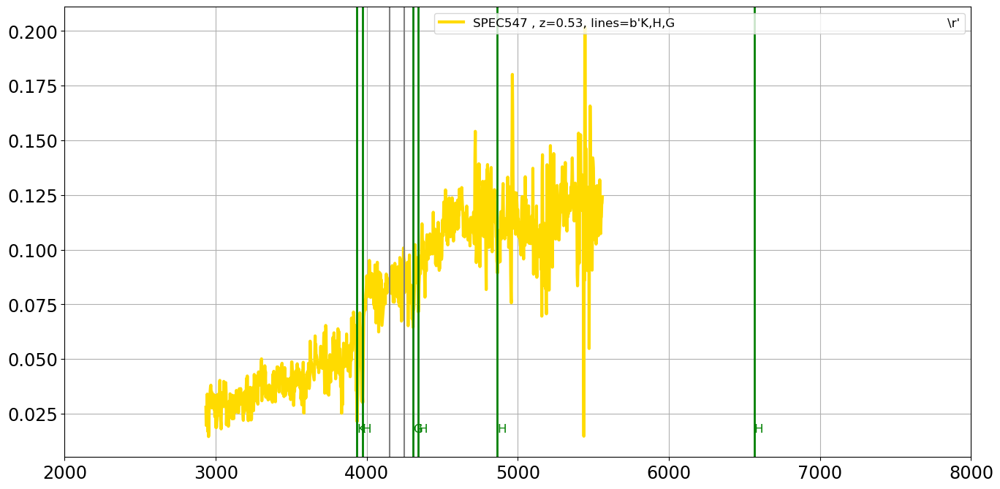

===================== SED 373 : SPEC548 , z=0.29, lines=b'[OII],[OIII]                                                                \r'=======================
the_lines =  b'[OII],[OIII]                                                                \r'
[OII]
[OIII]


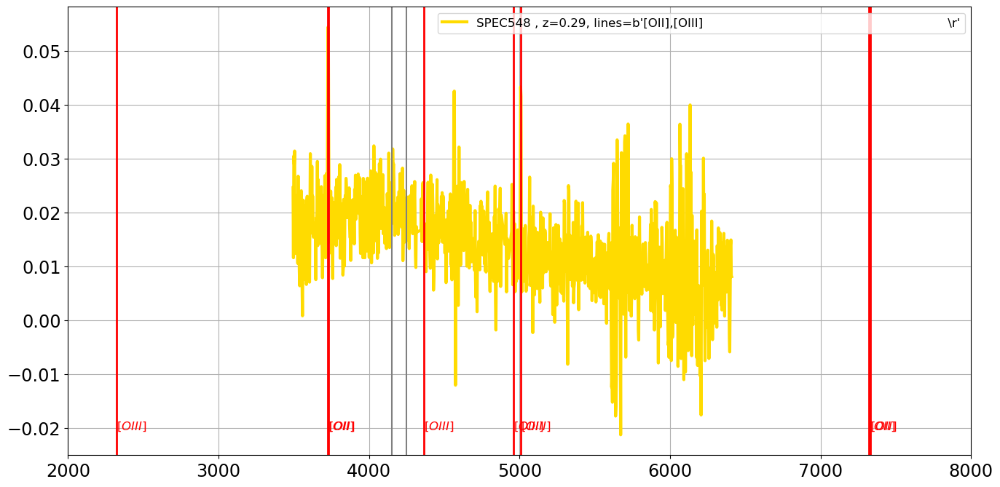

===================== SED 374 : SPEC549 , z=0.56, lines=b'[OII],H,[OIII]                                                              \r'=======================
the_lines =  b'[OII],H,[OIII]                                                              \r'
[OII]
H
[OIII]


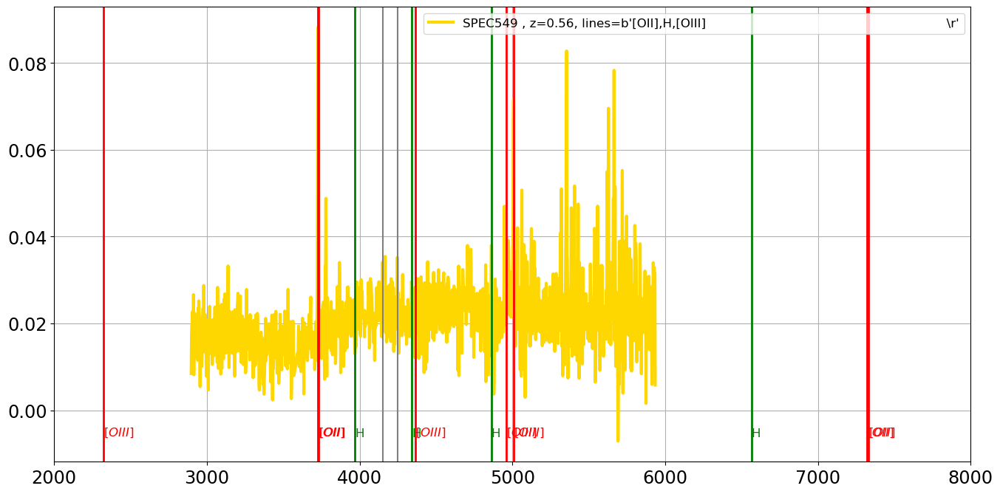

===================== SED 375 : SPEC550 , z=-0.00, lines=b'                                                                            \r'=======================
the_lines =  b'                                                                            \r'



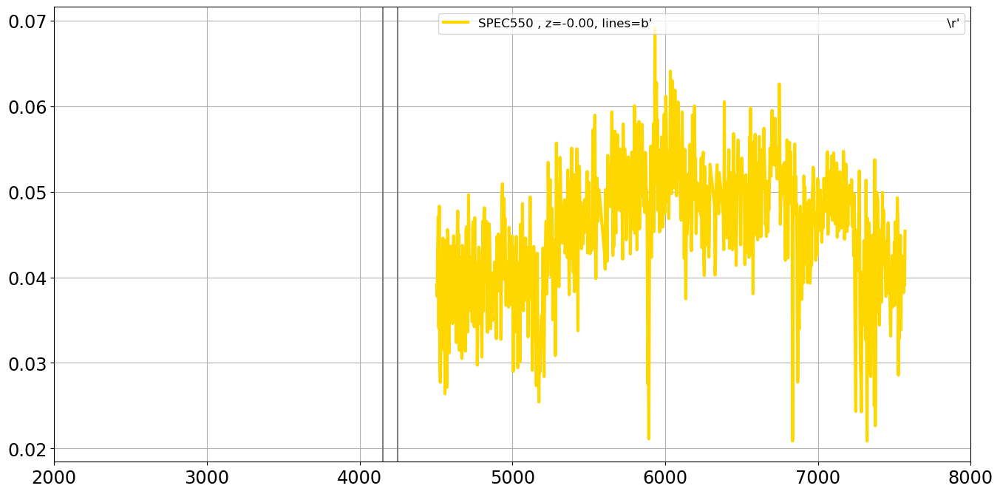

===================== SED 376 : SPEC551 , z=0.44, lines=b'[OII],K,H{beta},[OIII]                                                      \r'=======================
the_lines =  b'[OII],K,H{beta},[OIII]                                                      \r'
[OII]
K
H{beta}
[OIII]


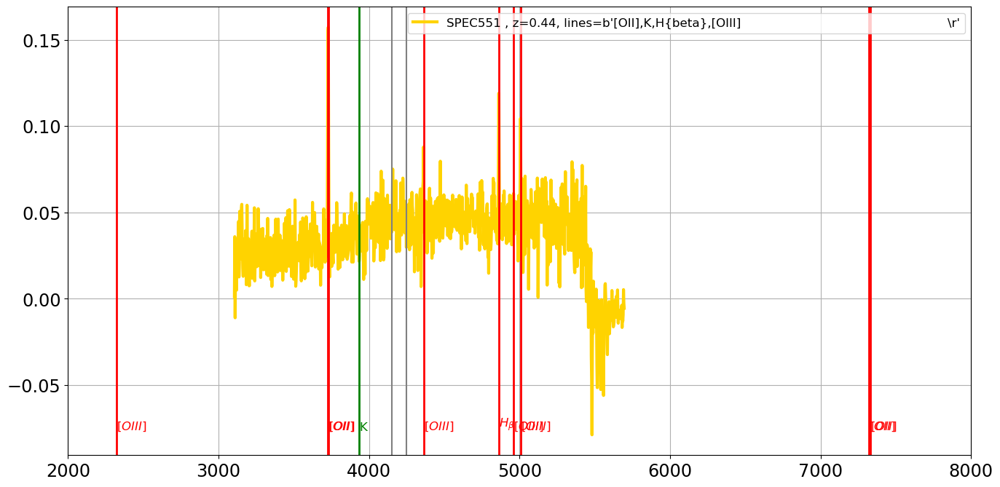

===================== SED 377 : SPEC552 , z=0.50, lines=b'H,G,H{beta}                                                                 \r'=======================
the_lines =  b'H,G,H{beta}                                                                 \r'
H
G
H{beta}


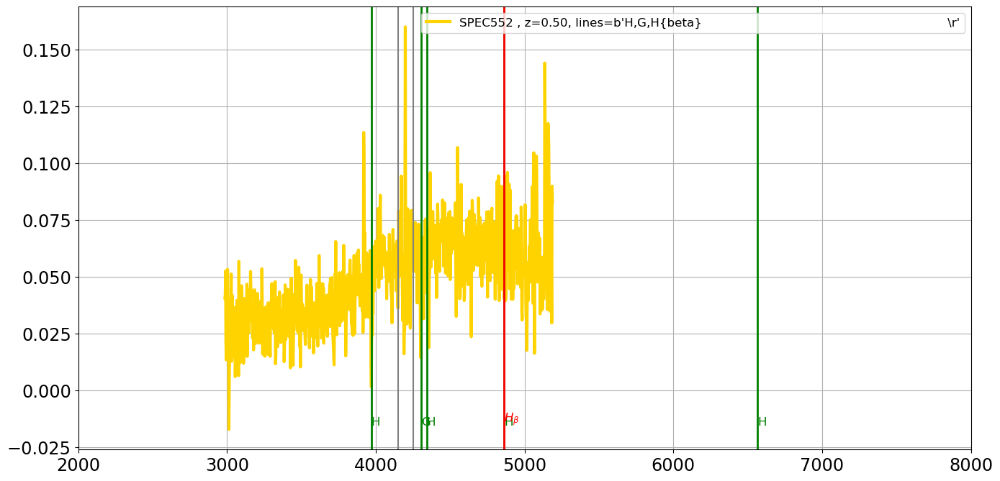

===================== SED 378 : SPEC553 , z=0.67, lines=b'[OII],H10,H9,H8,K,H,H{beta}                                                 \r'=======================
the_lines =  b'[OII],H10,H9,H8,K,H,H{beta}                                                 \r'
[OII]
H10
H9
H8
K
H
H{beta}


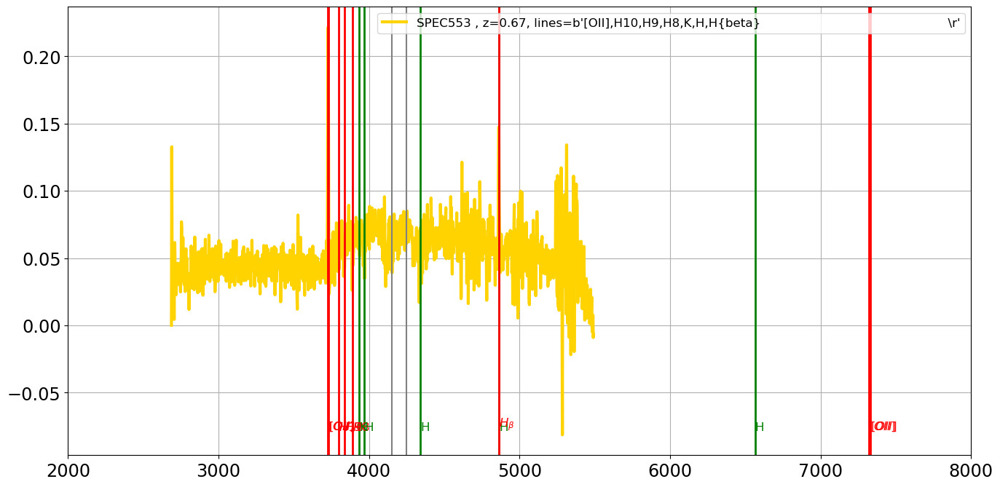

===================== SED 379 : SPEC554 , z=0.50, lines=b'AlIII,K,H,G                                                                 \r'=======================
the_lines =  b'AlIII,K,H,G                                                                 \r'
AlIII
K
H
G


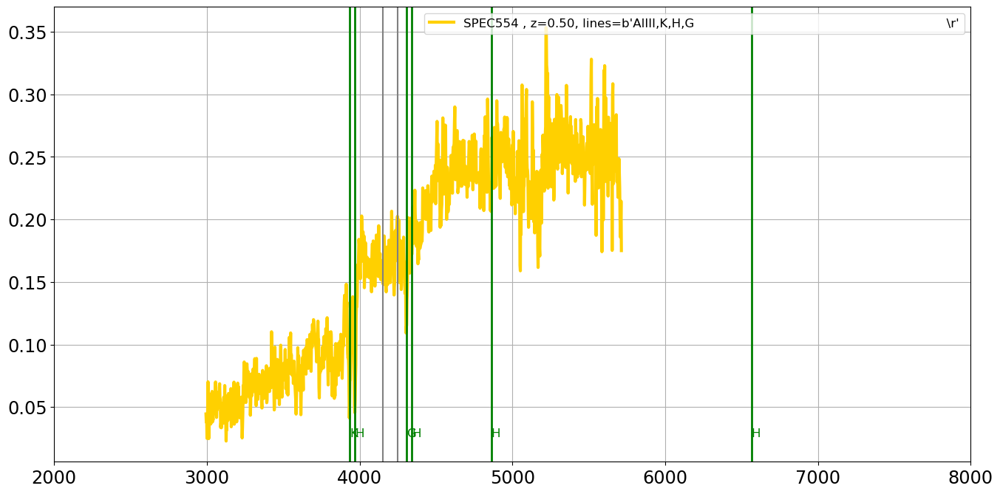

===================== SED 380 : SPEC556 , z=0.39, lines=b'[OII],H9,H8,H,H{beta}                                                       \r'=======================
the_lines =  b'[OII],H9,H8,H,H{beta}                                                       \r'
[OII]
H9
H8
H
H{beta}


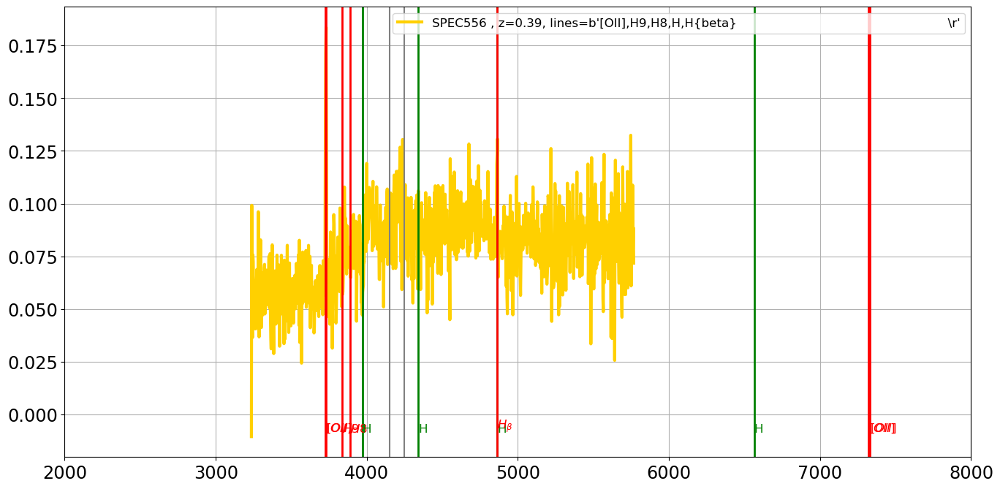

===================== SED 381 : SPEC557 , z=0.41, lines=b'[OII],H9,H{beta},[OIII],H{alpha}                                            \r'=======================
the_lines =  b'[OII],H9,H{beta},[OIII],H{alpha}                                            \r'
[OII]
H9
H{beta}
[OIII]
H{alpha}


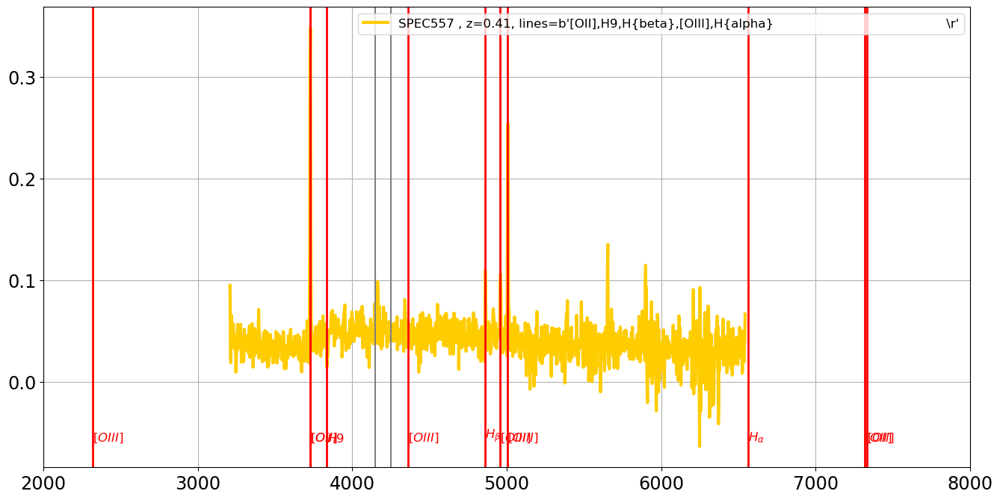

===================== SED 382 : SPEC558 , z=0.51, lines=b'[OII],H9,K,H,H{beta},[OIII]                                                 \r'=======================
the_lines =  b'[OII],H9,K,H,H{beta},[OIII]                                                 \r'
[OII]
H9
K
H
H{beta}
[OIII]


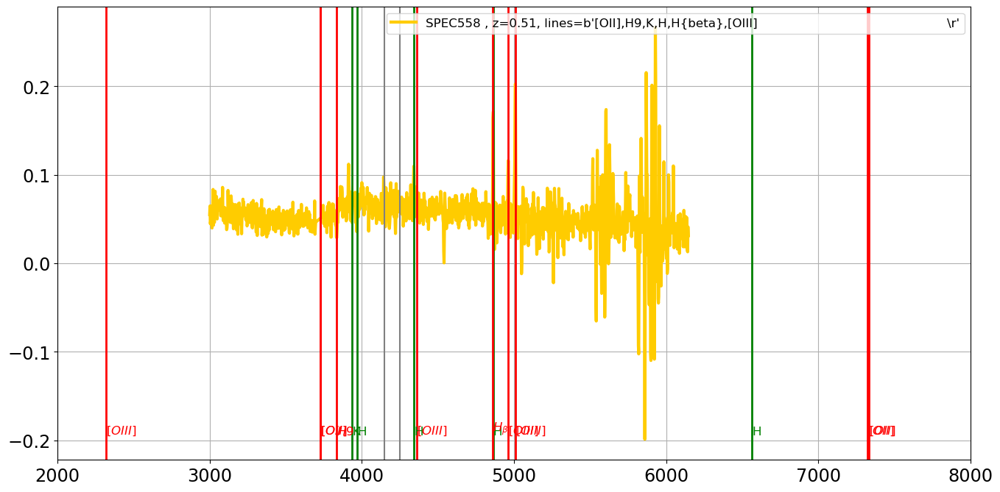

===================== SED 383 : SPEC559 , z=0.51, lines=b'[OII],H9,H{beta},[OIII]                                                     \r'=======================
the_lines =  b'[OII],H9,H{beta},[OIII]                                                     \r'
[OII]
H9
H{beta}
[OIII]


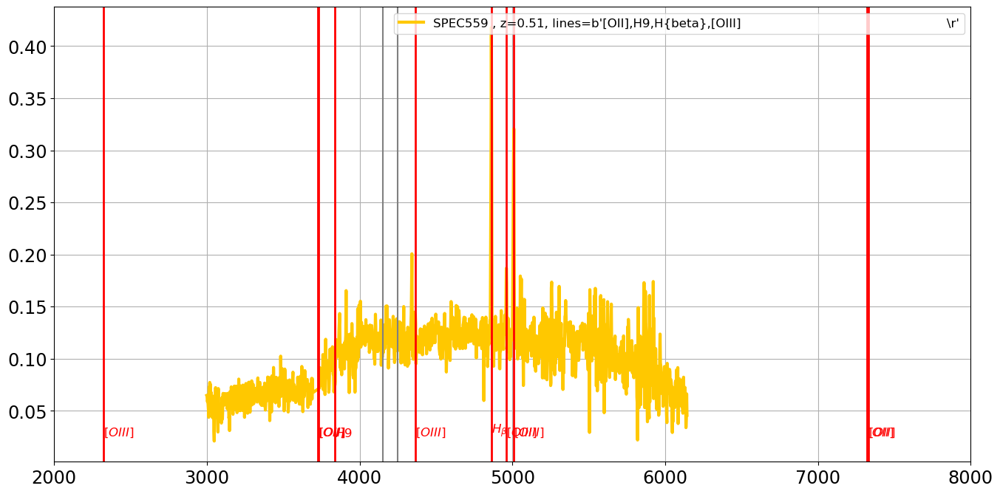

===================== SED 384 : SPEC560 , z=0.12, lines=b'G,H{beta},Mgb,NaD                                                           \r'=======================
the_lines =  b'G,H{beta},Mgb,NaD                                                           \r'
G
H{beta}
Mgb
NaD


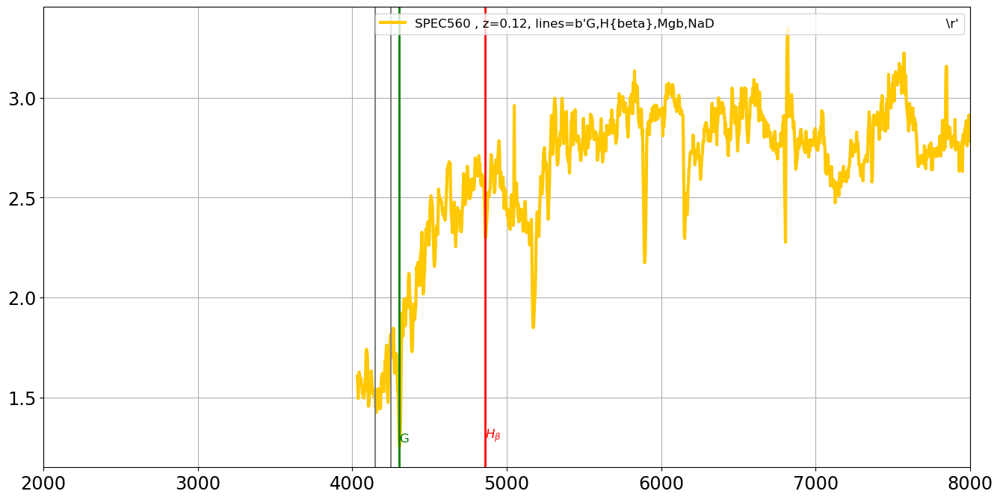

===================== SED 385 : SPEC562 , z=0.49, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


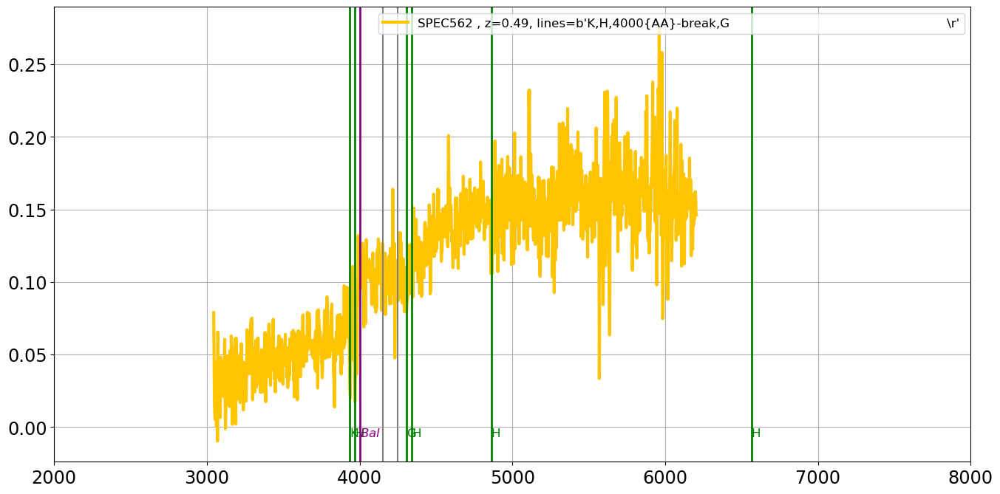

===================== SED 386 : SPEC563 , z=0.11, lines=b'H{delta},G,Mgb,NaD,H{alpha}                                                 \r'=======================
the_lines =  b'H{delta},G,Mgb,NaD,H{alpha}                                                 \r'
H{delta}
G
Mgb
NaD
H{alpha}


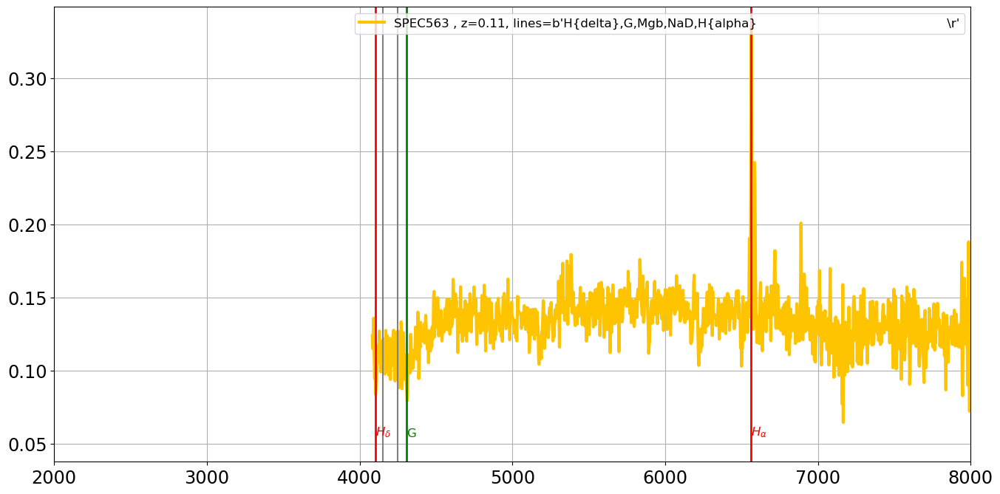

===================== SED 387 : SPEC564 , z=0.29, lines=b'[OII],H{delta},H{gamma},H{beta},[OIII],H{alpha}                             \r'=======================
the_lines =  b'[OII],H{delta},H{gamma},H{beta},[OIII],H{alpha}                             \r'
[OII]
H{delta}
H{gamma}
H{beta}
[OIII]
H{alpha}


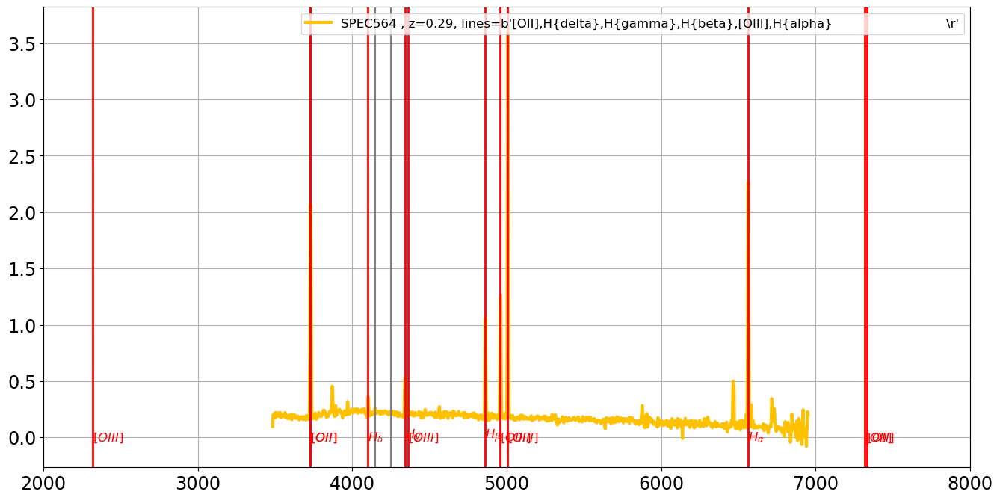

===================== SED 388 : SPEC565 , z=0.60, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


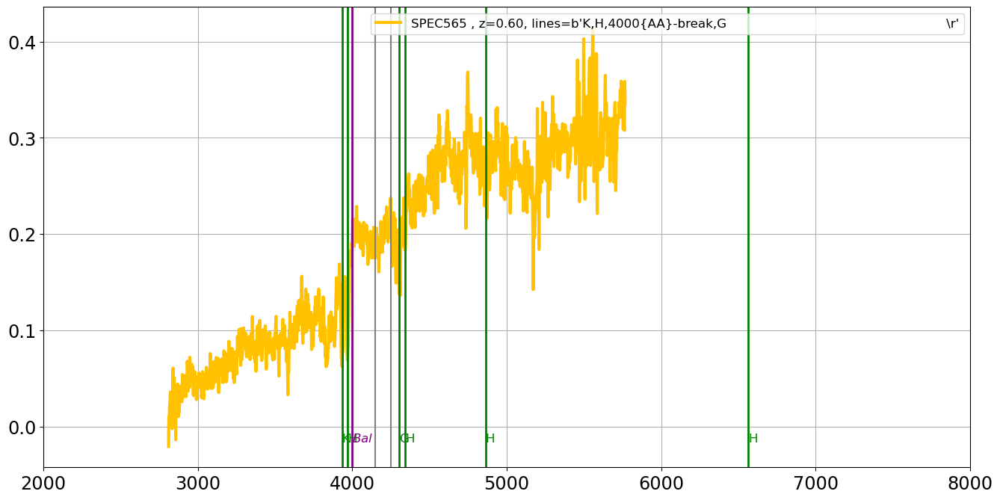

===================== SED 389 : SPEC566 , z=0.48, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


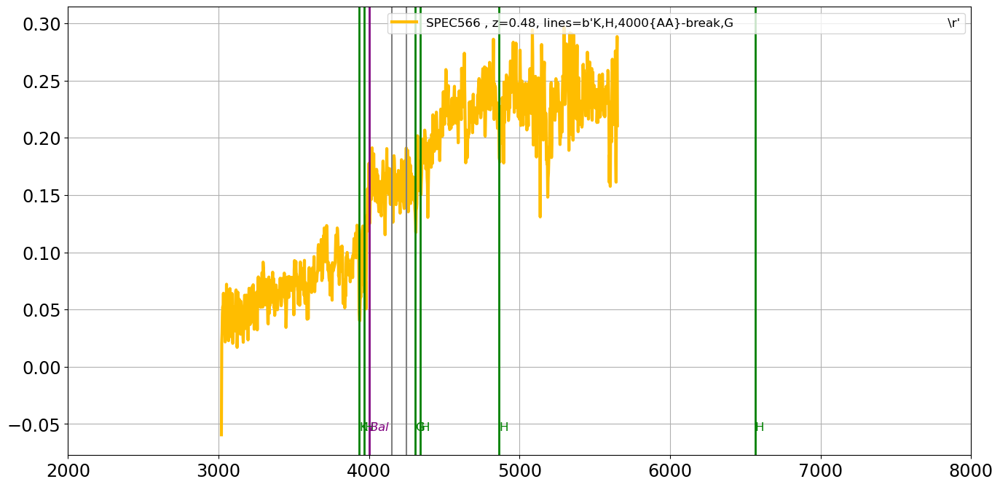

===================== SED 390 : SPEC567 , z=0.44, lines=b'weak,[OII],H8,K,H                                                           \r'=======================
the_lines =  b'weak,[OII],H8,K,H                                                           \r'
weak
[OII]
H8
K
H


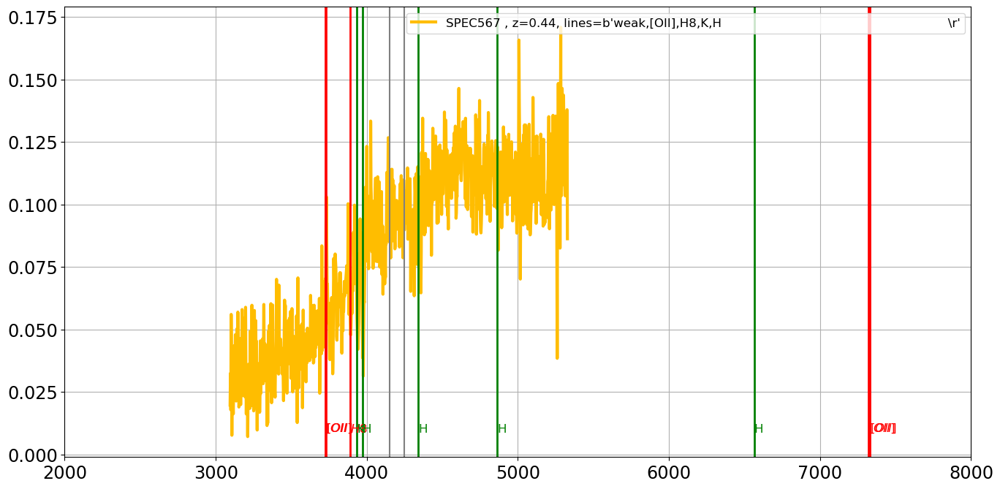

===================== SED 391 : SPEC568 , z=0.24, lines=b'[OII],[OIII],H{alpha}                                                       \r'=======================
the_lines =  b'[OII],[OIII],H{alpha}                                                       \r'
[OII]
[OIII]
H{alpha}


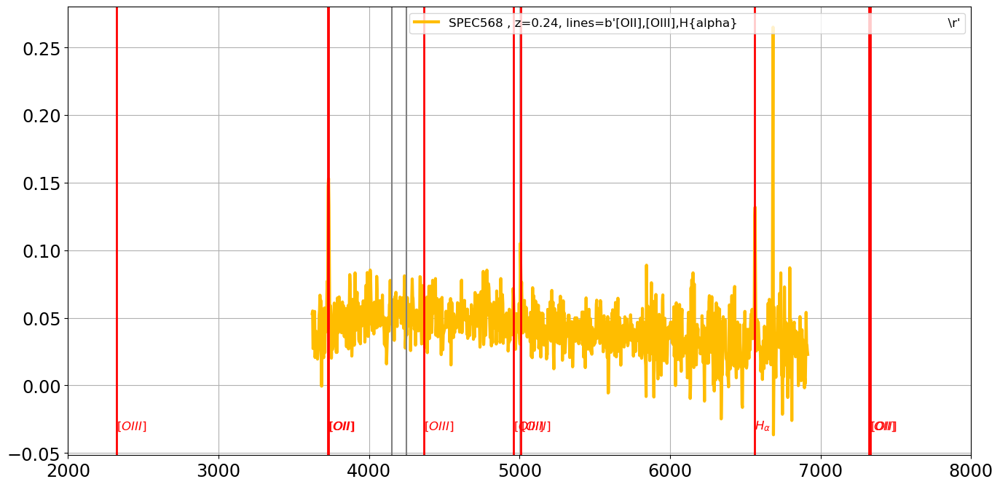

===================== SED 392 : SPEC569 , z=0.59, lines=b'[OII],H,H{delta}                                                            \r'=======================
the_lines =  b'[OII],H,H{delta}                                                            \r'
[OII]
H
H{delta}


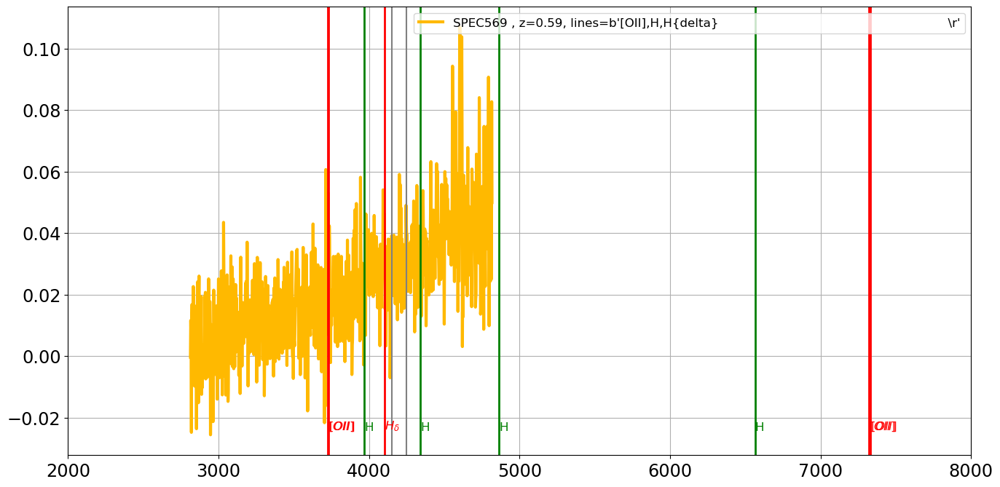

===================== SED 393 : SPEC570 , z=0.25, lines=b'K,H,4000{AA}-break,H{delta},G,H{beta}                                       \r'=======================
the_lines =  b'K,H,4000{AA}-break,H{delta},G,H{beta}                                       \r'
K
H
4000{AA}-break
H{delta}
G
H{beta}


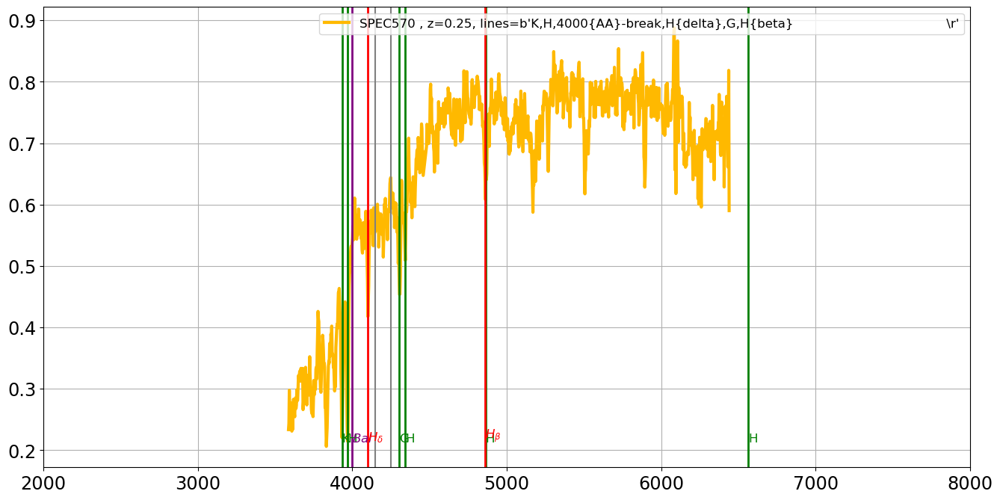

===================== SED 394 : SPEC571 , z=0.25, lines=b'K,H,H{delta},G                                                              \r'=======================
the_lines =  b'K,H,H{delta},G                                                              \r'
K
H
H{delta}
G


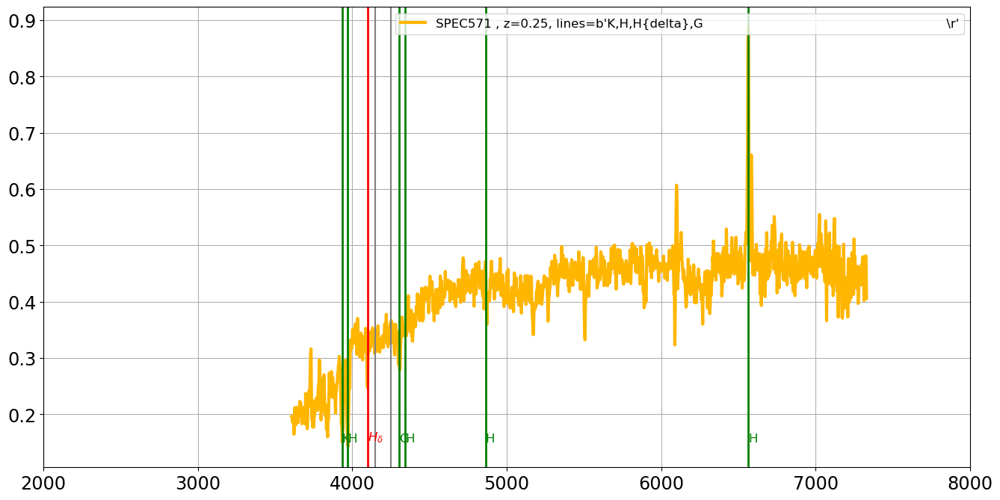

===================== SED 395 : SPEC572 , z=0.22, lines=b'[OII],H10,H9,H8,K,H,H{beta},[OIII],H{alpha}                                 \r'=======================
the_lines =  b'[OII],H10,H9,H8,K,H,H{beta},[OIII],H{alpha}                                 \r'
[OII]
H10
H9
H8
K
H
H{beta}
[OIII]
H{alpha}


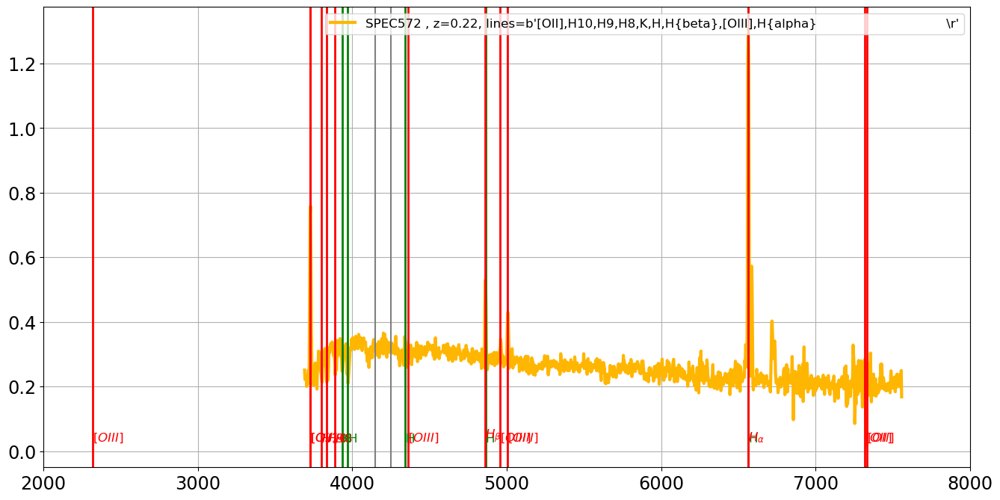

===================== SED 396 : SPEC573 , z=0.59, lines=b'[OII],K,H,H{gamma}                                                          \r'=======================
the_lines =  b'[OII],K,H,H{gamma}                                                          \r'
[OII]
K
H
H{gamma}


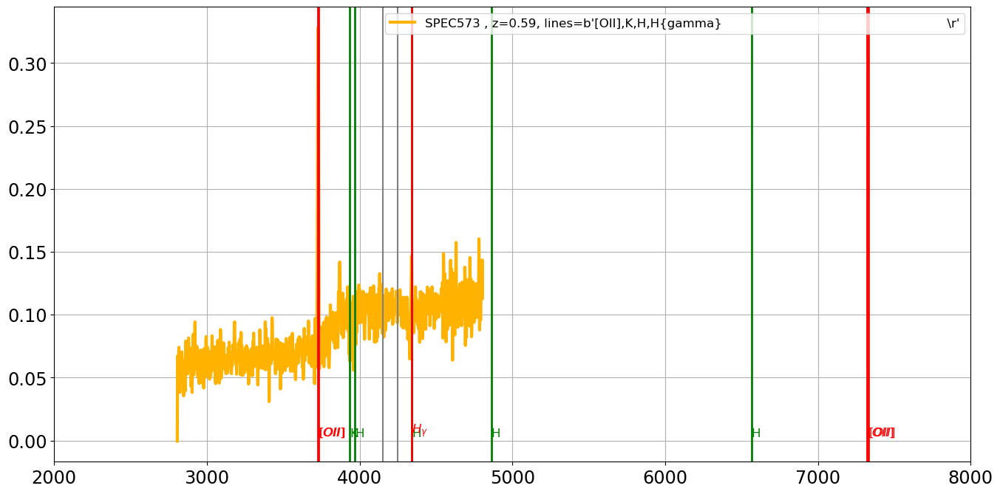

===================== SED 397 : SPEC574 , z=0.60, lines=b'K,H,4000{AA}-break                                                          \r'=======================
the_lines =  b'K,H,4000{AA}-break                                                          \r'
K
H
4000{AA}-break


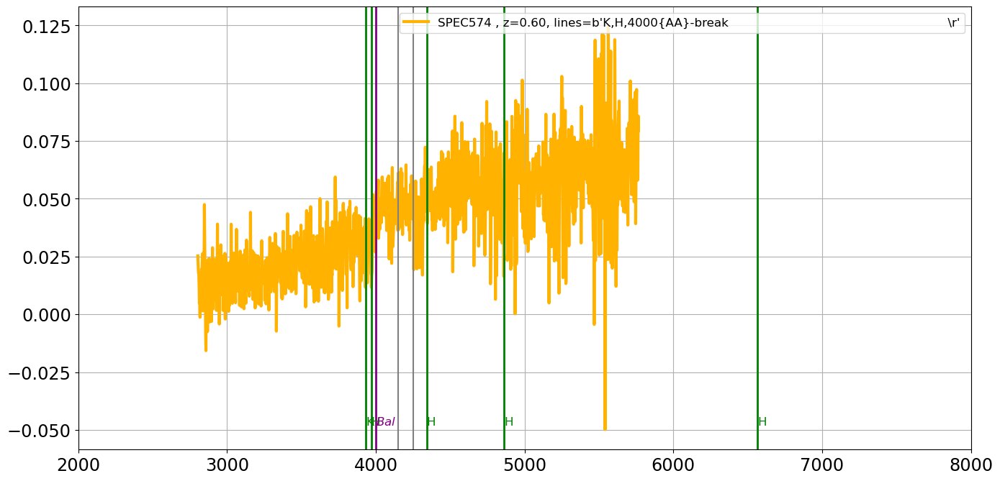

===================== SED 398 : SPEC575 , z=0.60, lines=b'[OII],H9,H8,K,H,H{delta},G                                                  \r'=======================
the_lines =  b'[OII],H9,H8,K,H,H{delta},G                                                  \r'
[OII]
H9
H8
K
H
H{delta}
G


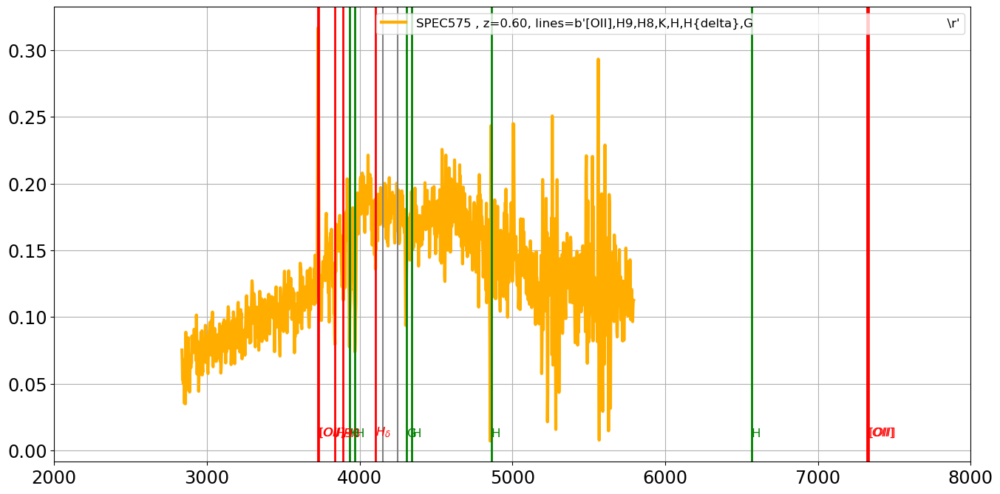

===================== SED 399 : SPEC576 , z=0.43, lines=b'K,H,G,H{beta}                                                               \r'=======================
the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


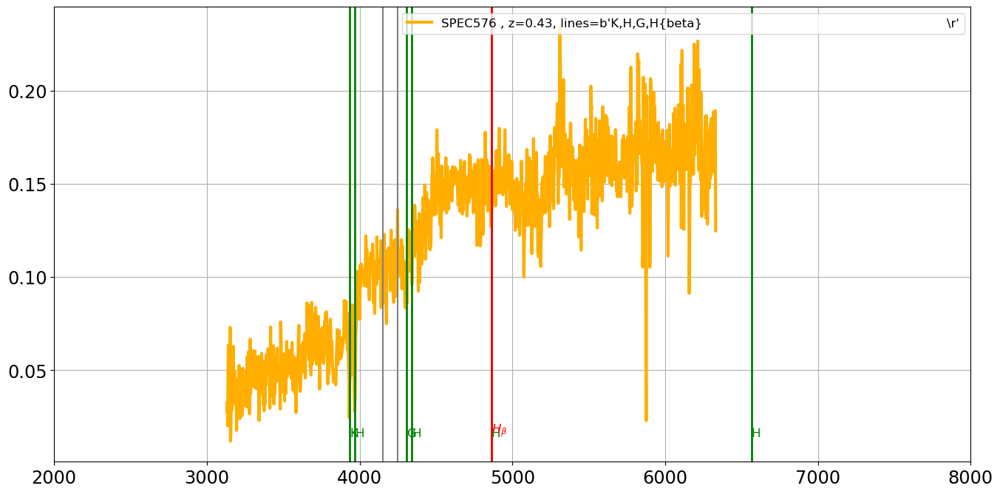

===================== SED 400 : SPEC577 , z=0.30, lines=b'[OII],H9,H8,K,H,H{beta},[OIII],H{alpha}                                     \r'=======================
the_lines =  b'[OII],H9,H8,K,H,H{beta},[OIII],H{alpha}                                     \r'
[OII]
H9
H8
K
H
H{beta}
[OIII]
H{alpha}


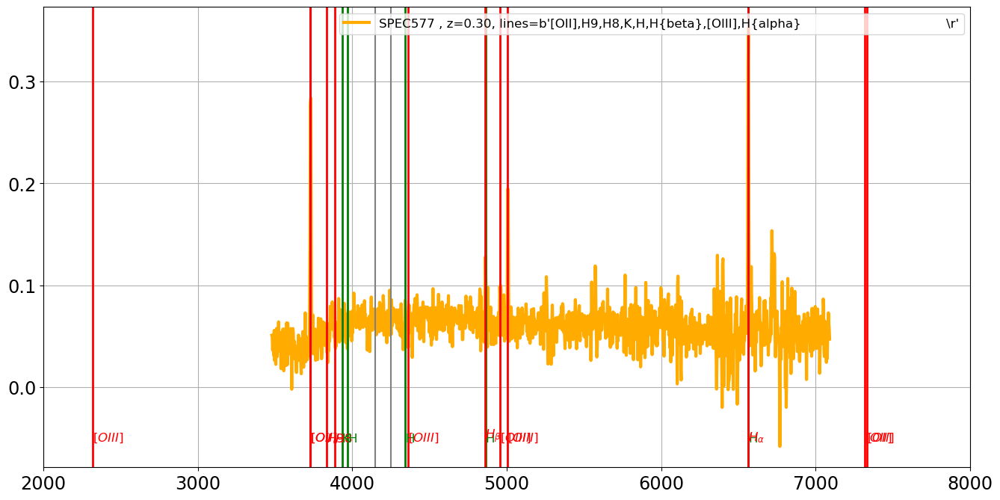

===================== SED 401 : SPEC578 , z=0.60, lines=b'weak,[OII],K,H,4000{AA}-break                                               \r'=======================
the_lines =  b'weak,[OII],K,H,4000{AA}-break                                               \r'
weak
[OII]
K
H
4000{AA}-break


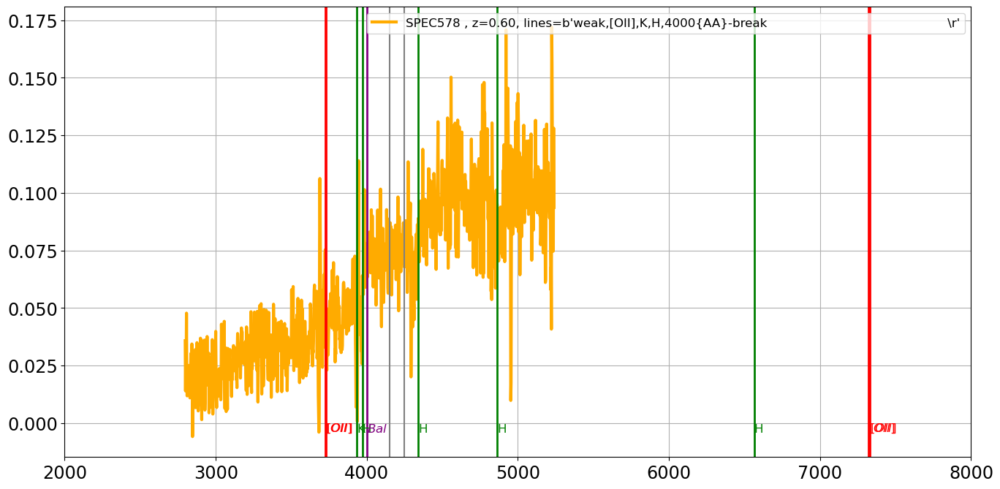

===================== SED 402 : SPEC579 , z=0.41, lines=b'[OII],H9,K,H,H{beta},[OIII]                                                 \r'=======================
the_lines =  b'[OII],H9,K,H,H{beta},[OIII]                                                 \r'
[OII]
H9
K
H
H{beta}
[OIII]


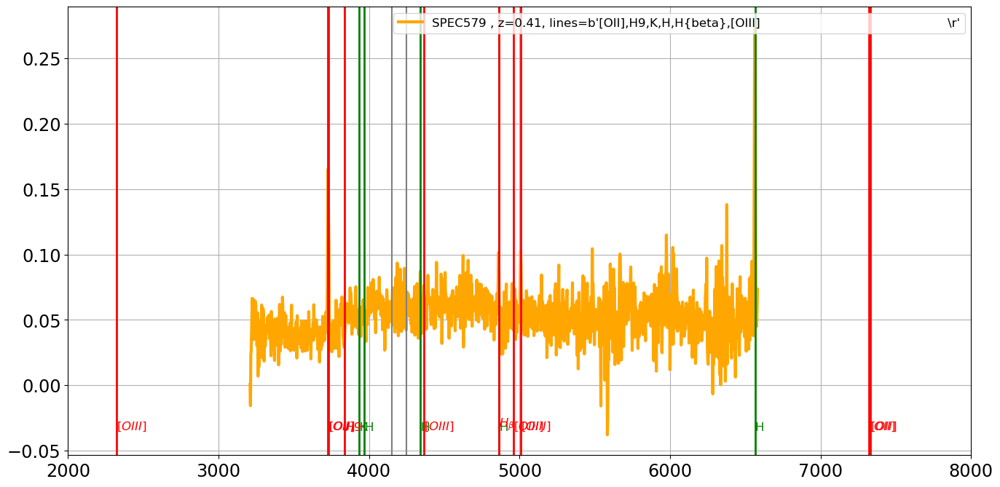

===================== SED 403 : SPEC580 , z=0.49, lines=b'[OII],H9,K,H,H{delta}                                                       \r'=======================
the_lines =  b'[OII],H9,K,H,H{delta}                                                       \r'
[OII]
H9
K
H
H{delta}


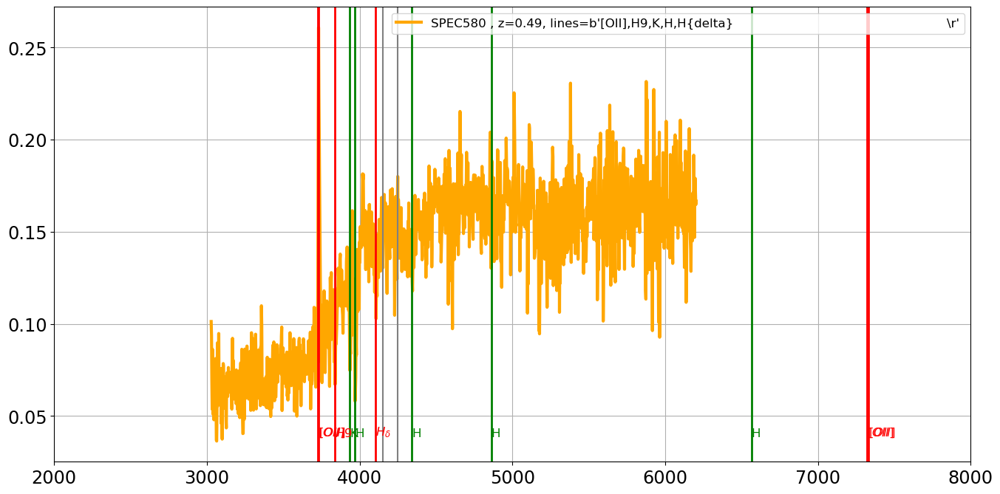

===================== SED 404 : SPEC582 , z=0.32, lines=b'[OII],NeIII,H8,H{epsilon},H{delta},H{gamma},H{beta},[OIII],H{alpha},HeI,NIII\r'=======================
the_lines =  b'[OII],NeIII,H8,H{epsilon},H{delta},H{gamma},H{beta},[OIII],H{alpha},HeI,NIII\r'
[OII]
NeIII
H8
H{epsilon}
H{delta}
H{gamma}
H{beta}
[OIII]
H{alpha}
HeI
NIII


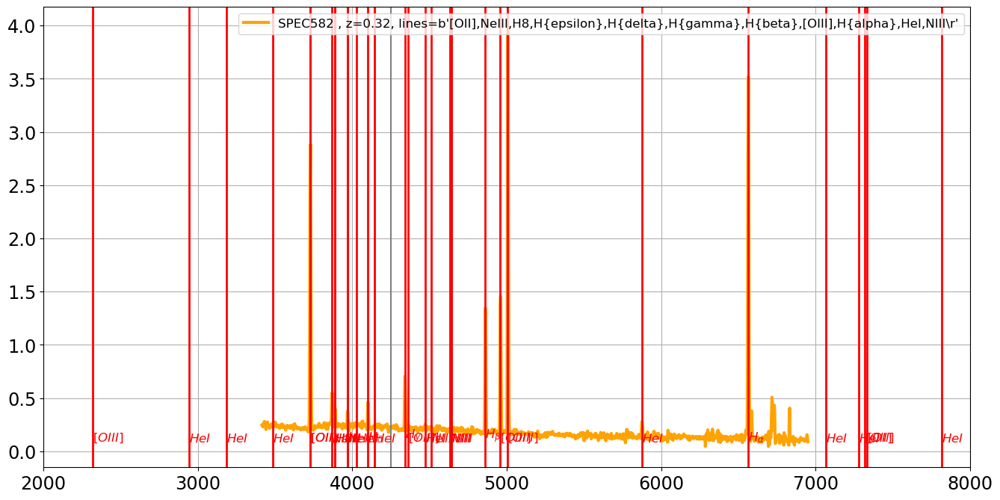

===================== SED 405 : SPEC583 , z=0.47, lines=b'K,H,H{delta},G                                                              \r'=======================
the_lines =  b'K,H,H{delta},G                                                              \r'
K
H
H{delta}
G


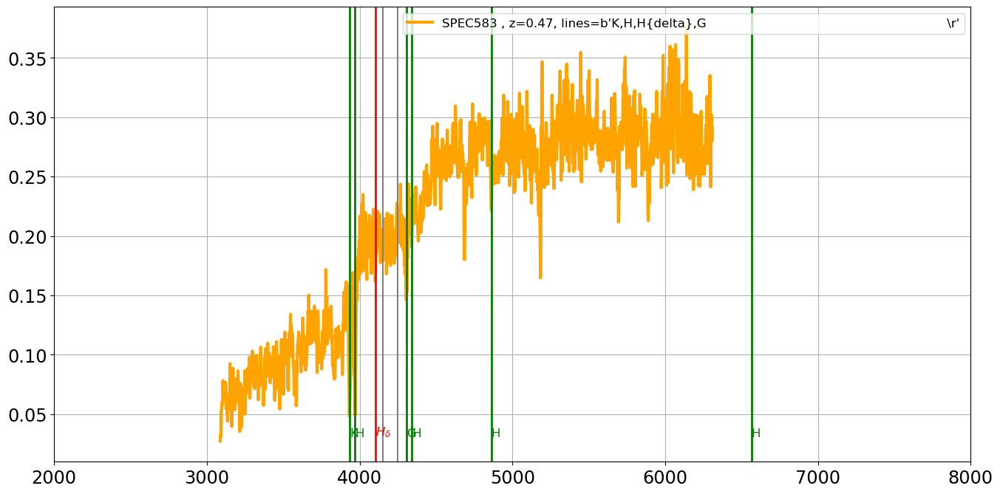

===================== SED 406 : SPEC584 , z=0.12, lines=b'G,H{beta},E                                                                 \r'=======================
the_lines =  b'G,H{beta},E                                                                 \r'
G
H{beta}
E


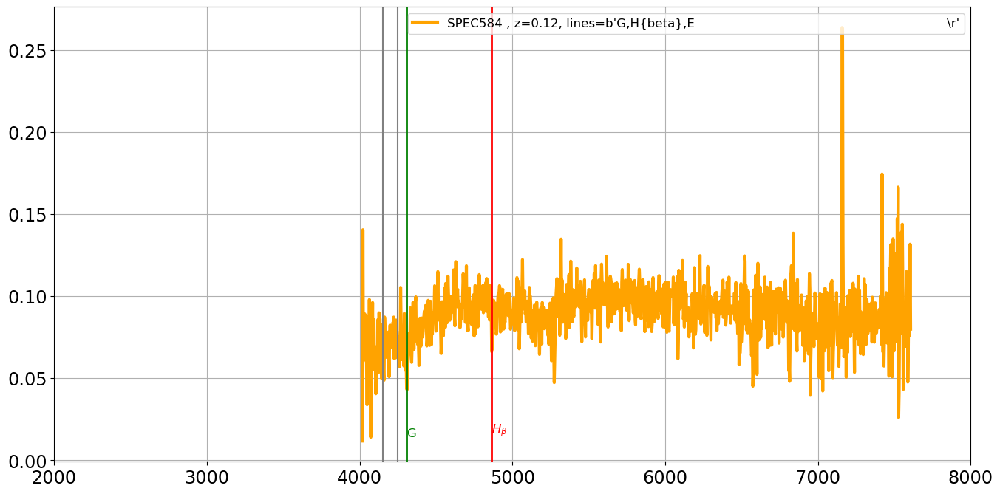

===================== SED 407 : SPEC585 , z=0.12, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


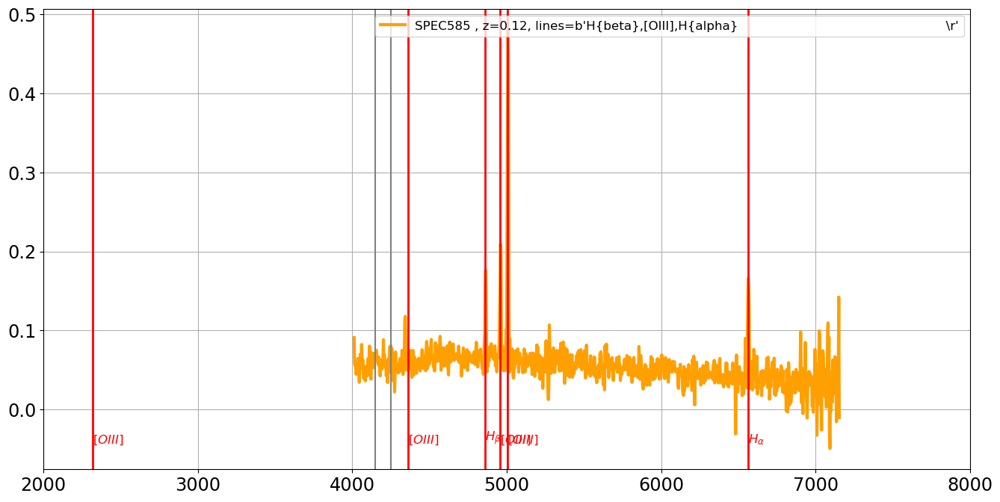

===================== SED 408 : SPEC586 , z=0.91, lines=b'MgII,[OII]                                                                  \r'=======================
the_lines =  b'MgII,[OII]                                                                  \r'
MgII
[OII]


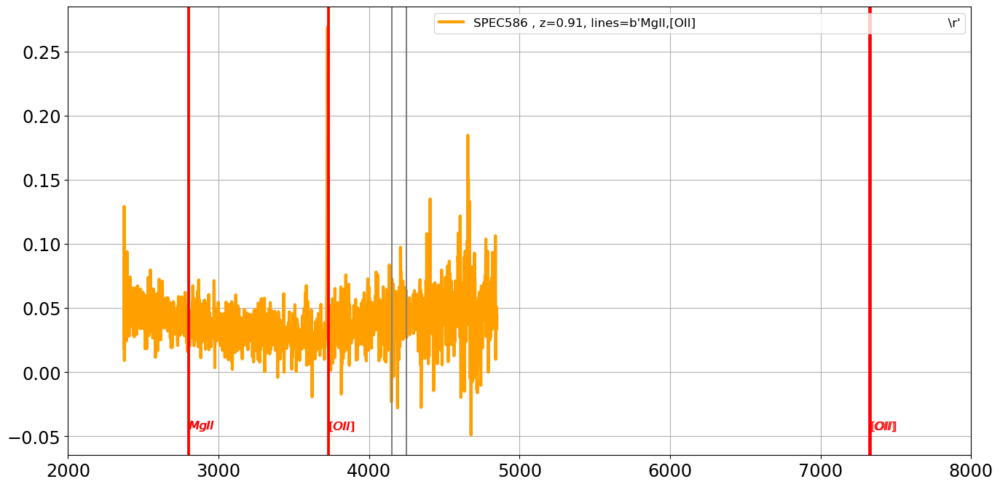

===================== SED 409 : SPEC587 , z=0.30, lines=b'[OII],H9,H,H{beta},[OIII]                                                   \r'=======================
the_lines =  b'[OII],H9,H,H{beta},[OIII]                                                   \r'
[OII]
H9
H
H{beta}
[OIII]


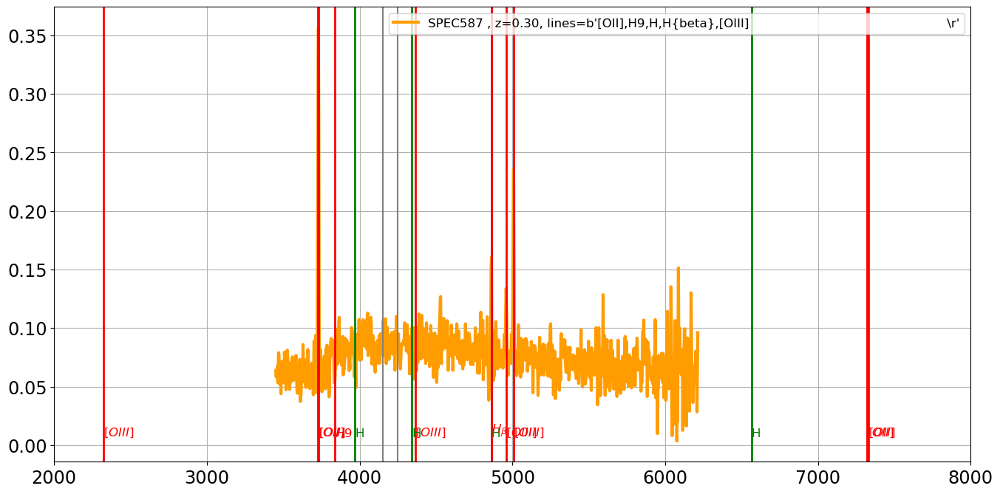

===================== SED 410 : SPEC588 , z=0.22, lines=b'K,H,Mgb                                                                     \r'=======================
the_lines =  b'K,H,Mgb                                                                     \r'
K
H
Mgb


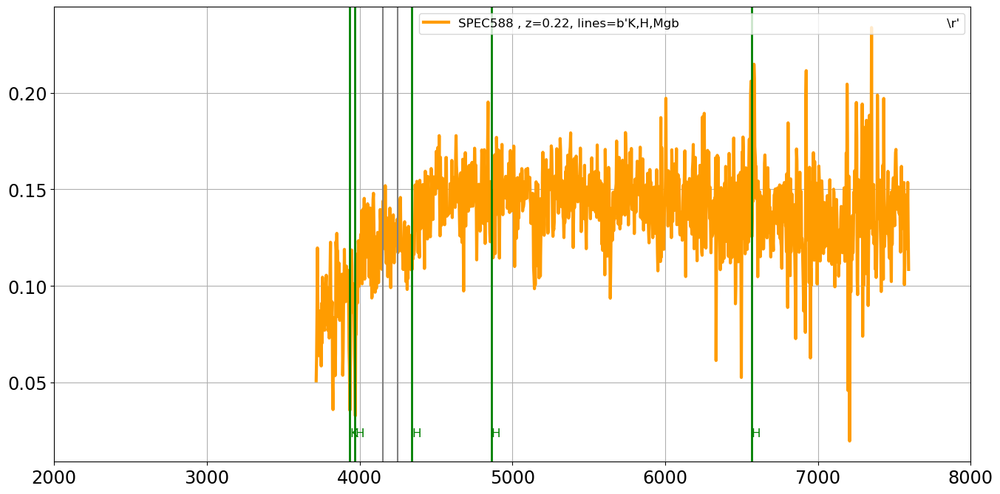

===================== SED 411 : SPEC589 , z=0.42, lines=b'[OII],H9,H,H{delta}                                                         \r'=======================
the_lines =  b'[OII],H9,H,H{delta}                                                         \r'
[OII]
H9
H
H{delta}


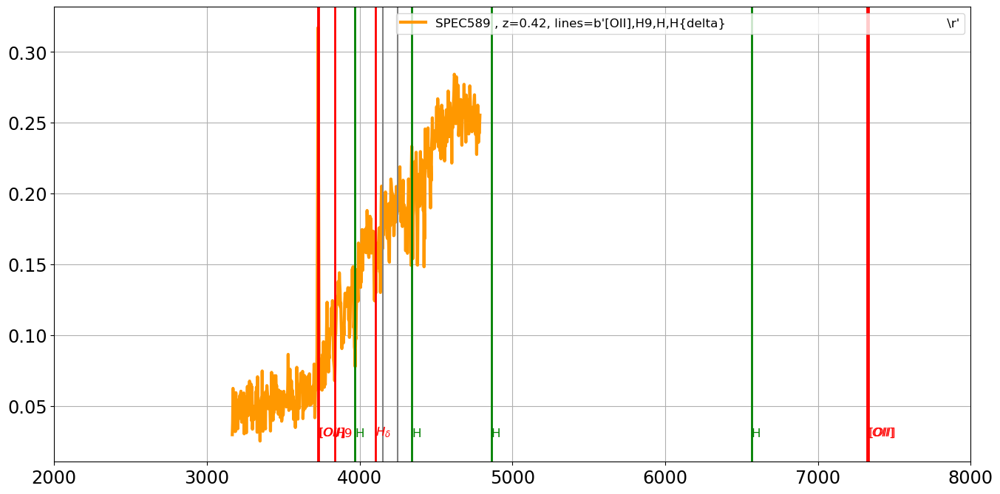

===================== SED 412 : SPEC590 , z=0.41, lines=b'K,H,H{delta},G                                                              \r'=======================
the_lines =  b'K,H,H{delta},G                                                              \r'
K
H
H{delta}
G


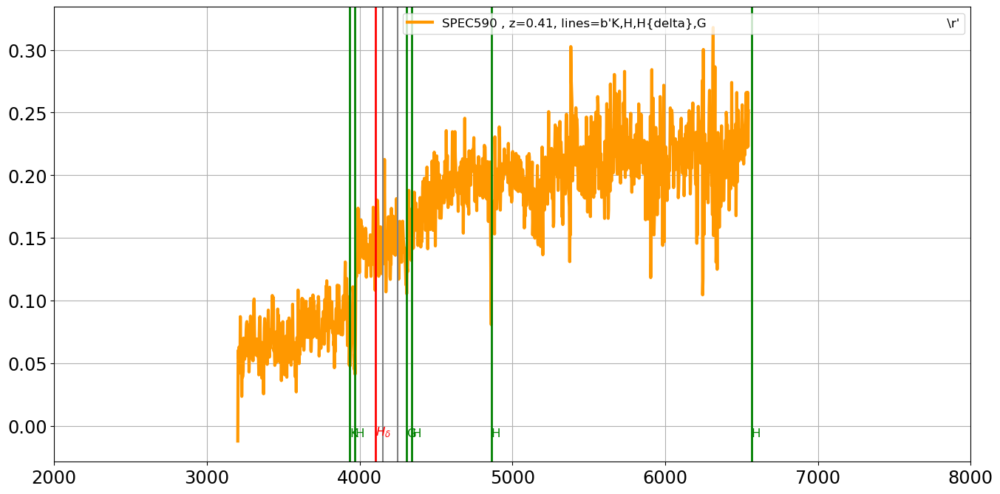

===================== SED 413 : SPEC591 , z=1.01, lines=b'broad,MgII,[OII],(QSO)                                                      \r'=======================
the_lines =  b'broad,MgII,[OII],(QSO)                                                      \r'
broad
MgII
[OII]
(QSO)


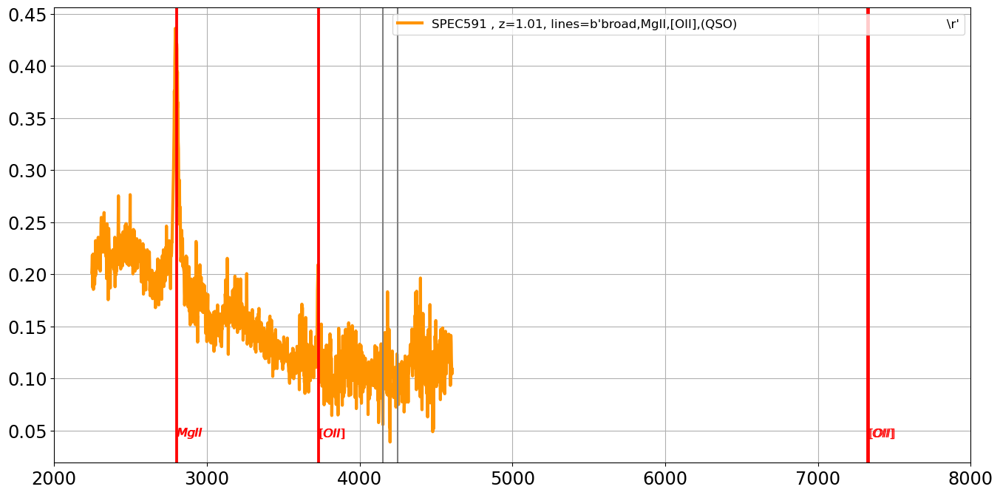

===================== SED 414 : SPEC593 , z=0.16, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


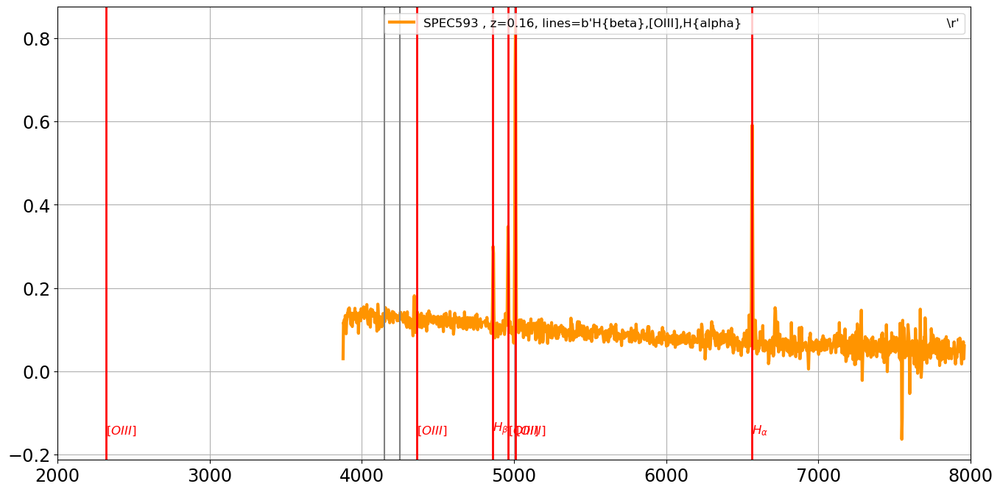

===================== SED 415 : SPEC594 , z=0.50, lines=b'[OII],H,[OIII]                                                              \r'=======================
the_lines =  b'[OII],H,[OIII]                                                              \r'
[OII]
H
[OIII]


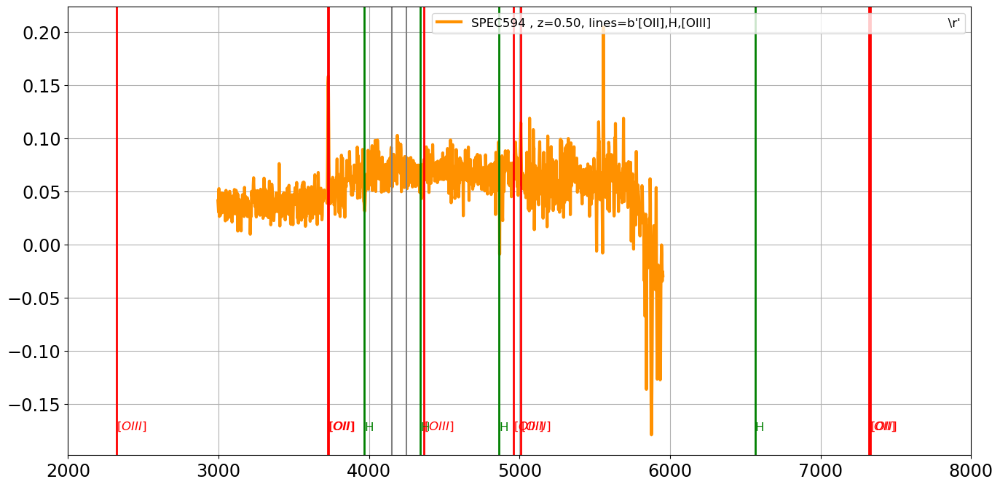

===================== SED 416 : SPEC595 , z=0.38, lines=b'[OII],H11,H10,H9,H8,K,H,H{delta},H{beta},[OIII]                             \r'=======================
the_lines =  b'[OII],H11,H10,H9,H8,K,H,H{delta},H{beta},[OIII]                             \r'
[OII]
H11
H10
H9
H8
K
H
H{delta}
H{beta}
[OIII]


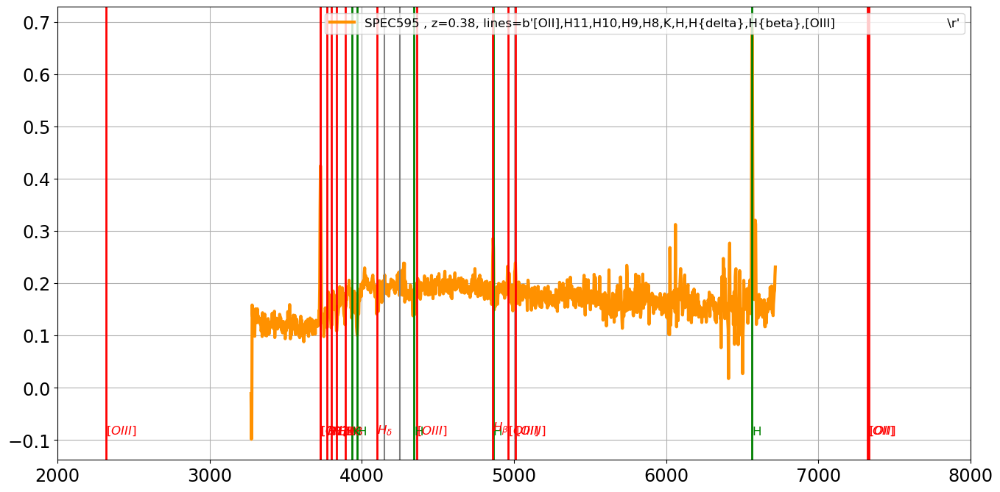

===================== SED 417 : SPEC596 , z=0.46, lines=b'H9,H,G                                                                      \r'=======================
the_lines =  b'H9,H,G                                                                      \r'
H9
H
G


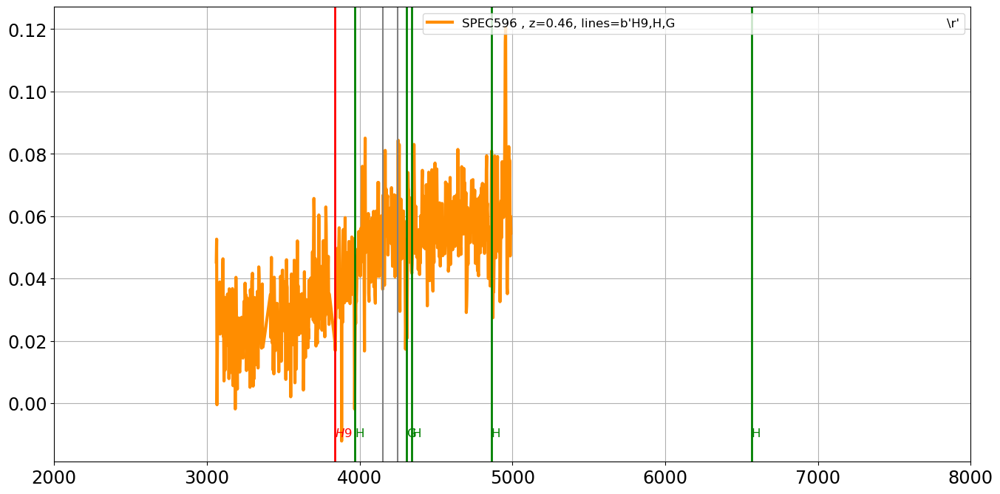

===================== SED 418 : SPEC597 , z=0.60, lines=b'[OII],H9,H8,H{delta}                                                        \r'=======================
the_lines =  b'[OII],H9,H8,H{delta}                                                        \r'
[OII]
H9
H8
H{delta}


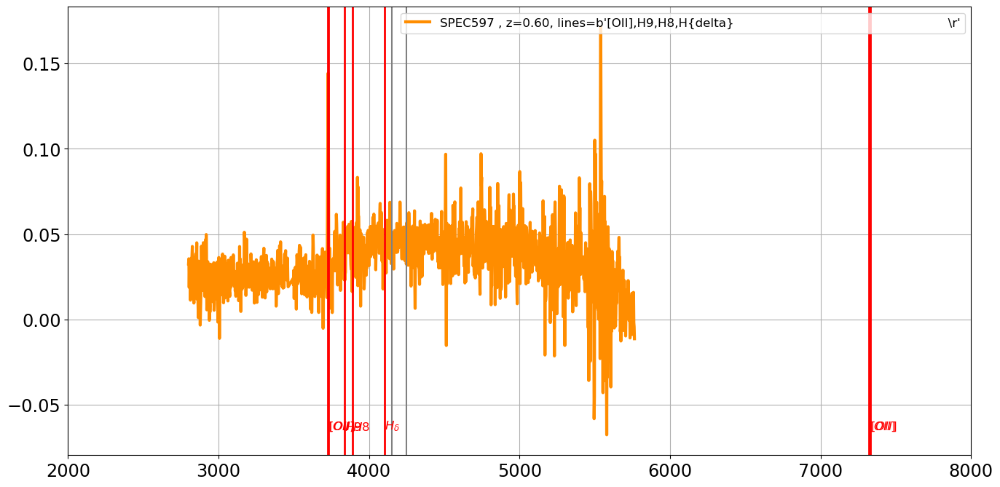

===================== SED 419 : SPEC598 , z=0.43, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


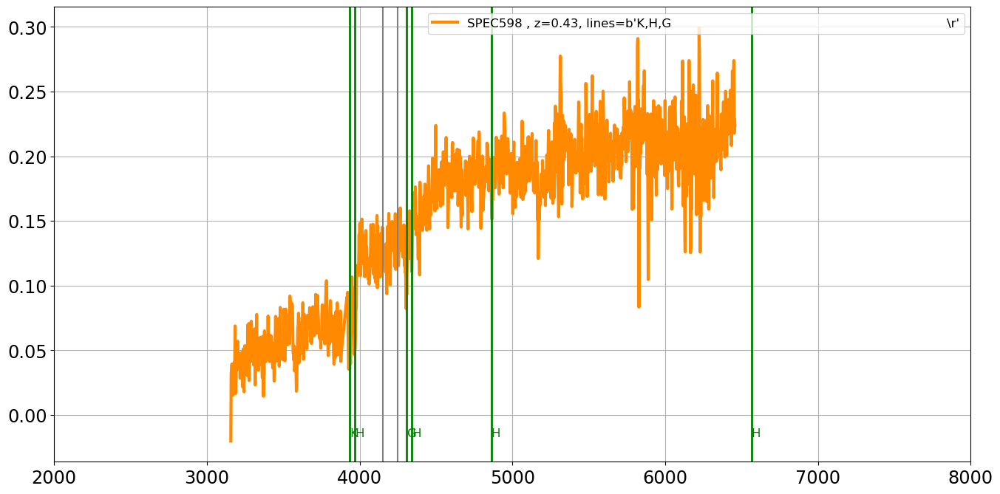

===================== SED 420 : SPEC599 , z=0.36, lines=b'[OII],K,H,H{beta},[OIII]                                                    \r'=======================
the_lines =  b'[OII],K,H,H{beta},[OIII]                                                    \r'
[OII]
K
H
H{beta}
[OIII]


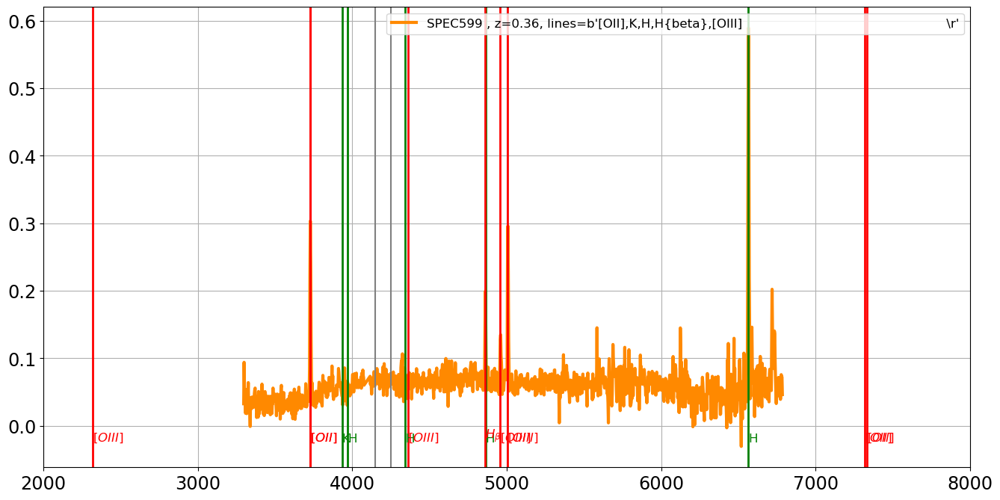

===================== SED 421 : SPEC600 , z=0.24, lines=b'[OII],K,H,[OIII],H{alpha}                                                   \r'=======================
the_lines =  b'[OII],K,H,[OIII],H{alpha}                                                   \r'
[OII]
K
H
[OIII]
H{alpha}


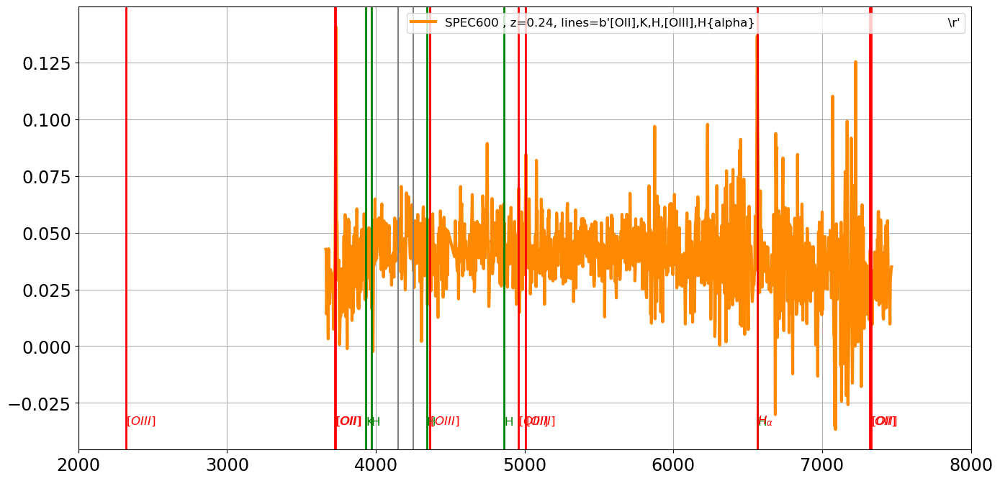

===================== SED 422 : SPEC601 , z=0.29, lines=b'K,H                                                                         \r'=======================
the_lines =  b'K,H                                                                         \r'
K
H


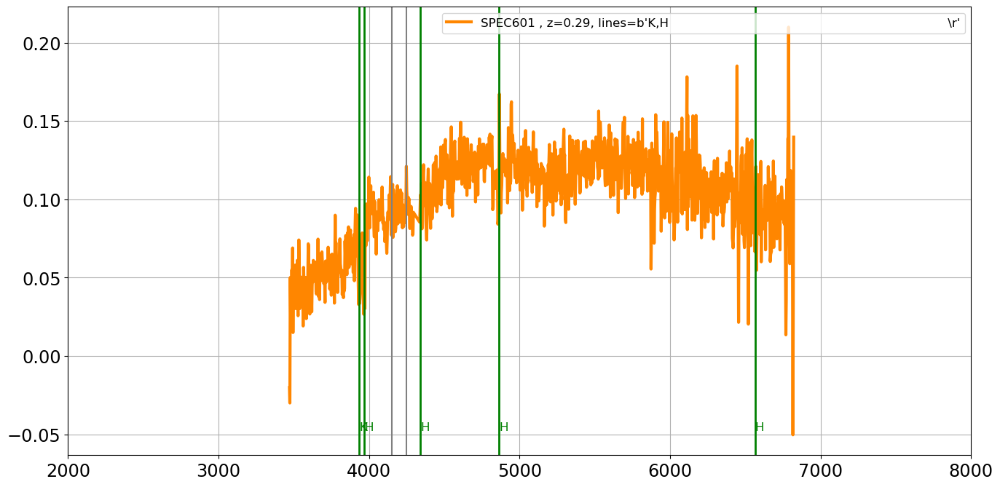

===================== SED 423 : SPEC602 , z=0.44, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


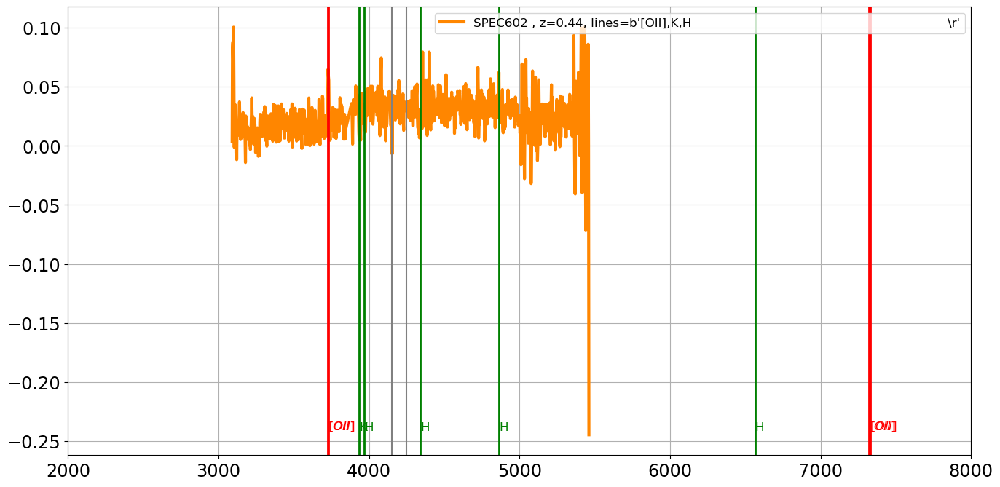

===================== SED 424 : SPEC603 , z=0.39, lines=b'K,H,G,H{beta}                                                               \r'=======================
the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


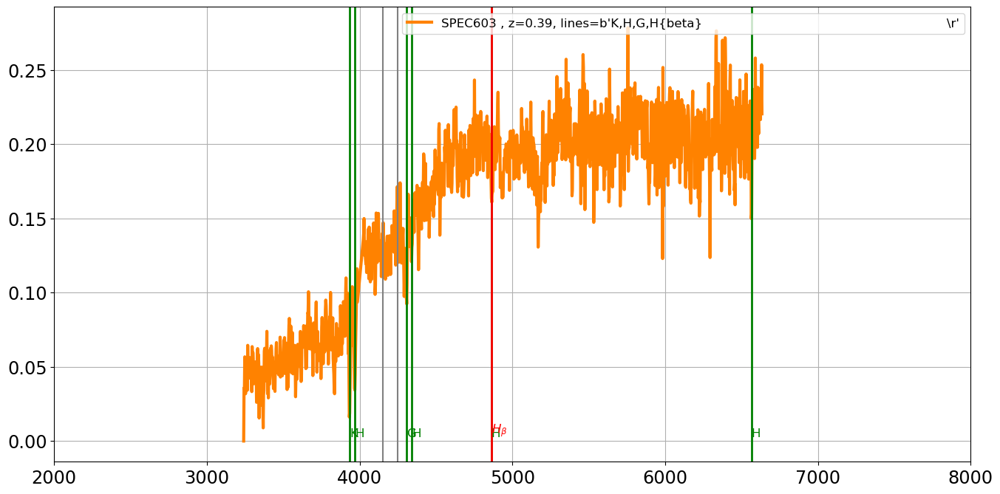

===================== SED 425 : SPEC604 , z=0.10, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


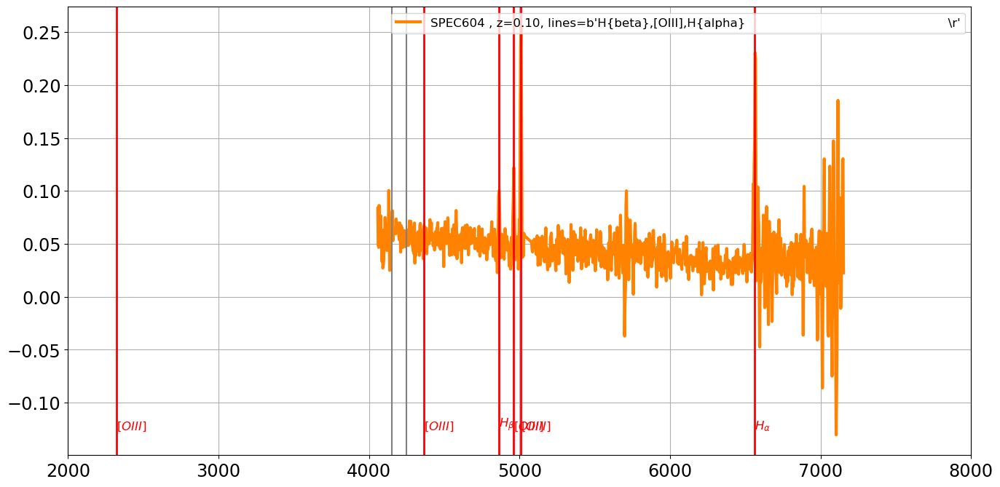

===================== SED 426 : SPEC605 , z=0.29, lines=b'K,H,H{beta},Mgb                                                             \r'=======================
the_lines =  b'K,H,H{beta},Mgb                                                             \r'
K
H
H{beta}
Mgb


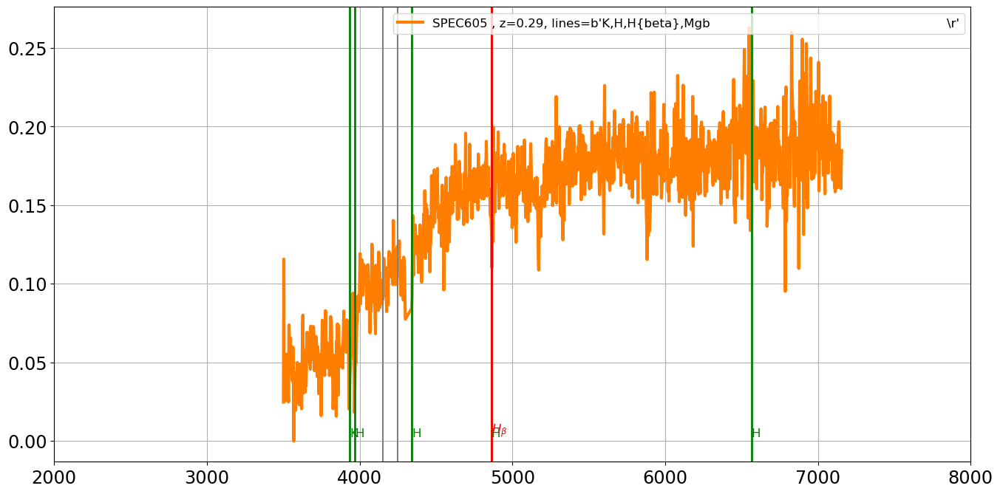

===================== SED 427 : SPEC606 , z=0.44, lines=b'[OII],K,H,4000{AA}-break                                                    \r'=======================
the_lines =  b'[OII],K,H,4000{AA}-break                                                    \r'
[OII]
K
H
4000{AA}-break


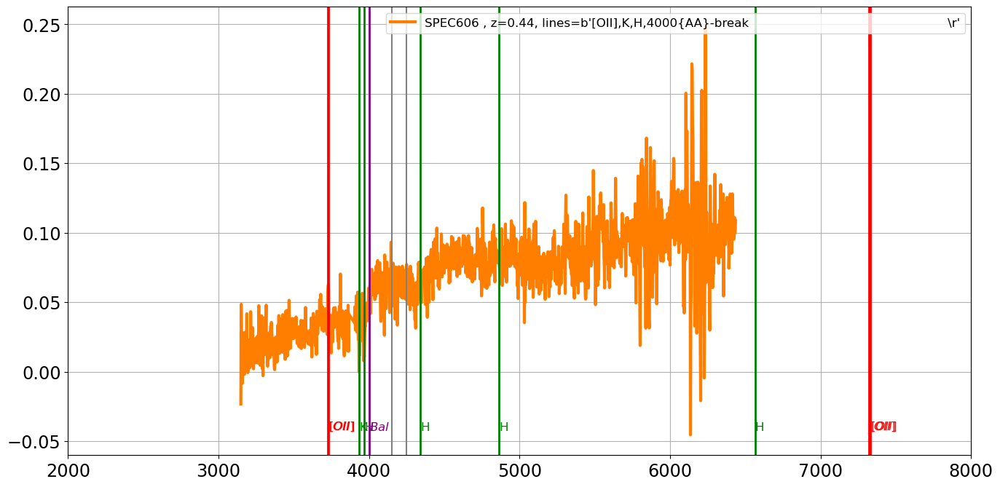

===================== SED 428 : SPEC608 , z=0.60, lines=b'weak,[OII],K,H,4000{AA}-break                                               \r'=======================
the_lines =  b'weak,[OII],K,H,4000{AA}-break                                               \r'
weak
[OII]
K
H
4000{AA}-break


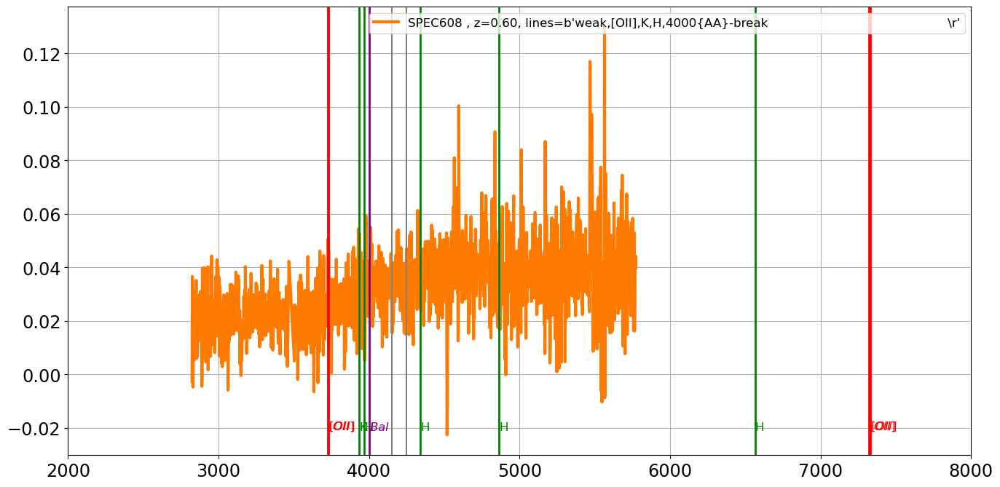

===================== SED 429 : SPEC609 , z=0.17, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


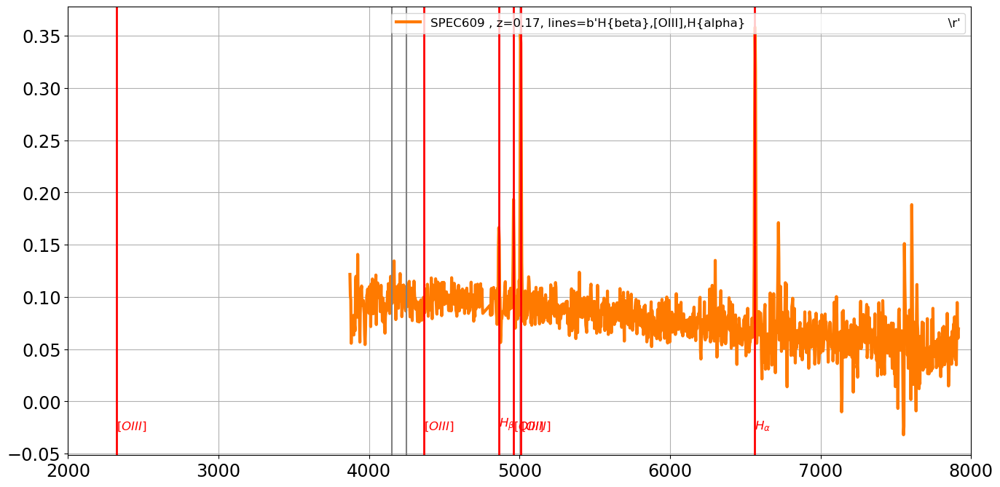

===================== SED 430 : SPEC610 , z=0.44, lines=b'[OII],H9,H8,K,H                                                             \r'=======================
the_lines =  b'[OII],H9,H8,K,H                                                             \r'
[OII]
H9
H8
K
H


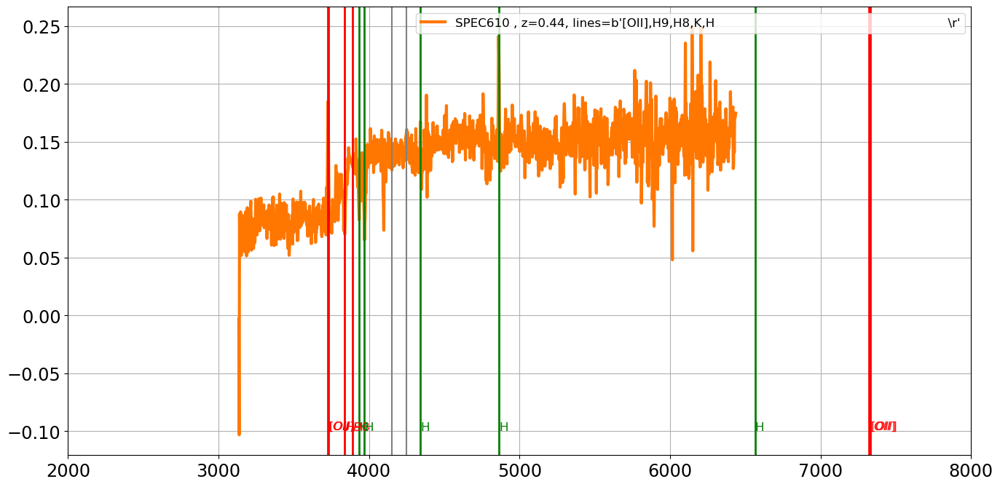

===================== SED 431 : SPEC611 , z=0.44, lines=b'[OII],H8,K,H,H{delta}                                                       \r'=======================
the_lines =  b'[OII],H8,K,H,H{delta}                                                       \r'
[OII]
H8
K
H
H{delta}


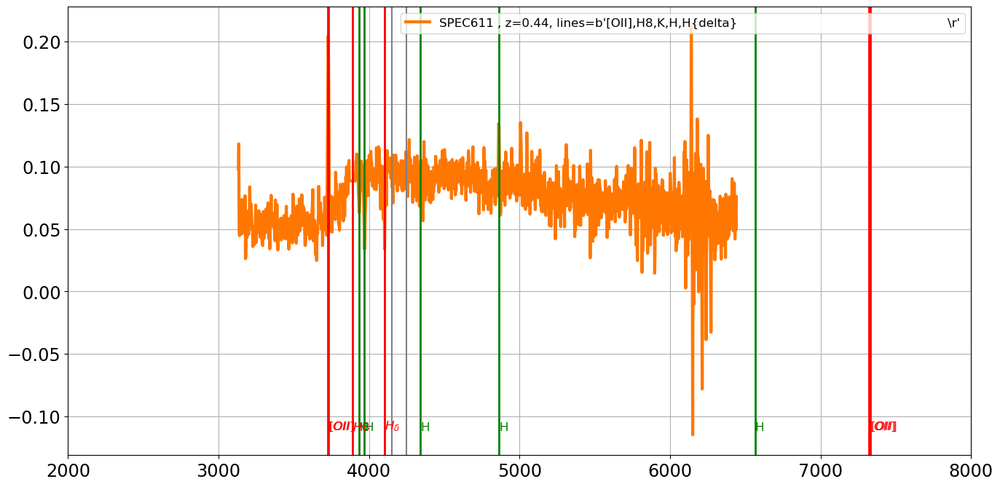

===================== SED 432 : SPEC612 , z=0.72, lines=b'[OII],[OIII]                                                                \r'=======================
the_lines =  b'[OII],[OIII]                                                                \r'
[OII]
[OIII]


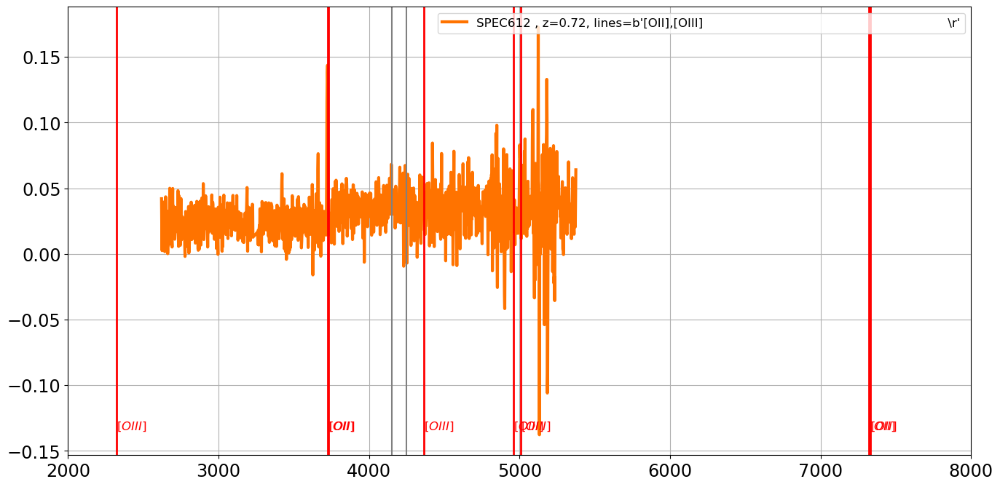

===================== SED 433 : SPEC613 , z=0.77, lines=b'[OII],H9,H8,K                                                               \r'=======================
the_lines =  b'[OII],H9,H8,K                                                               \r'
[OII]
H9
H8
K


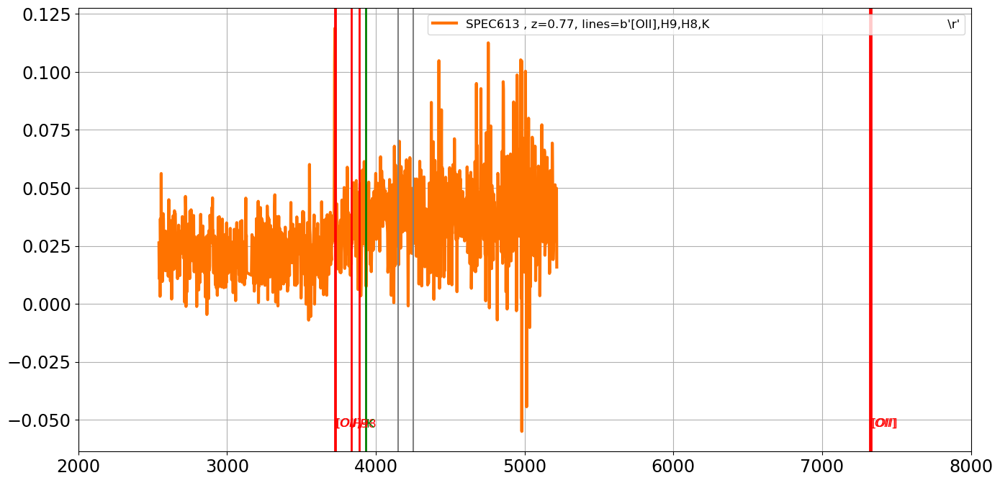

===================== SED 434 : SPEC617 , z=0.36, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


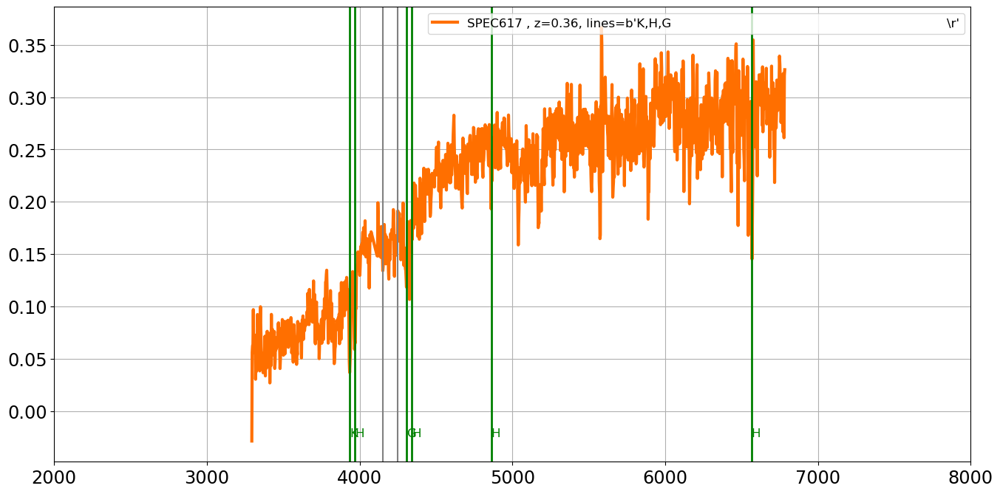

===================== SED 435 : SPEC618 , z=0.36, lines=b'                                                                            \r'=======================
the_lines =  b'                                                                            \r'



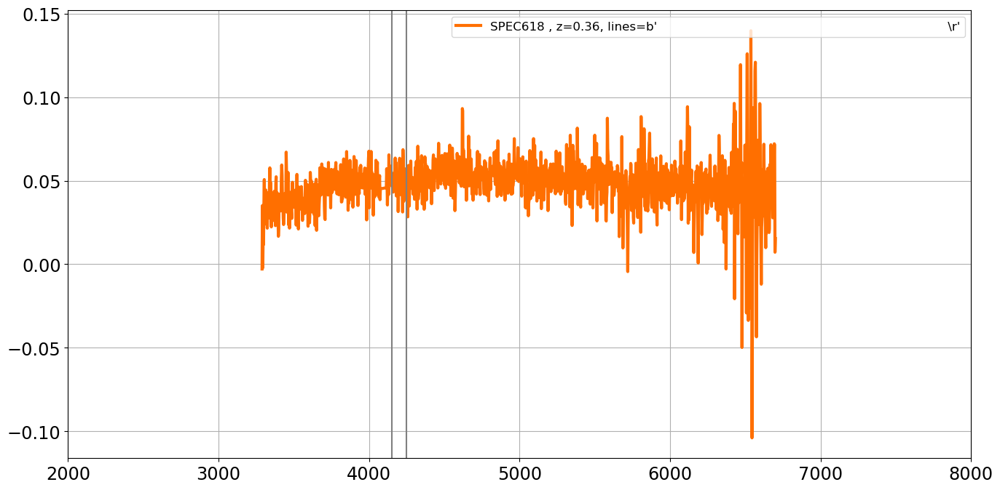

===================== SED 436 : SPEC620 , z=0.37, lines=b'[OII],K,H,H{beta},H{alpha}                                                  \r'=======================
the_lines =  b'[OII],K,H,H{beta},H{alpha}                                                  \r'
[OII]
K
H
H{beta}
H{alpha}


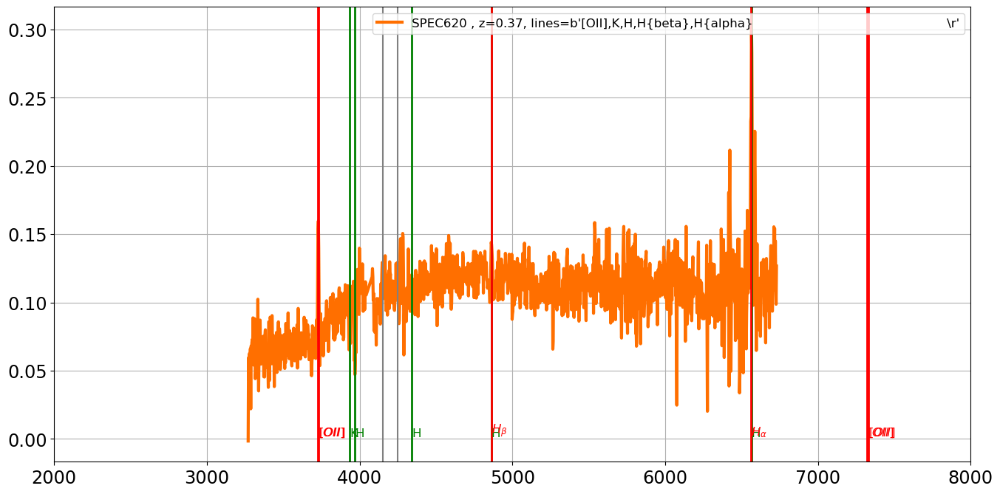

===================== SED 437 : SPEC621 , z=0.59, lines=b'[OII],K                                                                     \r'=======================
the_lines =  b'[OII],K                                                                     \r'
[OII]
K


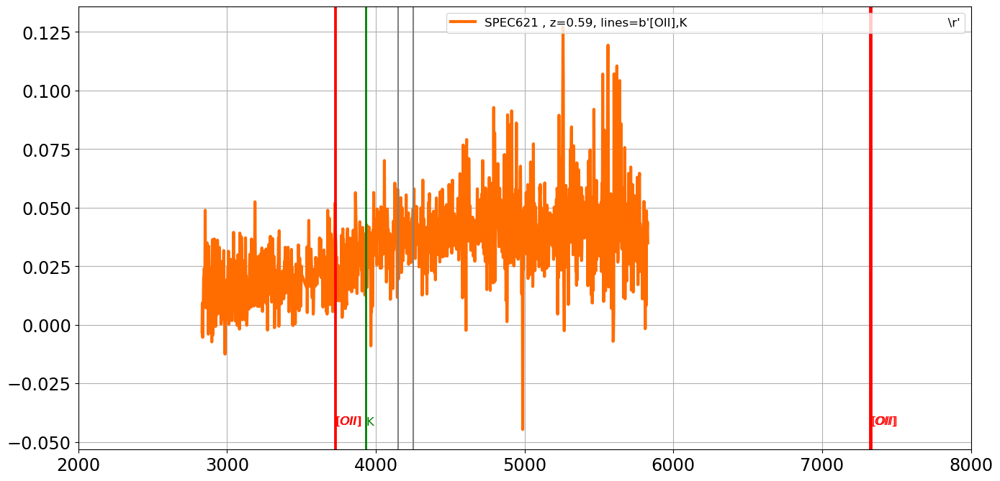

===================== SED 438 : SPEC622 , z=0.69, lines=b'[OII],H{beta}                                                               \r'=======================
the_lines =  b'[OII],H{beta}                                                               \r'
[OII]
H{beta}


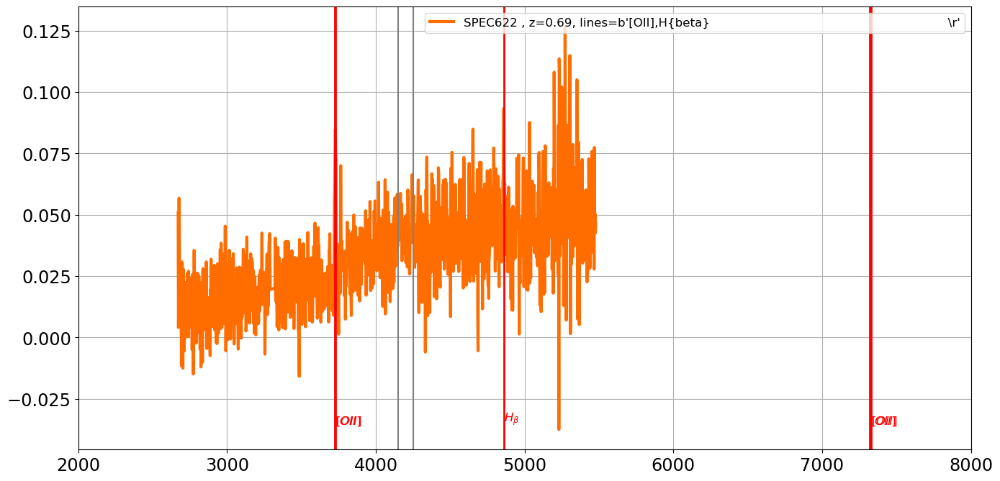

===================== SED 439 : SPEC623 , z=0.69, lines=b'H,4000{AA}-break                                                            \r'=======================
the_lines =  b'H,4000{AA}-break                                                            \r'
H
4000{AA}-break


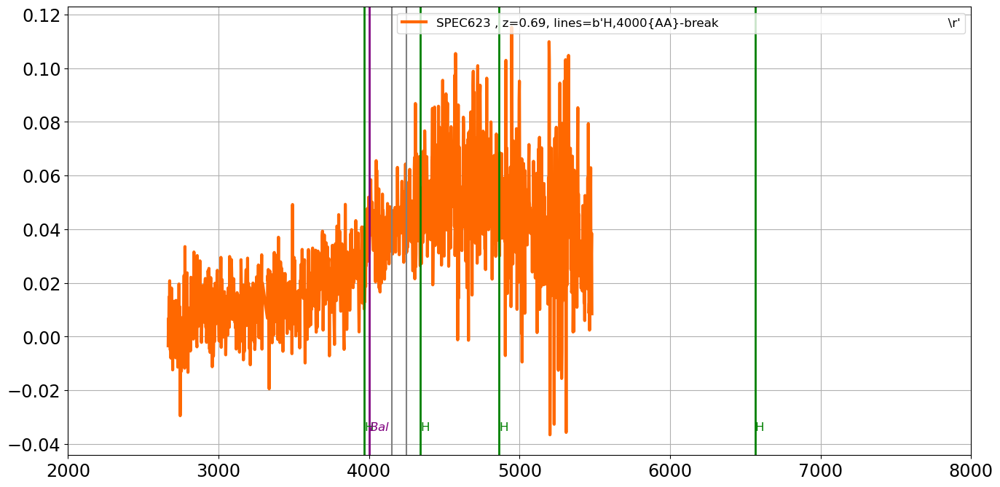

===================== SED 440 : SPEC624 , z=0.58, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


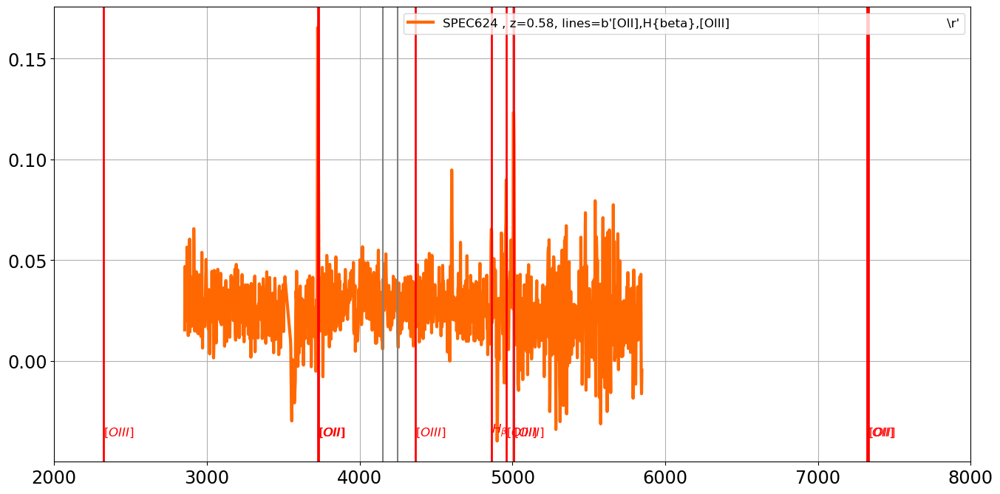

===================== SED 441 : SPEC625 , z=0.65, lines=b'[OII],[OIII]                                                                \r'=======================
the_lines =  b'[OII],[OIII]                                                                \r'
[OII]
[OIII]


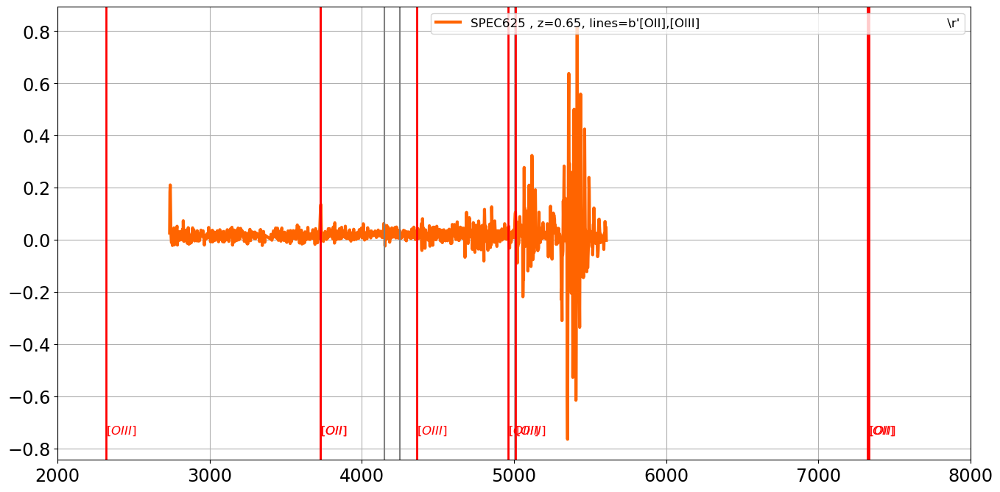

===================== SED 442 : SPEC626 , z=0.25, lines=b'[OII],H8,K,H                                                                \r'=======================
the_lines =  b'[OII],H8,K,H                                                                \r'
[OII]
H8
K
H


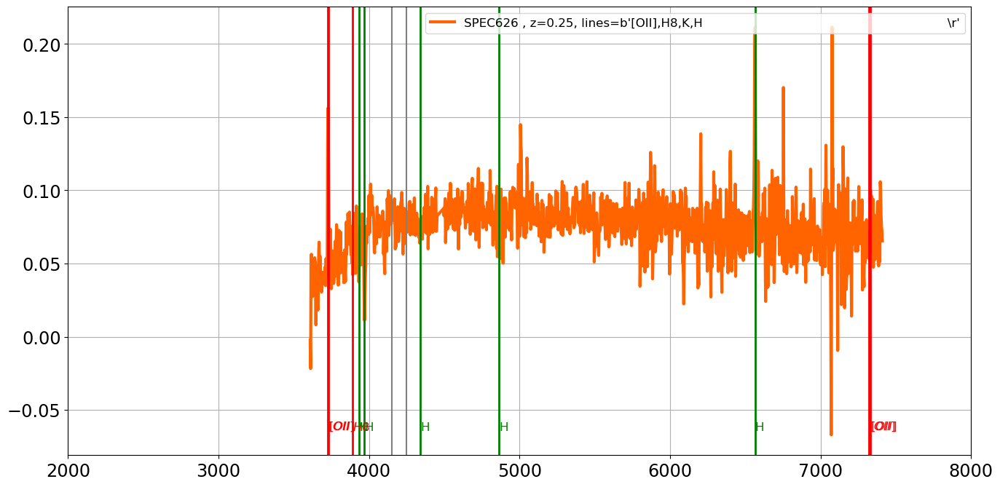

===================== SED 443 : SPEC627 , z=0.96, lines=b'MgII,[OII]                                                                  \r'=======================
the_lines =  b'MgII,[OII]                                                                  \r'
MgII
[OII]


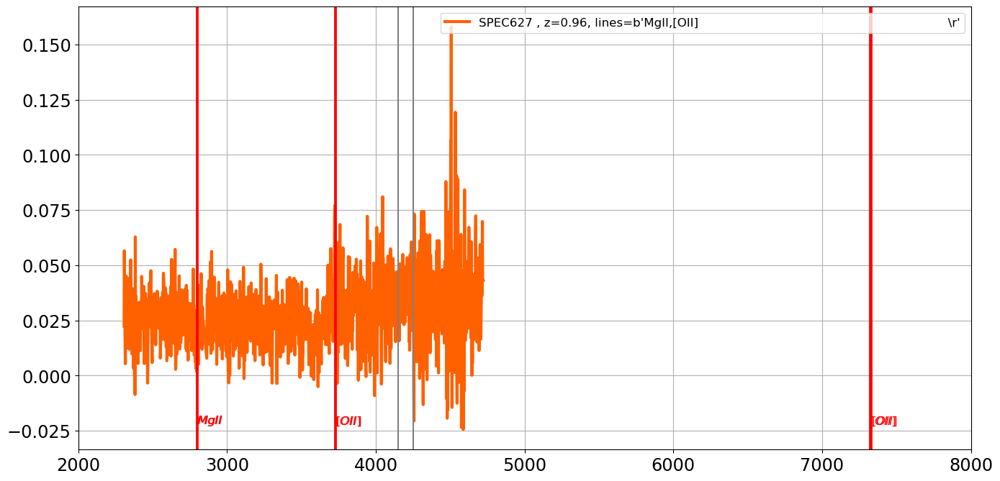

===================== SED 444 : SPEC628 , z=0.48, lines=b'[OII],H8,K,H                                                                \r'=======================
the_lines =  b'[OII],H8,K,H                                                                \r'
[OII]
H8
K
H


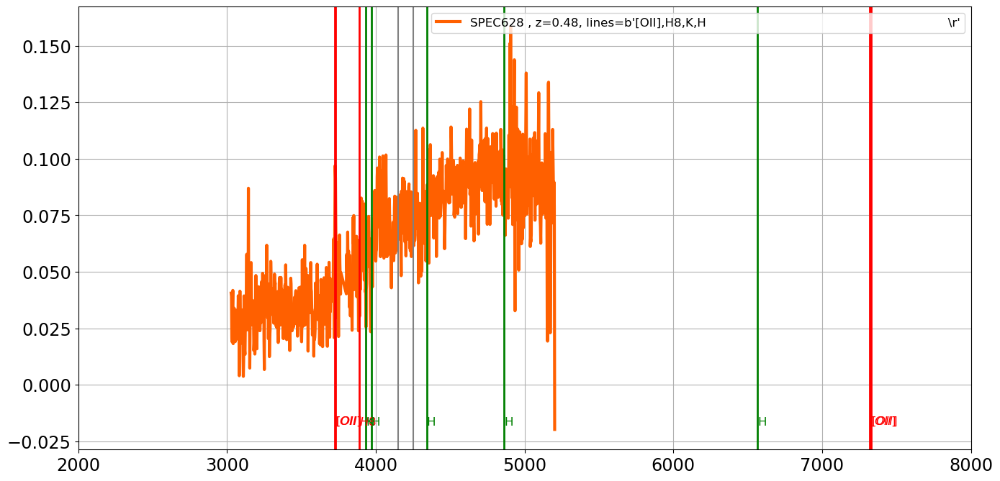

===================== SED 445 : SPEC629 , z=0.50, lines=b'[OII],H,H{beta}                                                             \r'=======================
the_lines =  b'[OII],H,H{beta}                                                             \r'
[OII]
H
H{beta}


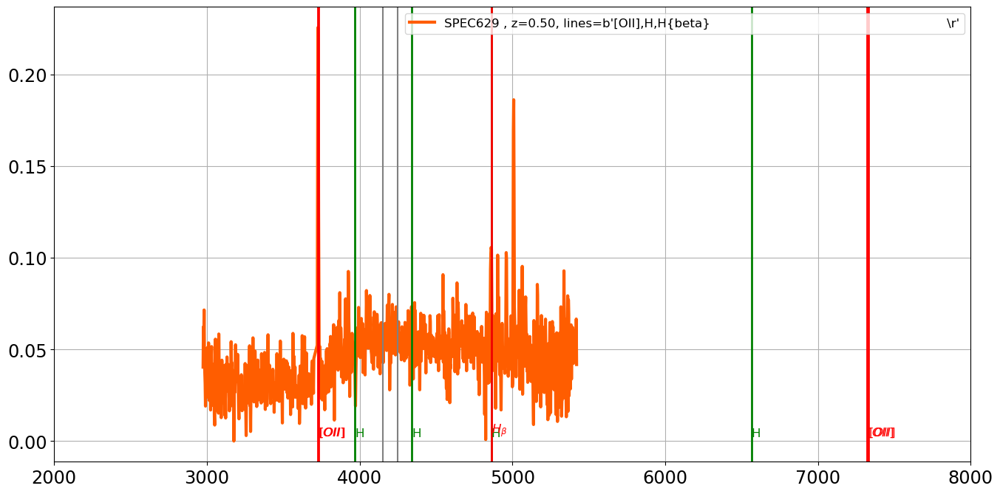

===================== SED 446 : SPEC630 , z=0.19, lines=b'K,H,H{beta},[OIII],H{alpha}                                                 \r'=======================
the_lines =  b'K,H,H{beta},[OIII],H{alpha}                                                 \r'
K
H
H{beta}
[OIII]
H{alpha}


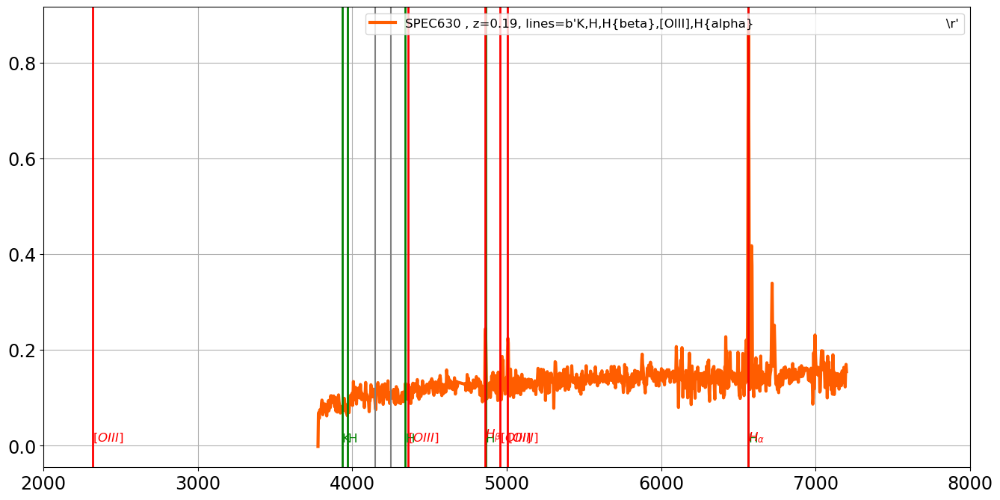

===================== SED 447 : SPEC631 , z=0.82, lines=b'FeII26,MgII,[OII],H8,H                                                      \r'=======================
the_lines =  b'FeII26,MgII,[OII],H8,H                                                      \r'
FeII26
MgII
[OII]
H8
H


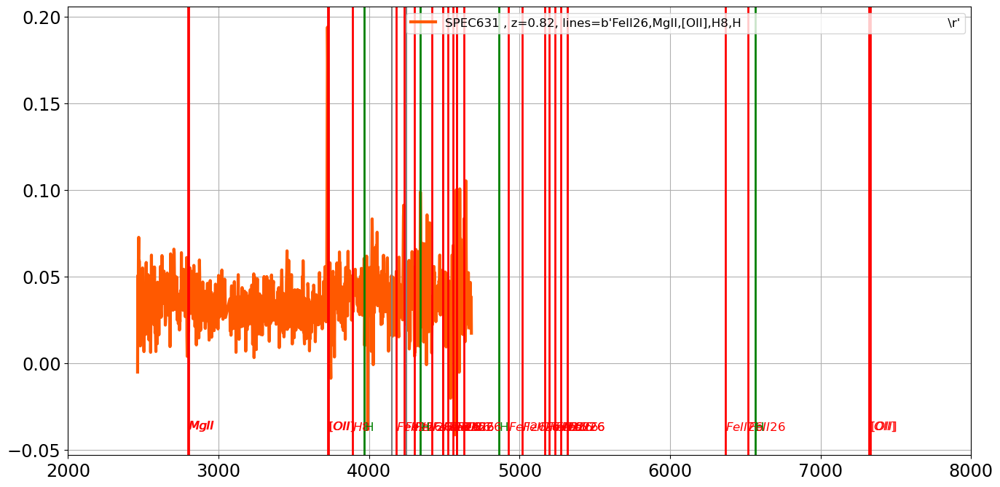

===================== SED 448 : SPEC632 , z=0.37, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


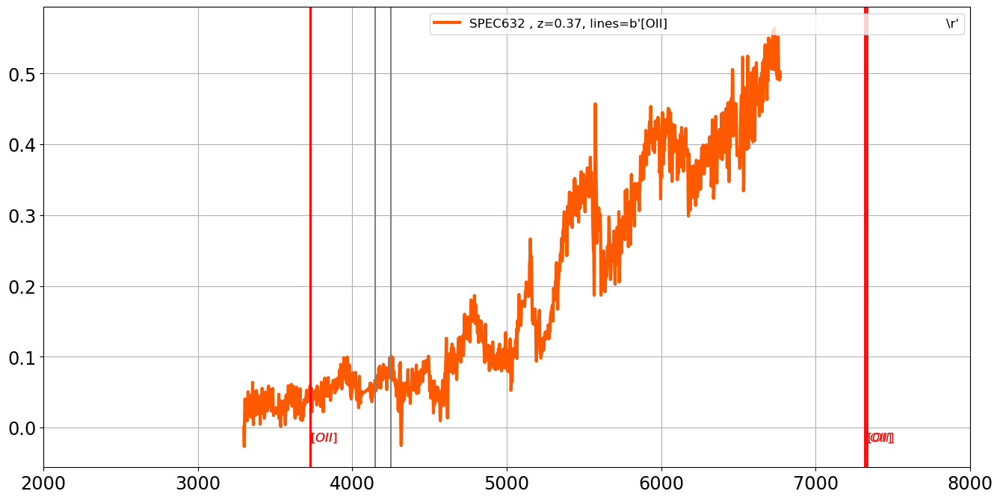

===================== SED 449 : SPEC633 , z=0.69, lines=b'MgII,[OII],H9,H,H{beta}                                                     \r'=======================
the_lines =  b'MgII,[OII],H9,H,H{beta}                                                     \r'
MgII
[OII]
H9
H
H{beta}


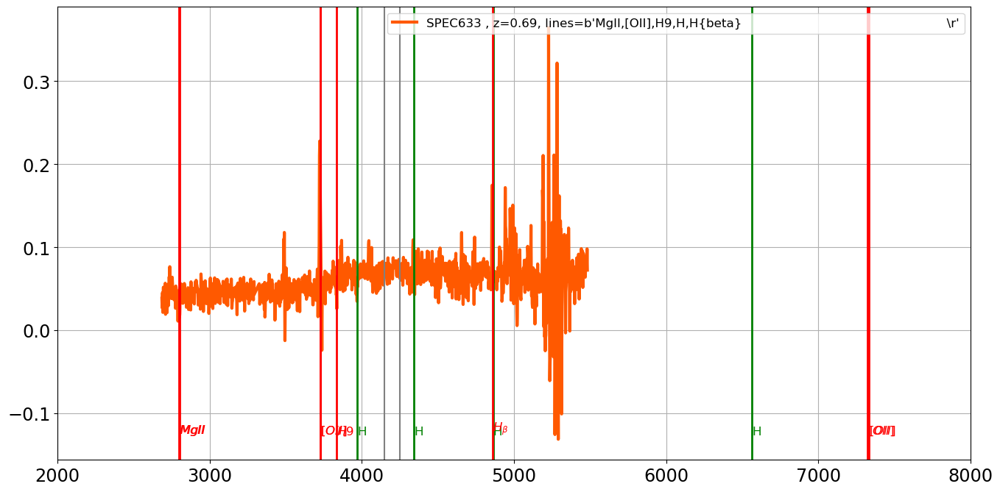

===================== SED 450 : SPEC634 , z=0.65, lines=b'weak,[OII],H,4000{AA}-break                                                 \r'=======================
the_lines =  b'weak,[OII],H,4000{AA}-break                                                 \r'
weak
[OII]
H
4000{AA}-break


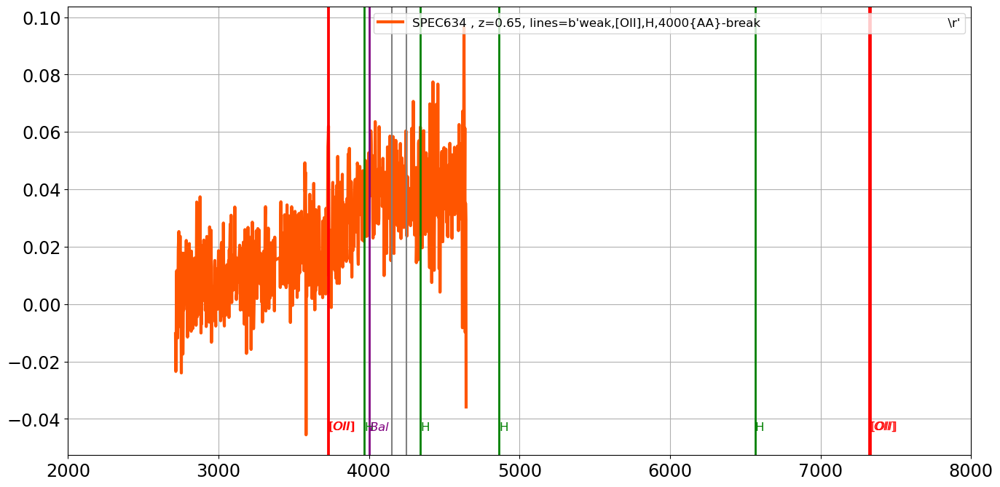

===================== SED 451 : SPEC635 , z=0.68, lines=b'[OII],H9,H{beta},[OIII]                                                     \r'=======================
the_lines =  b'[OII],H9,H{beta},[OIII]                                                     \r'
[OII]
H9
H{beta}
[OIII]


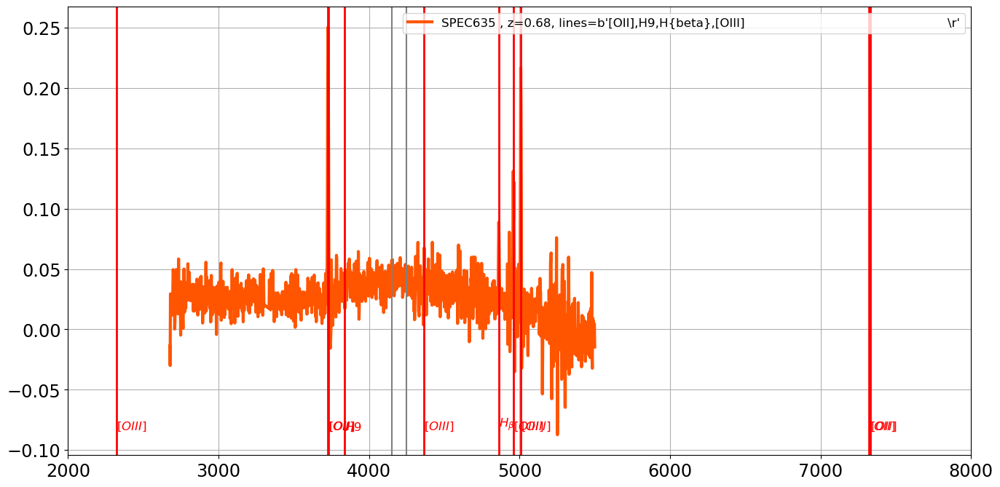

===================== SED 452 : SPEC636 , z=0.50, lines=b'[OII],H9,K,H                                                                \r'=======================
the_lines =  b'[OII],H9,K,H                                                                \r'
[OII]
H9
K
H


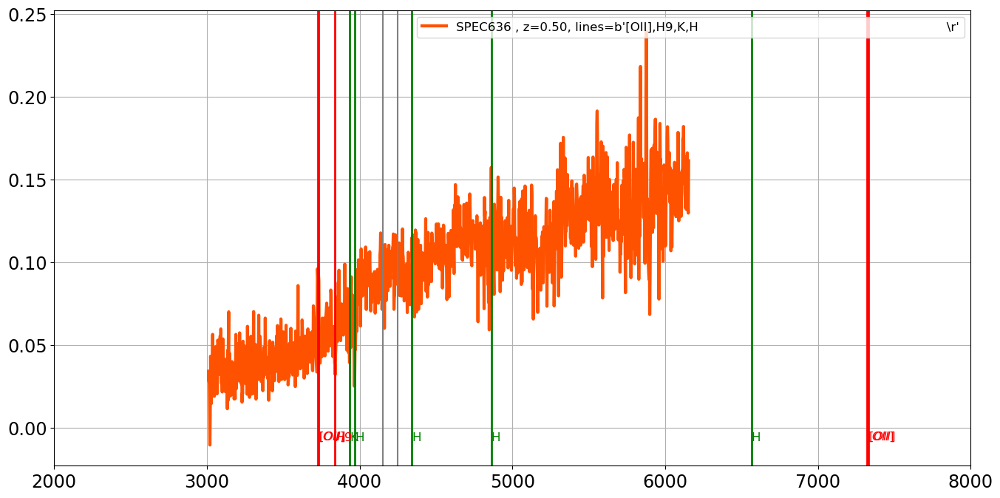

===================== SED 453 : SPEC637 , z=0.69, lines=b'AlII,K,H,4000{AA}-break                                                     \r'=======================
the_lines =  b'AlII,K,H,4000{AA}-break                                                     \r'
AlII
K
H
4000{AA}-break


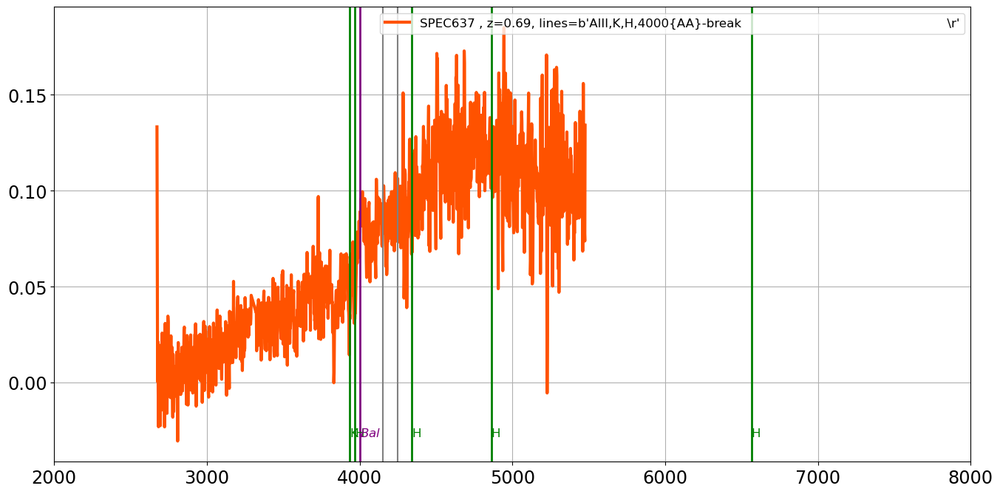

===================== SED 454 : SPEC638 , z=0.41, lines=b'[OII],H9,H                                                                  \r'=======================
the_lines =  b'[OII],H9,H                                                                  \r'
[OII]
H9
H


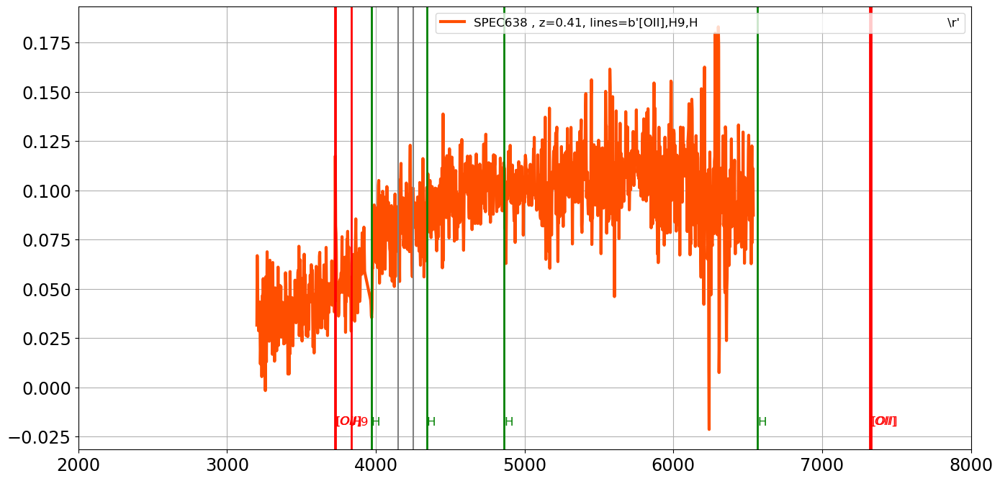

===================== SED 455 : SPEC639 , z=1.22, lines=b'FeII24,FeII26,MgII,[OII]                                                    \r'=======================
the_lines =  b'FeII24,FeII26,MgII,[OII]                                                    \r'
FeII24
FeII26
MgII
[OII]


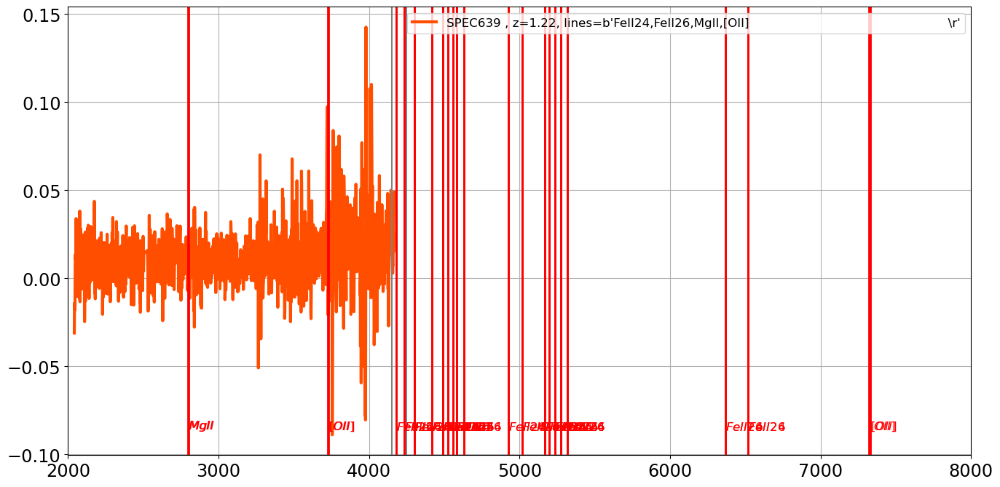

===================== SED 456 : SPEC640 , z=0.25, lines=b'[OII],H{beta},[OIII]                                                        \r'=======================
the_lines =  b'[OII],H{beta},[OIII]                                                        \r'
[OII]
H{beta}
[OIII]


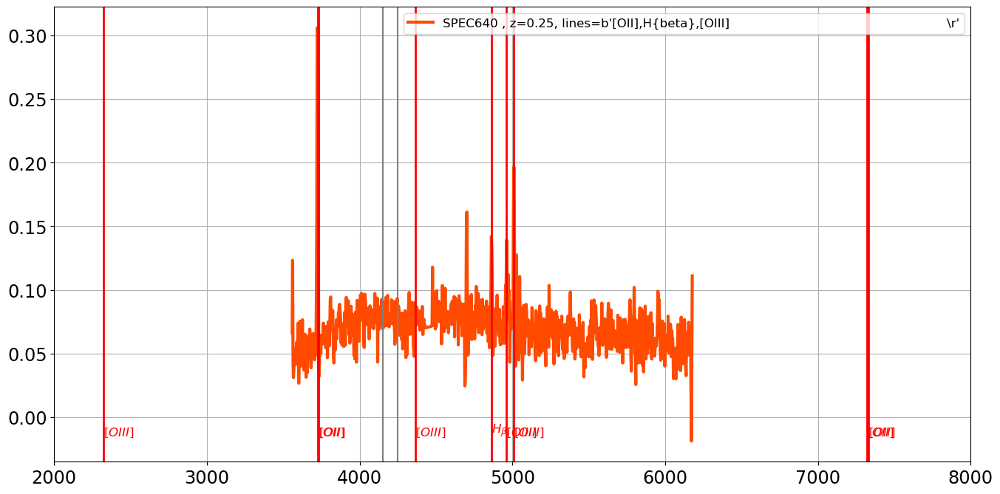

===================== SED 457 : SPEC641 , z=0.29, lines=b'[OII],[OIII]                                                                \r'=======================
the_lines =  b'[OII],[OIII]                                                                \r'
[OII]
[OIII]


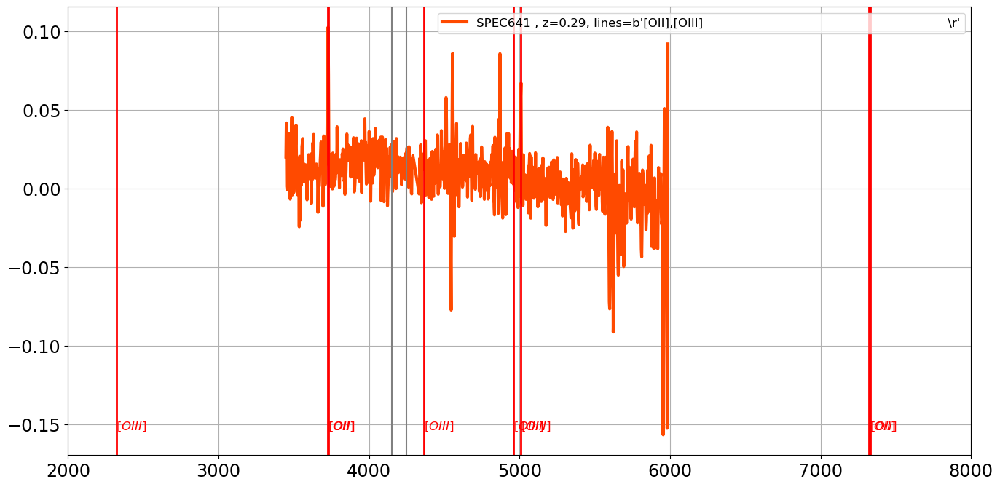

===================== SED 458 : SPEC642 , z=0.49, lines=b'[OII],H10,H{gamma},H{beta},[OIII]                                           \r'=======================
the_lines =  b'[OII],H10,H{gamma},H{beta},[OIII]                                           \r'
[OII]
H10
H{gamma}
H{beta}
[OIII]


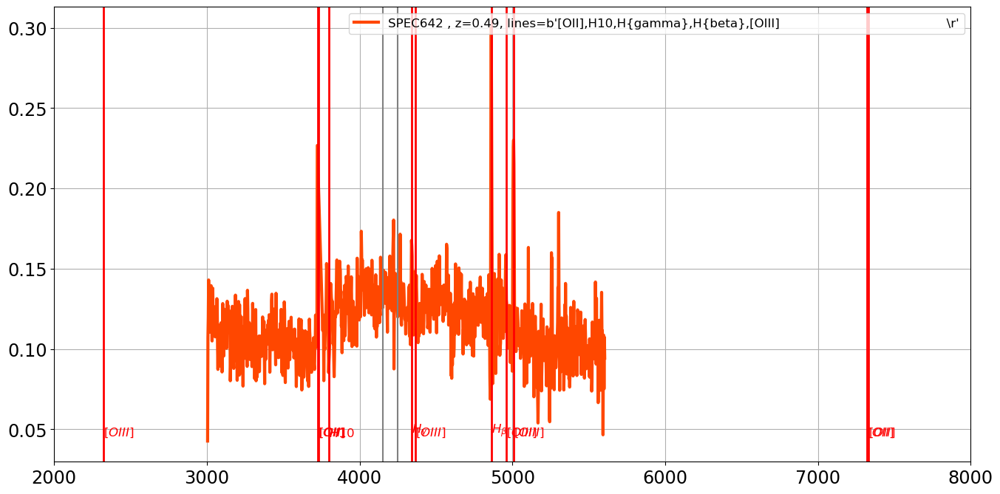

===================== SED 459 : SPEC643 , z=0.17, lines=b'H8,K,H,4000{AA}-break                                                       \r'=======================
the_lines =  b'H8,K,H,4000{AA}-break                                                       \r'
H8
K
H
4000{AA}-break


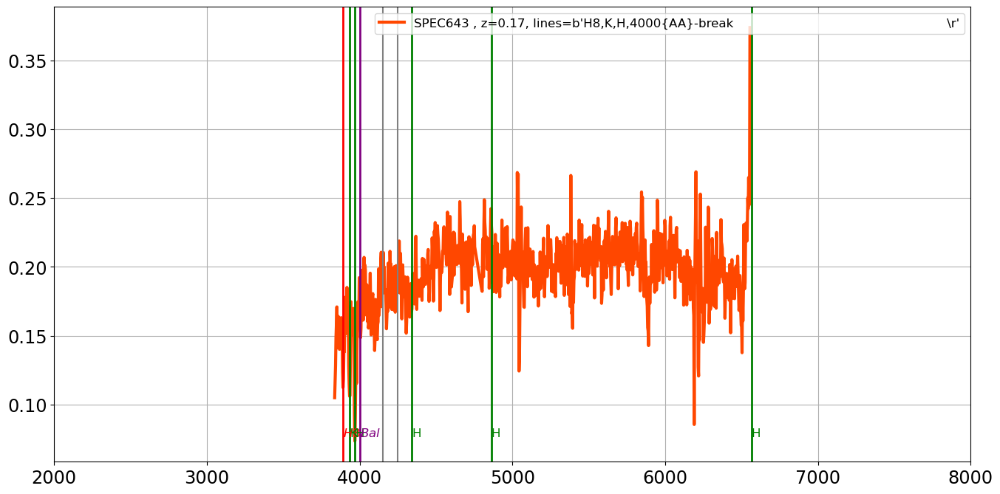

===================== SED 460 : SPEC644 , z=0.44, lines=b'[OII],H9,K,H                                                                \r'=======================
the_lines =  b'[OII],H9,K,H                                                                \r'
[OII]
H9
K
H


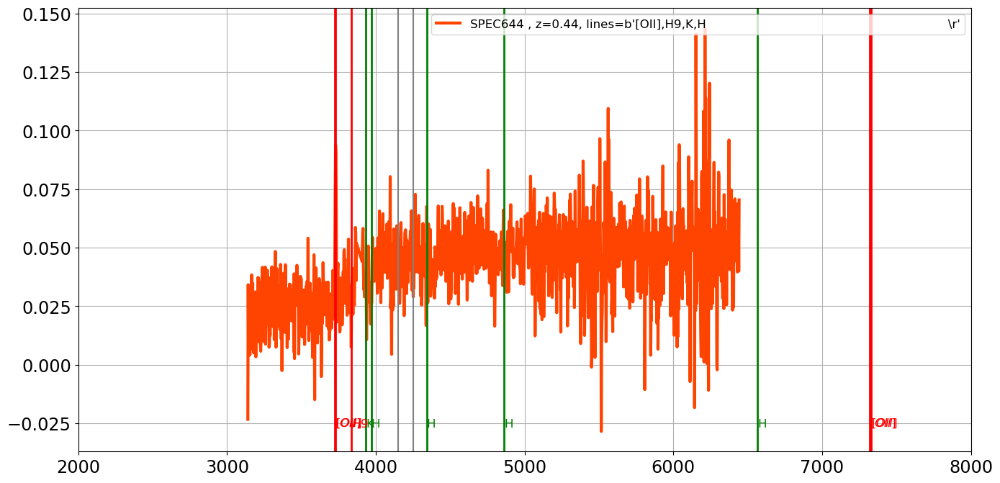

===================== SED 461 : SPEC645 , z=0.12, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


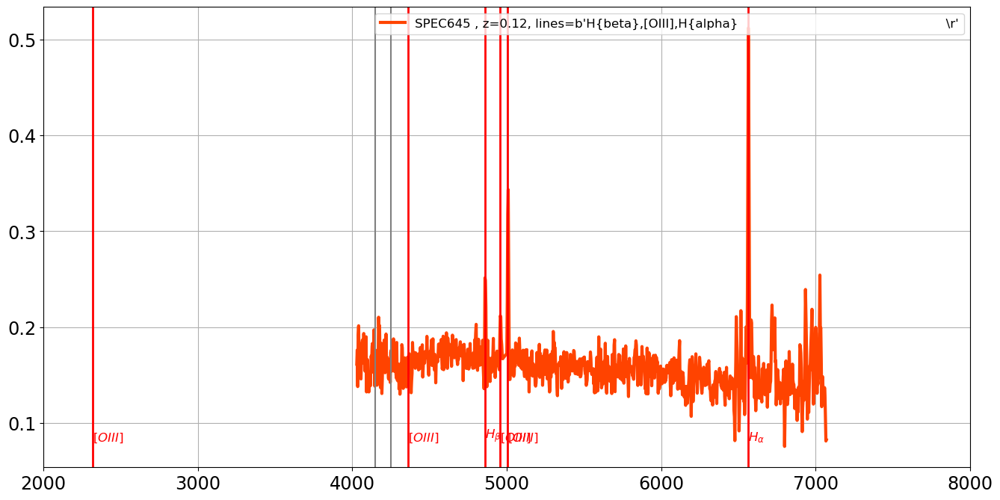

===================== SED 462 : SPEC646 , z=0.35, lines=b'[OII],H,H{beta},[OIII]                                                      \r'=======================
the_lines =  b'[OII],H,H{beta},[OIII]                                                      \r'
[OII]
H
H{beta}
[OIII]


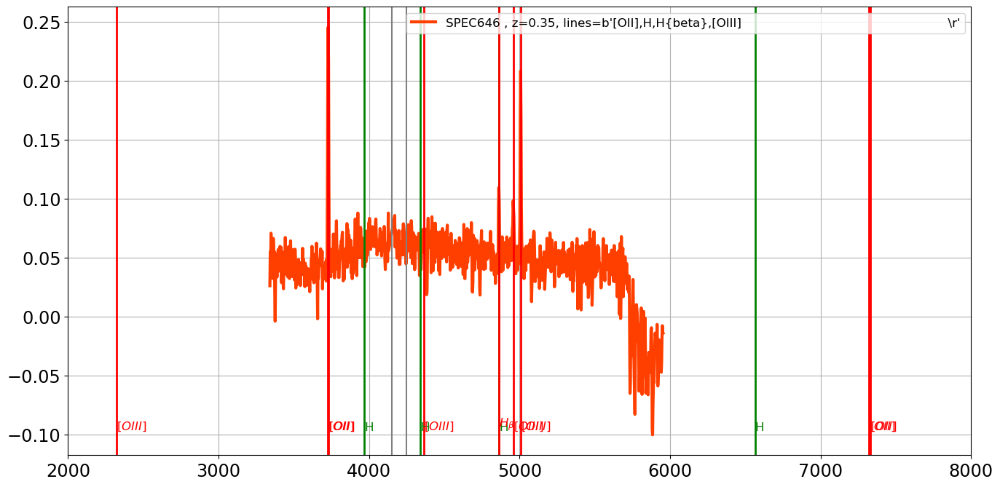

===================== SED 463 : SPEC647 , z=0.10, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


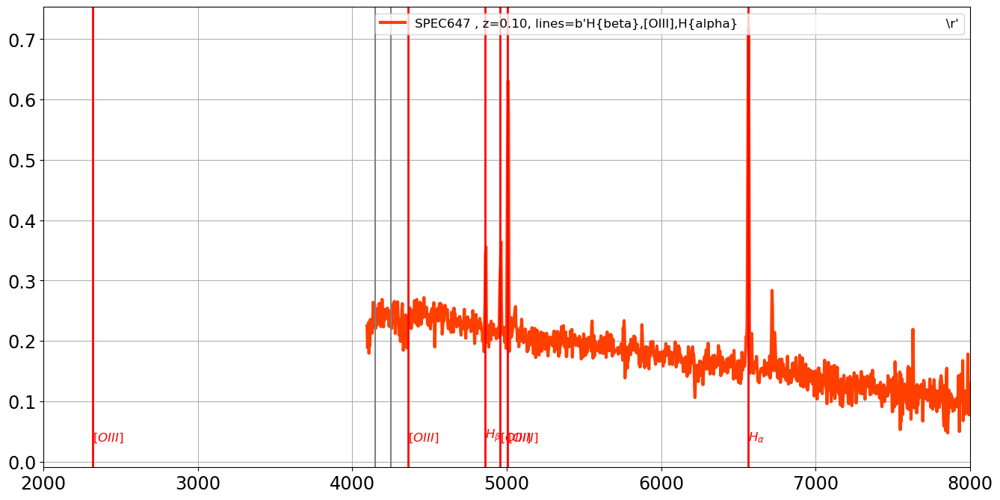

===================== SED 464 : SPEC648 , z=0.63, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


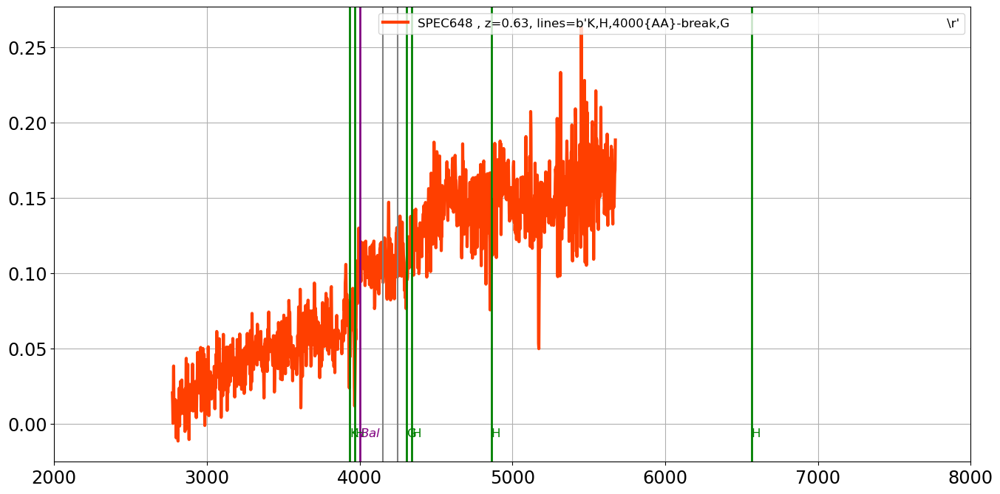

===================== SED 465 : SPEC649 , z=0.41, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


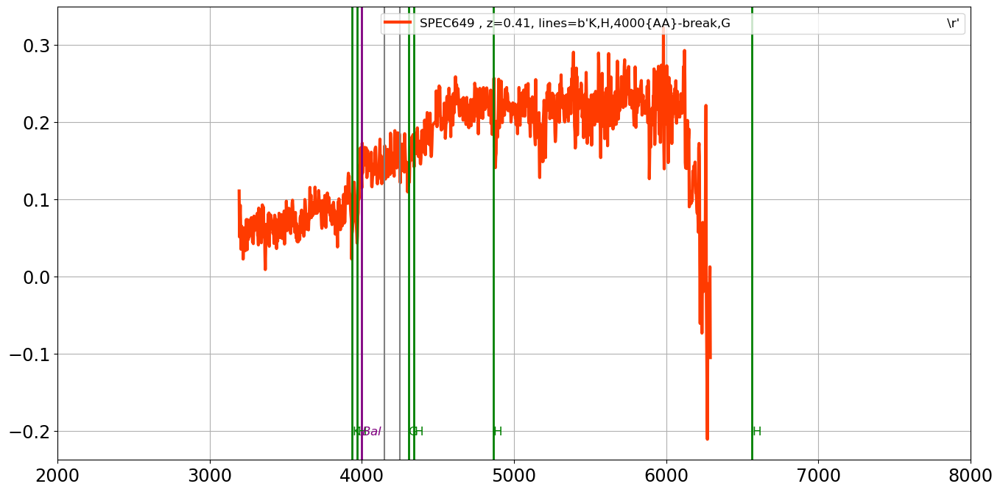

===================== SED 466 : SPEC650 , z=0.07, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


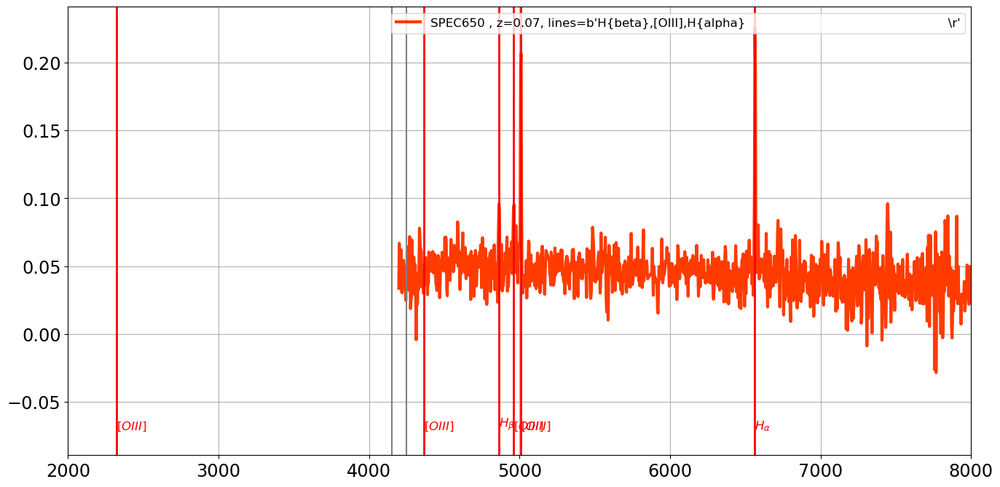

===================== SED 467 : SPEC651 , z=0.52, lines=b'[OII],H9,H,H{delta}                                                         \r'=======================
the_lines =  b'[OII],H9,H,H{delta}                                                         \r'
[OII]
H9
H
H{delta}


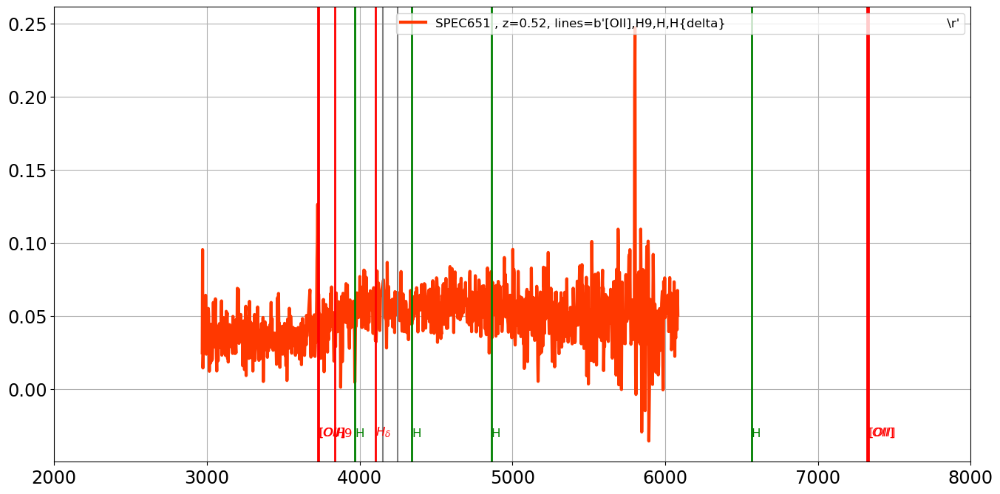

===================== SED 468 : SPEC652 , z=0.64, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


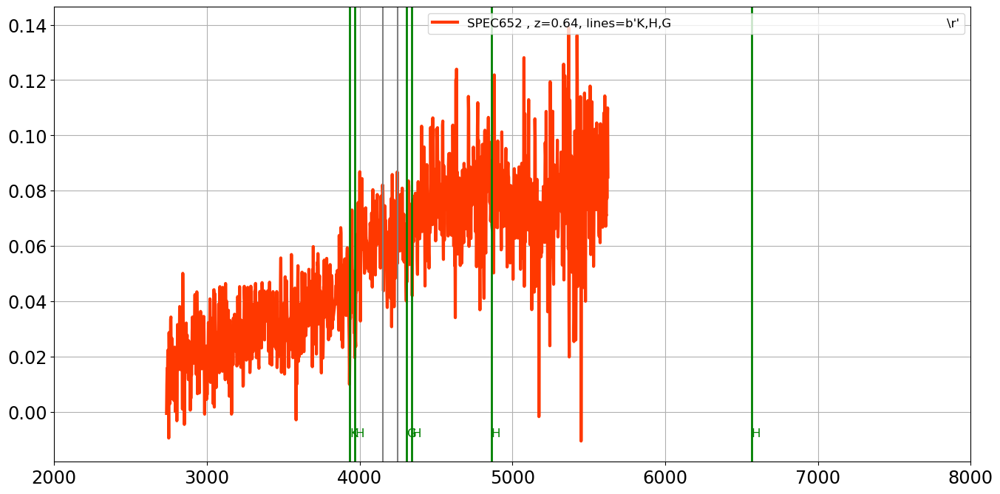

===================== SED 469 : SPEC653 , z=0.27, lines=b'[OII],H9,H8,K,H,H{beta},H{alpha}                                            \r'=======================
the_lines =  b'[OII],H9,H8,K,H,H{beta},H{alpha}                                            \r'
[OII]
H9
H8
K
H
H{beta}
H{alpha}


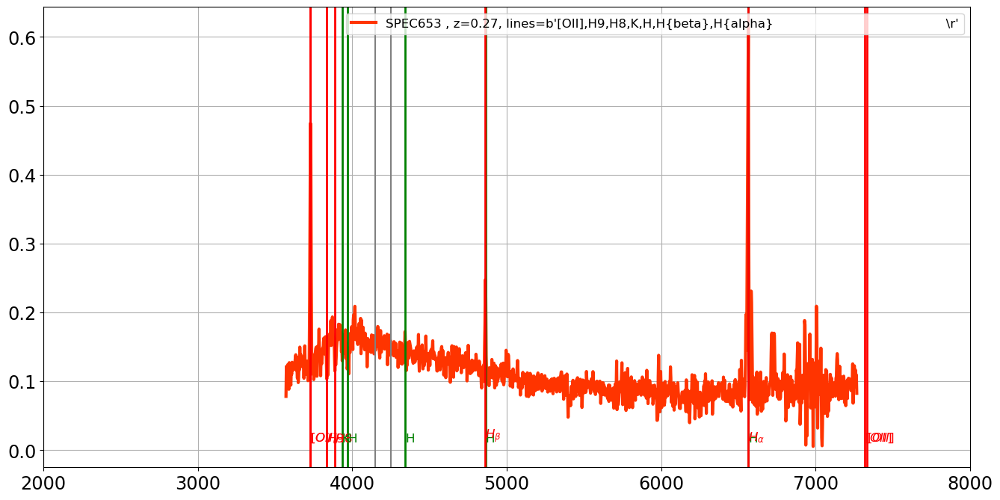

===================== SED 470 : SPEC654 , z=0.45, lines=b'[OII],H9,K,H,H{beta},[OIII]                                                 \r'=======================
the_lines =  b'[OII],H9,K,H,H{beta},[OIII]                                                 \r'
[OII]
H9
K
H
H{beta}
[OIII]


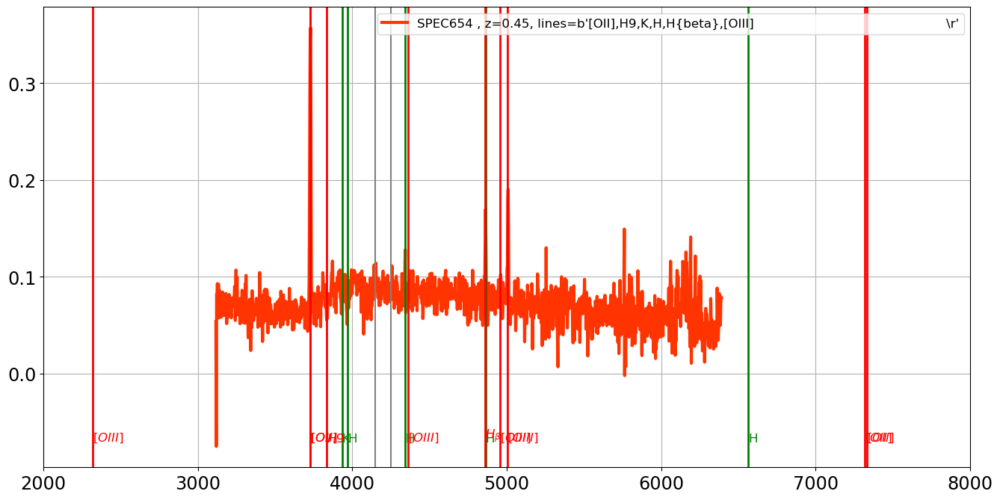

===================== SED 471 : SPEC655 , z=0.12, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


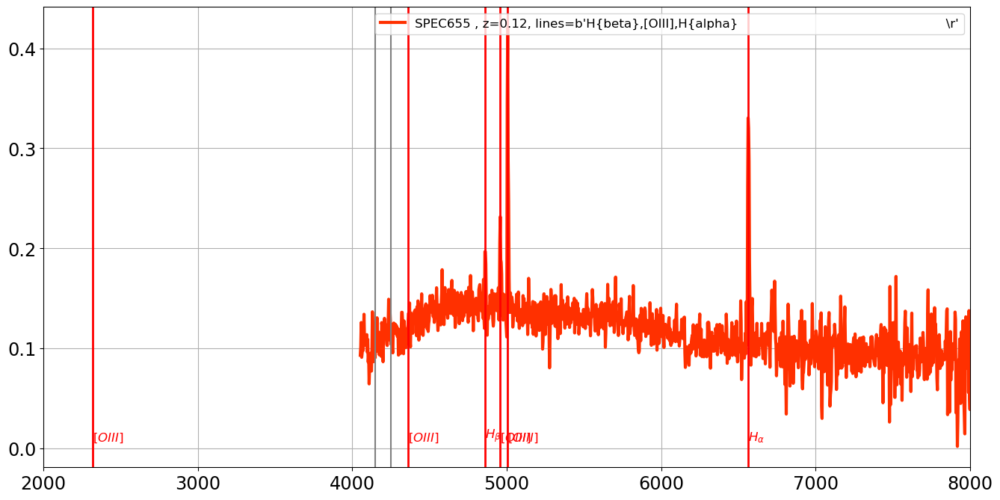

===================== SED 472 : SPEC656 , z=0.45, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


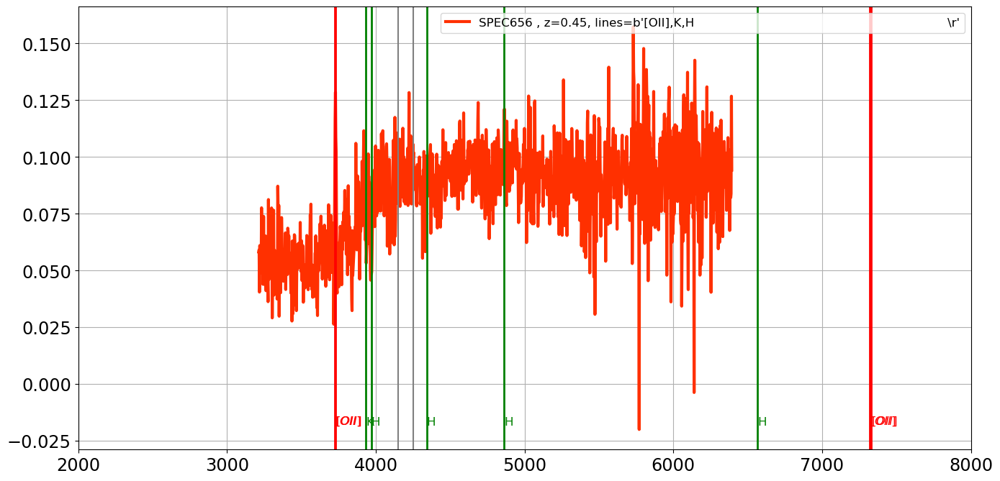

===================== SED 473 : SPEC657 , z=0.13, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


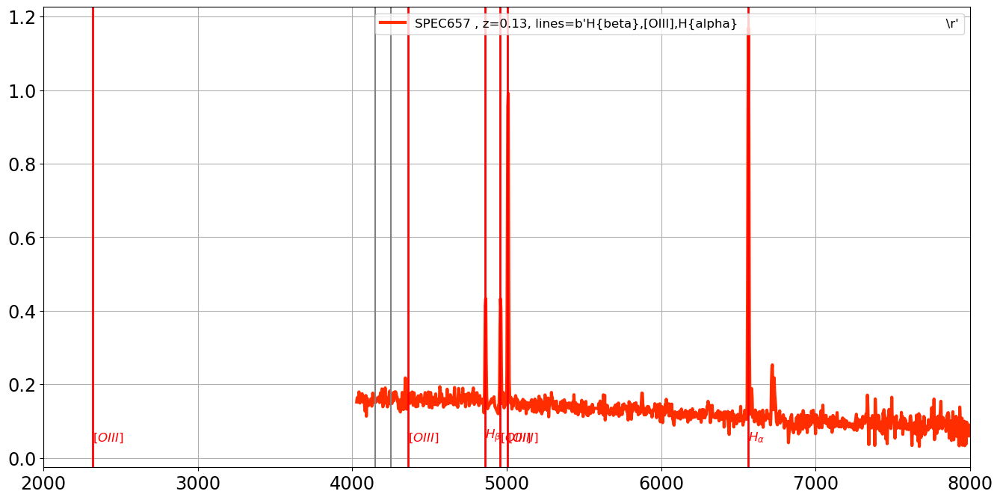

===================== SED 474 : SPEC658 , z=0.43, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


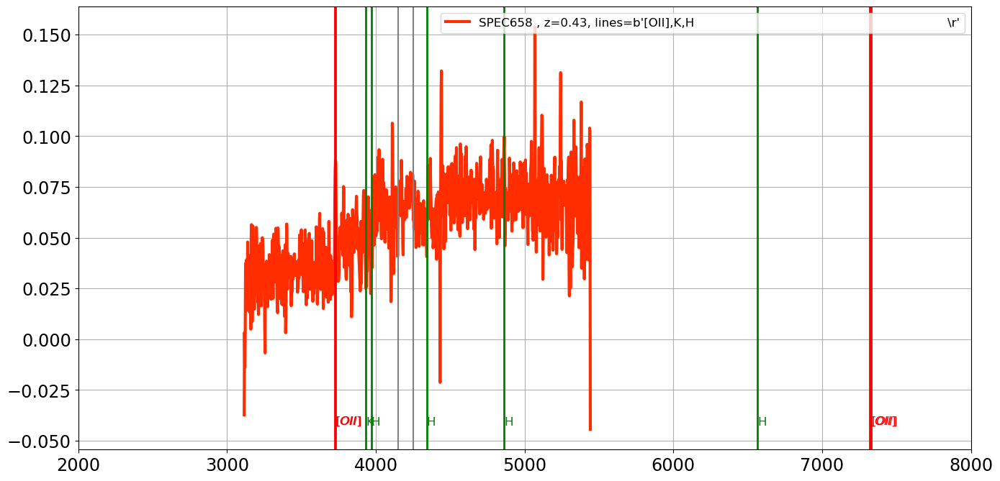

===================== SED 475 : SPEC659 , z=0.20, lines=b'K,H,H{alpha}                                                                \r'=======================
the_lines =  b'K,H,H{alpha}                                                                \r'
K
H
H{alpha}


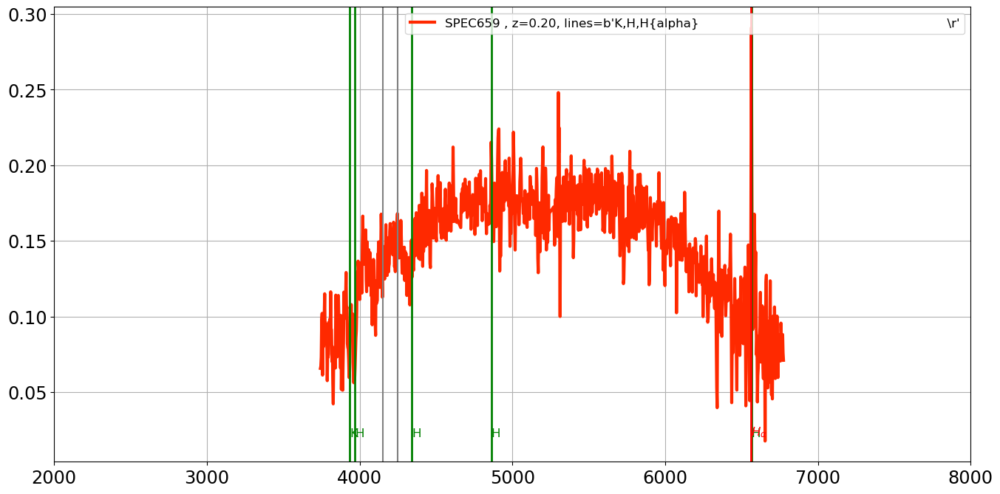

===================== SED 476 : SPEC660 , z=0.41, lines=b'[OII],H9,H8,K,H{delta},H{beta}                                              \r'=======================
the_lines =  b'[OII],H9,H8,K,H{delta},H{beta}                                              \r'
[OII]
H9
H8
K
H{delta}
H{beta}


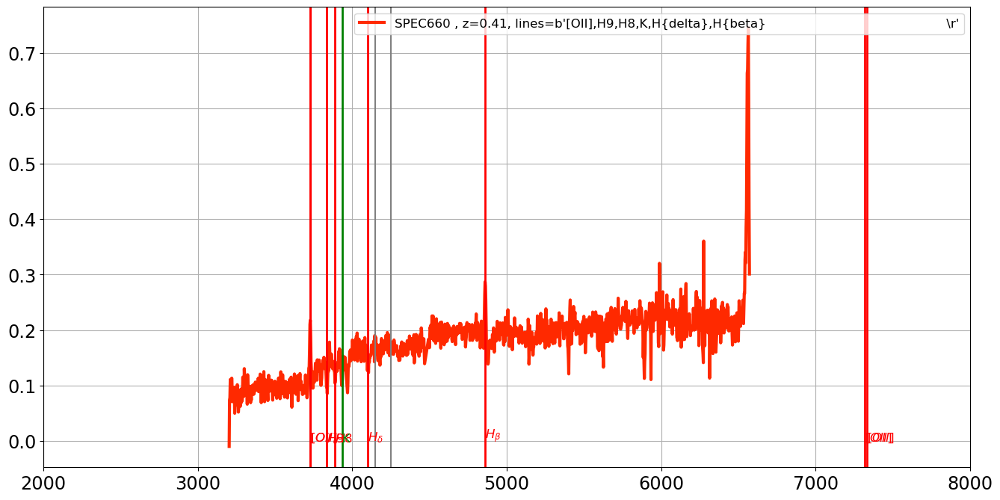

===================== SED 477 : SPEC661 , z=0.25, lines=b'[OII],K,H,G                                                                 \r'=======================
the_lines =  b'[OII],K,H,G                                                                 \r'
[OII]
K
H
G


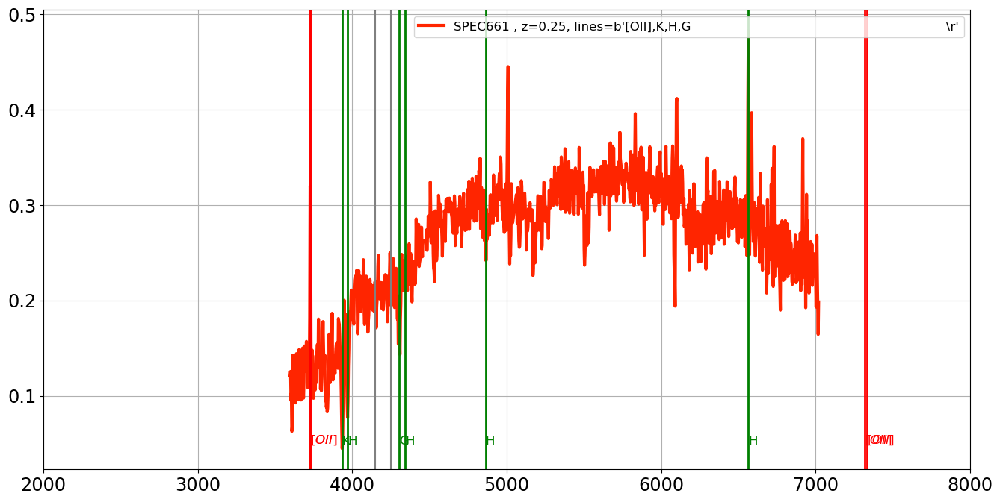

===================== SED 478 : SPEC662 , z=0.77, lines=b'[OII],H9,H8,H,H{beta}                                                       \r'=======================
the_lines =  b'[OII],H9,H8,H,H{beta}                                                       \r'
[OII]
H9
H8
H
H{beta}


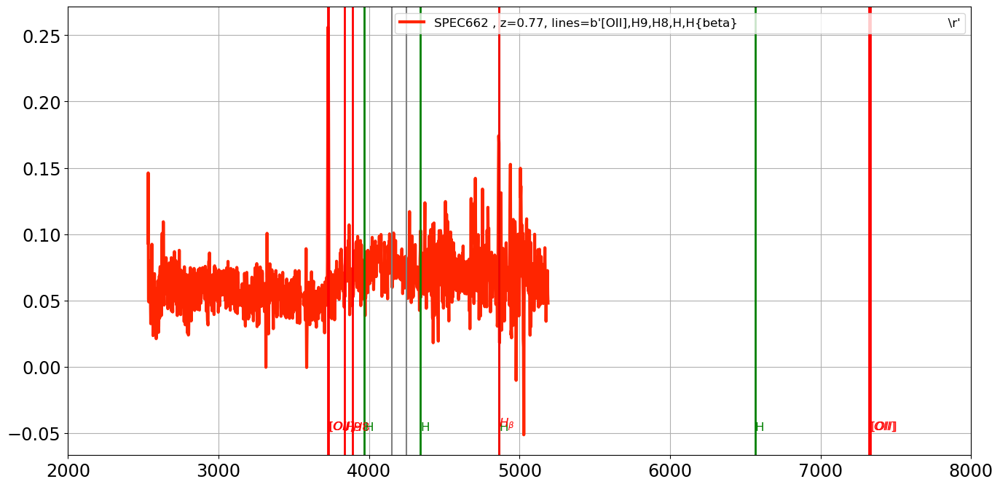

===================== SED 479 : SPEC663 , z=0.39, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


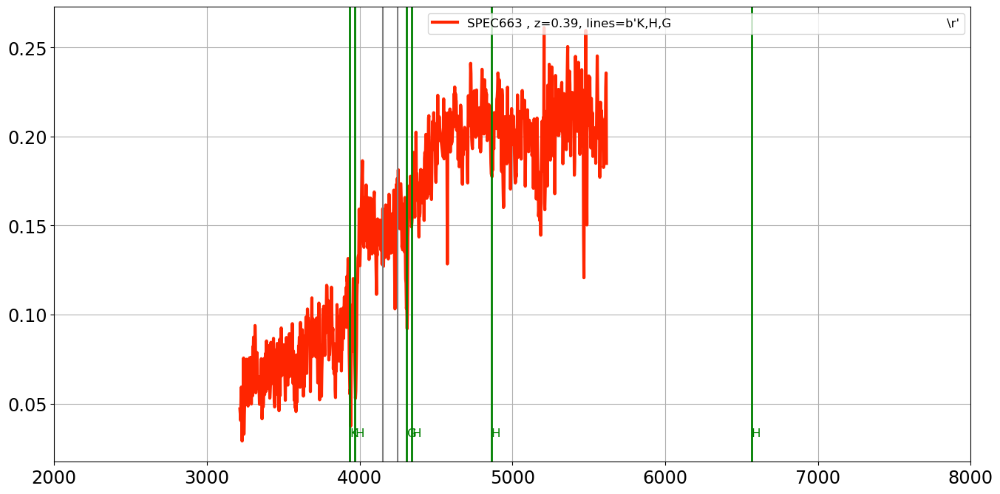

===================== SED 480 : SPEC664 , z=0.39, lines=b'[OII],H8,K,H,H{delta},H{beta},[OIII]                                        \r'=======================
the_lines =  b'[OII],H8,K,H,H{delta},H{beta},[OIII]                                        \r'
[OII]
H8
K
H
H{delta}
H{beta}
[OIII]


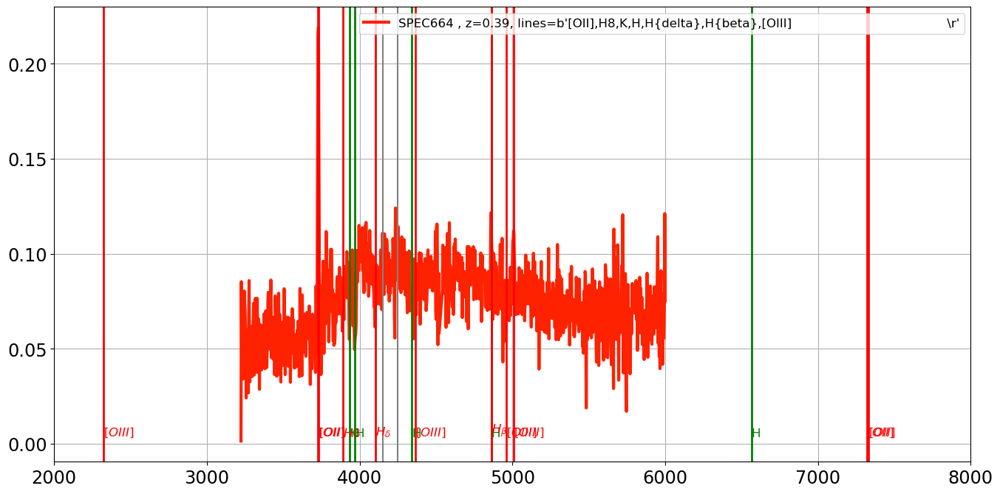

===================== SED 481 : SPEC667 , z=0.60, lines=b'K,H,H{delta},G                                                              \r'=======================
the_lines =  b'K,H,H{delta},G                                                              \r'
K
H
H{delta}
G


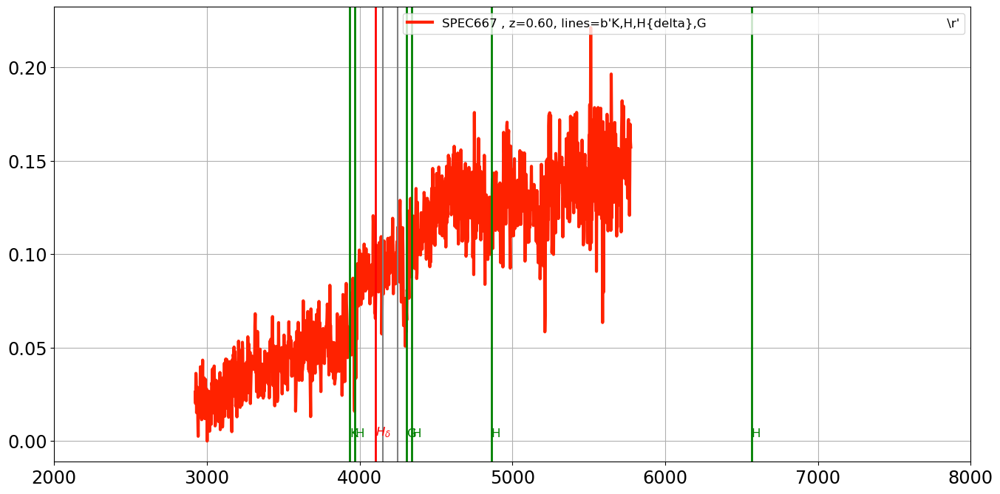

===================== SED 482 : SPEC668 , z=0.41, lines=b'[OII],H8,H,H{beta},[OIII]                                                   \r'=======================
the_lines =  b'[OII],H8,H,H{beta},[OIII]                                                   \r'
[OII]
H8
H
H{beta}
[OIII]


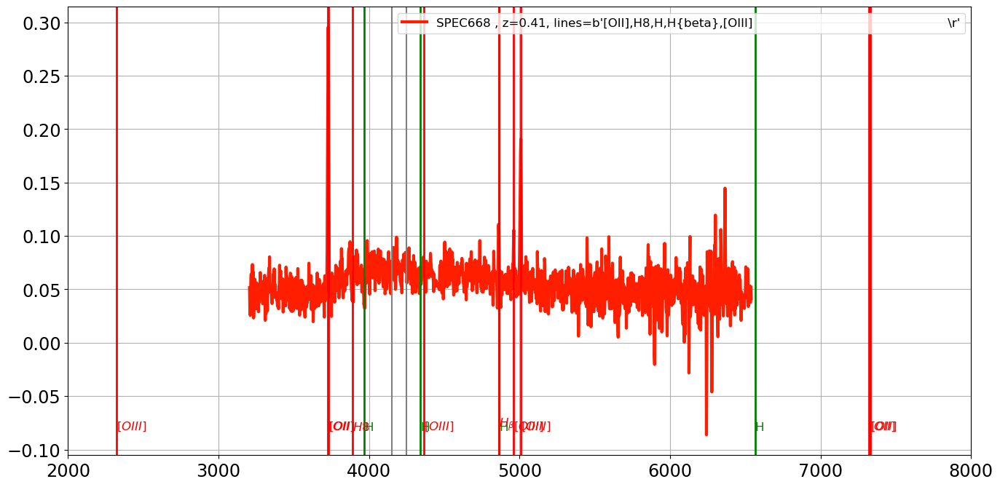

===================== SED 483 : SPEC669 , z=0.63, lines=b'[OII],H9,H8,K,H,H{delta}                                                    \r'=======================
the_lines =  b'[OII],H9,H8,K,H,H{delta}                                                    \r'
[OII]
H9
H8
K
H
H{delta}


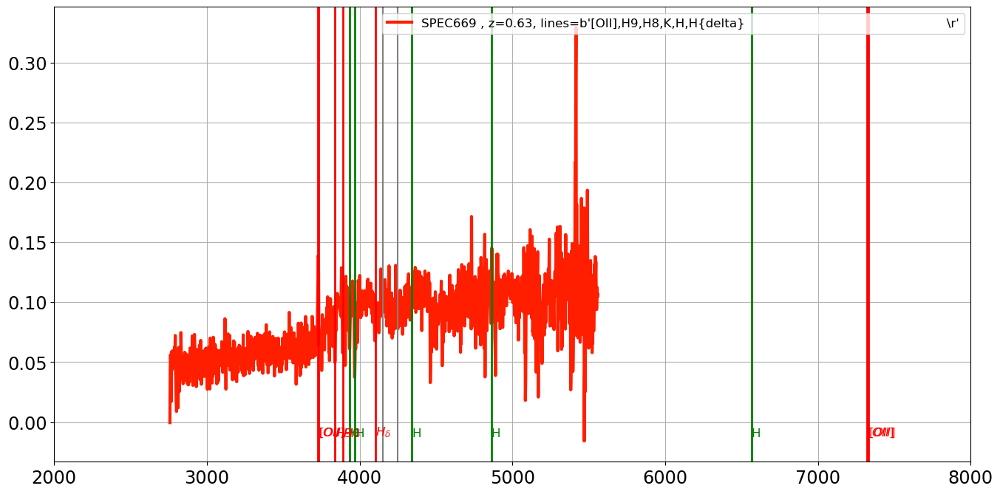

===================== SED 484 : SPEC670 , z=0.45, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


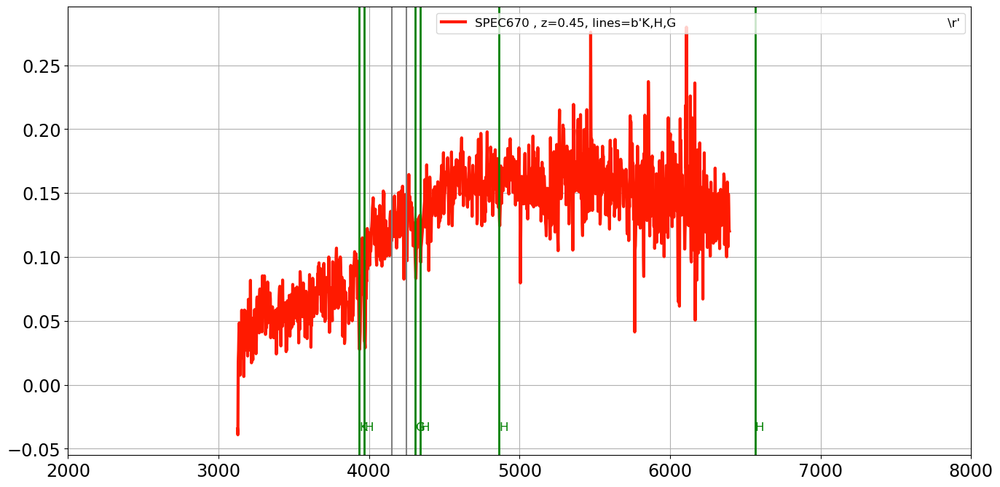

===================== SED 485 : SPEC671 , z=0.67, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


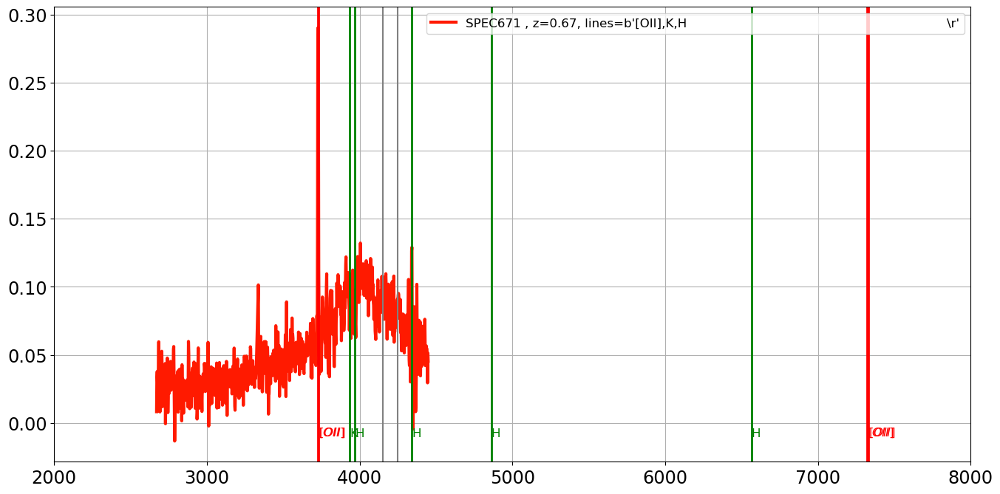

===================== SED 486 : SPEC672 , z=0.39, lines=b'[OII],H,H{alpha}                                                            \r'=======================
the_lines =  b'[OII],H,H{alpha}                                                            \r'
[OII]
H
H{alpha}


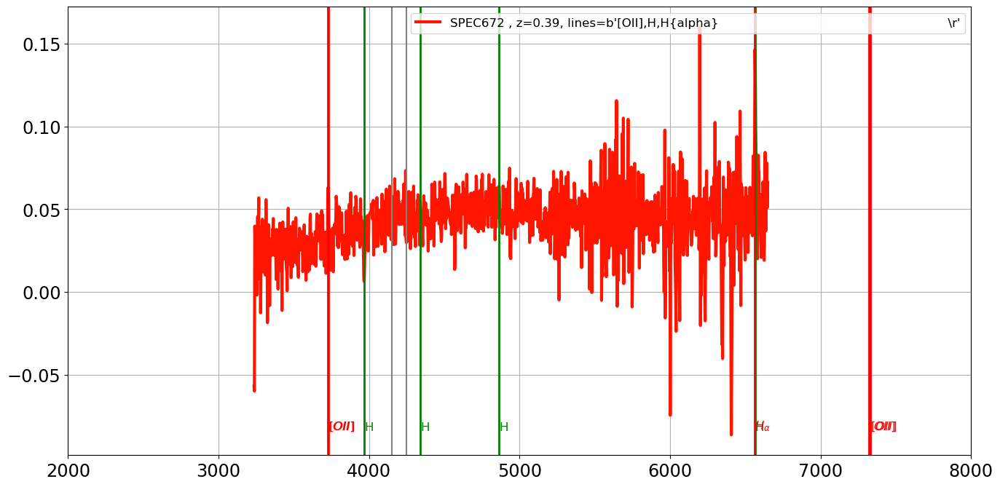

===================== SED 487 : SPEC673 , z=0.39, lines=b'[OII],H9,K,H,H{alpha}                                                       \r'=======================
the_lines =  b'[OII],H9,K,H,H{alpha}                                                       \r'
[OII]
H9
K
H
H{alpha}


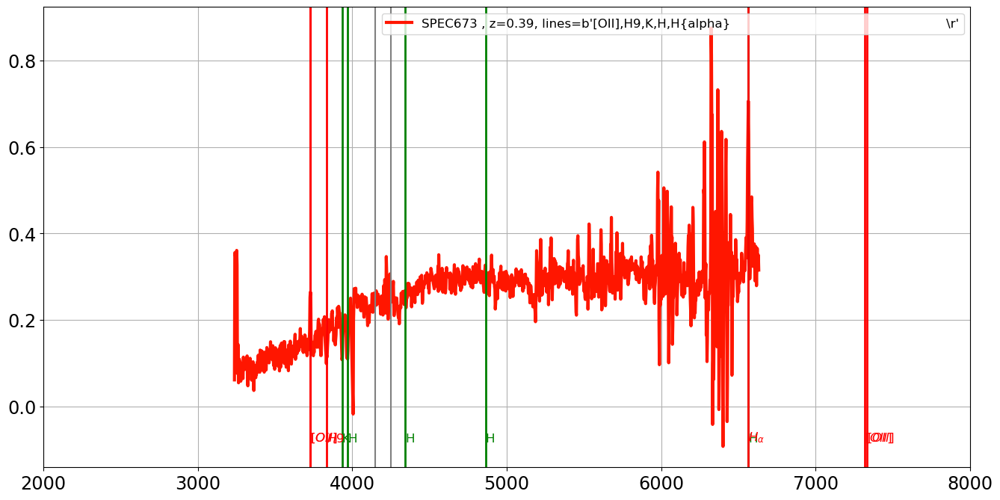

===================== SED 488 : SPEC674 , z=0.12, lines=b'G,H{beta},Mgb,E                                                             \r'=======================
the_lines =  b'G,H{beta},Mgb,E                                                             \r'
G
H{beta}
Mgb
E


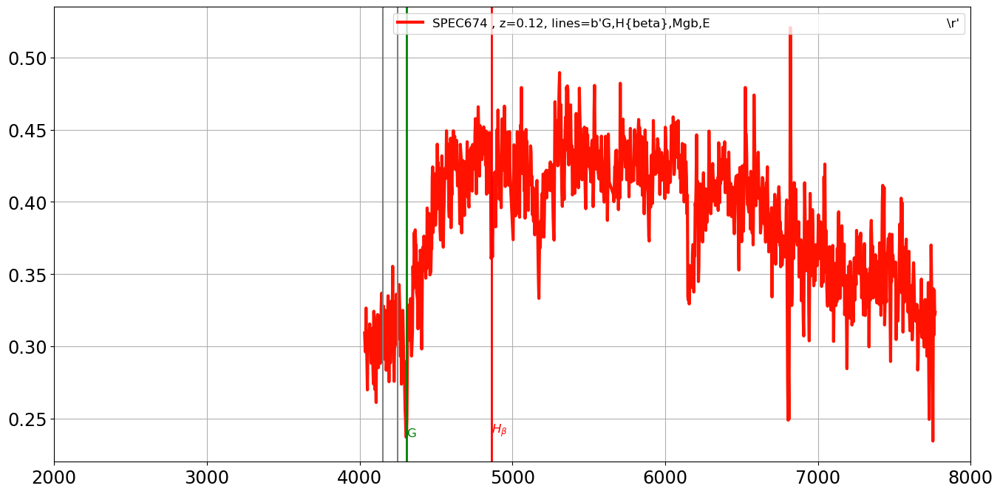

===================== SED 489 : SPEC675 , z=0.12, lines=b'[OIII],H{alpha},NII                                                         \r'=======================
the_lines =  b'[OIII],H{alpha},NII                                                         \r'
[OIII]
H{alpha}
NII


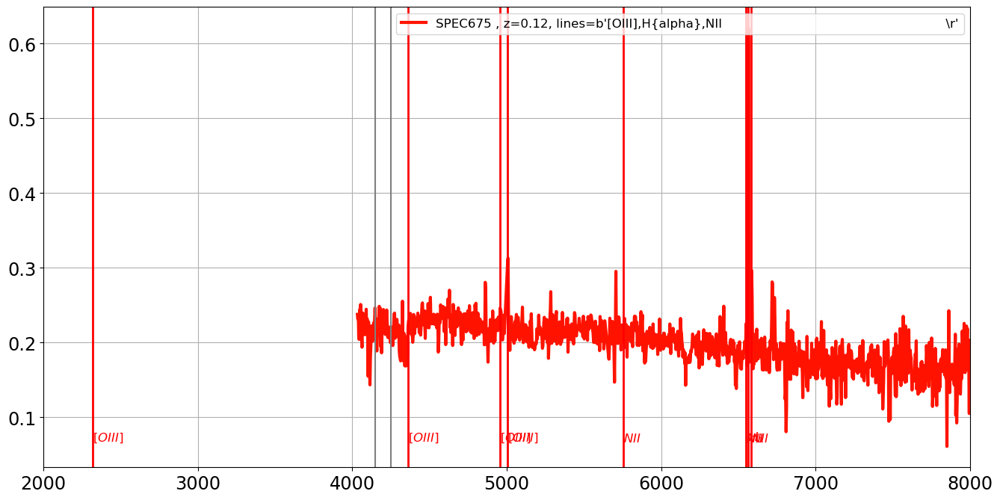

===================== SED 490 : SPEC676 , z=0.60, lines=b'[OII],H9,H                                                                  \r'=======================
the_lines =  b'[OII],H9,H                                                                  \r'
[OII]
H9
H


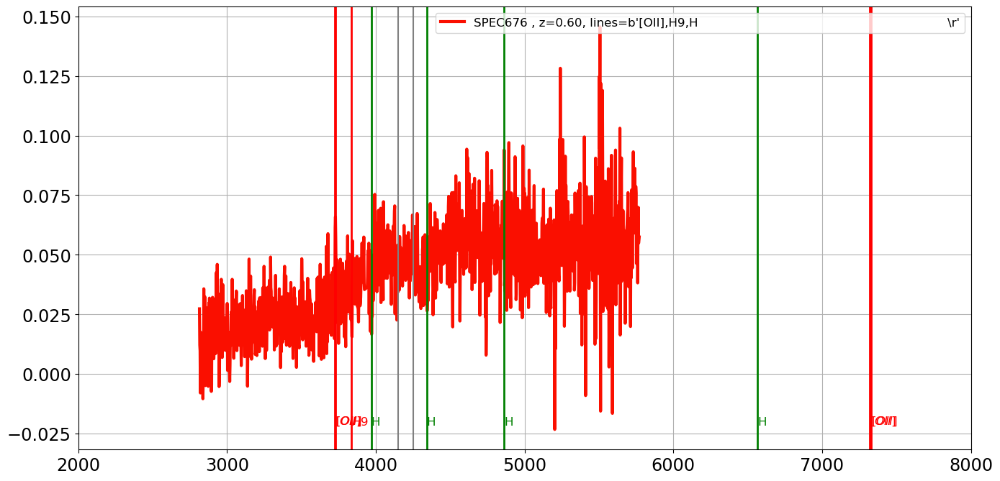

===================== SED 491 : SPEC677 , z=0.29, lines=b'weak,[OII],K,H                                                              \r'=======================
the_lines =  b'weak,[OII],K,H                                                              \r'
weak
[OII]
K
H


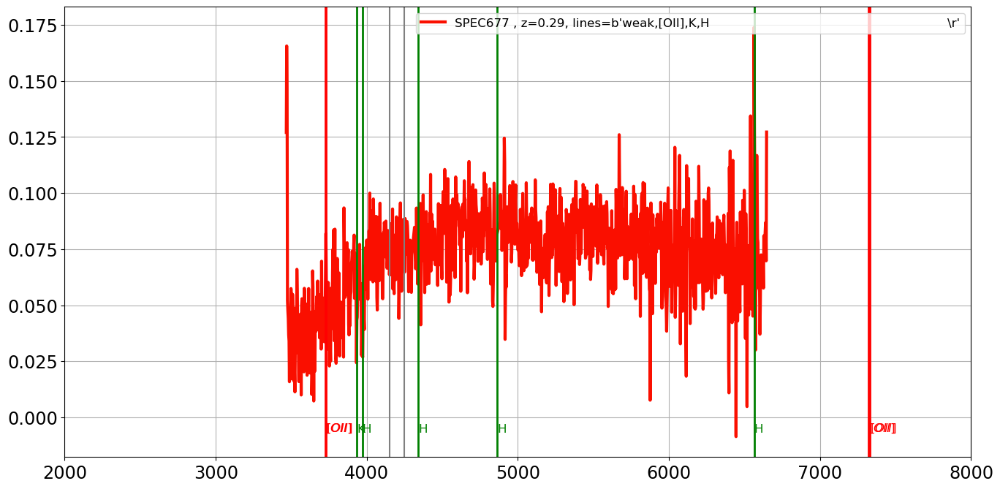

===================== SED 492 : SPEC678 , z=0.12, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


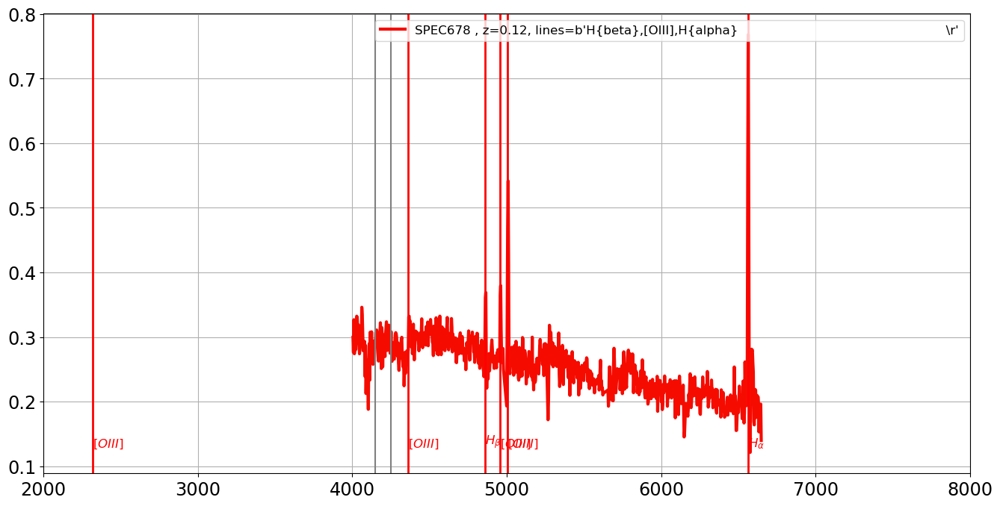

===================== SED 493 : SPEC679 , z=0.29, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


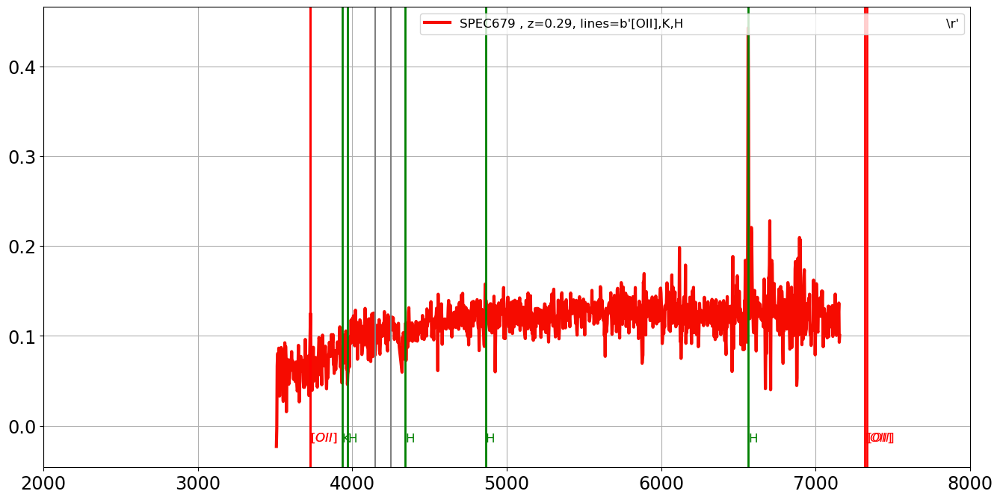

===================== SED 494 : SPEC680 , z=0.12, lines=b'H{gamma},H{beta},[OIII],H{alpha}                                            \r'=======================
the_lines =  b'H{gamma},H{beta},[OIII],H{alpha}                                            \r'
H{gamma}
H{beta}
[OIII]
H{alpha}


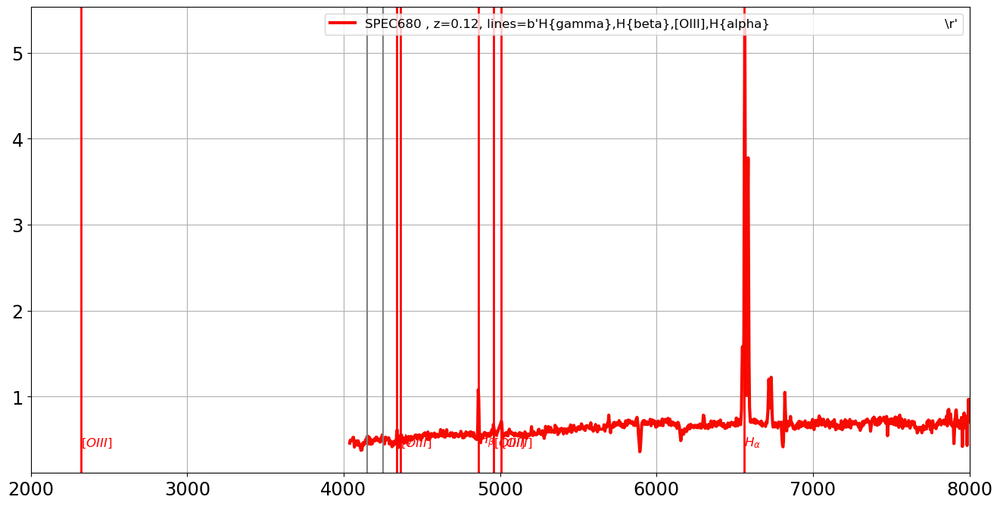

===================== SED 495 : SPEC681 , z=0.29, lines=b'K,H,G,H{beta},Mgb                                                           \r'=======================
the_lines =  b'K,H,G,H{beta},Mgb                                                           \r'
K
H
G
H{beta}
Mgb


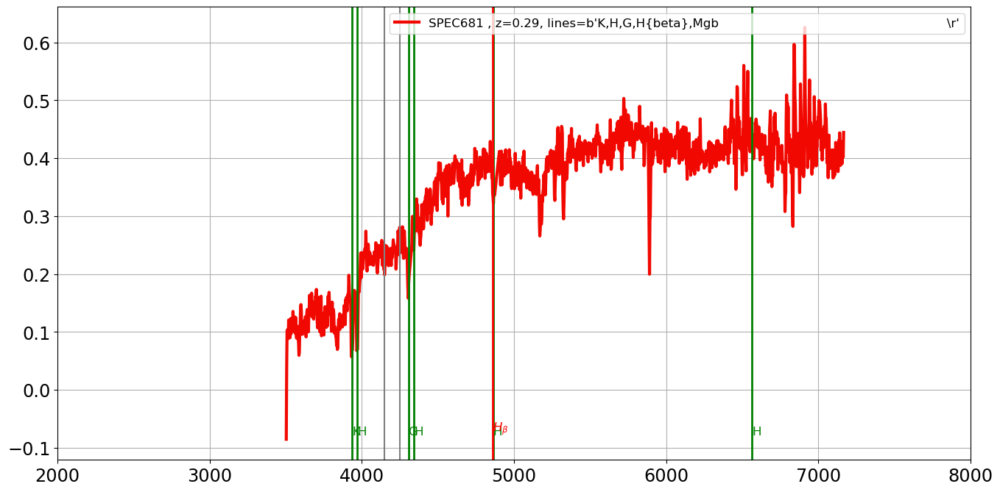

===================== SED 496 : SPEC682 , z=0.29, lines=b'K,H,H{beta}                                                                 \r'=======================
the_lines =  b'K,H,H{beta}                                                                 \r'
K
H
H{beta}


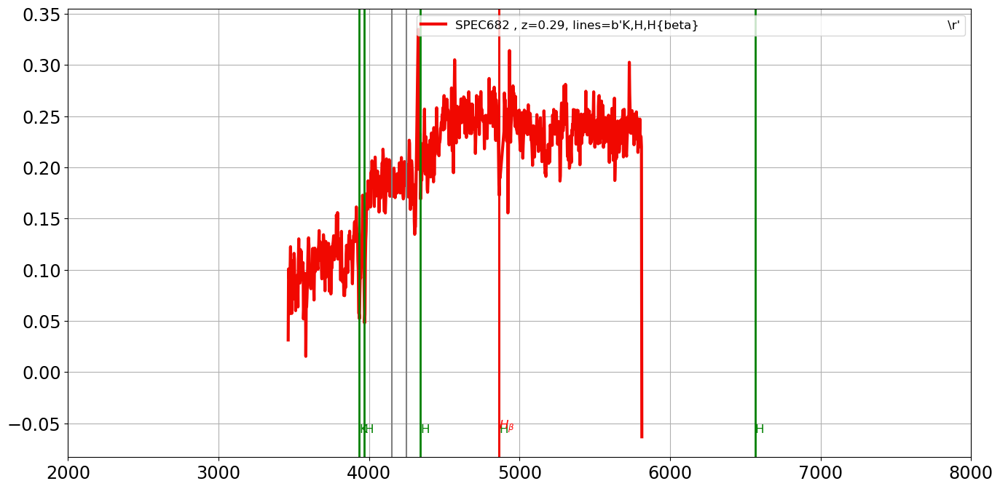

===================== SED 497 : SPEC683 , z=0.68, lines=b'[OII],H9,H8,K,H,H{beta}                                                     \r'=======================
the_lines =  b'[OII],H9,H8,K,H,H{beta}                                                     \r'
[OII]
H9
H8
K
H
H{beta}


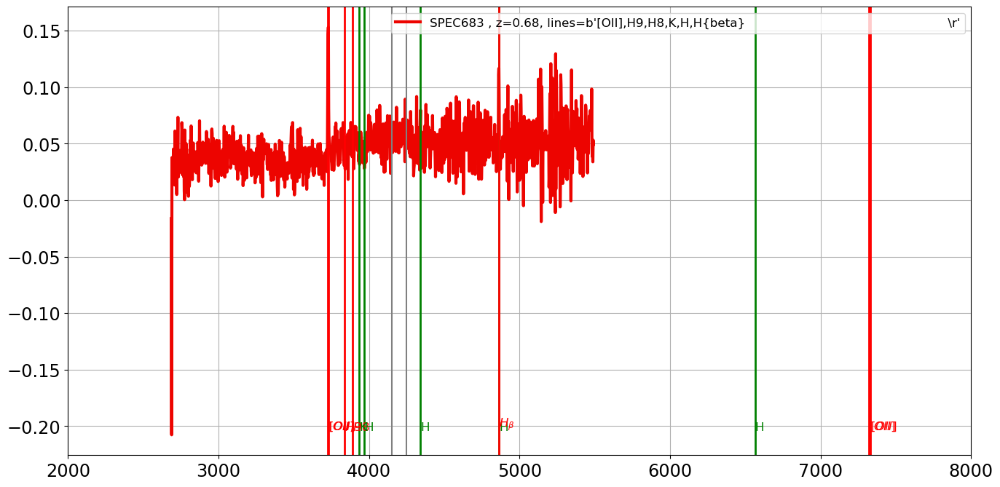

===================== SED 498 : SPEC684 , z=0.49, lines=b'[OII],H8,K,H,H{delta}                                                       \r'=======================
the_lines =  b'[OII],H8,K,H,H{delta}                                                       \r'
[OII]
H8
K
H
H{delta}


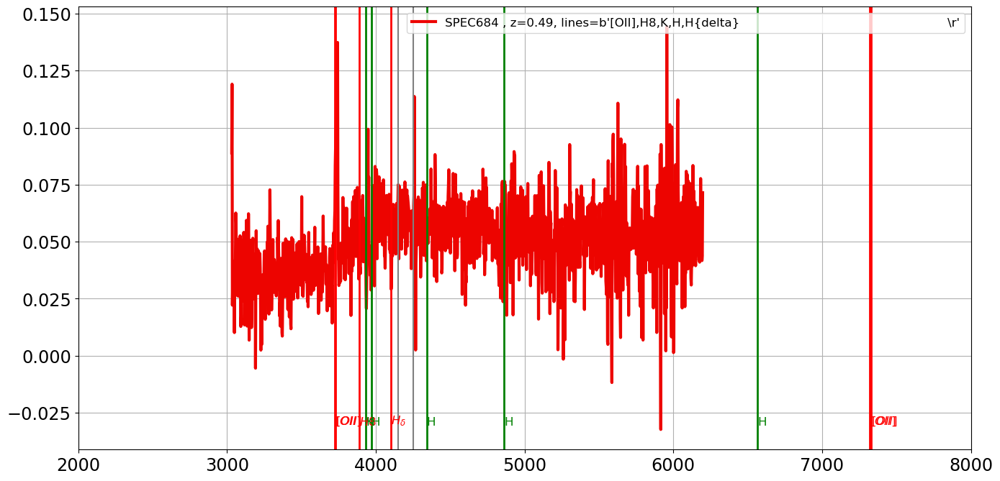

===================== SED 499 : SPEC685 , z=0.63, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


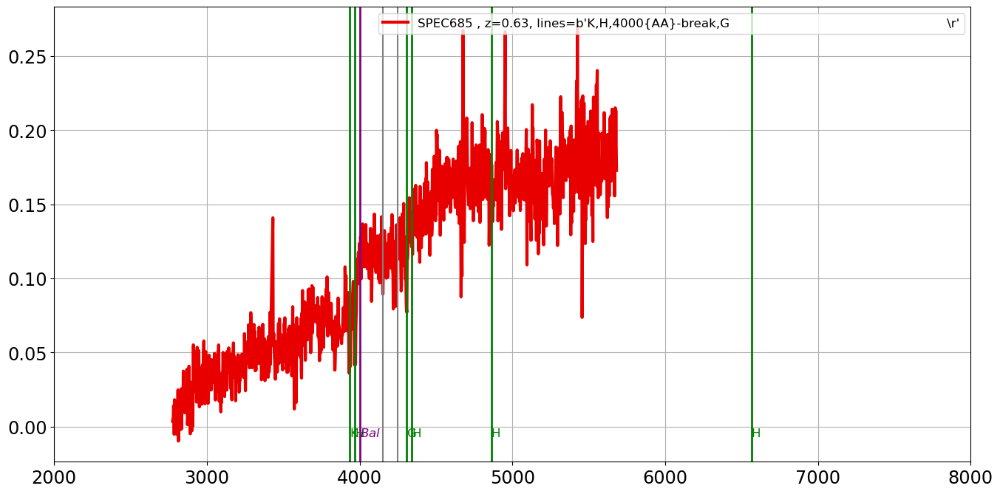

===================== SED 500 : SPEC686 , z=0.39, lines=b'[OII],H9,H{delta},H{beta},[OIII]                                            \r'=======================
the_lines =  b'[OII],H9,H{delta},H{beta},[OIII]                                            \r'
[OII]
H9
H{delta}
H{beta}
[OIII]


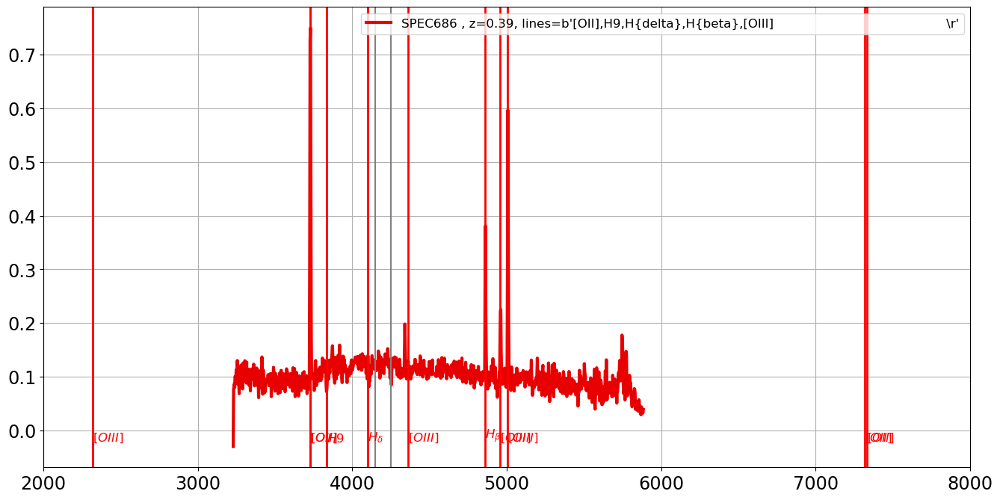

===================== SED 501 : SPEC687 , z=0.34, lines=b'[OII],K,H,H{beta},[OIII]                                                    \r'=======================
the_lines =  b'[OII],K,H,H{beta},[OIII]                                                    \r'
[OII]
K
H
H{beta}
[OIII]


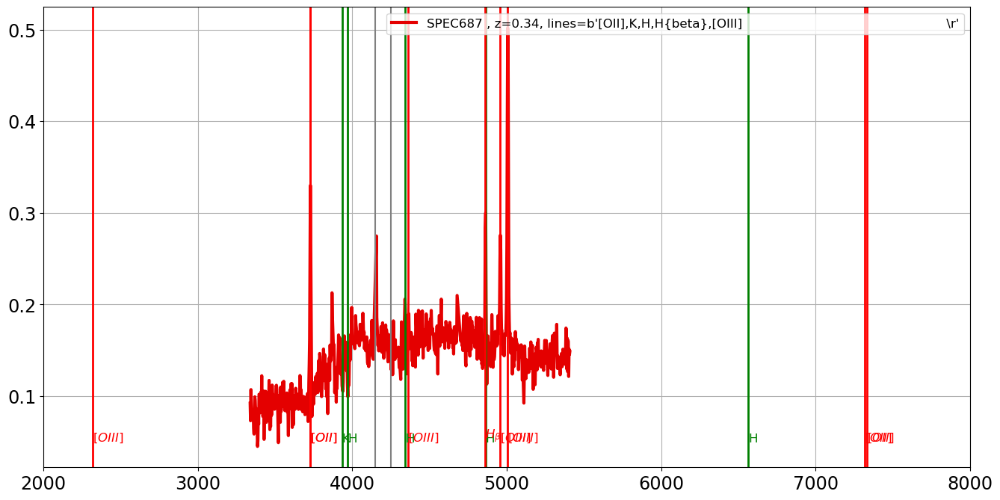

===================== SED 502 : SPEC689 , z=0.47, lines=b'[OII],H8,H                                                                  \r'=======================
the_lines =  b'[OII],H8,H                                                                  \r'
[OII]
H8
H


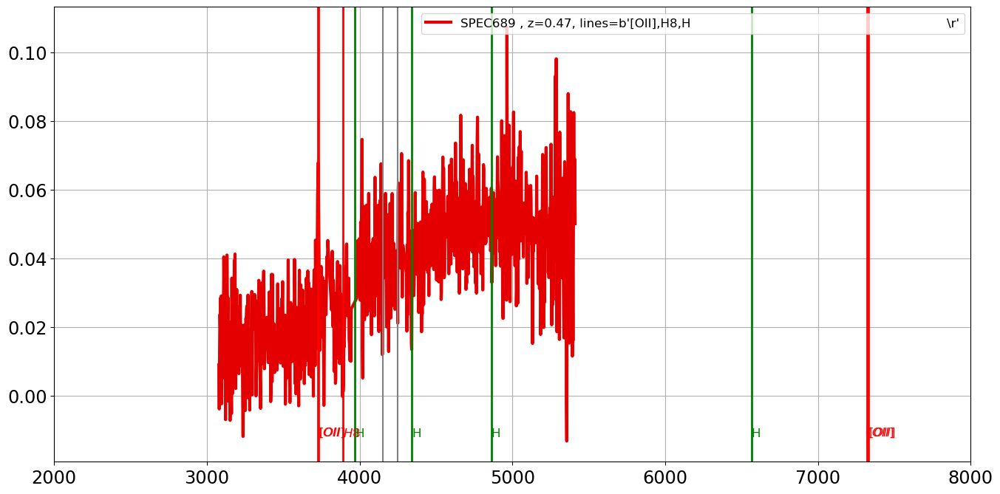

===================== SED 503 : SPEC690 , z=0.73, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


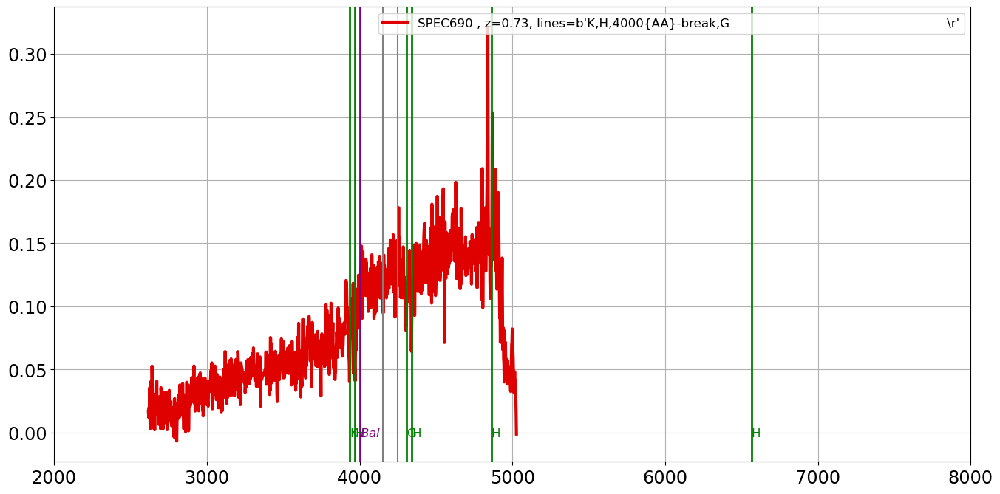

===================== SED 504 : SPEC691 , z=0.09, lines=b'[OIII],H{alpha}                                                             \r'=======================
the_lines =  b'[OIII],H{alpha}                                                             \r'
[OIII]
H{alpha}


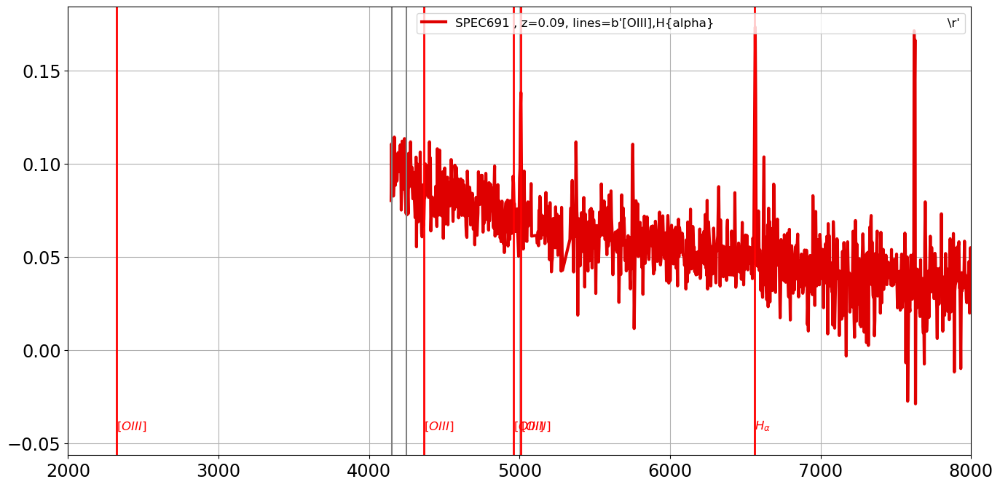

===================== SED 505 : SPEC692 , z=0.78, lines=b'[OII],K                                                                     \r'=======================
the_lines =  b'[OII],K                                                                     \r'
[OII]
K


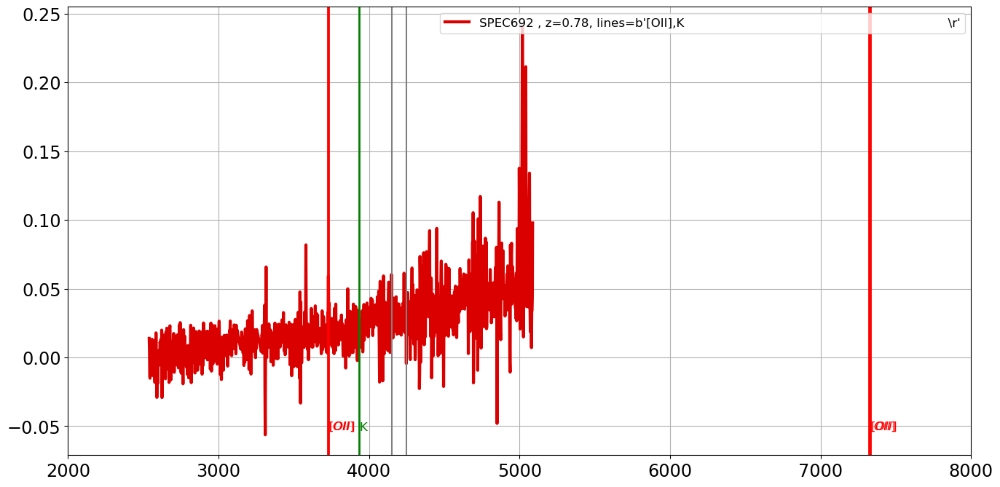

===================== SED 506 : SPEC693 , z=0.36, lines=b'[OII],NeIII,H{epsilon},H{gamma},H{beta},[OIII],H{alpha}                     \r'=======================
the_lines =  b'[OII],NeIII,H{epsilon},H{gamma},H{beta},[OIII],H{alpha}                     \r'
[OII]
NeIII
H{epsilon}
H{gamma}
H{beta}
[OIII]
H{alpha}


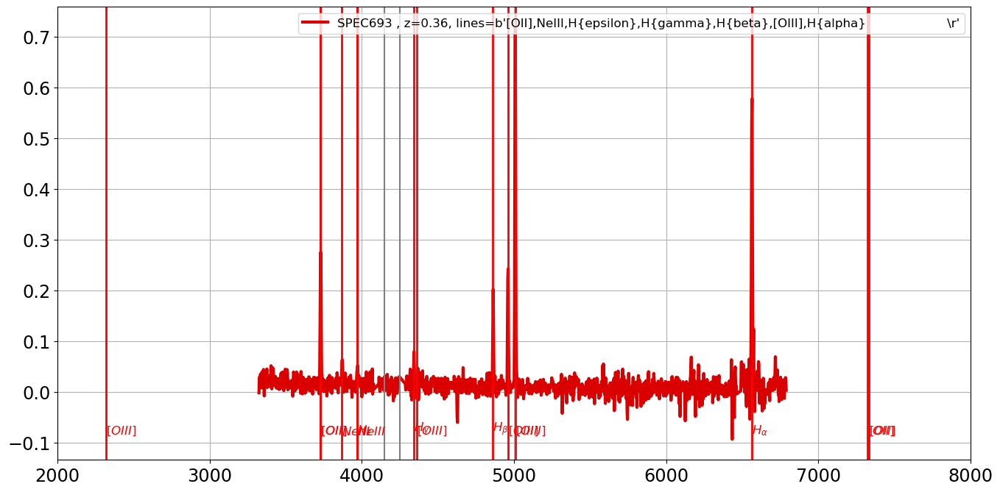

===================== SED 507 : SPEC694 , z=0.36, lines=b'[OII],H8,K,H                                                                \r'=======================
the_lines =  b'[OII],H8,K,H                                                                \r'
[OII]
H8
K
H


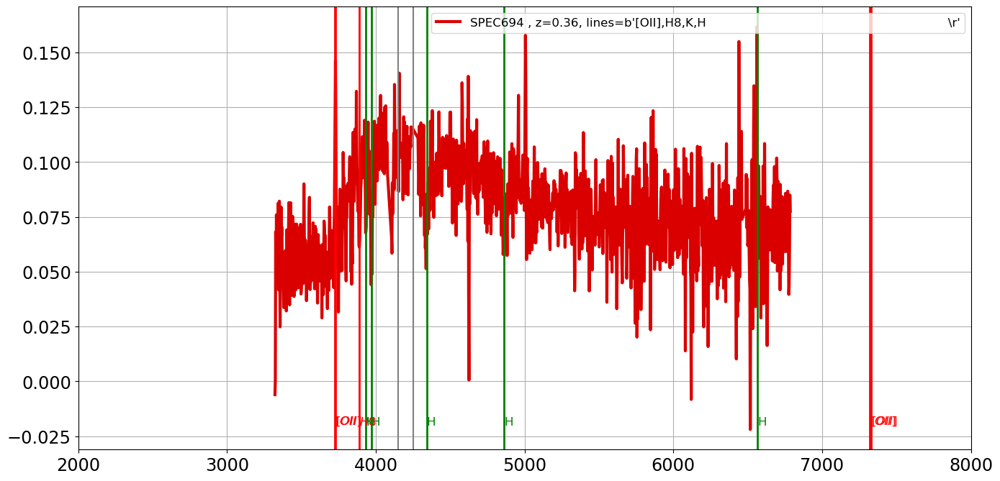

===================== SED 508 : SPEC695 , z=0.47, lines=b'K,H,H{delta},H{beta}                                                        \r'=======================
the_lines =  b'K,H,H{delta},H{beta}                                                        \r'
K
H
H{delta}
H{beta}


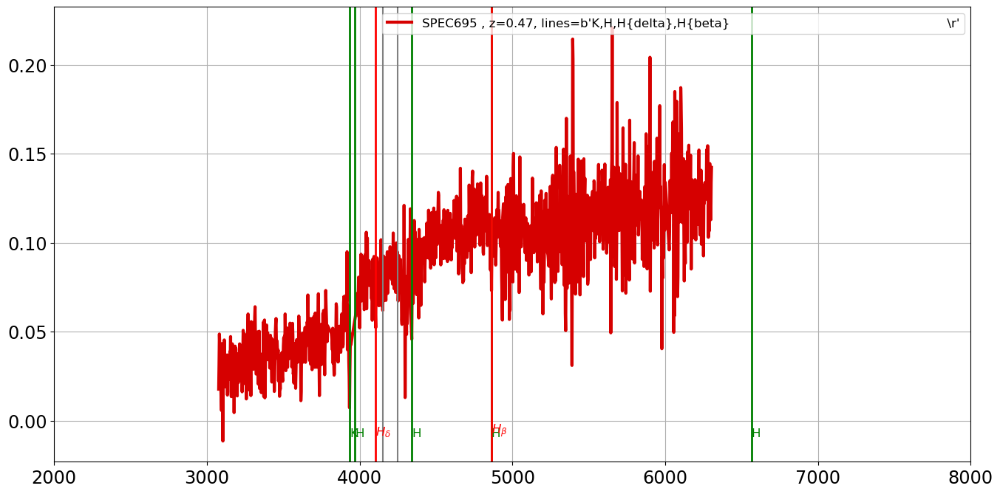

===================== SED 509 : SPEC696 , z=0.29, lines=b'[OII],H9,K,H,H{delta}                                                       \r'=======================
the_lines =  b'[OII],H9,K,H,H{delta}                                                       \r'
[OII]
H9
K
H
H{delta}


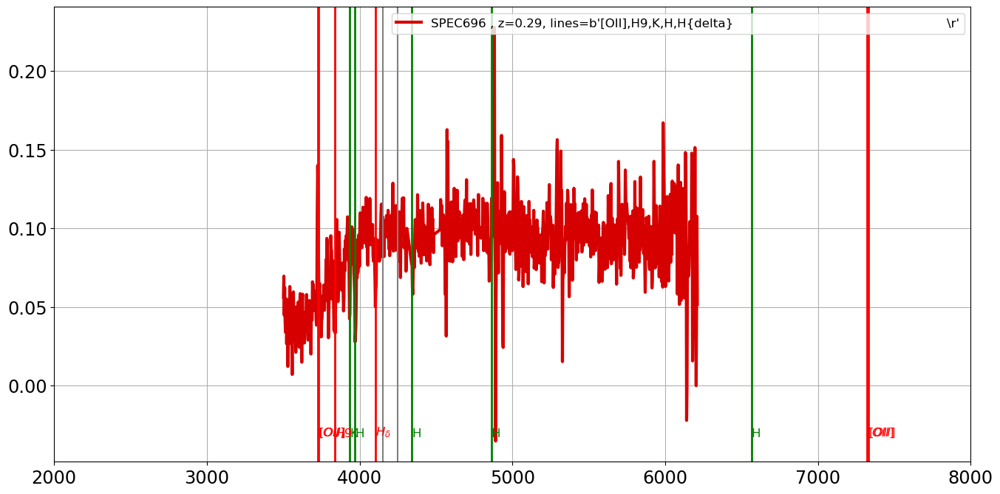

===================== SED 510 : SPEC697 , z=0.39, lines=b'[OII],H{beta},H{alpha}                                                      \r'=======================
the_lines =  b'[OII],H{beta},H{alpha}                                                      \r'
[OII]
H{beta}
H{alpha}


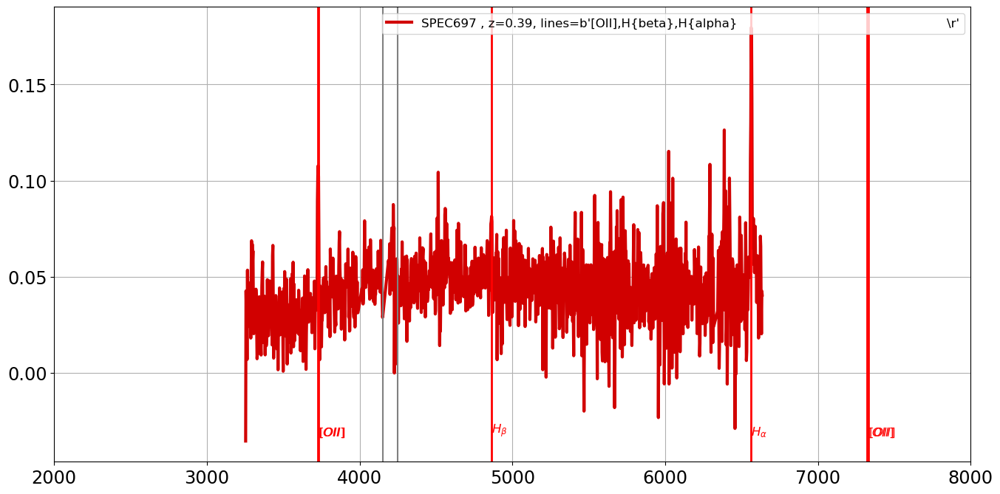

===================== SED 511 : SPEC698 , z=0.07, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


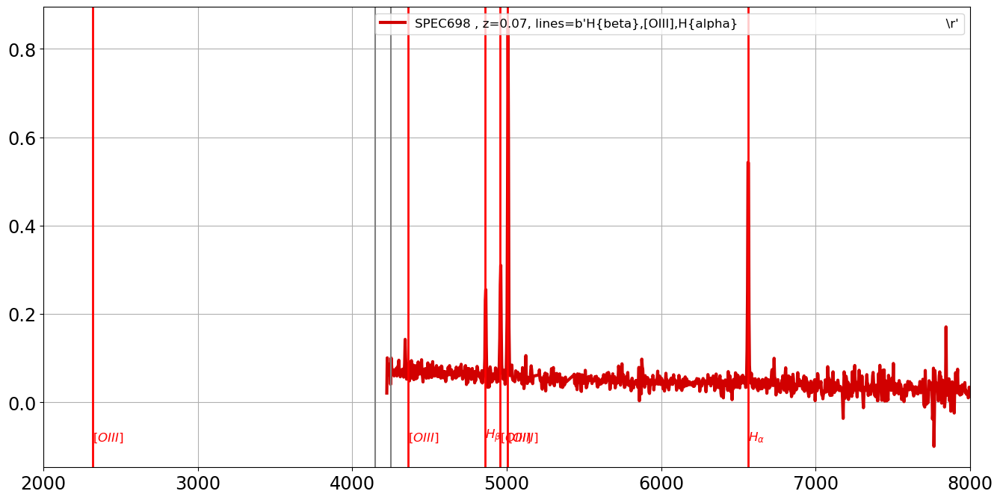

===================== SED 512 : SPEC699 , z=0.20, lines=b'H9,H8,K,H,H{delta},H{beta}                                                  \r'=======================
the_lines =  b'H9,H8,K,H,H{delta},H{beta}                                                  \r'
H9
H8
K
H
H{delta}
H{beta}


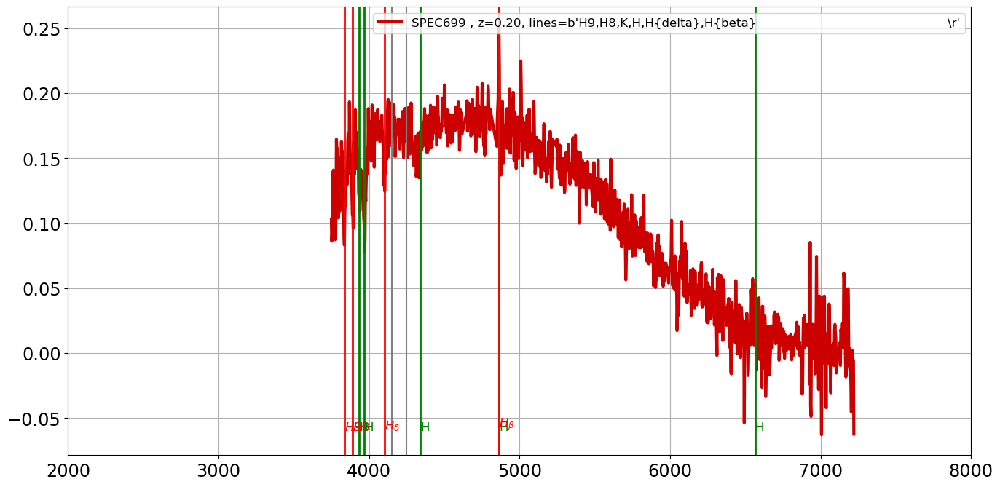

===================== SED 513 : SPEC700 , z=0.08, lines=b'G,Fe43,Fe45,[OIII],Mgb,NaD                                                  \r'=======================
the_lines =  b'G,Fe43,Fe45,[OIII],Mgb,NaD                                                  \r'
G
Fe43
Fe45
[OIII]
Mgb
NaD


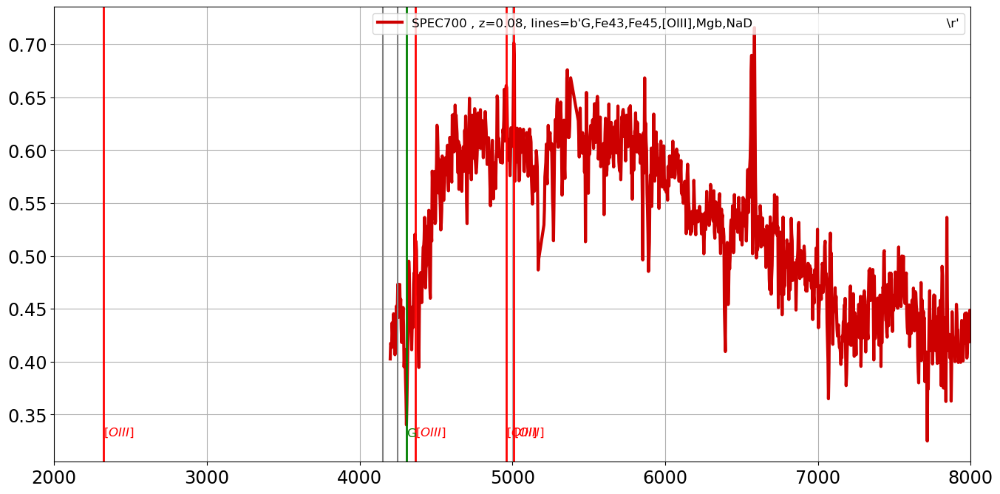

===================== SED 514 : SPEC701 , z=0.32, lines=b'K,H,H{delta},G                                                              \r'=======================
the_lines =  b'K,H,H{delta},G                                                              \r'
K
H
H{delta}
G


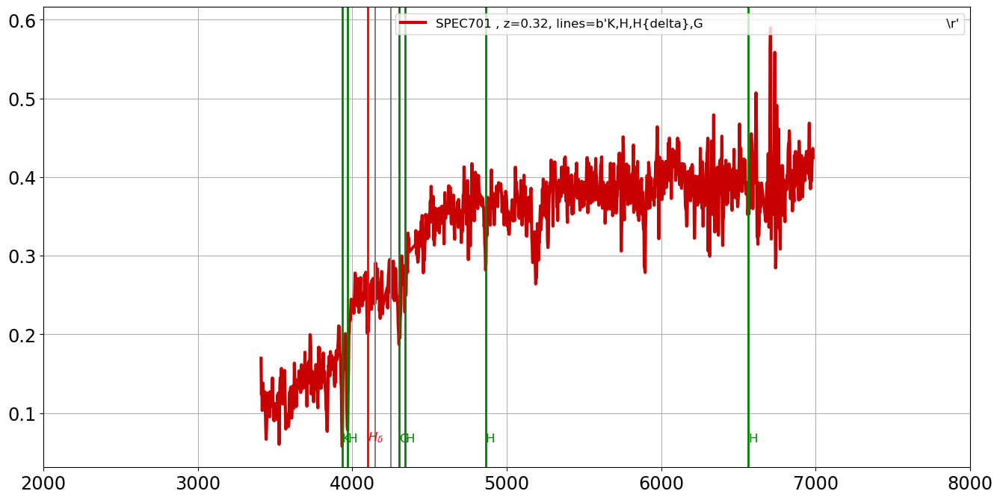

===================== SED 515 : SPEC702 , z=0.29, lines=b'[OII],H,H{beta},[OIII]                                                      \r'=======================
the_lines =  b'[OII],H,H{beta},[OIII]                                                      \r'
[OII]
H
H{beta}
[OIII]


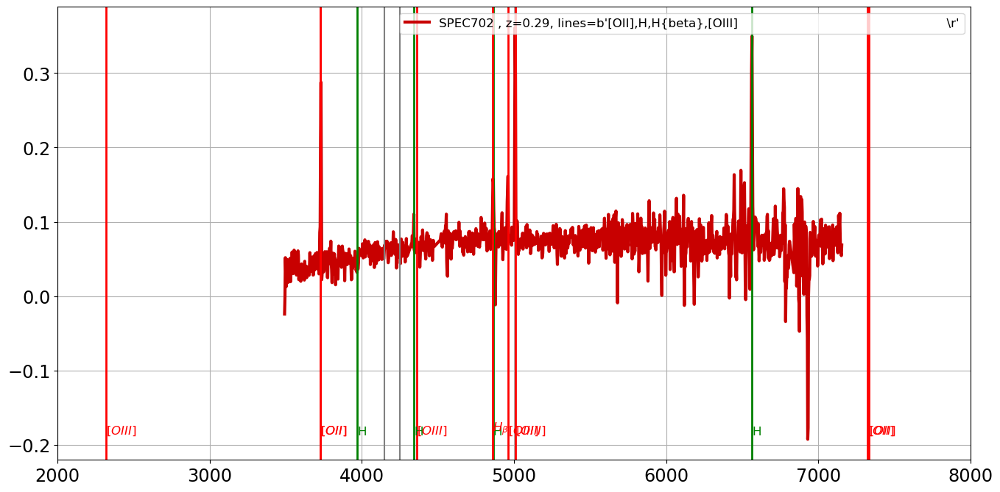

===================== SED 516 : SPEC703 , z=0.56, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


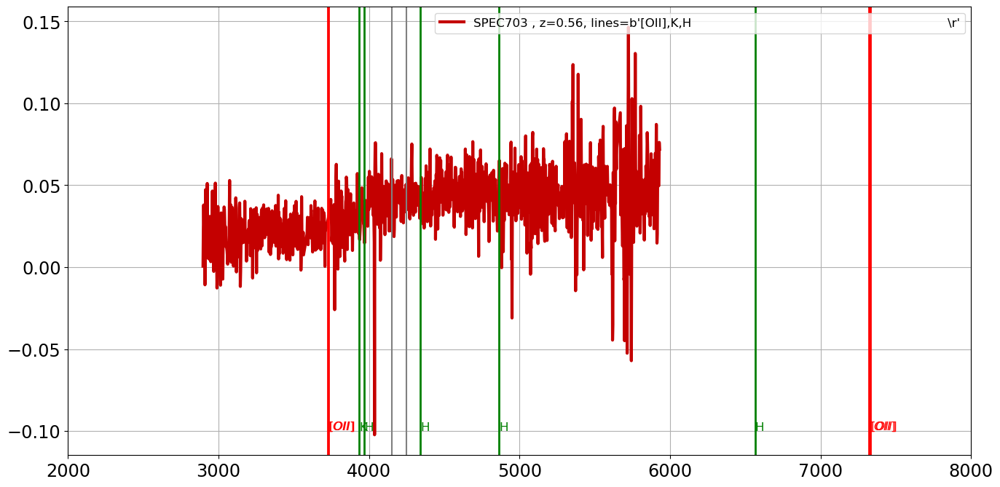

===================== SED 517 : SPEC704 , z=0.20, lines=b'H{beta},[OIII],H{alpha}                                                     \r'=======================
the_lines =  b'H{beta},[OIII],H{alpha}                                                     \r'
H{beta}
[OIII]
H{alpha}


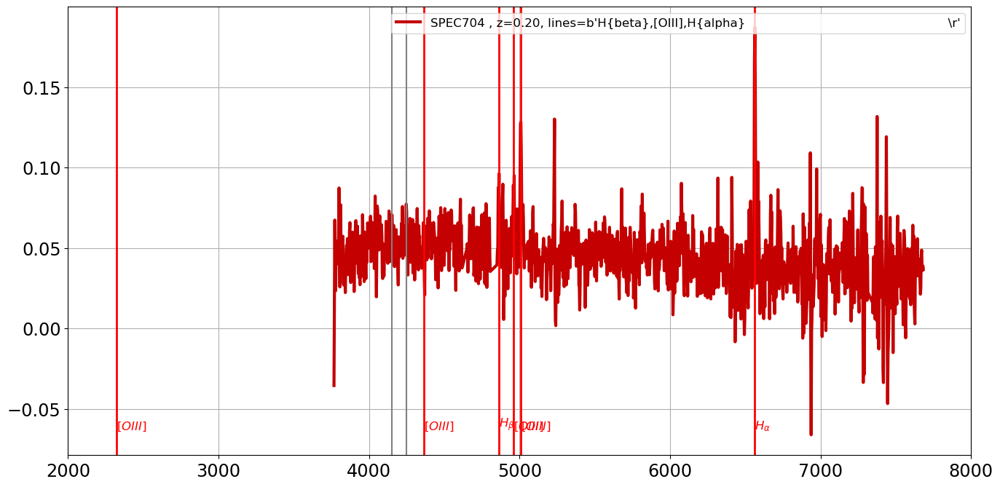

===================== SED 518 : SPEC705 , z=0.56, lines=b'K,H,4000{AA}-break                                                          \r'=======================
the_lines =  b'K,H,4000{AA}-break                                                          \r'
K
H
4000{AA}-break


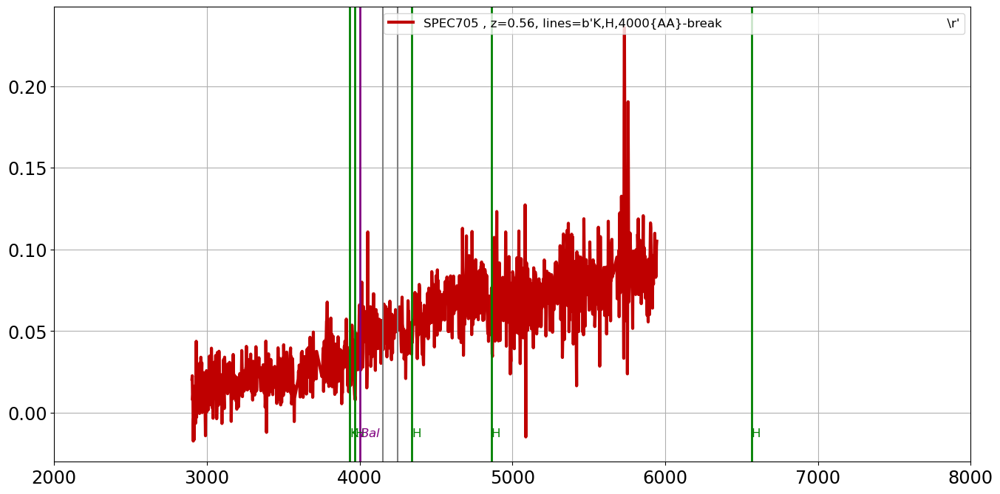

===================== SED 519 : SPEC706 , z=0.36, lines=b'weak,[OII],K,H,G                                                            \r'=======================
the_lines =  b'weak,[OII],K,H,G                                                            \r'
weak
[OII]
K
H
G


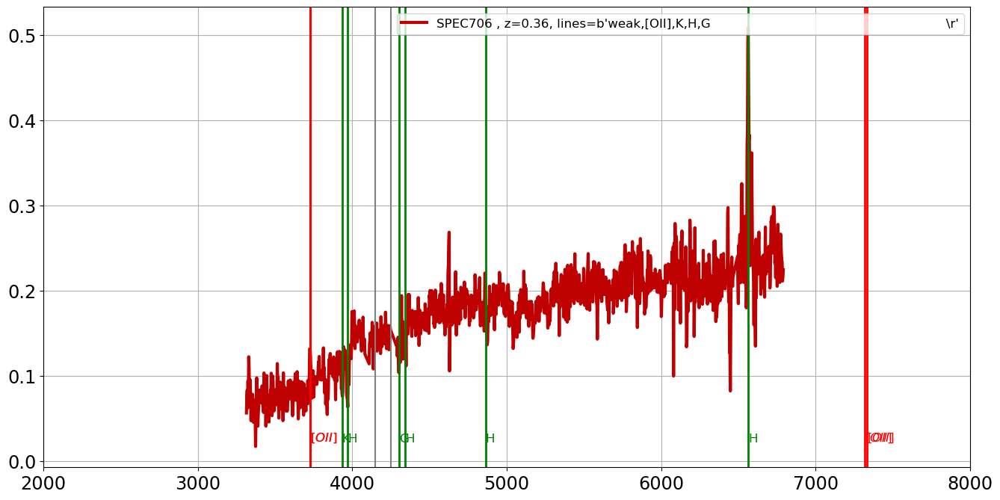

===================== SED 520 : SPEC707 , z=0.29, lines=b'[OII],H,[OIII]                                                              \r'=======================
the_lines =  b'[OII],H,[OIII]                                                              \r'
[OII]
H
[OIII]


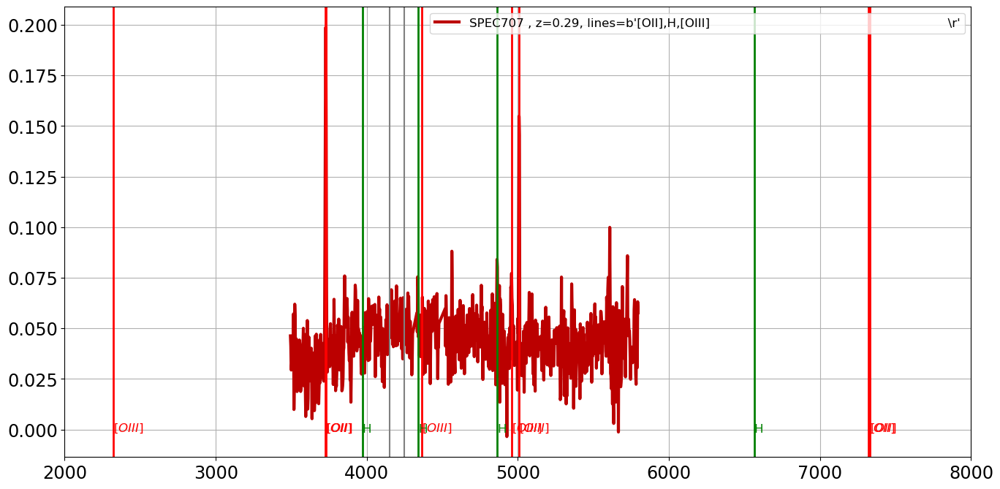

===================== SED 521 : SPEC708 , z=0.56, lines=b'[OII],H9,K,H                                                                \r'=======================
the_lines =  b'[OII],H9,K,H                                                                \r'
[OII]
H9
K
H


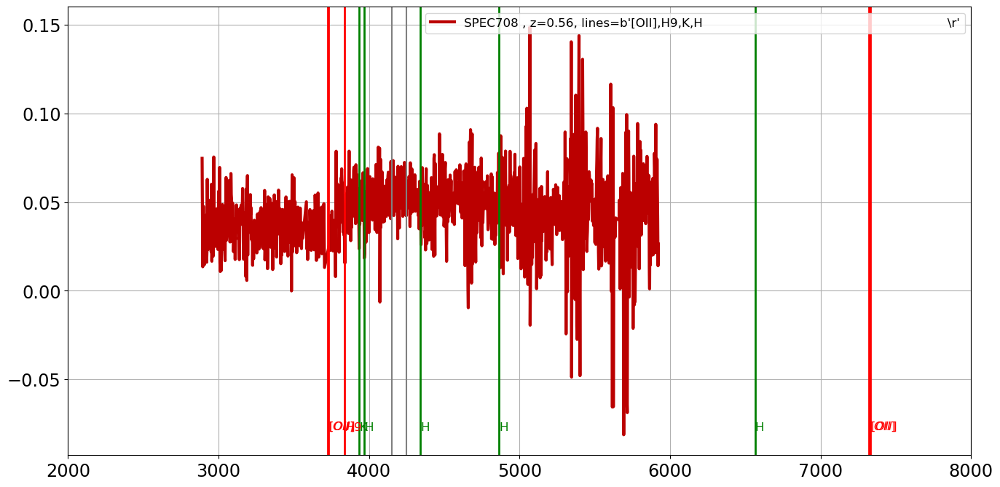

===================== SED 522 : SPEC710 , z=0.78, lines=b'MgII,[OII],H9,H8,H{gamma},H{beta}                                           \r'=======================
the_lines =  b'MgII,[OII],H9,H8,H{gamma},H{beta}                                           \r'
MgII
[OII]
H9
H8
H{gamma}
H{beta}


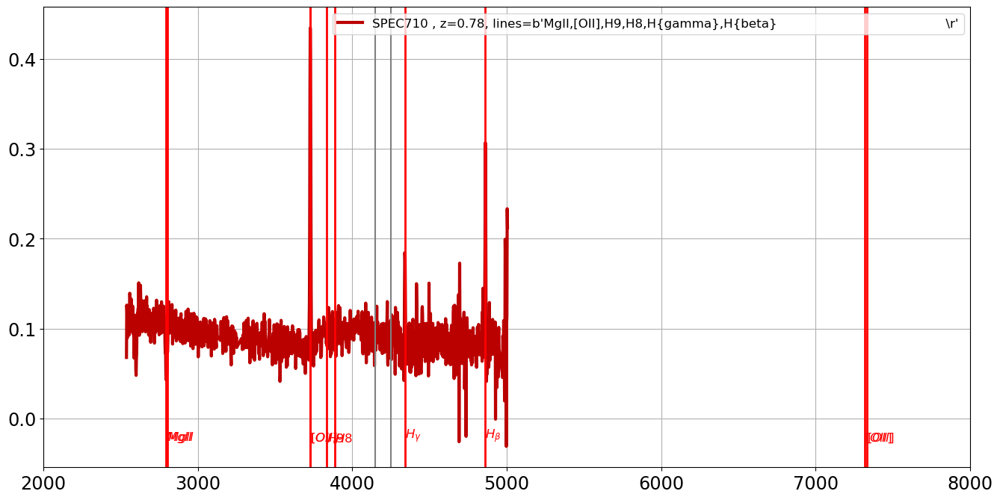

===================== SED 523 : SPEC711 , z=0.56, lines=b'K,H,4000{AA}-break                                                          \r'=======================
the_lines =  b'K,H,4000{AA}-break                                                          \r'
K
H
4000{AA}-break


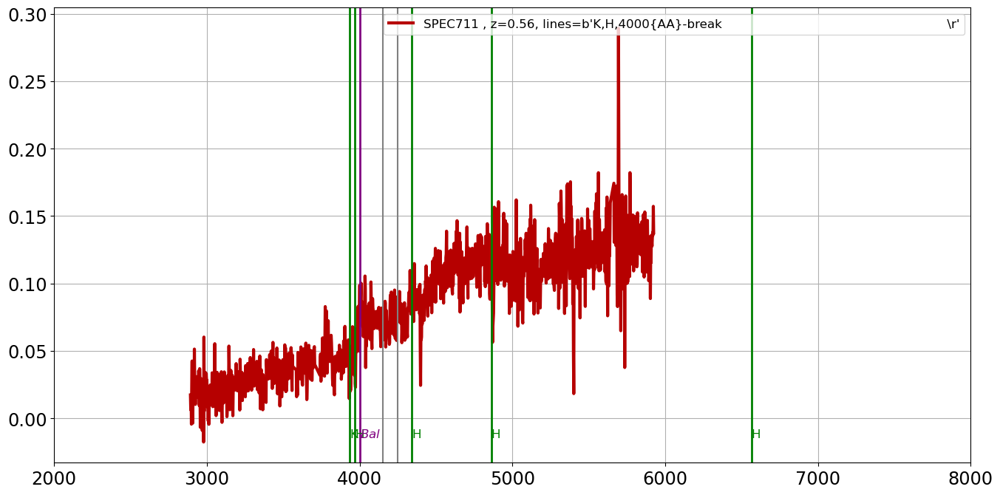

===================== SED 524 : SPEC713 , z=0.56, lines=b'[OII],H,H{delta},H{beta},[OIII]                                             \r'=======================
the_lines =  b'[OII],H,H{delta},H{beta},[OIII]                                             \r'
[OII]
H
H{delta}
H{beta}
[OIII]


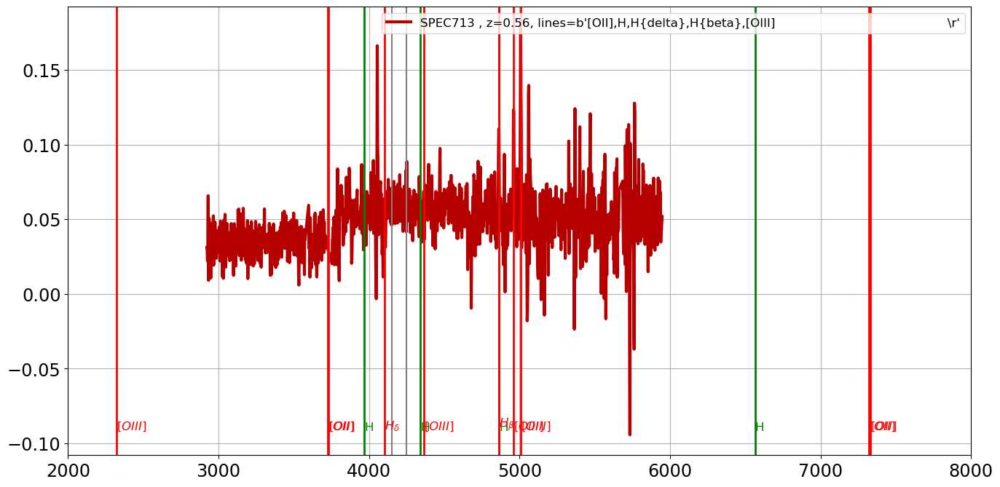

===================== SED 525 : SPEC714 , z=2.42, lines=b'QSO,SiIV/OIV,CIV,CIII                                                       \r'=======================
the_lines =  b'QSO,SiIV/OIV,CIV,CIII                                                       \r'
QSO
SiIV/OIV
CIV
CIII


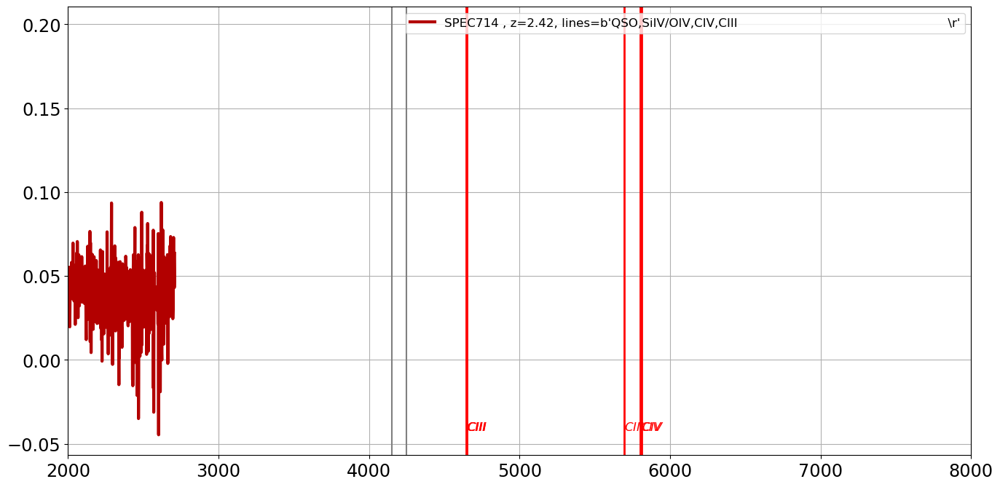

===================== SED 526 : SPEC715 , z=0.56, lines=b'[OII],H9,H8,K,H                                                             \r'=======================
the_lines =  b'[OII],H9,H8,K,H                                                             \r'
[OII]
H9
H8
K
H


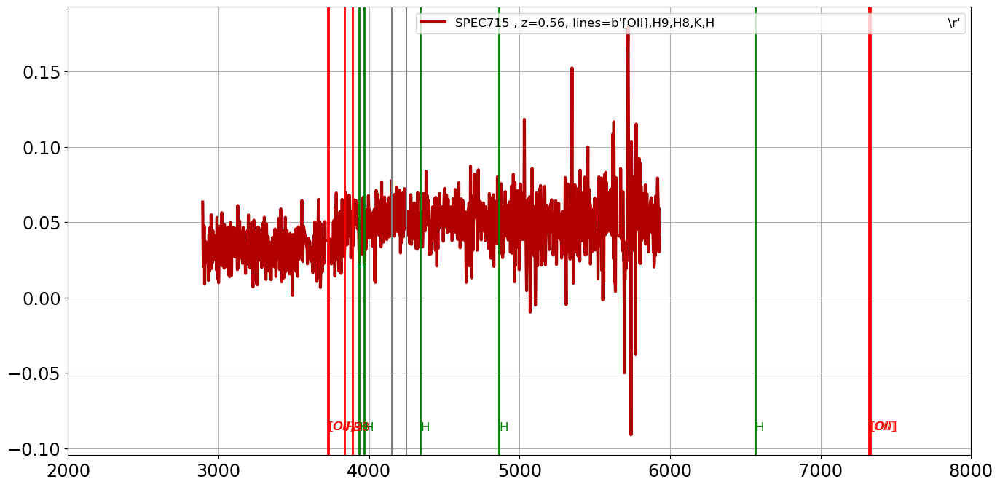

===================== SED 527 : SPEC716 , z=0.44, lines=b'[OII],K,H,4000{AA}-break                                                    \r'=======================
the_lines =  b'[OII],K,H,4000{AA}-break                                                    \r'
[OII]
K
H
4000{AA}-break


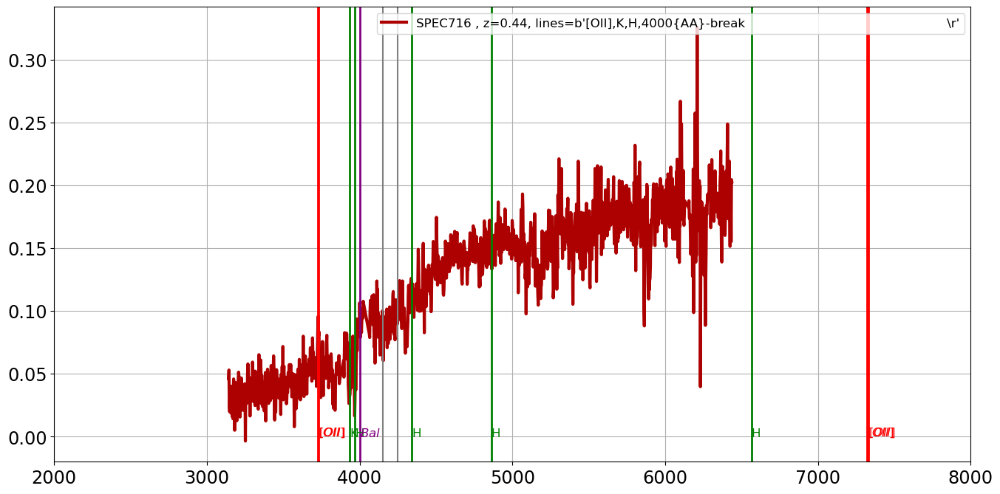

===================== SED 528 : SPEC717 , z=0.92, lines=b'[OII]                                                                       \r'=======================
the_lines =  b'[OII]                                                                       \r'
[OII]


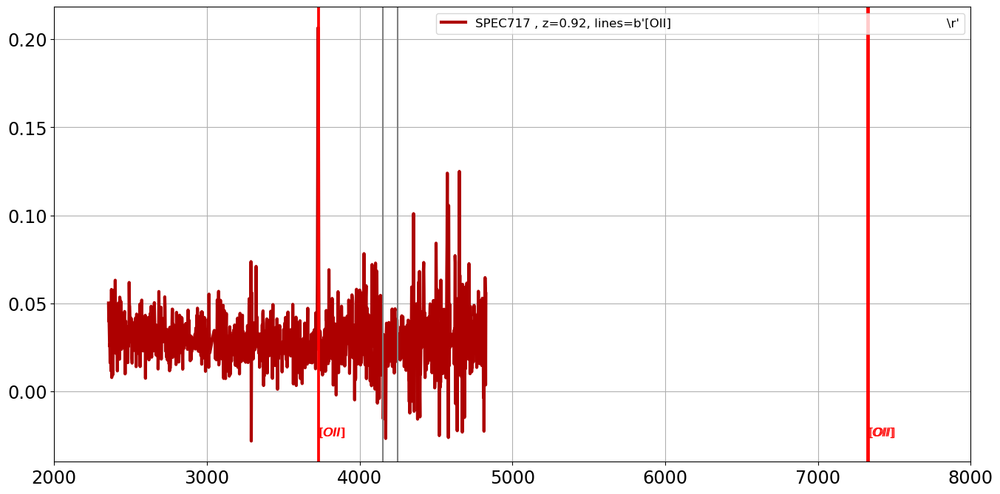

===================== SED 529 : SPEC718 , z=0.44, lines=b'K,H,G                                                                       \r'=======================
the_lines =  b'K,H,G                                                                       \r'
K
H
G


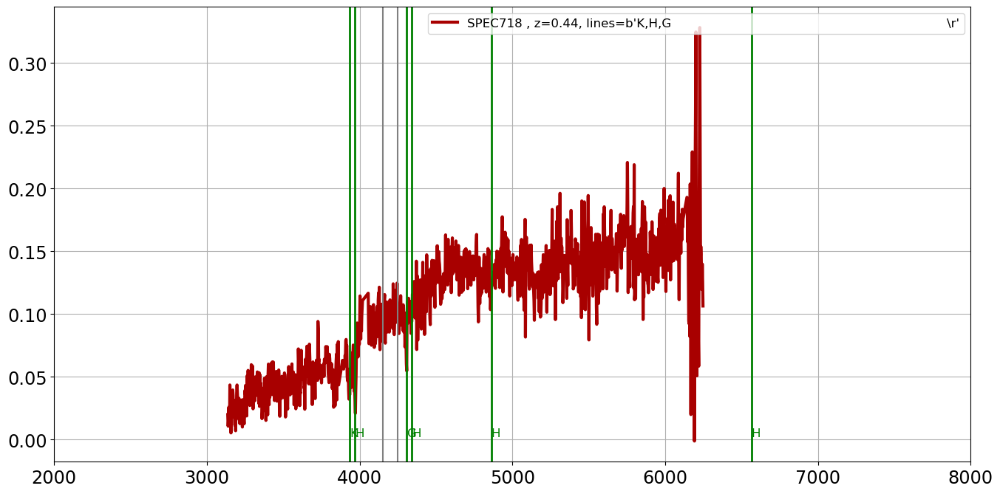

===================== SED 530 : SPEC719 , z=0.27, lines=b'[OII],H11,H10,H9,H8,K,H,H{delta},H{beta},[OIII],H{alpha}                    \r'=======================
the_lines =  b'[OII],H11,H10,H9,H8,K,H,H{delta},H{beta},[OIII],H{alpha}                    \r'
[OII]
H11
H10
H9
H8
K
H
H{delta}
H{beta}
[OIII]
H{alpha}


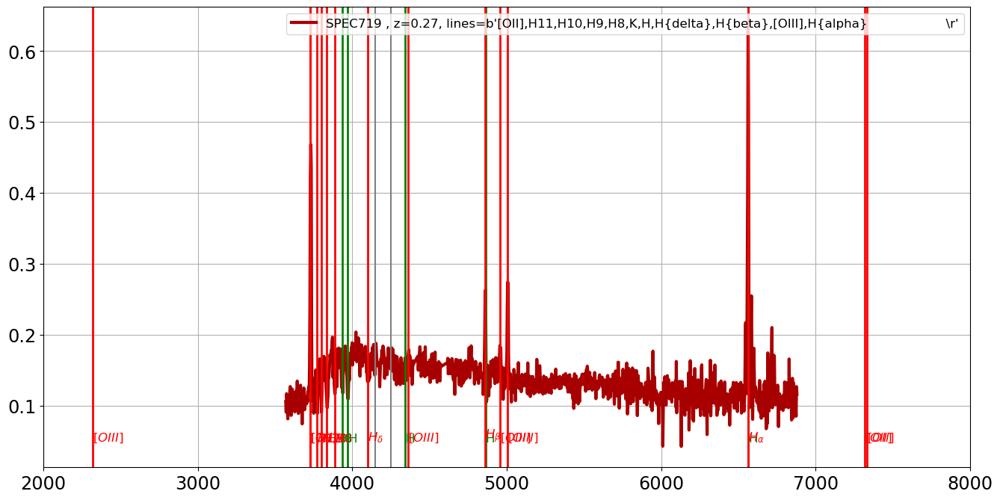

===================== SED 531 : SPEC720 , z=0.44, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


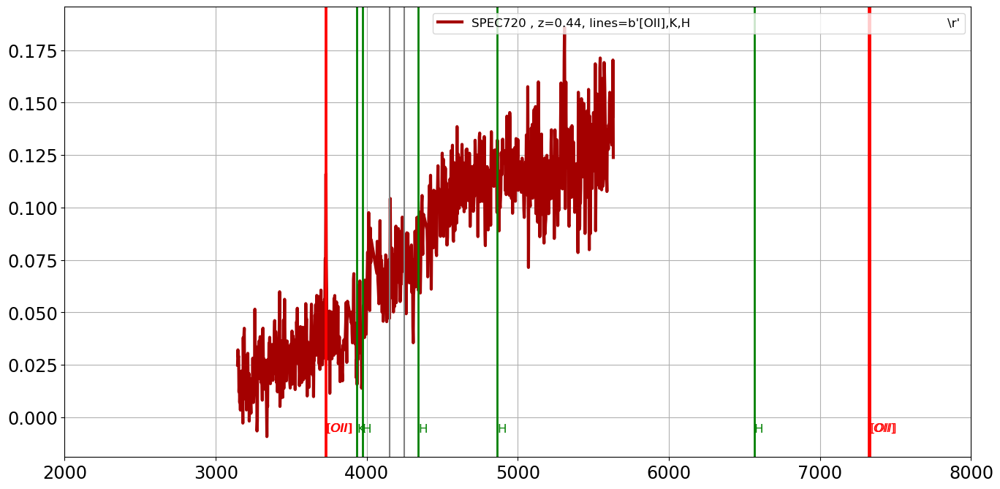

===================== SED 532 : SPEC721 , z=0.63, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


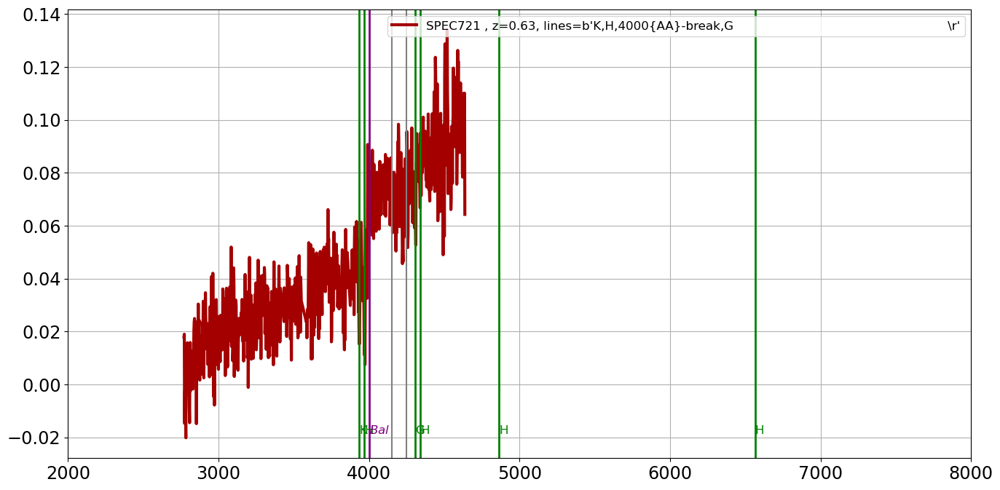

===================== SED 533 : SPEC722 , z=1.21, lines=b'broad,MgII,(QSO)                                                            \r'=======================
the_lines =  b'broad,MgII,(QSO)                                                            \r'
broad
MgII
(QSO)


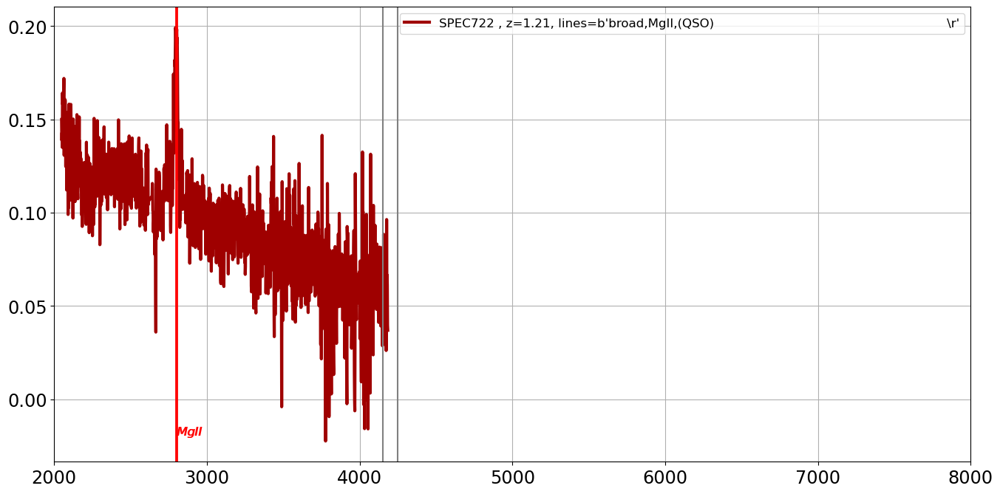

===================== SED 534 : SPEC723 , z=0.23, lines=b'[OII],H9,H8,K,H,H{delta},H{beta},[OIII],H{alpha}                            \r'=======================
the_lines =  b'[OII],H9,H8,K,H,H{delta},H{beta},[OIII],H{alpha}                            \r'
[OII]
H9
H8
K
H
H{delta}
H{beta}
[OIII]
H{alpha}


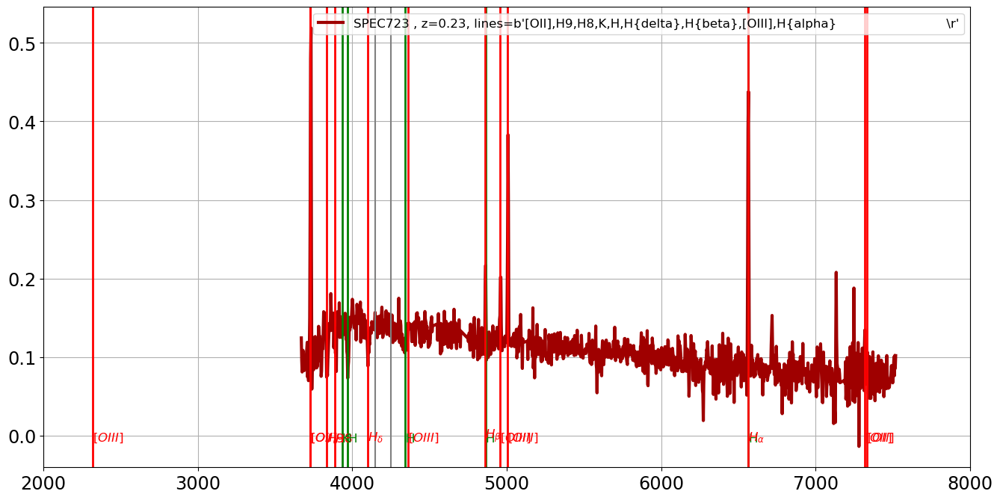

===================== SED 535 : SPEC724 , z=0.23, lines=b'[OII],H8,H,H{beta},[OIII],H{alpha}                                          \r'=======================
the_lines =  b'[OII],H8,H,H{beta},[OIII],H{alpha}                                          \r'
[OII]
H8
H
H{beta}
[OIII]
H{alpha}


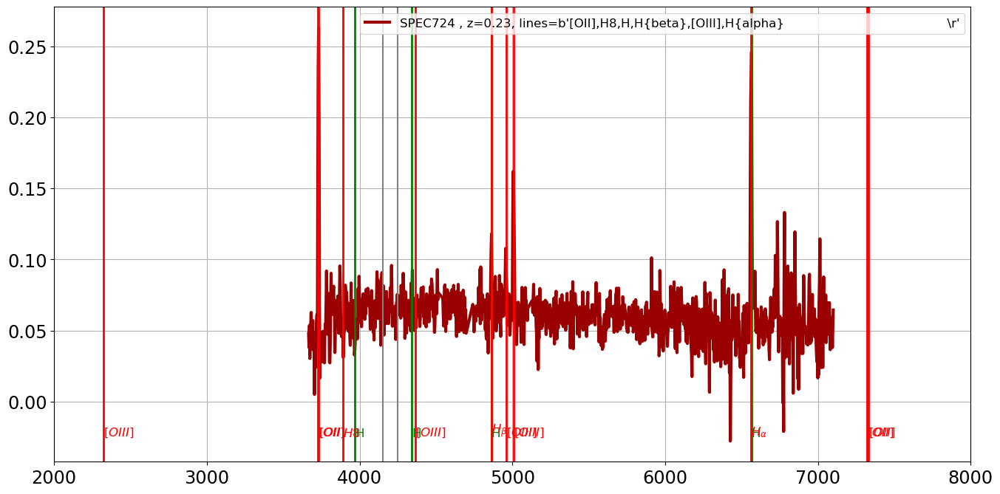

===================== SED 536 : SPEC725 , z=0.23, lines=b'[OII],H{beta},[OIII],H{alpha}                                               \r'=======================
the_lines =  b'[OII],H{beta},[OIII],H{alpha}                                               \r'
[OII]
H{beta}
[OIII]
H{alpha}


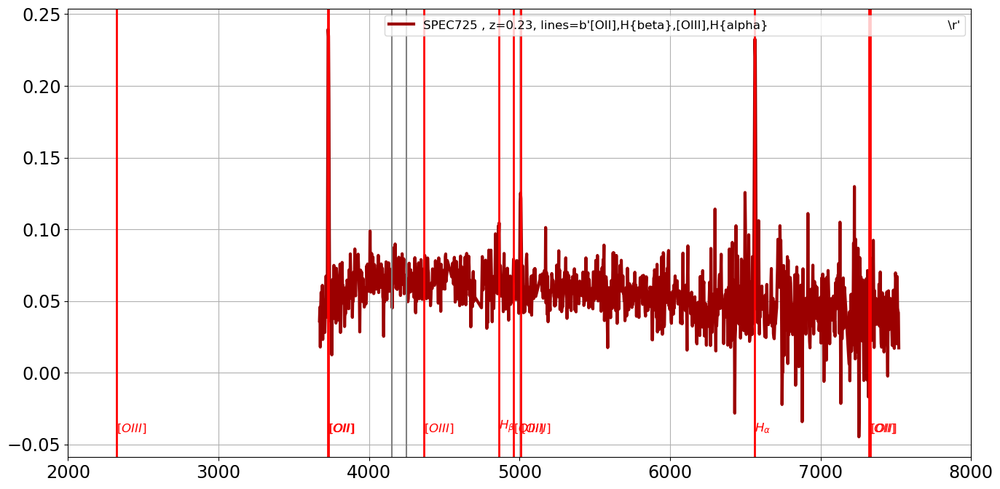

===================== SED 537 : SPEC726 , z=0.54, lines=b'weak,[OII],H9,K,H                                                           \r'=======================
the_lines =  b'weak,[OII],H9,K,H                                                           \r'
weak
[OII]
H9
K
H


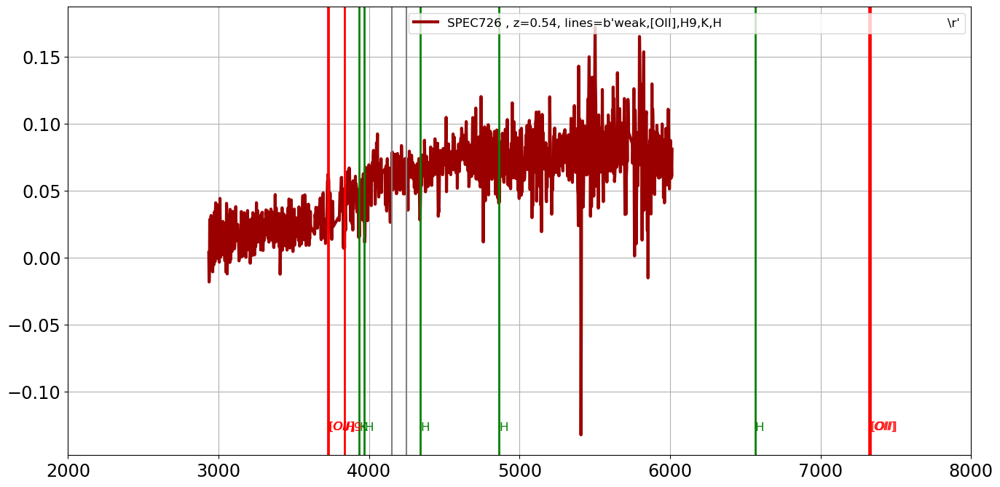

===================== SED 538 : SPEC727 , z=0.23, lines=b'[OII],[OIII],H{alpha}                                                       \r'=======================
the_lines =  b'[OII],[OIII],H{alpha}                                                       \r'
[OII]
[OIII]
H{alpha}


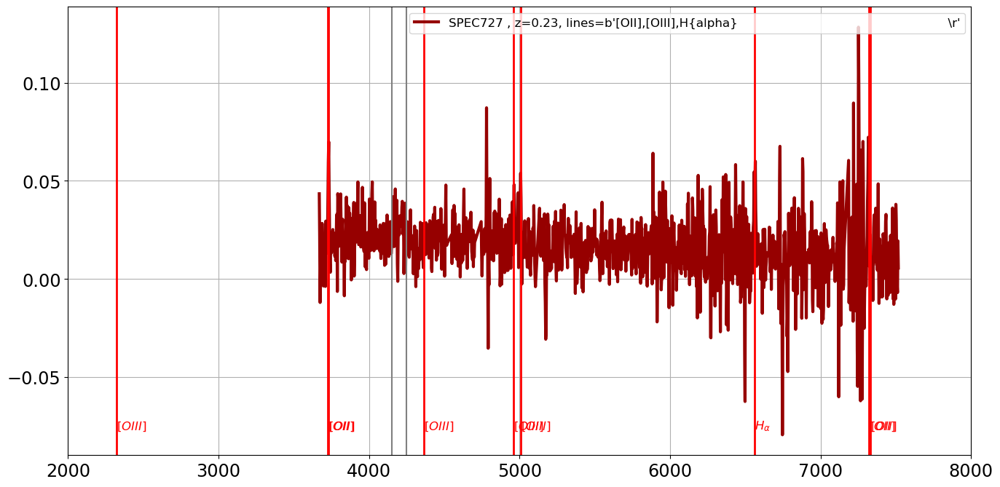

===================== SED 539 : SPEC728 , z=0.44, lines=b'[OII],H9,H8,K,H,H{beta}                                                     \r'=======================
the_lines =  b'[OII],H9,H8,K,H,H{beta}                                                     \r'
[OII]
H9
H8
K
H
H{beta}


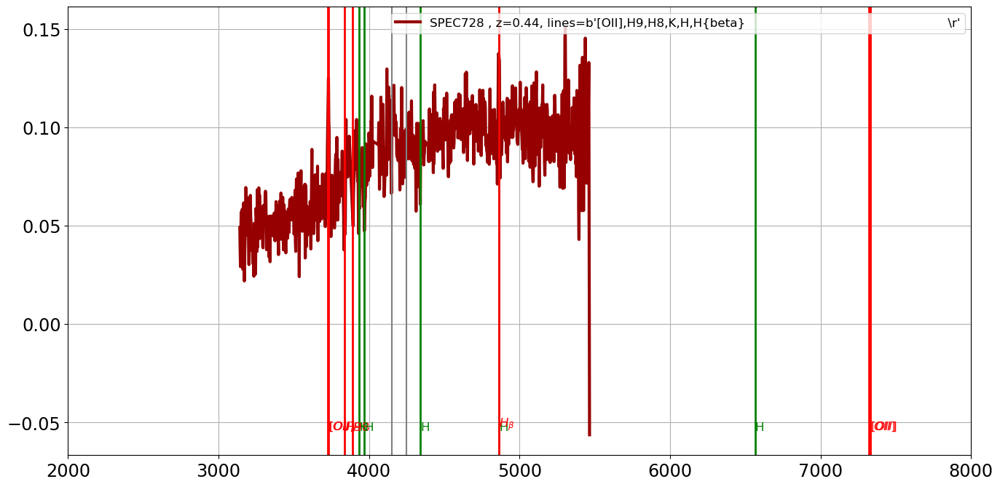

===================== SED 540 : SPEC729 , z=0.43, lines=b'[OII],H10,H9,K,H                                                            \r'=======================
the_lines =  b'[OII],H10,H9,K,H                                                            \r'
[OII]
H10
H9
K
H


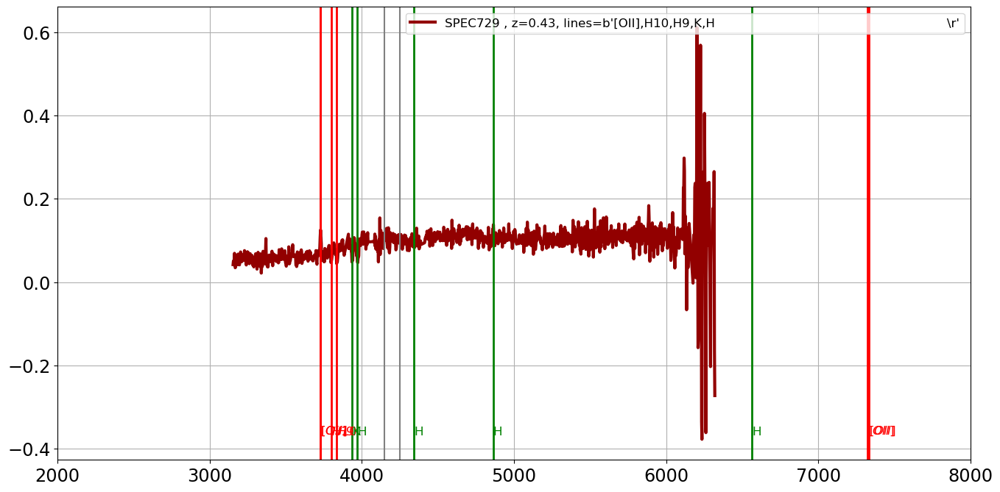

===================== SED 541 : SPEC730 , z=0.55, lines=b'[OII],H{gamma},H{beta},[OIII]                                               \r'=======================
the_lines =  b'[OII],H{gamma},H{beta},[OIII]                                               \r'
[OII]
H{gamma}
H{beta}
[OIII]


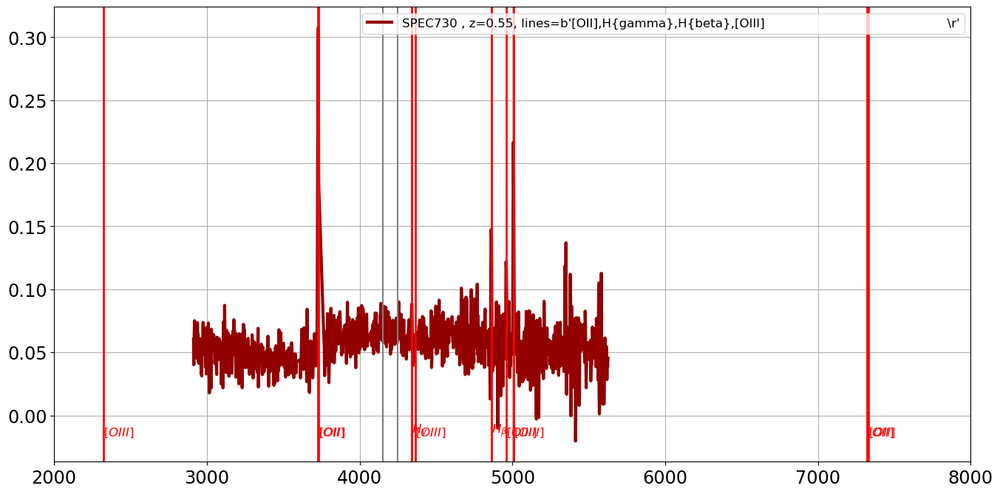

===================== SED 542 : SPEC731 , z=0.55, lines=b'weak,[OII],H9,H,4000{AA}-break                                              \r'=======================
the_lines =  b'weak,[OII],H9,H,4000{AA}-break                                              \r'
weak
[OII]
H9
H
4000{AA}-break


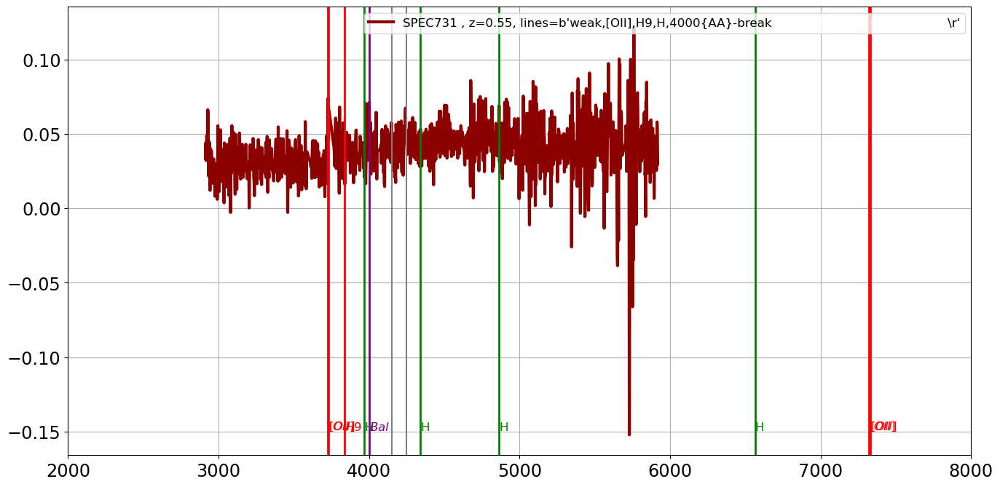

===================== SED 543 : SPEC732 , z=0.16, lines=b'H,K,H{gamma},H{beta},[OIII],H{alpha},NII                                    \r'=======================
the_lines =  b'H,K,H{gamma},H{beta},[OIII],H{alpha},NII                                    \r'
H
K
H{gamma}
H{beta}
[OIII]
H{alpha}
NII


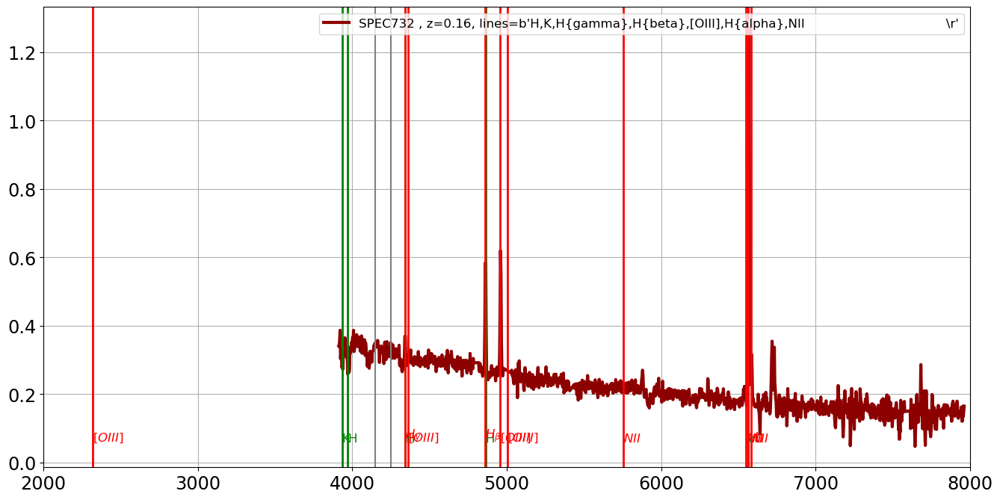

===================== SED 544 : SPEC733 , z=0.20, lines=b'K,H,H{beta},[OIII]                                                          \r'=======================
the_lines =  b'K,H,H{beta},[OIII]                                                          \r'
K
H
H{beta}
[OIII]


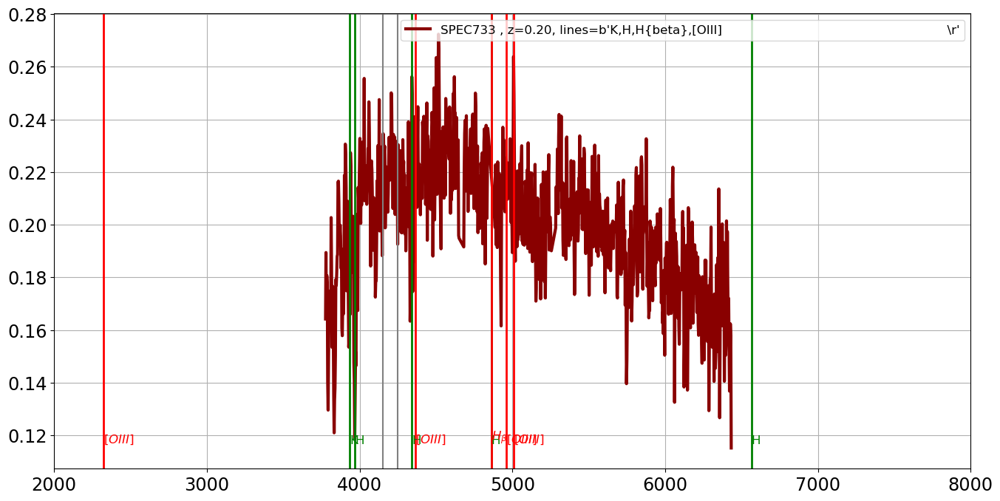

===================== SED 545 : SPEC734 , z=0.23, lines=b'[OII],H9,K,H,H{alpha},NII                                                   \r'=======================
the_lines =  b'[OII],H9,K,H,H{alpha},NII                                                   \r'
[OII]
H9
K
H
H{alpha}
NII


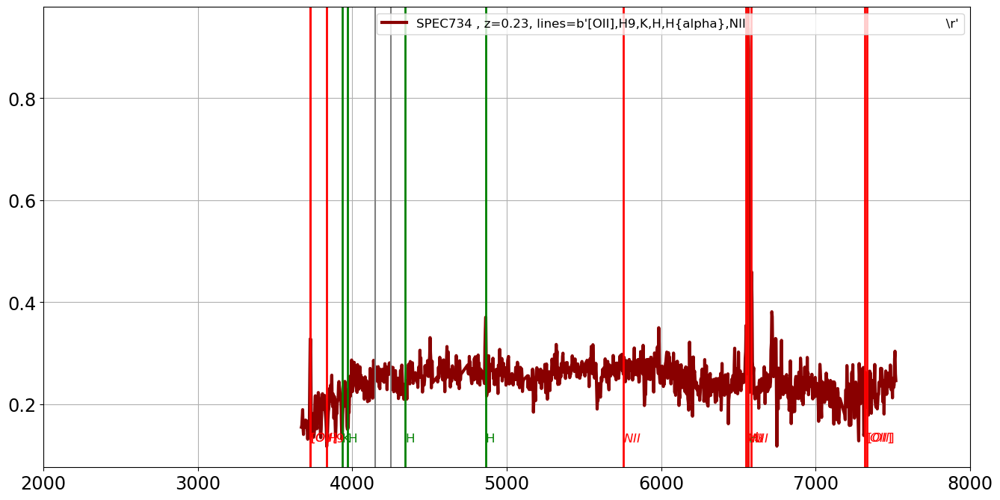

===================== SED 546 : SPEC735 , z=0.36, lines=b'K,H,G,H{beta}                                                               \r'=======================
the_lines =  b'K,H,G,H{beta}                                                               \r'
K
H
G
H{beta}


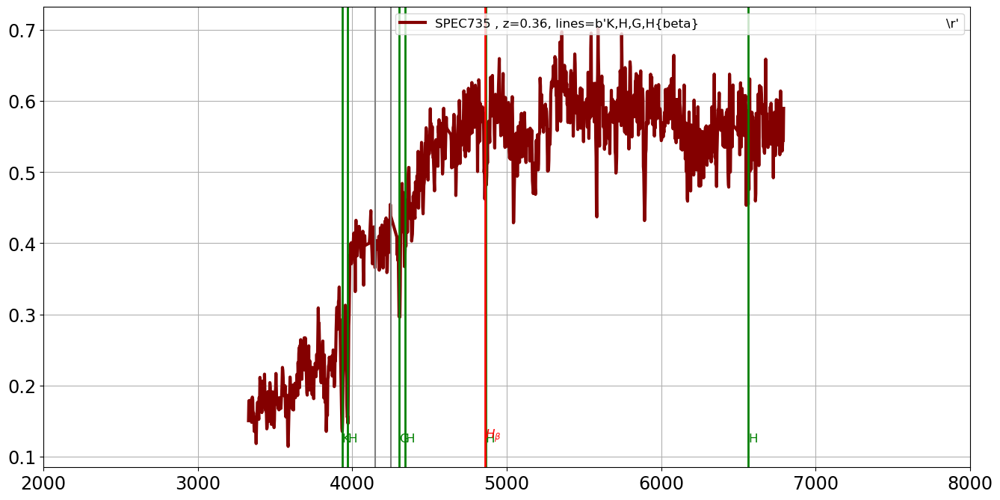

===================== SED 547 : SPEC736 , z=0.56, lines=b'[OII],H9,H{beta},[OIII]                                                     \r'=======================
the_lines =  b'[OII],H9,H{beta},[OIII]                                                     \r'
[OII]
H9
H{beta}
[OIII]


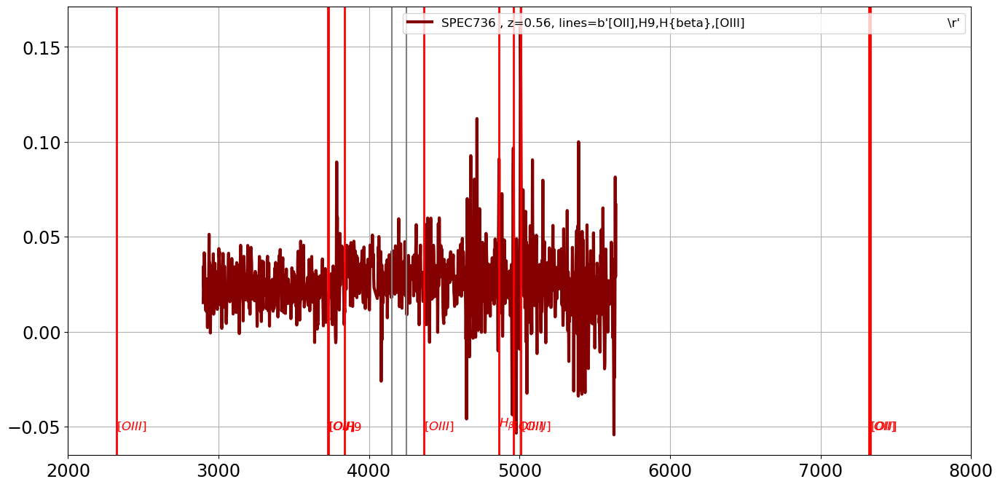

===================== SED 548 : SPEC737 , z=0.52, lines=b'[OII],K,H                                                                   \r'=======================
the_lines =  b'[OII],K,H                                                                   \r'
[OII]
K
H


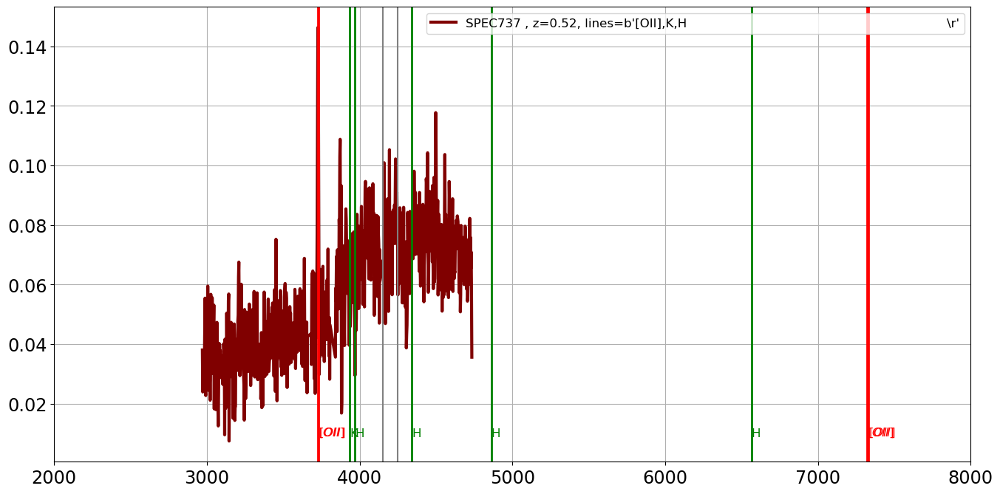

===================== SED 549 : SPEC738 , z=0.56, lines=b'K,H,4000{AA}-break,G                                                        \r'=======================
the_lines =  b'K,H,4000{AA}-break,G                                                        \r'
K
H
4000{AA}-break
G


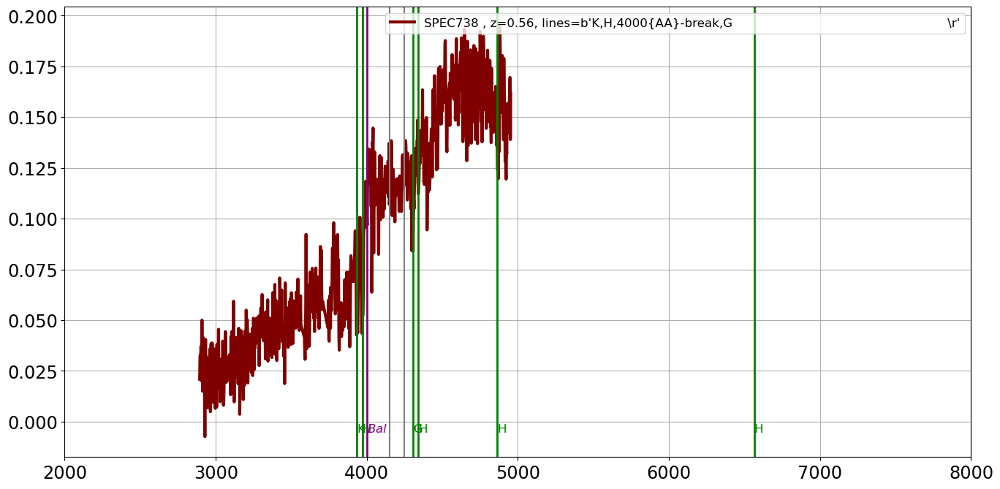

In [33]:
for idx in range(0,NSED):
    the_tag=all_tag[idx] 
    print(f"===================== SED {idx} : {the_tag}=======================")
    
    the_lines = all_lines[idx]
    print("the_lines = ",the_lines)
    all_elements  = the_lines.decode().split(",")
    #fig, ax = plt.subplot(1,1,1,figsize=(16,8))
    #fig, axs = plt.subplots(1, 1, figsize=(16, 8),dpi=50)
    fig, axs = plt.subplots(1, 1, figsize=(16, 8))
    ax=axs
    ax.plot(all_wl[idx],all_spectra[idx],'b-' ,color=all_colors[idx],label=all_tag[idx],lw=3)
    ax.legend(loc="upper right")
    ax.grid()
    ax.axvline(4150,color="grey")
    ax.axvline(4250,color="grey")
#    plt.ylim(-0.02,0.4)
    ax.set_xlim(2000.,8000.)
    for el in all_elements:
        el=el.split(" ")[0]  
        el=el.split("\r")[0]  
        print(el)
        if len(el)>0:
            plot_line(ax,el)
    plt.show()
    del fig
    
    

In [34]:
NSED

550